# Описание проекта.

***
**Задача:**
В проекте приведены исторические данные о заказах такси в аэропортах. Цель проекта - построить модель для прогнозирования количества заказов такси на следующий час, чтобы привлекать больше водителей в период пиковой нагрузки.

Значение метрики RMSE на тестовой выборке должно быть не больше 48.

**Примечание:**
Для предсказания данны 10% от данных. Считается, что для каждой записи в тестовых данных информация известна исходя из условия задачи. 
***
**Шаги проекта**

    1. Загрузка данных и ресемплирование
- Загркзка данных из файла /datasets/taxi.csv.
- Ресемплирование данных по одному часу.

    2. Анализ данных
- Анализ основных статистик данных.
- Изучение временного ряда заказов такси.

    3. Обучение моделей
- Разделение данных на обучающую и тестовую выборки.
- Обучение различных моделей с различными гиперпараметрами.
- Использование тестовой выборки размером 10% от исходных данных.

    4. Проверка и выводы
- Проверка модели на тестовой выборке.
- Оценка качества модели с использованием метрики RMSE.
- Выводы и предложения по оптимизации привлечения водителей в периоды пиковой нагрузки.


# Импорт данных.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from ipywidgets import interact
from statsmodels.tsa.seasonal import seasonal_decompose
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import mean_squared_error

import catboost as cb
import lightgbm as lgb

from sklearn.model_selection import TimeSeriesSplit

#pip install etna[all]
from etna.datasets import TSDataset
from etna.models import CatBoostMultiSegmentModel
from etna.transforms import DateFlagsTransform
from etna.transforms import DensityOutliersTransform
from etna.transforms import FourierTransform
from etna.transforms import LagTransform
from etna.transforms import LinearTrendTransform
from etna.transforms import MeanTransform
from etna.transforms import SegmentEncoderTransform
from etna.transforms import TimeSeriesImputerTransform
from etna.transforms import TrendTransform
from etna.pipeline import Pipeline
from etna.analysis import plot_forecast
from etna.metrics.metrics import RMSE

/Users/maksimgorskov/opt/anaconda3/lib/python3.9/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.26.2
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/Users/maksimgorskov/opt/anaconda3/lib/python3.9/site-packages/etna/settings.py:37: UserWarning: etna[torch] is not available, to install it, run `pip install etna[torch]`
  warnings.warn("etna[torch] is not available, to install it, run `pip install etna[torch]`")
/Users/maksimgorskov/opt/anaconda3/lib/python3.9/site-packages/etna/settings.py:45: UserWarning: wandb is not available, to install it, run `pip install etna[wandb]`
  warnings.warn("wandb is not available, to install it, run `pip install etna[wandb]`")
/Users/maksimgorskov/opt/anaconda3/lib/python3.9/site-packages/etna/settings.py:62: UserWarning: etna[classification] is not available, to install it, run `pip install etna[classification]`
  warnings.warn("

In [2]:
file_path_local = './taxi.csv'
file_path_hab = '/datasets/taxi.csv'
try:
    data_orders = pd.read_csv(file_path_local, parse_dates=[0])

except:
    data_orders = pd.read_csv(file_path_hab, parse_dates=[0])

 <br/>
<div class="alert alert-block alert-danger">
<h2> Комментарий ревьюера   <a class="tocSkip"></h2>
    
<b>На доработку🤔:</b>

</b> Ячейка выше не отработала. Перед отправкой проекта стоит проверять работоспособность кода, причем именно на Платформе Практикума, а не локально - это можно сделать, нажав на панели Платформы Практикума (Jupiter Hub)
    
`Kernel` и `Restart & Run All`. Исправь, пожалуйста.

В этом требовании есть рациональное зерно. Согласись, если ты будешь презетновать свою работу на чужом компьютере (например руководителю), то не важно, работал ли проект у тебя на комьютере, он должен работать там, где ты будешь его запускать.

В случае локального выполнения требуется обязательно использовать те версии библиотек, которые актуальны для  платформы Практикума. Еще при выполнении первых проектов у тебя было ознакомление с "Рекомендациями по выполнению проектов", где сформулировано это правило, инструкция: « Установка окружения — как избежать конфликта версий библиотек»

Ниже привожу вырезку из инструкции с актуальными версиями:    

    beautifulsoup4==4.9.3
    matplotlib==3.3.4
    nltk==3.6.1
    numpy==1.20.1
    pandas==1.2.4
    plotly==5.4.0
    psycopg2-binary==2.9.2
    pymorphy2==0.9.1
    pymorphy2-dicts==2.4.417127. 4579844
    pymystem3==0.2.0
    regex==2022.3.15
    scikit-learn==0.24.1
    scipy==1.8.0
    seaborn==0.11.1
    sqlalchemy==1.4.15
    statsmodels==0.13.2
    catboost==1.0.3
    pyspark==3.0.2
    torch==1.10.0
    transformers==4.12.5
    pillow==8.4.0 
    keras==2.7.0
    tensorflow==2.7.0     

In [3]:
#Копирование датафрейма для использования в модели на базе библиотеки Ethna.
data_orders_ethna = data_orders.copy()

#Замена индексов на временные значения.
data_orders = data_orders.set_index('datetime')


In [4]:
data_orders.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 26496 entries, 2018-03-01 00:00:00 to 2018-08-31 23:50:00
Data columns (total 1 columns):
 #   Column      Non-Null Count  Dtype
---  ------      --------------  -----
 0   num_orders  26496 non-null  int64
dtypes: int64(1)
memory usage: 414.0 KB


**Общее описание данных:**
1) Датасет представляет собой датафрейм из двух признаков. Дата и время заказа - первый признак. Количество заказов в это время - второй.
2) Пропуски в данных отсутствуют.

# Рассемплирование.

In [5]:
#Сортировка индексов по возрастанию.
data_orders.sort_index(inplace = True)

In [6]:
#Данные семплируются с разбивкой в 1 час. Причем используется сумма всех заказов за этот час.
data_orders = data_orders.resample('1H').sum()

In [7]:
data_orders.head(5)

,num_orders
datetime,
2018-03-01 00:00:00,124
2018-03-01 01:00:00,85
2018-03-01 02:00:00,71
2018-03-01 03:00:00,66
2018-03-01 04:00:00,43


In [8]:
#Датасет для анализа на тренд и сезонность
data = data_orders.copy()

# Анализ данных.

## Общий анализ.

Построение графика заказов на всех данных. Для общего понимания тренда отображается скользящее среднее для суток.

In [9]:
data_orders['rolling_mean'] = data_orders.rolling(24).mean()

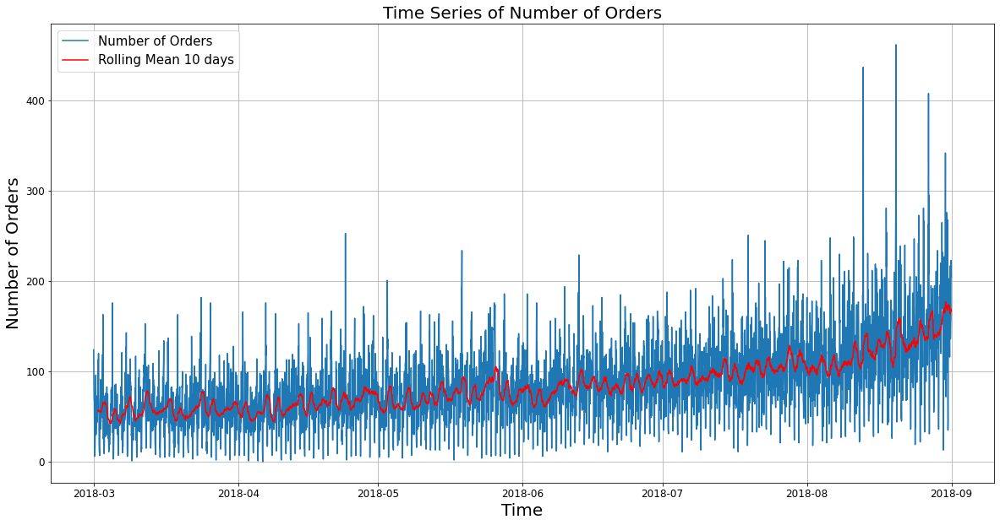

In [10]:
plt.figure(figsize=(20, 10))
plt.plot(data_orders.index, data_orders['num_orders'], label='Number of Orders')
plt.plot(data_orders.index, data_orders['rolling_mean'], label='Rolling Mean 10 days', color='red')
plt.title('Time Series of Number of Orders', fontsize=20)
plt.xlabel('Time', fontsize=20)
plt.ylabel('Number of Orders', fontsize=20)
plt.legend(fontsize=15)
plt.grid(True)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

Из графика следует, что количество заказов возрастает от марта к сентябрю. Ниже представлен ежемесячный график. 

In [11]:
import matplotlib.pyplot as plt
import ipywidgets as widgets
from ipywidgets import interact



def plot_with_rolling_mean(month):
    plt.figure(figsize=(15, 10))
    # Фильтраия по выбранному месяцу
    selected_month_data = data_orders[data_orders.index.month == month]

    #Вывод графика заказов
    plt.plot(selected_month_data.index, selected_month_data['num_orders'], label='Number of Orders', alpha=0.5)

    #Скользящее среднее для 7 дней
    rolling_mean = selected_month_data['num_orders'].rolling(window=7).mean()
    plt.plot(selected_month_data.index, rolling_mean, label='7-Day Rolling Mean', color='red')

    plt.title(f'Time Series of Number of Orders with 7-Day Rolling Mean for Month {month}', fontsize=16)
    plt.xlabel('Time', fontsize=14)
    plt.ylabel('Number of Orders', fontsize=14)
    plt.legend(fontsize=12)
    plt.grid(True)

    #Размерность шрифтов
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

    plt.show()

#Создание интерактивного виджета для детального рассмотрения каждого месяца.
interact(plot_with_rolling_mean, month=widgets.IntSlider(min=3, max=8, step=1, value=1))

interactive(children=(IntSlider(value=3, description='month', max=8, min=3), Output()), _dom_classes=('widget-…

<function __main__.plot_with_rolling_mean(month)>

Из ежемесячного графика видно, что кол-во заказов имеет определенную цикличность исходя из скользящего среднего.

**Гипотеза:** Сезонность связана с днями недели.
    
Детально повторяющийся паттерн будет рассмотрен в следующем разделе.

## Анализ тренда и сезонности.

In [12]:
#замена первых 24 пропусков на значение 25-е по порядку в признаке rolling_mean
data_orders_11 = data_orders['rolling_mean'][25]
data_orders = data_orders.fillna(data_orders_11)

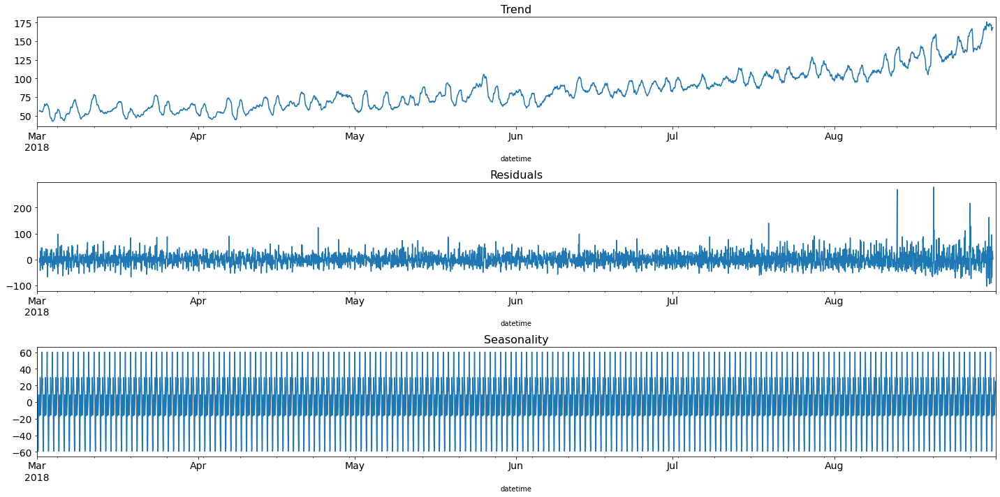

In [13]:
decomposed = seasonal_decompose(data)
plt.figure(figsize=(20, 10))
plt.subplot(311)
decomposed.trend.plot(ax=plt.gca())
plt.title('Trend', fontsize=16)
#Размерность шрифтов
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.subplot(312)
decomposed.resid.plot(ax=plt.gca()) 
plt.title('Residuals', fontsize=16)
#Размерность шрифтов
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.subplot(313)
decomposed.seasonal.plot(ax=plt.gca()) 
# < напишите код здесь >
plt.title('Seasonality', fontsize=16)
#Размерность шрифтов
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.tight_layout()


### Исследование недельной сезонности.

Исходя из графика сезонности за весь промежуток времени видно, что сезонность в рамках каждого месяца описывается одни и тем же графиком. Поэтому для анализа недельной сезонности достаточно взять любую неделю из лбого месяца. 

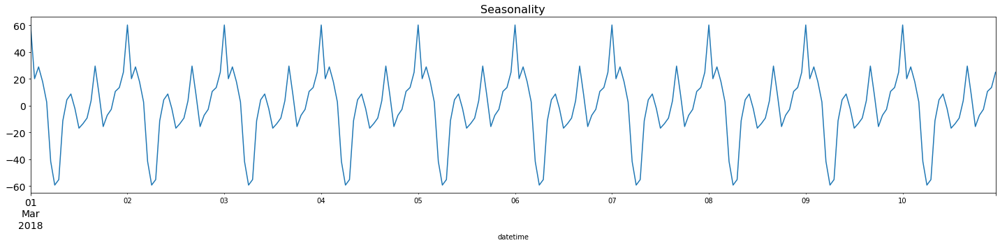

In [14]:
decomposed = seasonal_decompose(data)

# Select the seasonal component for the firs week of march
plt.figure(figsize=(20, 5))
seasonal_component_january = decomposed.seasonal['2018-03-01':'2018-03-10'].plot()
plt.title('Seasonality', fontsize=16)
#Размерность шрифтов
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.tight_layout()


**Из недельного графика видно, что данные имеют выраженну суточную сезонность.**

### Исследование суточной сезонности.

Анализируются первые сутки недели, рассмотренной выше.

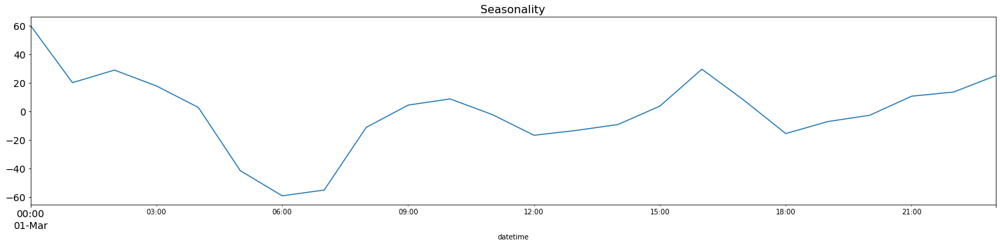

In [15]:
decomposed = seasonal_decompose(data)

# Select the seasonal component for the firs week of march
plt.figure(figsize=(20, 5))
seasonal_component_january = decomposed.seasonal['2018-03-01'].plot()
plt.title('Seasonality', fontsize=16)
#Размерность шрифтов
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.tight_layout()

Из графика видно, что ежесуточно пиковое количество вызовов приходится на полночь, а минимальное кол-во заказов - на 6 утра.

### Вывод.



- За весь промежуток врмени, приведенный в исходном датасете, наблюдается восходящий тренд по заказу такси. На начало сентября, количество вызовов такси выросло более чем в три раза, по сравнением с началом марта этого же года.
- Анализ на сезонность показал, что она присутствует только на уровне суток. Ежесуточно пиковое количество вызовов приходится на полночь, а минимальное кол-во заказов - на 6 утра. Какая-либо цикличность на большем масштабе времени - отсутствует.

## Формирование дополнительных признаков.

Функция для добавления скользящего среднего и отстающих значений.

In [16]:
def make_features(data, max_lag, rolling_mean_size):
    data_modify = data.copy()
    
    data_modify['month'] = data_modify.index.month
    data_modify['day'] = data_modify.index.day
    data_modify['dayofweek'] = data_modify.index.dayofweek
    data_modify['hour'] = data_modify.index.hour
    # Для учета цикличности времени, часы заменяются на синус радиана часа суток.
    data_modify['hour_sin'] = np.sin(np.radians(data_modify['hour']))
    
    for lag in range(1, max_lag + 1):
        data_modify['lag_{}'.format(lag)] = data_modify['num_orders'].shift(lag)
        #Заполнение пропусков первым значением не равным NaN
        fill_value = data_modify['lag_{}'.format(lag)].first_valid_index()
        first_non_nan_value = data_modify['lag_{}'.format(lag)].loc[fill_value]
        data_modify['lag_{}'.format(lag)] = data_modify['lag_{}'.format(lag)].fillna(first_non_nan_value)

    data_modify['rolling_mean'] = data_modify['num_orders'].shift().rolling(rolling_mean_size).mean()
    #Заполнение пропусков первым значением не равным NaN
    fill_value = data_modify['rolling_mean'].first_valid_index()
    first_non_nan_value = data_modify['rolling_mean'].loc[fill_value]
    data_modify['rolling_mean'] = data_modify['rolling_mean'].fillna(first_non_nan_value)
    
    return data_modify


data_modify = make_features(data_orders, 24, 24)

In [17]:
data_modify.head(5)

,num_orders,rolling_mean,month,day,dayofweek,hour,hour_sin,lag_1,lag_2,lag_3,...,lag_15,lag_16,lag_17,lag_18,lag_19,lag_20,lag_21,lag_22,lag_23,lag_24
datetime,,,,,,,,,,,,,,,,,,,,,
2018-03-01 00:00:00,124,56.833333,3,1,3,0,0.000000,124.0,124.0,124.0,...,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0
2018-03-01 01:00:00,85,56.833333,3,1,3,1,0.017452,124.0,124.0,124.0,...,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0
2018-03-01 02:00:00,71,56.833333,3,1,3,2,0.034899,85.0,124.0,124.0,...,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0
2018-03-01 03:00:00,66,56.833333,3,1,3,3,0.052336,71.0,85.0,124.0,...,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0
2018-03-01 04:00:00,43,56.833333,3,1,3,4,0.069756,66.0,71.0,85.0,...,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0,124.0


# Модель для прогнозирования количества заказов

## Определение тестовой и валидационной выборки.

Разбиение на тестовую и валидационную выборку.

In [18]:
y = data_modify['num_orders']
X = data_modify.drop('num_orders', axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X, y, shuffle=False, test_size=0.1)

## Инициализация сравнительной таблицы.

Для анализа качества моделей и выбора наилучшей из них - формируется сводная таблица с результатами работ каждой из них.

In [19]:
df = {'ML model' : [],
              'RMSE' : []}
comparing = pd.DataFrame(df)
comparing

,ML model,RMSE


## Cat Boost

In [20]:
#Инициализация модели CatBoostRegressor.
rndm = 12345
model_cbr = cb.CatBoostRegressor(random_seed=rndm,
                                boosting_type='Ordered')

In [21]:
param_grid = {
    'iterations': range(100, 2000, 500),
    'depth': range(1, 6, 2),
    'learning_rate': [0.01, 0.1, 0.02]
}

In [22]:
# Create GridSearchCV object
tscv = TimeSeriesSplit(n_splits=10) #Кроссвалидация для временного ряда.
grid_search = GridSearchCV(estimator=model_cbr,
                           param_grid=param_grid,
                           cv = tscv,
                           scoring='neg_mean_squared_error',
                           verbose=0 #отключение вывода прогресса обучения
                          )  

In [23]:
grid_search.fit(X_train, y_train)

0:	learn: 29.0726441	total: 57.6ms	remaining: 5.71s
1:	learn: 29.0162677	total: 58.2ms	remaining: 2.85s
2:	learn: 28.9414960	total: 58.5ms	remaining: 1.89s
3:	learn: 28.8681270	total: 58.9ms	remaining: 1.41s
4:	learn: 28.8009131	total: 59.2ms	remaining: 1.13s
5:	learn: 28.7497843	total: 59.6ms	remaining: 933ms
6:	learn: 28.6782575	total: 59.9ms	remaining: 796ms
7:	learn: 28.6252766	total: 60.2ms	remaining: 693ms
8:	learn: 28.5582333	total: 60.5ms	remaining: 612ms
9:	learn: 28.5055918	total: 60.9ms	remaining: 548ms
10:	learn: 28.4504746	total: 61.3ms	remaining: 496ms
11:	learn: 28.3796590	total: 61.6ms	remaining: 452ms
12:	learn: 28.3190527	total: 62ms	remaining: 415ms
13:	learn: 28.2522773	total: 62.4ms	remaining: 383ms
14:	learn: 28.2022771	total: 62.6ms	remaining: 355ms
15:	learn: 28.1508869	total: 63ms	remaining: 331ms
16:	learn: 28.0975078	total: 63.2ms	remaining: 309ms
17:	learn: 28.0350328	total: 63.6ms	remaining: 290ms
18:	learn: 27.9825363	total: 64ms	remaining: 273ms
19:	learn

57:	learn: 28.0714062	total: 23.6ms	remaining: 17.1ms
58:	learn: 28.0304918	total: 24.2ms	remaining: 16.8ms
59:	learn: 27.9871217	total: 24.6ms	remaining: 16.4ms
60:	learn: 27.9473283	total: 25ms	remaining: 16ms
61:	learn: 27.9085834	total: 25.4ms	remaining: 15.6ms
62:	learn: 27.8660724	total: 25.8ms	remaining: 15.1ms
63:	learn: 27.8250598	total: 26.2ms	remaining: 14.7ms
64:	learn: 27.7841513	total: 26.6ms	remaining: 14.3ms
65:	learn: 27.7512898	total: 27ms	remaining: 13.9ms
66:	learn: 27.7192038	total: 27.4ms	remaining: 13.5ms
67:	learn: 27.6775867	total: 27.8ms	remaining: 13.1ms
68:	learn: 27.6367292	total: 28.3ms	remaining: 12.7ms
69:	learn: 27.6040524	total: 28.8ms	remaining: 12.3ms
70:	learn: 27.5668882	total: 29.2ms	remaining: 11.9ms
71:	learn: 27.5266370	total: 29.7ms	remaining: 11.5ms
72:	learn: 27.4883518	total: 30.1ms	remaining: 11.1ms
73:	learn: 27.4497449	total: 30.5ms	remaining: 10.7ms
74:	learn: 27.4136599	total: 30.9ms	remaining: 10.3ms
75:	learn: 27.3745327	total: 31.3m

0:	learn: 34.5024589	total: 696us	remaining: 69ms
1:	learn: 34.4091195	total: 1.3ms	remaining: 63.9ms
2:	learn: 34.3181686	total: 1.79ms	remaining: 58ms
3:	learn: 34.2303652	total: 2.32ms	remaining: 55.6ms
4:	learn: 34.1436274	total: 2.85ms	remaining: 54.1ms
5:	learn: 34.0574047	total: 3.38ms	remaining: 52.9ms
6:	learn: 33.9741251	total: 3.85ms	remaining: 51.2ms
7:	learn: 33.8900091	total: 4.38ms	remaining: 50.4ms
8:	learn: 33.8149868	total: 4.9ms	remaining: 49.5ms
9:	learn: 33.7367678	total: 5.49ms	remaining: 49.4ms
10:	learn: 33.6566491	total: 6.03ms	remaining: 48.8ms
11:	learn: 33.5761603	total: 6.54ms	remaining: 48ms
12:	learn: 33.4962136	total: 7.04ms	remaining: 47.1ms
13:	learn: 33.4183588	total: 7.54ms	remaining: 46.3ms
14:	learn: 33.3420635	total: 8.06ms	remaining: 45.7ms
15:	learn: 33.2670560	total: 8.61ms	remaining: 45.2ms
16:	learn: 33.1910353	total: 9.15ms	remaining: 44.7ms
17:	learn: 33.1166750	total: 9.68ms	remaining: 44.1ms
18:	learn: 33.0444923	total: 10.2ms	remaining: 

89:	learn: 18.8853543	total: 26.2ms	remaining: 2.91ms
90:	learn: 18.8531348	total: 26.7ms	remaining: 2.64ms
91:	learn: 18.8456115	total: 27ms	remaining: 2.35ms
92:	learn: 18.8150645	total: 27.4ms	remaining: 2.06ms
93:	learn: 18.7857663	total: 27.7ms	remaining: 1.77ms
94:	learn: 18.7784924	total: 28ms	remaining: 1.47ms
95:	learn: 18.7513963	total: 28.3ms	remaining: 1.18ms
96:	learn: 18.7453496	total: 28.5ms	remaining: 882us
97:	learn: 18.7359256	total: 28.8ms	remaining: 587us
98:	learn: 18.7127503	total: 29.1ms	remaining: 293us
99:	learn: 18.7029510	total: 29.4ms	remaining: 0us
0:	learn: 28.6499679	total: 426us	remaining: 42.2ms
1:	learn: 28.1800275	total: 918us	remaining: 45ms
2:	learn: 27.5008239	total: 1.24ms	remaining: 40ms
3:	learn: 26.9877477	total: 1.63ms	remaining: 39.2ms
4:	learn: 26.4490293	total: 2.03ms	remaining: 38.7ms
5:	learn: 25.9786817	total: 2.38ms	remaining: 37.3ms
6:	learn: 25.5898385	total: 2.65ms	remaining: 35.2ms
7:	learn: 25.2499977	total: 2.97ms	remaining: 34.2m

98:	learn: 21.8105923	total: 46.8ms	remaining: 472us
99:	learn: 21.8005544	total: 47.3ms	remaining: 0us
0:	learn: 32.4212585	total: 1.08ms	remaining: 107ms
1:	learn: 31.6933299	total: 1.51ms	remaining: 73.9ms
2:	learn: 31.0305162	total: 2ms	remaining: 64.7ms
3:	learn: 30.5151828	total: 2.44ms	remaining: 58.7ms
4:	learn: 29.9737144	total: 2.92ms	remaining: 55.5ms
5:	learn: 29.4555144	total: 3.37ms	remaining: 52.8ms
6:	learn: 29.0198302	total: 3.86ms	remaining: 51.2ms
7:	learn: 28.5862654	total: 4.31ms	remaining: 49.6ms
8:	learn: 28.2564839	total: 4.87ms	remaining: 49.3ms
9:	learn: 27.9313388	total: 5.38ms	remaining: 48.4ms
10:	learn: 27.6590495	total: 5.86ms	remaining: 47.4ms
11:	learn: 27.4284059	total: 6.36ms	remaining: 46.7ms
12:	learn: 27.1605400	total: 6.77ms	remaining: 45.3ms
13:	learn: 26.8845108	total: 7.19ms	remaining: 44.2ms
14:	learn: 26.5937402	total: 7.64ms	remaining: 43.3ms
15:	learn: 26.3826792	total: 8.08ms	remaining: 42.4ms
16:	learn: 26.2128443	total: 8.51ms	remaining:

5:	learn: 32.0252863	total: 3.78ms	remaining: 59.2ms
6:	learn: 31.5380603	total: 4.38ms	remaining: 58.2ms
7:	learn: 31.1138222	total: 4.91ms	remaining: 56.5ms
8:	learn: 30.6797405	total: 5.4ms	remaining: 54.6ms
9:	learn: 30.2981436	total: 5.98ms	remaining: 53.8ms
10:	learn: 30.0088791	total: 6.51ms	remaining: 52.7ms
11:	learn: 29.6504984	total: 7.12ms	remaining: 52.2ms
12:	learn: 29.3720517	total: 7.67ms	remaining: 51.4ms
13:	learn: 29.0835798	total: 8.18ms	remaining: 50.2ms
14:	learn: 28.8191888	total: 8.74ms	remaining: 49.5ms
15:	learn: 28.5625302	total: 9.36ms	remaining: 49.2ms
16:	learn: 28.3558784	total: 9.87ms	remaining: 48.2ms
17:	learn: 28.1174497	total: 10.4ms	remaining: 47.2ms
18:	learn: 27.9292129	total: 10.8ms	remaining: 46.2ms
19:	learn: 27.7450383	total: 11.4ms	remaining: 45.6ms
20:	learn: 27.5487894	total: 11.9ms	remaining: 44.8ms
21:	learn: 27.3989758	total: 12.4ms	remaining: 44.1ms
22:	learn: 27.2274012	total: 13ms	remaining: 43.6ms
23:	learn: 27.0891054	total: 13.6ms	

51:	learn: 26.0933381	total: 19.3ms	remaining: 17.8ms
52:	learn: 26.0406415	total: 19.8ms	remaining: 17.6ms
53:	learn: 25.9786172	total: 20.2ms	remaining: 17.2ms
54:	learn: 25.9202864	total: 20.5ms	remaining: 16.8ms
55:	learn: 25.8670928	total: 20.9ms	remaining: 16.4ms
56:	learn: 25.8064648	total: 21.2ms	remaining: 16ms
57:	learn: 25.7512431	total: 21.5ms	remaining: 15.6ms
58:	learn: 25.6951214	total: 21.8ms	remaining: 15.2ms
59:	learn: 25.6459240	total: 22.1ms	remaining: 14.8ms
60:	learn: 25.6018747	total: 22.5ms	remaining: 14.4ms
61:	learn: 25.5588487	total: 22.8ms	remaining: 14ms
62:	learn: 25.5058412	total: 23.2ms	remaining: 13.6ms
63:	learn: 25.4473410	total: 23.6ms	remaining: 13.3ms
64:	learn: 25.3996324	total: 24.1ms	remaining: 13ms
65:	learn: 25.3501198	total: 24.4ms	remaining: 12.6ms
66:	learn: 25.3046110	total: 24.7ms	remaining: 12.2ms
67:	learn: 25.2487156	total: 25.1ms	remaining: 11.8ms
68:	learn: 25.1937636	total: 25.4ms	remaining: 11.4ms
69:	learn: 25.1459701	total: 25.7m

15:	learn: 31.2903163	total: 9.16ms	remaining: 48.1ms
16:	learn: 31.1744435	total: 9.75ms	remaining: 47.6ms
17:	learn: 31.0600827	total: 10.3ms	remaining: 46.9ms
18:	learn: 30.9467491	total: 10.8ms	remaining: 46.2ms
19:	learn: 30.8374204	total: 11.3ms	remaining: 45.3ms
20:	learn: 30.7318012	total: 11.8ms	remaining: 44.4ms
21:	learn: 30.6289588	total: 12.2ms	remaining: 43.4ms
22:	learn: 30.5312334	total: 12.7ms	remaining: 42.5ms
23:	learn: 30.4326284	total: 13.2ms	remaining: 41.8ms
24:	learn: 30.3293417	total: 13.7ms	remaining: 41.1ms
25:	learn: 30.2372766	total: 14.1ms	remaining: 40.2ms
26:	learn: 30.1392098	total: 14.6ms	remaining: 39.4ms
27:	learn: 30.0411354	total: 15.1ms	remaining: 38.9ms
28:	learn: 29.9505038	total: 15.6ms	remaining: 38.1ms
29:	learn: 29.8603168	total: 16.1ms	remaining: 37.6ms
30:	learn: 29.7704122	total: 17.1ms	remaining: 38.1ms
31:	learn: 29.6801847	total: 17.6ms	remaining: 37.3ms
32:	learn: 29.5884897	total: 18ms	remaining: 36.6ms
33:	learn: 29.5098507	total: 1

44:	learn: 26.6543877	total: 11.4ms	remaining: 140ms
45:	learn: 26.6043692	total: 11.7ms	remaining: 141ms
46:	learn: 26.5645346	total: 12ms	remaining: 141ms
47:	learn: 26.5112444	total: 12.3ms	remaining: 141ms
48:	learn: 26.4681663	total: 12.6ms	remaining: 142ms
49:	learn: 26.4161505	total: 12.9ms	remaining: 142ms
50:	learn: 26.3747979	total: 13.3ms	remaining: 143ms
51:	learn: 26.3272174	total: 13.6ms	remaining: 143ms
52:	learn: 26.2889823	total: 13.9ms	remaining: 143ms
53:	learn: 26.2489328	total: 14.2ms	remaining: 143ms
54:	learn: 26.2189292	total: 14.5ms	remaining: 144ms
55:	learn: 26.1774329	total: 14.7ms	remaining: 143ms
56:	learn: 26.1275431	total: 15ms	remaining: 143ms
57:	learn: 26.0912387	total: 15.3ms	remaining: 143ms
58:	learn: 26.0589118	total: 15.6ms	remaining: 143ms
59:	learn: 26.0109285	total: 15.8ms	remaining: 143ms
60:	learn: 25.9716141	total: 16.1ms	remaining: 142ms
61:	learn: 25.9315493	total: 16.4ms	remaining: 142ms
62:	learn: 25.9010997	total: 16.7ms	remaining: 142

31:	learn: 27.5952929	total: 9.37ms	remaining: 166ms
32:	learn: 27.5374155	total: 9.74ms	remaining: 167ms
33:	learn: 27.4814471	total: 10ms	remaining: 166ms
34:	learn: 27.4267230	total: 10.3ms	remaining: 166ms
35:	learn: 27.3730699	total: 10.7ms	remaining: 167ms
36:	learn: 27.3381026	total: 10.9ms	remaining: 166ms
37:	learn: 27.2876525	total: 11.2ms	remaining: 166ms
38:	learn: 27.2314809	total: 11.5ms	remaining: 165ms
39:	learn: 27.1780474	total: 11.8ms	remaining: 165ms
40:	learn: 27.1288769	total: 12.1ms	remaining: 165ms
41:	learn: 27.0805568	total: 12.4ms	remaining: 165ms
42:	learn: 27.0259709	total: 12.7ms	remaining: 164ms
43:	learn: 26.9785159	total: 13ms	remaining: 164ms
44:	learn: 26.9318840	total: 13.2ms	remaining: 163ms
45:	learn: 26.8860624	total: 13.5ms	remaining: 163ms
46:	learn: 26.8333205	total: 13.8ms	remaining: 163ms
47:	learn: 26.7851355	total: 14.1ms	remaining: 162ms
48:	learn: 26.7323087	total: 14.3ms	remaining: 161ms
49:	learn: 26.6879346	total: 14.6ms	remaining: 161

12:	learn: 28.5238585	total: 5.1ms	remaining: 230ms
13:	learn: 28.4543526	total: 5.57ms	remaining: 233ms
14:	learn: 28.3866620	total: 5.97ms	remaining: 233ms
15:	learn: 28.3214853	total: 6.26ms	remaining: 228ms
16:	learn: 28.2590315	total: 6.57ms	remaining: 225ms
17:	learn: 28.1920999	total: 6.87ms	remaining: 222ms
18:	learn: 28.1272189	total: 7.26ms	remaining: 222ms
19:	learn: 28.0634695	total: 7.57ms	remaining: 219ms
20:	learn: 28.0028570	total: 7.86ms	remaining: 217ms
21:	learn: 27.9402441	total: 8.16ms	remaining: 214ms
22:	learn: 27.8775751	total: 8.44ms	remaining: 212ms
23:	learn: 27.8308858	total: 8.73ms	remaining: 210ms
24:	learn: 27.7873455	total: 9.13ms	remaining: 210ms
25:	learn: 27.7303982	total: 9.42ms	remaining: 208ms
26:	learn: 27.6709538	total: 9.71ms	remaining: 206ms
27:	learn: 27.6131389	total: 10ms	remaining: 204ms
28:	learn: 27.5606151	total: 10.3ms	remaining: 203ms
29:	learn: 27.5030921	total: 10.6ms	remaining: 202ms
30:	learn: 27.4465822	total: 10.9ms	remaining: 20

543:	learn: 20.2743584	total: 182ms	remaining: 18.8ms
544:	learn: 20.2718144	total: 183ms	remaining: 18.4ms
545:	learn: 20.2684148	total: 183ms	remaining: 18.1ms
546:	learn: 20.2659010	total: 183ms	remaining: 17.8ms
547:	learn: 20.2632330	total: 184ms	remaining: 17.4ms
548:	learn: 20.2606254	total: 184ms	remaining: 17.1ms
549:	learn: 20.2570229	total: 184ms	remaining: 16.8ms
550:	learn: 20.2538252	total: 185ms	remaining: 16.4ms
551:	learn: 20.2511669	total: 185ms	remaining: 16.1ms
552:	learn: 20.2472690	total: 185ms	remaining: 15.8ms
553:	learn: 20.2447354	total: 186ms	remaining: 15.4ms
554:	learn: 20.2415681	total: 186ms	remaining: 15.1ms
555:	learn: 20.2393001	total: 186ms	remaining: 14.7ms
556:	learn: 20.2365510	total: 187ms	remaining: 14.4ms
557:	learn: 20.2341968	total: 187ms	remaining: 14.1ms
558:	learn: 20.2301021	total: 187ms	remaining: 13.7ms
559:	learn: 20.2272478	total: 188ms	remaining: 13.4ms
560:	learn: 20.2241373	total: 188ms	remaining: 13.1ms
561:	learn: 20.2216994	total

407:	learn: 21.8980297	total: 152ms	remaining: 71.3ms
408:	learn: 21.8929855	total: 152ms	remaining: 71.1ms
409:	learn: 21.8878825	total: 153ms	remaining: 70.7ms
410:	learn: 21.8820056	total: 153ms	remaining: 70.3ms
411:	learn: 21.8770247	total: 153ms	remaining: 69.9ms
412:	learn: 21.8739782	total: 154ms	remaining: 69.6ms
413:	learn: 21.8676333	total: 154ms	remaining: 69.2ms
414:	learn: 21.8626741	total: 154ms	remaining: 68.8ms
415:	learn: 21.8582806	total: 155ms	remaining: 68.4ms
416:	learn: 21.8534579	total: 155ms	remaining: 68ms
417:	learn: 21.8482498	total: 155ms	remaining: 67.7ms
418:	learn: 21.8435234	total: 156ms	remaining: 67.3ms
419:	learn: 21.8388859	total: 156ms	remaining: 66.9ms
420:	learn: 21.8345567	total: 156ms	remaining: 66.5ms
421:	learn: 21.8283311	total: 157ms	remaining: 66.2ms
422:	learn: 21.8224466	total: 157ms	remaining: 65.8ms
423:	learn: 21.8190005	total: 158ms	remaining: 65.5ms
424:	learn: 21.8139166	total: 158ms	remaining: 65.1ms
425:	learn: 21.8094773	total: 

257:	learn: 23.5763019	total: 103ms	remaining: 137ms
258:	learn: 23.5653619	total: 104ms	remaining: 137ms
259:	learn: 23.5537710	total: 104ms	remaining: 136ms
260:	learn: 23.5433814	total: 105ms	remaining: 136ms
261:	learn: 23.5317743	total: 105ms	remaining: 135ms
262:	learn: 23.5203167	total: 105ms	remaining: 135ms
263:	learn: 23.5089296	total: 106ms	remaining: 134ms
264:	learn: 23.4972261	total: 106ms	remaining: 134ms
265:	learn: 23.4870508	total: 106ms	remaining: 133ms
266:	learn: 23.4733592	total: 107ms	remaining: 133ms
267:	learn: 23.4626715	total: 107ms	remaining: 132ms
268:	learn: 23.4519537	total: 107ms	remaining: 132ms
269:	learn: 23.4396507	total: 108ms	remaining: 132ms
270:	learn: 23.4286803	total: 108ms	remaining: 131ms
271:	learn: 23.4159315	total: 108ms	remaining: 131ms
272:	learn: 23.4051488	total: 109ms	remaining: 130ms
273:	learn: 23.3942828	total: 109ms	remaining: 130ms
274:	learn: 23.3832024	total: 110ms	remaining: 129ms
275:	learn: 23.3723220	total: 110ms	remaining:

84:	learn: 28.2453037	total: 39ms	remaining: 236ms
85:	learn: 28.2091354	total: 39.6ms	remaining: 237ms
86:	learn: 28.1759894	total: 40.2ms	remaining: 237ms
87:	learn: 28.1413981	total: 40.6ms	remaining: 236ms
88:	learn: 28.1082863	total: 41ms	remaining: 235ms
89:	learn: 28.0771615	total: 41.4ms	remaining: 234ms
90:	learn: 28.0500639	total: 41.8ms	remaining: 234ms
91:	learn: 28.0153977	total: 42.2ms	remaining: 233ms
92:	learn: 27.9813778	total: 42.6ms	remaining: 232ms
93:	learn: 27.9488903	total: 43.2ms	remaining: 232ms
94:	learn: 27.9134329	total: 43.7ms	remaining: 232ms
95:	learn: 27.8776609	total: 44.1ms	remaining: 232ms
96:	learn: 27.8462375	total: 44.7ms	remaining: 232ms
97:	learn: 27.8157346	total: 45ms	remaining: 231ms
98:	learn: 27.7808823	total: 45.5ms	remaining: 230ms
99:	learn: 27.7518968	total: 46ms	remaining: 230ms
100:	learn: 27.7234410	total: 46.4ms	remaining: 229ms
101:	learn: 27.6921050	total: 46.9ms	remaining: 229ms
102:	learn: 27.6614796	total: 47.3ms	remaining: 228m

490:	learn: 22.9016064	total: 222ms	remaining: 49.4ms
491:	learn: 22.8970408	total: 223ms	remaining: 49ms
492:	learn: 22.8935371	total: 223ms	remaining: 48.5ms
493:	learn: 22.8900948	total: 224ms	remaining: 48ms
494:	learn: 22.8855985	total: 224ms	remaining: 47.6ms
495:	learn: 22.8816007	total: 225ms	remaining: 47.1ms
496:	learn: 22.8776485	total: 225ms	remaining: 46.7ms
497:	learn: 22.8735583	total: 226ms	remaining: 46.2ms
498:	learn: 22.8683920	total: 226ms	remaining: 45.8ms
499:	learn: 22.8647823	total: 227ms	remaining: 45.4ms
500:	learn: 22.8616169	total: 227ms	remaining: 44.9ms
501:	learn: 22.8590588	total: 228ms	remaining: 44.4ms
502:	learn: 22.8565498	total: 228ms	remaining: 44ms
503:	learn: 22.8525190	total: 228ms	remaining: 43.5ms
504:	learn: 22.8486969	total: 229ms	remaining: 43.1ms
505:	learn: 22.8446622	total: 229ms	remaining: 42.6ms
506:	learn: 22.8407667	total: 230ms	remaining: 42.1ms
507:	learn: 22.8349935	total: 230ms	remaining: 41.7ms
508:	learn: 22.8310555	total: 230m

269:	learn: 24.6780705	total: 129ms	remaining: 157ms
270:	learn: 24.6667394	total: 129ms	remaining: 157ms
271:	learn: 24.6535379	total: 130ms	remaining: 157ms
272:	learn: 24.6435579	total: 130ms	remaining: 156ms
273:	learn: 24.6345695	total: 131ms	remaining: 156ms
274:	learn: 24.6235008	total: 131ms	remaining: 155ms
275:	learn: 24.6122161	total: 132ms	remaining: 155ms
276:	learn: 24.6013264	total: 132ms	remaining: 154ms
277:	learn: 24.5897309	total: 133ms	remaining: 154ms
278:	learn: 24.5793395	total: 133ms	remaining: 153ms
279:	learn: 24.5687742	total: 134ms	remaining: 153ms
280:	learn: 24.5573360	total: 134ms	remaining: 152ms
281:	learn: 24.5464167	total: 135ms	remaining: 152ms
282:	learn: 24.5357087	total: 135ms	remaining: 151ms
283:	learn: 24.5267737	total: 136ms	remaining: 151ms
284:	learn: 24.5157203	total: 136ms	remaining: 151ms
285:	learn: 24.5036961	total: 137ms	remaining: 150ms
286:	learn: 24.4906852	total: 137ms	remaining: 149ms
287:	learn: 24.4784959	total: 137ms	remaining:

35:	learn: 31.0840116	total: 19.4ms	remaining: 304ms
36:	learn: 31.0272392	total: 20ms	remaining: 304ms
37:	learn: 30.9712064	total: 20.5ms	remaining: 303ms
38:	learn: 30.9180076	total: 21ms	remaining: 302ms
39:	learn: 30.8618728	total: 21.5ms	remaining: 302ms
40:	learn: 30.8083277	total: 22.2ms	remaining: 303ms
41:	learn: 30.7543467	total: 22.7ms	remaining: 301ms
42:	learn: 30.7005975	total: 23.1ms	remaining: 299ms
43:	learn: 30.6493681	total: 23.6ms	remaining: 298ms
44:	learn: 30.5981709	total: 24.1ms	remaining: 297ms
45:	learn: 30.5491482	total: 24.6ms	remaining: 296ms
46:	learn: 30.4982920	total: 25ms	remaining: 295ms
47:	learn: 30.4449339	total: 25.5ms	remaining: 294ms
48:	learn: 30.3936420	total: 26ms	remaining: 292ms
49:	learn: 30.3436080	total: 26.4ms	remaining: 290ms
50:	learn: 30.2965459	total: 26.8ms	remaining: 289ms
51:	learn: 30.2473224	total: 27.3ms	remaining: 287ms
52:	learn: 30.2002095	total: 27.9ms	remaining: 287ms
53:	learn: 30.1510174	total: 28.4ms	remaining: 287ms
5

398:	learn: 23.8573676	total: 206ms	remaining: 104ms
399:	learn: 23.8511827	total: 206ms	remaining: 103ms
400:	learn: 23.8455018	total: 207ms	remaining: 103ms
401:	learn: 23.8402811	total: 207ms	remaining: 102ms
402:	learn: 23.8353753	total: 208ms	remaining: 102ms
403:	learn: 23.8292686	total: 208ms	remaining: 101ms
404:	learn: 23.8240889	total: 209ms	remaining: 101ms
405:	learn: 23.8185308	total: 209ms	remaining: 100ms
406:	learn: 23.8131161	total: 210ms	remaining: 99.4ms
407:	learn: 23.8078137	total: 210ms	remaining: 98.9ms
408:	learn: 23.8021994	total: 211ms	remaining: 98.3ms
409:	learn: 23.7974596	total: 211ms	remaining: 97.8ms
410:	learn: 23.7927528	total: 212ms	remaining: 97.3ms
411:	learn: 23.7873099	total: 212ms	remaining: 96.8ms
412:	learn: 23.7827838	total: 213ms	remaining: 96.2ms
413:	learn: 23.7776427	total: 213ms	remaining: 95.7ms
414:	learn: 23.7726662	total: 213ms	remaining: 95.1ms
415:	learn: 23.7677200	total: 214ms	remaining: 94.6ms
416:	learn: 23.7624332	total: 214ms	

135:	learn: 27.9685210	total: 74.5ms	remaining: 254ms
136:	learn: 27.9416118	total: 75.1ms	remaining: 254ms
137:	learn: 27.9136499	total: 75.6ms	remaining: 253ms
138:	learn: 27.8873338	total: 76.1ms	remaining: 252ms
139:	learn: 27.8599929	total: 76.6ms	remaining: 252ms
140:	learn: 27.8345492	total: 77.1ms	remaining: 251ms
141:	learn: 27.8095788	total: 77.7ms	remaining: 251ms
142:	learn: 27.7830879	total: 78.3ms	remaining: 250ms
143:	learn: 27.7571894	total: 78.9ms	remaining: 250ms
144:	learn: 27.7321502	total: 79.4ms	remaining: 249ms
145:	learn: 27.7056157	total: 79.9ms	remaining: 248ms
146:	learn: 27.6814050	total: 80.4ms	remaining: 248ms
147:	learn: 27.6576456	total: 80.9ms	remaining: 247ms
148:	learn: 27.6333557	total: 81.4ms	remaining: 246ms
149:	learn: 27.6088880	total: 81.9ms	remaining: 246ms
150:	learn: 27.5837407	total: 82.5ms	remaining: 245ms
151:	learn: 27.5605898	total: 83.1ms	remaining: 245ms
152:	learn: 27.5359657	total: 83.6ms	remaining: 244ms
153:	learn: 27.5120306	total

480:	learn: 24.0418646	total: 261ms	remaining: 64.6ms
481:	learn: 24.0371397	total: 262ms	remaining: 64.1ms
482:	learn: 24.0325819	total: 262ms	remaining: 63.5ms
483:	learn: 24.0281016	total: 263ms	remaining: 63ms
484:	learn: 24.0245160	total: 263ms	remaining: 62.4ms
485:	learn: 24.0209997	total: 264ms	remaining: 61.9ms
486:	learn: 24.0170673	total: 264ms	remaining: 61.3ms
487:	learn: 24.0131510	total: 265ms	remaining: 60.8ms
488:	learn: 24.0092739	total: 265ms	remaining: 60.2ms
489:	learn: 24.0050539	total: 266ms	remaining: 59.7ms
490:	learn: 24.0016198	total: 266ms	remaining: 59.1ms
491:	learn: 23.9980209	total: 267ms	remaining: 58.5ms
492:	learn: 23.9946848	total: 267ms	remaining: 58ms
493:	learn: 23.9903247	total: 268ms	remaining: 57.5ms
494:	learn: 23.9870527	total: 268ms	remaining: 56.9ms
495:	learn: 23.9827152	total: 269ms	remaining: 56.3ms
496:	learn: 23.9781960	total: 269ms	remaining: 55.8ms
497:	learn: 23.9743908	total: 270ms	remaining: 55.3ms
498:	learn: 23.9705628	total: 27

193:	learn: 27.9322315	total: 113ms	remaining: 236ms
194:	learn: 27.9130228	total: 114ms	remaining: 236ms
195:	learn: 27.8943533	total: 114ms	remaining: 236ms
196:	learn: 27.8753459	total: 115ms	remaining: 235ms
197:	learn: 27.8564808	total: 115ms	remaining: 234ms
198:	learn: 27.8384259	total: 116ms	remaining: 234ms
199:	learn: 27.8209701	total: 116ms	remaining: 233ms
200:	learn: 27.8015469	total: 117ms	remaining: 232ms
201:	learn: 27.7832356	total: 118ms	remaining: 232ms
202:	learn: 27.7655184	total: 118ms	remaining: 231ms
203:	learn: 27.7478626	total: 119ms	remaining: 230ms
204:	learn: 27.7306094	total: 119ms	remaining: 230ms
205:	learn: 27.7115603	total: 120ms	remaining: 229ms
206:	learn: 27.6929974	total: 120ms	remaining: 228ms
207:	learn: 27.6769197	total: 121ms	remaining: 228ms
208:	learn: 27.6595121	total: 121ms	remaining: 227ms
209:	learn: 27.6409887	total: 122ms	remaining: 226ms
210:	learn: 27.6229730	total: 122ms	remaining: 225ms
211:	learn: 27.6060516	total: 123ms	remaining:

514:	learn: 24.9628700	total: 299ms	remaining: 49.4ms
515:	learn: 24.9590467	total: 300ms	remaining: 48.8ms
516:	learn: 24.9563729	total: 301ms	remaining: 48.3ms
517:	learn: 24.9534832	total: 301ms	remaining: 47.7ms
518:	learn: 24.9488415	total: 302ms	remaining: 47.1ms
519:	learn: 24.9452959	total: 302ms	remaining: 46.5ms
520:	learn: 24.9403968	total: 303ms	remaining: 46ms
521:	learn: 24.9365121	total: 304ms	remaining: 45.4ms
522:	learn: 24.9329820	total: 304ms	remaining: 44.8ms
523:	learn: 24.9295125	total: 305ms	remaining: 44.2ms
524:	learn: 24.9252882	total: 306ms	remaining: 43.7ms
525:	learn: 24.9216137	total: 306ms	remaining: 43.1ms
526:	learn: 24.9178933	total: 307ms	remaining: 42.5ms
527:	learn: 24.9136170	total: 307ms	remaining: 41.9ms
528:	learn: 24.9100896	total: 308ms	remaining: 41.3ms
529:	learn: 24.9067073	total: 308ms	remaining: 40.7ms
530:	learn: 24.9035010	total: 309ms	remaining: 40.1ms
531:	learn: 24.8999722	total: 309ms	remaining: 39.6ms
532:	learn: 24.8964207	total: 

420:	learn: 15.4429062	total: 127ms	remaining: 53.9ms
421:	learn: 15.4399353	total: 127ms	remaining: 53.6ms
422:	learn: 15.4349793	total: 127ms	remaining: 53.3ms
423:	learn: 15.4331237	total: 128ms	remaining: 53.1ms
424:	learn: 15.4271985	total: 128ms	remaining: 52.8ms
425:	learn: 15.4264391	total: 128ms	remaining: 52.4ms
426:	learn: 15.4258361	total: 129ms	remaining: 52.2ms
427:	learn: 15.4176262	total: 129ms	remaining: 51.9ms
428:	learn: 15.4130338	total: 129ms	remaining: 51.5ms
429:	learn: 15.4123705	total: 130ms	remaining: 51.3ms
430:	learn: 15.4118281	total: 130ms	remaining: 51ms
431:	learn: 15.3874988	total: 130ms	remaining: 50.6ms
432:	learn: 15.3814029	total: 130ms	remaining: 50.3ms
433:	learn: 15.3806042	total: 131ms	remaining: 50ms
434:	learn: 15.3766221	total: 131ms	remaining: 49.7ms
435:	learn: 15.3753835	total: 131ms	remaining: 49.4ms
436:	learn: 15.3730078	total: 132ms	remaining: 49.1ms
437:	learn: 15.3722953	total: 132ms	remaining: 48.8ms
438:	learn: 15.3508534	total: 13

404:	learn: 16.7782818	total: 118ms	remaining: 57ms
405:	learn: 16.7754403	total: 119ms	remaining: 56.8ms
406:	learn: 16.7695126	total: 119ms	remaining: 56.5ms
407:	learn: 16.7646757	total: 119ms	remaining: 56.2ms
408:	learn: 16.7611092	total: 120ms	remaining: 55.9ms
409:	learn: 16.7506887	total: 120ms	remaining: 55.6ms
410:	learn: 16.7469977	total: 120ms	remaining: 55.3ms
411:	learn: 16.7469596	total: 121ms	remaining: 55.1ms
412:	learn: 16.7399522	total: 121ms	remaining: 54.7ms
413:	learn: 16.7353225	total: 121ms	remaining: 54.4ms
414:	learn: 16.7322091	total: 122ms	remaining: 54.2ms
415:	learn: 16.7217885	total: 122ms	remaining: 53.9ms
416:	learn: 16.7200295	total: 122ms	remaining: 53.6ms
417:	learn: 16.7175304	total: 122ms	remaining: 53.3ms
418:	learn: 16.7141601	total: 123ms	remaining: 53ms
419:	learn: 16.7088315	total: 123ms	remaining: 52.7ms
420:	learn: 16.7077712	total: 123ms	remaining: 52.4ms
421:	learn: 16.7070476	total: 124ms	remaining: 52.1ms
422:	learn: 16.7007996	total: 12

347:	learn: 17.7598827	total: 114ms	remaining: 82.8ms
348:	learn: 17.7528741	total: 115ms	remaining: 82.6ms
349:	learn: 17.7473095	total: 115ms	remaining: 82.3ms
350:	learn: 17.7421281	total: 116ms	remaining: 82ms
351:	learn: 17.7372715	total: 116ms	remaining: 81.7ms
352:	learn: 17.7334266	total: 116ms	remaining: 81.3ms
353:	learn: 17.7332500	total: 117ms	remaining: 81ms
354:	learn: 17.7290229	total: 117ms	remaining: 80.6ms
355:	learn: 17.7153224	total: 117ms	remaining: 80.3ms
356:	learn: 17.7112875	total: 117ms	remaining: 79.9ms
357:	learn: 17.7101064	total: 118ms	remaining: 79.6ms
358:	learn: 17.7084073	total: 118ms	remaining: 79.3ms
359:	learn: 17.7041333	total: 118ms	remaining: 78.9ms
360:	learn: 17.6977363	total: 119ms	remaining: 78.6ms
361:	learn: 17.6925297	total: 119ms	remaining: 78.2ms
362:	learn: 17.6900025	total: 119ms	remaining: 77.9ms
363:	learn: 17.6863118	total: 120ms	remaining: 77.5ms
364:	learn: 17.6815823	total: 120ms	remaining: 77.2ms
365:	learn: 17.6781777	total: 12

247:	learn: 19.3221198	total: 90.7ms	remaining: 129ms
248:	learn: 19.3191131	total: 91.2ms	remaining: 128ms
249:	learn: 19.3100481	total: 91.6ms	remaining: 128ms
250:	learn: 19.3090547	total: 92ms	remaining: 128ms
251:	learn: 19.3052979	total: 92.5ms	remaining: 128ms
252:	learn: 19.2990267	total: 92.8ms	remaining: 127ms
253:	learn: 19.2978416	total: 93.2ms	remaining: 127ms
254:	learn: 19.2968769	total: 93.6ms	remaining: 127ms
255:	learn: 19.2936243	total: 94.1ms	remaining: 126ms
256:	learn: 19.2909438	total: 94.5ms	remaining: 126ms
257:	learn: 19.2899994	total: 94.8ms	remaining: 126ms
258:	learn: 19.2888417	total: 95.2ms	remaining: 125ms
259:	learn: 19.2824830	total: 95.7ms	remaining: 125ms
260:	learn: 19.2802463	total: 96ms	remaining: 125ms
261:	learn: 19.2792586	total: 96.5ms	remaining: 124ms
262:	learn: 19.2785965	total: 96.8ms	remaining: 124ms
263:	learn: 19.2717000	total: 97.2ms	remaining: 124ms
264:	learn: 19.2675001	total: 97.6ms	remaining: 123ms
265:	learn: 19.2626424	total: 97

82:	learn: 21.1373697	total: 36.2ms	remaining: 225ms
83:	learn: 21.1189620	total: 36.8ms	remaining: 226ms
84:	learn: 21.1011571	total: 37.3ms	remaining: 226ms
85:	learn: 21.0807445	total: 37.7ms	remaining: 225ms
86:	learn: 21.0579924	total: 38.1ms	remaining: 225ms
87:	learn: 21.0371572	total: 38.5ms	remaining: 224ms
88:	learn: 21.0239568	total: 38.8ms	remaining: 223ms
89:	learn: 21.0104441	total: 39.3ms	remaining: 222ms
90:	learn: 20.9873588	total: 39.6ms	remaining: 222ms
91:	learn: 20.9661967	total: 40.1ms	remaining: 221ms
92:	learn: 20.9525055	total: 40.4ms	remaining: 220ms
93:	learn: 20.9318910	total: 40.8ms	remaining: 220ms
94:	learn: 20.9135651	total: 41.2ms	remaining: 219ms
95:	learn: 20.9014746	total: 41.6ms	remaining: 218ms
96:	learn: 20.8846446	total: 41.9ms	remaining: 217ms
97:	learn: 20.8663396	total: 42.4ms	remaining: 217ms
98:	learn: 20.8550361	total: 43ms	remaining: 217ms
99:	learn: 20.8382495	total: 43.3ms	remaining: 216ms
100:	learn: 20.8204386	total: 43.7ms	remaining: 

508:	learn: 19.1072328	total: 219ms	remaining: 39.2ms
509:	learn: 19.1044263	total: 220ms	remaining: 38.8ms
510:	learn: 19.1006701	total: 221ms	remaining: 38.4ms
511:	learn: 19.1001724	total: 221ms	remaining: 38ms
512:	learn: 19.0977840	total: 221ms	remaining: 37.5ms
513:	learn: 19.0976565	total: 222ms	remaining: 37.1ms
514:	learn: 19.0951100	total: 222ms	remaining: 36.7ms
515:	learn: 19.0922317	total: 222ms	remaining: 36.2ms
516:	learn: 19.0921405	total: 223ms	remaining: 35.8ms
517:	learn: 19.0901614	total: 223ms	remaining: 35.4ms
518:	learn: 19.0888251	total: 224ms	remaining: 34.9ms
519:	learn: 19.0887117	total: 224ms	remaining: 34.5ms
520:	learn: 19.0867279	total: 224ms	remaining: 34ms
521:	learn: 19.0847002	total: 225ms	remaining: 33.6ms
522:	learn: 19.0815261	total: 225ms	remaining: 33.2ms
523:	learn: 19.0794784	total: 226ms	remaining: 32.8ms
524:	learn: 19.0759336	total: 226ms	remaining: 32.3ms
525:	learn: 19.0758492	total: 227ms	remaining: 31.9ms
526:	learn: 19.0714292	total: 22

293:	learn: 20.5461336	total: 137ms	remaining: 143ms
294:	learn: 20.5400583	total: 138ms	remaining: 142ms
295:	learn: 20.5355341	total: 138ms	remaining: 142ms
296:	learn: 20.5316069	total: 139ms	remaining: 141ms
297:	learn: 20.5274112	total: 139ms	remaining: 141ms
298:	learn: 20.5210942	total: 139ms	remaining: 140ms
299:	learn: 20.5208864	total: 140ms	remaining: 140ms
300:	learn: 20.5174997	total: 140ms	remaining: 139ms
301:	learn: 20.5172847	total: 141ms	remaining: 139ms
302:	learn: 20.5171093	total: 141ms	remaining: 138ms
303:	learn: 20.5106983	total: 142ms	remaining: 138ms
304:	learn: 20.5105402	total: 142ms	remaining: 137ms
305:	learn: 20.5048372	total: 142ms	remaining: 137ms
306:	learn: 20.5046405	total: 143ms	remaining: 136ms
307:	learn: 20.5025279	total: 143ms	remaining: 136ms
308:	learn: 20.4956280	total: 144ms	remaining: 135ms
309:	learn: 20.4910015	total: 144ms	remaining: 135ms
310:	learn: 20.4875134	total: 145ms	remaining: 134ms
311:	learn: 20.4873655	total: 145ms	remaining:

68:	learn: 22.4662830	total: 35.6ms	remaining: 274ms
69:	learn: 22.4425696	total: 36.3ms	remaining: 275ms
70:	learn: 22.4114193	total: 36.7ms	remaining: 274ms
71:	learn: 22.3884489	total: 37.1ms	remaining: 272ms
72:	learn: 22.3681743	total: 37.6ms	remaining: 272ms
73:	learn: 22.3485339	total: 38.1ms	remaining: 271ms
74:	learn: 22.3234932	total: 38.6ms	remaining: 270ms
75:	learn: 22.3040822	total: 39ms	remaining: 269ms
76:	learn: 22.2869142	total: 39.4ms	remaining: 268ms
77:	learn: 22.2622763	total: 39.9ms	remaining: 267ms
78:	learn: 22.2339557	total: 40.3ms	remaining: 266ms
79:	learn: 22.2132209	total: 40.8ms	remaining: 265ms
80:	learn: 22.1972469	total: 41.3ms	remaining: 265ms
81:	learn: 22.1802332	total: 41.8ms	remaining: 264ms
82:	learn: 22.1570146	total: 42.2ms	remaining: 263ms
83:	learn: 22.1414750	total: 42.6ms	remaining: 262ms
84:	learn: 22.1260939	total: 43.1ms	remaining: 261ms
85:	learn: 22.1114601	total: 43.7ms	remaining: 261ms
86:	learn: 22.0995925	total: 44.2ms	remaining: 2

448:	learn: 20.3613088	total: 221ms	remaining: 74.2ms
449:	learn: 20.3610049	total: 221ms	remaining: 73.7ms
450:	learn: 20.3584973	total: 222ms	remaining: 73.2ms
451:	learn: 20.3574770	total: 222ms	remaining: 72.7ms
452:	learn: 20.3560438	total: 223ms	remaining: 72.2ms
453:	learn: 20.3557777	total: 223ms	remaining: 71.8ms
454:	learn: 20.3556416	total: 224ms	remaining: 71.3ms
455:	learn: 20.3552959	total: 224ms	remaining: 70.7ms
456:	learn: 20.3546549	total: 224ms	remaining: 70.2ms
457:	learn: 20.3542023	total: 225ms	remaining: 69.7ms
458:	learn: 20.3513116	total: 225ms	remaining: 69.2ms
459:	learn: 20.3497040	total: 226ms	remaining: 68.7ms
460:	learn: 20.3485144	total: 226ms	remaining: 68.2ms
461:	learn: 20.3476664	total: 226ms	remaining: 67.7ms
462:	learn: 20.3463659	total: 227ms	remaining: 67.2ms
463:	learn: 20.3460648	total: 227ms	remaining: 66.7ms
464:	learn: 20.3453563	total: 228ms	remaining: 66.1ms
465:	learn: 20.3451523	total: 228ms	remaining: 65.6ms
466:	learn: 20.3450162	total

205:	learn: 21.5773771	total: 107ms	remaining: 204ms
206:	learn: 21.5714167	total: 107ms	remaining: 204ms
207:	learn: 21.5703155	total: 108ms	remaining: 204ms
208:	learn: 21.5641185	total: 109ms	remaining: 203ms
209:	learn: 21.5634997	total: 109ms	remaining: 202ms
210:	learn: 21.5629979	total: 109ms	remaining: 202ms
211:	learn: 21.5620526	total: 110ms	remaining: 201ms
212:	learn: 21.5566252	total: 110ms	remaining: 201ms
213:	learn: 21.5528435	total: 111ms	remaining: 200ms
214:	learn: 21.5478822	total: 111ms	remaining: 200ms
215:	learn: 21.5412576	total: 112ms	remaining: 199ms
216:	learn: 21.5375883	total: 112ms	remaining: 199ms
217:	learn: 21.5318846	total: 113ms	remaining: 198ms
218:	learn: 21.5246642	total: 114ms	remaining: 197ms
219:	learn: 21.5179806	total: 114ms	remaining: 197ms
220:	learn: 21.5112776	total: 114ms	remaining: 196ms
221:	learn: 21.5073121	total: 115ms	remaining: 196ms
222:	learn: 21.5011051	total: 116ms	remaining: 195ms
223:	learn: 21.4953102	total: 116ms	remaining:

566:	learn: 20.7256380	total: 293ms	remaining: 17ms
567:	learn: 20.7255609	total: 293ms	remaining: 16.5ms
568:	learn: 20.7254983	total: 294ms	remaining: 16ms
569:	learn: 20.7228159	total: 294ms	remaining: 15.5ms
570:	learn: 20.7213322	total: 295ms	remaining: 15ms
571:	learn: 20.7188773	total: 296ms	remaining: 14.5ms
572:	learn: 20.7187675	total: 296ms	remaining: 13.9ms
573:	learn: 20.7187422	total: 296ms	remaining: 13.4ms
574:	learn: 20.7168669	total: 297ms	remaining: 12.9ms
575:	learn: 20.7168469	total: 297ms	remaining: 12.4ms
576:	learn: 20.7151665	total: 298ms	remaining: 11.9ms
577:	learn: 20.7132183	total: 298ms	remaining: 11.4ms
578:	learn: 20.7111056	total: 299ms	remaining: 10.8ms
579:	learn: 20.7089663	total: 299ms	remaining: 10.3ms
580:	learn: 20.7072701	total: 300ms	remaining: 9.8ms
581:	learn: 20.7049247	total: 300ms	remaining: 9.29ms
582:	learn: 20.7044263	total: 301ms	remaining: 8.77ms
583:	learn: 20.7006807	total: 301ms	remaining: 8.25ms
584:	learn: 20.7006511	total: 302ms

301:	learn: 21.7368099	total: 163ms	remaining: 161ms
302:	learn: 21.7353228	total: 163ms	remaining: 160ms
303:	learn: 21.7308389	total: 164ms	remaining: 160ms
304:	learn: 21.7299380	total: 165ms	remaining: 159ms
305:	learn: 21.7285663	total: 165ms	remaining: 159ms
306:	learn: 21.7256720	total: 166ms	remaining: 158ms
307:	learn: 21.7226804	total: 166ms	remaining: 157ms
308:	learn: 21.7214963	total: 167ms	remaining: 157ms
309:	learn: 21.7183114	total: 167ms	remaining: 156ms
310:	learn: 21.7167522	total: 168ms	remaining: 156ms
311:	learn: 21.7118214	total: 168ms	remaining: 155ms
312:	learn: 21.7078869	total: 169ms	remaining: 155ms
313:	learn: 21.7032800	total: 170ms	remaining: 154ms
314:	learn: 21.6986981	total: 170ms	remaining: 154ms
315:	learn: 21.6967582	total: 171ms	remaining: 153ms
316:	learn: 21.6937187	total: 171ms	remaining: 153ms
317:	learn: 21.6920414	total: 171ms	remaining: 152ms
318:	learn: 21.6886810	total: 172ms	remaining: 152ms
319:	learn: 21.6842709	total: 173ms	remaining:

29:	learn: 26.3168765	total: 18.5ms	remaining: 351ms
30:	learn: 26.2084653	total: 19.2ms	remaining: 353ms
31:	learn: 26.1098576	total: 19.8ms	remaining: 351ms
32:	learn: 26.0134505	total: 20.4ms	remaining: 351ms
33:	learn: 25.9468970	total: 20.9ms	remaining: 349ms
34:	learn: 25.8617864	total: 21.6ms	remaining: 348ms
35:	learn: 25.7879422	total: 22.2ms	remaining: 348ms
36:	learn: 25.6985862	total: 22.7ms	remaining: 346ms
37:	learn: 25.6373947	total: 23.3ms	remaining: 344ms
38:	learn: 25.5578480	total: 23.9ms	remaining: 344ms
39:	learn: 25.4936185	total: 24.6ms	remaining: 344ms
40:	learn: 25.4286939	total: 25.2ms	remaining: 344ms
41:	learn: 25.3810350	total: 25.8ms	remaining: 343ms
42:	learn: 25.3291857	total: 26.5ms	remaining: 344ms
43:	learn: 25.2821757	total: 27ms	remaining: 341ms
44:	learn: 25.2432421	total: 27.7ms	remaining: 342ms
45:	learn: 25.1922720	total: 28.3ms	remaining: 340ms
46:	learn: 25.1421598	total: 28.8ms	remaining: 339ms
47:	learn: 25.1012531	total: 29.4ms	remaining: 3

354:	learn: 22.8135383	total: 205ms	remaining: 142ms
355:	learn: 22.8071746	total: 206ms	remaining: 141ms
356:	learn: 22.8057721	total: 207ms	remaining: 141ms
357:	learn: 22.8035383	total: 207ms	remaining: 140ms
358:	learn: 22.7956940	total: 208ms	remaining: 139ms
359:	learn: 22.7921572	total: 208ms	remaining: 139ms
360:	learn: 22.7914634	total: 209ms	remaining: 138ms
361:	learn: 22.7891913	total: 209ms	remaining: 138ms
362:	learn: 22.7841251	total: 210ms	remaining: 137ms
363:	learn: 22.7829807	total: 211ms	remaining: 137ms
364:	learn: 22.7810101	total: 211ms	remaining: 136ms
365:	learn: 22.7794131	total: 212ms	remaining: 135ms
366:	learn: 22.7755726	total: 212ms	remaining: 135ms
367:	learn: 22.7751462	total: 213ms	remaining: 134ms
368:	learn: 22.7742517	total: 213ms	remaining: 134ms
369:	learn: 22.7731015	total: 214ms	remaining: 133ms
370:	learn: 22.7723604	total: 215ms	remaining: 132ms
371:	learn: 22.7717596	total: 215ms	remaining: 132ms
372:	learn: 22.7669051	total: 216ms	remaining:

131:	learn: 21.2056863	total: 39.1ms	remaining: 139ms
132:	learn: 21.1799734	total: 39.5ms	remaining: 139ms
133:	learn: 21.1538174	total: 39.8ms	remaining: 138ms
134:	learn: 21.1255346	total: 40.1ms	remaining: 138ms
135:	learn: 21.1004342	total: 40.4ms	remaining: 138ms
136:	learn: 21.0756130	total: 40.7ms	remaining: 138ms
137:	learn: 21.0515973	total: 41.2ms	remaining: 138ms
138:	learn: 21.0189804	total: 41.5ms	remaining: 138ms
139:	learn: 20.9946925	total: 41.9ms	remaining: 138ms
140:	learn: 20.9690806	total: 42.1ms	remaining: 137ms
141:	learn: 20.9474346	total: 42.4ms	remaining: 137ms
142:	learn: 20.9249457	total: 42.7ms	remaining: 137ms
143:	learn: 20.9018420	total: 43ms	remaining: 136ms
144:	learn: 20.8778314	total: 43.3ms	remaining: 136ms
145:	learn: 20.8568234	total: 43.5ms	remaining: 135ms
146:	learn: 20.8275223	total: 43.8ms	remaining: 135ms
147:	learn: 20.8052125	total: 44.1ms	remaining: 135ms
148:	learn: 20.7804165	total: 44.4ms	remaining: 134ms
149:	learn: 20.7592965	total: 

111:	learn: 21.9627782	total: 31.9ms	remaining: 139ms
112:	learn: 21.9358142	total: 32.4ms	remaining: 140ms
113:	learn: 21.9106056	total: 32.7ms	remaining: 140ms
114:	learn: 21.8820152	total: 33.1ms	remaining: 140ms
115:	learn: 21.8539999	total: 33.4ms	remaining: 140ms
116:	learn: 21.8328501	total: 33.8ms	remaining: 139ms
117:	learn: 21.8033355	total: 34.1ms	remaining: 139ms
118:	learn: 21.7762452	total: 34.4ms	remaining: 139ms
119:	learn: 21.7502068	total: 34.6ms	remaining: 139ms
120:	learn: 21.7232293	total: 34.9ms	remaining: 138ms
121:	learn: 21.6973843	total: 35.3ms	remaining: 138ms
122:	learn: 21.6695377	total: 35.6ms	remaining: 138ms
123:	learn: 21.6425544	total: 35.9ms	remaining: 138ms
124:	learn: 21.6155668	total: 36.2ms	remaining: 137ms
125:	learn: 21.5904586	total: 36.5ms	remaining: 137ms
126:	learn: 21.5701650	total: 36.7ms	remaining: 137ms
127:	learn: 21.5450983	total: 37ms	remaining: 136ms
128:	learn: 21.5204955	total: 37.3ms	remaining: 136ms
129:	learn: 21.4991438	total: 

80:	learn: 23.2806678	total: 27.4ms	remaining: 176ms
81:	learn: 23.2394073	total: 27.8ms	remaining: 176ms
82:	learn: 23.2040766	total: 28.1ms	remaining: 175ms
83:	learn: 23.1673476	total: 28.5ms	remaining: 175ms
84:	learn: 23.1316697	total: 28.9ms	remaining: 175ms
85:	learn: 23.0939453	total: 29.2ms	remaining: 174ms
86:	learn: 23.0604597	total: 29.5ms	remaining: 174ms
87:	learn: 23.0246857	total: 29.8ms	remaining: 174ms
88:	learn: 22.9864561	total: 30.1ms	remaining: 173ms
89:	learn: 22.9470865	total: 30.4ms	remaining: 172ms
90:	learn: 22.9139832	total: 30.7ms	remaining: 172ms
91:	learn: 22.8832342	total: 31ms	remaining: 171ms
92:	learn: 22.8529423	total: 31.3ms	remaining: 171ms
93:	learn: 22.8222946	total: 31.7ms	remaining: 171ms
94:	learn: 22.7938283	total: 32.1ms	remaining: 170ms
95:	learn: 22.7638326	total: 32.3ms	remaining: 170ms
96:	learn: 22.7370035	total: 32.6ms	remaining: 169ms
97:	learn: 22.7019920	total: 33ms	remaining: 169ms
98:	learn: 22.6709889	total: 33.4ms	remaining: 169

5:	learn: 30.0903015	total: 2.75ms	remaining: 272ms
6:	learn: 29.9485662	total: 3.18ms	remaining: 270ms
7:	learn: 29.8105054	total: 3.58ms	remaining: 265ms
8:	learn: 29.6782217	total: 3.96ms	remaining: 260ms
9:	learn: 29.5618713	total: 4.32ms	remaining: 255ms
10:	learn: 29.4400834	total: 4.7ms	remaining: 252ms
11:	learn: 29.3154055	total: 5.06ms	remaining: 248ms
12:	learn: 29.2251390	total: 5.37ms	remaining: 243ms
13:	learn: 29.1040005	total: 5.69ms	remaining: 238ms
14:	learn: 28.9863786	total: 6.02ms	remaining: 235ms
15:	learn: 28.8984226	total: 6.38ms	remaining: 233ms
16:	learn: 28.7852589	total: 6.74ms	remaining: 231ms
17:	learn: 28.7039092	total: 7.2ms	remaining: 233ms
18:	learn: 28.6186173	total: 7.52ms	remaining: 230ms
19:	learn: 28.5365970	total: 7.84ms	remaining: 227ms
20:	learn: 28.4295366	total: 8.12ms	remaining: 224ms
21:	learn: 28.3249563	total: 8.52ms	remaining: 224ms
22:	learn: 28.2436896	total: 8.94ms	remaining: 224ms
23:	learn: 28.1485519	total: 9.22ms	remaining: 221ms


495:	learn: 20.4454388	total: 184ms	remaining: 38.6ms
496:	learn: 20.4427306	total: 185ms	remaining: 38.3ms
497:	learn: 20.4409794	total: 185ms	remaining: 37.9ms
498:	learn: 20.4381232	total: 185ms	remaining: 37.5ms
499:	learn: 20.4354933	total: 186ms	remaining: 37.2ms
500:	learn: 20.4326234	total: 186ms	remaining: 36.8ms
501:	learn: 20.4314499	total: 186ms	remaining: 36.4ms
502:	learn: 20.4285131	total: 187ms	remaining: 36ms
503:	learn: 20.4259894	total: 187ms	remaining: 35.6ms
504:	learn: 20.4239772	total: 187ms	remaining: 35.3ms
505:	learn: 20.4228629	total: 188ms	remaining: 34.9ms
506:	learn: 20.4193422	total: 188ms	remaining: 34.5ms
507:	learn: 20.4142759	total: 189ms	remaining: 34.1ms
508:	learn: 20.4100393	total: 189ms	remaining: 33.8ms
509:	learn: 20.4083527	total: 189ms	remaining: 33.4ms
510:	learn: 20.4064108	total: 190ms	remaining: 33ms
511:	learn: 20.4038168	total: 190ms	remaining: 32.7ms
512:	learn: 20.4027883	total: 190ms	remaining: 32.3ms
513:	learn: 20.4008985	total: 19

341:	learn: 21.4640293	total: 137ms	remaining: 103ms
342:	learn: 21.4606847	total: 137ms	remaining: 103ms
343:	learn: 21.4574449	total: 138ms	remaining: 102ms
344:	learn: 21.4535053	total: 138ms	remaining: 102ms
345:	learn: 21.4503291	total: 139ms	remaining: 102ms
346:	learn: 21.4465987	total: 139ms	remaining: 101ms
347:	learn: 21.4412723	total: 139ms	remaining: 101ms
348:	learn: 21.4381341	total: 140ms	remaining: 100ms
349:	learn: 21.4347249	total: 140ms	remaining: 100ms
350:	learn: 21.4298041	total: 140ms	remaining: 99.7ms
351:	learn: 21.4248109	total: 141ms	remaining: 99.3ms
352:	learn: 21.4198836	total: 141ms	remaining: 98.8ms
353:	learn: 21.4145042	total: 142ms	remaining: 98.4ms
354:	learn: 21.4094504	total: 142ms	remaining: 98ms
355:	learn: 21.4054842	total: 142ms	remaining: 97.6ms
356:	learn: 21.4007598	total: 143ms	remaining: 97.3ms
357:	learn: 21.3972287	total: 143ms	remaining: 96.9ms
358:	learn: 21.3925849	total: 144ms	remaining: 96.6ms
359:	learn: 21.3884549	total: 144ms	rem

152:	learn: 24.0659900	total: 70.1ms	remaining: 205ms
153:	learn: 24.0427489	total: 70.6ms	remaining: 204ms
154:	learn: 24.0256041	total: 71.1ms	remaining: 204ms
155:	learn: 24.0076258	total: 71.8ms	remaining: 204ms
156:	learn: 23.9886010	total: 72.1ms	remaining: 204ms
157:	learn: 23.9712190	total: 72.5ms	remaining: 203ms
158:	learn: 23.9521625	total: 72.9ms	remaining: 202ms
159:	learn: 23.9310461	total: 73.3ms	remaining: 202ms
160:	learn: 23.9150405	total: 73.7ms	remaining: 201ms
161:	learn: 23.8992010	total: 74.2ms	remaining: 201ms
162:	learn: 23.8804314	total: 74.6ms	remaining: 200ms
163:	learn: 23.8614167	total: 75ms	remaining: 199ms
164:	learn: 23.8432984	total: 75.5ms	remaining: 199ms
165:	learn: 23.8264783	total: 76ms	remaining: 199ms
166:	learn: 23.8103005	total: 76.5ms	remaining: 198ms
167:	learn: 23.7934503	total: 76.9ms	remaining: 198ms
168:	learn: 23.7790735	total: 77.3ms	remaining: 197ms
169:	learn: 23.7618719	total: 77.8ms	remaining: 197ms
170:	learn: 23.7469544	total: 78

564:	learn: 21.6192772	total: 255ms	remaining: 15.8ms
565:	learn: 21.6186783	total: 255ms	remaining: 15.3ms
566:	learn: 21.6157217	total: 256ms	remaining: 14.9ms
567:	learn: 21.6118636	total: 256ms	remaining: 14.4ms
568:	learn: 21.6087429	total: 257ms	remaining: 14ms
569:	learn: 21.6071094	total: 257ms	remaining: 13.5ms
570:	learn: 21.6037715	total: 257ms	remaining: 13.1ms
571:	learn: 21.6033873	total: 258ms	remaining: 12.6ms
572:	learn: 21.6013469	total: 258ms	remaining: 12.2ms
573:	learn: 21.5983369	total: 259ms	remaining: 11.7ms
574:	learn: 21.5949553	total: 259ms	remaining: 11.3ms
575:	learn: 21.5921269	total: 259ms	remaining: 10.8ms
576:	learn: 21.5893714	total: 260ms	remaining: 10.4ms
577:	learn: 21.5887913	total: 260ms	remaining: 9.91ms
578:	learn: 21.5854230	total: 261ms	remaining: 9.46ms
579:	learn: 21.5848127	total: 261ms	remaining: 9ms
580:	learn: 21.5819898	total: 262ms	remaining: 8.55ms
581:	learn: 21.5784617	total: 262ms	remaining: 8.1ms
582:	learn: 21.5778705	total: 262m

332:	learn: 22.5300791	total: 161ms	remaining: 129ms
333:	learn: 22.5249065	total: 161ms	remaining: 128ms
334:	learn: 22.5201992	total: 162ms	remaining: 128ms
335:	learn: 22.5151421	total: 162ms	remaining: 127ms
336:	learn: 22.5095872	total: 163ms	remaining: 127ms
337:	learn: 22.5027931	total: 163ms	remaining: 126ms
338:	learn: 22.4963931	total: 163ms	remaining: 126ms
339:	learn: 22.4900960	total: 164ms	remaining: 125ms
340:	learn: 22.4840358	total: 164ms	remaining: 125ms
341:	learn: 22.4804750	total: 165ms	remaining: 124ms
342:	learn: 22.4757903	total: 165ms	remaining: 124ms
343:	learn: 22.4731079	total: 166ms	remaining: 123ms
344:	learn: 22.4683578	total: 166ms	remaining: 123ms
345:	learn: 22.4636944	total: 167ms	remaining: 122ms
346:	learn: 22.4570213	total: 167ms	remaining: 122ms
347:	learn: 22.4525460	total: 168ms	remaining: 121ms
348:	learn: 22.4476890	total: 168ms	remaining: 121ms
349:	learn: 22.4419700	total: 168ms	remaining: 120ms
350:	learn: 22.4365813	total: 169ms	remaining:

92:	learn: 26.1186589	total: 48.3ms	remaining: 263ms
93:	learn: 26.0812255	total: 49ms	remaining: 264ms
94:	learn: 26.0447477	total: 49.6ms	remaining: 263ms
95:	learn: 26.0092199	total: 50.1ms	remaining: 263ms
96:	learn: 25.9757052	total: 50.5ms	remaining: 262ms
97:	learn: 25.9445890	total: 51ms	remaining: 261ms
98:	learn: 25.9133105	total: 51.5ms	remaining: 261ms
99:	learn: 25.8795825	total: 52ms	remaining: 260ms
100:	learn: 25.8449778	total: 52.5ms	remaining: 259ms
101:	learn: 25.8085048	total: 53ms	remaining: 259ms
102:	learn: 25.7746861	total: 53.6ms	remaining: 259ms
103:	learn: 25.7369046	total: 54.2ms	remaining: 258ms
104:	learn: 25.7046657	total: 54.6ms	remaining: 258ms
105:	learn: 25.6703481	total: 55.2ms	remaining: 257ms
106:	learn: 25.6342261	total: 55.7ms	remaining: 257ms
107:	learn: 25.6067371	total: 56.3ms	remaining: 256ms
108:	learn: 25.5749436	total: 56.8ms	remaining: 256ms
109:	learn: 25.5413405	total: 57.3ms	remaining: 255ms
110:	learn: 25.5110296	total: 57.8ms	remaini

450:	learn: 22.4826179	total: 235ms	remaining: 77.6ms
451:	learn: 22.4812364	total: 235ms	remaining: 77.1ms
452:	learn: 22.4784149	total: 236ms	remaining: 76.6ms
453:	learn: 22.4756990	total: 236ms	remaining: 76.1ms
454:	learn: 22.4732094	total: 237ms	remaining: 75.5ms
455:	learn: 22.4702552	total: 238ms	remaining: 75ms
456:	learn: 22.4670854	total: 238ms	remaining: 74.5ms
457:	learn: 22.4648682	total: 239ms	remaining: 74ms
458:	learn: 22.4619153	total: 239ms	remaining: 73.5ms
459:	learn: 22.4592880	total: 240ms	remaining: 73ms
460:	learn: 22.4565710	total: 240ms	remaining: 72.5ms
461:	learn: 22.4547356	total: 241ms	remaining: 71.9ms
462:	learn: 22.4534016	total: 241ms	remaining: 71.4ms
463:	learn: 22.4518705	total: 242ms	remaining: 70.9ms
464:	learn: 22.4502368	total: 243ms	remaining: 70.4ms
465:	learn: 22.4482999	total: 243ms	remaining: 69.9ms
466:	learn: 22.4453744	total: 243ms	remaining: 69.3ms
467:	learn: 22.4412345	total: 244ms	remaining: 68.8ms
468:	learn: 22.4393856	total: 244m

30:	learn: 30.5618127	total: 15.8ms	remaining: 301ms
31:	learn: 30.4665594	total: 17.5ms	remaining: 321ms
32:	learn: 30.3756735	total: 19.6ms	remaining: 347ms
33:	learn: 30.2867489	total: 21.7ms	remaining: 372ms
34:	learn: 30.1998374	total: 23.3ms	remaining: 386ms
35:	learn: 30.1145888	total: 24.7ms	remaining: 398ms
36:	learn: 30.0310107	total: 26.1ms	remaining: 409ms
37:	learn: 29.9445162	total: 27.4ms	remaining: 416ms
38:	learn: 29.8601103	total: 27.4ms	remaining: 416ms
39:	learn: 29.7768942	total: 30.1ms	remaining: 444ms
40:	learn: 29.6967470	total: 33ms	remaining: 474ms
41:	learn: 29.6215256	total: 35.2ms	remaining: 492ms
42:	learn: 29.5410158	total: 36.6ms	remaining: 497ms
43:	learn: 29.4625603	total: 37.7ms	remaining: 499ms
44:	learn: 29.3855010	total: 39.3ms	remaining: 507ms
45:	learn: 29.3084374	total: 41.4ms	remaining: 521ms
46:	learn: 29.2389380	total: 43.5ms	remaining: 534ms
47:	learn: 29.1662210	total: 45.3ms	remaining: 543ms
48:	learn: 29.0990590	total: 47.3ms	remaining: 5

331:	learn: 23.4567504	total: 213ms	remaining: 173ms
332:	learn: 23.4526328	total: 213ms	remaining: 172ms
333:	learn: 23.4463879	total: 214ms	remaining: 171ms
334:	learn: 23.4403825	total: 214ms	remaining: 170ms
335:	learn: 23.4357367	total: 215ms	remaining: 170ms
336:	learn: 23.4313917	total: 215ms	remaining: 169ms
337:	learn: 23.4262909	total: 216ms	remaining: 168ms
338:	learn: 23.4205788	total: 217ms	remaining: 168ms
339:	learn: 23.4153763	total: 217ms	remaining: 167ms
340:	learn: 23.4098671	total: 218ms	remaining: 166ms
341:	learn: 23.4055834	total: 218ms	remaining: 166ms
342:	learn: 23.3997656	total: 219ms	remaining: 165ms
343:	learn: 23.3949130	total: 219ms	remaining: 164ms
344:	learn: 23.3917447	total: 220ms	remaining: 164ms
345:	learn: 23.3865904	total: 221ms	remaining: 163ms
346:	learn: 23.3835440	total: 221ms	remaining: 162ms
347:	learn: 23.3791824	total: 222ms	remaining: 161ms
348:	learn: 23.3743255	total: 222ms	remaining: 161ms
349:	learn: 23.3713909	total: 223ms	remaining:

49:	learn: 30.4031485	total: 30.4ms	remaining: 335ms
50:	learn: 30.3314845	total: 31.1ms	remaining: 335ms
51:	learn: 30.2578893	total: 31.7ms	remaining: 334ms
52:	learn: 30.1902804	total: 32.4ms	remaining: 334ms
53:	learn: 30.1205646	total: 32.8ms	remaining: 332ms
54:	learn: 30.0522661	total: 33.4ms	remaining: 331ms
55:	learn: 29.9872546	total: 34.2ms	remaining: 332ms
56:	learn: 29.9199211	total: 34.7ms	remaining: 330ms
57:	learn: 29.8543215	total: 35.4ms	remaining: 331ms
58:	learn: 29.7928501	total: 36ms	remaining: 330ms
59:	learn: 29.7335662	total: 36.5ms	remaining: 328ms
60:	learn: 29.6728726	total: 37ms	remaining: 327ms
61:	learn: 29.6110860	total: 37.5ms	remaining: 326ms
62:	learn: 29.5509248	total: 38.1ms	remaining: 325ms
63:	learn: 29.4933277	total: 38.6ms	remaining: 323ms
64:	learn: 29.4282278	total: 39.2ms	remaining: 323ms
65:	learn: 29.3724824	total: 39.8ms	remaining: 322ms
66:	learn: 29.3189474	total: 40.4ms	remaining: 321ms
67:	learn: 29.2569718	total: 41ms	remaining: 320ms

369:	learn: 24.3859515	total: 217ms	remaining: 135ms
370:	learn: 24.3827517	total: 218ms	remaining: 134ms
371:	learn: 24.3798727	total: 218ms	remaining: 134ms
372:	learn: 24.3753377	total: 219ms	remaining: 133ms
373:	learn: 24.3705223	total: 220ms	remaining: 133ms
374:	learn: 24.3670585	total: 220ms	remaining: 132ms
375:	learn: 24.3644635	total: 221ms	remaining: 132ms
376:	learn: 24.3598738	total: 221ms	remaining: 131ms
377:	learn: 24.3555147	total: 222ms	remaining: 130ms
378:	learn: 24.3510925	total: 223ms	remaining: 130ms
379:	learn: 24.3480414	total: 223ms	remaining: 129ms
380:	learn: 24.3451016	total: 224ms	remaining: 129ms
381:	learn: 24.3419374	total: 224ms	remaining: 128ms
382:	learn: 24.3391113	total: 225ms	remaining: 127ms
383:	learn: 24.3355390	total: 225ms	remaining: 127ms
384:	learn: 24.3313386	total: 226ms	remaining: 126ms
385:	learn: 24.3272651	total: 227ms	remaining: 126ms
386:	learn: 24.3241111	total: 227ms	remaining: 125ms
387:	learn: 24.3209738	total: 228ms	remaining:

149:	learn: 23.2299129	total: 44.3ms	remaining: 281ms
150:	learn: 23.2114506	total: 44.6ms	remaining: 280ms
151:	learn: 23.1894222	total: 44.9ms	remaining: 280ms
152:	learn: 23.1606902	total: 45.3ms	remaining: 280ms
153:	learn: 23.1386166	total: 45.5ms	remaining: 280ms
154:	learn: 23.1170907	total: 45.9ms	remaining: 280ms
155:	learn: 23.0927389	total: 46.2ms	remaining: 280ms
156:	learn: 23.0663460	total: 46.5ms	remaining: 279ms
157:	learn: 23.0429559	total: 46.8ms	remaining: 279ms
158:	learn: 23.0233788	total: 47ms	remaining: 278ms
159:	learn: 23.0073325	total: 47.4ms	remaining: 278ms
160:	learn: 22.9874106	total: 47.7ms	remaining: 278ms
161:	learn: 22.9636829	total: 48ms	remaining: 278ms
162:	learn: 22.9403667	total: 48.2ms	remaining: 277ms
163:	learn: 22.9153878	total: 48.5ms	remaining: 277ms
164:	learn: 22.8983934	total: 48.8ms	remaining: 277ms
165:	learn: 22.8778270	total: 49.1ms	remaining: 276ms
166:	learn: 22.8561051	total: 49.4ms	remaining: 276ms
167:	learn: 22.8363958	total: 49

745:	learn: 18.4026650	total: 223ms	remaining: 106ms
746:	learn: 18.4001537	total: 224ms	remaining: 106ms
747:	learn: 18.3962731	total: 224ms	remaining: 105ms
748:	learn: 18.3934579	total: 224ms	remaining: 105ms
749:	learn: 18.3914001	total: 224ms	remaining: 105ms
750:	learn: 18.3878330	total: 225ms	remaining: 104ms
751:	learn: 18.3847719	total: 225ms	remaining: 104ms
752:	learn: 18.3802052	total: 225ms	remaining: 104ms
753:	learn: 18.3775729	total: 226ms	remaining: 104ms
754:	learn: 18.3748048	total: 226ms	remaining: 103ms
755:	learn: 18.3723125	total: 226ms	remaining: 103ms
756:	learn: 18.3696854	total: 227ms	remaining: 103ms
757:	learn: 18.3672436	total: 227ms	remaining: 102ms
758:	learn: 18.3634522	total: 227ms	remaining: 102ms
759:	learn: 18.3626527	total: 227ms	remaining: 102ms
760:	learn: 18.3581447	total: 228ms	remaining: 101ms
761:	learn: 18.3551836	total: 228ms	remaining: 101ms
762:	learn: 18.3507688	total: 228ms	remaining: 101ms
763:	learn: 18.3472826	total: 228ms	remaining:

224:	learn: 21.9576852	total: 65.2ms	remaining: 254ms
225:	learn: 21.9431634	total: 65.6ms	remaining: 254ms
226:	learn: 21.9298581	total: 65.9ms	remaining: 253ms
227:	learn: 21.9167138	total: 66.3ms	remaining: 253ms
228:	learn: 21.9031120	total: 66.6ms	remaining: 253ms
229:	learn: 21.8919427	total: 66.9ms	remaining: 253ms
230:	learn: 21.8809315	total: 67.2ms	remaining: 253ms
231:	learn: 21.8657829	total: 67.5ms	remaining: 252ms
232:	learn: 21.8519737	total: 67.7ms	remaining: 252ms
233:	learn: 21.8361316	total: 68.5ms	remaining: 254ms
234:	learn: 21.8220539	total: 68.8ms	remaining: 253ms
235:	learn: 21.8113253	total: 69.1ms	remaining: 253ms
236:	learn: 21.7988690	total: 69.3ms	remaining: 252ms
237:	learn: 21.7851353	total: 69.6ms	remaining: 252ms
238:	learn: 21.7739325	total: 69.9ms	remaining: 252ms
239:	learn: 21.7608170	total: 70.2ms	remaining: 251ms
240:	learn: 21.7487779	total: 70.4ms	remaining: 251ms
241:	learn: 21.7369661	total: 70.7ms	remaining: 251ms
242:	learn: 21.7255514	total

826:	learn: 19.0414429	total: 244ms	remaining: 80.6ms
827:	learn: 19.0382645	total: 245ms	remaining: 80.4ms
828:	learn: 19.0356696	total: 245ms	remaining: 80.1ms
829:	learn: 19.0322300	total: 245ms	remaining: 79.8ms
830:	learn: 19.0310090	total: 246ms	remaining: 79.5ms
831:	learn: 19.0301446	total: 246ms	remaining: 79.2ms
832:	learn: 19.0292967	total: 246ms	remaining: 78.9ms
833:	learn: 19.0280525	total: 246ms	remaining: 78.6ms
834:	learn: 19.0268297	total: 247ms	remaining: 78.3ms
835:	learn: 19.0260019	total: 247ms	remaining: 78ms
836:	learn: 19.0225550	total: 247ms	remaining: 77.7ms
837:	learn: 19.0213494	total: 247ms	remaining: 77.4ms
838:	learn: 19.0182161	total: 248ms	remaining: 77.1ms
839:	learn: 19.0170086	total: 248ms	remaining: 76.8ms
840:	learn: 19.0158985	total: 248ms	remaining: 76.5ms
841:	learn: 19.0150775	total: 249ms	remaining: 76.2ms
842:	learn: 19.0135166	total: 249ms	remaining: 75.9ms
843:	learn: 19.0101032	total: 249ms	remaining: 75.6ms
844:	learn: 19.0089338	total: 

275:	learn: 21.7122443	total: 89.7ms	remaining: 268ms
276:	learn: 21.7021404	total: 90.1ms	remaining: 268ms
277:	learn: 21.6929489	total: 90.5ms	remaining: 267ms
278:	learn: 21.6836620	total: 90.8ms	remaining: 267ms
279:	learn: 21.6761190	total: 91.2ms	remaining: 267ms
280:	learn: 21.6670258	total: 91.4ms	remaining: 267ms
281:	learn: 21.6574886	total: 91.8ms	remaining: 266ms
282:	learn: 21.6476074	total: 92.1ms	remaining: 266ms
283:	learn: 21.6385498	total: 92.4ms	remaining: 265ms
284:	learn: 21.6275657	total: 92.7ms	remaining: 265ms
285:	learn: 21.6198749	total: 93ms	remaining: 265ms
286:	learn: 21.6097330	total: 93.3ms	remaining: 264ms
287:	learn: 21.6002166	total: 93.7ms	remaining: 264ms
288:	learn: 21.5901873	total: 94ms	remaining: 264ms
289:	learn: 21.5784572	total: 94.3ms	remaining: 263ms
290:	learn: 21.5704665	total: 94.6ms	remaining: 263ms
291:	learn: 21.5601406	total: 95ms	remaining: 263ms
292:	learn: 21.5513336	total: 95.3ms	remaining: 263ms
293:	learn: 21.5411523	total: 95.6

823:	learn: 19.6502271	total: 271ms	remaining: 90.7ms
824:	learn: 19.6488505	total: 271ms	remaining: 90.5ms
825:	learn: 19.6475904	total: 272ms	remaining: 90.1ms
826:	learn: 19.6459989	total: 272ms	remaining: 89.8ms
827:	learn: 19.6439192	total: 272ms	remaining: 89.5ms
828:	learn: 19.6407240	total: 273ms	remaining: 89.2ms
829:	learn: 19.6396570	total: 273ms	remaining: 88.8ms
830:	learn: 19.6382470	total: 273ms	remaining: 88.5ms
831:	learn: 19.6363098	total: 274ms	remaining: 88.2ms
832:	learn: 19.6331587	total: 274ms	remaining: 87.8ms
833:	learn: 19.6312479	total: 274ms	remaining: 87.5ms
834:	learn: 19.6296431	total: 275ms	remaining: 87.2ms
835:	learn: 19.6285646	total: 275ms	remaining: 86.8ms
836:	learn: 19.6270859	total: 275ms	remaining: 86.5ms
837:	learn: 19.6239990	total: 276ms	remaining: 86.2ms
838:	learn: 19.6209726	total: 276ms	remaining: 85.9ms
839:	learn: 19.6186046	total: 276ms	remaining: 85.5ms
840:	learn: 19.6163985	total: 277ms	remaining: 85.2ms
841:	learn: 19.6134014	total

223:	learn: 23.5451961	total: 82.7ms	remaining: 323ms
224:	learn: 23.5318048	total: 83.1ms	remaining: 323ms
225:	learn: 23.5162789	total: 83.5ms	remaining: 323ms
226:	learn: 23.5023618	total: 83.9ms	remaining: 323ms
227:	learn: 23.4878455	total: 84.3ms	remaining: 322ms
228:	learn: 23.4715492	total: 84.6ms	remaining: 322ms
229:	learn: 23.4560886	total: 85ms	remaining: 321ms
230:	learn: 23.4415335	total: 85.3ms	remaining: 321ms
231:	learn: 23.4299307	total: 85.7ms	remaining: 321ms
232:	learn: 23.4159562	total: 86ms	remaining: 320ms
233:	learn: 23.4036517	total: 86.4ms	remaining: 320ms
234:	learn: 23.3911497	total: 86.7ms	remaining: 319ms
235:	learn: 23.3771220	total: 87ms	remaining: 318ms
236:	learn: 23.3622761	total: 87.3ms	remaining: 318ms
237:	learn: 23.3472019	total: 87.7ms	remaining: 318ms
238:	learn: 23.3327999	total: 88ms	remaining: 317ms
239:	learn: 23.3190940	total: 88.3ms	remaining: 316ms
240:	learn: 23.3069524	total: 88.6ms	remaining: 316ms
241:	learn: 23.2950430	total: 88.9ms

720:	learn: 20.9027963	total: 265ms	remaining: 139ms
721:	learn: 20.9020108	total: 265ms	remaining: 139ms
722:	learn: 20.9000517	total: 266ms	remaining: 138ms
723:	learn: 20.8977321	total: 266ms	remaining: 138ms
724:	learn: 20.8963117	total: 266ms	remaining: 138ms
725:	learn: 20.8937031	total: 267ms	remaining: 137ms
726:	learn: 20.8924414	total: 267ms	remaining: 137ms
727:	learn: 20.8907867	total: 267ms	remaining: 137ms
728:	learn: 20.8893499	total: 268ms	remaining: 136ms
729:	learn: 20.8870992	total: 268ms	remaining: 136ms
730:	learn: 20.8842507	total: 268ms	remaining: 135ms
731:	learn: 20.8821713	total: 269ms	remaining: 135ms
732:	learn: 20.8799227	total: 269ms	remaining: 135ms
733:	learn: 20.8784794	total: 269ms	remaining: 134ms
734:	learn: 20.8751932	total: 270ms	remaining: 134ms
735:	learn: 20.8738620	total: 270ms	remaining: 134ms
736:	learn: 20.8711868	total: 271ms	remaining: 133ms
737:	learn: 20.8697834	total: 271ms	remaining: 133ms
738:	learn: 20.8677334	total: 271ms	remaining:

91:	learn: 26.8452253	total: 37ms	remaining: 406ms
92:	learn: 26.8162482	total: 37.5ms	remaining: 406ms
93:	learn: 26.7835683	total: 38ms	remaining: 406ms
94:	learn: 26.7535938	total: 38.3ms	remaining: 406ms
95:	learn: 26.7213608	total: 38.7ms	remaining: 405ms
96:	learn: 26.6906838	total: 39.1ms	remaining: 404ms
97:	learn: 26.6577017	total: 39.6ms	remaining: 405ms
98:	learn: 26.6317069	total: 40ms	remaining: 405ms
99:	learn: 26.6044571	total: 40.4ms	remaining: 404ms
100:	learn: 26.5738120	total: 40.8ms	remaining: 403ms
101:	learn: 26.5464314	total: 41.2ms	remaining: 403ms
102:	learn: 26.5153445	total: 41.6ms	remaining: 403ms
103:	learn: 26.4885010	total: 42ms	remaining: 402ms
104:	learn: 26.4580680	total: 42.4ms	remaining: 402ms
105:	learn: 26.4312566	total: 42.7ms	remaining: 401ms
106:	learn: 26.4013420	total: 43.1ms	remaining: 400ms
107:	learn: 26.3761731	total: 43.5ms	remaining: 400ms
108:	learn: 26.3462480	total: 43.9ms	remaining: 399ms
109:	learn: 26.3163407	total: 44.2ms	remainin

546:	learn: 21.8259554	total: 220ms	remaining: 222ms
547:	learn: 21.8227927	total: 220ms	remaining: 222ms
548:	learn: 21.8197882	total: 221ms	remaining: 221ms
549:	learn: 21.8173144	total: 221ms	remaining: 221ms
550:	learn: 21.8138642	total: 221ms	remaining: 221ms
551:	learn: 21.8109768	total: 222ms	remaining: 220ms
552:	learn: 21.8081688	total: 222ms	remaining: 220ms
553:	learn: 21.8042769	total: 223ms	remaining: 219ms
554:	learn: 21.8010030	total: 223ms	remaining: 219ms
555:	learn: 21.7981119	total: 223ms	remaining: 219ms
556:	learn: 21.7950516	total: 224ms	remaining: 218ms
557:	learn: 21.7917255	total: 224ms	remaining: 218ms
558:	learn: 21.7894327	total: 225ms	remaining: 217ms
559:	learn: 21.7863839	total: 225ms	remaining: 217ms
560:	learn: 21.7828550	total: 225ms	remaining: 217ms
561:	learn: 21.7798942	total: 226ms	remaining: 216ms
562:	learn: 21.7769918	total: 226ms	remaining: 216ms
563:	learn: 21.7729707	total: 227ms	remaining: 215ms
564:	learn: 21.7697605	total: 227ms	remaining:

998:	learn: 20.9055398	total: 402ms	remaining: 40.6ms
999:	learn: 20.9036196	total: 403ms	remaining: 40.3ms
1000:	learn: 20.9025162	total: 403ms	remaining: 39.9ms
1001:	learn: 20.9015963	total: 404ms	remaining: 39.5ms
1002:	learn: 20.9004303	total: 404ms	remaining: 39.1ms
1003:	learn: 20.8982099	total: 404ms	remaining: 38.7ms
1004:	learn: 20.8972451	total: 405ms	remaining: 38.3ms
1005:	learn: 20.8953654	total: 405ms	remaining: 37.9ms
1006:	learn: 20.8942366	total: 406ms	remaining: 37.5ms
1007:	learn: 20.8925855	total: 406ms	remaining: 37ms
1008:	learn: 20.8916833	total: 406ms	remaining: 36.6ms
1009:	learn: 20.8905740	total: 407ms	remaining: 36.2ms
1010:	learn: 20.8894853	total: 407ms	remaining: 35.8ms
1011:	learn: 20.8879510	total: 408ms	remaining: 35.4ms
1012:	learn: 20.8863246	total: 408ms	remaining: 35ms
1013:	learn: 20.8845738	total: 409ms	remaining: 34.6ms
1014:	learn: 20.8832610	total: 409ms	remaining: 34.2ms
1015:	learn: 20.8816271	total: 409ms	remaining: 33.8ms
1016:	learn: 20.

300:	learn: 24.1118083	total: 133ms	remaining: 353ms
301:	learn: 24.1033367	total: 134ms	remaining: 353ms
302:	learn: 24.0964626	total: 134ms	remaining: 353ms
303:	learn: 24.0879772	total: 135ms	remaining: 353ms
304:	learn: 24.0790350	total: 135ms	remaining: 352ms
305:	learn: 24.0708770	total: 135ms	remaining: 352ms
306:	learn: 24.0611998	total: 136ms	remaining: 351ms
307:	learn: 24.0517030	total: 136ms	remaining: 350ms
308:	learn: 24.0419373	total: 137ms	remaining: 350ms
309:	learn: 24.0314667	total: 137ms	remaining: 349ms
310:	learn: 24.0220402	total: 138ms	remaining: 349ms
311:	learn: 24.0141220	total: 138ms	remaining: 349ms
312:	learn: 24.0049189	total: 138ms	remaining: 348ms
313:	learn: 23.9971676	total: 139ms	remaining: 347ms
314:	learn: 23.9882322	total: 139ms	remaining: 347ms
315:	learn: 23.9806390	total: 140ms	remaining: 347ms
316:	learn: 23.9731900	total: 140ms	remaining: 346ms
317:	learn: 23.9627745	total: 141ms	remaining: 346ms
318:	learn: 23.9527281	total: 141ms	remaining:

707:	learn: 22.2648902	total: 317ms	remaining: 175ms
708:	learn: 22.2621184	total: 317ms	remaining: 175ms
709:	learn: 22.2590163	total: 318ms	remaining: 175ms
710:	learn: 22.2566623	total: 318ms	remaining: 174ms
711:	learn: 22.2551185	total: 319ms	remaining: 174ms
712:	learn: 22.2517478	total: 319ms	remaining: 173ms
713:	learn: 22.2491732	total: 319ms	remaining: 173ms
714:	learn: 22.2462725	total: 320ms	remaining: 172ms
715:	learn: 22.2445804	total: 320ms	remaining: 172ms
716:	learn: 22.2424808	total: 321ms	remaining: 171ms
717:	learn: 22.2402970	total: 321ms	remaining: 171ms
718:	learn: 22.2373463	total: 322ms	remaining: 170ms
719:	learn: 22.2350613	total: 322ms	remaining: 170ms
720:	learn: 22.2333097	total: 323ms	remaining: 170ms
721:	learn: 22.2310889	total: 323ms	remaining: 169ms
722:	learn: 22.2282680	total: 324ms	remaining: 169ms
723:	learn: 22.2259685	total: 324ms	remaining: 168ms
724:	learn: 22.2249987	total: 324ms	remaining: 168ms
725:	learn: 22.2240476	total: 325ms	remaining:

0:	learn: 33.1954974	total: 446us	remaining: 491ms
1:	learn: 33.1079938	total: 950us	remaining: 522ms
2:	learn: 33.0223431	total: 1.47ms	remaining: 537ms
3:	learn: 32.9431331	total: 1.99ms	remaining: 544ms
4:	learn: 32.8590375	total: 2.55ms	remaining: 559ms
5:	learn: 32.7754017	total: 3.05ms	remaining: 556ms
6:	learn: 32.6939043	total: 3.62ms	remaining: 565ms
7:	learn: 32.6168248	total: 4.07ms	remaining: 556ms
8:	learn: 32.5373012	total: 4.5ms	remaining: 546ms
9:	learn: 32.4595914	total: 4.93ms	remaining: 538ms
10:	learn: 32.3834098	total: 5.37ms	remaining: 531ms
11:	learn: 32.3056481	total: 5.79ms	remaining: 525ms
12:	learn: 32.2347361	total: 6.38ms	remaining: 533ms
13:	learn: 32.1577520	total: 6.83ms	remaining: 529ms
14:	learn: 32.0845954	total: 7.31ms	remaining: 529ms
15:	learn: 32.0138278	total: 7.72ms	remaining: 523ms
16:	learn: 31.9404922	total: 8.13ms	remaining: 518ms
17:	learn: 31.8682967	total: 8.54ms	remaining: 513ms
18:	learn: 31.7971788	total: 8.95ms	remaining: 509ms
19:	le

386:	learn: 23.6716896	total: 186ms	remaining: 343ms
387:	learn: 23.6640589	total: 187ms	remaining: 342ms
388:	learn: 23.6572091	total: 187ms	remaining: 342ms
389:	learn: 23.6500100	total: 188ms	remaining: 341ms
390:	learn: 23.6446736	total: 188ms	remaining: 341ms
391:	learn: 23.6387018	total: 189ms	remaining: 341ms
392:	learn: 23.6312285	total: 189ms	remaining: 340ms
393:	learn: 23.6269955	total: 190ms	remaining: 340ms
394:	learn: 23.6212707	total: 190ms	remaining: 339ms
395:	learn: 23.6150366	total: 191ms	remaining: 339ms
396:	learn: 23.6088484	total: 191ms	remaining: 339ms
397:	learn: 23.6035366	total: 192ms	remaining: 338ms
398:	learn: 23.5972143	total: 192ms	remaining: 337ms
399:	learn: 23.5926158	total: 193ms	remaining: 337ms
400:	learn: 23.5868092	total: 193ms	remaining: 336ms
401:	learn: 23.5810469	total: 193ms	remaining: 336ms
402:	learn: 23.5752258	total: 194ms	remaining: 335ms
403:	learn: 23.5684312	total: 194ms	remaining: 335ms
404:	learn: 23.5614981	total: 195ms	remaining:

775:	learn: 22.2938640	total: 371ms	remaining: 155ms
776:	learn: 22.2920873	total: 371ms	remaining: 154ms
777:	learn: 22.2896628	total: 372ms	remaining: 154ms
778:	learn: 22.2878244	total: 372ms	remaining: 153ms
779:	learn: 22.2846622	total: 373ms	remaining: 153ms
780:	learn: 22.2828460	total: 373ms	remaining: 152ms
781:	learn: 22.2803967	total: 373ms	remaining: 152ms
782:	learn: 22.2778547	total: 374ms	remaining: 151ms
783:	learn: 22.2759295	total: 374ms	remaining: 151ms
784:	learn: 22.2736880	total: 375ms	remaining: 150ms
785:	learn: 22.2720776	total: 375ms	remaining: 150ms
786:	learn: 22.2696864	total: 376ms	remaining: 149ms
787:	learn: 22.2672009	total: 376ms	remaining: 149ms
788:	learn: 22.2651208	total: 377ms	remaining: 148ms
789:	learn: 22.2630574	total: 377ms	remaining: 148ms
790:	learn: 22.2613537	total: 378ms	remaining: 148ms
791:	learn: 22.2594835	total: 378ms	remaining: 147ms
792:	learn: 22.2581211	total: 379ms	remaining: 147ms
793:	learn: 22.2556852	total: 379ms	remaining:

42:	learn: 30.7005975	total: 21.9ms	remaining: 539ms
43:	learn: 30.6493681	total: 22.6ms	remaining: 542ms
44:	learn: 30.5981709	total: 23.1ms	remaining: 541ms
45:	learn: 30.5491482	total: 23.6ms	remaining: 540ms
46:	learn: 30.4982920	total: 24ms	remaining: 539ms
47:	learn: 30.4449339	total: 24.5ms	remaining: 538ms
48:	learn: 30.3936420	total: 25ms	remaining: 537ms
49:	learn: 30.3436080	total: 25.5ms	remaining: 535ms
50:	learn: 30.2965459	total: 26.1ms	remaining: 536ms
51:	learn: 30.2473224	total: 26.5ms	remaining: 535ms
52:	learn: 30.2002095	total: 27ms	remaining: 533ms
53:	learn: 30.1510174	total: 27.4ms	remaining: 531ms
54:	learn: 30.1049373	total: 28ms	remaining: 531ms
55:	learn: 30.0583573	total: 28.4ms	remaining: 530ms
56:	learn: 30.0105189	total: 29ms	remaining: 531ms
57:	learn: 29.9633957	total: 29.6ms	remaining: 533ms
58:	learn: 29.9161020	total: 30.2ms	remaining: 532ms
59:	learn: 29.8715365	total: 30.6ms	remaining: 531ms
60:	learn: 29.8286062	total: 31.1ms	remaining: 529ms
61:

401:	learn: 23.8402811	total: 208ms	remaining: 361ms
402:	learn: 23.8353753	total: 208ms	remaining: 361ms
403:	learn: 23.8292686	total: 209ms	remaining: 360ms
404:	learn: 23.8240889	total: 210ms	remaining: 360ms
405:	learn: 23.8185308	total: 210ms	remaining: 359ms
406:	learn: 23.8131161	total: 211ms	remaining: 358ms
407:	learn: 23.8078137	total: 211ms	remaining: 358ms
408:	learn: 23.8021994	total: 211ms	remaining: 357ms
409:	learn: 23.7974596	total: 212ms	remaining: 357ms
410:	learn: 23.7927528	total: 212ms	remaining: 356ms
411:	learn: 23.7873099	total: 213ms	remaining: 356ms
412:	learn: 23.7827838	total: 214ms	remaining: 355ms
413:	learn: 23.7776427	total: 214ms	remaining: 355ms
414:	learn: 23.7726662	total: 215ms	remaining: 354ms
415:	learn: 23.7677200	total: 215ms	remaining: 354ms
416:	learn: 23.7624332	total: 216ms	remaining: 353ms
417:	learn: 23.7579331	total: 216ms	remaining: 353ms
418:	learn: 23.7530568	total: 217ms	remaining: 352ms
419:	learn: 23.7497974	total: 217ms	remaining:

755:	learn: 22.7119742	total: 392ms	remaining: 178ms
756:	learn: 22.7097098	total: 393ms	remaining: 178ms
757:	learn: 22.7081243	total: 393ms	remaining: 177ms
758:	learn: 22.7068173	total: 394ms	remaining: 177ms
759:	learn: 22.7057389	total: 394ms	remaining: 176ms
760:	learn: 22.7045445	total: 395ms	remaining: 176ms
761:	learn: 22.7025716	total: 395ms	remaining: 175ms
762:	learn: 22.7005712	total: 396ms	remaining: 175ms
763:	learn: 22.6985049	total: 396ms	remaining: 174ms
764:	learn: 22.6963886	total: 397ms	remaining: 174ms
765:	learn: 22.6944560	total: 398ms	remaining: 173ms
766:	learn: 22.6934053	total: 398ms	remaining: 173ms
767:	learn: 22.6915325	total: 399ms	remaining: 172ms
768:	learn: 22.6896391	total: 399ms	remaining: 172ms
769:	learn: 22.6877829	total: 400ms	remaining: 171ms
770:	learn: 22.6857282	total: 400ms	remaining: 171ms
771:	learn: 22.6839283	total: 401ms	remaining: 170ms
772:	learn: 22.6821639	total: 401ms	remaining: 170ms
773:	learn: 22.6802507	total: 401ms	remaining:

2:	learn: 34.3181686	total: 1.69ms	remaining: 617ms
3:	learn: 34.2303652	total: 2.43ms	remaining: 665ms
4:	learn: 34.1436274	total: 2.98ms	remaining: 652ms
5:	learn: 34.0574047	total: 3.48ms	remaining: 634ms
6:	learn: 33.9741251	total: 4.07ms	remaining: 635ms
7:	learn: 33.8900091	total: 4.6ms	remaining: 628ms
8:	learn: 33.8149868	total: 5.06ms	remaining: 614ms
9:	learn: 33.7367678	total: 5.59ms	remaining: 609ms
10:	learn: 33.6566491	total: 6.06ms	remaining: 600ms
11:	learn: 33.5761603	total: 6.53ms	remaining: 592ms
12:	learn: 33.4962136	total: 7.09ms	remaining: 593ms
13:	learn: 33.4183588	total: 7.64ms	remaining: 593ms
14:	learn: 33.3420635	total: 8.11ms	remaining: 587ms
15:	learn: 33.2670560	total: 8.64ms	remaining: 586ms
16:	learn: 33.1910353	total: 9.07ms	remaining: 578ms
17:	learn: 33.1166750	total: 9.57ms	remaining: 575ms
18:	learn: 33.0444923	total: 10ms	remaining: 571ms
19:	learn: 32.9740752	total: 10.6ms	remaining: 570ms
20:	learn: 32.9026812	total: 11.1ms	remaining: 568ms
21:	

352:	learn: 24.7698474	total: 189ms	remaining: 400ms
353:	learn: 24.7629497	total: 190ms	remaining: 399ms
354:	learn: 24.7561846	total: 190ms	remaining: 399ms
355:	learn: 24.7495495	total: 191ms	remaining: 398ms
356:	learn: 24.7421822	total: 191ms	remaining: 398ms
357:	learn: 24.7350998	total: 192ms	remaining: 397ms
358:	learn: 24.7275724	total: 192ms	remaining: 397ms
359:	learn: 24.7201058	total: 193ms	remaining: 396ms
360:	learn: 24.7133998	total: 193ms	remaining: 396ms
361:	learn: 24.7056691	total: 194ms	remaining: 395ms
362:	learn: 24.6992840	total: 194ms	remaining: 395ms
363:	learn: 24.6918719	total: 195ms	remaining: 394ms
364:	learn: 24.6859357	total: 196ms	remaining: 394ms
365:	learn: 24.6782517	total: 196ms	remaining: 393ms
366:	learn: 24.6718328	total: 197ms	remaining: 393ms
367:	learn: 24.6651233	total: 197ms	remaining: 392ms
368:	learn: 24.6581102	total: 198ms	remaining: 392ms
369:	learn: 24.6508867	total: 198ms	remaining: 391ms
370:	learn: 24.6445161	total: 199ms	remaining:

694:	learn: 23.3901560	total: 375ms	remaining: 219ms
695:	learn: 23.3876545	total: 376ms	remaining: 218ms
696:	learn: 23.3854220	total: 377ms	remaining: 218ms
697:	learn: 23.3835772	total: 377ms	remaining: 217ms
698:	learn: 23.3816431	total: 378ms	remaining: 217ms
699:	learn: 23.3794637	total: 378ms	remaining: 216ms
700:	learn: 23.3770396	total: 379ms	remaining: 216ms
701:	learn: 23.3749134	total: 379ms	remaining: 215ms
702:	learn: 23.3731944	total: 380ms	remaining: 215ms
703:	learn: 23.3717646	total: 380ms	remaining: 214ms
704:	learn: 23.3693597	total: 381ms	remaining: 213ms
705:	learn: 23.3667260	total: 381ms	remaining: 213ms
706:	learn: 23.3643814	total: 382ms	remaining: 212ms
707:	learn: 23.3628672	total: 382ms	remaining: 212ms
708:	learn: 23.3604310	total: 383ms	remaining: 211ms
709:	learn: 23.3582232	total: 384ms	remaining: 211ms
710:	learn: 23.3564698	total: 384ms	remaining: 210ms
711:	learn: 23.3543009	total: 385ms	remaining: 210ms
712:	learn: 23.3516672	total: 385ms	remaining:

1039:	learn: 22.8600673	total: 562ms	remaining: 32.4ms
1040:	learn: 22.8595891	total: 562ms	remaining: 31.9ms
1041:	learn: 22.8583954	total: 563ms	remaining: 31.3ms
1042:	learn: 22.8571548	total: 563ms	remaining: 30.8ms
1043:	learn: 22.8564011	total: 564ms	remaining: 30.2ms
1044:	learn: 22.8552905	total: 564ms	remaining: 29.7ms
1045:	learn: 22.8540644	total: 565ms	remaining: 29.2ms
1046:	learn: 22.8528352	total: 565ms	remaining: 28.6ms
1047:	learn: 22.8512983	total: 566ms	remaining: 28.1ms
1048:	learn: 22.8502771	total: 566ms	remaining: 27.5ms
1049:	learn: 22.8498085	total: 567ms	remaining: 27ms
1050:	learn: 22.8486527	total: 567ms	remaining: 26.5ms
1051:	learn: 22.8478291	total: 568ms	remaining: 25.9ms
1052:	learn: 22.8464753	total: 569ms	remaining: 25.4ms
1053:	learn: 22.8453680	total: 569ms	remaining: 24.8ms
1054:	learn: 22.8439927	total: 570ms	remaining: 24.3ms
1055:	learn: 22.8431310	total: 570ms	remaining: 23.8ms
1056:	learn: 22.8416438	total: 571ms	remaining: 23.2ms
1057:	learn:

252:	learn: 26.9652515	total: 145ms	remaining: 485ms
253:	learn: 26.9519407	total: 146ms	remaining: 485ms
254:	learn: 26.9368554	total: 146ms	remaining: 484ms
255:	learn: 26.9227082	total: 147ms	remaining: 483ms
256:	learn: 26.9085756	total: 147ms	remaining: 483ms
257:	learn: 26.8948365	total: 148ms	remaining: 483ms
258:	learn: 26.8813589	total: 149ms	remaining: 483ms
259:	learn: 26.8680291	total: 149ms	remaining: 482ms
260:	learn: 26.8548406	total: 150ms	remaining: 482ms
261:	learn: 26.8419033	total: 151ms	remaining: 482ms
262:	learn: 26.8291668	total: 151ms	remaining: 481ms
263:	learn: 26.8164703	total: 152ms	remaining: 481ms
264:	learn: 26.8039016	total: 152ms	remaining: 480ms
265:	learn: 26.7914630	total: 153ms	remaining: 479ms
266:	learn: 26.7776029	total: 153ms	remaining: 479ms
267:	learn: 26.7653980	total: 154ms	remaining: 478ms
268:	learn: 26.7523103	total: 155ms	remaining: 477ms
269:	learn: 26.7393977	total: 155ms	remaining: 477ms
270:	learn: 26.7274169	total: 156ms	remaining:

576:	learn: 24.7533213	total: 332ms	remaining: 301ms
577:	learn: 24.7501569	total: 332ms	remaining: 300ms
578:	learn: 24.7472901	total: 333ms	remaining: 300ms
579:	learn: 24.7447302	total: 333ms	remaining: 299ms
580:	learn: 24.7418516	total: 334ms	remaining: 298ms
581:	learn: 24.7384419	total: 335ms	remaining: 298ms
582:	learn: 24.7344329	total: 335ms	remaining: 297ms
583:	learn: 24.7314550	total: 336ms	remaining: 297ms
584:	learn: 24.7287117	total: 336ms	remaining: 296ms
585:	learn: 24.7261069	total: 337ms	remaining: 295ms
586:	learn: 24.7233662	total: 337ms	remaining: 295ms
587:	learn: 24.7207271	total: 338ms	remaining: 294ms
588:	learn: 24.7177362	total: 338ms	remaining: 293ms
589:	learn: 24.7148584	total: 339ms	remaining: 293ms
590:	learn: 24.7109625	total: 339ms	remaining: 292ms
591:	learn: 24.7079630	total: 340ms	remaining: 292ms
592:	learn: 24.7046874	total: 340ms	remaining: 291ms
593:	learn: 24.7021119	total: 341ms	remaining: 290ms
594:	learn: 24.6992928	total: 342ms	remaining:

903:	learn: 24.1068963	total: 519ms	remaining: 113ms
904:	learn: 24.1058214	total: 520ms	remaining: 112ms
905:	learn: 24.1043292	total: 520ms	remaining: 111ms
906:	learn: 24.1027990	total: 521ms	remaining: 111ms
907:	learn: 24.1019479	total: 522ms	remaining: 110ms
908:	learn: 24.1005039	total: 522ms	remaining: 110ms
909:	learn: 24.0996676	total: 523ms	remaining: 109ms
910:	learn: 24.0983166	total: 523ms	remaining: 109ms
911:	learn: 24.0968177	total: 524ms	remaining: 108ms
912:	learn: 24.0957400	total: 524ms	remaining: 107ms
913:	learn: 24.0944408	total: 525ms	remaining: 107ms
914:	learn: 24.0936223	total: 525ms	remaining: 106ms
915:	learn: 24.0923338	total: 526ms	remaining: 106ms
916:	learn: 24.0909311	total: 527ms	remaining: 105ms
917:	learn: 24.0896944	total: 527ms	remaining: 105ms
918:	learn: 24.0884823	total: 528ms	remaining: 104ms
919:	learn: 24.0871233	total: 528ms	remaining: 103ms
920:	learn: 24.0863198	total: 529ms	remaining: 103ms
921:	learn: 24.0850032	total: 529ms	remaining:

215:	learn: 16.6158111	total: 64.5ms	remaining: 264ms
216:	learn: 16.6150892	total: 65ms	remaining: 264ms
217:	learn: 16.6077691	total: 65.3ms	remaining: 264ms
218:	learn: 16.6051417	total: 65.6ms	remaining: 264ms
219:	learn: 16.5962842	total: 66ms	remaining: 264ms
220:	learn: 16.5856597	total: 66.3ms	remaining: 264ms
221:	learn: 16.5850710	total: 66.6ms	remaining: 263ms
222:	learn: 16.5736616	total: 66.8ms	remaining: 263ms
223:	learn: 16.5661347	total: 67.1ms	remaining: 262ms
224:	learn: 16.5596307	total: 67.4ms	remaining: 262ms
225:	learn: 16.5473495	total: 67.7ms	remaining: 262ms
226:	learn: 16.5427947	total: 68ms	remaining: 261ms
227:	learn: 16.5419838	total: 68.2ms	remaining: 261ms
228:	learn: 16.5404172	total: 68.5ms	remaining: 260ms
229:	learn: 16.5336662	total: 68.8ms	remaining: 260ms
230:	learn: 16.5276715	total: 69.1ms	remaining: 260ms
231:	learn: 16.5110649	total: 69.4ms	remaining: 260ms
232:	learn: 16.5048637	total: 69.8ms	remaining: 260ms
233:	learn: 16.4900707	total: 70.1

792:	learn: 14.2572781	total: 245ms	remaining: 94.9ms
793:	learn: 14.2519238	total: 246ms	remaining: 94.7ms
794:	learn: 14.2493734	total: 246ms	remaining: 94.3ms
795:	learn: 14.2485856	total: 246ms	remaining: 94ms
796:	learn: 14.2421614	total: 247ms	remaining: 93.7ms
797:	learn: 14.2392717	total: 247ms	remaining: 93.4ms
798:	learn: 14.2278177	total: 247ms	remaining: 93.1ms
799:	learn: 14.2232592	total: 247ms	remaining: 92.8ms
800:	learn: 14.2228177	total: 248ms	remaining: 92.4ms
801:	learn: 14.2166888	total: 248ms	remaining: 92.1ms
802:	learn: 14.2122763	total: 248ms	remaining: 91.8ms
803:	learn: 14.2119116	total: 249ms	remaining: 91.5ms
804:	learn: 14.2111559	total: 249ms	remaining: 91.2ms
805:	learn: 14.2105172	total: 249ms	remaining: 90.9ms
806:	learn: 14.2064459	total: 250ms	remaining: 90.6ms
807:	learn: 14.1934360	total: 250ms	remaining: 90.3ms
808:	learn: 14.1925278	total: 250ms	remaining: 89.9ms
809:	learn: 14.1809761	total: 250ms	remaining: 89.6ms
810:	learn: 14.1803105	total: 

270:	learn: 17.3272832	total: 80.3ms	remaining: 246ms
271:	learn: 17.3196493	total: 80.7ms	remaining: 246ms
272:	learn: 17.3195683	total: 81ms	remaining: 245ms
273:	learn: 17.3185569	total: 81.3ms	remaining: 245ms
274:	learn: 17.3133816	total: 81.6ms	remaining: 245ms
275:	learn: 17.3045184	total: 81.9ms	remaining: 245ms
276:	learn: 17.2993513	total: 82.2ms	remaining: 244ms
277:	learn: 17.2986086	total: 82.5ms	remaining: 244ms
278:	learn: 17.2892784	total: 82.8ms	remaining: 244ms
279:	learn: 17.2876985	total: 83.1ms	remaining: 243ms
280:	learn: 17.2799782	total: 83.4ms	remaining: 243ms
281:	learn: 17.2790061	total: 83.7ms	remaining: 243ms
282:	learn: 17.2759359	total: 83.9ms	remaining: 242ms
283:	learn: 17.2640637	total: 84.2ms	remaining: 242ms
284:	learn: 17.2551620	total: 84.5ms	remaining: 242ms
285:	learn: 17.2488625	total: 84.7ms	remaining: 241ms
286:	learn: 17.2477858	total: 85ms	remaining: 241ms
287:	learn: 17.2440485	total: 85.2ms	remaining: 240ms
288:	learn: 17.2340159	total: 85

877:	learn: 15.7267314	total: 260ms	remaining: 65.7ms
878:	learn: 15.7246262	total: 260ms	remaining: 65.4ms
879:	learn: 15.7244596	total: 260ms	remaining: 65.1ms
880:	learn: 15.7234065	total: 261ms	remaining: 64.8ms
881:	learn: 15.7220987	total: 261ms	remaining: 64.5ms
882:	learn: 15.7201537	total: 261ms	remaining: 64.2ms
883:	learn: 15.7177829	total: 262ms	remaining: 63.9ms
884:	learn: 15.7175874	total: 262ms	remaining: 63.6ms
885:	learn: 15.7139887	total: 262ms	remaining: 63.4ms
886:	learn: 15.7138195	total: 263ms	remaining: 63ms
887:	learn: 15.7130743	total: 263ms	remaining: 62.8ms
888:	learn: 15.7119398	total: 263ms	remaining: 62.4ms
889:	learn: 15.7071153	total: 263ms	remaining: 62.1ms
890:	learn: 15.7060128	total: 264ms	remaining: 61.8ms
891:	learn: 15.7057982	total: 264ms	remaining: 61.5ms
892:	learn: 15.7042962	total: 264ms	remaining: 61.2ms
893:	learn: 15.7022763	total: 264ms	remaining: 60.9ms
894:	learn: 15.7020465	total: 265ms	remaining: 60.6ms
895:	learn: 15.7010154	total: 

326:	learn: 17.8211506	total: 107ms	remaining: 252ms
327:	learn: 17.8207694	total: 107ms	remaining: 252ms
328:	learn: 17.8184044	total: 108ms	remaining: 252ms
329:	learn: 17.8094145	total: 108ms	remaining: 252ms
330:	learn: 17.8090990	total: 108ms	remaining: 251ms
331:	learn: 17.8088417	total: 108ms	remaining: 251ms
332:	learn: 17.8067786	total: 109ms	remaining: 250ms
333:	learn: 17.7984555	total: 109ms	remaining: 250ms
334:	learn: 17.7981825	total: 109ms	remaining: 250ms
335:	learn: 17.7946242	total: 110ms	remaining: 249ms
336:	learn: 17.7852320	total: 110ms	remaining: 249ms
337:	learn: 17.7823297	total: 110ms	remaining: 248ms
338:	learn: 17.7800645	total: 110ms	remaining: 248ms
339:	learn: 17.7782268	total: 111ms	remaining: 248ms
340:	learn: 17.7779516	total: 111ms	remaining: 247ms
341:	learn: 17.7765247	total: 111ms	remaining: 247ms
342:	learn: 17.7761553	total: 112ms	remaining: 247ms
343:	learn: 17.7758540	total: 112ms	remaining: 246ms
344:	learn: 17.7756084	total: 112ms	remaining:

874:	learn: 16.5791263	total: 288ms	remaining: 74.1ms
875:	learn: 16.5754531	total: 288ms	remaining: 73.8ms
876:	learn: 16.5753188	total: 289ms	remaining: 73.4ms
877:	learn: 16.5752661	total: 289ms	remaining: 73.1ms
878:	learn: 16.5722676	total: 290ms	remaining: 72.8ms
879:	learn: 16.5722243	total: 290ms	remaining: 72.5ms
880:	learn: 16.5703360	total: 290ms	remaining: 72.1ms
881:	learn: 16.5663535	total: 290ms	remaining: 71.8ms
882:	learn: 16.5652378	total: 291ms	remaining: 71.5ms
883:	learn: 16.5616808	total: 291ms	remaining: 71.1ms
884:	learn: 16.5611330	total: 291ms	remaining: 70.8ms
885:	learn: 16.5578566	total: 292ms	remaining: 70.5ms
886:	learn: 16.5575761	total: 292ms	remaining: 70.1ms
887:	learn: 16.5575500	total: 292ms	remaining: 69.8ms
888:	learn: 16.5558237	total: 293ms	remaining: 69.5ms
889:	learn: 16.5555270	total: 293ms	remaining: 69.1ms
890:	learn: 16.5555027	total: 293ms	remaining: 68.8ms
891:	learn: 16.5539412	total: 294ms	remaining: 68.4ms
892:	learn: 16.5524292	total

273:	learn: 19.2389415	total: 99.3ms	remaining: 299ms
274:	learn: 19.2346525	total: 99.8ms	remaining: 299ms
275:	learn: 19.2311738	total: 100ms	remaining: 299ms
276:	learn: 19.2281315	total: 101ms	remaining: 299ms
277:	learn: 19.2255540	total: 101ms	remaining: 299ms
278:	learn: 19.2224632	total: 101ms	remaining: 299ms
279:	learn: 19.2215270	total: 102ms	remaining: 298ms
280:	learn: 19.2171633	total: 102ms	remaining: 298ms
281:	learn: 19.2128291	total: 102ms	remaining: 297ms
282:	learn: 19.2104690	total: 103ms	remaining: 297ms
283:	learn: 19.2095858	total: 103ms	remaining: 296ms
284:	learn: 19.2088669	total: 103ms	remaining: 296ms
285:	learn: 19.2069376	total: 104ms	remaining: 295ms
286:	learn: 19.2046919	total: 104ms	remaining: 295ms
287:	learn: 19.2020931	total: 104ms	remaining: 294ms
288:	learn: 19.1974693	total: 105ms	remaining: 294ms
289:	learn: 19.1954159	total: 105ms	remaining: 293ms
290:	learn: 19.1886036	total: 105ms	remaining: 293ms
291:	learn: 19.1879772	total: 106ms	remainin

777:	learn: 18.2660641	total: 281ms	remaining: 116ms
778:	learn: 18.2658025	total: 281ms	remaining: 116ms
779:	learn: 18.2654462	total: 282ms	remaining: 115ms
780:	learn: 18.2653677	total: 282ms	remaining: 115ms
781:	learn: 18.2631111	total: 282ms	remaining: 115ms
782:	learn: 18.2606961	total: 283ms	remaining: 114ms
783:	learn: 18.2606251	total: 283ms	remaining: 114ms
784:	learn: 18.2588392	total: 283ms	remaining: 114ms
785:	learn: 18.2588013	total: 284ms	remaining: 113ms
786:	learn: 18.2587228	total: 284ms	remaining: 113ms
787:	learn: 18.2586585	total: 284ms	remaining: 113ms
788:	learn: 18.2586060	total: 285ms	remaining: 112ms
789:	learn: 18.2576641	total: 285ms	remaining: 112ms
790:	learn: 18.2566196	total: 285ms	remaining: 111ms
791:	learn: 18.2564289	total: 286ms	remaining: 111ms
792:	learn: 18.2551825	total: 286ms	remaining: 111ms
793:	learn: 18.2551543	total: 286ms	remaining: 110ms
794:	learn: 18.2549239	total: 287ms	remaining: 110ms
795:	learn: 18.2540579	total: 287ms	remaining:

146:	learn: 20.3303692	total: 59.3ms	remaining: 385ms
147:	learn: 20.3238595	total: 59.8ms	remaining: 385ms
148:	learn: 20.3185726	total: 60.2ms	remaining: 384ms
149:	learn: 20.3138700	total: 60.7ms	remaining: 384ms
150:	learn: 20.3095593	total: 61ms	remaining: 383ms
151:	learn: 20.2974562	total: 61.4ms	remaining: 383ms
152:	learn: 20.2862222	total: 61.7ms	remaining: 382ms
153:	learn: 20.2718012	total: 62.1ms	remaining: 381ms
154:	learn: 20.2612219	total: 62.4ms	remaining: 381ms
155:	learn: 20.2526726	total: 62.8ms	remaining: 380ms
156:	learn: 20.2425496	total: 63.2ms	remaining: 379ms
157:	learn: 20.2341618	total: 63.5ms	remaining: 379ms
158:	learn: 20.2296170	total: 63.9ms	remaining: 378ms
159:	learn: 20.2261466	total: 64.3ms	remaining: 377ms
160:	learn: 20.2224192	total: 64.6ms	remaining: 377ms
161:	learn: 20.2111444	total: 64.9ms	remaining: 376ms
162:	learn: 20.2027270	total: 65.4ms	remaining: 376ms
163:	learn: 20.1941801	total: 65.7ms	remaining: 375ms
164:	learn: 20.1869724	total: 

605:	learn: 18.9587834	total: 242ms	remaining: 198ms
606:	learn: 18.9566105	total: 243ms	remaining: 197ms
607:	learn: 18.9565717	total: 243ms	remaining: 197ms
608:	learn: 18.9542533	total: 244ms	remaining: 197ms
609:	learn: 18.9542163	total: 244ms	remaining: 196ms
610:	learn: 18.9532043	total: 245ms	remaining: 196ms
611:	learn: 18.9531751	total: 245ms	remaining: 195ms
612:	learn: 18.9531512	total: 245ms	remaining: 195ms
613:	learn: 18.9515864	total: 246ms	remaining: 194ms
614:	learn: 18.9494386	total: 246ms	remaining: 194ms
615:	learn: 18.9473190	total: 246ms	remaining: 194ms
616:	learn: 18.9472714	total: 247ms	remaining: 193ms
617:	learn: 18.9470137	total: 247ms	remaining: 193ms
618:	learn: 18.9469543	total: 247ms	remaining: 192ms
619:	learn: 18.9454190	total: 248ms	remaining: 192ms
620:	learn: 18.9435365	total: 248ms	remaining: 191ms
621:	learn: 18.9435047	total: 249ms	remaining: 191ms
622:	learn: 18.9425997	total: 249ms	remaining: 191ms
623:	learn: 18.9401863	total: 249ms	remaining:

1057:	learn: 18.5837155	total: 425ms	remaining: 16.9ms
1058:	learn: 18.5837153	total: 425ms	remaining: 16.5ms
1059:	learn: 18.5837151	total: 426ms	remaining: 16.1ms
1060:	learn: 18.5837149	total: 426ms	remaining: 15.7ms
1061:	learn: 18.5836312	total: 426ms	remaining: 15.3ms
1062:	learn: 18.5835633	total: 427ms	remaining: 14.9ms
1063:	learn: 18.5822020	total: 427ms	remaining: 14.5ms
1064:	learn: 18.5821455	total: 428ms	remaining: 14.1ms
1065:	learn: 18.5821455	total: 428ms	remaining: 13.7ms
1066:	learn: 18.5817235	total: 429ms	remaining: 13.3ms
1067:	learn: 18.5817235	total: 429ms	remaining: 12.9ms
1068:	learn: 18.5817235	total: 429ms	remaining: 12.5ms
1069:	learn: 18.5817235	total: 430ms	remaining: 12.1ms
1070:	learn: 18.5817235	total: 430ms	remaining: 11.6ms
1071:	learn: 18.5815799	total: 431ms	remaining: 11.2ms
1072:	learn: 18.5815799	total: 431ms	remaining: 10.8ms
1073:	learn: 18.5815799	total: 431ms	remaining: 10.4ms
1074:	learn: 18.5815537	total: 432ms	remaining: 10ms
1075:	learn:

355:	learn: 20.3654587	total: 160ms	remaining: 333ms
356:	learn: 20.3607920	total: 160ms	remaining: 333ms
357:	learn: 20.3607068	total: 160ms	remaining: 333ms
358:	learn: 20.3571634	total: 161ms	remaining: 332ms
359:	learn: 20.3570622	total: 161ms	remaining: 332ms
360:	learn: 20.3525820	total: 162ms	remaining: 331ms
361:	learn: 20.3512986	total: 162ms	remaining: 331ms
362:	learn: 20.3512223	total: 163ms	remaining: 330ms
363:	learn: 20.3458059	total: 163ms	remaining: 331ms
364:	learn: 20.3420074	total: 164ms	remaining: 330ms
365:	learn: 20.3419509	total: 164ms	remaining: 330ms
366:	learn: 20.3377164	total: 165ms	remaining: 329ms
367:	learn: 20.3376647	total: 165ms	remaining: 329ms
368:	learn: 20.3351325	total: 166ms	remaining: 328ms
369:	learn: 20.3342707	total: 166ms	remaining: 328ms
370:	learn: 20.3307831	total: 167ms	remaining: 327ms
371:	learn: 20.3307498	total: 167ms	remaining: 327ms
372:	learn: 20.3291764	total: 167ms	remaining: 326ms
373:	learn: 20.3253181	total: 168ms	remaining:

765:	learn: 19.8106326	total: 343ms	remaining: 150ms
766:	learn: 19.8094372	total: 344ms	remaining: 149ms
767:	learn: 19.8094098	total: 344ms	remaining: 149ms
768:	learn: 19.8093875	total: 344ms	remaining: 148ms
769:	learn: 19.8093830	total: 345ms	remaining: 148ms
770:	learn: 19.8093557	total: 345ms	remaining: 147ms
771:	learn: 19.8079597	total: 346ms	remaining: 147ms
772:	learn: 19.8056626	total: 346ms	remaining: 146ms
773:	learn: 19.8056403	total: 346ms	remaining: 146ms
774:	learn: 19.8040192	total: 347ms	remaining: 145ms
775:	learn: 19.8040031	total: 347ms	remaining: 145ms
776:	learn: 19.8039983	total: 348ms	remaining: 145ms
777:	learn: 19.8019087	total: 348ms	remaining: 144ms
778:	learn: 19.8002756	total: 349ms	remaining: 144ms
779:	learn: 19.8002637	total: 349ms	remaining: 143ms
780:	learn: 19.7943356	total: 349ms	remaining: 143ms
781:	learn: 19.7939399	total: 350ms	remaining: 142ms
782:	learn: 19.7924485	total: 350ms	remaining: 142ms
783:	learn: 19.7902676	total: 351ms	remaining:

59:	learn: 22.7015827	total: 28.5ms	remaining: 493ms
60:	learn: 22.6831020	total: 29.1ms	remaining: 495ms
61:	learn: 22.6521900	total: 29.5ms	remaining: 494ms
62:	learn: 22.6269857	total: 29.9ms	remaining: 493ms
63:	learn: 22.5981653	total: 30.4ms	remaining: 492ms
64:	learn: 22.5611209	total: 30.9ms	remaining: 491ms
65:	learn: 22.5334046	total: 31.3ms	remaining: 490ms
66:	learn: 22.5192471	total: 31.7ms	remaining: 489ms
67:	learn: 22.4937577	total: 32.1ms	remaining: 487ms
68:	learn: 22.4662830	total: 32.5ms	remaining: 486ms
69:	learn: 22.4425696	total: 33ms	remaining: 486ms
70:	learn: 22.4114193	total: 33.5ms	remaining: 485ms
71:	learn: 22.3884489	total: 34ms	remaining: 485ms
72:	learn: 22.3681743	total: 34.4ms	remaining: 484ms
73:	learn: 22.3485339	total: 34.8ms	remaining: 483ms
74:	learn: 22.3234932	total: 35.3ms	remaining: 482ms
75:	learn: 22.3040822	total: 35.7ms	remaining: 481ms
76:	learn: 22.2869142	total: 36.1ms	remaining: 480ms
77:	learn: 22.2622763	total: 36.5ms	remaining: 479

442:	learn: 20.3695138	total: 213ms	remaining: 316ms
443:	learn: 20.3690306	total: 214ms	remaining: 316ms
444:	learn: 20.3686194	total: 214ms	remaining: 315ms
445:	learn: 20.3653458	total: 215ms	remaining: 315ms
446:	learn: 20.3620116	total: 215ms	remaining: 314ms
447:	learn: 20.3616240	total: 215ms	remaining: 314ms
448:	learn: 20.3613088	total: 216ms	remaining: 313ms
449:	learn: 20.3610049	total: 216ms	remaining: 313ms
450:	learn: 20.3584973	total: 217ms	remaining: 312ms
451:	learn: 20.3574770	total: 217ms	remaining: 312ms
452:	learn: 20.3560438	total: 218ms	remaining: 311ms
453:	learn: 20.3557777	total: 218ms	remaining: 310ms
454:	learn: 20.3556416	total: 219ms	remaining: 310ms
455:	learn: 20.3552959	total: 219ms	remaining: 309ms
456:	learn: 20.3546549	total: 220ms	remaining: 309ms
457:	learn: 20.3542023	total: 220ms	remaining: 308ms
458:	learn: 20.3513116	total: 220ms	remaining: 308ms
459:	learn: 20.3497040	total: 221ms	remaining: 307ms
460:	learn: 20.3485144	total: 221ms	remaining:

831:	learn: 19.9775228	total: 398ms	remaining: 128ms
832:	learn: 19.9775222	total: 399ms	remaining: 128ms
833:	learn: 19.9775220	total: 399ms	remaining: 127ms
834:	learn: 19.9772828	total: 399ms	remaining: 127ms
835:	learn: 19.9772782	total: 400ms	remaining: 126ms
836:	learn: 19.9765938	total: 400ms	remaining: 126ms
837:	learn: 19.9749101	total: 401ms	remaining: 125ms
838:	learn: 19.9748036	total: 402ms	remaining: 125ms
839:	learn: 19.9748010	total: 402ms	remaining: 124ms
840:	learn: 19.9747990	total: 403ms	remaining: 124ms
841:	learn: 19.9743469	total: 403ms	remaining: 124ms
842:	learn: 19.9743436	total: 404ms	remaining: 123ms
843:	learn: 19.9743410	total: 404ms	remaining: 123ms
844:	learn: 19.9741274	total: 405ms	remaining: 122ms
845:	learn: 19.9740514	total: 405ms	remaining: 122ms
846:	learn: 19.9737634	total: 405ms	remaining: 121ms
847:	learn: 19.9737571	total: 406ms	remaining: 121ms
848:	learn: 19.9721796	total: 406ms	remaining: 120ms
849:	learn: 19.9673068	total: 407ms	remaining:

97:	learn: 22.3751057	total: 51.1ms	remaining: 523ms
98:	learn: 22.3611357	total: 51.8ms	remaining: 524ms
99:	learn: 22.3440066	total: 52.3ms	remaining: 523ms
100:	learn: 22.3256077	total: 52.8ms	remaining: 522ms
101:	learn: 22.3124962	total: 53.2ms	remaining: 521ms
102:	learn: 22.2974478	total: 53.7ms	remaining: 520ms
103:	learn: 22.2916245	total: 54.2ms	remaining: 519ms
104:	learn: 22.2781406	total: 54.7ms	remaining: 519ms
105:	learn: 22.2694756	total: 55.3ms	remaining: 518ms
106:	learn: 22.2641046	total: 55.9ms	remaining: 518ms
107:	learn: 22.2549498	total: 56.3ms	remaining: 517ms
108:	learn: 22.2460624	total: 56.8ms	remaining: 517ms
109:	learn: 22.2349394	total: 57.4ms	remaining: 517ms
110:	learn: 22.2233232	total: 58ms	remaining: 517ms
111:	learn: 22.2092828	total: 58.5ms	remaining: 516ms
112:	learn: 22.2020544	total: 58.9ms	remaining: 515ms
113:	learn: 22.1952286	total: 59.3ms	remaining: 513ms
114:	learn: 22.1836481	total: 59.9ms	remaining: 513ms
115:	learn: 22.1744475	total: 60.

455:	learn: 20.8792986	total: 237ms	remaining: 335ms
456:	learn: 20.8791875	total: 238ms	remaining: 335ms
457:	learn: 20.8790971	total: 238ms	remaining: 334ms
458:	learn: 20.8747532	total: 239ms	remaining: 334ms
459:	learn: 20.8731704	total: 240ms	remaining: 333ms
460:	learn: 20.8704954	total: 240ms	remaining: 333ms
461:	learn: 20.8698905	total: 241ms	remaining: 332ms
462:	learn: 20.8697919	total: 241ms	remaining: 332ms
463:	learn: 20.8665587	total: 242ms	remaining: 331ms
464:	learn: 20.8659730	total: 242ms	remaining: 331ms
465:	learn: 20.8658819	total: 243ms	remaining: 330ms
466:	learn: 20.8638342	total: 244ms	remaining: 330ms
467:	learn: 20.8627824	total: 244ms	remaining: 330ms
468:	learn: 20.8627121	total: 245ms	remaining: 329ms
469:	learn: 20.8603027	total: 245ms	remaining: 329ms
470:	learn: 20.8602462	total: 246ms	remaining: 328ms
471:	learn: 20.8602003	total: 246ms	remaining: 328ms
472:	learn: 20.8574919	total: 247ms	remaining: 327ms
473:	learn: 20.8527923	total: 247ms	remaining:

817:	learn: 20.4174127	total: 422ms	remaining: 146ms
818:	learn: 20.4161883	total: 423ms	remaining: 145ms
819:	learn: 20.4159279	total: 424ms	remaining: 145ms
820:	learn: 20.4156431	total: 424ms	remaining: 144ms
821:	learn: 20.4148876	total: 425ms	remaining: 144ms
822:	learn: 20.4142233	total: 425ms	remaining: 143ms
823:	learn: 20.4138868	total: 426ms	remaining: 143ms
824:	learn: 20.4128935	total: 426ms	remaining: 142ms
825:	learn: 20.4128638	total: 427ms	remaining: 142ms
826:	learn: 20.4094942	total: 427ms	remaining: 141ms
827:	learn: 20.4082474	total: 428ms	remaining: 140ms
828:	learn: 20.4073950	total: 428ms	remaining: 140ms
829:	learn: 20.4073564	total: 429ms	remaining: 139ms
830:	learn: 20.4073018	total: 429ms	remaining: 139ms
831:	learn: 20.4071410	total: 430ms	remaining: 138ms
832:	learn: 20.4071129	total: 430ms	remaining: 138ms
833:	learn: 20.4060109	total: 431ms	remaining: 137ms
834:	learn: 20.4042611	total: 431ms	remaining: 137ms
835:	learn: 20.4007613	total: 432ms	remaining:

55:	learn: 23.7250404	total: 30.3ms	remaining: 565ms
56:	learn: 23.6891915	total: 31ms	remaining: 567ms
57:	learn: 23.6603122	total: 31.6ms	remaining: 568ms
58:	learn: 23.6198594	total: 32.1ms	remaining: 566ms
59:	learn: 23.5945104	total: 32.6ms	remaining: 565ms
60:	learn: 23.5738041	total: 33.2ms	remaining: 566ms
61:	learn: 23.5470812	total: 33.7ms	remaining: 565ms
62:	learn: 23.5266673	total: 34.3ms	remaining: 565ms
63:	learn: 23.5042237	total: 34.9ms	remaining: 565ms
64:	learn: 23.4715778	total: 35.6ms	remaining: 566ms
65:	learn: 23.4560078	total: 36ms	remaining: 565ms
66:	learn: 23.4324632	total: 36.5ms	remaining: 563ms
67:	learn: 23.4104366	total: 37.1ms	remaining: 563ms
68:	learn: 23.3980129	total: 37.6ms	remaining: 561ms
69:	learn: 23.3847815	total: 38.1ms	remaining: 561ms
70:	learn: 23.3756306	total: 38.8ms	remaining: 562ms
71:	learn: 23.3521063	total: 39.3ms	remaining: 561ms
72:	learn: 23.3346924	total: 39.8ms	remaining: 560ms
73:	learn: 23.3132127	total: 40.5ms	remaining: 561

397:	learn: 21.4848356	total: 216ms	remaining: 382ms
398:	learn: 21.4816563	total: 217ms	remaining: 381ms
399:	learn: 21.4791676	total: 218ms	remaining: 381ms
400:	learn: 21.4761503	total: 218ms	remaining: 380ms
401:	learn: 21.4727598	total: 219ms	remaining: 380ms
402:	learn: 21.4702710	total: 219ms	remaining: 379ms
403:	learn: 21.4662340	total: 220ms	remaining: 379ms
404:	learn: 21.4657244	total: 220ms	remaining: 378ms
405:	learn: 21.4637162	total: 221ms	remaining: 378ms
406:	learn: 21.4598440	total: 222ms	remaining: 377ms
407:	learn: 21.4577729	total: 222ms	remaining: 376ms
408:	learn: 21.4541545	total: 223ms	remaining: 376ms
409:	learn: 21.4501220	total: 223ms	remaining: 376ms
410:	learn: 21.4479924	total: 224ms	remaining: 375ms
411:	learn: 21.4466924	total: 224ms	remaining: 374ms
412:	learn: 21.4430711	total: 225ms	remaining: 374ms
413:	learn: 21.4410669	total: 225ms	remaining: 373ms
414:	learn: 21.4358307	total: 226ms	remaining: 372ms
415:	learn: 21.4319868	total: 226ms	remaining:

744:	learn: 20.8334436	total: 402ms	remaining: 192ms
745:	learn: 20.8317193	total: 403ms	remaining: 191ms
746:	learn: 20.8302307	total: 404ms	remaining: 191ms
747:	learn: 20.8289433	total: 405ms	remaining: 190ms
748:	learn: 20.8274512	total: 405ms	remaining: 190ms
749:	learn: 20.8258190	total: 406ms	remaining: 189ms
750:	learn: 20.8256132	total: 406ms	remaining: 189ms
751:	learn: 20.8231868	total: 407ms	remaining: 188ms
752:	learn: 20.8221297	total: 407ms	remaining: 188ms
753:	learn: 20.8205618	total: 408ms	remaining: 187ms
754:	learn: 20.8194738	total: 408ms	remaining: 187ms
755:	learn: 20.8179558	total: 409ms	remaining: 186ms
756:	learn: 20.8173194	total: 409ms	remaining: 185ms
757:	learn: 20.8151757	total: 410ms	remaining: 185ms
758:	learn: 20.8139252	total: 410ms	remaining: 184ms
759:	learn: 20.8124158	total: 411ms	remaining: 184ms
760:	learn: 20.8104973	total: 412ms	remaining: 183ms
761:	learn: 20.8100733	total: 412ms	remaining: 183ms
762:	learn: 20.8085649	total: 413ms	remaining:

1089:	learn: 20.4310248	total: 589ms	remaining: 5.4ms
1090:	learn: 20.4287077	total: 590ms	remaining: 4.86ms
1091:	learn: 20.4286417	total: 590ms	remaining: 4.32ms
1092:	learn: 20.4273276	total: 591ms	remaining: 3.78ms
1093:	learn: 20.4264532	total: 591ms	remaining: 3.24ms
1094:	learn: 20.4262707	total: 592ms	remaining: 2.7ms
1095:	learn: 20.4261771	total: 592ms	remaining: 2.16ms
1096:	learn: 20.4243121	total: 593ms	remaining: 1.62ms
1097:	learn: 20.4228061	total: 593ms	remaining: 1.08ms
1098:	learn: 20.4216315	total: 594ms	remaining: 540us
1099:	learn: 20.4203150	total: 594ms	remaining: 0us
0:	learn: 35.3003762	total: 756us	remaining: 831ms
1:	learn: 34.4881742	total: 1.38ms	remaining: 757ms
2:	learn: 33.7800328	total: 1.95ms	remaining: 713ms
3:	learn: 33.1330002	total: 2.54ms	remaining: 695ms
4:	learn: 32.5805092	total: 3.14ms	remaining: 688ms
5:	learn: 32.0252863	total: 3.81ms	remaining: 694ms
6:	learn: 31.5380603	total: 4.29ms	remaining: 669ms
7:	learn: 31.1138222	total: 4.8ms	rema

299:	learn: 22.9775735	total: 174ms	remaining: 463ms
300:	learn: 22.9758735	total: 174ms	remaining: 463ms
301:	learn: 22.9720405	total: 175ms	remaining: 462ms
302:	learn: 22.9674548	total: 176ms	remaining: 462ms
303:	learn: 22.9646679	total: 176ms	remaining: 461ms
304:	learn: 22.9619003	total: 177ms	remaining: 460ms
305:	learn: 22.9611772	total: 177ms	remaining: 460ms
306:	learn: 22.9561117	total: 178ms	remaining: 459ms
307:	learn: 22.9534442	total: 178ms	remaining: 459ms
308:	learn: 22.9429214	total: 179ms	remaining: 458ms
309:	learn: 22.9419516	total: 180ms	remaining: 458ms
310:	learn: 22.9398882	total: 180ms	remaining: 457ms
311:	learn: 22.9373759	total: 181ms	remaining: 456ms
312:	learn: 22.9352089	total: 181ms	remaining: 456ms
313:	learn: 22.9343448	total: 182ms	remaining: 455ms
314:	learn: 22.9231869	total: 182ms	remaining: 454ms
315:	learn: 22.9186431	total: 183ms	remaining: 453ms
316:	learn: 22.9160442	total: 183ms	remaining: 453ms
317:	learn: 22.9148755	total: 184ms	remaining:

629:	learn: 22.1814766	total: 361ms	remaining: 269ms
630:	learn: 22.1805450	total: 361ms	remaining: 269ms
631:	learn: 22.1777602	total: 362ms	remaining: 268ms
632:	learn: 22.1746674	total: 362ms	remaining: 267ms
633:	learn: 22.1741756	total: 363ms	remaining: 267ms
634:	learn: 22.1723460	total: 363ms	remaining: 266ms
635:	learn: 22.1719103	total: 364ms	remaining: 266ms
636:	learn: 22.1710672	total: 365ms	remaining: 265ms
637:	learn: 22.1686637	total: 365ms	remaining: 264ms
638:	learn: 22.1683323	total: 366ms	remaining: 264ms
639:	learn: 22.1637721	total: 366ms	remaining: 263ms
640:	learn: 22.1626603	total: 367ms	remaining: 263ms
641:	learn: 22.1614433	total: 368ms	remaining: 262ms
642:	learn: 22.1603628	total: 368ms	remaining: 262ms
643:	learn: 22.1594548	total: 369ms	remaining: 261ms
644:	learn: 22.1575973	total: 369ms	remaining: 261ms
645:	learn: 22.1560656	total: 370ms	remaining: 260ms
646:	learn: 22.1517014	total: 371ms	remaining: 259ms
647:	learn: 22.1514265	total: 371ms	remaining:

953:	learn: 21.7044317	total: 548ms	remaining: 83.9ms
954:	learn: 21.7026245	total: 549ms	remaining: 83.3ms
955:	learn: 21.7016700	total: 549ms	remaining: 82.7ms
956:	learn: 21.7014331	total: 550ms	remaining: 82.1ms
957:	learn: 21.6984490	total: 550ms	remaining: 81.6ms
958:	learn: 21.6980711	total: 551ms	remaining: 81ms
959:	learn: 21.6975887	total: 551ms	remaining: 80.4ms
960:	learn: 21.6952235	total: 552ms	remaining: 79.9ms
961:	learn: 21.6948906	total: 553ms	remaining: 79.3ms
962:	learn: 21.6923884	total: 553ms	remaining: 78.7ms
963:	learn: 21.6915271	total: 554ms	remaining: 78.1ms
964:	learn: 21.6895578	total: 554ms	remaining: 77.5ms
965:	learn: 21.6878330	total: 555ms	remaining: 77ms
966:	learn: 21.6856746	total: 556ms	remaining: 76.4ms
967:	learn: 21.6853330	total: 556ms	remaining: 75.8ms
968:	learn: 21.6845772	total: 557ms	remaining: 75.3ms
969:	learn: 21.6843722	total: 557ms	remaining: 74.7ms
970:	learn: 21.6838492	total: 558ms	remaining: 74.1ms
971:	learn: 21.6831581	total: 55

314:	learn: 18.7614915	total: 92.7ms	remaining: 231ms
315:	learn: 18.7542520	total: 93.2ms	remaining: 231ms
316:	learn: 18.7445027	total: 93.5ms	remaining: 231ms
317:	learn: 18.7374120	total: 93.8ms	remaining: 231ms
318:	learn: 18.7338512	total: 94.2ms	remaining: 231ms
319:	learn: 18.7261607	total: 94.5ms	remaining: 230ms
320:	learn: 18.7151688	total: 94.8ms	remaining: 230ms
321:	learn: 18.7082213	total: 95.2ms	remaining: 230ms
322:	learn: 18.7051788	total: 95.5ms	remaining: 230ms
323:	learn: 18.6980179	total: 95.9ms	remaining: 230ms
324:	learn: 18.6914032	total: 96.2ms	remaining: 229ms
325:	learn: 18.6824627	total: 96.5ms	remaining: 229ms
326:	learn: 18.6776376	total: 96.8ms	remaining: 229ms
327:	learn: 18.6703398	total: 97.2ms	remaining: 229ms
328:	learn: 18.6634690	total: 97.4ms	remaining: 228ms
329:	learn: 18.6562152	total: 97.8ms	remaining: 228ms
330:	learn: 18.6496201	total: 98.1ms	remaining: 228ms
331:	learn: 18.6392377	total: 98.4ms	remaining: 228ms
332:	learn: 18.6329809	total

840:	learn: 17.0237176	total: 273ms	remaining: 84.2ms
841:	learn: 17.0187454	total: 274ms	remaining: 83.9ms
842:	learn: 17.0182158	total: 274ms	remaining: 83.6ms
843:	learn: 17.0177055	total: 274ms	remaining: 83.2ms
844:	learn: 17.0165932	total: 275ms	remaining: 82.9ms
845:	learn: 17.0136899	total: 275ms	remaining: 82.6ms
846:	learn: 17.0104381	total: 276ms	remaining: 82.3ms
847:	learn: 17.0101082	total: 276ms	remaining: 82ms
848:	learn: 17.0090319	total: 276ms	remaining: 81.6ms
849:	learn: 17.0076615	total: 277ms	remaining: 81.3ms
850:	learn: 17.0066248	total: 277ms	remaining: 81ms
851:	learn: 17.0030456	total: 277ms	remaining: 80.7ms
852:	learn: 17.0025060	total: 277ms	remaining: 80.3ms
853:	learn: 17.0019861	total: 278ms	remaining: 80ms
854:	learn: 17.0006528	total: 278ms	remaining: 79.7ms
855:	learn: 16.9993894	total: 278ms	remaining: 79.4ms
856:	learn: 16.9945234	total: 279ms	remaining: 79ms
857:	learn: 16.9940162	total: 279ms	remaining: 78.7ms
858:	learn: 16.9927128	total: 279ms	

282:	learn: 19.6850189	total: 87.5ms	remaining: 253ms
283:	learn: 19.6783269	total: 88ms	remaining: 253ms
284:	learn: 19.6740015	total: 88.3ms	remaining: 252ms
285:	learn: 19.6645527	total: 88.7ms	remaining: 252ms
286:	learn: 19.6583428	total: 89.1ms	remaining: 252ms
287:	learn: 19.6533533	total: 89.4ms	remaining: 252ms
288:	learn: 19.6454852	total: 89.8ms	remaining: 252ms
289:	learn: 19.6382487	total: 90.2ms	remaining: 252ms
290:	learn: 19.6324434	total: 90.5ms	remaining: 252ms
291:	learn: 19.6251476	total: 90.8ms	remaining: 251ms
292:	learn: 19.6182489	total: 91.2ms	remaining: 251ms
293:	learn: 19.6120951	total: 91.5ms	remaining: 251ms
294:	learn: 19.6073663	total: 91.8ms	remaining: 251ms
295:	learn: 19.6020313	total: 92.1ms	remaining: 250ms
296:	learn: 19.5960285	total: 92.4ms	remaining: 250ms
297:	learn: 19.5910885	total: 92.7ms	remaining: 250ms
298:	learn: 19.5873123	total: 93ms	remaining: 249ms
299:	learn: 19.5809376	total: 93.3ms	remaining: 249ms
300:	learn: 19.5763901	total: 93

804:	learn: 18.0181026	total: 264ms	remaining: 96.8ms
805:	learn: 18.0170599	total: 265ms	remaining: 96.6ms
806:	learn: 18.0160581	total: 265ms	remaining: 96.3ms
807:	learn: 18.0133985	total: 266ms	remaining: 96ms
808:	learn: 18.0127306	total: 266ms	remaining: 95.6ms
809:	learn: 18.0084792	total: 266ms	remaining: 95.3ms
810:	learn: 18.0068663	total: 267ms	remaining: 95ms
811:	learn: 18.0058851	total: 267ms	remaining: 94.7ms
812:	learn: 18.0052530	total: 267ms	remaining: 94.3ms
813:	learn: 18.0046449	total: 267ms	remaining: 94ms
814:	learn: 18.0025348	total: 268ms	remaining: 93.6ms
815:	learn: 18.0018771	total: 268ms	remaining: 93.3ms
816:	learn: 17.9998306	total: 268ms	remaining: 92.9ms
817:	learn: 17.9982254	total: 269ms	remaining: 92.6ms
818:	learn: 17.9944539	total: 269ms	remaining: 92.2ms
819:	learn: 17.9917606	total: 269ms	remaining: 91.9ms
820:	learn: 17.9917597	total: 269ms	remaining: 91.6ms
821:	learn: 17.9878314	total: 270ms	remaining: 91.2ms
822:	learn: 17.9855750	total: 270m

227:	learn: 20.5600780	total: 80.8ms	remaining: 309ms
228:	learn: 20.5519006	total: 81.2ms	remaining: 309ms
229:	learn: 20.5440345	total: 81.6ms	remaining: 308ms
230:	learn: 20.5371862	total: 82ms	remaining: 309ms
231:	learn: 20.5288403	total: 82.3ms	remaining: 308ms
232:	learn: 20.5185695	total: 82.6ms	remaining: 308ms
233:	learn: 20.5117218	total: 83ms	remaining: 307ms
234:	learn: 20.5020744	total: 83.4ms	remaining: 307ms
235:	learn: 20.4961265	total: 83.7ms	remaining: 306ms
236:	learn: 20.4879593	total: 84ms	remaining: 306ms
237:	learn: 20.4796722	total: 84.4ms	remaining: 306ms
238:	learn: 20.4714361	total: 84.7ms	remaining: 305ms
239:	learn: 20.4644018	total: 85.1ms	remaining: 305ms
240:	learn: 20.4574025	total: 85.4ms	remaining: 304ms
241:	learn: 20.4532674	total: 85.6ms	remaining: 304ms
242:	learn: 20.4465558	total: 86ms	remaining: 303ms
243:	learn: 20.4398040	total: 86.4ms	remaining: 303ms
244:	learn: 20.4311217	total: 86.7ms	remaining: 303ms
245:	learn: 20.4242099	total: 87ms	r

728:	learn: 18.8307208	total: 262ms	remaining: 133ms
729:	learn: 18.8276735	total: 262ms	remaining: 133ms
730:	learn: 18.8263334	total: 262ms	remaining: 132ms
731:	learn: 18.8250936	total: 263ms	remaining: 132ms
732:	learn: 18.8231408	total: 263ms	remaining: 132ms
733:	learn: 18.8210906	total: 263ms	remaining: 131ms
734:	learn: 18.8200103	total: 264ms	remaining: 131ms
735:	learn: 18.8180308	total: 264ms	remaining: 131ms
736:	learn: 18.8165050	total: 264ms	remaining: 130ms
737:	learn: 18.8133704	total: 265ms	remaining: 130ms
738:	learn: 18.8113257	total: 265ms	remaining: 129ms
739:	learn: 18.8075549	total: 265ms	remaining: 129ms
740:	learn: 18.8062402	total: 265ms	remaining: 129ms
741:	learn: 18.8042646	total: 266ms	remaining: 128ms
742:	learn: 18.8028966	total: 266ms	remaining: 128ms
743:	learn: 18.8016268	total: 266ms	remaining: 127ms
744:	learn: 18.7980019	total: 267ms	remaining: 127ms
745:	learn: 18.7959836	total: 267ms	remaining: 127ms
746:	learn: 18.7927357	total: 267ms	remaining:

132:	learn: 23.0007555	total: 48.8ms	remaining: 355ms
133:	learn: 22.9739987	total: 49.3ms	remaining: 355ms
134:	learn: 22.9478710	total: 49.7ms	remaining: 355ms
135:	learn: 22.9304642	total: 50.1ms	remaining: 355ms
136:	learn: 22.9115161	total: 50.5ms	remaining: 355ms
137:	learn: 22.8916468	total: 50.9ms	remaining: 354ms
138:	learn: 22.8762176	total: 51.2ms	remaining: 354ms
139:	learn: 22.8574431	total: 51.5ms	remaining: 353ms
140:	learn: 22.8383571	total: 51.8ms	remaining: 352ms
141:	learn: 22.8147190	total: 52.1ms	remaining: 352ms
142:	learn: 22.7907831	total: 52.4ms	remaining: 351ms
143:	learn: 22.7730239	total: 52.8ms	remaining: 350ms
144:	learn: 22.7532992	total: 53.1ms	remaining: 350ms
145:	learn: 22.7296185	total: 53.4ms	remaining: 349ms
146:	learn: 22.7062458	total: 53.8ms	remaining: 349ms
147:	learn: 22.6844434	total: 54.1ms	remaining: 348ms
148:	learn: 22.6621722	total: 54.4ms	remaining: 347ms
149:	learn: 22.6453398	total: 54.8ms	remaining: 347ms
150:	learn: 22.6278094	total

620:	learn: 20.1455139	total: 230ms	remaining: 178ms
621:	learn: 20.1436045	total: 231ms	remaining: 178ms
622:	learn: 20.1421730	total: 231ms	remaining: 177ms
623:	learn: 20.1410528	total: 232ms	remaining: 177ms
624:	learn: 20.1405187	total: 232ms	remaining: 176ms
625:	learn: 20.1391663	total: 233ms	remaining: 176ms
626:	learn: 20.1375143	total: 233ms	remaining: 176ms
627:	learn: 20.1364503	total: 233ms	remaining: 175ms
628:	learn: 20.1338151	total: 234ms	remaining: 175ms
629:	learn: 20.1327886	total: 234ms	remaining: 175ms
630:	learn: 20.1309268	total: 234ms	remaining: 174ms
631:	learn: 20.1299420	total: 235ms	remaining: 174ms
632:	learn: 20.1280541	total: 235ms	remaining: 173ms
633:	learn: 20.1275502	total: 235ms	remaining: 173ms
634:	learn: 20.1251341	total: 236ms	remaining: 173ms
635:	learn: 20.1209558	total: 236ms	remaining: 172ms
636:	learn: 20.1186336	total: 236ms	remaining: 172ms
637:	learn: 20.1181362	total: 237ms	remaining: 172ms
638:	learn: 20.1176740	total: 237ms	remaining:

0:	learn: 31.2044354	total: 328us	remaining: 361ms
1:	learn: 31.0424883	total: 748us	remaining: 411ms
2:	learn: 30.8854327	total: 1.12ms	remaining: 410ms
3:	learn: 30.7347682	total: 1.54ms	remaining: 423ms
4:	learn: 30.5940041	total: 2.02ms	remaining: 442ms
5:	learn: 30.4475236	total: 2.45ms	remaining: 448ms
6:	learn: 30.3143809	total: 2.82ms	remaining: 440ms
7:	learn: 30.1786523	total: 3.22ms	remaining: 439ms
8:	learn: 30.0481118	total: 3.56ms	remaining: 432ms
9:	learn: 29.9248690	total: 3.97ms	remaining: 432ms
10:	learn: 29.8000950	total: 4.38ms	remaining: 433ms
11:	learn: 29.6797437	total: 4.76ms	remaining: 432ms
12:	learn: 29.5584800	total: 5.32ms	remaining: 445ms
13:	learn: 29.4513342	total: 5.82ms	remaining: 452ms
14:	learn: 29.3766670	total: 6.19ms	remaining: 448ms
15:	learn: 29.2708585	total: 6.64ms	remaining: 450ms
16:	learn: 29.1690034	total: 7.04ms	remaining: 449ms
17:	learn: 29.0567747	total: 7.4ms	remaining: 445ms
18:	learn: 28.9588981	total: 7.86ms	remaining: 447ms
19:	le

449:	learn: 21.0515764	total: 183ms	remaining: 265ms
450:	learn: 21.0490953	total: 184ms	remaining: 264ms
451:	learn: 21.0453261	total: 184ms	remaining: 264ms
452:	learn: 21.0417144	total: 185ms	remaining: 264ms
453:	learn: 21.0397760	total: 185ms	remaining: 263ms
454:	learn: 21.0374080	total: 185ms	remaining: 263ms
455:	learn: 21.0345320	total: 186ms	remaining: 262ms
456:	learn: 21.0310795	total: 186ms	remaining: 262ms
457:	learn: 21.0274160	total: 187ms	remaining: 261ms
458:	learn: 21.0230182	total: 187ms	remaining: 261ms
459:	learn: 21.0212118	total: 187ms	remaining: 260ms
460:	learn: 21.0189730	total: 188ms	remaining: 260ms
461:	learn: 21.0154864	total: 188ms	remaining: 260ms
462:	learn: 21.0111647	total: 188ms	remaining: 259ms
463:	learn: 21.0065716	total: 189ms	remaining: 259ms
464:	learn: 21.0043358	total: 189ms	remaining: 259ms
465:	learn: 21.0021851	total: 190ms	remaining: 258ms
466:	learn: 20.9989408	total: 190ms	remaining: 258ms
467:	learn: 20.9950413	total: 191ms	remaining:

900:	learn: 20.0937821	total: 366ms	remaining: 80.7ms
901:	learn: 20.0929802	total: 366ms	remaining: 80.3ms
902:	learn: 20.0923308	total: 366ms	remaining: 79.9ms
903:	learn: 20.0912258	total: 367ms	remaining: 79.5ms
904:	learn: 20.0907342	total: 367ms	remaining: 79.1ms
905:	learn: 20.0901098	total: 368ms	remaining: 78.7ms
906:	learn: 20.0885279	total: 368ms	remaining: 78.3ms
907:	learn: 20.0881608	total: 368ms	remaining: 77.9ms
908:	learn: 20.0861973	total: 369ms	remaining: 77.5ms
909:	learn: 20.0857288	total: 369ms	remaining: 77ms
910:	learn: 20.0852781	total: 369ms	remaining: 76.6ms
911:	learn: 20.0846642	total: 370ms	remaining: 76.2ms
912:	learn: 20.0827170	total: 370ms	remaining: 75.8ms
913:	learn: 20.0821223	total: 370ms	remaining: 75.4ms
914:	learn: 20.0815502	total: 371ms	remaining: 75ms
915:	learn: 20.0809999	total: 371ms	remaining: 74.6ms
916:	learn: 20.0804707	total: 372ms	remaining: 74.1ms
917:	learn: 20.0795744	total: 372ms	remaining: 73.7ms
918:	learn: 20.0792635	total: 37

218:	learn: 23.1288868	total: 95.9ms	remaining: 386ms
219:	learn: 23.1172486	total: 96.5ms	remaining: 386ms
220:	learn: 23.1079726	total: 97ms	remaining: 386ms
221:	learn: 23.0996757	total: 97.4ms	remaining: 385ms
222:	learn: 23.0885590	total: 97.8ms	remaining: 385ms
223:	learn: 23.0771792	total: 98.3ms	remaining: 384ms
224:	learn: 23.0667271	total: 98.7ms	remaining: 384ms
225:	learn: 23.0578923	total: 99.2ms	remaining: 384ms
226:	learn: 23.0469944	total: 99.7ms	remaining: 383ms
227:	learn: 23.0378570	total: 100ms	remaining: 383ms
228:	learn: 23.0288548	total: 100ms	remaining: 382ms
229:	learn: 23.0187386	total: 101ms	remaining: 382ms
230:	learn: 23.0091092	total: 101ms	remaining: 381ms
231:	learn: 22.9982778	total: 102ms	remaining: 381ms
232:	learn: 22.9885061	total: 102ms	remaining: 380ms
233:	learn: 22.9783208	total: 103ms	remaining: 380ms
234:	learn: 22.9686743	total: 103ms	remaining: 379ms
235:	learn: 22.9595157	total: 103ms	remaining: 379ms
236:	learn: 22.9520463	total: 104ms	rem

627:	learn: 21.4793088	total: 280ms	remaining: 211ms
628:	learn: 21.4776341	total: 281ms	remaining: 210ms
629:	learn: 21.4750317	total: 281ms	remaining: 210ms
630:	learn: 21.4722662	total: 282ms	remaining: 209ms
631:	learn: 21.4691175	total: 282ms	remaining: 209ms
632:	learn: 21.4666624	total: 283ms	remaining: 208ms
633:	learn: 21.4662295	total: 283ms	remaining: 208ms
634:	learn: 21.4634348	total: 283ms	remaining: 207ms
635:	learn: 21.4605516	total: 284ms	remaining: 207ms
636:	learn: 21.4602601	total: 284ms	remaining: 207ms
637:	learn: 21.4576360	total: 285ms	remaining: 206ms
638:	learn: 21.4550408	total: 285ms	remaining: 206ms
639:	learn: 21.4523413	total: 285ms	remaining: 205ms
640:	learn: 21.4506093	total: 286ms	remaining: 205ms
641:	learn: 21.4503225	total: 286ms	remaining: 204ms
642:	learn: 21.4499184	total: 287ms	remaining: 204ms
643:	learn: 21.4495301	total: 287ms	remaining: 203ms
644:	learn: 21.4492653	total: 288ms	remaining: 203ms
645:	learn: 21.4464333	total: 288ms	remaining:

1042:	learn: 20.8732744	total: 464ms	remaining: 25.4ms
1043:	learn: 20.8717154	total: 465ms	remaining: 24.9ms
1044:	learn: 20.8700972	total: 465ms	remaining: 24.5ms
1045:	learn: 20.8698465	total: 466ms	remaining: 24ms
1046:	learn: 20.8698009	total: 466ms	remaining: 23.6ms
1047:	learn: 20.8683021	total: 467ms	remaining: 23.2ms
1048:	learn: 20.8671171	total: 467ms	remaining: 22.7ms
1049:	learn: 20.8657872	total: 467ms	remaining: 22.3ms
1050:	learn: 20.8644224	total: 468ms	remaining: 21.8ms
1051:	learn: 20.8629549	total: 468ms	remaining: 21.4ms
1052:	learn: 20.8629086	total: 469ms	remaining: 20.9ms
1053:	learn: 20.8609774	total: 469ms	remaining: 20.5ms
1054:	learn: 20.8607863	total: 469ms	remaining: 20ms
1055:	learn: 20.8599614	total: 470ms	remaining: 19.6ms
1056:	learn: 20.8587683	total: 470ms	remaining: 19.1ms
1057:	learn: 20.8581923	total: 471ms	remaining: 18.7ms
1058:	learn: 20.8568492	total: 471ms	remaining: 18.2ms
1059:	learn: 20.8554351	total: 471ms	remaining: 17.8ms
1060:	learn: 2

317:	learn: 22.6048184	total: 151ms	remaining: 372ms
318:	learn: 22.5992465	total: 152ms	remaining: 371ms
319:	learn: 22.5938378	total: 152ms	remaining: 371ms
320:	learn: 22.5886134	total: 152ms	remaining: 370ms
321:	learn: 22.5833979	total: 153ms	remaining: 369ms
322:	learn: 22.5777884	total: 153ms	remaining: 369ms
323:	learn: 22.5724186	total: 154ms	remaining: 368ms
324:	learn: 22.5670603	total: 154ms	remaining: 368ms
325:	learn: 22.5629484	total: 155ms	remaining: 367ms
326:	learn: 22.5578211	total: 155ms	remaining: 367ms
327:	learn: 22.5524665	total: 156ms	remaining: 366ms
328:	learn: 22.5500747	total: 156ms	remaining: 366ms
329:	learn: 22.5444890	total: 157ms	remaining: 366ms
330:	learn: 22.5386440	total: 157ms	remaining: 365ms
331:	learn: 22.5350092	total: 158ms	remaining: 365ms
332:	learn: 22.5300791	total: 158ms	remaining: 364ms
333:	learn: 22.5249065	total: 159ms	remaining: 364ms
334:	learn: 22.5201992	total: 159ms	remaining: 363ms
335:	learn: 22.5151421	total: 160ms	remaining:

701:	learn: 21.5006727	total: 335ms	remaining: 190ms
702:	learn: 21.4994522	total: 336ms	remaining: 190ms
703:	learn: 21.4987166	total: 336ms	remaining: 189ms
704:	learn: 21.4973516	total: 337ms	remaining: 189ms
705:	learn: 21.4961073	total: 337ms	remaining: 188ms
706:	learn: 21.4947581	total: 338ms	remaining: 188ms
707:	learn: 21.4922016	total: 338ms	remaining: 187ms
708:	learn: 21.4902177	total: 339ms	remaining: 187ms
709:	learn: 21.4885877	total: 339ms	remaining: 186ms
710:	learn: 21.4870233	total: 340ms	remaining: 186ms
711:	learn: 21.4847531	total: 340ms	remaining: 185ms
712:	learn: 21.4834519	total: 341ms	remaining: 185ms
713:	learn: 21.4822872	total: 341ms	remaining: 184ms
714:	learn: 21.4803470	total: 342ms	remaining: 184ms
715:	learn: 21.4796506	total: 342ms	remaining: 183ms
716:	learn: 21.4774928	total: 342ms	remaining: 183ms
717:	learn: 21.4755008	total: 343ms	remaining: 182ms
718:	learn: 21.4748201	total: 343ms	remaining: 182ms
719:	learn: 21.4733126	total: 344ms	remaining:

1082:	learn: 21.0295528	total: 520ms	remaining: 8.15ms
1083:	learn: 21.0289915	total: 520ms	remaining: 7.68ms
1084:	learn: 21.0278461	total: 521ms	remaining: 7.2ms
1085:	learn: 21.0264591	total: 521ms	remaining: 6.72ms
1086:	learn: 21.0256410	total: 522ms	remaining: 6.24ms
1087:	learn: 21.0245309	total: 522ms	remaining: 5.76ms
1088:	learn: 21.0240401	total: 523ms	remaining: 5.28ms
1089:	learn: 21.0233411	total: 523ms	remaining: 4.8ms
1090:	learn: 21.0221521	total: 524ms	remaining: 4.32ms
1091:	learn: 21.0209489	total: 524ms	remaining: 3.84ms
1092:	learn: 21.0204794	total: 525ms	remaining: 3.36ms
1093:	learn: 21.0194675	total: 525ms	remaining: 2.88ms
1094:	learn: 21.0184955	total: 526ms	remaining: 2.4ms
1095:	learn: 21.0180047	total: 526ms	remaining: 1.92ms
1096:	learn: 21.0169401	total: 527ms	remaining: 1.44ms
1097:	learn: 21.0164569	total: 527ms	remaining: 960us
1098:	learn: 21.0152991	total: 528ms	remaining: 480us
1099:	learn: 21.0142625	total: 528ms	remaining: 0us
0:	learn: 33.45942

329:	learn: 22.9189210	total: 170ms	remaining: 397ms
330:	learn: 22.9160710	total: 171ms	remaining: 397ms
331:	learn: 22.9104223	total: 171ms	remaining: 396ms
332:	learn: 22.9042720	total: 172ms	remaining: 396ms
333:	learn: 22.9015317	total: 172ms	remaining: 395ms
334:	learn: 22.8988971	total: 173ms	remaining: 394ms
335:	learn: 22.8937476	total: 173ms	remaining: 394ms
336:	learn: 22.8888731	total: 174ms	remaining: 393ms
337:	learn: 22.8845160	total: 174ms	remaining: 393ms
338:	learn: 22.8785825	total: 175ms	remaining: 392ms
339:	learn: 22.8743773	total: 175ms	remaining: 392ms
340:	learn: 22.8693456	total: 176ms	remaining: 391ms
341:	learn: 22.8663122	total: 176ms	remaining: 391ms
342:	learn: 22.8618960	total: 177ms	remaining: 390ms
343:	learn: 22.8587091	total: 177ms	remaining: 390ms
344:	learn: 22.8543116	total: 178ms	remaining: 389ms
345:	learn: 22.8491380	total: 178ms	remaining: 389ms
346:	learn: 22.8452636	total: 179ms	remaining: 388ms
347:	learn: 22.8407637	total: 179ms	remaining:

690:	learn: 22.0142063	total: 356ms	remaining: 211ms
691:	learn: 22.0106893	total: 356ms	remaining: 210ms
692:	learn: 22.0085874	total: 357ms	remaining: 210ms
693:	learn: 22.0080225	total: 357ms	remaining: 209ms
694:	learn: 22.0072799	total: 358ms	remaining: 209ms
695:	learn: 22.0067428	total: 358ms	remaining: 208ms
696:	learn: 22.0062693	total: 359ms	remaining: 208ms
697:	learn: 22.0035625	total: 359ms	remaining: 207ms
698:	learn: 22.0011123	total: 360ms	remaining: 206ms
699:	learn: 21.9988229	total: 360ms	remaining: 206ms
700:	learn: 21.9981388	total: 361ms	remaining: 205ms
701:	learn: 21.9947155	total: 362ms	remaining: 205ms
702:	learn: 21.9926156	total: 362ms	remaining: 204ms
703:	learn: 21.9902431	total: 363ms	remaining: 204ms
704:	learn: 21.9882421	total: 363ms	remaining: 203ms
705:	learn: 21.9865327	total: 364ms	remaining: 203ms
706:	learn: 21.9844977	total: 364ms	remaining: 202ms
707:	learn: 21.9834342	total: 365ms	remaining: 202ms
708:	learn: 21.9822264	total: 365ms	remaining:

1056:	learn: 21.5797694	total: 542ms	remaining: 22.1ms
1057:	learn: 21.5792350	total: 543ms	remaining: 21.5ms
1058:	learn: 21.5789090	total: 543ms	remaining: 21ms
1059:	learn: 21.5776292	total: 544ms	remaining: 20.5ms
1060:	learn: 21.5774466	total: 544ms	remaining: 20ms
1061:	learn: 21.5761255	total: 545ms	remaining: 19.5ms
1062:	learn: 21.5758966	total: 545ms	remaining: 19ms
1063:	learn: 21.5754411	total: 546ms	remaining: 18.5ms
1064:	learn: 21.5741932	total: 546ms	remaining: 17.9ms
1065:	learn: 21.5739637	total: 547ms	remaining: 17.4ms
1066:	learn: 21.5729730	total: 547ms	remaining: 16.9ms
1067:	learn: 21.5727682	total: 548ms	remaining: 16.4ms
1068:	learn: 21.5725505	total: 548ms	remaining: 15.9ms
1069:	learn: 21.5710890	total: 549ms	remaining: 15.4ms
1070:	learn: 21.5698972	total: 550ms	remaining: 14.9ms
1071:	learn: 21.5689273	total: 550ms	remaining: 14.4ms
1072:	learn: 21.5675761	total: 551ms	remaining: 13.9ms
1073:	learn: 21.5663939	total: 551ms	remaining: 13.3ms
1074:	learn: 21.

292:	learn: 23.6615697	total: 156ms	remaining: 431ms
293:	learn: 23.6548516	total: 157ms	remaining: 430ms
294:	learn: 23.6483359	total: 158ms	remaining: 430ms
295:	learn: 23.6435252	total: 158ms	remaining: 429ms
296:	learn: 23.6359293	total: 159ms	remaining: 429ms
297:	learn: 23.6296736	total: 159ms	remaining: 428ms
298:	learn: 23.6250531	total: 160ms	remaining: 428ms
299:	learn: 23.6185662	total: 160ms	remaining: 427ms
300:	learn: 23.6123295	total: 161ms	remaining: 426ms
301:	learn: 23.6067226	total: 161ms	remaining: 426ms
302:	learn: 23.6011288	total: 162ms	remaining: 425ms
303:	learn: 23.5966894	total: 162ms	remaining: 425ms
304:	learn: 23.5908900	total: 163ms	remaining: 424ms
305:	learn: 23.5864672	total: 163ms	remaining: 423ms
306:	learn: 23.5806264	total: 164ms	remaining: 423ms
307:	learn: 23.5750700	total: 164ms	remaining: 422ms
308:	learn: 23.5698619	total: 165ms	remaining: 421ms
309:	learn: 23.5668179	total: 165ms	remaining: 421ms
310:	learn: 23.5605471	total: 166ms	remaining:

637:	learn: 22.6138487	total: 343ms	remaining: 248ms
638:	learn: 22.6122063	total: 343ms	remaining: 248ms
639:	learn: 22.6102360	total: 344ms	remaining: 247ms
640:	learn: 22.6076518	total: 345ms	remaining: 247ms
641:	learn: 22.6060182	total: 345ms	remaining: 246ms
642:	learn: 22.6031930	total: 346ms	remaining: 246ms
643:	learn: 22.6016757	total: 346ms	remaining: 245ms
644:	learn: 22.5997496	total: 347ms	remaining: 245ms
645:	learn: 22.5978994	total: 347ms	remaining: 244ms
646:	learn: 22.5960455	total: 348ms	remaining: 244ms
647:	learn: 22.5941921	total: 348ms	remaining: 243ms
648:	learn: 22.5922811	total: 349ms	remaining: 243ms
649:	learn: 22.5895417	total: 350ms	remaining: 242ms
650:	learn: 22.5872476	total: 350ms	remaining: 241ms
651:	learn: 22.5854804	total: 351ms	remaining: 241ms
652:	learn: 22.5823273	total: 351ms	remaining: 240ms
653:	learn: 22.5805446	total: 352ms	remaining: 240ms
654:	learn: 22.5785937	total: 352ms	remaining: 239ms
655:	learn: 22.5763171	total: 353ms	remaining:

975:	learn: 22.1463622	total: 528ms	remaining: 67.1ms
976:	learn: 22.1448729	total: 529ms	remaining: 66.6ms
977:	learn: 22.1432443	total: 530ms	remaining: 66.1ms
978:	learn: 22.1421066	total: 530ms	remaining: 65.5ms
979:	learn: 22.1406869	total: 531ms	remaining: 65ms
980:	learn: 22.1403911	total: 531ms	remaining: 64.4ms
981:	learn: 22.1396779	total: 532ms	remaining: 64ms
982:	learn: 22.1383241	total: 533ms	remaining: 63.4ms
983:	learn: 22.1373586	total: 533ms	remaining: 62.9ms
984:	learn: 22.1359694	total: 534ms	remaining: 62.3ms
985:	learn: 22.1346349	total: 534ms	remaining: 61.8ms
986:	learn: 22.1338480	total: 535ms	remaining: 61.2ms
987:	learn: 22.1325682	total: 535ms	remaining: 60.7ms
988:	learn: 22.1313603	total: 536ms	remaining: 60.1ms
989:	learn: 22.1300847	total: 536ms	remaining: 59.6ms
990:	learn: 22.1293167	total: 537ms	remaining: 59ms
991:	learn: 22.1287812	total: 537ms	remaining: 58.5ms
992:	learn: 22.1274843	total: 538ms	remaining: 58ms
993:	learn: 22.1266166	total: 538ms	

192:	learn: 25.6411139	total: 110ms	remaining: 518ms
193:	learn: 25.6264197	total: 111ms	remaining: 518ms
194:	learn: 25.6131298	total: 111ms	remaining: 517ms
195:	learn: 25.5999763	total: 112ms	remaining: 517ms
196:	learn: 25.5863450	total: 113ms	remaining: 517ms
197:	learn: 25.5723445	total: 113ms	remaining: 516ms
198:	learn: 25.5587817	total: 114ms	remaining: 517ms
199:	learn: 25.5454480	total: 115ms	remaining: 516ms
200:	learn: 25.5313804	total: 115ms	remaining: 516ms
201:	learn: 25.5184551	total: 116ms	remaining: 515ms
202:	learn: 25.5065881	total: 116ms	remaining: 514ms
203:	learn: 25.4960140	total: 117ms	remaining: 514ms
204:	learn: 25.4822518	total: 118ms	remaining: 514ms
205:	learn: 25.4688091	total: 118ms	remaining: 513ms
206:	learn: 25.4585686	total: 119ms	remaining: 513ms
207:	learn: 25.4454533	total: 119ms	remaining: 512ms
208:	learn: 25.4345330	total: 120ms	remaining: 512ms
209:	learn: 25.4226230	total: 121ms	remaining: 512ms
210:	learn: 25.4111777	total: 121ms	remaining:

516:	learn: 23.9832030	total: 297ms	remaining: 335ms
517:	learn: 23.9815508	total: 298ms	remaining: 335ms
518:	learn: 23.9791904	total: 299ms	remaining: 334ms
519:	learn: 23.9768022	total: 299ms	remaining: 334ms
520:	learn: 23.9739518	total: 300ms	remaining: 333ms
521:	learn: 23.9714726	total: 300ms	remaining: 332ms
522:	learn: 23.9678481	total: 301ms	remaining: 332ms
523:	learn: 23.9668746	total: 302ms	remaining: 331ms
524:	learn: 23.9654878	total: 302ms	remaining: 331ms
525:	learn: 23.9635228	total: 303ms	remaining: 330ms
526:	learn: 23.9618336	total: 303ms	remaining: 330ms
527:	learn: 23.9606287	total: 304ms	remaining: 329ms
528:	learn: 23.9587043	total: 304ms	remaining: 328ms
529:	learn: 23.9551679	total: 305ms	remaining: 328ms
530:	learn: 23.9542295	total: 305ms	remaining: 327ms
531:	learn: 23.9523900	total: 306ms	remaining: 327ms
532:	learn: 23.9510964	total: 307ms	remaining: 326ms
533:	learn: 23.9496991	total: 307ms	remaining: 325ms
534:	learn: 23.9480932	total: 308ms	remaining:

842:	learn: 23.4985105	total: 484ms	remaining: 148ms
843:	learn: 23.4974858	total: 485ms	remaining: 147ms
844:	learn: 23.4971860	total: 485ms	remaining: 146ms
845:	learn: 23.4968981	total: 486ms	remaining: 146ms
846:	learn: 23.4956698	total: 487ms	remaining: 145ms
847:	learn: 23.4934037	total: 487ms	remaining: 145ms
848:	learn: 23.4931240	total: 488ms	remaining: 144ms
849:	learn: 23.4916008	total: 488ms	remaining: 144ms
850:	learn: 23.4907748	total: 489ms	remaining: 143ms
851:	learn: 23.4899813	total: 490ms	remaining: 142ms
852:	learn: 23.4882186	total: 490ms	remaining: 142ms
853:	learn: 23.4866999	total: 491ms	remaining: 141ms
854:	learn: 23.4852411	total: 491ms	remaining: 141ms
855:	learn: 23.4849578	total: 492ms	remaining: 140ms
856:	learn: 23.4835522	total: 492ms	remaining: 140ms
857:	learn: 23.4827069	total: 493ms	remaining: 139ms
858:	learn: 23.4815973	total: 494ms	remaining: 138ms
859:	learn: 23.4802046	total: 494ms	remaining: 138ms
860:	learn: 23.4791680	total: 495ms	remaining:

116:	learn: 24.0566947	total: 33.1ms	remaining: 420ms
117:	learn: 24.0225818	total: 33.5ms	remaining: 420ms
118:	learn: 24.0025008	total: 33.8ms	remaining: 421ms
119:	learn: 23.9763934	total: 34.1ms	remaining: 421ms
120:	learn: 23.9498652	total: 34.4ms	remaining: 421ms
121:	learn: 23.9237580	total: 34.7ms	remaining: 421ms
122:	learn: 23.8954707	total: 35ms	remaining: 421ms
123:	learn: 23.8742835	total: 35.3ms	remaining: 420ms
124:	learn: 23.8509521	total: 35.7ms	remaining: 421ms
125:	learn: 23.8231691	total: 35.9ms	remaining: 420ms
126:	learn: 23.7973800	total: 36.2ms	remaining: 420ms
127:	learn: 23.7800033	total: 36.5ms	remaining: 420ms
128:	learn: 23.7536506	total: 37ms	remaining: 421ms
129:	learn: 23.7268183	total: 37.3ms	remaining: 421ms
130:	learn: 23.7030391	total: 37.6ms	remaining: 421ms
131:	learn: 23.6774546	total: 37.8ms	remaining: 420ms
132:	learn: 23.6523893	total: 38.1ms	remaining: 420ms
133:	learn: 23.6306332	total: 38.4ms	remaining: 420ms
134:	learn: 23.5995551	total: 38

710:	learn: 18.5023302	total: 213ms	remaining: 266ms
711:	learn: 18.5006701	total: 213ms	remaining: 266ms
712:	learn: 18.4981598	total: 214ms	remaining: 266ms
713:	learn: 18.4932817	total: 214ms	remaining: 266ms
714:	learn: 18.4903540	total: 214ms	remaining: 265ms
715:	learn: 18.4884138	total: 215ms	remaining: 265ms
716:	learn: 18.4841213	total: 215ms	remaining: 265ms
717:	learn: 18.4799087	total: 215ms	remaining: 264ms
718:	learn: 18.4772125	total: 216ms	remaining: 264ms
719:	learn: 18.4762841	total: 216ms	remaining: 264ms
720:	learn: 18.4725628	total: 216ms	remaining: 264ms
721:	learn: 18.4712744	total: 217ms	remaining: 263ms
722:	learn: 18.4683366	total: 217ms	remaining: 263ms
723:	learn: 18.4647654	total: 217ms	remaining: 263ms
724:	learn: 18.4628465	total: 217ms	remaining: 262ms
725:	learn: 18.4600766	total: 218ms	remaining: 262ms
726:	learn: 18.4555628	total: 218ms	remaining: 262ms
727:	learn: 18.4528497	total: 218ms	remaining: 261ms
728:	learn: 18.4487346	total: 218ms	remaining:

1301:	learn: 17.3771918	total: 393ms	remaining: 89.9ms
1302:	learn: 17.3766166	total: 393ms	remaining: 89.6ms
1303:	learn: 17.3760519	total: 393ms	remaining: 89.3ms
1304:	learn: 17.3754975	total: 394ms	remaining: 89ms
1305:	learn: 17.3749533	total: 394ms	remaining: 88.7ms
1306:	learn: 17.3744190	total: 394ms	remaining: 88.4ms
1307:	learn: 17.3738945	total: 395ms	remaining: 88.1ms
1308:	learn: 17.3731601	total: 395ms	remaining: 87.8ms
1309:	learn: 17.3698443	total: 395ms	remaining: 87.5ms
1310:	learn: 17.3693249	total: 395ms	remaining: 87.2ms
1311:	learn: 17.3688151	total: 396ms	remaining: 86.9ms
1312:	learn: 17.3682144	total: 396ms	remaining: 86.6ms
1313:	learn: 17.3677097	total: 396ms	remaining: 86.3ms
1314:	learn: 17.3671166	total: 397ms	remaining: 85.9ms
1315:	learn: 17.3669314	total: 397ms	remaining: 85.6ms
1316:	learn: 17.3664311	total: 397ms	remaining: 85.3ms
1317:	learn: 17.3659400	total: 397ms	remaining: 85ms
1318:	learn: 17.3629199	total: 398ms	remaining: 84.7ms
1319:	learn: 1

281:	learn: 21.2734289	total: 82ms	remaining: 383ms
282:	learn: 21.2626463	total: 82.4ms	remaining: 383ms
283:	learn: 21.2528490	total: 82.7ms	remaining: 383ms
284:	learn: 21.2414968	total: 83ms	remaining: 383ms
285:	learn: 21.2294849	total: 83.3ms	remaining: 383ms
286:	learn: 21.2202192	total: 83.6ms	remaining: 382ms
287:	learn: 21.2106915	total: 83.9ms	remaining: 382ms
288:	learn: 21.2008622	total: 84.2ms	remaining: 382ms
289:	learn: 21.1902569	total: 84.4ms	remaining: 381ms
290:	learn: 21.1789127	total: 84.8ms	remaining: 381ms
291:	learn: 21.1701605	total: 85ms	remaining: 381ms
292:	learn: 21.1598385	total: 85.3ms	remaining: 380ms
293:	learn: 21.1499850	total: 85.7ms	remaining: 381ms
294:	learn: 21.1408003	total: 85.9ms	remaining: 380ms
295:	learn: 21.1308876	total: 86.2ms	remaining: 380ms
296:	learn: 21.1206557	total: 86.5ms	remaining: 380ms
297:	learn: 21.1115678	total: 86.8ms	remaining: 379ms
298:	learn: 21.1028925	total: 87.1ms	remaining: 379ms
299:	learn: 21.0922167	total: 87.4

883:	learn: 18.9472464	total: 261ms	remaining: 212ms
884:	learn: 18.9465888	total: 262ms	remaining: 211ms
885:	learn: 18.9435846	total: 262ms	remaining: 211ms
886:	learn: 18.9403145	total: 262ms	remaining: 211ms
887:	learn: 18.9393344	total: 263ms	remaining: 211ms
888:	learn: 18.9383543	total: 263ms	remaining: 210ms
889:	learn: 18.9359458	total: 263ms	remaining: 210ms
890:	learn: 18.9349877	total: 264ms	remaining: 210ms
891:	learn: 18.9330075	total: 264ms	remaining: 209ms
892:	learn: 18.9306514	total: 264ms	remaining: 209ms
893:	learn: 18.9285931	total: 264ms	remaining: 209ms
894:	learn: 18.9256290	total: 265ms	remaining: 208ms
895:	learn: 18.9223447	total: 265ms	remaining: 208ms
896:	learn: 18.9214110	total: 265ms	remaining: 208ms
897:	learn: 18.9205129	total: 265ms	remaining: 208ms
898:	learn: 18.9196320	total: 266ms	remaining: 207ms
899:	learn: 18.9167138	total: 266ms	remaining: 207ms
900:	learn: 18.9134708	total: 266ms	remaining: 207ms
901:	learn: 18.9111355	total: 266ms	remaining:

1487:	learn: 18.1329286	total: 440ms	remaining: 33.1ms
1488:	learn: 18.1304605	total: 441ms	remaining: 32.9ms
1489:	learn: 18.1301775	total: 441ms	remaining: 32.6ms
1490:	learn: 18.1289008	total: 442ms	remaining: 32.3ms
1491:	learn: 18.1279658	total: 442ms	remaining: 32ms
1492:	learn: 18.1254337	total: 442ms	remaining: 31.7ms
1493:	learn: 18.1241786	total: 442ms	remaining: 31.4ms
1494:	learn: 18.1227404	total: 443ms	remaining: 31.1ms
1495:	learn: 18.1225898	total: 443ms	remaining: 30.8ms
1496:	learn: 18.1220293	total: 443ms	remaining: 30.5ms
1497:	learn: 18.1206169	total: 443ms	remaining: 30.2ms
1498:	learn: 18.1204789	total: 444ms	remaining: 29.9ms
1499:	learn: 18.1202345	total: 444ms	remaining: 29.6ms
1500:	learn: 18.1178494	total: 444ms	remaining: 29.3ms
1501:	learn: 18.1172954	total: 444ms	remaining: 29ms
1502:	learn: 18.1158890	total: 445ms	remaining: 28.7ms
1503:	learn: 18.1145012	total: 445ms	remaining: 28.4ms
1504:	learn: 18.1141874	total: 445ms	remaining: 28.1ms
1505:	learn: 1

422:	learn: 20.7156290	total: 138ms	remaining: 385ms
423:	learn: 20.7123761	total: 139ms	remaining: 385ms
424:	learn: 20.7089774	total: 139ms	remaining: 385ms
425:	learn: 20.7037695	total: 140ms	remaining: 384ms
426:	learn: 20.6993863	total: 140ms	remaining: 384ms
427:	learn: 20.6951093	total: 140ms	remaining: 384ms
428:	learn: 20.6906815	total: 140ms	remaining: 383ms
429:	learn: 20.6862139	total: 141ms	remaining: 383ms
430:	learn: 20.6811030	total: 141ms	remaining: 383ms
431:	learn: 20.6769915	total: 141ms	remaining: 382ms
432:	learn: 20.6737566	total: 142ms	remaining: 382ms
433:	learn: 20.6684509	total: 142ms	remaining: 382ms
434:	learn: 20.6640842	total: 142ms	remaining: 381ms
435:	learn: 20.6600273	total: 143ms	remaining: 381ms
436:	learn: 20.6563559	total: 143ms	remaining: 380ms
437:	learn: 20.6538368	total: 143ms	remaining: 380ms
438:	learn: 20.6497980	total: 144ms	remaining: 380ms
439:	learn: 20.6458973	total: 144ms	remaining: 380ms
440:	learn: 20.6410423	total: 144ms	remaining:

968:	learn: 19.4045919	total: 319ms	remaining: 208ms
969:	learn: 19.4030872	total: 319ms	remaining: 207ms
970:	learn: 19.4022323	total: 320ms	remaining: 207ms
971:	learn: 19.4013398	total: 320ms	remaining: 207ms
972:	learn: 19.3991404	total: 320ms	remaining: 207ms
973:	learn: 19.3975765	total: 321ms	remaining: 206ms
974:	learn: 19.3960417	total: 321ms	remaining: 206ms
975:	learn: 19.3947203	total: 321ms	remaining: 205ms
976:	learn: 19.3941456	total: 322ms	remaining: 205ms
977:	learn: 19.3933921	total: 322ms	remaining: 205ms
978:	learn: 19.3924488	total: 322ms	remaining: 204ms
979:	learn: 19.3914042	total: 323ms	remaining: 204ms
980:	learn: 19.3905335	total: 323ms	remaining: 204ms
981:	learn: 19.3895060	total: 323ms	remaining: 203ms
982:	learn: 19.3884569	total: 324ms	remaining: 203ms
983:	learn: 19.3868914	total: 324ms	remaining: 203ms
984:	learn: 19.3855844	total: 324ms	remaining: 202ms
985:	learn: 19.3847405	total: 324ms	remaining: 202ms
986:	learn: 19.3825695	total: 325ms	remaining:

1510:	learn: 18.7754499	total: 500ms	remaining: 29.4ms
1511:	learn: 18.7735684	total: 500ms	remaining: 29.1ms
1512:	learn: 18.7728639	total: 501ms	remaining: 28.8ms
1513:	learn: 18.7715361	total: 501ms	remaining: 28.5ms
1514:	learn: 18.7708903	total: 501ms	remaining: 28.1ms
1515:	learn: 18.7702052	total: 502ms	remaining: 27.8ms
1516:	learn: 18.7694901	total: 502ms	remaining: 27.5ms
1517:	learn: 18.7689693	total: 502ms	remaining: 27.1ms
1518:	learn: 18.7680278	total: 503ms	remaining: 26.8ms
1519:	learn: 18.7671972	total: 503ms	remaining: 26.5ms
1520:	learn: 18.7658082	total: 503ms	remaining: 26.1ms
1521:	learn: 18.7649200	total: 504ms	remaining: 25.8ms
1522:	learn: 18.7640989	total: 504ms	remaining: 25.5ms
1523:	learn: 18.7633287	total: 504ms	remaining: 25.1ms
1524:	learn: 18.7626304	total: 504ms	remaining: 24.8ms
1525:	learn: 18.7617143	total: 505ms	remaining: 24.5ms
1526:	learn: 18.7612079	total: 505ms	remaining: 24.1ms
1527:	learn: 18.7598416	total: 505ms	remaining: 23.8ms
1528:	lear

393:	learn: 21.9775271	total: 144ms	remaining: 439ms
394:	learn: 21.9712440	total: 144ms	remaining: 439ms
395:	learn: 21.9647551	total: 144ms	remaining: 439ms
396:	learn: 21.9607773	total: 145ms	remaining: 439ms
397:	learn: 21.9532809	total: 145ms	remaining: 438ms
398:	learn: 21.9478226	total: 146ms	remaining: 438ms
399:	learn: 21.9423415	total: 146ms	remaining: 438ms
400:	learn: 21.9370688	total: 146ms	remaining: 437ms
401:	learn: 21.9293095	total: 147ms	remaining: 437ms
402:	learn: 21.9241463	total: 147ms	remaining: 436ms
403:	learn: 21.9187805	total: 147ms	remaining: 436ms
404:	learn: 21.9138805	total: 148ms	remaining: 436ms
405:	learn: 21.9077587	total: 148ms	remaining: 435ms
406:	learn: 21.9037956	total: 148ms	remaining: 435ms
407:	learn: 21.8980297	total: 149ms	remaining: 434ms
408:	learn: 21.8929855	total: 149ms	remaining: 434ms
409:	learn: 21.8878825	total: 149ms	remaining: 434ms
410:	learn: 21.8820056	total: 150ms	remaining: 433ms
411:	learn: 21.8770247	total: 150ms	remaining:

881:	learn: 20.6167078	total: 325ms	remaining: 264ms
882:	learn: 20.6156211	total: 325ms	remaining: 264ms
883:	learn: 20.6151023	total: 326ms	remaining: 264ms
884:	learn: 20.6140374	total: 326ms	remaining: 264ms
885:	learn: 20.6132002	total: 327ms	remaining: 263ms
886:	learn: 20.6108063	total: 327ms	remaining: 263ms
887:	learn: 20.6097756	total: 327ms	remaining: 262ms
888:	learn: 20.6080762	total: 328ms	remaining: 262ms
889:	learn: 20.6058890	total: 328ms	remaining: 262ms
890:	learn: 20.6044550	total: 328ms	remaining: 261ms
891:	learn: 20.6033408	total: 329ms	remaining: 261ms
892:	learn: 20.6028292	total: 329ms	remaining: 261ms
893:	learn: 20.6018190	total: 329ms	remaining: 260ms
894:	learn: 20.6012720	total: 330ms	remaining: 260ms
895:	learn: 20.6006783	total: 330ms	remaining: 259ms
896:	learn: 20.5990186	total: 331ms	remaining: 259ms
897:	learn: 20.5974226	total: 331ms	remaining: 259ms
898:	learn: 20.5960337	total: 331ms	remaining: 258ms
899:	learn: 20.5944285	total: 332ms	remaining:

1376:	learn: 20.0147092	total: 506ms	remaining: 82ms
1377:	learn: 20.0140179	total: 507ms	remaining: 81.6ms
1378:	learn: 20.0133659	total: 507ms	remaining: 81.2ms
1379:	learn: 20.0131249	total: 507ms	remaining: 80.9ms
1380:	learn: 20.0110306	total: 508ms	remaining: 80.5ms
1381:	learn: 20.0107948	total: 508ms	remaining: 80.1ms
1382:	learn: 20.0091023	total: 508ms	remaining: 79.8ms
1383:	learn: 20.0084310	total: 509ms	remaining: 79.4ms
1384:	learn: 20.0067701	total: 509ms	remaining: 79ms
1385:	learn: 20.0061382	total: 510ms	remaining: 78.7ms
1386:	learn: 20.0056659	total: 510ms	remaining: 78.3ms
1387:	learn: 20.0046400	total: 510ms	remaining: 77.9ms
1388:	learn: 20.0039914	total: 511ms	remaining: 77.5ms
1389:	learn: 20.0023598	total: 511ms	remaining: 77.2ms
1390:	learn: 20.0015301	total: 511ms	remaining: 76.8ms
1391:	learn: 20.0010671	total: 512ms	remaining: 76.4ms
1392:	learn: 20.0002506	total: 512ms	remaining: 76.1ms
1393:	learn: 19.9994503	total: 512ms	remaining: 75.7ms
1394:	learn: 1

232:	learn: 23.8812227	total: 94.3ms	remaining: 553ms
233:	learn: 23.8662770	total: 94.8ms	remaining: 553ms
234:	learn: 23.8531904	total: 95.2ms	remaining: 553ms
235:	learn: 23.8392142	total: 95.6ms	remaining: 553ms
236:	learn: 23.8286600	total: 96ms	remaining: 552ms
237:	learn: 23.8152433	total: 96.6ms	remaining: 553ms
238:	learn: 23.8025759	total: 97ms	remaining: 552ms
239:	learn: 23.7884270	total: 97.5ms	remaining: 552ms
240:	learn: 23.7744877	total: 97.9ms	remaining: 552ms
241:	learn: 23.7617917	total: 98.2ms	remaining: 551ms
242:	learn: 23.7493949	total: 98.6ms	remaining: 551ms
243:	learn: 23.7365555	total: 99ms	remaining: 550ms
244:	learn: 23.7242195	total: 99.3ms	remaining: 549ms
245:	learn: 23.7127491	total: 99.7ms	remaining: 549ms
246:	learn: 23.7024726	total: 100ms	remaining: 548ms
247:	learn: 23.6923926	total: 100ms	remaining: 548ms
248:	learn: 23.6797382	total: 101ms	remaining: 547ms
249:	learn: 23.6680609	total: 101ms	remaining: 547ms
250:	learn: 23.6577557	total: 102ms	re

682:	learn: 21.4730364	total: 276ms	remaining: 370ms
683:	learn: 21.4709895	total: 276ms	remaining: 370ms
684:	learn: 21.4683770	total: 277ms	remaining: 370ms
685:	learn: 21.4653543	total: 277ms	remaining: 370ms
686:	learn: 21.4625675	total: 278ms	remaining: 369ms
687:	learn: 21.4595354	total: 278ms	remaining: 369ms
688:	learn: 21.4578801	total: 278ms	remaining: 368ms
689:	learn: 21.4559877	total: 279ms	remaining: 368ms
690:	learn: 21.4535400	total: 279ms	remaining: 367ms
691:	learn: 21.4523401	total: 280ms	remaining: 367ms
692:	learn: 21.4505041	total: 280ms	remaining: 366ms
693:	learn: 21.4482865	total: 280ms	remaining: 366ms
694:	learn: 21.4460170	total: 281ms	remaining: 365ms
695:	learn: 21.4436710	total: 281ms	remaining: 365ms
696:	learn: 21.4409403	total: 281ms	remaining: 365ms
697:	learn: 21.4391618	total: 282ms	remaining: 364ms
698:	learn: 21.4369030	total: 282ms	remaining: 364ms
699:	learn: 21.4342447	total: 283ms	remaining: 363ms
700:	learn: 21.4319562	total: 283ms	remaining:

1130:	learn: 20.7367808	total: 458ms	remaining: 190ms
1131:	learn: 20.7354572	total: 458ms	remaining: 190ms
1132:	learn: 20.7341597	total: 459ms	remaining: 189ms
1133:	learn: 20.7328872	total: 459ms	remaining: 189ms
1134:	learn: 20.7309298	total: 460ms	remaining: 188ms
1135:	learn: 20.7303978	total: 460ms	remaining: 188ms
1136:	learn: 20.7297062	total: 460ms	remaining: 188ms
1137:	learn: 20.7277890	total: 461ms	remaining: 187ms
1138:	learn: 20.7269714	total: 461ms	remaining: 187ms
1139:	learn: 20.7262927	total: 462ms	remaining: 186ms
1140:	learn: 20.7245716	total: 462ms	remaining: 186ms
1141:	learn: 20.7239062	total: 462ms	remaining: 185ms
1142:	learn: 20.7222664	total: 463ms	remaining: 185ms
1143:	learn: 20.7209305	total: 463ms	remaining: 185ms
1144:	learn: 20.7198596	total: 464ms	remaining: 184ms
1145:	learn: 20.7190897	total: 464ms	remaining: 184ms
1146:	learn: 20.7184383	total: 464ms	remaining: 183ms
1147:	learn: 20.7177995	total: 465ms	remaining: 183ms
1148:	learn: 20.7164677	tota

1585:	learn: 20.2888682	total: 641ms	remaining: 5.66ms
1586:	learn: 20.2878971	total: 642ms	remaining: 5.25ms
1587:	learn: 20.2872041	total: 642ms	remaining: 4.85ms
1588:	learn: 20.2858983	total: 642ms	remaining: 4.45ms
1589:	learn: 20.2844706	total: 643ms	remaining: 4.04ms
1590:	learn: 20.2833387	total: 643ms	remaining: 3.64ms
1591:	learn: 20.2825167	total: 644ms	remaining: 3.23ms
1592:	learn: 20.2821753	total: 644ms	remaining: 2.83ms
1593:	learn: 20.2818066	total: 644ms	remaining: 2.42ms
1594:	learn: 20.2808349	total: 645ms	remaining: 2.02ms
1595:	learn: 20.2803589	total: 645ms	remaining: 1.62ms
1596:	learn: 20.2792997	total: 645ms	remaining: 1.21ms
1597:	learn: 20.2785601	total: 646ms	remaining: 808us
1598:	learn: 20.2781991	total: 646ms	remaining: 404us
1599:	learn: 20.2767693	total: 646ms	remaining: 0us
0:	learn: 32.8228304	total: 389us	remaining: 623ms
1:	learn: 32.7334418	total: 910us	remaining: 727ms
2:	learn: 32.6455854	total: 1.36ms	remaining: 725ms
3:	learn: 32.5631451	total

384:	learn: 23.4453956	total: 172ms	remaining: 541ms
385:	learn: 23.4402070	total: 172ms	remaining: 541ms
386:	learn: 23.4338389	total: 173ms	remaining: 541ms
387:	learn: 23.4277810	total: 173ms	remaining: 540ms
388:	learn: 23.4214616	total: 173ms	remaining: 540ms
389:	learn: 23.4140749	total: 174ms	remaining: 539ms
390:	learn: 23.4082371	total: 174ms	remaining: 538ms
391:	learn: 23.4018435	total: 175ms	remaining: 538ms
392:	learn: 23.3942077	total: 175ms	remaining: 538ms
393:	learn: 23.3890023	total: 175ms	remaining: 537ms
394:	learn: 23.3840582	total: 176ms	remaining: 537ms
395:	learn: 23.3767949	total: 176ms	remaining: 536ms
396:	learn: 23.3678374	total: 177ms	remaining: 536ms
397:	learn: 23.3590497	total: 177ms	remaining: 535ms
398:	learn: 23.3541870	total: 178ms	remaining: 534ms
399:	learn: 23.3469961	total: 178ms	remaining: 534ms
400:	learn: 23.3402765	total: 178ms	remaining: 533ms
401:	learn: 23.3355213	total: 179ms	remaining: 533ms
402:	learn: 23.3302173	total: 179ms	remaining:

798:	learn: 22.0844537	total: 355ms	remaining: 356ms
799:	learn: 22.0830348	total: 355ms	remaining: 355ms
800:	learn: 22.0805537	total: 356ms	remaining: 355ms
801:	learn: 22.0789601	total: 356ms	remaining: 354ms
802:	learn: 22.0782839	total: 356ms	remaining: 354ms
803:	learn: 22.0757208	total: 357ms	remaining: 353ms
804:	learn: 22.0743397	total: 357ms	remaining: 353ms
805:	learn: 22.0728093	total: 358ms	remaining: 352ms
806:	learn: 22.0713090	total: 358ms	remaining: 352ms
807:	learn: 22.0706478	total: 358ms	remaining: 351ms
808:	learn: 22.0696293	total: 359ms	remaining: 351ms
809:	learn: 22.0689880	total: 359ms	remaining: 350ms
810:	learn: 22.0683590	total: 360ms	remaining: 350ms
811:	learn: 22.0654180	total: 360ms	remaining: 349ms
812:	learn: 22.0648022	total: 360ms	remaining: 349ms
813:	learn: 22.0626949	total: 361ms	remaining: 348ms
814:	learn: 22.0600542	total: 361ms	remaining: 348ms
815:	learn: 22.0585965	total: 362ms	remaining: 347ms
816:	learn: 22.0579926	total: 362ms	remaining:

1212:	learn: 21.5145415	total: 539ms	remaining: 172ms
1213:	learn: 21.5129378	total: 539ms	remaining: 171ms
1214:	learn: 21.5111947	total: 540ms	remaining: 171ms
1215:	learn: 21.5095511	total: 540ms	remaining: 171ms
1216:	learn: 21.5083056	total: 540ms	remaining: 170ms
1217:	learn: 21.5066953	total: 541ms	remaining: 170ms
1218:	learn: 21.5051377	total: 541ms	remaining: 169ms
1219:	learn: 21.5034868	total: 542ms	remaining: 169ms
1220:	learn: 21.5019146	total: 542ms	remaining: 168ms
1221:	learn: 21.5002959	total: 542ms	remaining: 168ms
1222:	learn: 21.4987088	total: 543ms	remaining: 167ms
1223:	learn: 21.4983977	total: 543ms	remaining: 167ms
1224:	learn: 21.4968787	total: 544ms	remaining: 166ms
1225:	learn: 21.4966426	total: 544ms	remaining: 166ms
1226:	learn: 21.4956858	total: 545ms	remaining: 166ms
1227:	learn: 21.4941444	total: 545ms	remaining: 165ms
1228:	learn: 21.4939130	total: 546ms	remaining: 165ms
1229:	learn: 21.4925954	total: 546ms	remaining: 164ms
1230:	learn: 21.4921784	tota

5:	learn: 32.7754017	total: 3.16ms	remaining: 839ms
6:	learn: 32.6939043	total: 3.61ms	remaining: 822ms
7:	learn: 32.6168248	total: 4.07ms	remaining: 809ms
8:	learn: 32.5373012	total: 4.55ms	remaining: 804ms
9:	learn: 32.4595914	total: 4.96ms	remaining: 790ms
10:	learn: 32.3834098	total: 5.37ms	remaining: 775ms
11:	learn: 32.3056481	total: 5.88ms	remaining: 779ms
12:	learn: 32.2347361	total: 6.42ms	remaining: 784ms
13:	learn: 32.1577520	total: 6.88ms	remaining: 780ms
14:	learn: 32.0845954	total: 7.29ms	remaining: 771ms
15:	learn: 32.0138278	total: 7.72ms	remaining: 764ms
16:	learn: 31.9404922	total: 8.17ms	remaining: 761ms
17:	learn: 31.8682967	total: 8.6ms	remaining: 755ms
18:	learn: 31.7971788	total: 9ms	remaining: 749ms
19:	learn: 31.7321820	total: 9.42ms	remaining: 744ms
20:	learn: 31.6658361	total: 9.88ms	remaining: 743ms
21:	learn: 31.5972274	total: 10.3ms	remaining: 740ms
22:	learn: 31.5304689	total: 10.8ms	remaining: 738ms
23:	learn: 31.4663395	total: 11.2ms	remaining: 733ms
24

390:	learn: 23.6446736	total: 189ms	remaining: 583ms
391:	learn: 23.6387018	total: 189ms	remaining: 583ms
392:	learn: 23.6312285	total: 189ms	remaining: 582ms
393:	learn: 23.6269955	total: 190ms	remaining: 581ms
394:	learn: 23.6212707	total: 190ms	remaining: 581ms
395:	learn: 23.6150366	total: 191ms	remaining: 580ms
396:	learn: 23.6088484	total: 191ms	remaining: 580ms
397:	learn: 23.6035366	total: 192ms	remaining: 579ms
398:	learn: 23.5972143	total: 192ms	remaining: 578ms
399:	learn: 23.5926158	total: 193ms	remaining: 578ms
400:	learn: 23.5868092	total: 193ms	remaining: 577ms
401:	learn: 23.5810469	total: 193ms	remaining: 576ms
402:	learn: 23.5752258	total: 194ms	remaining: 576ms
403:	learn: 23.5684312	total: 194ms	remaining: 575ms
404:	learn: 23.5614981	total: 195ms	remaining: 574ms
405:	learn: 23.5560248	total: 195ms	remaining: 574ms
406:	learn: 23.5493384	total: 196ms	remaining: 573ms
407:	learn: 23.5445695	total: 196ms	remaining: 573ms
408:	learn: 23.5382055	total: 197ms	remaining:

777:	learn: 22.2896628	total: 374ms	remaining: 395ms
778:	learn: 22.2878244	total: 374ms	remaining: 395ms
779:	learn: 22.2846622	total: 375ms	remaining: 394ms
780:	learn: 22.2828460	total: 375ms	remaining: 394ms
781:	learn: 22.2803967	total: 376ms	remaining: 393ms
782:	learn: 22.2778547	total: 376ms	remaining: 393ms
783:	learn: 22.2759295	total: 377ms	remaining: 392ms
784:	learn: 22.2736880	total: 377ms	remaining: 392ms
785:	learn: 22.2720776	total: 378ms	remaining: 391ms
786:	learn: 22.2696864	total: 378ms	remaining: 391ms
787:	learn: 22.2672009	total: 379ms	remaining: 390ms
788:	learn: 22.2651208	total: 379ms	remaining: 390ms
789:	learn: 22.2630574	total: 380ms	remaining: 390ms
790:	learn: 22.2613537	total: 380ms	remaining: 389ms
791:	learn: 22.2594835	total: 381ms	remaining: 388ms
792:	learn: 22.2581211	total: 381ms	remaining: 388ms
793:	learn: 22.2556852	total: 382ms	remaining: 388ms
794:	learn: 22.2541309	total: 383ms	remaining: 387ms
795:	learn: 22.2525486	total: 383ms	remaining:

1159:	learn: 21.7239748	total: 558ms	remaining: 212ms
1160:	learn: 21.7231965	total: 559ms	remaining: 211ms
1161:	learn: 21.7224157	total: 559ms	remaining: 211ms
1162:	learn: 21.7216503	total: 560ms	remaining: 210ms
1163:	learn: 21.7202395	total: 560ms	remaining: 210ms
1164:	learn: 21.7194861	total: 561ms	remaining: 209ms
1165:	learn: 21.7186195	total: 561ms	remaining: 209ms
1166:	learn: 21.7174119	total: 562ms	remaining: 208ms
1167:	learn: 21.7166721	total: 562ms	remaining: 208ms
1168:	learn: 21.7155759	total: 563ms	remaining: 207ms
1169:	learn: 21.7148748	total: 563ms	remaining: 207ms
1170:	learn: 21.7140210	total: 564ms	remaining: 206ms
1171:	learn: 21.7127535	total: 564ms	remaining: 206ms
1172:	learn: 21.7119888	total: 565ms	remaining: 206ms
1173:	learn: 21.7108124	total: 565ms	remaining: 205ms
1174:	learn: 21.7099293	total: 565ms	remaining: 205ms
1175:	learn: 21.7084082	total: 566ms	remaining: 204ms
1176:	learn: 21.7067051	total: 566ms	remaining: 204ms
1177:	learn: 21.7055492	tota

1543:	learn: 21.4000238	total: 743ms	remaining: 27ms
1544:	learn: 21.3996951	total: 744ms	remaining: 26.5ms
1545:	learn: 21.3988676	total: 744ms	remaining: 26ms
1546:	learn: 21.3974260	total: 745ms	remaining: 25.5ms
1547:	learn: 21.3967529	total: 745ms	remaining: 25ms
1548:	learn: 21.3959867	total: 746ms	remaining: 24.6ms
1549:	learn: 21.3954702	total: 746ms	remaining: 24.1ms
1550:	learn: 21.3949789	total: 747ms	remaining: 23.6ms
1551:	learn: 21.3941276	total: 747ms	remaining: 23.1ms
1552:	learn: 21.3930988	total: 747ms	remaining: 22.6ms
1553:	learn: 21.3919611	total: 748ms	remaining: 22.1ms
1554:	learn: 21.3914492	total: 749ms	remaining: 21.7ms
1555:	learn: 21.3909693	total: 749ms	remaining: 21.2ms
1556:	learn: 21.3897962	total: 750ms	remaining: 20.7ms
1557:	learn: 21.3886946	total: 750ms	remaining: 20.2ms
1558:	learn: 21.3880133	total: 750ms	remaining: 19.7ms
1559:	learn: 21.3875239	total: 751ms	remaining: 19.3ms
1560:	learn: 21.3867271	total: 751ms	remaining: 18.8ms
1561:	learn: 21.

294:	learn: 24.6351089	total: 151ms	remaining: 667ms
295:	learn: 24.6268272	total: 151ms	remaining: 667ms
296:	learn: 24.6168271	total: 152ms	remaining: 667ms
297:	learn: 24.6075738	total: 153ms	remaining: 666ms
298:	learn: 24.5978504	total: 153ms	remaining: 666ms
299:	learn: 24.5871614	total: 153ms	remaining: 665ms
300:	learn: 24.5767204	total: 154ms	remaining: 664ms
301:	learn: 24.5676507	total: 154ms	remaining: 663ms
302:	learn: 24.5581662	total: 155ms	remaining: 663ms
303:	learn: 24.5494106	total: 155ms	remaining: 663ms
304:	learn: 24.5391169	total: 156ms	remaining: 662ms
305:	learn: 24.5305508	total: 157ms	remaining: 662ms
306:	learn: 24.5211012	total: 157ms	remaining: 662ms
307:	learn: 24.5110913	total: 158ms	remaining: 661ms
308:	learn: 24.5016991	total: 158ms	remaining: 661ms
309:	learn: 24.4939559	total: 159ms	remaining: 660ms
310:	learn: 24.4855178	total: 159ms	remaining: 660ms
311:	learn: 24.4780248	total: 160ms	remaining: 659ms
312:	learn: 24.4682901	total: 160ms	remaining:

652:	learn: 22.9432645	total: 336ms	remaining: 487ms
653:	learn: 22.9415708	total: 337ms	remaining: 487ms
654:	learn: 22.9399357	total: 337ms	remaining: 486ms
655:	learn: 22.9367994	total: 338ms	remaining: 486ms
656:	learn: 22.9350628	total: 338ms	remaining: 485ms
657:	learn: 22.9327778	total: 339ms	remaining: 485ms
658:	learn: 22.9305669	total: 339ms	remaining: 484ms
659:	learn: 22.9284242	total: 340ms	remaining: 484ms
660:	learn: 22.9259783	total: 340ms	remaining: 483ms
661:	learn: 22.9235767	total: 341ms	remaining: 483ms
662:	learn: 22.9213913	total: 341ms	remaining: 482ms
663:	learn: 22.9190031	total: 342ms	remaining: 482ms
664:	learn: 22.9160486	total: 342ms	remaining: 481ms
665:	learn: 22.9140896	total: 343ms	remaining: 481ms
666:	learn: 22.9110225	total: 343ms	remaining: 480ms
667:	learn: 22.9080159	total: 344ms	remaining: 480ms
668:	learn: 22.9050294	total: 344ms	remaining: 479ms
669:	learn: 22.9032449	total: 345ms	remaining: 479ms
670:	learn: 22.9002976	total: 345ms	remaining:

1010:	learn: 22.3448618	total: 522ms	remaining: 304ms
1011:	learn: 22.3437249	total: 523ms	remaining: 304ms
1012:	learn: 22.3431953	total: 523ms	remaining: 303ms
1013:	learn: 22.3425198	total: 524ms	remaining: 303ms
1014:	learn: 22.3413925	total: 524ms	remaining: 302ms
1015:	learn: 22.3401049	total: 525ms	remaining: 302ms
1016:	learn: 22.3393562	total: 525ms	remaining: 301ms
1017:	learn: 22.3386223	total: 526ms	remaining: 300ms
1018:	learn: 22.3368081	total: 526ms	remaining: 300ms
1019:	learn: 22.3360074	total: 527ms	remaining: 299ms
1020:	learn: 22.3344291	total: 527ms	remaining: 299ms
1021:	learn: 22.3333119	total: 528ms	remaining: 298ms
1022:	learn: 22.3325910	total: 528ms	remaining: 298ms
1023:	learn: 22.3314970	total: 529ms	remaining: 297ms
1024:	learn: 22.3307018	total: 529ms	remaining: 297ms
1025:	learn: 22.3296083	total: 530ms	remaining: 296ms
1026:	learn: 22.3283004	total: 530ms	remaining: 296ms
1027:	learn: 22.3275848	total: 531ms	remaining: 295ms
1028:	learn: 22.3260668	tota

1365:	learn: 22.0172513	total: 707ms	remaining: 121ms
1366:	learn: 22.0165802	total: 708ms	remaining: 121ms
1367:	learn: 22.0163278	total: 708ms	remaining: 120ms
1368:	learn: 22.0157898	total: 709ms	remaining: 120ms
1369:	learn: 22.0155084	total: 709ms	remaining: 119ms
1370:	learn: 22.0143083	total: 710ms	remaining: 119ms
1371:	learn: 22.0131319	total: 710ms	remaining: 118ms
1372:	learn: 22.0128928	total: 711ms	remaining: 117ms
1373:	learn: 22.0117771	total: 711ms	remaining: 117ms
1374:	learn: 22.0111291	total: 711ms	remaining: 116ms
1375:	learn: 22.0107429	total: 712ms	remaining: 116ms
1376:	learn: 22.0096481	total: 712ms	remaining: 115ms
1377:	learn: 22.0094017	total: 713ms	remaining: 115ms
1378:	learn: 22.0083677	total: 713ms	remaining: 114ms
1379:	learn: 22.0066600	total: 714ms	remaining: 114ms
1380:	learn: 22.0060239	total: 714ms	remaining: 113ms
1381:	learn: 22.0057262	total: 715ms	remaining: 113ms
1382:	learn: 22.0046515	total: 715ms	remaining: 112ms
1383:	learn: 22.0037521	tota

106:	learn: 28.8281622	total: 58ms	remaining: 810ms
107:	learn: 28.7956780	total: 58.6ms	remaining: 809ms
108:	learn: 28.7628325	total: 59.1ms	remaining: 808ms
109:	learn: 28.7319515	total: 59.6ms	remaining: 807ms
110:	learn: 28.7034221	total: 60.1ms	remaining: 807ms
111:	learn: 28.6707990	total: 60.7ms	remaining: 807ms
112:	learn: 28.6397340	total: 61.2ms	remaining: 805ms
113:	learn: 28.6118237	total: 61.7ms	remaining: 804ms
114:	learn: 28.5844310	total: 62.2ms	remaining: 803ms
115:	learn: 28.5540445	total: 62.8ms	remaining: 803ms
116:	learn: 28.5229990	total: 63.3ms	remaining: 802ms
117:	learn: 28.4903306	total: 63.8ms	remaining: 802ms
118:	learn: 28.4606804	total: 64.3ms	remaining: 801ms
119:	learn: 28.4303839	total: 64.9ms	remaining: 800ms
120:	learn: 28.3995880	total: 65.5ms	remaining: 800ms
121:	learn: 28.3677102	total: 66ms	remaining: 799ms
122:	learn: 28.3377462	total: 66.4ms	remaining: 798ms
123:	learn: 28.3069807	total: 66.9ms	remaining: 796ms
124:	learn: 28.2764372	total: 67

447:	learn: 24.1925341	total: 244ms	remaining: 628ms
448:	learn: 24.1869955	total: 245ms	remaining: 628ms
449:	learn: 24.1827992	total: 245ms	remaining: 627ms
450:	learn: 24.1784588	total: 246ms	remaining: 627ms
451:	learn: 24.1736889	total: 247ms	remaining: 626ms
452:	learn: 24.1685189	total: 247ms	remaining: 626ms
453:	learn: 24.1634941	total: 248ms	remaining: 625ms
454:	learn: 24.1584742	total: 248ms	remaining: 625ms
455:	learn: 24.1533133	total: 249ms	remaining: 624ms
456:	learn: 24.1482668	total: 249ms	remaining: 624ms
457:	learn: 24.1442119	total: 250ms	remaining: 623ms
458:	learn: 24.1395889	total: 250ms	remaining: 622ms
459:	learn: 24.1345183	total: 251ms	remaining: 622ms
460:	learn: 24.1305599	total: 251ms	remaining: 621ms
461:	learn: 24.1255385	total: 252ms	remaining: 621ms
462:	learn: 24.1204738	total: 253ms	remaining: 620ms
463:	learn: 24.1159119	total: 253ms	remaining: 620ms
464:	learn: 24.1118292	total: 254ms	remaining: 619ms
465:	learn: 24.1068036	total: 254ms	remaining:

778:	learn: 23.2221799	total: 426ms	remaining: 449ms
779:	learn: 23.2199581	total: 427ms	remaining: 449ms
780:	learn: 23.2180001	total: 427ms	remaining: 448ms
781:	learn: 23.2155970	total: 428ms	remaining: 447ms
782:	learn: 23.2145164	total: 428ms	remaining: 447ms
783:	learn: 23.2125328	total: 429ms	remaining: 446ms
784:	learn: 23.2106146	total: 429ms	remaining: 446ms
785:	learn: 23.2095569	total: 430ms	remaining: 445ms
786:	learn: 23.2077520	total: 431ms	remaining: 445ms
787:	learn: 23.2053957	total: 431ms	remaining: 444ms
788:	learn: 23.2032668	total: 432ms	remaining: 444ms
789:	learn: 23.2012067	total: 432ms	remaining: 443ms
790:	learn: 23.2001738	total: 433ms	remaining: 442ms
791:	learn: 23.1978689	total: 433ms	remaining: 442ms
792:	learn: 23.1968573	total: 434ms	remaining: 441ms
793:	learn: 23.1948603	total: 434ms	remaining: 441ms
794:	learn: 23.1929952	total: 435ms	remaining: 440ms
795:	learn: 23.1920028	total: 435ms	remaining: 440ms
796:	learn: 23.1900037	total: 436ms	remaining:

1121:	learn: 22.7713962	total: 612ms	remaining: 261ms
1122:	learn: 22.7703199	total: 613ms	remaining: 260ms
1123:	learn: 22.7692523	total: 614ms	remaining: 260ms
1124:	learn: 22.7679055	total: 614ms	remaining: 259ms
1125:	learn: 22.7670775	total: 615ms	remaining: 259ms
1126:	learn: 22.7659844	total: 615ms	remaining: 258ms
1127:	learn: 22.7649319	total: 616ms	remaining: 258ms
1128:	learn: 22.7635628	total: 616ms	remaining: 257ms
1129:	learn: 22.7625241	total: 617ms	remaining: 257ms
1130:	learn: 22.7615226	total: 617ms	remaining: 256ms
1131:	learn: 22.7604769	total: 618ms	remaining: 255ms
1132:	learn: 22.7590921	total: 618ms	remaining: 255ms
1133:	learn: 22.7580659	total: 619ms	remaining: 254ms
1134:	learn: 22.7568588	total: 620ms	remaining: 254ms
1135:	learn: 22.7558484	total: 620ms	remaining: 253ms
1136:	learn: 22.7550919	total: 621ms	remaining: 253ms
1137:	learn: 22.7537821	total: 621ms	remaining: 252ms
1138:	learn: 22.7529883	total: 622ms	remaining: 252ms
1139:	learn: 22.7522092	tota

1460:	learn: 22.4696343	total: 797ms	remaining: 75.8ms
1461:	learn: 22.4693917	total: 798ms	remaining: 75.3ms
1462:	learn: 22.4685444	total: 798ms	remaining: 74.8ms
1463:	learn: 22.4674253	total: 799ms	remaining: 74.2ms
1464:	learn: 22.4665585	total: 799ms	remaining: 73.6ms
1465:	learn: 22.4657254	total: 800ms	remaining: 73.1ms
1466:	learn: 22.4654824	total: 800ms	remaining: 72.6ms
1467:	learn: 22.4648488	total: 801ms	remaining: 72ms
1468:	learn: 22.4639170	total: 801ms	remaining: 71.5ms
1469:	learn: 22.4631125	total: 802ms	remaining: 70.9ms
1470:	learn: 22.4624906	total: 802ms	remaining: 70.4ms
1471:	learn: 22.4617915	total: 803ms	remaining: 69.8ms
1472:	learn: 22.4608587	total: 804ms	remaining: 69.3ms
1473:	learn: 22.4599796	total: 804ms	remaining: 68.7ms
1474:	learn: 22.4591478	total: 804ms	remaining: 68.2ms
1475:	learn: 22.4585383	total: 805ms	remaining: 67.6ms
1476:	learn: 22.4575496	total: 805ms	remaining: 67.1ms
1477:	learn: 22.4568630	total: 806ms	remaining: 66.5ms
1478:	learn:

176:	learn: 28.2802038	total: 102ms	remaining: 821ms
177:	learn: 28.2575891	total: 103ms	remaining: 821ms
178:	learn: 28.2363941	total: 103ms	remaining: 820ms
179:	learn: 28.2167064	total: 104ms	remaining: 820ms
180:	learn: 28.1966218	total: 105ms	remaining: 819ms
181:	learn: 28.1758605	total: 105ms	remaining: 818ms
182:	learn: 28.1529647	total: 105ms	remaining: 817ms
183:	learn: 28.1326348	total: 106ms	remaining: 815ms
184:	learn: 28.1120856	total: 106ms	remaining: 814ms
185:	learn: 28.0914556	total: 107ms	remaining: 814ms
186:	learn: 28.0717958	total: 108ms	remaining: 814ms
187:	learn: 28.0525970	total: 108ms	remaining: 813ms
188:	learn: 28.0329085	total: 109ms	remaining: 813ms
189:	learn: 28.0124853	total: 109ms	remaining: 812ms
190:	learn: 27.9927587	total: 110ms	remaining: 811ms
191:	learn: 27.9729909	total: 111ms	remaining: 811ms
192:	learn: 27.9537989	total: 111ms	remaining: 809ms
193:	learn: 27.9322315	total: 112ms	remaining: 809ms
194:	learn: 27.9130228	total: 112ms	remaining:

498:	learn: 25.0298247	total: 288ms	remaining: 635ms
499:	learn: 25.0254097	total: 288ms	remaining: 634ms
500:	learn: 25.0200690	total: 289ms	remaining: 634ms
501:	learn: 25.0161912	total: 290ms	remaining: 633ms
502:	learn: 25.0112588	total: 290ms	remaining: 633ms
503:	learn: 25.0078115	total: 291ms	remaining: 632ms
504:	learn: 25.0044282	total: 291ms	remaining: 631ms
505:	learn: 25.0000968	total: 292ms	remaining: 631ms
506:	learn: 24.9960741	total: 292ms	remaining: 631ms
507:	learn: 24.9908986	total: 293ms	remaining: 630ms
508:	learn: 24.9868758	total: 294ms	remaining: 629ms
509:	learn: 24.9829905	total: 294ms	remaining: 629ms
510:	learn: 24.9792019	total: 295ms	remaining: 628ms
511:	learn: 24.9741510	total: 295ms	remaining: 628ms
512:	learn: 24.9704148	total: 296ms	remaining: 627ms
513:	learn: 24.9667367	total: 296ms	remaining: 626ms
514:	learn: 24.9628700	total: 297ms	remaining: 626ms
515:	learn: 24.9590467	total: 297ms	remaining: 625ms
516:	learn: 24.9563729	total: 298ms	remaining:

818:	learn: 24.2292092	total: 475ms	remaining: 453ms
819:	learn: 24.2280147	total: 475ms	remaining: 452ms
820:	learn: 24.2268563	total: 476ms	remaining: 452ms
821:	learn: 24.2244156	total: 477ms	remaining: 451ms
822:	learn: 24.2232450	total: 477ms	remaining: 450ms
823:	learn: 24.2219799	total: 478ms	remaining: 450ms
824:	learn: 24.2208565	total: 478ms	remaining: 449ms
825:	learn: 24.2191100	total: 479ms	remaining: 449ms
826:	learn: 24.2180096	total: 479ms	remaining: 448ms
827:	learn: 24.2164587	total: 480ms	remaining: 448ms
828:	learn: 24.2140893	total: 480ms	remaining: 447ms
829:	learn: 24.2130127	total: 481ms	remaining: 446ms
830:	learn: 24.2116230	total: 482ms	remaining: 446ms
831:	learn: 24.2105691	total: 482ms	remaining: 445ms
832:	learn: 24.2088843	total: 483ms	remaining: 444ms
833:	learn: 24.2065647	total: 483ms	remaining: 444ms
834:	learn: 24.2050528	total: 484ms	remaining: 443ms
835:	learn: 24.2042852	total: 484ms	remaining: 443ms
836:	learn: 24.2030191	total: 485ms	remaining:

1140:	learn: 23.8627347	total: 661ms	remaining: 266ms
1141:	learn: 23.8618943	total: 662ms	remaining: 265ms
1142:	learn: 23.8611531	total: 662ms	remaining: 265ms
1143:	learn: 23.8601582	total: 663ms	remaining: 264ms
1144:	learn: 23.8587848	total: 664ms	remaining: 264ms
1145:	learn: 23.8578107	total: 664ms	remaining: 263ms
1146:	learn: 23.8571550	total: 665ms	remaining: 262ms
1147:	learn: 23.8566628	total: 665ms	remaining: 262ms
1148:	learn: 23.8553203	total: 666ms	remaining: 261ms
1149:	learn: 23.8546784	total: 666ms	remaining: 261ms
1150:	learn: 23.8540805	total: 667ms	remaining: 260ms
1151:	learn: 23.8527652	total: 667ms	remaining: 259ms
1152:	learn: 23.8523128	total: 668ms	remaining: 259ms
1153:	learn: 23.8518691	total: 668ms	remaining: 258ms
1154:	learn: 23.8506659	total: 669ms	remaining: 258ms
1155:	learn: 23.8498072	total: 669ms	remaining: 257ms
1156:	learn: 23.8487539	total: 670ms	remaining: 257ms
1157:	learn: 23.8479434	total: 671ms	remaining: 256ms
1158:	learn: 23.8462685	tota

1464:	learn: 23.6128171	total: 848ms	remaining: 78.1ms
1465:	learn: 23.6124368	total: 848ms	remaining: 77.5ms
1466:	learn: 23.6115275	total: 849ms	remaining: 76.9ms
1467:	learn: 23.6106362	total: 849ms	remaining: 76.4ms
1468:	learn: 23.6100434	total: 850ms	remaining: 75.8ms
1469:	learn: 23.6096592	total: 850ms	remaining: 75.2ms
1470:	learn: 23.6090790	total: 851ms	remaining: 74.6ms
1471:	learn: 23.6081845	total: 852ms	remaining: 74ms
1472:	learn: 23.6073077	total: 852ms	remaining: 73.5ms
1473:	learn: 23.6060749	total: 853ms	remaining: 72.9ms
1474:	learn: 23.6051012	total: 853ms	remaining: 72.3ms
1475:	learn: 23.6045138	total: 854ms	remaining: 71.7ms
1476:	learn: 23.6039380	total: 854ms	remaining: 71.1ms
1477:	learn: 23.6036814	total: 855ms	remaining: 70.5ms
1478:	learn: 23.6034298	total: 855ms	remaining: 70ms
1479:	learn: 23.6025516	total: 856ms	remaining: 69.4ms
1480:	learn: 23.6019775	total: 856ms	remaining: 68.8ms
1481:	learn: 23.6009970	total: 857ms	remaining: 68.2ms
1482:	learn: 2

332:	learn: 15.8846479	total: 99.1ms	remaining: 377ms
333:	learn: 15.8692729	total: 99.5ms	remaining: 377ms
334:	learn: 15.8557699	total: 99.8ms	remaining: 377ms
335:	learn: 15.8448265	total: 100ms	remaining: 377ms
336:	learn: 15.8437249	total: 100ms	remaining: 377ms
337:	learn: 15.8360563	total: 101ms	remaining: 376ms
338:	learn: 15.8238058	total: 101ms	remaining: 376ms
339:	learn: 15.8224940	total: 101ms	remaining: 376ms
340:	learn: 15.8120591	total: 102ms	remaining: 375ms
341:	learn: 15.8096857	total: 102ms	remaining: 375ms
342:	learn: 15.8008452	total: 102ms	remaining: 375ms
343:	learn: 15.7921420	total: 103ms	remaining: 374ms
344:	learn: 15.7822305	total: 103ms	remaining: 374ms
345:	learn: 15.7799526	total: 103ms	remaining: 374ms
346:	learn: 15.7780992	total: 103ms	remaining: 374ms
347:	learn: 15.7755695	total: 104ms	remaining: 373ms
348:	learn: 15.7747730	total: 104ms	remaining: 373ms
349:	learn: 15.7698987	total: 104ms	remaining: 373ms
350:	learn: 15.7679982	total: 105ms	remaini

925:	learn: 13.9442287	total: 279ms	remaining: 203ms
926:	learn: 13.9438698	total: 280ms	remaining: 203ms
927:	learn: 13.9433375	total: 280ms	remaining: 203ms
928:	learn: 13.9348258	total: 280ms	remaining: 202ms
929:	learn: 13.9257623	total: 280ms	remaining: 202ms
930:	learn: 13.9239007	total: 281ms	remaining: 202ms
931:	learn: 13.9215727	total: 281ms	remaining: 201ms
932:	learn: 13.9205973	total: 281ms	remaining: 201ms
933:	learn: 13.9135533	total: 282ms	remaining: 201ms
934:	learn: 13.9115621	total: 282ms	remaining: 201ms
935:	learn: 13.9107143	total: 282ms	remaining: 200ms
936:	learn: 13.9105783	total: 282ms	remaining: 200ms
937:	learn: 13.9091290	total: 283ms	remaining: 200ms
938:	learn: 13.9047613	total: 283ms	remaining: 199ms
939:	learn: 13.9015629	total: 283ms	remaining: 199ms
940:	learn: 13.8980318	total: 284ms	remaining: 199ms
941:	learn: 13.8970707	total: 284ms	remaining: 198ms
942:	learn: 13.8838130	total: 284ms	remaining: 198ms
943:	learn: 13.8825975	total: 284ms	remaining:

1516:	learn: 12.8307973	total: 458ms	remaining: 25.1ms
1517:	learn: 12.8278849	total: 459ms	remaining: 24.8ms
1518:	learn: 12.8274604	total: 459ms	remaining: 24.5ms
1519:	learn: 12.8260922	total: 460ms	remaining: 24.2ms
1520:	learn: 12.8255439	total: 460ms	remaining: 23.9ms
1521:	learn: 12.8255059	total: 460ms	remaining: 23.6ms
1522:	learn: 12.8254747	total: 460ms	remaining: 23.3ms
1523:	learn: 12.8251943	total: 461ms	remaining: 23ms
1524:	learn: 12.8244583	total: 461ms	remaining: 22.7ms
1525:	learn: 12.8239845	total: 461ms	remaining: 22.4ms
1526:	learn: 12.8226436	total: 462ms	remaining: 22.1ms
1527:	learn: 12.8215410	total: 462ms	remaining: 21.8ms
1528:	learn: 12.8212287	total: 462ms	remaining: 21.5ms
1529:	learn: 12.8207983	total: 463ms	remaining: 21.2ms
1530:	learn: 12.8207610	total: 463ms	remaining: 20.9ms
1531:	learn: 12.8168265	total: 463ms	remaining: 20.6ms
1532:	learn: 12.8159209	total: 463ms	remaining: 20.3ms
1533:	learn: 12.8138277	total: 464ms	remaining: 19.9ms
1534:	learn:

497:	learn: 16.4693012	total: 145ms	remaining: 322ms
498:	learn: 16.4691066	total: 146ms	remaining: 322ms
499:	learn: 16.4689475	total: 146ms	remaining: 321ms
500:	learn: 16.4679425	total: 146ms	remaining: 321ms
501:	learn: 16.4602182	total: 147ms	remaining: 321ms
502:	learn: 16.4567874	total: 147ms	remaining: 321ms
503:	learn: 16.4563858	total: 147ms	remaining: 320ms
504:	learn: 16.4549550	total: 148ms	remaining: 320ms
505:	learn: 16.4540891	total: 148ms	remaining: 320ms
506:	learn: 16.4533831	total: 148ms	remaining: 319ms
507:	learn: 16.4514725	total: 148ms	remaining: 319ms
508:	learn: 16.4482284	total: 149ms	remaining: 319ms
509:	learn: 16.4437277	total: 149ms	remaining: 318ms
510:	learn: 16.4437129	total: 149ms	remaining: 318ms
511:	learn: 16.4372720	total: 149ms	remaining: 318ms
512:	learn: 16.4366176	total: 150ms	remaining: 317ms
513:	learn: 16.4365292	total: 150ms	remaining: 317ms
514:	learn: 16.4336647	total: 150ms	remaining: 317ms
515:	learn: 16.4336181	total: 151ms	remaining:

1099:	learn: 15.4863601	total: 325ms	remaining: 148ms
1100:	learn: 15.4862656	total: 325ms	remaining: 147ms
1101:	learn: 15.4861716	total: 326ms	remaining: 147ms
1102:	learn: 15.4860066	total: 326ms	remaining: 147ms
1103:	learn: 15.4859795	total: 326ms	remaining: 147ms
1104:	learn: 15.4858435	total: 327ms	remaining: 146ms
1105:	learn: 15.4855164	total: 327ms	remaining: 146ms
1106:	learn: 15.4854927	total: 327ms	remaining: 146ms
1107:	learn: 15.4854460	total: 327ms	remaining: 145ms
1108:	learn: 15.4850814	total: 328ms	remaining: 145ms
1109:	learn: 15.4800301	total: 328ms	remaining: 145ms
1110:	learn: 15.4798670	total: 328ms	remaining: 144ms
1111:	learn: 15.4766271	total: 329ms	remaining: 144ms
1112:	learn: 15.4764791	total: 329ms	remaining: 144ms
1113:	learn: 15.4748028	total: 329ms	remaining: 144ms
1114:	learn: 15.4708296	total: 329ms	remaining: 143ms
1115:	learn: 15.4706876	total: 330ms	remaining: 143ms
1116:	learn: 15.4704631	total: 330ms	remaining: 143ms
1117:	learn: 15.4703341	tota

73:	learn: 19.7777639	total: 23.7ms	remaining: 488ms
74:	learn: 19.7621655	total: 24.1ms	remaining: 491ms
75:	learn: 19.7473607	total: 24.5ms	remaining: 491ms
76:	learn: 19.7231697	total: 24.8ms	remaining: 491ms
77:	learn: 19.7079704	total: 25.2ms	remaining: 493ms
78:	learn: 19.6961486	total: 25.6ms	remaining: 493ms
79:	learn: 19.6838167	total: 25.9ms	remaining: 492ms
80:	learn: 19.6537525	total: 26.2ms	remaining: 491ms
81:	learn: 19.6398932	total: 26.5ms	remaining: 491ms
82:	learn: 19.6143090	total: 26.8ms	remaining: 491ms
83:	learn: 19.6022023	total: 27.2ms	remaining: 491ms
84:	learn: 19.5859756	total: 27.5ms	remaining: 491ms
85:	learn: 19.5656735	total: 28ms	remaining: 492ms
86:	learn: 19.5449365	total: 28.4ms	remaining: 494ms
87:	learn: 19.5248517	total: 28.7ms	remaining: 494ms
88:	learn: 19.5094076	total: 29ms	remaining: 493ms
89:	learn: 19.4962464	total: 29.3ms	remaining: 492ms
90:	learn: 19.4792762	total: 29.6ms	remaining: 491ms
91:	learn: 19.4611859	total: 29.9ms	remaining: 490

604:	learn: 17.0181823	total: 203ms	remaining: 334ms
605:	learn: 17.0141681	total: 204ms	remaining: 334ms
606:	learn: 17.0120764	total: 204ms	remaining: 334ms
607:	learn: 17.0117922	total: 205ms	remaining: 334ms
608:	learn: 17.0115611	total: 205ms	remaining: 333ms
609:	learn: 17.0094427	total: 205ms	remaining: 333ms
610:	learn: 17.0087150	total: 206ms	remaining: 333ms
611:	learn: 17.0081229	total: 206ms	remaining: 332ms
612:	learn: 17.0062890	total: 206ms	remaining: 332ms
613:	learn: 17.0055686	total: 207ms	remaining: 332ms
614:	learn: 17.0022128	total: 207ms	remaining: 331ms
615:	learn: 17.0009738	total: 207ms	remaining: 331ms
616:	learn: 16.9992181	total: 208ms	remaining: 331ms
617:	learn: 16.9976208	total: 208ms	remaining: 331ms
618:	learn: 16.9946621	total: 208ms	remaining: 330ms
619:	learn: 16.9941743	total: 209ms	remaining: 330ms
620:	learn: 16.9936450	total: 209ms	remaining: 330ms
621:	learn: 16.9930918	total: 209ms	remaining: 329ms
622:	learn: 16.9914130	total: 210ms	remaining:

1146:	learn: 16.2930812	total: 384ms	remaining: 152ms
1147:	learn: 16.2922980	total: 385ms	remaining: 152ms
1148:	learn: 16.2917308	total: 385ms	remaining: 151ms
1149:	learn: 16.2917228	total: 386ms	remaining: 151ms
1150:	learn: 16.2890651	total: 386ms	remaining: 150ms
1151:	learn: 16.2889178	total: 386ms	remaining: 150ms
1152:	learn: 16.2886883	total: 386ms	remaining: 150ms
1153:	learn: 16.2874528	total: 387ms	remaining: 149ms
1154:	learn: 16.2871200	total: 387ms	remaining: 149ms
1155:	learn: 16.2858054	total: 387ms	remaining: 149ms
1156:	learn: 16.2857747	total: 388ms	remaining: 148ms
1157:	learn: 16.2856234	total: 388ms	remaining: 148ms
1158:	learn: 16.2839656	total: 388ms	remaining: 148ms
1159:	learn: 16.2839569	total: 389ms	remaining: 147ms
1160:	learn: 16.2839497	total: 389ms	remaining: 147ms
1161:	learn: 16.2832082	total: 389ms	remaining: 147ms
1162:	learn: 16.2832034	total: 390ms	remaining: 146ms
1163:	learn: 16.2821252	total: 390ms	remaining: 146ms
1164:	learn: 16.2811025	tota

51:	learn: 21.3840653	total: 20.1ms	remaining: 597ms
52:	learn: 21.3524732	total: 20.5ms	remaining: 599ms
53:	learn: 21.3353029	total: 20.9ms	remaining: 599ms
54:	learn: 21.2978899	total: 21.3ms	remaining: 598ms
55:	learn: 21.2618477	total: 21.6ms	remaining: 596ms
56:	learn: 21.2272183	total: 22.1ms	remaining: 599ms
57:	learn: 21.1990930	total: 22.6ms	remaining: 601ms
58:	learn: 21.1847223	total: 22.9ms	remaining: 599ms
59:	learn: 21.1591068	total: 23.2ms	remaining: 596ms
60:	learn: 21.1199214	total: 23.6ms	remaining: 596ms
61:	learn: 21.0956008	total: 24ms	remaining: 595ms
62:	learn: 21.0606141	total: 24.3ms	remaining: 593ms
63:	learn: 21.0409571	total: 24.7ms	remaining: 593ms
64:	learn: 21.0124924	total: 25ms	remaining: 592ms
65:	learn: 20.9982839	total: 25.4ms	remaining: 590ms
66:	learn: 20.9704814	total: 25.7ms	remaining: 588ms
67:	learn: 20.9498470	total: 26.1ms	remaining: 589ms
68:	learn: 20.9380934	total: 26.6ms	remaining: 591ms
69:	learn: 20.9123376	total: 27ms	remaining: 590ms

542:	learn: 18.5925038	total: 202ms	remaining: 392ms
543:	learn: 18.5924872	total: 202ms	remaining: 392ms
544:	learn: 18.5921973	total: 202ms	remaining: 392ms
545:	learn: 18.5900818	total: 203ms	remaining: 391ms
546:	learn: 18.5846653	total: 203ms	remaining: 391ms
547:	learn: 18.5845251	total: 203ms	remaining: 390ms
548:	learn: 18.5844049	total: 204ms	remaining: 390ms
549:	learn: 18.5798048	total: 204ms	remaining: 390ms
550:	learn: 18.5797061	total: 205ms	remaining: 389ms
551:	learn: 18.5726584	total: 205ms	remaining: 389ms
552:	learn: 18.5708361	total: 205ms	remaining: 388ms
553:	learn: 18.5669107	total: 205ms	remaining: 388ms
554:	learn: 18.5649222	total: 206ms	remaining: 388ms
555:	learn: 18.5646887	total: 206ms	remaining: 387ms
556:	learn: 18.5628309	total: 207ms	remaining: 387ms
557:	learn: 18.5608816	total: 207ms	remaining: 387ms
558:	learn: 18.5595422	total: 207ms	remaining: 386ms
559:	learn: 18.5561208	total: 208ms	remaining: 386ms
560:	learn: 18.5543291	total: 208ms	remaining:

1042:	learn: 18.0949619	total: 383ms	remaining: 204ms
1043:	learn: 18.0949618	total: 383ms	remaining: 204ms
1044:	learn: 18.0949563	total: 383ms	remaining: 204ms
1045:	learn: 18.0949563	total: 384ms	remaining: 203ms
1046:	learn: 18.0934699	total: 384ms	remaining: 203ms
1047:	learn: 18.0934648	total: 385ms	remaining: 203ms
1048:	learn: 18.0934606	total: 385ms	remaining: 202ms
1049:	learn: 18.0922005	total: 385ms	remaining: 202ms
1050:	learn: 18.0922004	total: 386ms	remaining: 201ms
1051:	learn: 18.0922003	total: 386ms	remaining: 201ms
1052:	learn: 18.0897918	total: 386ms	remaining: 201ms
1053:	learn: 18.0867212	total: 387ms	remaining: 200ms
1054:	learn: 18.0867210	total: 387ms	remaining: 200ms
1055:	learn: 18.0867207	total: 387ms	remaining: 200ms
1056:	learn: 18.0861010	total: 388ms	remaining: 199ms
1057:	learn: 18.0861008	total: 388ms	remaining: 199ms
1058:	learn: 18.0860959	total: 389ms	remaining: 198ms
1059:	learn: 18.0860876	total: 389ms	remaining: 198ms
1060:	learn: 18.0860836	tota

1527:	learn: 17.9479676	total: 565ms	remaining: 26.6ms
1528:	learn: 17.9479673	total: 565ms	remaining: 26.2ms
1529:	learn: 17.9474518	total: 565ms	remaining: 25.9ms
1530:	learn: 17.9473709	total: 566ms	remaining: 25.5ms
1531:	learn: 17.9473707	total: 566ms	remaining: 25.1ms
1532:	learn: 17.9473693	total: 567ms	remaining: 24.8ms
1533:	learn: 17.9473681	total: 567ms	remaining: 24.4ms
1534:	learn: 17.9465708	total: 567ms	remaining: 24ms
1535:	learn: 17.9465695	total: 568ms	remaining: 23.7ms
1536:	learn: 17.9462517	total: 568ms	remaining: 23.3ms
1537:	learn: 17.9462503	total: 568ms	remaining: 22.9ms
1538:	learn: 17.9462492	total: 569ms	remaining: 22.5ms
1539:	learn: 17.9462483	total: 569ms	remaining: 22.2ms
1540:	learn: 17.9462208	total: 569ms	remaining: 21.8ms
1541:	learn: 17.9457768	total: 570ms	remaining: 21.4ms
1542:	learn: 17.9457767	total: 570ms	remaining: 21.1ms
1543:	learn: 17.9456685	total: 570ms	remaining: 20.7ms
1544:	learn: 17.9413556	total: 571ms	remaining: 20.3ms
1545:	learn:

360:	learn: 19.4004130	total: 147ms	remaining: 506ms
361:	learn: 19.3968903	total: 148ms	remaining: 506ms
362:	learn: 19.3966899	total: 148ms	remaining: 506ms
363:	learn: 19.3911761	total: 149ms	remaining: 506ms
364:	learn: 19.3910659	total: 149ms	remaining: 505ms
365:	learn: 19.3909760	total: 150ms	remaining: 505ms
366:	learn: 19.3897295	total: 150ms	remaining: 504ms
367:	learn: 19.3850109	total: 150ms	remaining: 504ms
368:	learn: 19.3812810	total: 151ms	remaining: 503ms
369:	learn: 19.3750460	total: 151ms	remaining: 503ms
370:	learn: 19.3721804	total: 152ms	remaining: 503ms
371:	learn: 19.3710725	total: 152ms	remaining: 502ms
372:	learn: 19.3684977	total: 153ms	remaining: 502ms
373:	learn: 19.3661400	total: 153ms	remaining: 502ms
374:	learn: 19.3649606	total: 153ms	remaining: 501ms
375:	learn: 19.3618668	total: 154ms	remaining: 501ms
376:	learn: 19.3608431	total: 154ms	remaining: 500ms
377:	learn: 19.3559940	total: 155ms	remaining: 500ms
378:	learn: 19.3552381	total: 155ms	remaining:

804:	learn: 18.7500548	total: 331ms	remaining: 326ms
805:	learn: 18.7483064	total: 331ms	remaining: 326ms
806:	learn: 18.7463552	total: 332ms	remaining: 326ms
807:	learn: 18.7447908	total: 332ms	remaining: 325ms
808:	learn: 18.7447237	total: 332ms	remaining: 325ms
809:	learn: 18.7433870	total: 333ms	remaining: 325ms
810:	learn: 18.7429847	total: 333ms	remaining: 324ms
811:	learn: 18.7427281	total: 334ms	remaining: 324ms
812:	learn: 18.7423015	total: 334ms	remaining: 323ms
813:	learn: 18.7422551	total: 334ms	remaining: 323ms
814:	learn: 18.7402920	total: 335ms	remaining: 322ms
815:	learn: 18.7397704	total: 335ms	remaining: 322ms
816:	learn: 18.7377092	total: 336ms	remaining: 322ms
817:	learn: 18.7360790	total: 336ms	remaining: 321ms
818:	learn: 18.7347557	total: 336ms	remaining: 321ms
819:	learn: 18.7333290	total: 337ms	remaining: 320ms
820:	learn: 18.7314000	total: 337ms	remaining: 320ms
821:	learn: 18.7297908	total: 337ms	remaining: 319ms
822:	learn: 18.7296997	total: 338ms	remaining:

1256:	learn: 18.4924437	total: 513ms	remaining: 140ms
1257:	learn: 18.4913608	total: 514ms	remaining: 140ms
1258:	learn: 18.4913581	total: 514ms	remaining: 139ms
1259:	learn: 18.4909979	total: 515ms	remaining: 139ms
1260:	learn: 18.4909950	total: 515ms	remaining: 138ms
1261:	learn: 18.4909649	total: 516ms	remaining: 138ms
1262:	learn: 18.4892533	total: 516ms	remaining: 138ms
1263:	learn: 18.4886638	total: 516ms	remaining: 137ms
1264:	learn: 18.4886610	total: 517ms	remaining: 137ms
1265:	learn: 18.4886587	total: 517ms	remaining: 136ms
1266:	learn: 18.4885406	total: 517ms	remaining: 136ms
1267:	learn: 18.4885387	total: 518ms	remaining: 136ms
1268:	learn: 18.4875655	total: 518ms	remaining: 135ms
1269:	learn: 18.4875606	total: 518ms	remaining: 135ms
1270:	learn: 18.4875028	total: 519ms	remaining: 134ms
1271:	learn: 18.4874835	total: 519ms	remaining: 134ms
1272:	learn: 18.4874795	total: 520ms	remaining: 133ms
1273:	learn: 18.4872915	total: 520ms	remaining: 133ms
1274:	learn: 18.4872883	tota

78:	learn: 22.1235554	total: 37.2ms	remaining: 717ms
79:	learn: 22.0967912	total: 37.6ms	remaining: 715ms
80:	learn: 22.0829568	total: 38.1ms	remaining: 714ms
81:	learn: 22.0608228	total: 38.5ms	remaining: 713ms
82:	learn: 22.0444545	total: 39ms	remaining: 713ms
83:	learn: 22.0213706	total: 39.4ms	remaining: 711ms
84:	learn: 22.0162741	total: 39.9ms	remaining: 710ms
85:	learn: 22.0026939	total: 40.4ms	remaining: 711ms
86:	learn: 21.9751489	total: 41ms	remaining: 712ms
87:	learn: 21.9525517	total: 41.5ms	remaining: 714ms
88:	learn: 21.9398728	total: 41.9ms	remaining: 711ms
89:	learn: 21.9155084	total: 42.4ms	remaining: 712ms
90:	learn: 21.8986626	total: 42.9ms	remaining: 711ms
91:	learn: 21.8822708	total: 43.3ms	remaining: 710ms
92:	learn: 21.8625796	total: 43.8ms	remaining: 709ms
93:	learn: 21.8575315	total: 44.2ms	remaining: 708ms
94:	learn: 21.8493054	total: 44.6ms	remaining: 707ms
95:	learn: 21.8407486	total: 45ms	remaining: 706ms
96:	learn: 21.8219416	total: 45.5ms	remaining: 706ms

477:	learn: 20.1101961	total: 221ms	remaining: 519ms
478:	learn: 20.1092133	total: 222ms	remaining: 519ms
479:	learn: 20.1091969	total: 222ms	remaining: 518ms
480:	learn: 20.1064505	total: 223ms	remaining: 518ms
481:	learn: 20.1044254	total: 223ms	remaining: 517ms
482:	learn: 20.1009958	total: 223ms	remaining: 516ms
483:	learn: 20.1009824	total: 224ms	remaining: 516ms
484:	learn: 20.0977908	total: 224ms	remaining: 515ms
485:	learn: 20.0961990	total: 225ms	remaining: 515ms
486:	learn: 20.0961859	total: 225ms	remaining: 514ms
487:	learn: 20.0961752	total: 225ms	remaining: 514ms
488:	learn: 20.0961665	total: 226ms	remaining: 513ms
489:	learn: 20.0938164	total: 226ms	remaining: 513ms
490:	learn: 20.0904142	total: 227ms	remaining: 512ms
491:	learn: 20.0878343	total: 227ms	remaining: 511ms
492:	learn: 20.0873921	total: 227ms	remaining: 511ms
493:	learn: 20.0843026	total: 228ms	remaining: 510ms
494:	learn: 20.0836234	total: 228ms	remaining: 510ms
495:	learn: 20.0800962	total: 229ms	remaining:

876:	learn: 19.7256785	total: 405ms	remaining: 334ms
877:	learn: 19.7235944	total: 406ms	remaining: 333ms
878:	learn: 19.7235582	total: 406ms	remaining: 333ms
879:	learn: 19.7218374	total: 406ms	remaining: 333ms
880:	learn: 19.7218257	total: 407ms	remaining: 332ms
881:	learn: 19.7212995	total: 407ms	remaining: 332ms
882:	learn: 19.7212399	total: 408ms	remaining: 331ms
883:	learn: 19.7212317	total: 408ms	remaining: 331ms
884:	learn: 19.7212247	total: 409ms	remaining: 330ms
885:	learn: 19.7203796	total: 409ms	remaining: 330ms
886:	learn: 19.7186780	total: 409ms	remaining: 329ms
887:	learn: 19.7183639	total: 410ms	remaining: 329ms
888:	learn: 19.7168195	total: 410ms	remaining: 328ms
889:	learn: 19.7153989	total: 411ms	remaining: 328ms
890:	learn: 19.7152843	total: 411ms	remaining: 327ms
891:	learn: 19.7152163	total: 412ms	remaining: 327ms
892:	learn: 19.7152012	total: 412ms	remaining: 326ms
893:	learn: 19.7151486	total: 412ms	remaining: 326ms
894:	learn: 19.7138618	total: 413ms	remaining:

1268:	learn: 19.4741175	total: 589ms	remaining: 154ms
1269:	learn: 19.4724844	total: 590ms	remaining: 153ms
1270:	learn: 19.4703793	total: 590ms	remaining: 153ms
1271:	learn: 19.4703384	total: 591ms	remaining: 152ms
1272:	learn: 19.4698506	total: 591ms	remaining: 152ms
1273:	learn: 19.4674563	total: 592ms	remaining: 151ms
1274:	learn: 19.4674429	total: 592ms	remaining: 151ms
1275:	learn: 19.4667916	total: 592ms	remaining: 150ms
1276:	learn: 19.4666722	total: 593ms	remaining: 150ms
1277:	learn: 19.4643640	total: 593ms	remaining: 149ms
1278:	learn: 19.4638693	total: 594ms	remaining: 149ms
1279:	learn: 19.4608266	total: 594ms	remaining: 149ms
1280:	learn: 19.4607703	total: 595ms	remaining: 148ms
1281:	learn: 19.4607604	total: 595ms	remaining: 148ms
1282:	learn: 19.4602516	total: 596ms	remaining: 147ms
1283:	learn: 19.4585081	total: 596ms	remaining: 147ms
1284:	learn: 19.4584974	total: 596ms	remaining: 146ms
1285:	learn: 19.4584467	total: 597ms	remaining: 146ms
1286:	learn: 19.4584398	tota

42:	learn: 23.4002836	total: 21.9ms	remaining: 795ms
43:	learn: 23.3601566	total: 22.5ms	remaining: 795ms
44:	learn: 23.3005865	total: 23ms	remaining: 794ms
45:	learn: 23.2525029	total: 23.5ms	remaining: 795ms
46:	learn: 23.2132681	total: 24ms	remaining: 792ms
47:	learn: 23.1572247	total: 24.4ms	remaining: 788ms
48:	learn: 23.1134367	total: 24.8ms	remaining: 784ms
49:	learn: 23.0669449	total: 25.2ms	remaining: 783ms
50:	learn: 23.0310260	total: 25.7ms	remaining: 781ms
51:	learn: 22.9785609	total: 26.1ms	remaining: 777ms
52:	learn: 22.9343239	total: 26.6ms	remaining: 775ms
53:	learn: 22.8992877	total: 27ms	remaining: 773ms
54:	learn: 22.8560908	total: 27.4ms	remaining: 771ms
55:	learn: 22.8275748	total: 27.9ms	remaining: 769ms
56:	learn: 22.7888288	total: 28.4ms	remaining: 769ms
57:	learn: 22.7572113	total: 28.8ms	remaining: 765ms
58:	learn: 22.7266933	total: 29.2ms	remaining: 763ms
59:	learn: 22.7015827	total: 29.7ms	remaining: 761ms
60:	learn: 22.6831020	total: 30.1ms	remaining: 759ms

402:	learn: 20.4499470	total: 207ms	remaining: 615ms
403:	learn: 20.4476377	total: 208ms	remaining: 615ms
404:	learn: 20.4472742	total: 208ms	remaining: 614ms
405:	learn: 20.4466625	total: 209ms	remaining: 614ms
406:	learn: 20.4461663	total: 209ms	remaining: 613ms
407:	learn: 20.4449682	total: 210ms	remaining: 613ms
408:	learn: 20.4434835	total: 210ms	remaining: 612ms
409:	learn: 20.4429726	total: 211ms	remaining: 611ms
410:	learn: 20.4425579	total: 211ms	remaining: 611ms
411:	learn: 20.4414866	total: 212ms	remaining: 610ms
412:	learn: 20.4404085	total: 212ms	remaining: 609ms
413:	learn: 20.4400121	total: 212ms	remaining: 609ms
414:	learn: 20.4396906	total: 213ms	remaining: 608ms
415:	learn: 20.4378379	total: 213ms	remaining: 607ms
416:	learn: 20.4344616	total: 214ms	remaining: 607ms
417:	learn: 20.4336090	total: 214ms	remaining: 607ms
418:	learn: 20.4241438	total: 215ms	remaining: 606ms
419:	learn: 20.4208395	total: 215ms	remaining: 605ms
420:	learn: 20.4191076	total: 216ms	remaining:

778:	learn: 20.0085410	total: 392ms	remaining: 413ms
779:	learn: 20.0082565	total: 393ms	remaining: 413ms
780:	learn: 20.0075919	total: 393ms	remaining: 412ms
781:	learn: 20.0075903	total: 394ms	remaining: 412ms
782:	learn: 20.0069584	total: 394ms	remaining: 411ms
783:	learn: 20.0069572	total: 395ms	remaining: 411ms
784:	learn: 20.0038451	total: 395ms	remaining: 410ms
785:	learn: 20.0023983	total: 396ms	remaining: 410ms
786:	learn: 20.0017188	total: 396ms	remaining: 409ms
787:	learn: 20.0012061	total: 397ms	remaining: 409ms
788:	learn: 20.0008928	total: 397ms	remaining: 408ms
789:	learn: 20.0008925	total: 398ms	remaining: 408ms
790:	learn: 20.0008504	total: 398ms	remaining: 407ms
791:	learn: 20.0008484	total: 398ms	remaining: 406ms
792:	learn: 20.0007947	total: 399ms	remaining: 406ms
793:	learn: 20.0007944	total: 399ms	remaining: 405ms
794:	learn: 20.0002933	total: 400ms	remaining: 405ms
795:	learn: 19.9999164	total: 400ms	remaining: 404ms
796:	learn: 19.9999149	total: 400ms	remaining:

1164:	learn: 19.7957974	total: 577ms	remaining: 215ms
1165:	learn: 19.7957768	total: 577ms	remaining: 215ms
1166:	learn: 19.7953663	total: 578ms	remaining: 214ms
1167:	learn: 19.7953625	total: 578ms	remaining: 214ms
1168:	learn: 19.7953391	total: 579ms	remaining: 213ms
1169:	learn: 19.7953366	total: 579ms	remaining: 213ms
1170:	learn: 19.7952298	total: 580ms	remaining: 212ms
1171:	learn: 19.7952037	total: 580ms	remaining: 212ms
1172:	learn: 19.7952027	total: 581ms	remaining: 211ms
1173:	learn: 19.7948673	total: 581ms	remaining: 211ms
1174:	learn: 19.7948230	total: 582ms	remaining: 210ms
1175:	learn: 19.7937014	total: 582ms	remaining: 210ms
1176:	learn: 19.7932052	total: 583ms	remaining: 209ms
1177:	learn: 19.7929160	total: 583ms	remaining: 209ms
1178:	learn: 19.7927227	total: 584ms	remaining: 208ms
1179:	learn: 19.7920349	total: 584ms	remaining: 208ms
1180:	learn: 19.7919737	total: 585ms	remaining: 207ms
1181:	learn: 19.7906966	total: 585ms	remaining: 207ms
1182:	learn: 19.7906934	tota

1548:	learn: 19.6042530	total: 761ms	remaining: 25.1ms
1549:	learn: 19.6042511	total: 762ms	remaining: 24.6ms
1550:	learn: 19.6023064	total: 763ms	remaining: 24.1ms
1551:	learn: 19.6022427	total: 763ms	remaining: 23.6ms
1552:	learn: 19.6022133	total: 763ms	remaining: 23.1ms
1553:	learn: 19.6007805	total: 764ms	remaining: 22.6ms
1554:	learn: 19.5994590	total: 764ms	remaining: 22.1ms
1555:	learn: 19.5986908	total: 765ms	remaining: 21.6ms
1556:	learn: 19.5971065	total: 765ms	remaining: 21.1ms
1557:	learn: 19.5970378	total: 766ms	remaining: 20.6ms
1558:	learn: 19.5964236	total: 766ms	remaining: 20.1ms
1559:	learn: 19.5964071	total: 766ms	remaining: 19.7ms
1560:	learn: 19.5960097	total: 767ms	remaining: 19.2ms
1561:	learn: 19.5959225	total: 767ms	remaining: 18.7ms
1562:	learn: 19.5958791	total: 768ms	remaining: 18.2ms
1563:	learn: 19.5958773	total: 768ms	remaining: 17.7ms
1564:	learn: 19.5954275	total: 769ms	remaining: 17.2ms
1565:	learn: 19.5953638	total: 769ms	remaining: 16.7ms
1566:	lear

289:	learn: 21.2625766	total: 152ms	remaining: 688ms
290:	learn: 21.2622193	total: 153ms	remaining: 687ms
291:	learn: 21.2569140	total: 153ms	remaining: 687ms
292:	learn: 21.2517983	total: 154ms	remaining: 686ms
293:	learn: 21.2514971	total: 154ms	remaining: 686ms
294:	learn: 21.2491187	total: 155ms	remaining: 685ms
295:	learn: 21.2481544	total: 156ms	remaining: 685ms
296:	learn: 21.2463848	total: 156ms	remaining: 685ms
297:	learn: 21.2461448	total: 157ms	remaining: 685ms
298:	learn: 21.2410536	total: 157ms	remaining: 684ms
299:	learn: 21.2355164	total: 158ms	remaining: 684ms
300:	learn: 21.2284617	total: 158ms	remaining: 683ms
301:	learn: 21.2283974	total: 159ms	remaining: 683ms
302:	learn: 21.2249344	total: 159ms	remaining: 682ms
303:	learn: 21.2212246	total: 160ms	remaining: 682ms
304:	learn: 21.2165104	total: 160ms	remaining: 681ms
305:	learn: 21.2160453	total: 161ms	remaining: 681ms
306:	learn: 21.2114138	total: 162ms	remaining: 680ms
307:	learn: 21.2071420	total: 162ms	remaining:

649:	learn: 20.6145358	total: 338ms	remaining: 494ms
650:	learn: 20.6136269	total: 338ms	remaining: 493ms
651:	learn: 20.6131155	total: 339ms	remaining: 492ms
652:	learn: 20.6126702	total: 339ms	remaining: 492ms
653:	learn: 20.6115502	total: 340ms	remaining: 491ms
654:	learn: 20.6092314	total: 340ms	remaining: 491ms
655:	learn: 20.6053303	total: 341ms	remaining: 490ms
656:	learn: 20.6052921	total: 341ms	remaining: 490ms
657:	learn: 20.6031216	total: 342ms	remaining: 489ms
658:	learn: 20.6026036	total: 342ms	remaining: 488ms
659:	learn: 20.6021712	total: 343ms	remaining: 488ms
660:	learn: 20.6015922	total: 343ms	remaining: 487ms
661:	learn: 20.5995319	total: 344ms	remaining: 487ms
662:	learn: 20.5991434	total: 344ms	remaining: 486ms
663:	learn: 20.5986179	total: 344ms	remaining: 485ms
664:	learn: 20.5981702	total: 345ms	remaining: 485ms
665:	learn: 20.5968855	total: 345ms	remaining: 484ms
666:	learn: 20.5935242	total: 346ms	remaining: 484ms
667:	learn: 20.5902985	total: 346ms	remaining:

1010:	learn: 20.2399863	total: 524ms	remaining: 305ms
1011:	learn: 20.2399584	total: 525ms	remaining: 305ms
1012:	learn: 20.2393910	total: 525ms	remaining: 304ms
1013:	learn: 20.2393909	total: 525ms	remaining: 304ms
1014:	learn: 20.2388146	total: 526ms	remaining: 303ms
1015:	learn: 20.2386908	total: 526ms	remaining: 303ms
1016:	learn: 20.2386902	total: 527ms	remaining: 302ms
1017:	learn: 20.2379175	total: 527ms	remaining: 301ms
1018:	learn: 20.2367455	total: 528ms	remaining: 301ms
1019:	learn: 20.2329145	total: 528ms	remaining: 300ms
1020:	learn: 20.2310741	total: 529ms	remaining: 300ms
1021:	learn: 20.2309334	total: 529ms	remaining: 299ms
1022:	learn: 20.2309319	total: 530ms	remaining: 299ms
1023:	learn: 20.2273735	total: 530ms	remaining: 298ms
1024:	learn: 20.2273729	total: 531ms	remaining: 298ms
1025:	learn: 20.2244628	total: 531ms	remaining: 297ms
1026:	learn: 20.2243284	total: 532ms	remaining: 297ms
1027:	learn: 20.2243244	total: 533ms	remaining: 296ms
1028:	learn: 20.2219468	tota

1371:	learn: 19.9644635	total: 708ms	remaining: 118ms
1372:	learn: 19.9644289	total: 709ms	remaining: 117ms
1373:	learn: 19.9634262	total: 710ms	remaining: 117ms
1374:	learn: 19.9633626	total: 710ms	remaining: 116ms
1375:	learn: 19.9633625	total: 711ms	remaining: 116ms
1376:	learn: 19.9617635	total: 711ms	remaining: 115ms
1377:	learn: 19.9616379	total: 711ms	remaining: 115ms
1378:	learn: 19.9592947	total: 712ms	remaining: 114ms
1379:	learn: 19.9587241	total: 712ms	remaining: 114ms
1380:	learn: 19.9581405	total: 713ms	remaining: 113ms
1381:	learn: 19.9552203	total: 713ms	remaining: 113ms
1382:	learn: 19.9542224	total: 714ms	remaining: 112ms
1383:	learn: 19.9542223	total: 714ms	remaining: 111ms
1384:	learn: 19.9531947	total: 715ms	remaining: 111ms
1385:	learn: 19.9515721	total: 715ms	remaining: 110ms
1386:	learn: 19.9495593	total: 716ms	remaining: 110ms
1387:	learn: 19.9495581	total: 716ms	remaining: 109ms
1388:	learn: 19.9494614	total: 717ms	remaining: 109ms
1389:	learn: 19.9494610	tota

109:	learn: 22.7977682	total: 60.6ms	remaining: 821ms
110:	learn: 22.7873268	total: 61.2ms	remaining: 820ms
111:	learn: 22.7807096	total: 61.7ms	remaining: 820ms
112:	learn: 22.7688142	total: 62.2ms	remaining: 818ms
113:	learn: 22.7576696	total: 62.7ms	remaining: 818ms
114:	learn: 22.7440740	total: 63.2ms	remaining: 816ms
115:	learn: 22.7339871	total: 63.8ms	remaining: 816ms
116:	learn: 22.7229564	total: 64.3ms	remaining: 815ms
117:	learn: 22.7121670	total: 64.8ms	remaining: 814ms
118:	learn: 22.7086169	total: 65.3ms	remaining: 813ms
119:	learn: 22.6990897	total: 65.8ms	remaining: 812ms
120:	learn: 22.6892659	total: 66.4ms	remaining: 812ms
121:	learn: 22.6861562	total: 66.9ms	remaining: 811ms
122:	learn: 22.6730964	total: 67.4ms	remaining: 810ms
123:	learn: 22.6647698	total: 68ms	remaining: 810ms
124:	learn: 22.6558449	total: 68.5ms	remaining: 808ms
125:	learn: 22.6475669	total: 69.2ms	remaining: 809ms
126:	learn: 22.6450430	total: 69.7ms	remaining: 808ms
127:	learn: 22.6385586	total: 

451:	learn: 21.3570376	total: 246ms	remaining: 626ms
452:	learn: 21.3536301	total: 247ms	remaining: 626ms
453:	learn: 21.3497575	total: 248ms	remaining: 625ms
454:	learn: 21.3491573	total: 248ms	remaining: 624ms
455:	learn: 21.3455149	total: 249ms	remaining: 624ms
456:	learn: 21.3435532	total: 249ms	remaining: 623ms
457:	learn: 21.3431041	total: 250ms	remaining: 623ms
458:	learn: 21.3419512	total: 250ms	remaining: 622ms
459:	learn: 21.3397710	total: 251ms	remaining: 621ms
460:	learn: 21.3364342	total: 251ms	remaining: 621ms
461:	learn: 21.3339445	total: 252ms	remaining: 620ms
462:	learn: 21.3303561	total: 252ms	remaining: 619ms
463:	learn: 21.3274591	total: 253ms	remaining: 619ms
464:	learn: 21.3265621	total: 253ms	remaining: 618ms
465:	learn: 21.3232986	total: 254ms	remaining: 618ms
466:	learn: 21.3205401	total: 254ms	remaining: 617ms
467:	learn: 21.3173303	total: 255ms	remaining: 617ms
468:	learn: 21.3162175	total: 256ms	remaining: 616ms
469:	learn: 21.3133208	total: 256ms	remaining:

795:	learn: 20.7654207	total: 432ms	remaining: 437ms
796:	learn: 20.7642456	total: 433ms	remaining: 436ms
797:	learn: 20.7629195	total: 433ms	remaining: 436ms
798:	learn: 20.7620110	total: 434ms	remaining: 435ms
799:	learn: 20.7604614	total: 434ms	remaining: 434ms
800:	learn: 20.7602401	total: 435ms	remaining: 434ms
801:	learn: 20.7600499	total: 435ms	remaining: 433ms
802:	learn: 20.7595835	total: 436ms	remaining: 433ms
803:	learn: 20.7577346	total: 437ms	remaining: 432ms
804:	learn: 20.7562187	total: 437ms	remaining: 432ms
805:	learn: 20.7555488	total: 438ms	remaining: 431ms
806:	learn: 20.7529121	total: 438ms	remaining: 431ms
807:	learn: 20.7527777	total: 439ms	remaining: 430ms
808:	learn: 20.7514475	total: 439ms	remaining: 429ms
809:	learn: 20.7507344	total: 440ms	remaining: 429ms
810:	learn: 20.7505915	total: 440ms	remaining: 428ms
811:	learn: 20.7487095	total: 441ms	remaining: 428ms
812:	learn: 20.7469273	total: 442ms	remaining: 428ms
813:	learn: 20.7457998	total: 442ms	remaining:

1138:	learn: 20.3860764	total: 618ms	remaining: 250ms
1139:	learn: 20.3860454	total: 619ms	remaining: 250ms
1140:	learn: 20.3854526	total: 620ms	remaining: 249ms
1141:	learn: 20.3849717	total: 620ms	remaining: 249ms
1142:	learn: 20.3839418	total: 621ms	remaining: 248ms
1143:	learn: 20.3834033	total: 622ms	remaining: 248ms
1144:	learn: 20.3824475	total: 622ms	remaining: 247ms
1145:	learn: 20.3817381	total: 623ms	remaining: 247ms
1146:	learn: 20.3803658	total: 623ms	remaining: 246ms
1147:	learn: 20.3793542	total: 624ms	remaining: 246ms
1148:	learn: 20.3772617	total: 624ms	remaining: 245ms
1149:	learn: 20.3764163	total: 625ms	remaining: 245ms
1150:	learn: 20.3755357	total: 626ms	remaining: 244ms
1151:	learn: 20.3751298	total: 626ms	remaining: 243ms
1152:	learn: 20.3743201	total: 627ms	remaining: 243ms
1153:	learn: 20.3732928	total: 627ms	remaining: 242ms
1154:	learn: 20.3725554	total: 628ms	remaining: 242ms
1155:	learn: 20.3711469	total: 628ms	remaining: 241ms
1156:	learn: 20.3698982	tota

1480:	learn: 20.1573392	total: 804ms	remaining: 64.6ms
1481:	learn: 20.1573261	total: 805ms	remaining: 64.1ms
1482:	learn: 20.1572900	total: 806ms	remaining: 63.6ms
1483:	learn: 20.1570989	total: 806ms	remaining: 63ms
1484:	learn: 20.1553070	total: 807ms	remaining: 62.5ms
1485:	learn: 20.1551208	total: 807ms	remaining: 61.9ms
1486:	learn: 20.1549787	total: 808ms	remaining: 61.4ms
1487:	learn: 20.1544985	total: 809ms	remaining: 60.9ms
1488:	learn: 20.1538504	total: 809ms	remaining: 60.3ms
1489:	learn: 20.1526897	total: 809ms	remaining: 59.8ms
1490:	learn: 20.1524157	total: 810ms	remaining: 59.2ms
1491:	learn: 20.1515776	total: 810ms	remaining: 58.7ms
1492:	learn: 20.1515355	total: 811ms	remaining: 58.1ms
1493:	learn: 20.1513583	total: 812ms	remaining: 57.6ms
1494:	learn: 20.1510306	total: 812ms	remaining: 57ms
1495:	learn: 20.1509953	total: 813ms	remaining: 56.5ms
1496:	learn: 20.1501000	total: 813ms	remaining: 55.9ms
1497:	learn: 20.1500678	total: 814ms	remaining: 55.4ms
1498:	learn: 2

194:	learn: 23.4187365	total: 111ms	remaining: 803ms
195:	learn: 23.4136403	total: 112ms	remaining: 803ms
196:	learn: 23.4017534	total: 113ms	remaining: 803ms
197:	learn: 23.3973234	total: 113ms	remaining: 802ms
198:	learn: 23.3946482	total: 114ms	remaining: 801ms
199:	learn: 23.3938048	total: 114ms	remaining: 801ms
200:	learn: 23.3896875	total: 115ms	remaining: 800ms
201:	learn: 23.3828026	total: 116ms	remaining: 800ms
202:	learn: 23.3801772	total: 116ms	remaining: 799ms
203:	learn: 23.3794547	total: 117ms	remaining: 799ms
204:	learn: 23.3732600	total: 117ms	remaining: 798ms
205:	learn: 23.3713151	total: 118ms	remaining: 796ms
206:	learn: 23.3604633	total: 118ms	remaining: 796ms
207:	learn: 23.3531429	total: 119ms	remaining: 796ms
208:	learn: 23.3481334	total: 120ms	remaining: 796ms
209:	learn: 23.3420801	total: 120ms	remaining: 796ms
210:	learn: 23.3338393	total: 121ms	remaining: 796ms
211:	learn: 23.3324691	total: 122ms	remaining: 796ms
212:	learn: 23.3279998	total: 122ms	remaining:

515:	learn: 22.4207577	total: 298ms	remaining: 625ms
516:	learn: 22.4200057	total: 298ms	remaining: 625ms
517:	learn: 22.4174687	total: 299ms	remaining: 624ms
518:	learn: 22.4151279	total: 299ms	remaining: 624ms
519:	learn: 22.4127045	total: 300ms	remaining: 623ms
520:	learn: 22.4079046	total: 301ms	remaining: 622ms
521:	learn: 22.4051471	total: 301ms	remaining: 622ms
522:	learn: 22.4044371	total: 302ms	remaining: 621ms
523:	learn: 22.4036838	total: 302ms	remaining: 620ms
524:	learn: 22.4028304	total: 303ms	remaining: 620ms
525:	learn: 22.4022244	total: 303ms	remaining: 619ms
526:	learn: 22.3952384	total: 304ms	remaining: 619ms
527:	learn: 22.3946860	total: 304ms	remaining: 618ms
528:	learn: 22.3910024	total: 305ms	remaining: 617ms
529:	learn: 22.3899334	total: 306ms	remaining: 617ms
530:	learn: 22.3880255	total: 306ms	remaining: 616ms
531:	learn: 22.3872960	total: 307ms	remaining: 616ms
532:	learn: 22.3867046	total: 307ms	remaining: 615ms
533:	learn: 22.3863031	total: 308ms	remaining:

842:	learn: 21.8358430	total: 484ms	remaining: 435ms
843:	learn: 21.8355869	total: 485ms	remaining: 434ms
844:	learn: 21.8353478	total: 486ms	remaining: 434ms
845:	learn: 21.8341987	total: 486ms	remaining: 433ms
846:	learn: 21.8339880	total: 487ms	remaining: 433ms
847:	learn: 21.8338254	total: 487ms	remaining: 432ms
848:	learn: 21.8307521	total: 488ms	remaining: 432ms
849:	learn: 21.8297364	total: 489ms	remaining: 431ms
850:	learn: 21.8264658	total: 489ms	remaining: 431ms
851:	learn: 21.8244183	total: 490ms	remaining: 430ms
852:	learn: 21.8193814	total: 490ms	remaining: 429ms
853:	learn: 21.8183587	total: 491ms	remaining: 429ms
854:	learn: 21.8179079	total: 491ms	remaining: 428ms
855:	learn: 21.8171922	total: 492ms	remaining: 428ms
856:	learn: 21.8169107	total: 492ms	remaining: 427ms
857:	learn: 21.8151164	total: 493ms	remaining: 426ms
858:	learn: 21.8147125	total: 494ms	remaining: 426ms
859:	learn: 21.8138073	total: 494ms	remaining: 425ms
860:	learn: 21.8133964	total: 495ms	remaining:

1165:	learn: 21.5069475	total: 671ms	remaining: 250ms
1166:	learn: 21.5068972	total: 672ms	remaining: 249ms
1167:	learn: 21.5065980	total: 672ms	remaining: 249ms
1168:	learn: 21.5063148	total: 673ms	remaining: 248ms
1169:	learn: 21.5060417	total: 674ms	remaining: 248ms
1170:	learn: 21.5059914	total: 674ms	remaining: 247ms
1171:	learn: 21.5057144	total: 675ms	remaining: 246ms
1172:	learn: 21.5045965	total: 675ms	remaining: 246ms
1173:	learn: 21.5045420	total: 676ms	remaining: 245ms
1174:	learn: 21.5032614	total: 677ms	remaining: 245ms
1175:	learn: 21.5032087	total: 677ms	remaining: 244ms
1176:	learn: 21.5020477	total: 678ms	remaining: 244ms
1177:	learn: 21.5013154	total: 679ms	remaining: 243ms
1178:	learn: 21.5000384	total: 679ms	remaining: 243ms
1179:	learn: 21.4992826	total: 680ms	remaining: 242ms
1180:	learn: 21.4981084	total: 681ms	remaining: 241ms
1181:	learn: 21.4980845	total: 681ms	remaining: 241ms
1182:	learn: 21.4973833	total: 682ms	remaining: 240ms
1183:	learn: 21.4971725	tota

1482:	learn: 21.2561587	total: 858ms	remaining: 67.7ms
1483:	learn: 21.2558717	total: 858ms	remaining: 67.1ms
1484:	learn: 21.2554680	total: 859ms	remaining: 66.5ms
1485:	learn: 21.2552434	total: 859ms	remaining: 65.9ms
1486:	learn: 21.2552024	total: 860ms	remaining: 65.3ms
1487:	learn: 21.2513696	total: 861ms	remaining: 64.8ms
1488:	learn: 21.2503778	total: 861ms	remaining: 64.2ms
1489:	learn: 21.2496128	total: 862ms	remaining: 63.6ms
1490:	learn: 21.2496055	total: 862ms	remaining: 63ms
1491:	learn: 21.2491581	total: 863ms	remaining: 62.5ms
1492:	learn: 21.2491338	total: 863ms	remaining: 61.9ms
1493:	learn: 21.2477792	total: 864ms	remaining: 61.3ms
1494:	learn: 21.2477613	total: 865ms	remaining: 60.7ms
1495:	learn: 21.2474966	total: 865ms	remaining: 60.1ms
1496:	learn: 21.2456824	total: 866ms	remaining: 59.6ms
1497:	learn: 21.2449000	total: 866ms	remaining: 59ms
1498:	learn: 21.2433566	total: 867ms	remaining: 58.4ms
1499:	learn: 21.2421226	total: 868ms	remaining: 57.8ms
1500:	learn: 2

353:	learn: 18.4987288	total: 107ms	remaining: 378ms
354:	learn: 18.4935788	total: 108ms	remaining: 378ms
355:	learn: 18.4850948	total: 108ms	remaining: 378ms
356:	learn: 18.4782172	total: 108ms	remaining: 378ms
357:	learn: 18.4731950	total: 109ms	remaining: 377ms
358:	learn: 18.4683548	total: 109ms	remaining: 377ms
359:	learn: 18.4620520	total: 109ms	remaining: 377ms
360:	learn: 18.4590286	total: 110ms	remaining: 376ms
361:	learn: 18.4528740	total: 110ms	remaining: 376ms
362:	learn: 18.4482030	total: 110ms	remaining: 376ms
363:	learn: 18.4415822	total: 110ms	remaining: 375ms
364:	learn: 18.4331877	total: 111ms	remaining: 375ms
365:	learn: 18.4286251	total: 111ms	remaining: 374ms
366:	learn: 18.4204858	total: 111ms	remaining: 374ms
367:	learn: 18.4123792	total: 112ms	remaining: 373ms
368:	learn: 18.4060275	total: 112ms	remaining: 373ms
369:	learn: 18.3984803	total: 112ms	remaining: 373ms
370:	learn: 18.3928699	total: 112ms	remaining: 373ms
371:	learn: 18.3849568	total: 113ms	remaining:

940:	learn: 16.8454118	total: 287ms	remaining: 201ms
941:	learn: 16.8449528	total: 287ms	remaining: 201ms
942:	learn: 16.8432855	total: 287ms	remaining: 200ms
943:	learn: 16.8429720	total: 288ms	remaining: 200ms
944:	learn: 16.8419110	total: 288ms	remaining: 200ms
945:	learn: 16.8390981	total: 288ms	remaining: 199ms
946:	learn: 16.8379332	total: 289ms	remaining: 199ms
947:	learn: 16.8376258	total: 289ms	remaining: 199ms
948:	learn: 16.8363460	total: 289ms	remaining: 198ms
949:	learn: 16.8352118	total: 289ms	remaining: 198ms
950:	learn: 16.8307468	total: 290ms	remaining: 198ms
951:	learn: 16.8280277	total: 290ms	remaining: 197ms
952:	learn: 16.8269237	total: 290ms	remaining: 197ms
953:	learn: 16.8266242	total: 291ms	remaining: 197ms
954:	learn: 16.8232419	total: 291ms	remaining: 196ms
955:	learn: 16.8220471	total: 291ms	remaining: 196ms
956:	learn: 16.8194688	total: 291ms	remaining: 196ms
957:	learn: 16.8191832	total: 292ms	remaining: 196ms
958:	learn: 16.8165879	total: 292ms	remaining:

1528:	learn: 16.0207729	total: 466ms	remaining: 21.6ms
1529:	learn: 16.0206454	total: 466ms	remaining: 21.3ms
1530:	learn: 16.0205598	total: 467ms	remaining: 21ms
1531:	learn: 16.0195122	total: 467ms	remaining: 20.7ms
1532:	learn: 16.0183250	total: 467ms	remaining: 20.4ms
1533:	learn: 16.0182420	total: 468ms	remaining: 20.1ms
1534:	learn: 16.0152966	total: 468ms	remaining: 19.8ms
1535:	learn: 16.0151759	total: 468ms	remaining: 19.5ms
1536:	learn: 16.0139816	total: 468ms	remaining: 19.2ms
1537:	learn: 16.0138699	total: 469ms	remaining: 18.9ms
1538:	learn: 16.0126820	total: 469ms	remaining: 18.6ms
1539:	learn: 16.0119820	total: 469ms	remaining: 18.3ms
1540:	learn: 16.0118760	total: 470ms	remaining: 18ms
1541:	learn: 16.0112008	total: 470ms	remaining: 17.7ms
1542:	learn: 16.0100687	total: 470ms	remaining: 17.4ms
1543:	learn: 16.0097657	total: 470ms	remaining: 17.1ms
1544:	learn: 16.0087023	total: 471ms	remaining: 16.8ms
1545:	learn: 16.0086048	total: 471ms	remaining: 16.5ms
1546:	learn: 1

506:	learn: 18.7348220	total: 150ms	remaining: 324ms
507:	learn: 18.7303604	total: 151ms	remaining: 324ms
508:	learn: 18.7288775	total: 151ms	remaining: 324ms
509:	learn: 18.7224865	total: 151ms	remaining: 323ms
510:	learn: 18.7173963	total: 152ms	remaining: 323ms
511:	learn: 18.7162694	total: 152ms	remaining: 323ms
512:	learn: 18.7141037	total: 152ms	remaining: 323ms
513:	learn: 18.7126632	total: 153ms	remaining: 322ms
514:	learn: 18.7109945	total: 153ms	remaining: 322ms
515:	learn: 18.7095108	total: 153ms	remaining: 322ms
516:	learn: 18.7084530	total: 153ms	remaining: 321ms
517:	learn: 18.7047440	total: 154ms	remaining: 321ms
518:	learn: 18.7037328	total: 154ms	remaining: 321ms
519:	learn: 18.6986098	total: 154ms	remaining: 320ms
520:	learn: 18.6936864	total: 155ms	remaining: 320ms
521:	learn: 18.6889547	total: 155ms	remaining: 320ms
522:	learn: 18.6875463	total: 155ms	remaining: 319ms
523:	learn: 18.6857217	total: 155ms	remaining: 319ms
524:	learn: 18.6819864	total: 156ms	remaining:

1098:	learn: 17.5831740	total: 330ms	remaining: 150ms
1099:	learn: 17.5816664	total: 330ms	remaining: 150ms
1100:	learn: 17.5800888	total: 331ms	remaining: 150ms
1101:	learn: 17.5799485	total: 331ms	remaining: 150ms
1102:	learn: 17.5792611	total: 331ms	remaining: 149ms
1103:	learn: 17.5786577	total: 332ms	remaining: 149ms
1104:	learn: 17.5778487	total: 332ms	remaining: 149ms
1105:	learn: 17.5762008	total: 332ms	remaining: 148ms
1106:	learn: 17.5756239	total: 333ms	remaining: 148ms
1107:	learn: 17.5746325	total: 333ms	remaining: 148ms
1108:	learn: 17.5740800	total: 333ms	remaining: 147ms
1109:	learn: 17.5724932	total: 333ms	remaining: 147ms
1110:	learn: 17.5717935	total: 334ms	remaining: 147ms
1111:	learn: 17.5717588	total: 334ms	remaining: 147ms
1112:	learn: 17.5711310	total: 334ms	remaining: 146ms
1113:	learn: 17.5699020	total: 334ms	remaining: 146ms
1114:	learn: 17.5683653	total: 335ms	remaining: 146ms
1115:	learn: 17.5683349	total: 335ms	remaining: 145ms
1116:	learn: 17.5668553	tota

73:	learn: 23.5623846	total: 24.2ms	remaining: 499ms
74:	learn: 23.5151209	total: 24.6ms	remaining: 501ms
75:	learn: 23.4754574	total: 25ms	remaining: 501ms
76:	learn: 23.4329647	total: 25.3ms	remaining: 501ms
77:	learn: 23.3977507	total: 25.7ms	remaining: 502ms
78:	learn: 23.3544492	total: 26.1ms	remaining: 502ms
79:	learn: 23.3168736	total: 26.4ms	remaining: 503ms
80:	learn: 23.2806678	total: 26.7ms	remaining: 501ms
81:	learn: 23.2394073	total: 27.1ms	remaining: 501ms
82:	learn: 23.2040766	total: 27.4ms	remaining: 501ms
83:	learn: 23.1673476	total: 27.7ms	remaining: 500ms
84:	learn: 23.1316697	total: 28ms	remaining: 499ms
85:	learn: 23.0939453	total: 28.3ms	remaining: 499ms
86:	learn: 23.0604597	total: 28.6ms	remaining: 498ms
87:	learn: 23.0246857	total: 28.9ms	remaining: 497ms
88:	learn: 22.9864561	total: 29.3ms	remaining: 497ms
89:	learn: 22.9470865	total: 29.5ms	remaining: 496ms
90:	learn: 22.9139832	total: 29.9ms	remaining: 496ms
91:	learn: 22.8832342	total: 30.2ms	remaining: 495

611:	learn: 19.0691072	total: 205ms	remaining: 331ms
612:	learn: 19.0660483	total: 205ms	remaining: 331ms
613:	learn: 19.0650438	total: 206ms	remaining: 331ms
614:	learn: 19.0630363	total: 206ms	remaining: 330ms
615:	learn: 19.0612596	total: 207ms	remaining: 330ms
616:	learn: 19.0596114	total: 207ms	remaining: 330ms
617:	learn: 19.0579167	total: 207ms	remaining: 329ms
618:	learn: 19.0549367	total: 208ms	remaining: 329ms
619:	learn: 19.0508501	total: 208ms	remaining: 329ms
620:	learn: 19.0479896	total: 208ms	remaining: 328ms
621:	learn: 19.0460672	total: 208ms	remaining: 328ms
622:	learn: 19.0423637	total: 209ms	remaining: 327ms
623:	learn: 19.0389415	total: 209ms	remaining: 327ms
624:	learn: 19.0361287	total: 209ms	remaining: 327ms
625:	learn: 19.0343210	total: 210ms	remaining: 326ms
626:	learn: 19.0324384	total: 210ms	remaining: 326ms
627:	learn: 19.0307075	total: 210ms	remaining: 326ms
628:	learn: 19.0283424	total: 211ms	remaining: 325ms
629:	learn: 19.0272995	total: 211ms	remaining:

1152:	learn: 18.2693601	total: 385ms	remaining: 149ms
1153:	learn: 18.2687694	total: 386ms	remaining: 149ms
1154:	learn: 18.2681598	total: 386ms	remaining: 149ms
1155:	learn: 18.2675875	total: 386ms	remaining: 148ms
1156:	learn: 18.2672614	total: 387ms	remaining: 148ms
1157:	learn: 18.2667945	total: 387ms	remaining: 148ms
1158:	learn: 18.2665435	total: 387ms	remaining: 147ms
1159:	learn: 18.2659575	total: 388ms	remaining: 147ms
1160:	learn: 18.2644612	total: 388ms	remaining: 147ms
1161:	learn: 18.2635223	total: 388ms	remaining: 146ms
1162:	learn: 18.2629644	total: 388ms	remaining: 146ms
1163:	learn: 18.2626300	total: 389ms	remaining: 146ms
1164:	learn: 18.2620929	total: 389ms	remaining: 145ms
1165:	learn: 18.2616327	total: 389ms	remaining: 145ms
1166:	learn: 18.2613235	total: 390ms	remaining: 145ms
1167:	learn: 18.2591013	total: 390ms	remaining: 144ms
1168:	learn: 18.2558515	total: 390ms	remaining: 144ms
1169:	learn: 18.2536710	total: 391ms	remaining: 144ms
1170:	learn: 18.2522401	tota

64:	learn: 25.3996324	total: 23.1ms	remaining: 545ms
65:	learn: 25.3501198	total: 23.6ms	remaining: 548ms
66:	learn: 25.3046110	total: 24ms	remaining: 549ms
67:	learn: 25.2487156	total: 24.4ms	remaining: 550ms
68:	learn: 25.1937636	total: 24.8ms	remaining: 549ms
69:	learn: 25.1459701	total: 25.1ms	remaining: 548ms
70:	learn: 25.0948381	total: 25.4ms	remaining: 547ms
71:	learn: 25.0399470	total: 25.8ms	remaining: 547ms
72:	learn: 24.9954742	total: 26.1ms	remaining: 545ms
73:	learn: 24.9538272	total: 26.4ms	remaining: 544ms
74:	learn: 24.9138391	total: 26.9ms	remaining: 548ms
75:	learn: 24.8632246	total: 27.3ms	remaining: 547ms
76:	learn: 24.8236431	total: 27.7ms	remaining: 547ms
77:	learn: 24.7849391	total: 28ms	remaining: 546ms
78:	learn: 24.7416348	total: 28.3ms	remaining: 544ms
79:	learn: 24.6986342	total: 28.7ms	remaining: 546ms
80:	learn: 24.6469125	total: 29.1ms	remaining: 546ms
81:	learn: 24.6027020	total: 29.4ms	remaining: 544ms
82:	learn: 24.5595338	total: 29.7ms	remaining: 543

557:	learn: 20.2895559	total: 204ms	remaining: 382ms
558:	learn: 20.2874570	total: 205ms	remaining: 381ms
559:	learn: 20.2833180	total: 205ms	remaining: 381ms
560:	learn: 20.2810695	total: 206ms	remaining: 382ms
561:	learn: 20.2764113	total: 207ms	remaining: 381ms
562:	learn: 20.2757650	total: 207ms	remaining: 381ms
563:	learn: 20.2742990	total: 207ms	remaining: 381ms
564:	learn: 20.2698285	total: 208ms	remaining: 380ms
565:	learn: 20.2675605	total: 208ms	remaining: 380ms
566:	learn: 20.2653817	total: 208ms	remaining: 379ms
567:	learn: 20.2610191	total: 209ms	remaining: 379ms
568:	learn: 20.2596183	total: 209ms	remaining: 378ms
569:	learn: 20.2574292	total: 209ms	remaining: 378ms
570:	learn: 20.2552823	total: 210ms	remaining: 378ms
571:	learn: 20.2519476	total: 210ms	remaining: 377ms
572:	learn: 20.2511089	total: 210ms	remaining: 377ms
573:	learn: 20.2496993	total: 210ms	remaining: 376ms
574:	learn: 20.2475808	total: 211ms	remaining: 376ms
575:	learn: 20.2463282	total: 211ms	remaining:

1048:	learn: 19.5392145	total: 386ms	remaining: 203ms
1049:	learn: 19.5368571	total: 386ms	remaining: 202ms
1050:	learn: 19.5351981	total: 387ms	remaining: 202ms
1051:	learn: 19.5334047	total: 387ms	remaining: 202ms
1052:	learn: 19.5325112	total: 388ms	remaining: 201ms
1053:	learn: 19.5307580	total: 388ms	remaining: 201ms
1054:	learn: 19.5276559	total: 388ms	remaining: 201ms
1055:	learn: 19.5260817	total: 389ms	remaining: 200ms
1056:	learn: 19.5252557	total: 389ms	remaining: 200ms
1057:	learn: 19.5249417	total: 389ms	remaining: 199ms
1058:	learn: 19.5233435	total: 390ms	remaining: 199ms
1059:	learn: 19.5231442	total: 390ms	remaining: 199ms
1060:	learn: 19.5227855	total: 390ms	remaining: 198ms
1061:	learn: 19.5225932	total: 391ms	remaining: 198ms
1062:	learn: 19.5214552	total: 391ms	remaining: 198ms
1063:	learn: 19.5210055	total: 391ms	remaining: 197ms
1064:	learn: 19.5201740	total: 392ms	remaining: 197ms
1065:	learn: 19.5199864	total: 392ms	remaining: 196ms
1066:	learn: 19.5191811	tota

1539:	learn: 19.1614275	total: 567ms	remaining: 22.1ms
1540:	learn: 19.1612825	total: 568ms	remaining: 21.7ms
1541:	learn: 19.1611856	total: 568ms	remaining: 21.4ms
1542:	learn: 19.1610764	total: 568ms	remaining: 21ms
1543:	learn: 19.1599676	total: 569ms	remaining: 20.6ms
1544:	learn: 19.1598310	total: 569ms	remaining: 20.3ms
1545:	learn: 19.1597581	total: 570ms	remaining: 19.9ms
1546:	learn: 19.1594237	total: 570ms	remaining: 19.5ms
1547:	learn: 19.1592886	total: 570ms	remaining: 19.2ms
1548:	learn: 19.1589631	total: 571ms	remaining: 18.8ms
1549:	learn: 19.1588735	total: 571ms	remaining: 18.4ms
1550:	learn: 19.1579754	total: 571ms	remaining: 18ms
1551:	learn: 19.1571629	total: 572ms	remaining: 17.7ms
1552:	learn: 19.1568422	total: 572ms	remaining: 17.3ms
1553:	learn: 19.1554934	total: 572ms	remaining: 16.9ms
1554:	learn: 19.1544524	total: 573ms	remaining: 16.6ms
1555:	learn: 19.1543140	total: 573ms	remaining: 16.2ms
1556:	learn: 19.1527756	total: 573ms	remaining: 15.8ms
1557:	learn: 1

377:	learn: 21.3175240	total: 153ms	remaining: 494ms
378:	learn: 21.3132032	total: 153ms	remaining: 494ms
379:	learn: 21.3089926	total: 154ms	remaining: 494ms
380:	learn: 21.3041045	total: 154ms	remaining: 493ms
381:	learn: 21.2999764	total: 155ms	remaining: 493ms
382:	learn: 21.2944194	total: 155ms	remaining: 492ms
383:	learn: 21.2893229	total: 155ms	remaining: 492ms
384:	learn: 21.2843233	total: 156ms	remaining: 491ms
385:	learn: 21.2806210	total: 156ms	remaining: 491ms
386:	learn: 21.2769710	total: 157ms	remaining: 491ms
387:	learn: 21.2740119	total: 157ms	remaining: 490ms
388:	learn: 21.2694161	total: 157ms	remaining: 490ms
389:	learn: 21.2663392	total: 158ms	remaining: 490ms
390:	learn: 21.2606370	total: 158ms	remaining: 489ms
391:	learn: 21.2559815	total: 159ms	remaining: 489ms
392:	learn: 21.2520186	total: 159ms	remaining: 488ms
393:	learn: 21.2490740	total: 159ms	remaining: 487ms
394:	learn: 21.2443779	total: 160ms	remaining: 487ms
395:	learn: 21.2401060	total: 160ms	remaining:

821:	learn: 20.2058396	total: 335ms	remaining: 317ms
822:	learn: 20.2048402	total: 336ms	remaining: 317ms
823:	learn: 20.2039583	total: 336ms	remaining: 317ms
824:	learn: 20.2024741	total: 337ms	remaining: 316ms
825:	learn: 20.2002930	total: 337ms	remaining: 316ms
826:	learn: 20.1983819	total: 337ms	remaining: 315ms
827:	learn: 20.1977777	total: 338ms	remaining: 315ms
828:	learn: 20.1963926	total: 338ms	remaining: 314ms
829:	learn: 20.1957483	total: 339ms	remaining: 314ms
830:	learn: 20.1946800	total: 339ms	remaining: 314ms
831:	learn: 20.1933649	total: 339ms	remaining: 313ms
832:	learn: 20.1919403	total: 340ms	remaining: 313ms
833:	learn: 20.1895052	total: 340ms	remaining: 312ms
834:	learn: 20.1884932	total: 341ms	remaining: 312ms
835:	learn: 20.1876376	total: 341ms	remaining: 312ms
836:	learn: 20.1858779	total: 341ms	remaining: 311ms
837:	learn: 20.1841268	total: 342ms	remaining: 311ms
838:	learn: 20.1824655	total: 342ms	remaining: 310ms
839:	learn: 20.1808677	total: 343ms	remaining:

1274:	learn: 19.7102865	total: 518ms	remaining: 132ms
1275:	learn: 19.7097520	total: 518ms	remaining: 132ms
1276:	learn: 19.7086658	total: 519ms	remaining: 131ms
1277:	learn: 19.7073527	total: 519ms	remaining: 131ms
1278:	learn: 19.7071113	total: 520ms	remaining: 130ms
1279:	learn: 19.7064368	total: 520ms	remaining: 130ms
1280:	learn: 19.7053433	total: 521ms	remaining: 130ms
1281:	learn: 19.7051394	total: 521ms	remaining: 129ms
1282:	learn: 19.7036129	total: 521ms	remaining: 129ms
1283:	learn: 19.7034174	total: 522ms	remaining: 128ms
1284:	learn: 19.7021733	total: 522ms	remaining: 128ms
1285:	learn: 19.7019912	total: 522ms	remaining: 128ms
1286:	learn: 19.7010037	total: 523ms	remaining: 127ms
1287:	learn: 19.7000925	total: 523ms	remaining: 127ms
1288:	learn: 19.6991795	total: 524ms	remaining: 126ms
1289:	learn: 19.6989436	total: 524ms	remaining: 126ms
1290:	learn: 19.6977549	total: 524ms	remaining: 125ms
1291:	learn: 19.6966583	total: 525ms	remaining: 125ms
1292:	learn: 19.6963626	tota

92:	learn: 25.6836628	total: 43.2ms	remaining: 700ms
93:	learn: 25.6552221	total: 43.8ms	remaining: 702ms
94:	learn: 25.6159625	total: 44.2ms	remaining: 700ms
95:	learn: 25.5785483	total: 44.7ms	remaining: 700ms
96:	learn: 25.5478162	total: 45.1ms	remaining: 698ms
97:	learn: 25.5112354	total: 45.6ms	remaining: 698ms
98:	learn: 25.4759721	total: 46.1ms	remaining: 699ms
99:	learn: 25.4424549	total: 46.5ms	remaining: 698ms
100:	learn: 25.4074470	total: 47ms	remaining: 697ms
101:	learn: 25.3752766	total: 47.3ms	remaining: 695ms
102:	learn: 25.3436979	total: 47.7ms	remaining: 694ms
103:	learn: 25.3081477	total: 48.1ms	remaining: 693ms
104:	learn: 25.2779932	total: 48.5ms	remaining: 691ms
105:	learn: 25.2489715	total: 49ms	remaining: 690ms
106:	learn: 25.2194173	total: 49.3ms	remaining: 688ms
107:	learn: 25.1915030	total: 49.8ms	remaining: 687ms
108:	learn: 25.1590471	total: 50.2ms	remaining: 686ms
109:	learn: 25.1303114	total: 50.6ms	remaining: 685ms
110:	learn: 25.1044654	total: 51.2ms	rem

497:	learn: 21.7944074	total: 227ms	remaining: 502ms
498:	learn: 21.7915976	total: 227ms	remaining: 501ms
499:	learn: 21.7895412	total: 228ms	remaining: 501ms
500:	learn: 21.7863790	total: 228ms	remaining: 500ms
501:	learn: 21.7856048	total: 229ms	remaining: 500ms
502:	learn: 21.7850636	total: 230ms	remaining: 502ms
503:	learn: 21.7819386	total: 230ms	remaining: 501ms
504:	learn: 21.7795154	total: 231ms	remaining: 500ms
505:	learn: 21.7759072	total: 231ms	remaining: 500ms
506:	learn: 21.7721385	total: 232ms	remaining: 500ms
507:	learn: 21.7694724	total: 232ms	remaining: 499ms
508:	learn: 21.7674619	total: 233ms	remaining: 499ms
509:	learn: 21.7631328	total: 233ms	remaining: 498ms
510:	learn: 21.7588003	total: 234ms	remaining: 498ms
511:	learn: 21.7549140	total: 234ms	remaining: 498ms
512:	learn: 21.7539189	total: 235ms	remaining: 497ms
513:	learn: 21.7498069	total: 235ms	remaining: 497ms
514:	learn: 21.7492956	total: 236ms	remaining: 496ms
515:	learn: 21.7473233	total: 236ms	remaining:

899:	learn: 21.0438583	total: 410ms	remaining: 319ms
900:	learn: 21.0423799	total: 411ms	remaining: 319ms
901:	learn: 21.0422951	total: 411ms	remaining: 318ms
902:	learn: 21.0402014	total: 412ms	remaining: 318ms
903:	learn: 21.0381531	total: 412ms	remaining: 317ms
904:	learn: 21.0362298	total: 412ms	remaining: 317ms
905:	learn: 21.0344831	total: 413ms	remaining: 316ms
906:	learn: 21.0343994	total: 413ms	remaining: 316ms
907:	learn: 21.0329916	total: 414ms	remaining: 315ms
908:	learn: 21.0329098	total: 414ms	remaining: 315ms
909:	learn: 21.0314963	total: 414ms	remaining: 314ms
910:	learn: 21.0313294	total: 415ms	remaining: 314ms
911:	learn: 21.0296585	total: 415ms	remaining: 313ms
912:	learn: 21.0277155	total: 416ms	remaining: 313ms
913:	learn: 21.0258612	total: 416ms	remaining: 312ms
914:	learn: 21.0248119	total: 416ms	remaining: 312ms
915:	learn: 21.0238167	total: 417ms	remaining: 311ms
916:	learn: 21.0218261	total: 418ms	remaining: 311ms
917:	learn: 21.0217443	total: 418ms	remaining:

1311:	learn: 20.6356487	total: 594ms	remaining: 130ms
1312:	learn: 20.6349796	total: 594ms	remaining: 130ms
1313:	learn: 20.6338358	total: 595ms	remaining: 129ms
1314:	learn: 20.6338145	total: 595ms	remaining: 129ms
1315:	learn: 20.6334443	total: 596ms	remaining: 129ms
1316:	learn: 20.6325787	total: 596ms	remaining: 128ms
1317:	learn: 20.6317358	total: 596ms	remaining: 128ms
1318:	learn: 20.6317163	total: 597ms	remaining: 127ms
1319:	learn: 20.6316975	total: 597ms	remaining: 127ms
1320:	learn: 20.6305962	total: 598ms	remaining: 126ms
1321:	learn: 20.6305765	total: 598ms	remaining: 126ms
1322:	learn: 20.6305575	total: 598ms	remaining: 125ms
1323:	learn: 20.6305393	total: 599ms	remaining: 125ms
1324:	learn: 20.6305218	total: 599ms	remaining: 124ms
1325:	learn: 20.6294505	total: 599ms	remaining: 124ms
1326:	learn: 20.6288014	total: 600ms	remaining: 123ms
1327:	learn: 20.6273103	total: 600ms	remaining: 123ms
1328:	learn: 20.6264679	total: 601ms	remaining: 122ms
1329:	learn: 20.6249266	tota

94:	learn: 25.8123090	total: 47ms	remaining: 744ms
95:	learn: 25.7787563	total: 47.5ms	remaining: 745ms
96:	learn: 25.7382613	total: 48ms	remaining: 744ms
97:	learn: 25.7063759	total: 48.4ms	remaining: 742ms
98:	learn: 25.6727470	total: 48.9ms	remaining: 741ms
99:	learn: 25.6338973	total: 49.3ms	remaining: 739ms
100:	learn: 25.6045663	total: 49.9ms	remaining: 741ms
101:	learn: 25.5723813	total: 50.3ms	remaining: 739ms
102:	learn: 25.5371191	total: 50.8ms	remaining: 738ms
103:	learn: 25.5041721	total: 51.2ms	remaining: 736ms
104:	learn: 25.4733848	total: 51.9ms	remaining: 739ms
105:	learn: 25.4396131	total: 52.3ms	remaining: 738ms
106:	learn: 25.4061075	total: 53ms	remaining: 740ms
107:	learn: 25.3792365	total: 53.5ms	remaining: 739ms
108:	learn: 25.3426744	total: 53.9ms	remaining: 738ms
109:	learn: 25.3155119	total: 54.5ms	remaining: 738ms
110:	learn: 25.2867111	total: 55ms	remaining: 737ms
111:	learn: 25.2573715	total: 55.4ms	remaining: 736ms
112:	learn: 25.2264456	total: 55.9ms	remai

475:	learn: 21.9709509	total: 231ms	remaining: 546ms
476:	learn: 21.9679594	total: 232ms	remaining: 546ms
477:	learn: 21.9653697	total: 232ms	remaining: 545ms
478:	learn: 21.9621935	total: 233ms	remaining: 544ms
479:	learn: 21.9586611	total: 233ms	remaining: 544ms
480:	learn: 21.9564143	total: 234ms	remaining: 543ms
481:	learn: 21.9543365	total: 234ms	remaining: 543ms
482:	learn: 21.9520238	total: 234ms	remaining: 542ms
483:	learn: 21.9500601	total: 235ms	remaining: 542ms
484:	learn: 21.9474680	total: 235ms	remaining: 541ms
485:	learn: 21.9440332	total: 236ms	remaining: 540ms
486:	learn: 21.9414749	total: 236ms	remaining: 540ms
487:	learn: 21.9394221	total: 237ms	remaining: 539ms
488:	learn: 21.9364787	total: 237ms	remaining: 539ms
489:	learn: 21.9327988	total: 238ms	remaining: 539ms
490:	learn: 21.9308002	total: 238ms	remaining: 538ms
491:	learn: 21.9284830	total: 239ms	remaining: 538ms
492:	learn: 21.9257494	total: 239ms	remaining: 537ms
493:	learn: 21.9228993	total: 240ms	remaining:

858:	learn: 21.2833340	total: 416ms	remaining: 359ms
859:	learn: 21.2822790	total: 416ms	remaining: 358ms
860:	learn: 21.2819239	total: 417ms	remaining: 358ms
861:	learn: 21.2804450	total: 417ms	remaining: 357ms
862:	learn: 21.2787891	total: 418ms	remaining: 357ms
863:	learn: 21.2784429	total: 418ms	remaining: 356ms
864:	learn: 21.2777088	total: 419ms	remaining: 356ms
865:	learn: 21.2757514	total: 419ms	remaining: 355ms
866:	learn: 21.2754193	total: 419ms	remaining: 355ms
867:	learn: 21.2733454	total: 420ms	remaining: 354ms
868:	learn: 21.2725638	total: 420ms	remaining: 354ms
869:	learn: 21.2717651	total: 421ms	remaining: 353ms
870:	learn: 21.2702291	total: 421ms	remaining: 353ms
871:	learn: 21.2699082	total: 422ms	remaining: 352ms
872:	learn: 21.2671854	total: 422ms	remaining: 352ms
873:	learn: 21.2664326	total: 423ms	remaining: 351ms
874:	learn: 21.2646833	total: 423ms	remaining: 351ms
875:	learn: 21.2643647	total: 424ms	remaining: 350ms
876:	learn: 21.2633573	total: 424ms	remaining:

1244:	learn: 20.8902506	total: 600ms	remaining: 171ms
1245:	learn: 20.8894143	total: 600ms	remaining: 171ms
1246:	learn: 20.8886106	total: 601ms	remaining: 170ms
1247:	learn: 20.8885043	total: 601ms	remaining: 170ms
1248:	learn: 20.8877320	total: 602ms	remaining: 169ms
1249:	learn: 20.8868858	total: 603ms	remaining: 169ms
1250:	learn: 20.8861336	total: 603ms	remaining: 168ms
1251:	learn: 20.8853177	total: 604ms	remaining: 168ms
1252:	learn: 20.8845256	total: 604ms	remaining: 167ms
1253:	learn: 20.8832444	total: 604ms	remaining: 167ms
1254:	learn: 20.8824812	total: 605ms	remaining: 166ms
1255:	learn: 20.8817681	total: 605ms	remaining: 166ms
1256:	learn: 20.8810540	total: 606ms	remaining: 165ms
1257:	learn: 20.8801658	total: 606ms	remaining: 165ms
1258:	learn: 20.8794316	total: 607ms	remaining: 164ms
1259:	learn: 20.8787249	total: 607ms	remaining: 164ms
1260:	learn: 20.8784294	total: 608ms	remaining: 163ms
1261:	learn: 20.8777520	total: 608ms	remaining: 163ms
1262:	learn: 20.8766625	tota

8:	learn: 32.2070869	total: 4.68ms	remaining: 827ms
9:	learn: 32.0668062	total: 5.41ms	remaining: 860ms
10:	learn: 31.9302288	total: 5.98ms	remaining: 864ms
11:	learn: 31.7958142	total: 6.46ms	remaining: 855ms
12:	learn: 31.6647424	total: 6.97ms	remaining: 851ms
13:	learn: 31.5340720	total: 7.4ms	remaining: 839ms
14:	learn: 31.4119067	total: 7.84ms	remaining: 829ms
15:	learn: 31.2903163	total: 8.31ms	remaining: 823ms
16:	learn: 31.1744435	total: 8.78ms	remaining: 818ms
17:	learn: 31.0600827	total: 9.25ms	remaining: 813ms
18:	learn: 30.9467491	total: 9.71ms	remaining: 808ms
19:	learn: 30.8374204	total: 10.2ms	remaining: 802ms
20:	learn: 30.7318012	total: 10.7ms	remaining: 801ms
21:	learn: 30.6289588	total: 11.1ms	remaining: 796ms
22:	learn: 30.5312334	total: 11.5ms	remaining: 790ms
23:	learn: 30.4326284	total: 12ms	remaining: 790ms
24:	learn: 30.3293417	total: 12.5ms	remaining: 785ms
25:	learn: 30.2372766	total: 12.9ms	remaining: 783ms
26:	learn: 30.1392098	total: 13.5ms	remaining: 789m

363:	learn: 22.7748512	total: 190ms	remaining: 645ms
364:	learn: 22.7701469	total: 191ms	remaining: 646ms
365:	learn: 22.7656029	total: 191ms	remaining: 645ms
366:	learn: 22.7614824	total: 192ms	remaining: 645ms
367:	learn: 22.7579821	total: 192ms	remaining: 644ms
368:	learn: 22.7531094	total: 193ms	remaining: 643ms
369:	learn: 22.7485259	total: 194ms	remaining: 643ms
370:	learn: 22.7446469	total: 194ms	remaining: 643ms
371:	learn: 22.7413689	total: 194ms	remaining: 642ms
372:	learn: 22.7387090	total: 195ms	remaining: 641ms
373:	learn: 22.7348327	total: 196ms	remaining: 641ms
374:	learn: 22.7312230	total: 196ms	remaining: 640ms
375:	learn: 22.7274961	total: 196ms	remaining: 640ms
376:	learn: 22.7228065	total: 197ms	remaining: 639ms
377:	learn: 22.7197871	total: 197ms	remaining: 638ms
378:	learn: 22.7150652	total: 198ms	remaining: 637ms
379:	learn: 22.7128176	total: 198ms	remaining: 637ms
380:	learn: 22.7078019	total: 199ms	remaining: 636ms
381:	learn: 22.7040268	total: 199ms	remaining:

717:	learn: 21.9673968	total: 376ms	remaining: 462ms
718:	learn: 21.9668641	total: 376ms	remaining: 461ms
719:	learn: 21.9658561	total: 377ms	remaining: 461ms
720:	learn: 21.9653431	total: 377ms	remaining: 460ms
721:	learn: 21.9642120	total: 378ms	remaining: 459ms
722:	learn: 21.9615266	total: 378ms	remaining: 459ms
723:	learn: 21.9610635	total: 379ms	remaining: 458ms
724:	learn: 21.9588992	total: 379ms	remaining: 458ms
725:	learn: 21.9579228	total: 380ms	remaining: 457ms
726:	learn: 21.9565007	total: 380ms	remaining: 457ms
727:	learn: 21.9545060	total: 381ms	remaining: 456ms
728:	learn: 21.9525118	total: 382ms	remaining: 456ms
729:	learn: 21.9501970	total: 382ms	remaining: 455ms
730:	learn: 21.9497008	total: 383ms	remaining: 455ms
731:	learn: 21.9475288	total: 383ms	remaining: 454ms
732:	learn: 21.9470521	total: 384ms	remaining: 454ms
733:	learn: 21.9459613	total: 384ms	remaining: 453ms
734:	learn: 21.9450220	total: 385ms	remaining: 453ms
735:	learn: 21.9441177	total: 385ms	remaining:

1076:	learn: 21.5621229	total: 561ms	remaining: 273ms
1077:	learn: 21.5609580	total: 562ms	remaining: 272ms
1078:	learn: 21.5597820	total: 563ms	remaining: 272ms
1079:	learn: 21.5594902	total: 563ms	remaining: 271ms
1080:	learn: 21.5593189	total: 564ms	remaining: 271ms
1081:	learn: 21.5586092	total: 564ms	remaining: 270ms
1082:	learn: 21.5574506	total: 565ms	remaining: 270ms
1083:	learn: 21.5571684	total: 566ms	remaining: 269ms
1084:	learn: 21.5568969	total: 566ms	remaining: 269ms
1085:	learn: 21.5566354	total: 567ms	remaining: 268ms
1086:	learn: 21.5561799	total: 567ms	remaining: 268ms
1087:	learn: 21.5542644	total: 568ms	remaining: 267ms
1088:	learn: 21.5532438	total: 568ms	remaining: 267ms
1089:	learn: 21.5525617	total: 569ms	remaining: 266ms
1090:	learn: 21.5521210	total: 569ms	remaining: 266ms
1091:	learn: 21.5516975	total: 570ms	remaining: 265ms
1092:	learn: 21.5503855	total: 570ms	remaining: 264ms
1093:	learn: 21.5502295	total: 570ms	remaining: 264ms
1094:	learn: 21.5501372	tota

1433:	learn: 21.2950190	total: 746ms	remaining: 86.3ms
1434:	learn: 21.2946558	total: 747ms	remaining: 85.8ms
1435:	learn: 21.2938835	total: 747ms	remaining: 85.3ms
1436:	learn: 21.2924381	total: 748ms	remaining: 84.8ms
1437:	learn: 21.2918791	total: 748ms	remaining: 84.3ms
1438:	learn: 21.2913982	total: 749ms	remaining: 83.8ms
1439:	learn: 21.2913232	total: 749ms	remaining: 83.2ms
1440:	learn: 21.2906414	total: 750ms	remaining: 82.7ms
1441:	learn: 21.2891688	total: 750ms	remaining: 82.2ms
1442:	learn: 21.2890964	total: 751ms	remaining: 81.7ms
1443:	learn: 21.2890267	total: 751ms	remaining: 81.1ms
1444:	learn: 21.2884912	total: 752ms	remaining: 80.6ms
1445:	learn: 21.2881932	total: 752ms	remaining: 80.1ms
1446:	learn: 21.2874485	total: 753ms	remaining: 79.6ms
1447:	learn: 21.2867779	total: 753ms	remaining: 79.1ms
1448:	learn: 21.2867691	total: 754ms	remaining: 78.5ms
1449:	learn: 21.2856166	total: 754ms	remaining: 78ms
1450:	learn: 21.2845095	total: 755ms	remaining: 77.5ms
1451:	learn:

166:	learn: 24.9013445	total: 92.3ms	remaining: 792ms
167:	learn: 24.8852598	total: 93ms	remaining: 792ms
168:	learn: 24.8674025	total: 93.5ms	remaining: 791ms
169:	learn: 24.8513124	total: 94ms	remaining: 791ms
170:	learn: 24.8356449	total: 94.5ms	remaining: 790ms
171:	learn: 24.8199025	total: 95.1ms	remaining: 789ms
172:	learn: 24.8051542	total: 95.7ms	remaining: 789ms
173:	learn: 24.7903248	total: 96.2ms	remaining: 788ms
174:	learn: 24.7754418	total: 96.7ms	remaining: 787ms
175:	learn: 24.7611370	total: 97.4ms	remaining: 788ms
176:	learn: 24.7473883	total: 98ms	remaining: 788ms
177:	learn: 24.7337586	total: 98.5ms	remaining: 787ms
178:	learn: 24.7186481	total: 99ms	remaining: 786ms
179:	learn: 24.7027125	total: 99.5ms	remaining: 785ms
180:	learn: 24.6882661	total: 100ms	remaining: 786ms
181:	learn: 24.6756041	total: 101ms	remaining: 785ms
182:	learn: 24.6625599	total: 101ms	remaining: 785ms
183:	learn: 24.6486116	total: 102ms	remaining: 785ms
184:	learn: 24.6360498	total: 103ms	rema

507:	learn: 22.8833719	total: 279ms	remaining: 600ms
508:	learn: 22.8808179	total: 280ms	remaining: 599ms
509:	learn: 22.8785940	total: 280ms	remaining: 599ms
510:	learn: 22.8757583	total: 281ms	remaining: 598ms
511:	learn: 22.8730482	total: 281ms	remaining: 598ms
512:	learn: 22.8710475	total: 282ms	remaining: 597ms
513:	learn: 22.8685640	total: 283ms	remaining: 597ms
514:	learn: 22.8658185	total: 283ms	remaining: 596ms
515:	learn: 22.8634114	total: 284ms	remaining: 596ms
516:	learn: 22.8613310	total: 284ms	remaining: 595ms
517:	learn: 22.8590280	total: 285ms	remaining: 595ms
518:	learn: 22.8581280	total: 285ms	remaining: 594ms
519:	learn: 22.8558257	total: 286ms	remaining: 594ms
520:	learn: 22.8540344	total: 286ms	remaining: 593ms
521:	learn: 22.8518196	total: 287ms	remaining: 592ms
522:	learn: 22.8490859	total: 287ms	remaining: 592ms
523:	learn: 22.8463292	total: 288ms	remaining: 591ms
524:	learn: 22.8432076	total: 288ms	remaining: 591ms
525:	learn: 22.8414769	total: 289ms	remaining:

848:	learn: 22.2949948	total: 465ms	remaining: 412ms
849:	learn: 22.2934250	total: 466ms	remaining: 411ms
850:	learn: 22.2923163	total: 466ms	remaining: 411ms
851:	learn: 22.2907208	total: 467ms	remaining: 410ms
852:	learn: 22.2887294	total: 468ms	remaining: 409ms
853:	learn: 22.2879456	total: 468ms	remaining: 409ms
854:	learn: 22.2872459	total: 469ms	remaining: 408ms
855:	learn: 22.2853752	total: 469ms	remaining: 408ms
856:	learn: 22.2838419	total: 470ms	remaining: 407ms
857:	learn: 22.2821994	total: 470ms	remaining: 407ms
858:	learn: 22.2807207	total: 471ms	remaining: 406ms
859:	learn: 22.2792163	total: 471ms	remaining: 406ms
860:	learn: 22.2788274	total: 472ms	remaining: 405ms
861:	learn: 22.2773736	total: 472ms	remaining: 405ms
862:	learn: 22.2769911	total: 473ms	remaining: 404ms
863:	learn: 22.2762390	total: 474ms	remaining: 404ms
864:	learn: 22.2749452	total: 474ms	remaining: 403ms
865:	learn: 22.2745766	total: 475ms	remaining: 403ms
866:	learn: 22.2733346	total: 475ms	remaining:

1189:	learn: 21.9432262	total: 651ms	remaining: 224ms
1190:	learn: 21.9420720	total: 652ms	remaining: 224ms
1191:	learn: 21.9418384	total: 653ms	remaining: 223ms
1192:	learn: 21.9406339	total: 653ms	remaining: 223ms
1193:	learn: 21.9396095	total: 654ms	remaining: 222ms
1194:	learn: 21.9388563	total: 654ms	remaining: 222ms
1195:	learn: 21.9386319	total: 655ms	remaining: 221ms
1196:	learn: 21.9380188	total: 655ms	remaining: 221ms
1197:	learn: 21.9367474	total: 656ms	remaining: 220ms
1198:	learn: 21.9359239	total: 656ms	remaining: 220ms
1199:	learn: 21.9347162	total: 657ms	remaining: 219ms
1200:	learn: 21.9335592	total: 657ms	remaining: 218ms
1201:	learn: 21.9326674	total: 658ms	remaining: 218ms
1202:	learn: 21.9312743	total: 658ms	remaining: 217ms
1203:	learn: 21.9301815	total: 659ms	remaining: 217ms
1204:	learn: 21.9295889	total: 659ms	remaining: 216ms
1205:	learn: 21.9285391	total: 660ms	remaining: 216ms
1206:	learn: 21.9275701	total: 660ms	remaining: 215ms
1207:	learn: 21.9270086	tota

1534:	learn: 21.6984216	total: 838ms	remaining: 35.5ms
1535:	learn: 21.6975539	total: 839ms	remaining: 34.9ms
1536:	learn: 21.6965715	total: 839ms	remaining: 34.4ms
1537:	learn: 21.6958553	total: 840ms	remaining: 33.9ms
1538:	learn: 21.6951826	total: 840ms	remaining: 33.3ms
1539:	learn: 21.6943778	total: 841ms	remaining: 32.8ms
1540:	learn: 21.6936475	total: 842ms	remaining: 32.2ms
1541:	learn: 21.6929434	total: 842ms	remaining: 31.7ms
1542:	learn: 21.6923010	total: 843ms	remaining: 31.1ms
1543:	learn: 21.6916840	total: 843ms	remaining: 30.6ms
1544:	learn: 21.6908675	total: 844ms	remaining: 30ms
1545:	learn: 21.6900744	total: 844ms	remaining: 29.5ms
1546:	learn: 21.6892121	total: 845ms	remaining: 28.9ms
1547:	learn: 21.6884926	total: 845ms	remaining: 28.4ms
1548:	learn: 21.6878812	total: 846ms	remaining: 27.9ms
1549:	learn: 21.6871633	total: 846ms	remaining: 27.3ms
1550:	learn: 21.6863238	total: 847ms	remaining: 26.8ms
1551:	learn: 21.6855689	total: 848ms	remaining: 26.2ms
1552:	learn:

245:	learn: 25.0691619	total: 143ms	remaining: 786ms
246:	learn: 25.0597890	total: 143ms	remaining: 785ms
247:	learn: 25.0521378	total: 144ms	remaining: 785ms
248:	learn: 25.0435230	total: 145ms	remaining: 784ms
249:	learn: 25.0360884	total: 145ms	remaining: 784ms
250:	learn: 25.0279097	total: 146ms	remaining: 783ms
251:	learn: 25.0188644	total: 146ms	remaining: 783ms
252:	learn: 25.0108584	total: 147ms	remaining: 782ms
253:	learn: 25.0000570	total: 147ms	remaining: 781ms
254:	learn: 24.9907763	total: 148ms	remaining: 781ms
255:	learn: 24.9831732	total: 149ms	remaining: 780ms
256:	learn: 24.9775172	total: 149ms	remaining: 780ms
257:	learn: 24.9705092	total: 150ms	remaining: 779ms
258:	learn: 24.9637718	total: 150ms	remaining: 778ms
259:	learn: 24.9556276	total: 151ms	remaining: 778ms
260:	learn: 24.9478653	total: 152ms	remaining: 778ms
261:	learn: 24.9423657	total: 152ms	remaining: 778ms
262:	learn: 24.9348752	total: 153ms	remaining: 777ms
263:	learn: 24.9252971	total: 153ms	remaining:

568:	learn: 23.8855141	total: 329ms	remaining: 596ms
569:	learn: 23.8841032	total: 330ms	remaining: 596ms
570:	learn: 23.8821356	total: 330ms	remaining: 595ms
571:	learn: 23.8804596	total: 331ms	remaining: 594ms
572:	learn: 23.8794903	total: 331ms	remaining: 594ms
573:	learn: 23.8780013	total: 332ms	remaining: 593ms
574:	learn: 23.8763083	total: 332ms	remaining: 593ms
575:	learn: 23.8748834	total: 333ms	remaining: 592ms
576:	learn: 23.8726391	total: 333ms	remaining: 591ms
577:	learn: 23.8711799	total: 334ms	remaining: 590ms
578:	learn: 23.8692965	total: 334ms	remaining: 590ms
579:	learn: 23.8661134	total: 335ms	remaining: 589ms
580:	learn: 23.8645078	total: 336ms	remaining: 588ms
581:	learn: 23.8618668	total: 336ms	remaining: 588ms
582:	learn: 23.8605192	total: 337ms	remaining: 588ms
583:	learn: 23.8597047	total: 337ms	remaining: 587ms
584:	learn: 23.8581577	total: 338ms	remaining: 586ms
585:	learn: 23.8568854	total: 339ms	remaining: 586ms
586:	learn: 23.8555521	total: 339ms	remaining:

895:	learn: 23.4389500	total: 516ms	remaining: 405ms
896:	learn: 23.4382318	total: 517ms	remaining: 405ms
897:	learn: 23.4365167	total: 517ms	remaining: 404ms
898:	learn: 23.4352283	total: 518ms	remaining: 404ms
899:	learn: 23.4335972	total: 518ms	remaining: 403ms
900:	learn: 23.4333391	total: 519ms	remaining: 402ms
901:	learn: 23.4330911	total: 519ms	remaining: 402ms
902:	learn: 23.4323530	total: 520ms	remaining: 401ms
903:	learn: 23.4321140	total: 520ms	remaining: 400ms
904:	learn: 23.4312293	total: 521ms	remaining: 400ms
905:	learn: 23.4309996	total: 521ms	remaining: 399ms
906:	learn: 23.4301497	total: 522ms	remaining: 399ms
907:	learn: 23.4287970	total: 523ms	remaining: 398ms
908:	learn: 23.4285726	total: 523ms	remaining: 398ms
909:	learn: 23.4272695	total: 524ms	remaining: 397ms
910:	learn: 23.4260049	total: 524ms	remaining: 397ms
911:	learn: 23.4247394	total: 525ms	remaining: 396ms
912:	learn: 23.4238367	total: 526ms	remaining: 396ms
913:	learn: 23.4221684	total: 526ms	remaining:

1218:	learn: 23.1742020	total: 703ms	remaining: 220ms
1219:	learn: 23.1730261	total: 703ms	remaining: 219ms
1220:	learn: 23.1728780	total: 704ms	remaining: 218ms
1221:	learn: 23.1716018	total: 704ms	remaining: 218ms
1222:	learn: 23.1710484	total: 705ms	remaining: 217ms
1223:	learn: 23.1705169	total: 706ms	remaining: 217ms
1224:	learn: 23.1703701	total: 706ms	remaining: 216ms
1225:	learn: 23.1700004	total: 707ms	remaining: 216ms
1226:	learn: 23.1687675	total: 707ms	remaining: 215ms
1227:	learn: 23.1676486	total: 708ms	remaining: 214ms
1228:	learn: 23.1675088	total: 709ms	remaining: 214ms
1229:	learn: 23.1671616	total: 709ms	remaining: 213ms
1230:	learn: 23.1652130	total: 710ms	remaining: 213ms
1231:	learn: 23.1641438	total: 710ms	remaining: 212ms
1232:	learn: 23.1638400	total: 711ms	remaining: 212ms
1233:	learn: 23.1635199	total: 711ms	remaining: 211ms
1234:	learn: 23.1632297	total: 712ms	remaining: 210ms
1235:	learn: 23.1629237	total: 713ms	remaining: 210ms
1236:	learn: 23.1623201	tota

1541:	learn: 22.9497082	total: 888ms	remaining: 33.4ms
1542:	learn: 22.9492659	total: 889ms	remaining: 32.8ms
1543:	learn: 22.9490600	total: 890ms	remaining: 32.3ms
1544:	learn: 22.9486266	total: 890ms	remaining: 31.7ms
1545:	learn: 22.9484819	total: 891ms	remaining: 31.1ms
1546:	learn: 22.9482755	total: 891ms	remaining: 30.5ms
1547:	learn: 22.9474301	total: 892ms	remaining: 30ms
1548:	learn: 22.9466084	total: 892ms	remaining: 29.4ms
1549:	learn: 22.9464624	total: 893ms	remaining: 28.8ms
1550:	learn: 22.9460157	total: 894ms	remaining: 28.2ms
1551:	learn: 22.9436273	total: 894ms	remaining: 27.7ms
1552:	learn: 22.9434762	total: 895ms	remaining: 27.1ms
1553:	learn: 22.9425809	total: 895ms	remaining: 26.5ms
1554:	learn: 22.9413319	total: 896ms	remaining: 25.9ms
1555:	learn: 22.9405155	total: 896ms	remaining: 25.3ms
1556:	learn: 22.9400526	total: 897ms	remaining: 24.8ms
1557:	learn: 22.9398640	total: 897ms	remaining: 24.2ms
1558:	learn: 22.9396829	total: 898ms	remaining: 23.6ms
1559:	learn:

8:	learn: 28.4431086	total: 7.01ms	remaining: 70.9ms
9:	learn: 28.3331666	total: 7.85ms	remaining: 70.7ms
10:	learn: 28.2181057	total: 8.55ms	remaining: 69.2ms
11:	learn: 28.1229400	total: 9.26ms	remaining: 67.9ms
12:	learn: 28.0121400	total: 10ms	remaining: 67.2ms
13:	learn: 27.9163630	total: 10.7ms	remaining: 65.5ms
14:	learn: 27.8185395	total: 11.3ms	remaining: 64ms
15:	learn: 27.7324408	total: 12ms	remaining: 63ms
16:	learn: 27.6295439	total: 12.6ms	remaining: 61.6ms
17:	learn: 27.5241074	total: 13.2ms	remaining: 60.3ms
18:	learn: 27.4411616	total: 13.9ms	remaining: 59.1ms
19:	learn: 27.3514478	total: 14.6ms	remaining: 58.3ms
20:	learn: 27.2510176	total: 15.3ms	remaining: 57.4ms
21:	learn: 27.1629267	total: 15.9ms	remaining: 56.2ms
22:	learn: 27.0776961	total: 16.6ms	remaining: 55.4ms
23:	learn: 26.9867012	total: 17.4ms	remaining: 55.2ms
24:	learn: 26.8944802	total: 18.2ms	remaining: 54.7ms
25:	learn: 26.8064056	total: 19ms	remaining: 54.2ms
26:	learn: 26.7311041	total: 19.8ms	rema

42:	learn: 27.3102031	total: 35.2ms	remaining: 46.7ms
43:	learn: 27.2296656	total: 36.1ms	remaining: 46ms
44:	learn: 27.1614119	total: 36.9ms	remaining: 45.2ms
45:	learn: 27.0998565	total: 37.6ms	remaining: 44.2ms
46:	learn: 27.0294217	total: 38.4ms	remaining: 43.3ms
47:	learn: 26.9605756	total: 39.2ms	remaining: 42.4ms
48:	learn: 26.8920345	total: 40ms	remaining: 41.7ms
49:	learn: 26.8224018	total: 41ms	remaining: 41ms
50:	learn: 26.7557237	total: 41.7ms	remaining: 40.1ms
51:	learn: 26.6938741	total: 43ms	remaining: 39.7ms
52:	learn: 26.6216165	total: 43.8ms	remaining: 38.8ms
53:	learn: 26.5551745	total: 45.2ms	remaining: 38.5ms
54:	learn: 26.4889117	total: 46.1ms	remaining: 37.7ms
55:	learn: 26.4278240	total: 46.9ms	remaining: 36.8ms
56:	learn: 26.3593504	total: 47.8ms	remaining: 36ms
57:	learn: 26.3001655	total: 48.6ms	remaining: 35.2ms
58:	learn: 26.2366212	total: 49.5ms	remaining: 34.4ms
59:	learn: 26.1707381	total: 50.4ms	remaining: 33.6ms
60:	learn: 26.1130265	total: 51.3ms	rema

35:	learn: 29.4583968	total: 33.6ms	remaining: 59.8ms
36:	learn: 29.3680309	total: 34.7ms	remaining: 59.1ms
37:	learn: 29.2886200	total: 35.5ms	remaining: 58ms
38:	learn: 29.2081676	total: 36.3ms	remaining: 56.8ms
39:	learn: 29.1292884	total: 37.1ms	remaining: 55.7ms
40:	learn: 29.0571820	total: 38ms	remaining: 54.7ms
41:	learn: 28.9703595	total: 38.9ms	remaining: 53.7ms
42:	learn: 28.8866264	total: 39.7ms	remaining: 52.6ms
43:	learn: 28.8039174	total: 40.5ms	remaining: 51.6ms
44:	learn: 28.7176330	total: 41.4ms	remaining: 50.6ms
45:	learn: 28.6361163	total: 42.4ms	remaining: 49.7ms
46:	learn: 28.5688306	total: 43.4ms	remaining: 49ms
47:	learn: 28.4891222	total: 44.4ms	remaining: 48.1ms
48:	learn: 28.4099470	total: 45.3ms	remaining: 47.2ms
49:	learn: 28.3348033	total: 46.3ms	remaining: 46.3ms
50:	learn: 28.2602958	total: 47.2ms	remaining: 45.4ms
51:	learn: 28.1911226	total: 48.1ms	remaining: 44.4ms
52:	learn: 28.1222419	total: 49.1ms	remaining: 43.5ms
53:	learn: 28.0548374	total: 50.2m

19:	learn: 32.0709720	total: 19.5ms	remaining: 77.9ms
20:	learn: 31.9555281	total: 20.6ms	remaining: 77.6ms
21:	learn: 31.8479784	total: 21.6ms	remaining: 76.6ms
22:	learn: 31.7516835	total: 22.6ms	remaining: 75.7ms
23:	learn: 31.6447335	total: 23.5ms	remaining: 74.5ms
24:	learn: 31.5337541	total: 24.6ms	remaining: 73.8ms
25:	learn: 31.4369364	total: 25.6ms	remaining: 72.8ms
26:	learn: 31.3388460	total: 26.4ms	remaining: 71.5ms
27:	learn: 31.2403149	total: 27.3ms	remaining: 70.2ms
28:	learn: 31.1413566	total: 28.2ms	remaining: 69ms
29:	learn: 31.0456356	total: 29.1ms	remaining: 68ms
30:	learn: 30.9572137	total: 30.1ms	remaining: 67ms
31:	learn: 30.8644026	total: 31.2ms	remaining: 66.2ms
32:	learn: 30.7638705	total: 32.1ms	remaining: 65.2ms
33:	learn: 30.6732932	total: 33.1ms	remaining: 64.3ms
34:	learn: 30.5821220	total: 34.2ms	remaining: 63.5ms
35:	learn: 30.4978397	total: 35.2ms	remaining: 62.5ms
36:	learn: 30.4109676	total: 36.4ms	remaining: 61.9ms
37:	learn: 30.3323694	total: 37.5m

98:	learn: 27.6786506	total: 104ms	remaining: 1.05ms
99:	learn: 27.6326835	total: 105ms	remaining: 0us
0:	learn: 27.9631433	total: 658us	remaining: 65.2ms
1:	learn: 26.8877800	total: 1.3ms	remaining: 63.7ms
2:	learn: 26.0012005	total: 1.98ms	remaining: 64ms
3:	learn: 25.0355977	total: 2.68ms	remaining: 64.4ms
4:	learn: 24.3308669	total: 3.33ms	remaining: 63.3ms
5:	learn: 23.6172397	total: 3.99ms	remaining: 62.5ms
6:	learn: 22.9443111	total: 4.7ms	remaining: 62.5ms
7:	learn: 22.4642515	total: 5.46ms	remaining: 62.8ms
8:	learn: 22.0607792	total: 6.17ms	remaining: 62.3ms
9:	learn: 21.5820168	total: 6.8ms	remaining: 61.2ms
10:	learn: 21.2955949	total: 7.42ms	remaining: 60.1ms
11:	learn: 21.0497645	total: 8.05ms	remaining: 59.1ms
12:	learn: 20.7023515	total: 8.73ms	remaining: 58.4ms
13:	learn: 20.4282134	total: 9.49ms	remaining: 58.3ms
14:	learn: 20.1188850	total: 10.2ms	remaining: 57.7ms
15:	learn: 19.8663893	total: 10.8ms	remaining: 56.9ms
16:	learn: 19.6593199	total: 11.5ms	remaining: 56

58:	learn: 17.8126955	total: 40.8ms	remaining: 28.4ms
59:	learn: 17.7682664	total: 41.6ms	remaining: 27.8ms
60:	learn: 17.7381431	total: 42.3ms	remaining: 27ms
61:	learn: 17.6738839	total: 42.9ms	remaining: 26.3ms
62:	learn: 17.6350906	total: 43.6ms	remaining: 25.6ms
63:	learn: 17.6109702	total: 44.2ms	remaining: 24.9ms
64:	learn: 17.5910920	total: 44.9ms	remaining: 24.2ms
65:	learn: 17.5433060	total: 45.5ms	remaining: 23.4ms
66:	learn: 17.5243230	total: 46.2ms	remaining: 22.8ms
67:	learn: 17.4940588	total: 46.8ms	remaining: 22ms
68:	learn: 17.4606335	total: 47.5ms	remaining: 21.3ms
69:	learn: 17.4260505	total: 48.1ms	remaining: 20.6ms
70:	learn: 17.4110540	total: 48.7ms	remaining: 19.9ms
71:	learn: 17.3724622	total: 49.4ms	remaining: 19.2ms
72:	learn: 17.3108249	total: 50.1ms	remaining: 18.5ms
73:	learn: 17.2622670	total: 50.7ms	remaining: 17.8ms
74:	learn: 17.2091746	total: 51.5ms	remaining: 17.2ms
75:	learn: 17.1554306	total: 52.2ms	remaining: 16.5ms
76:	learn: 17.1272077	total: 52.

85:	learn: 18.4926405	total: 70.1ms	remaining: 11.4ms
86:	learn: 18.4835255	total: 71.1ms	remaining: 10.6ms
87:	learn: 18.4548897	total: 71.9ms	remaining: 9.8ms
88:	learn: 18.4317695	total: 72.7ms	remaining: 8.99ms
89:	learn: 18.4004386	total: 73.4ms	remaining: 8.16ms
90:	learn: 18.3819054	total: 74.2ms	remaining: 7.34ms
91:	learn: 18.3672327	total: 74.9ms	remaining: 6.51ms
92:	learn: 18.3553637	total: 75.6ms	remaining: 5.69ms
93:	learn: 18.3440048	total: 76.4ms	remaining: 4.88ms
94:	learn: 18.3047028	total: 77.1ms	remaining: 4.06ms
95:	learn: 18.2948233	total: 77.8ms	remaining: 3.24ms
96:	learn: 18.2835518	total: 78.7ms	remaining: 2.43ms
97:	learn: 18.2572928	total: 79.6ms	remaining: 1.62ms
98:	learn: 18.2466677	total: 80.4ms	remaining: 812us
99:	learn: 18.2193257	total: 81.3ms	remaining: 0us
0:	learn: 31.6166500	total: 1.03ms	remaining: 102ms
1:	learn: 30.4142150	total: 2.02ms	remaining: 99ms
2:	learn: 29.5554348	total: 2.91ms	remaining: 94.1ms
3:	learn: 28.6401880	total: 3.77ms	rema

87:	learn: 19.5838410	total: 79.4ms	remaining: 10.8ms
88:	learn: 19.5594092	total: 80.4ms	remaining: 9.94ms
89:	learn: 19.5348713	total: 81.2ms	remaining: 9.02ms
90:	learn: 19.5164085	total: 82.2ms	remaining: 8.12ms
91:	learn: 19.4839780	total: 83ms	remaining: 7.21ms
92:	learn: 19.4515557	total: 84ms	remaining: 6.32ms
93:	learn: 19.4229134	total: 84.8ms	remaining: 5.41ms
94:	learn: 19.4010533	total: 85.6ms	remaining: 4.51ms
95:	learn: 19.3764917	total: 86.4ms	remaining: 3.6ms
96:	learn: 19.3659211	total: 87.4ms	remaining: 2.7ms
97:	learn: 19.3339523	total: 88.4ms	remaining: 1.8ms
98:	learn: 19.2979218	total: 89.2ms	remaining: 900us
99:	learn: 19.2679531	total: 90.1ms	remaining: 0us
0:	learn: 32.3270468	total: 1.32ms	remaining: 131ms
1:	learn: 31.0958444	total: 2.46ms	remaining: 121ms
2:	learn: 30.0434038	total: 3.49ms	remaining: 113ms
3:	learn: 29.2604784	total: 4.47ms	remaining: 107ms
4:	learn: 28.4362346	total: 5.42ms	remaining: 103ms
5:	learn: 27.7295226	total: 6.31ms	remaining: 98.

69:	learn: 20.9470742	total: 69.2ms	remaining: 29.7ms
70:	learn: 20.9316616	total: 70.3ms	remaining: 28.7ms
71:	learn: 20.9196031	total: 71.4ms	remaining: 27.8ms
72:	learn: 20.8991406	total: 72.3ms	remaining: 26.8ms
73:	learn: 20.8786182	total: 73.3ms	remaining: 25.7ms
74:	learn: 20.8541213	total: 74.3ms	remaining: 24.8ms
75:	learn: 20.8427764	total: 75.3ms	remaining: 23.8ms
76:	learn: 20.8220085	total: 76.2ms	remaining: 22.7ms
77:	learn: 20.8002855	total: 77.2ms	remaining: 21.8ms
78:	learn: 20.7857419	total: 78.2ms	remaining: 20.8ms
79:	learn: 20.7668444	total: 79.1ms	remaining: 19.8ms
80:	learn: 20.7412987	total: 80.1ms	remaining: 18.8ms
81:	learn: 20.7142852	total: 81ms	remaining: 17.8ms
82:	learn: 20.6816015	total: 82ms	remaining: 16.8ms
83:	learn: 20.6667745	total: 83ms	remaining: 15.8ms
84:	learn: 20.6583947	total: 84ms	remaining: 14.8ms
85:	learn: 20.6380879	total: 85.1ms	remaining: 13.9ms
86:	learn: 20.6120556	total: 86.7ms	remaining: 13ms
87:	learn: 20.5945119	total: 87.7ms	re

64:	learn: 20.9048418	total: 42.5ms	remaining: 22.9ms
65:	learn: 20.8372243	total: 43.3ms	remaining: 22.3ms
66:	learn: 20.7743609	total: 44ms	remaining: 21.7ms
67:	learn: 20.7276807	total: 44.7ms	remaining: 21ms
68:	learn: 20.6617950	total: 45.4ms	remaining: 20.4ms
69:	learn: 20.5958713	total: 46ms	remaining: 19.7ms
70:	learn: 20.5477965	total: 46.6ms	remaining: 19ms
71:	learn: 20.4837605	total: 47.3ms	remaining: 18.4ms
72:	learn: 20.4224390	total: 48ms	remaining: 17.7ms
73:	learn: 20.3645366	total: 48.6ms	remaining: 17.1ms
74:	learn: 20.3081022	total: 49.3ms	remaining: 16.4ms
75:	learn: 20.2670168	total: 49.9ms	remaining: 15.8ms
76:	learn: 20.2042490	total: 50.6ms	remaining: 15.1ms
77:	learn: 20.1573953	total: 51.2ms	remaining: 14.4ms
78:	learn: 20.1164916	total: 51.9ms	remaining: 13.8ms
79:	learn: 20.0698557	total: 52.7ms	remaining: 13.2ms
80:	learn: 20.0175682	total: 53.4ms	remaining: 12.5ms
81:	learn: 19.9633631	total: 54.2ms	remaining: 11.9ms
82:	learn: 19.9207760	total: 54.9ms	re

15:	learn: 27.7064488	total: 12.2ms	remaining: 64.2ms
16:	learn: 27.5315432	total: 13.1ms	remaining: 63.9ms
17:	learn: 27.3816605	total: 13.8ms	remaining: 62.9ms
18:	learn: 27.2181959	total: 14.5ms	remaining: 61.8ms
19:	learn: 27.0697775	total: 15.2ms	remaining: 60.8ms
20:	learn: 26.9108001	total: 15.9ms	remaining: 59.8ms
21:	learn: 26.7530054	total: 16.6ms	remaining: 58.9ms
22:	learn: 26.6040342	total: 17.3ms	remaining: 57.9ms
23:	learn: 26.4684855	total: 17.9ms	remaining: 56.8ms
24:	learn: 26.3390578	total: 18.7ms	remaining: 56ms
25:	learn: 26.1930757	total: 19.3ms	remaining: 55ms
26:	learn: 26.0627365	total: 20ms	remaining: 54ms
27:	learn: 25.9587874	total: 20.6ms	remaining: 53ms
28:	learn: 25.8470001	total: 21.4ms	remaining: 52.3ms
29:	learn: 25.7300578	total: 22.1ms	remaining: 51.5ms
30:	learn: 25.5993607	total: 22.7ms	remaining: 50.6ms
31:	learn: 25.4766662	total: 23.5ms	remaining: 49.9ms
32:	learn: 25.3730312	total: 24.2ms	remaining: 49.2ms
33:	learn: 25.2534083	total: 25.1ms	re

38:	learn: 26.3602735	total: 33.7ms	remaining: 52.6ms
39:	learn: 26.2547277	total: 34.6ms	remaining: 51.9ms
40:	learn: 26.1417123	total: 35.5ms	remaining: 51.1ms
41:	learn: 26.0524764	total: 36.3ms	remaining: 50.1ms
42:	learn: 25.9562273	total: 37.1ms	remaining: 49.2ms
43:	learn: 25.8607239	total: 38.1ms	remaining: 48.5ms
44:	learn: 25.7751807	total: 38.9ms	remaining: 47.6ms
45:	learn: 25.6743637	total: 39.6ms	remaining: 46.5ms
46:	learn: 25.5860456	total: 40.4ms	remaining: 45.6ms
47:	learn: 25.5216551	total: 41.2ms	remaining: 44.6ms
48:	learn: 25.4274688	total: 42.2ms	remaining: 43.9ms
49:	learn: 25.3386843	total: 43.1ms	remaining: 43.1ms
50:	learn: 25.2466042	total: 43.9ms	remaining: 42.2ms
51:	learn: 25.1620480	total: 44.9ms	remaining: 41.5ms
52:	learn: 25.0806642	total: 45.9ms	remaining: 40.7ms
53:	learn: 25.0003982	total: 46.8ms	remaining: 39.9ms
54:	learn: 24.9274192	total: 47.7ms	remaining: 39ms
55:	learn: 24.8542569	total: 48.6ms	remaining: 38.2ms
56:	learn: 24.7885212	total: 4

31:	learn: 27.6632582	total: 30.1ms	remaining: 64ms
32:	learn: 27.5454083	total: 31.1ms	remaining: 63.2ms
33:	learn: 27.4170494	total: 32ms	remaining: 62.2ms
34:	learn: 27.3049598	total: 33ms	remaining: 61.3ms
35:	learn: 27.1798314	total: 33.8ms	remaining: 60.1ms
36:	learn: 27.0616264	total: 34.8ms	remaining: 59.3ms
37:	learn: 26.9532945	total: 35.9ms	remaining: 58.5ms
38:	learn: 26.8431862	total: 36.8ms	remaining: 57.6ms
39:	learn: 26.7490207	total: 37.8ms	remaining: 56.7ms
40:	learn: 26.6373597	total: 38.7ms	remaining: 55.7ms
41:	learn: 26.5374410	total: 39.6ms	remaining: 54.7ms
42:	learn: 26.4348700	total: 40.6ms	remaining: 53.8ms
43:	learn: 26.3355225	total: 41.7ms	remaining: 53.1ms
44:	learn: 26.2473231	total: 42.9ms	remaining: 52.4ms
45:	learn: 26.1841802	total: 43.9ms	remaining: 51.5ms
46:	learn: 26.1023377	total: 44.9ms	remaining: 50.6ms
47:	learn: 26.0117356	total: 46ms	remaining: 49.8ms
48:	learn: 25.9202768	total: 47ms	remaining: 48.9ms
49:	learn: 25.8370159	total: 48ms	rema

11:	learn: 33.1632193	total: 12.5ms	remaining: 91.4ms
12:	learn: 32.9465745	total: 13.6ms	remaining: 90.9ms
13:	learn: 32.7269537	total: 14.6ms	remaining: 89.7ms
14:	learn: 32.5397363	total: 15.5ms	remaining: 88ms
15:	learn: 32.3348632	total: 16.6ms	remaining: 86.9ms
16:	learn: 32.1373337	total: 17.6ms	remaining: 86ms
17:	learn: 31.9330901	total: 18.5ms	remaining: 84.4ms
18:	learn: 31.7310672	total: 19.5ms	remaining: 83.1ms
19:	learn: 31.5406561	total: 20.5ms	remaining: 81.9ms
20:	learn: 31.3506207	total: 21.5ms	remaining: 81ms
21:	learn: 31.1711373	total: 22.7ms	remaining: 80.5ms
22:	learn: 30.9886338	total: 23.9ms	remaining: 80ms
23:	learn: 30.8118680	total: 24.9ms	remaining: 78.8ms
24:	learn: 30.6438414	total: 25.9ms	remaining: 77.6ms
25:	learn: 30.4786630	total: 27ms	remaining: 76.7ms
26:	learn: 30.3131936	total: 28ms	remaining: 75.7ms
27:	learn: 30.1582326	total: 29.1ms	remaining: 74.8ms
28:	learn: 30.0220701	total: 30.2ms	remaining: 73.8ms
29:	learn: 29.8906279	total: 31.3ms	rema

137:	learn: 20.6056323	total: 92ms	remaining: 308ms
138:	learn: 20.5730911	total: 92.9ms	remaining: 308ms
139:	learn: 20.5467731	total: 93.6ms	remaining: 308ms
140:	learn: 20.5167232	total: 94.2ms	remaining: 307ms
141:	learn: 20.4867861	total: 94.9ms	remaining: 306ms
142:	learn: 20.4641774	total: 95.6ms	remaining: 305ms
143:	learn: 20.4330090	total: 96.2ms	remaining: 305ms
144:	learn: 20.4132370	total: 96.9ms	remaining: 304ms
145:	learn: 20.3762130	total: 97.5ms	remaining: 303ms
146:	learn: 20.3529196	total: 98.1ms	remaining: 302ms
147:	learn: 20.3260782	total: 98.8ms	remaining: 302ms
148:	learn: 20.2998528	total: 99.4ms	remaining: 301ms
149:	learn: 20.2746485	total: 100ms	remaining: 300ms
150:	learn: 20.2444285	total: 101ms	remaining: 300ms
151:	learn: 20.2209204	total: 101ms	remaining: 299ms
152:	learn: 20.2036473	total: 102ms	remaining: 298ms
153:	learn: 20.1758629	total: 103ms	remaining: 298ms
154:	learn: 20.1507384	total: 104ms	remaining: 297ms
155:	learn: 20.1118943	total: 104ms	

413:	learn: 16.9341968	total: 281ms	remaining: 126ms
414:	learn: 16.9270208	total: 282ms	remaining: 126ms
415:	learn: 16.9192969	total: 283ms	remaining: 125ms
416:	learn: 16.9141084	total: 283ms	remaining: 124ms
417:	learn: 16.9085424	total: 284ms	remaining: 124ms
418:	learn: 16.8980735	total: 285ms	remaining: 123ms
419:	learn: 16.8913794	total: 285ms	remaining: 122ms
420:	learn: 16.8839212	total: 286ms	remaining: 122ms
421:	learn: 16.8784733	total: 286ms	remaining: 121ms
422:	learn: 16.8715643	total: 287ms	remaining: 120ms
423:	learn: 16.8687105	total: 288ms	remaining: 119ms
424:	learn: 16.8629602	total: 288ms	remaining: 119ms
425:	learn: 16.8553492	total: 289ms	remaining: 118ms
426:	learn: 16.8516513	total: 290ms	remaining: 117ms
427:	learn: 16.8444235	total: 290ms	remaining: 117ms
428:	learn: 16.8388652	total: 291ms	remaining: 116ms
429:	learn: 16.8342488	total: 292ms	remaining: 115ms
430:	learn: 16.8300255	total: 292ms	remaining: 115ms
431:	learn: 16.8257728	total: 293ms	remaining:

88:	learn: 22.6846354	total: 56ms	remaining: 322ms
89:	learn: 22.6300947	total: 56.8ms	remaining: 322ms
90:	learn: 22.5824376	total: 57.5ms	remaining: 322ms
91:	learn: 22.5482067	total: 58.1ms	remaining: 321ms
92:	learn: 22.5153822	total: 58.8ms	remaining: 321ms
93:	learn: 22.4673944	total: 59.4ms	remaining: 320ms
94:	learn: 22.4351072	total: 60ms	remaining: 319ms
95:	learn: 22.3882351	total: 60.6ms	remaining: 318ms
96:	learn: 22.3518816	total: 61.2ms	remaining: 317ms
97:	learn: 22.3119709	total: 61.8ms	remaining: 317ms
98:	learn: 22.2689246	total: 62.4ms	remaining: 316ms
99:	learn: 22.2276308	total: 63ms	remaining: 315ms
100:	learn: 22.1903705	total: 63.6ms	remaining: 314ms
101:	learn: 22.1604822	total: 64.2ms	remaining: 314ms
102:	learn: 22.1185622	total: 64.8ms	remaining: 313ms
103:	learn: 22.0821829	total: 65.4ms	remaining: 312ms
104:	learn: 22.0435409	total: 65.9ms	remaining: 311ms
105:	learn: 22.0147918	total: 66.6ms	remaining: 310ms
106:	learn: 21.9776709	total: 67.3ms	remaining

386:	learn: 18.0183838	total: 243ms	remaining: 134ms
387:	learn: 18.0114247	total: 244ms	remaining: 133ms
388:	learn: 18.0072127	total: 245ms	remaining: 133ms
389:	learn: 18.0017589	total: 245ms	remaining: 132ms
390:	learn: 17.9981637	total: 246ms	remaining: 131ms
391:	learn: 17.9939953	total: 247ms	remaining: 131ms
392:	learn: 17.9888397	total: 247ms	remaining: 130ms
393:	learn: 17.9826604	total: 248ms	remaining: 130ms
394:	learn: 17.9797281	total: 248ms	remaining: 129ms
395:	learn: 17.9717662	total: 249ms	remaining: 128ms
396:	learn: 17.9639603	total: 250ms	remaining: 128ms
397:	learn: 17.9612215	total: 250ms	remaining: 127ms
398:	learn: 17.9524753	total: 251ms	remaining: 126ms
399:	learn: 17.9483143	total: 252ms	remaining: 126ms
400:	learn: 17.9440171	total: 252ms	remaining: 125ms
401:	learn: 17.9409605	total: 253ms	remaining: 125ms
402:	learn: 17.9367368	total: 254ms	remaining: 124ms
403:	learn: 17.9318328	total: 254ms	remaining: 123ms
404:	learn: 17.9263543	total: 255ms	remaining:

64:	learn: 24.0630896	total: 44.6ms	remaining: 367ms
65:	learn: 24.0134100	total: 45.4ms	remaining: 367ms
66:	learn: 23.9646918	total: 46ms	remaining: 366ms
67:	learn: 23.9122424	total: 46.6ms	remaining: 365ms
68:	learn: 23.8666279	total: 47.3ms	remaining: 364ms
69:	learn: 23.8076125	total: 47.9ms	remaining: 363ms
70:	learn: 23.7549028	total: 48.5ms	remaining: 362ms
71:	learn: 23.6983332	total: 49.2ms	remaining: 361ms
72:	learn: 23.6424673	total: 49.8ms	remaining: 360ms
73:	learn: 23.5896511	total: 50.5ms	remaining: 359ms
74:	learn: 23.5362769	total: 51.1ms	remaining: 358ms
75:	learn: 23.4892324	total: 51.9ms	remaining: 358ms
76:	learn: 23.4386117	total: 52.5ms	remaining: 357ms
77:	learn: 23.3974929	total: 53.1ms	remaining: 355ms
78:	learn: 23.3535784	total: 53.8ms	remaining: 355ms
79:	learn: 23.3066442	total: 54.4ms	remaining: 353ms
80:	learn: 23.2553532	total: 55.2ms	remaining: 354ms
81:	learn: 23.2144697	total: 56ms	remaining: 354ms
82:	learn: 23.1761872	total: 56.8ms	remaining: 354

337:	learn: 18.8941170	total: 233ms	remaining: 181ms
338:	learn: 18.8870525	total: 234ms	remaining: 180ms
339:	learn: 18.8789151	total: 235ms	remaining: 180ms
340:	learn: 18.8722926	total: 235ms	remaining: 179ms
341:	learn: 18.8673682	total: 236ms	remaining: 178ms
342:	learn: 18.8632762	total: 237ms	remaining: 177ms
343:	learn: 18.8579435	total: 237ms	remaining: 177ms
344:	learn: 18.8499002	total: 238ms	remaining: 176ms
345:	learn: 18.8440111	total: 239ms	remaining: 175ms
346:	learn: 18.8367877	total: 239ms	remaining: 174ms
347:	learn: 18.8335761	total: 240ms	remaining: 174ms
348:	learn: 18.8263338	total: 241ms	remaining: 173ms
349:	learn: 18.8208773	total: 242ms	remaining: 173ms
350:	learn: 18.8082442	total: 242ms	remaining: 172ms
351:	learn: 18.8010675	total: 243ms	remaining: 171ms
352:	learn: 18.7940636	total: 244ms	remaining: 171ms
353:	learn: 18.7887058	total: 245ms	remaining: 170ms
354:	learn: 18.7849367	total: 245ms	remaining: 169ms
355:	learn: 18.7803219	total: 246ms	remaining:

593:	learn: 17.7204109	total: 423ms	remaining: 4.27ms
594:	learn: 17.7160560	total: 423ms	remaining: 3.56ms
595:	learn: 17.7104559	total: 424ms	remaining: 2.85ms
596:	learn: 17.7085149	total: 425ms	remaining: 2.13ms
597:	learn: 17.7047872	total: 426ms	remaining: 1.42ms
598:	learn: 17.7031960	total: 427ms	remaining: 712us
599:	learn: 17.6998411	total: 427ms	remaining: 0us
0:	learn: 30.8907556	total: 892us	remaining: 535ms
1:	learn: 30.7727779	total: 1.82ms	remaining: 543ms
2:	learn: 30.6493101	total: 2.63ms	remaining: 524ms
3:	learn: 30.5297824	total: 3.46ms	remaining: 516ms
4:	learn: 30.4061878	total: 4.3ms	remaining: 511ms
5:	learn: 30.2882170	total: 5.04ms	remaining: 499ms
6:	learn: 30.1685869	total: 5.9ms	remaining: 500ms
7:	learn: 30.0564351	total: 6.76ms	remaining: 500ms
8:	learn: 29.9447776	total: 7.53ms	remaining: 494ms
9:	learn: 29.8400407	total: 8.33ms	remaining: 492ms
10:	learn: 29.7265672	total: 9.06ms	remaining: 485ms
11:	learn: 29.6158990	total: 9.91ms	remaining: 486ms
12:

216:	learn: 21.1300178	total: 177ms	remaining: 313ms
217:	learn: 21.1186004	total: 178ms	remaining: 313ms
218:	learn: 21.1064473	total: 179ms	remaining: 312ms
219:	learn: 21.0953105	total: 180ms	remaining: 311ms
220:	learn: 21.0774639	total: 181ms	remaining: 310ms
221:	learn: 21.0582206	total: 181ms	remaining: 309ms
222:	learn: 21.0485248	total: 182ms	remaining: 308ms
223:	learn: 21.0328382	total: 183ms	remaining: 307ms
224:	learn: 21.0142548	total: 184ms	remaining: 306ms
225:	learn: 20.9990731	total: 184ms	remaining: 305ms
226:	learn: 20.9891069	total: 185ms	remaining: 304ms
227:	learn: 20.9694609	total: 186ms	remaining: 303ms
228:	learn: 20.9531696	total: 187ms	remaining: 302ms
229:	learn: 20.9399884	total: 187ms	remaining: 301ms
230:	learn: 20.9250186	total: 188ms	remaining: 300ms
231:	learn: 20.9166945	total: 189ms	remaining: 300ms
232:	learn: 20.9057635	total: 190ms	remaining: 299ms
233:	learn: 20.8921400	total: 190ms	remaining: 298ms
234:	learn: 20.8816682	total: 191ms	remaining:

446:	learn: 19.3211248	total: 366ms	remaining: 125ms
447:	learn: 19.3168479	total: 367ms	remaining: 125ms
448:	learn: 19.3089668	total: 368ms	remaining: 124ms
449:	learn: 19.3039373	total: 369ms	remaining: 123ms
450:	learn: 19.3020603	total: 370ms	remaining: 122ms
451:	learn: 19.2994083	total: 371ms	remaining: 121ms
452:	learn: 19.2935536	total: 371ms	remaining: 121ms
453:	learn: 19.2882519	total: 372ms	remaining: 120ms
454:	learn: 19.2825696	total: 373ms	remaining: 119ms
455:	learn: 19.2759320	total: 374ms	remaining: 118ms
456:	learn: 19.2730768	total: 375ms	remaining: 117ms
457:	learn: 19.2669209	total: 375ms	remaining: 116ms
458:	learn: 19.2619535	total: 376ms	remaining: 116ms
459:	learn: 19.2574065	total: 377ms	remaining: 115ms
460:	learn: 19.2510899	total: 378ms	remaining: 114ms
461:	learn: 19.2466620	total: 378ms	remaining: 113ms
462:	learn: 19.2443661	total: 379ms	remaining: 112ms
463:	learn: 19.2401465	total: 380ms	remaining: 111ms
464:	learn: 19.2344251	total: 381ms	remaining:

66:	learn: 25.7711196	total: 58.4ms	remaining: 465ms
67:	learn: 25.7164392	total: 59.3ms	remaining: 464ms
68:	learn: 25.6578034	total: 60.3ms	remaining: 464ms
69:	learn: 25.6024093	total: 61.1ms	remaining: 462ms
70:	learn: 25.5589726	total: 61.8ms	remaining: 461ms
71:	learn: 25.5076166	total: 62.6ms	remaining: 459ms
72:	learn: 25.4471790	total: 63.4ms	remaining: 457ms
73:	learn: 25.3959225	total: 64.3ms	remaining: 457ms
74:	learn: 25.3441409	total: 65.1ms	remaining: 455ms
75:	learn: 25.2922967	total: 65.8ms	remaining: 454ms
76:	learn: 25.2356706	total: 66.6ms	remaining: 452ms
77:	learn: 25.1873575	total: 67.4ms	remaining: 451ms
78:	learn: 25.1432033	total: 68.2ms	remaining: 450ms
79:	learn: 25.0900908	total: 69.1ms	remaining: 449ms
80:	learn: 25.0496229	total: 70.1ms	remaining: 449ms
81:	learn: 25.0033947	total: 70.9ms	remaining: 448ms
82:	learn: 24.9605129	total: 71.8ms	remaining: 447ms
83:	learn: 24.9106234	total: 72.7ms	remaining: 447ms
84:	learn: 24.8642139	total: 73.5ms	remaining:

287:	learn: 20.8470134	total: 249ms	remaining: 269ms
288:	learn: 20.8402397	total: 250ms	remaining: 269ms
289:	learn: 20.8279371	total: 250ms	remaining: 268ms
290:	learn: 20.8212005	total: 251ms	remaining: 267ms
291:	learn: 20.8132913	total: 252ms	remaining: 266ms
292:	learn: 20.8014445	total: 253ms	remaining: 265ms
293:	learn: 20.7880979	total: 254ms	remaining: 264ms
294:	learn: 20.7745618	total: 255ms	remaining: 264ms
295:	learn: 20.7666282	total: 256ms	remaining: 263ms
296:	learn: 20.7575795	total: 256ms	remaining: 262ms
297:	learn: 20.7490996	total: 257ms	remaining: 261ms
298:	learn: 20.7432803	total: 258ms	remaining: 260ms
299:	learn: 20.7333918	total: 259ms	remaining: 259ms
300:	learn: 20.7277924	total: 260ms	remaining: 258ms
301:	learn: 20.7198080	total: 261ms	remaining: 257ms
302:	learn: 20.7126552	total: 261ms	remaining: 256ms
303:	learn: 20.7004079	total: 262ms	remaining: 255ms
304:	learn: 20.6898671	total: 263ms	remaining: 254ms
305:	learn: 20.6778159	total: 264ms	remaining:

522:	learn: 19.4860147	total: 438ms	remaining: 64.4ms
523:	learn: 19.4840184	total: 438ms	remaining: 63.6ms
524:	learn: 19.4801420	total: 439ms	remaining: 62.7ms
525:	learn: 19.4765901	total: 440ms	remaining: 61.9ms
526:	learn: 19.4740503	total: 441ms	remaining: 61.1ms
527:	learn: 19.4717220	total: 442ms	remaining: 60.2ms
528:	learn: 19.4689909	total: 442ms	remaining: 59.4ms
529:	learn: 19.4642937	total: 443ms	remaining: 58.5ms
530:	learn: 19.4600997	total: 444ms	remaining: 57.7ms
531:	learn: 19.4582222	total: 445ms	remaining: 56.9ms
532:	learn: 19.4544777	total: 445ms	remaining: 56ms
533:	learn: 19.4527923	total: 446ms	remaining: 55.2ms
534:	learn: 19.4503563	total: 447ms	remaining: 54.3ms
535:	learn: 19.4465429	total: 448ms	remaining: 53.5ms
536:	learn: 19.4395356	total: 449ms	remaining: 52.6ms
537:	learn: 19.4344691	total: 450ms	remaining: 51.8ms
538:	learn: 19.4288999	total: 451ms	remaining: 51ms
539:	learn: 19.4244372	total: 451ms	remaining: 50.1ms
540:	learn: 19.4222428	total: 45

135:	learn: 24.1056442	total: 119ms	remaining: 404ms
136:	learn: 24.0765099	total: 119ms	remaining: 404ms
137:	learn: 24.0495332	total: 120ms	remaining: 403ms
138:	learn: 24.0236879	total: 121ms	remaining: 402ms
139:	learn: 23.9953616	total: 122ms	remaining: 400ms
140:	learn: 23.9689504	total: 123ms	remaining: 399ms
141:	learn: 23.9418693	total: 123ms	remaining: 398ms
142:	learn: 23.9142857	total: 124ms	remaining: 397ms
143:	learn: 23.8846811	total: 125ms	remaining: 396ms
144:	learn: 23.8686721	total: 126ms	remaining: 395ms
145:	learn: 23.8381943	total: 126ms	remaining: 393ms
146:	learn: 23.8107606	total: 127ms	remaining: 392ms
147:	learn: 23.7825368	total: 128ms	remaining: 392ms
148:	learn: 23.7607912	total: 129ms	remaining: 391ms
149:	learn: 23.7416689	total: 130ms	remaining: 390ms
150:	learn: 23.7178588	total: 131ms	remaining: 389ms
151:	learn: 23.6924650	total: 132ms	remaining: 388ms
152:	learn: 23.6703315	total: 133ms	remaining: 388ms
153:	learn: 23.6470958	total: 134ms	remaining:

353:	learn: 21.2744420	total: 308ms	remaining: 214ms
354:	learn: 21.2665050	total: 309ms	remaining: 213ms
355:	learn: 21.2622177	total: 310ms	remaining: 212ms
356:	learn: 21.2558561	total: 311ms	remaining: 211ms
357:	learn: 21.2513186	total: 311ms	remaining: 211ms
358:	learn: 21.2464705	total: 312ms	remaining: 210ms
359:	learn: 21.2415381	total: 313ms	remaining: 209ms
360:	learn: 21.2364858	total: 314ms	remaining: 208ms
361:	learn: 21.2309571	total: 315ms	remaining: 207ms
362:	learn: 21.2282911	total: 316ms	remaining: 206ms
363:	learn: 21.2226368	total: 317ms	remaining: 205ms
364:	learn: 21.2107037	total: 317ms	remaining: 204ms
365:	learn: 21.2057559	total: 318ms	remaining: 203ms
366:	learn: 21.1999466	total: 319ms	remaining: 203ms
367:	learn: 21.1934615	total: 320ms	remaining: 202ms
368:	learn: 21.1895653	total: 321ms	remaining: 201ms
369:	learn: 21.1837925	total: 322ms	remaining: 200ms
370:	learn: 21.1789136	total: 323ms	remaining: 199ms
371:	learn: 21.1731510	total: 324ms	remaining:

573:	learn: 20.2538724	total: 498ms	remaining: 22.5ms
574:	learn: 20.2484890	total: 499ms	remaining: 21.7ms
575:	learn: 20.2455427	total: 499ms	remaining: 20.8ms
576:	learn: 20.2424775	total: 500ms	remaining: 19.9ms
577:	learn: 20.2370474	total: 501ms	remaining: 19.1ms
578:	learn: 20.2331940	total: 502ms	remaining: 18.2ms
579:	learn: 20.2310199	total: 503ms	remaining: 17.3ms
580:	learn: 20.2268169	total: 504ms	remaining: 16.5ms
581:	learn: 20.2243233	total: 505ms	remaining: 15.6ms
582:	learn: 20.2189429	total: 505ms	remaining: 14.7ms
583:	learn: 20.2169476	total: 506ms	remaining: 13.9ms
584:	learn: 20.2123500	total: 507ms	remaining: 13ms
585:	learn: 20.2102744	total: 508ms	remaining: 12.1ms
586:	learn: 20.2078196	total: 509ms	remaining: 11.3ms
587:	learn: 20.2038918	total: 510ms	remaining: 10.4ms
588:	learn: 20.2023423	total: 511ms	remaining: 9.54ms
589:	learn: 20.1979916	total: 512ms	remaining: 8.68ms
590:	learn: 20.1942567	total: 513ms	remaining: 7.81ms
591:	learn: 20.1907695	total: 

169:	learn: 23.5239836	total: 156ms	remaining: 395ms
170:	learn: 23.5022243	total: 157ms	remaining: 395ms
171:	learn: 23.4813125	total: 158ms	remaining: 394ms
172:	learn: 23.4594853	total: 159ms	remaining: 393ms
173:	learn: 23.4418829	total: 160ms	remaining: 392ms
174:	learn: 23.4232593	total: 161ms	remaining: 391ms
175:	learn: 23.4031281	total: 162ms	remaining: 389ms
176:	learn: 23.3844560	total: 162ms	remaining: 388ms
177:	learn: 23.3675735	total: 163ms	remaining: 387ms
178:	learn: 23.3460844	total: 164ms	remaining: 386ms
179:	learn: 23.3260628	total: 165ms	remaining: 385ms
180:	learn: 23.3077910	total: 166ms	remaining: 384ms
181:	learn: 23.2870529	total: 167ms	remaining: 384ms
182:	learn: 23.2710213	total: 168ms	remaining: 383ms
183:	learn: 23.2543599	total: 169ms	remaining: 382ms
184:	learn: 23.2398306	total: 170ms	remaining: 381ms
185:	learn: 23.2176183	total: 171ms	remaining: 380ms
186:	learn: 23.1991679	total: 172ms	remaining: 379ms
187:	learn: 23.1802230	total: 173ms	remaining:

377:	learn: 21.2512786	total: 346ms	remaining: 203ms
378:	learn: 21.2464671	total: 347ms	remaining: 202ms
379:	learn: 21.2401740	total: 348ms	remaining: 201ms
380:	learn: 21.2358610	total: 349ms	remaining: 200ms
381:	learn: 21.2297732	total: 350ms	remaining: 200ms
382:	learn: 21.2245786	total: 351ms	remaining: 199ms
383:	learn: 21.2175191	total: 351ms	remaining: 198ms
384:	learn: 21.2116906	total: 352ms	remaining: 197ms
385:	learn: 21.2074043	total: 353ms	remaining: 196ms
386:	learn: 21.2017234	total: 354ms	remaining: 195ms
387:	learn: 21.1960659	total: 355ms	remaining: 194ms
388:	learn: 21.1910640	total: 356ms	remaining: 193ms
389:	learn: 21.1862332	total: 357ms	remaining: 192ms
390:	learn: 21.1794301	total: 357ms	remaining: 191ms
391:	learn: 21.1752058	total: 358ms	remaining: 190ms
392:	learn: 21.1678674	total: 359ms	remaining: 189ms
393:	learn: 21.1636243	total: 360ms	remaining: 188ms
394:	learn: 21.1585952	total: 361ms	remaining: 187ms
395:	learn: 21.1536492	total: 362ms	remaining:

588:	learn: 20.3301797	total: 537ms	remaining: 10ms
589:	learn: 20.3265061	total: 538ms	remaining: 9.12ms
590:	learn: 20.3206901	total: 539ms	remaining: 8.2ms
591:	learn: 20.3190710	total: 540ms	remaining: 7.29ms
592:	learn: 20.3154518	total: 541ms	remaining: 6.38ms
593:	learn: 20.3107496	total: 541ms	remaining: 5.47ms
594:	learn: 20.3085237	total: 542ms	remaining: 4.55ms
595:	learn: 20.3050124	total: 543ms	remaining: 3.64ms
596:	learn: 20.3011247	total: 544ms	remaining: 2.73ms
597:	learn: 20.2985549	total: 545ms	remaining: 1.82ms
598:	learn: 20.2959298	total: 546ms	remaining: 910us
599:	learn: 20.2929464	total: 546ms	remaining: 0us
0:	learn: 33.5013426	total: 1.3ms	remaining: 781ms
1:	learn: 33.3666229	total: 2.43ms	remaining: 727ms
2:	learn: 33.2295525	total: 3.61ms	remaining: 719ms
3:	learn: 33.1155246	total: 4.74ms	remaining: 707ms
4:	learn: 32.9988650	total: 5.68ms	remaining: 676ms
5:	learn: 32.8738795	total: 6.61ms	remaining: 654ms
6:	learn: 32.7604663	total: 7.53ms	remaining: 63

178:	learn: 23.6408006	total: 173ms	remaining: 406ms
179:	learn: 23.6250150	total: 174ms	remaining: 405ms
180:	learn: 23.6065843	total: 174ms	remaining: 404ms
181:	learn: 23.5889764	total: 175ms	remaining: 403ms
182:	learn: 23.5685685	total: 176ms	remaining: 402ms
183:	learn: 23.5510149	total: 177ms	remaining: 401ms
184:	learn: 23.5367873	total: 178ms	remaining: 400ms
185:	learn: 23.5190672	total: 179ms	remaining: 398ms
186:	learn: 23.5003377	total: 180ms	remaining: 397ms
187:	learn: 23.4827956	total: 181ms	remaining: 396ms
188:	learn: 23.4679689	total: 182ms	remaining: 395ms
189:	learn: 23.4530058	total: 183ms	remaining: 394ms
190:	learn: 23.4381619	total: 184ms	remaining: 393ms
191:	learn: 23.4221027	total: 185ms	remaining: 392ms
192:	learn: 23.4055922	total: 185ms	remaining: 391ms
193:	learn: 23.3876416	total: 186ms	remaining: 390ms
194:	learn: 23.3736844	total: 187ms	remaining: 389ms
195:	learn: 23.3599628	total: 188ms	remaining: 389ms
196:	learn: 23.3441148	total: 189ms	remaining:

378:	learn: 21.7247605	total: 364ms	remaining: 212ms
379:	learn: 21.7178221	total: 365ms	remaining: 211ms
380:	learn: 21.7139816	total: 366ms	remaining: 210ms
381:	learn: 21.7090616	total: 367ms	remaining: 209ms
382:	learn: 21.7050483	total: 368ms	remaining: 208ms
383:	learn: 21.7022135	total: 369ms	remaining: 207ms
384:	learn: 21.6979314	total: 370ms	remaining: 206ms
385:	learn: 21.6935153	total: 371ms	remaining: 205ms
386:	learn: 21.6872240	total: 372ms	remaining: 204ms
387:	learn: 21.6824963	total: 372ms	remaining: 203ms
388:	learn: 21.6765549	total: 373ms	remaining: 202ms
389:	learn: 21.6735897	total: 374ms	remaining: 202ms
390:	learn: 21.6705609	total: 375ms	remaining: 201ms
391:	learn: 21.6649169	total: 376ms	remaining: 200ms
392:	learn: 21.6615748	total: 377ms	remaining: 199ms
393:	learn: 21.6524056	total: 378ms	remaining: 198ms
394:	learn: 21.6462345	total: 379ms	remaining: 197ms
395:	learn: 21.6411111	total: 380ms	remaining: 196ms
396:	learn: 21.6371129	total: 381ms	remaining:

576:	learn: 20.9423725	total: 554ms	remaining: 22.1ms
577:	learn: 20.9399700	total: 555ms	remaining: 21.1ms
578:	learn: 20.9382099	total: 556ms	remaining: 20.2ms
579:	learn: 20.9356679	total: 557ms	remaining: 19.2ms
580:	learn: 20.9309094	total: 558ms	remaining: 18.2ms
581:	learn: 20.9293155	total: 559ms	remaining: 17.3ms
582:	learn: 20.9251733	total: 560ms	remaining: 16.3ms
583:	learn: 20.9229534	total: 561ms	remaining: 15.4ms
584:	learn: 20.9207523	total: 562ms	remaining: 14.4ms
585:	learn: 20.9183319	total: 563ms	remaining: 13.4ms
586:	learn: 20.9163969	total: 564ms	remaining: 12.5ms
587:	learn: 20.9127001	total: 564ms	remaining: 11.5ms
588:	learn: 20.9103792	total: 565ms	remaining: 10.6ms
589:	learn: 20.9075537	total: 566ms	remaining: 9.6ms
590:	learn: 20.9047481	total: 567ms	remaining: 8.64ms
591:	learn: 20.9019968	total: 568ms	remaining: 7.68ms
592:	learn: 20.8977103	total: 569ms	remaining: 6.72ms
593:	learn: 20.8951954	total: 570ms	remaining: 5.76ms
594:	learn: 20.8922601	total:

159:	learn: 24.5936982	total: 158ms	remaining: 434ms
160:	learn: 24.5709798	total: 159ms	remaining: 433ms
161:	learn: 24.5492970	total: 160ms	remaining: 432ms
162:	learn: 24.5189119	total: 161ms	remaining: 431ms
163:	learn: 24.4967480	total: 161ms	remaining: 429ms
164:	learn: 24.4702413	total: 162ms	remaining: 428ms
165:	learn: 24.4506840	total: 163ms	remaining: 427ms
166:	learn: 24.4293306	total: 164ms	remaining: 426ms
167:	learn: 24.4095338	total: 165ms	remaining: 425ms
168:	learn: 24.3891966	total: 166ms	remaining: 424ms
169:	learn: 24.3687658	total: 167ms	remaining: 423ms
170:	learn: 24.3459118	total: 168ms	remaining: 422ms
171:	learn: 24.3252687	total: 169ms	remaining: 421ms
172:	learn: 24.3056399	total: 170ms	remaining: 421ms
173:	learn: 24.2828451	total: 171ms	remaining: 420ms
174:	learn: 24.2624027	total: 172ms	remaining: 419ms
175:	learn: 24.2458991	total: 174ms	remaining: 418ms
176:	learn: 24.2277999	total: 175ms	remaining: 417ms
177:	learn: 24.2120523	total: 176ms	remaining:

353:	learn: 22.2927811	total: 350ms	remaining: 243ms
354:	learn: 22.2876173	total: 351ms	remaining: 242ms
355:	learn: 22.2836142	total: 352ms	remaining: 241ms
356:	learn: 22.2801149	total: 353ms	remaining: 240ms
357:	learn: 22.2724256	total: 354ms	remaining: 239ms
358:	learn: 22.2686552	total: 355ms	remaining: 238ms
359:	learn: 22.2618788	total: 356ms	remaining: 237ms
360:	learn: 22.2565588	total: 356ms	remaining: 236ms
361:	learn: 22.2516512	total: 357ms	remaining: 235ms
362:	learn: 22.2434471	total: 358ms	remaining: 234ms
363:	learn: 22.2369635	total: 359ms	remaining: 233ms
364:	learn: 22.2291261	total: 360ms	remaining: 232ms
365:	learn: 22.2246731	total: 361ms	remaining: 231ms
366:	learn: 22.2166097	total: 362ms	remaining: 230ms
367:	learn: 22.2093463	total: 363ms	remaining: 229ms
368:	learn: 22.2052429	total: 364ms	remaining: 228ms
369:	learn: 22.2001326	total: 366ms	remaining: 227ms
370:	learn: 22.1944552	total: 367ms	remaining: 226ms
371:	learn: 22.1890301	total: 368ms	remaining:

546:	learn: 21.4447435	total: 541ms	remaining: 52.4ms
547:	learn: 21.4426792	total: 542ms	remaining: 51.4ms
548:	learn: 21.4400905	total: 543ms	remaining: 50.4ms
549:	learn: 21.4376959	total: 544ms	remaining: 49.4ms
550:	learn: 21.4345466	total: 545ms	remaining: 48.4ms
551:	learn: 21.4285433	total: 546ms	remaining: 47.5ms
552:	learn: 21.4236580	total: 547ms	remaining: 46.5ms
553:	learn: 21.4222279	total: 548ms	remaining: 45.5ms
554:	learn: 21.4197986	total: 549ms	remaining: 44.5ms
555:	learn: 21.4179191	total: 550ms	remaining: 43.5ms
556:	learn: 21.4138098	total: 551ms	remaining: 42.5ms
557:	learn: 21.4103219	total: 552ms	remaining: 41.5ms
558:	learn: 21.4085734	total: 553ms	remaining: 40.5ms
559:	learn: 21.4063211	total: 554ms	remaining: 39.6ms
560:	learn: 21.4031758	total: 555ms	remaining: 38.6ms
561:	learn: 21.3962010	total: 556ms	remaining: 37.6ms
562:	learn: 21.3940521	total: 557ms	remaining: 36.6ms
563:	learn: 21.3910815	total: 558ms	remaining: 35.6ms
564:	learn: 21.3880246	total

125:	learn: 26.5826142	total: 129ms	remaining: 485ms
126:	learn: 26.5487915	total: 130ms	remaining: 485ms
127:	learn: 26.5178619	total: 131ms	remaining: 484ms
128:	learn: 26.4841990	total: 132ms	remaining: 483ms
129:	learn: 26.4515618	total: 133ms	remaining: 481ms
130:	learn: 26.4198771	total: 134ms	remaining: 480ms
131:	learn: 26.3820319	total: 135ms	remaining: 480ms
132:	learn: 26.3506005	total: 136ms	remaining: 478ms
133:	learn: 26.3174650	total: 137ms	remaining: 477ms
134:	learn: 26.2815083	total: 138ms	remaining: 476ms
135:	learn: 26.2499766	total: 139ms	remaining: 475ms
136:	learn: 26.2285649	total: 140ms	remaining: 474ms
137:	learn: 26.2010008	total: 141ms	remaining: 473ms
138:	learn: 26.1679840	total: 142ms	remaining: 472ms
139:	learn: 26.1309988	total: 144ms	remaining: 472ms
140:	learn: 26.1021983	total: 145ms	remaining: 471ms
141:	learn: 26.0721557	total: 146ms	remaining: 469ms
142:	learn: 26.0418371	total: 147ms	remaining: 469ms
143:	learn: 26.0166537	total: 148ms	remaining:

309:	learn: 23.6281354	total: 320ms	remaining: 299ms
310:	learn: 23.6202832	total: 321ms	remaining: 298ms
311:	learn: 23.6135847	total: 322ms	remaining: 297ms
312:	learn: 23.6064589	total: 323ms	remaining: 296ms
313:	learn: 23.5990897	total: 324ms	remaining: 295ms
314:	learn: 23.5885851	total: 325ms	remaining: 294ms
315:	learn: 23.5779842	total: 326ms	remaining: 293ms
316:	learn: 23.5716067	total: 327ms	remaining: 292ms
317:	learn: 23.5647172	total: 328ms	remaining: 291ms
318:	learn: 23.5585372	total: 329ms	remaining: 289ms
319:	learn: 23.5512155	total: 330ms	remaining: 289ms
320:	learn: 23.5408943	total: 331ms	remaining: 288ms
321:	learn: 23.5334102	total: 332ms	remaining: 287ms
322:	learn: 23.5275799	total: 333ms	remaining: 286ms
323:	learn: 23.5206179	total: 334ms	remaining: 285ms
324:	learn: 23.5124959	total: 335ms	remaining: 283ms
325:	learn: 23.5039311	total: 336ms	remaining: 283ms
326:	learn: 23.4981561	total: 337ms	remaining: 282ms
327:	learn: 23.4897796	total: 338ms	remaining:

492:	learn: 22.6162447	total: 508ms	remaining: 110ms
493:	learn: 22.6109928	total: 509ms	remaining: 109ms
494:	learn: 22.6073984	total: 510ms	remaining: 108ms
495:	learn: 22.6032873	total: 511ms	remaining: 107ms
496:	learn: 22.6002568	total: 512ms	remaining: 106ms
497:	learn: 22.5952954	total: 513ms	remaining: 105ms
498:	learn: 22.5930810	total: 514ms	remaining: 104ms
499:	learn: 22.5893869	total: 515ms	remaining: 103ms
500:	learn: 22.5875500	total: 516ms	remaining: 102ms
501:	learn: 22.5828713	total: 517ms	remaining: 101ms
502:	learn: 22.5800068	total: 518ms	remaining: 99.9ms
503:	learn: 22.5748400	total: 519ms	remaining: 98.9ms
504:	learn: 22.5722075	total: 520ms	remaining: 97.8ms
505:	learn: 22.5672684	total: 521ms	remaining: 96.8ms
506:	learn: 22.5626874	total: 522ms	remaining: 95.8ms
507:	learn: 22.5561336	total: 523ms	remaining: 94.7ms
508:	learn: 22.5535444	total: 524ms	remaining: 93.7ms
509:	learn: 22.5517762	total: 526ms	remaining: 92.7ms
510:	learn: 22.5467419	total: 527ms	re

110:	learn: 13.2094442	total: 72.7ms	remaining: 320ms
111:	learn: 13.1905572	total: 73.5ms	remaining: 320ms
112:	learn: 13.1566488	total: 74.1ms	remaining: 320ms
113:	learn: 13.1125381	total: 74.7ms	remaining: 319ms
114:	learn: 13.0925158	total: 75.4ms	remaining: 318ms
115:	learn: 13.0661527	total: 76ms	remaining: 317ms
116:	learn: 13.0222290	total: 76.6ms	remaining: 316ms
117:	learn: 13.0129005	total: 77.2ms	remaining: 316ms
118:	learn: 12.9567873	total: 77.9ms	remaining: 315ms
119:	learn: 12.8886452	total: 78.5ms	remaining: 314ms
120:	learn: 12.8605507	total: 79.2ms	remaining: 313ms
121:	learn: 12.8403452	total: 79.8ms	remaining: 313ms
122:	learn: 12.8098724	total: 80.5ms	remaining: 312ms
123:	learn: 12.7986901	total: 81.2ms	remaining: 312ms
124:	learn: 12.7580458	total: 81.9ms	remaining: 311ms
125:	learn: 12.7086020	total: 82.5ms	remaining: 310ms
126:	learn: 12.6857814	total: 83.3ms	remaining: 310ms
127:	learn: 12.6720578	total: 84ms	remaining: 310ms
128:	learn: 12.6673641	total: 84

391:	learn: 8.5562902	total: 261ms	remaining: 138ms
392:	learn: 8.5489778	total: 262ms	remaining: 138ms
393:	learn: 8.5389755	total: 262ms	remaining: 137ms
394:	learn: 8.5340527	total: 263ms	remaining: 137ms
395:	learn: 8.5312256	total: 264ms	remaining: 136ms
396:	learn: 8.5306633	total: 264ms	remaining: 135ms
397:	learn: 8.5141578	total: 265ms	remaining: 135ms
398:	learn: 8.5086214	total: 266ms	remaining: 134ms
399:	learn: 8.4687243	total: 266ms	remaining: 133ms
400:	learn: 8.4608422	total: 267ms	remaining: 133ms
401:	learn: 8.4501544	total: 268ms	remaining: 132ms
402:	learn: 8.4448978	total: 268ms	remaining: 131ms
403:	learn: 8.4429921	total: 269ms	remaining: 131ms
404:	learn: 8.4383027	total: 270ms	remaining: 130ms
405:	learn: 8.4258973	total: 270ms	remaining: 129ms
406:	learn: 8.4199314	total: 272ms	remaining: 129ms
407:	learn: 8.4167036	total: 272ms	remaining: 128ms
408:	learn: 8.4148420	total: 273ms	remaining: 128ms
409:	learn: 8.4140783	total: 274ms	remaining: 127ms
410:	learn: 

63:	learn: 17.1612347	total: 39.6ms	remaining: 332ms
64:	learn: 17.1121590	total: 40.5ms	remaining: 333ms
65:	learn: 17.0765715	total: 41.1ms	remaining: 333ms
66:	learn: 17.0421997	total: 41.8ms	remaining: 332ms
67:	learn: 16.9921688	total: 42.4ms	remaining: 331ms
68:	learn: 16.9128360	total: 42.9ms	remaining: 331ms
69:	learn: 16.8934803	total: 43.5ms	remaining: 330ms
70:	learn: 16.8597668	total: 44.1ms	remaining: 328ms
71:	learn: 16.8182892	total: 44.7ms	remaining: 328ms
72:	learn: 16.7927865	total: 45.3ms	remaining: 327ms
73:	learn: 16.7320029	total: 45.9ms	remaining: 326ms
74:	learn: 16.6857213	total: 46.4ms	remaining: 325ms
75:	learn: 16.6375064	total: 47ms	remaining: 324ms
76:	learn: 16.6127991	total: 47.6ms	remaining: 324ms
77:	learn: 16.5739530	total: 48.3ms	remaining: 323ms
78:	learn: 16.5528369	total: 48.9ms	remaining: 322ms
79:	learn: 16.5239269	total: 49.6ms	remaining: 322ms
80:	learn: 16.4924600	total: 50.2ms	remaining: 322ms
81:	learn: 16.4051236	total: 50.8ms	remaining: 3

361:	learn: 10.3737854	total: 227ms	remaining: 149ms
362:	learn: 10.3464715	total: 228ms	remaining: 149ms
363:	learn: 10.3132084	total: 229ms	remaining: 148ms
364:	learn: 10.3100325	total: 229ms	remaining: 148ms
365:	learn: 10.3020130	total: 230ms	remaining: 147ms
366:	learn: 10.2795711	total: 231ms	remaining: 146ms
367:	learn: 10.2714119	total: 231ms	remaining: 146ms
368:	learn: 10.2606686	total: 232ms	remaining: 145ms
369:	learn: 10.2423411	total: 232ms	remaining: 144ms
370:	learn: 10.2326333	total: 233ms	remaining: 144ms
371:	learn: 10.2181632	total: 234ms	remaining: 143ms
372:	learn: 10.2034859	total: 234ms	remaining: 143ms
373:	learn: 10.1936996	total: 235ms	remaining: 142ms
374:	learn: 10.1811917	total: 236ms	remaining: 141ms
375:	learn: 10.1660999	total: 236ms	remaining: 141ms
376:	learn: 10.1604097	total: 237ms	remaining: 140ms
377:	learn: 10.1565011	total: 237ms	remaining: 139ms
378:	learn: 10.1439482	total: 238ms	remaining: 139ms
379:	learn: 10.1137307	total: 239ms	remaining:

42:	learn: 18.5329441	total: 29.2ms	remaining: 379ms
43:	learn: 18.4947077	total: 30.1ms	remaining: 380ms
44:	learn: 18.4634684	total: 30.7ms	remaining: 379ms
45:	learn: 18.4260406	total: 31.4ms	remaining: 378ms
46:	learn: 18.3907283	total: 32.1ms	remaining: 378ms
47:	learn: 18.3205419	total: 32.8ms	remaining: 377ms
48:	learn: 18.2684591	total: 33.5ms	remaining: 377ms
49:	learn: 18.1862668	total: 34.1ms	remaining: 375ms
50:	learn: 18.1377565	total: 34.8ms	remaining: 375ms
51:	learn: 18.1238321	total: 36.1ms	remaining: 381ms
52:	learn: 18.0643515	total: 36.7ms	remaining: 379ms
53:	learn: 18.0165760	total: 37.4ms	remaining: 378ms
54:	learn: 17.9745725	total: 38.2ms	remaining: 378ms
55:	learn: 17.9334092	total: 39ms	remaining: 379ms
56:	learn: 17.9126830	total: 39.7ms	remaining: 378ms
57:	learn: 17.8787989	total: 40.4ms	remaining: 378ms
58:	learn: 17.8126955	total: 41.1ms	remaining: 377ms
59:	learn: 17.7682664	total: 41.9ms	remaining: 377ms
60:	learn: 17.7381431	total: 42.5ms	remaining: 3

311:	learn: 13.1672111	total: 217ms	remaining: 201ms
312:	learn: 13.1654340	total: 218ms	remaining: 200ms
313:	learn: 13.1547676	total: 219ms	remaining: 200ms
314:	learn: 13.1527903	total: 220ms	remaining: 199ms
315:	learn: 13.1420996	total: 220ms	remaining: 198ms
316:	learn: 13.1375882	total: 221ms	remaining: 197ms
317:	learn: 13.1295725	total: 222ms	remaining: 196ms
318:	learn: 13.1232522	total: 222ms	remaining: 196ms
319:	learn: 13.1018528	total: 223ms	remaining: 195ms
320:	learn: 13.0991362	total: 224ms	remaining: 194ms
321:	learn: 13.0948237	total: 224ms	remaining: 194ms
322:	learn: 13.0889564	total: 225ms	remaining: 193ms
323:	learn: 13.0672444	total: 226ms	remaining: 192ms
324:	learn: 13.0475278	total: 226ms	remaining: 191ms
325:	learn: 13.0346510	total: 227ms	remaining: 191ms
326:	learn: 13.0181518	total: 227ms	remaining: 190ms
327:	learn: 13.0136501	total: 228ms	remaining: 189ms
328:	learn: 12.9965334	total: 229ms	remaining: 189ms
329:	learn: 12.9814391	total: 230ms	remaining:

580:	learn: 11.1187132	total: 407ms	remaining: 13.3ms
581:	learn: 11.1180586	total: 407ms	remaining: 12.6ms
582:	learn: 11.0996636	total: 408ms	remaining: 11.9ms
583:	learn: 11.0952096	total: 409ms	remaining: 11.2ms
584:	learn: 11.0852149	total: 410ms	remaining: 10.5ms
585:	learn: 11.0804980	total: 410ms	remaining: 9.8ms
586:	learn: 11.0769527	total: 411ms	remaining: 9.1ms
587:	learn: 11.0644766	total: 412ms	remaining: 8.4ms
588:	learn: 11.0622281	total: 412ms	remaining: 7.7ms
589:	learn: 11.0608858	total: 413ms	remaining: 7ms
590:	learn: 11.0565703	total: 413ms	remaining: 6.3ms
591:	learn: 11.0535796	total: 414ms	remaining: 5.6ms
592:	learn: 11.0491799	total: 415ms	remaining: 4.9ms
593:	learn: 11.0411098	total: 416ms	remaining: 4.2ms
594:	learn: 11.0284799	total: 417ms	remaining: 3.5ms
595:	learn: 11.0277208	total: 418ms	remaining: 2.8ms
596:	learn: 11.0150525	total: 418ms	remaining: 2.1ms
597:	learn: 11.0048544	total: 419ms	remaining: 1.4ms
598:	learn: 11.0042046	total: 420ms	remaini

221:	learn: 14.8136998	total: 167ms	remaining: 285ms
222:	learn: 14.8030108	total: 168ms	remaining: 284ms
223:	learn: 14.8000642	total: 169ms	remaining: 283ms
224:	learn: 14.7891317	total: 169ms	remaining: 282ms
225:	learn: 14.7819714	total: 170ms	remaining: 282ms
226:	learn: 14.7794639	total: 171ms	remaining: 281ms
227:	learn: 14.7633937	total: 172ms	remaining: 280ms
228:	learn: 14.7573148	total: 172ms	remaining: 279ms
229:	learn: 14.7498808	total: 173ms	remaining: 278ms
230:	learn: 14.7283968	total: 174ms	remaining: 277ms
231:	learn: 14.7149221	total: 174ms	remaining: 277ms
232:	learn: 14.6859199	total: 175ms	remaining: 276ms
233:	learn: 14.6624304	total: 176ms	remaining: 275ms
234:	learn: 14.6478838	total: 176ms	remaining: 274ms
235:	learn: 14.6404774	total: 177ms	remaining: 273ms
236:	learn: 14.6324570	total: 178ms	remaining: 273ms
237:	learn: 14.6229345	total: 179ms	remaining: 272ms
238:	learn: 14.6078196	total: 180ms	remaining: 271ms
239:	learn: 14.5950540	total: 180ms	remaining:

472:	learn: 12.3625148	total: 356ms	remaining: 95.5ms
473:	learn: 12.3544107	total: 357ms	remaining: 94.8ms
474:	learn: 12.3529210	total: 357ms	remaining: 94ms
475:	learn: 12.3415591	total: 358ms	remaining: 93.3ms
476:	learn: 12.3356148	total: 359ms	remaining: 92.6ms
477:	learn: 12.3282112	total: 360ms	remaining: 91.8ms
478:	learn: 12.3196826	total: 360ms	remaining: 91ms
479:	learn: 12.3162820	total: 361ms	remaining: 90.2ms
480:	learn: 12.2996556	total: 362ms	remaining: 89.5ms
481:	learn: 12.2897695	total: 362ms	remaining: 88.7ms
482:	learn: 12.2879408	total: 363ms	remaining: 87.9ms
483:	learn: 12.2851001	total: 364ms	remaining: 87.2ms
484:	learn: 12.2727855	total: 364ms	remaining: 86.4ms
485:	learn: 12.2598926	total: 365ms	remaining: 85.6ms
486:	learn: 12.2509294	total: 366ms	remaining: 84.9ms
487:	learn: 12.2426136	total: 367ms	remaining: 84.1ms
488:	learn: 12.2266694	total: 367ms	remaining: 83.4ms
489:	learn: 12.2164419	total: 368ms	remaining: 82.6ms
490:	learn: 12.2153268	total: 36

108:	learn: 17.9855034	total: 85.5ms	remaining: 385ms
109:	learn: 17.9494326	total: 86.3ms	remaining: 385ms
110:	learn: 17.9342558	total: 87.1ms	remaining: 384ms
111:	learn: 17.9251815	total: 87.8ms	remaining: 383ms
112:	learn: 17.9155659	total: 88.6ms	remaining: 382ms
113:	learn: 17.8932363	total: 89.3ms	remaining: 381ms
114:	learn: 17.8537120	total: 90.1ms	remaining: 380ms
115:	learn: 17.8440147	total: 90.8ms	remaining: 379ms
116:	learn: 17.8319780	total: 91.5ms	remaining: 378ms
117:	learn: 17.8195847	total: 92.2ms	remaining: 377ms
118:	learn: 17.7961988	total: 93ms	remaining: 376ms
119:	learn: 17.7760278	total: 93.8ms	remaining: 375ms
120:	learn: 17.7718788	total: 94.5ms	remaining: 374ms
121:	learn: 17.7571709	total: 95.5ms	remaining: 374ms
122:	learn: 17.7247730	total: 96.3ms	remaining: 373ms
123:	learn: 17.6931726	total: 97.2ms	remaining: 373ms
124:	learn: 17.6705332	total: 98ms	remaining: 372ms
125:	learn: 17.6555037	total: 98.8ms	remaining: 372ms
126:	learn: 17.6375102	total: 99

341:	learn: 15.0878356	total: 274ms	remaining: 207ms
342:	learn: 15.0868133	total: 275ms	remaining: 206ms
343:	learn: 15.0775744	total: 276ms	remaining: 205ms
344:	learn: 15.0768629	total: 276ms	remaining: 204ms
345:	learn: 15.0739243	total: 277ms	remaining: 204ms
346:	learn: 15.0737647	total: 278ms	remaining: 203ms
347:	learn: 15.0660930	total: 279ms	remaining: 202ms
348:	learn: 15.0362388	total: 280ms	remaining: 201ms
349:	learn: 15.0177264	total: 281ms	remaining: 200ms
350:	learn: 15.0078812	total: 281ms	remaining: 200ms
351:	learn: 15.0045454	total: 282ms	remaining: 199ms
352:	learn: 14.9982376	total: 283ms	remaining: 198ms
353:	learn: 14.9944843	total: 284ms	remaining: 197ms
354:	learn: 14.9877487	total: 285ms	remaining: 196ms
355:	learn: 14.9868292	total: 285ms	remaining: 196ms
356:	learn: 14.9794951	total: 286ms	remaining: 195ms
357:	learn: 14.9724051	total: 287ms	remaining: 194ms
358:	learn: 14.9713415	total: 288ms	remaining: 193ms
359:	learn: 14.9709178	total: 289ms	remaining:

576:	learn: 13.5934077	total: 463ms	remaining: 18.4ms
577:	learn: 13.5904766	total: 464ms	remaining: 17.6ms
578:	learn: 13.5829662	total: 464ms	remaining: 16.8ms
579:	learn: 13.5804894	total: 465ms	remaining: 16ms
580:	learn: 13.5773484	total: 466ms	remaining: 15.2ms
581:	learn: 13.5690057	total: 467ms	remaining: 14.4ms
582:	learn: 13.5590603	total: 468ms	remaining: 13.6ms
583:	learn: 13.5531957	total: 469ms	remaining: 12.8ms
584:	learn: 13.5463998	total: 469ms	remaining: 12ms
585:	learn: 13.5400636	total: 470ms	remaining: 11.2ms
586:	learn: 13.5327571	total: 471ms	remaining: 10.4ms
587:	learn: 13.5283164	total: 472ms	remaining: 9.63ms
588:	learn: 13.5240815	total: 472ms	remaining: 8.82ms
589:	learn: 13.5178384	total: 473ms	remaining: 8.02ms
590:	learn: 13.5097954	total: 474ms	remaining: 7.22ms
591:	learn: 13.5074407	total: 475ms	remaining: 6.42ms
592:	learn: 13.5020754	total: 476ms	remaining: 5.62ms
593:	learn: 13.4945050	total: 477ms	remaining: 4.82ms
594:	learn: 13.4907857	total: 47

186:	learn: 17.4721467	total: 163ms	remaining: 359ms
187:	learn: 17.4632893	total: 164ms	remaining: 358ms
188:	learn: 17.4376970	total: 164ms	remaining: 357ms
189:	learn: 17.4186105	total: 165ms	remaining: 356ms
190:	learn: 17.4046822	total: 166ms	remaining: 355ms
191:	learn: 17.3905396	total: 167ms	remaining: 355ms
192:	learn: 17.3800365	total: 168ms	remaining: 354ms
193:	learn: 17.3568647	total: 169ms	remaining: 353ms
194:	learn: 17.3503186	total: 169ms	remaining: 352ms
195:	learn: 17.3456391	total: 170ms	remaining: 351ms
196:	learn: 17.3220064	total: 171ms	remaining: 350ms
197:	learn: 17.2964605	total: 172ms	remaining: 349ms
198:	learn: 17.2753077	total: 173ms	remaining: 348ms
199:	learn: 17.2706230	total: 173ms	remaining: 347ms
200:	learn: 17.2607717	total: 174ms	remaining: 346ms
201:	learn: 17.2359271	total: 175ms	remaining: 345ms
202:	learn: 17.2122986	total: 176ms	remaining: 344ms
203:	learn: 17.1994292	total: 177ms	remaining: 344ms
204:	learn: 17.1914136	total: 178ms	remaining:

409:	learn: 15.2040437	total: 353ms	remaining: 164ms
410:	learn: 15.2017674	total: 354ms	remaining: 163ms
411:	learn: 15.1877669	total: 355ms	remaining: 162ms
412:	learn: 15.1863856	total: 356ms	remaining: 161ms
413:	learn: 15.1711531	total: 357ms	remaining: 160ms
414:	learn: 15.1677079	total: 358ms	remaining: 159ms
415:	learn: 15.1604611	total: 358ms	remaining: 158ms
416:	learn: 15.1569962	total: 359ms	remaining: 158ms
417:	learn: 15.1470683	total: 360ms	remaining: 157ms
418:	learn: 15.1426438	total: 361ms	remaining: 156ms
419:	learn: 15.1338682	total: 361ms	remaining: 155ms
420:	learn: 15.1286520	total: 362ms	remaining: 154ms
421:	learn: 15.1172534	total: 363ms	remaining: 153ms
422:	learn: 15.1085945	total: 364ms	remaining: 152ms
423:	learn: 15.1034531	total: 365ms	remaining: 151ms
424:	learn: 15.0995181	total: 366ms	remaining: 151ms
425:	learn: 15.0975499	total: 366ms	remaining: 150ms
426:	learn: 15.0909448	total: 367ms	remaining: 149ms
427:	learn: 15.0845714	total: 368ms	remaining:

19:	learn: 22.8103039	total: 18.8ms	remaining: 547ms
20:	learn: 22.6753427	total: 19.8ms	remaining: 545ms
21:	learn: 22.5502972	total: 20.6ms	remaining: 542ms
22:	learn: 22.4230138	total: 21.5ms	remaining: 539ms
23:	learn: 22.3013299	total: 22.4ms	remaining: 539ms
24:	learn: 22.2020849	total: 23.3ms	remaining: 535ms
25:	learn: 22.0386446	total: 24.1ms	remaining: 532ms
26:	learn: 21.9679913	total: 24.9ms	remaining: 528ms
27:	learn: 21.8816042	total: 25.7ms	remaining: 525ms
28:	learn: 21.7614623	total: 26.5ms	remaining: 522ms
29:	learn: 21.6680455	total: 27.3ms	remaining: 519ms
30:	learn: 21.6029785	total: 28.2ms	remaining: 518ms
31:	learn: 21.5193535	total: 29.1ms	remaining: 516ms
32:	learn: 21.4660521	total: 30ms	remaining: 516ms
33:	learn: 21.4050987	total: 31.1ms	remaining: 517ms
34:	learn: 21.3574805	total: 32.1ms	remaining: 518ms
35:	learn: 21.3134274	total: 33ms	remaining: 517ms
36:	learn: 21.2804735	total: 33.8ms	remaining: 515ms
37:	learn: 21.2210229	total: 34.8ms	remaining: 515

226:	learn: 17.5446343	total: 209ms	remaining: 343ms
227:	learn: 17.5427508	total: 210ms	remaining: 342ms
228:	learn: 17.5418451	total: 211ms	remaining: 342ms
229:	learn: 17.5219175	total: 212ms	remaining: 341ms
230:	learn: 17.4909570	total: 213ms	remaining: 340ms
231:	learn: 17.4752249	total: 213ms	remaining: 339ms
232:	learn: 17.4713941	total: 214ms	remaining: 338ms
233:	learn: 17.4620384	total: 215ms	remaining: 337ms
234:	learn: 17.4557185	total: 216ms	remaining: 336ms
235:	learn: 17.4454756	total: 217ms	remaining: 335ms
236:	learn: 17.4374653	total: 218ms	remaining: 334ms
237:	learn: 17.4294587	total: 219ms	remaining: 333ms
238:	learn: 17.4278498	total: 220ms	remaining: 332ms
239:	learn: 17.4261963	total: 221ms	remaining: 331ms
240:	learn: 17.4141609	total: 222ms	remaining: 330ms
241:	learn: 17.3940736	total: 223ms	remaining: 329ms
242:	learn: 17.3771144	total: 224ms	remaining: 329ms
243:	learn: 17.3657901	total: 225ms	remaining: 328ms
244:	learn: 17.3508585	total: 225ms	remaining:

433:	learn: 15.8960569	total: 399ms	remaining: 153ms
434:	learn: 15.8945102	total: 400ms	remaining: 152ms
435:	learn: 15.8920325	total: 401ms	remaining: 151ms
436:	learn: 15.8839894	total: 401ms	remaining: 150ms
437:	learn: 15.8754382	total: 402ms	remaining: 149ms
438:	learn: 15.8665858	total: 403ms	remaining: 148ms
439:	learn: 15.8645841	total: 404ms	remaining: 147ms
440:	learn: 15.8597736	total: 405ms	remaining: 146ms
441:	learn: 15.8522877	total: 406ms	remaining: 145ms
442:	learn: 15.8392904	total: 406ms	remaining: 144ms
443:	learn: 15.8375651	total: 407ms	remaining: 143ms
444:	learn: 15.8361754	total: 408ms	remaining: 142ms
445:	learn: 15.8338378	total: 409ms	remaining: 141ms
446:	learn: 15.8298072	total: 410ms	remaining: 140ms
447:	learn: 15.8232540	total: 411ms	remaining: 139ms
448:	learn: 15.8036352	total: 412ms	remaining: 139ms
449:	learn: 15.7929084	total: 413ms	remaining: 138ms
450:	learn: 15.7865690	total: 414ms	remaining: 137ms
451:	learn: 15.7840597	total: 415ms	remaining:

32:	learn: 21.9744082	total: 31.8ms	remaining: 547ms
33:	learn: 21.9194513	total: 32.8ms	remaining: 546ms
34:	learn: 21.8679232	total: 33.7ms	remaining: 544ms
35:	learn: 21.7957119	total: 34.6ms	remaining: 541ms
36:	learn: 21.7312127	total: 35.4ms	remaining: 538ms
37:	learn: 21.6887713	total: 36.2ms	remaining: 535ms
38:	learn: 21.6571877	total: 37.1ms	remaining: 534ms
39:	learn: 21.6001350	total: 37.9ms	remaining: 531ms
40:	learn: 21.5653226	total: 38.9ms	remaining: 530ms
41:	learn: 21.5111225	total: 39.8ms	remaining: 529ms
42:	learn: 21.4784003	total: 40.7ms	remaining: 528ms
43:	learn: 21.4364599	total: 41.7ms	remaining: 526ms
44:	learn: 21.4135737	total: 42.7ms	remaining: 527ms
45:	learn: 21.3811511	total: 43.7ms	remaining: 527ms
46:	learn: 21.3347096	total: 44.6ms	remaining: 525ms
47:	learn: 21.3031740	total: 45.6ms	remaining: 525ms
48:	learn: 21.2736200	total: 46.6ms	remaining: 524ms
49:	learn: 21.2489172	total: 47.7ms	remaining: 524ms
50:	learn: 21.2245356	total: 48.6ms	remaining:

232:	learn: 17.7099696	total: 222ms	remaining: 350ms
233:	learn: 17.6964197	total: 224ms	remaining: 350ms
234:	learn: 17.6948537	total: 225ms	remaining: 349ms
235:	learn: 17.6876728	total: 226ms	remaining: 348ms
236:	learn: 17.6668535	total: 226ms	remaining: 347ms
237:	learn: 17.6552770	total: 227ms	remaining: 346ms
238:	learn: 17.6486287	total: 228ms	remaining: 345ms
239:	learn: 17.6362788	total: 229ms	remaining: 344ms
240:	learn: 17.6313060	total: 230ms	remaining: 343ms
241:	learn: 17.6246945	total: 231ms	remaining: 342ms
242:	learn: 17.6125639	total: 232ms	remaining: 341ms
243:	learn: 17.6020819	total: 233ms	remaining: 340ms
244:	learn: 17.5874786	total: 234ms	remaining: 338ms
245:	learn: 17.5801714	total: 235ms	remaining: 338ms
246:	learn: 17.5681145	total: 236ms	remaining: 337ms
247:	learn: 17.5585387	total: 237ms	remaining: 336ms
248:	learn: 17.5384132	total: 238ms	remaining: 335ms
249:	learn: 17.5340812	total: 239ms	remaining: 334ms
250:	learn: 17.5179821	total: 240ms	remaining:

432:	learn: 16.0054676	total: 413ms	remaining: 159ms
433:	learn: 15.9989807	total: 414ms	remaining: 158ms
434:	learn: 15.9940760	total: 415ms	remaining: 157ms
435:	learn: 15.9876229	total: 416ms	remaining: 156ms
436:	learn: 15.9763038	total: 417ms	remaining: 156ms
437:	learn: 15.9687945	total: 418ms	remaining: 155ms
438:	learn: 15.9607593	total: 419ms	remaining: 154ms
439:	learn: 15.9522553	total: 420ms	remaining: 153ms
440:	learn: 15.9415352	total: 420ms	remaining: 152ms
441:	learn: 15.9314746	total: 421ms	remaining: 151ms
442:	learn: 15.9273052	total: 422ms	remaining: 150ms
443:	learn: 15.9237395	total: 423ms	remaining: 149ms
444:	learn: 15.9211689	total: 424ms	remaining: 148ms
445:	learn: 15.9169930	total: 425ms	remaining: 147ms
446:	learn: 15.9084527	total: 426ms	remaining: 146ms
447:	learn: 15.9021812	total: 427ms	remaining: 145ms
448:	learn: 15.8954103	total: 428ms	remaining: 144ms
449:	learn: 15.8861279	total: 429ms	remaining: 143ms
450:	learn: 15.8789985	total: 430ms	remaining:

22:	learn: 23.2490960	total: 22.5ms	remaining: 565ms
23:	learn: 23.1441536	total: 23.5ms	remaining: 564ms
24:	learn: 23.0387924	total: 24.4ms	remaining: 562ms
25:	learn: 22.9428797	total: 25.4ms	remaining: 560ms
26:	learn: 22.8186380	total: 26.4ms	remaining: 560ms
27:	learn: 22.7312687	total: 27.3ms	remaining: 557ms
28:	learn: 22.6685535	total: 28.2ms	remaining: 555ms
29:	learn: 22.5857574	total: 29ms	remaining: 552ms
30:	learn: 22.5342413	total: 30ms	remaining: 551ms
31:	learn: 22.4712828	total: 30.9ms	remaining: 548ms
32:	learn: 22.4094167	total: 31.8ms	remaining: 547ms
33:	learn: 22.3567755	total: 32.9ms	remaining: 548ms
34:	learn: 22.2841031	total: 33.9ms	remaining: 548ms
35:	learn: 22.2288448	total: 35ms	remaining: 548ms
36:	learn: 22.1711030	total: 36.1ms	remaining: 549ms
37:	learn: 22.1359343	total: 37.1ms	remaining: 549ms
38:	learn: 22.0886697	total: 38.2ms	remaining: 549ms
39:	learn: 22.0160557	total: 39.2ms	remaining: 548ms
40:	learn: 21.9465267	total: 40.1ms	remaining: 547ms

214:	learn: 18.3294047	total: 214ms	remaining: 382ms
215:	learn: 18.3131335	total: 215ms	remaining: 382ms
216:	learn: 18.2925117	total: 216ms	remaining: 381ms
217:	learn: 18.2716064	total: 216ms	remaining: 379ms
218:	learn: 18.2499820	total: 217ms	remaining: 378ms
219:	learn: 18.2391642	total: 218ms	remaining: 377ms
220:	learn: 18.2251047	total: 219ms	remaining: 376ms
221:	learn: 18.2179187	total: 220ms	remaining: 375ms
222:	learn: 18.2063172	total: 221ms	remaining: 374ms
223:	learn: 18.1890760	total: 222ms	remaining: 373ms
224:	learn: 18.1827199	total: 223ms	remaining: 372ms
225:	learn: 18.1744600	total: 224ms	remaining: 371ms
226:	learn: 18.1676555	total: 225ms	remaining: 370ms
227:	learn: 18.1571852	total: 226ms	remaining: 369ms
228:	learn: 18.1443314	total: 227ms	remaining: 368ms
229:	learn: 18.1338673	total: 228ms	remaining: 368ms
230:	learn: 18.1114227	total: 230ms	remaining: 367ms
231:	learn: 18.1010229	total: 231ms	remaining: 366ms
232:	learn: 18.0918939	total: 232ms	remaining:

409:	learn: 16.4212489	total: 405ms	remaining: 187ms
410:	learn: 16.4083095	total: 406ms	remaining: 187ms
411:	learn: 16.3980533	total: 407ms	remaining: 186ms
412:	learn: 16.3880785	total: 408ms	remaining: 185ms
413:	learn: 16.3805100	total: 408ms	remaining: 184ms
414:	learn: 16.3760924	total: 409ms	remaining: 182ms
415:	learn: 16.3697212	total: 410ms	remaining: 181ms
416:	learn: 16.3649743	total: 411ms	remaining: 180ms
417:	learn: 16.3603584	total: 412ms	remaining: 179ms
418:	learn: 16.3559298	total: 413ms	remaining: 178ms
419:	learn: 16.3489403	total: 414ms	remaining: 177ms
420:	learn: 16.3457880	total: 415ms	remaining: 176ms
421:	learn: 16.3385235	total: 416ms	remaining: 175ms
422:	learn: 16.3346126	total: 417ms	remaining: 174ms
423:	learn: 16.3308974	total: 418ms	remaining: 173ms
424:	learn: 16.3272080	total: 419ms	remaining: 173ms
425:	learn: 16.3186375	total: 420ms	remaining: 172ms
426:	learn: 16.3087054	total: 421ms	remaining: 171ms
427:	learn: 16.3014424	total: 422ms	remaining:

0:	learn: 34.9019615	total: 984us	remaining: 590ms
1:	learn: 33.6526645	total: 1.89ms	remaining: 564ms
2:	learn: 32.5175734	total: 3.01ms	remaining: 599ms
3:	learn: 31.5149623	total: 3.92ms	remaining: 584ms
4:	learn: 30.7018279	total: 5.14ms	remaining: 612ms
5:	learn: 30.0064261	total: 6.31ms	remaining: 625ms
6:	learn: 29.3266589	total: 7.27ms	remaining: 616ms
7:	learn: 28.6941466	total: 8.33ms	remaining: 616ms
8:	learn: 28.1243609	total: 9.4ms	remaining: 617ms
9:	learn: 27.5838896	total: 10.5ms	remaining: 622ms
10:	learn: 27.1544283	total: 11.7ms	remaining: 627ms
11:	learn: 26.8187897	total: 12.7ms	remaining: 624ms
12:	learn: 26.4985096	total: 13.7ms	remaining: 621ms
13:	learn: 26.1981504	total: 14.8ms	remaining: 618ms
14:	learn: 25.9688552	total: 15.9ms	remaining: 620ms
15:	learn: 25.7639069	total: 16.9ms	remaining: 618ms
16:	learn: 25.5053013	total: 18ms	remaining: 618ms
17:	learn: 25.2707320	total: 19.1ms	remaining: 618ms
18:	learn: 25.0797287	total: 20.2ms	remaining: 618ms
19:	lea

181:	learn: 20.0035012	total: 188ms	remaining: 432ms
182:	learn: 19.9825835	total: 189ms	remaining: 432ms
183:	learn: 19.9645103	total: 190ms	remaining: 431ms
184:	learn: 19.9472151	total: 191ms	remaining: 429ms
185:	learn: 19.9357751	total: 192ms	remaining: 428ms
186:	learn: 19.9222160	total: 193ms	remaining: 427ms
187:	learn: 19.9101864	total: 194ms	remaining: 426ms
188:	learn: 19.8941076	total: 195ms	remaining: 425ms
189:	learn: 19.8748927	total: 196ms	remaining: 424ms
190:	learn: 19.8707459	total: 197ms	remaining: 423ms
191:	learn: 19.8555831	total: 199ms	remaining: 422ms
192:	learn: 19.8523434	total: 200ms	remaining: 421ms
193:	learn: 19.8448590	total: 201ms	remaining: 420ms
194:	learn: 19.8341619	total: 202ms	remaining: 419ms
195:	learn: 19.8162934	total: 203ms	remaining: 418ms
196:	learn: 19.8063965	total: 204ms	remaining: 417ms
197:	learn: 19.7916028	total: 205ms	remaining: 416ms
198:	learn: 19.7787175	total: 206ms	remaining: 415ms
199:	learn: 19.7660423	total: 207ms	remaining:

364:	learn: 18.2705343	total: 379ms	remaining: 244ms
365:	learn: 18.2657609	total: 380ms	remaining: 243ms
366:	learn: 18.2536427	total: 381ms	remaining: 242ms
367:	learn: 18.2503299	total: 382ms	remaining: 241ms
368:	learn: 18.2436832	total: 383ms	remaining: 240ms
369:	learn: 18.2400063	total: 384ms	remaining: 239ms
370:	learn: 18.2283726	total: 385ms	remaining: 238ms
371:	learn: 18.2263710	total: 386ms	remaining: 237ms
372:	learn: 18.2231415	total: 387ms	remaining: 236ms
373:	learn: 18.2193837	total: 388ms	remaining: 235ms
374:	learn: 18.2086337	total: 389ms	remaining: 233ms
375:	learn: 18.2029155	total: 390ms	remaining: 232ms
376:	learn: 18.1952407	total: 391ms	remaining: 231ms
377:	learn: 18.1828068	total: 392ms	remaining: 230ms
378:	learn: 18.1806134	total: 394ms	remaining: 229ms
379:	learn: 18.1695641	total: 395ms	remaining: 228ms
380:	learn: 18.1466584	total: 396ms	remaining: 227ms
381:	learn: 18.1384329	total: 397ms	remaining: 226ms
382:	learn: 18.1247994	total: 398ms	remaining:

548:	learn: 17.1147374	total: 569ms	remaining: 52.9ms
549:	learn: 17.1105182	total: 571ms	remaining: 51.9ms
550:	learn: 17.1019787	total: 571ms	remaining: 50.8ms
551:	learn: 17.0988939	total: 572ms	remaining: 49.8ms
552:	learn: 17.0857797	total: 573ms	remaining: 48.7ms
553:	learn: 17.0819207	total: 574ms	remaining: 47.7ms
554:	learn: 17.0758815	total: 575ms	remaining: 46.6ms
555:	learn: 17.0663841	total: 576ms	remaining: 45.6ms
556:	learn: 17.0622091	total: 577ms	remaining: 44.6ms
557:	learn: 17.0592122	total: 578ms	remaining: 43.5ms
558:	learn: 17.0554133	total: 579ms	remaining: 42.5ms
559:	learn: 17.0531154	total: 580ms	remaining: 41.4ms
560:	learn: 17.0494561	total: 581ms	remaining: 40.4ms
561:	learn: 17.0450804	total: 583ms	remaining: 39.4ms
562:	learn: 17.0418013	total: 584ms	remaining: 38.4ms
563:	learn: 17.0366801	total: 585ms	remaining: 37.3ms
564:	learn: 17.0294699	total: 586ms	remaining: 36.3ms
565:	learn: 17.0224086	total: 587ms	remaining: 35.3ms
566:	learn: 17.0214197	total

192:	learn: 17.1916388	total: 128ms	remaining: 270ms
193:	learn: 17.1813938	total: 129ms	remaining: 270ms
194:	learn: 17.1702829	total: 130ms	remaining: 269ms
195:	learn: 17.1652153	total: 130ms	remaining: 269ms
196:	learn: 17.1590862	total: 131ms	remaining: 268ms
197:	learn: 17.1465565	total: 132ms	remaining: 267ms
198:	learn: 17.1368530	total: 132ms	remaining: 267ms
199:	learn: 17.1299385	total: 133ms	remaining: 266ms
200:	learn: 17.1226872	total: 134ms	remaining: 265ms
201:	learn: 17.1061227	total: 134ms	remaining: 265ms
202:	learn: 17.0887481	total: 135ms	remaining: 264ms
203:	learn: 17.0793639	total: 136ms	remaining: 263ms
204:	learn: 17.0620935	total: 136ms	remaining: 262ms
205:	learn: 17.0514275	total: 137ms	remaining: 262ms
206:	learn: 17.0338558	total: 138ms	remaining: 261ms
207:	learn: 17.0214349	total: 138ms	remaining: 261ms
208:	learn: 17.0084094	total: 139ms	remaining: 260ms
209:	learn: 16.9961115	total: 140ms	remaining: 260ms
210:	learn: 16.9790409	total: 141ms	remaining:

473:	learn: 14.0001781	total: 317ms	remaining: 84.2ms
474:	learn: 13.9961822	total: 317ms	remaining: 83.5ms
475:	learn: 13.9936830	total: 318ms	remaining: 82.9ms
476:	learn: 13.9897779	total: 319ms	remaining: 82.4ms
477:	learn: 13.9813196	total: 320ms	remaining: 81.7ms
478:	learn: 13.9697078	total: 321ms	remaining: 81ms
479:	learn: 13.9526103	total: 321ms	remaining: 80.3ms
480:	learn: 13.9496979	total: 322ms	remaining: 79.7ms
481:	learn: 13.9351655	total: 323ms	remaining: 79ms
482:	learn: 13.9230051	total: 323ms	remaining: 78.3ms
483:	learn: 13.9148313	total: 324ms	remaining: 77.7ms
484:	learn: 13.9119931	total: 325ms	remaining: 77ms
485:	learn: 13.9038200	total: 325ms	remaining: 76.3ms
486:	learn: 13.9004628	total: 326ms	remaining: 75.6ms
487:	learn: 13.8950482	total: 327ms	remaining: 75ms
488:	learn: 13.8844507	total: 327ms	remaining: 74.3ms
489:	learn: 13.8794734	total: 328ms	remaining: 73.6ms
490:	learn: 13.8720174	total: 329ms	remaining: 73ms
491:	learn: 13.8687662	total: 330ms	re

145:	learn: 18.7816751	total: 93.3ms	remaining: 290ms
146:	learn: 18.7710990	total: 94.1ms	remaining: 290ms
147:	learn: 18.7534183	total: 94.8ms	remaining: 289ms
148:	learn: 18.7333695	total: 95.4ms	remaining: 289ms
149:	learn: 18.7203036	total: 96ms	remaining: 288ms
150:	learn: 18.7028685	total: 96.6ms	remaining: 287ms
151:	learn: 18.6858781	total: 97.3ms	remaining: 287ms
152:	learn: 18.6643809	total: 97.9ms	remaining: 286ms
153:	learn: 18.6440669	total: 98.5ms	remaining: 285ms
154:	learn: 18.6283548	total: 99.1ms	remaining: 284ms
155:	learn: 18.6162676	total: 99.6ms	remaining: 284ms
156:	learn: 18.6033753	total: 100ms	remaining: 283ms
157:	learn: 18.5958787	total: 101ms	remaining: 282ms
158:	learn: 18.5788519	total: 101ms	remaining: 281ms
159:	learn: 18.5664543	total: 102ms	remaining: 281ms
160:	learn: 18.5548271	total: 103ms	remaining: 280ms
161:	learn: 18.5415120	total: 103ms	remaining: 279ms
162:	learn: 18.5123186	total: 104ms	remaining: 279ms
163:	learn: 18.4966683	total: 105ms	r

440:	learn: 16.0521181	total: 281ms	remaining: 101ms
441:	learn: 16.0471638	total: 282ms	remaining: 101ms
442:	learn: 16.0432482	total: 283ms	remaining: 100ms
443:	learn: 16.0394797	total: 283ms	remaining: 99.6ms
444:	learn: 16.0343350	total: 284ms	remaining: 98.9ms
445:	learn: 16.0297198	total: 285ms	remaining: 98.3ms
446:	learn: 16.0251746	total: 285ms	remaining: 97.6ms
447:	learn: 16.0127202	total: 286ms	remaining: 96.9ms
448:	learn: 15.9979541	total: 286ms	remaining: 96.3ms
449:	learn: 15.9914804	total: 287ms	remaining: 95.7ms
450:	learn: 15.9859630	total: 288ms	remaining: 95ms
451:	learn: 15.9827937	total: 288ms	remaining: 94.4ms
452:	learn: 15.9779972	total: 289ms	remaining: 93.8ms
453:	learn: 15.9670025	total: 290ms	remaining: 93.1ms
454:	learn: 15.9551430	total: 290ms	remaining: 92.5ms
455:	learn: 15.9488833	total: 291ms	remaining: 91.8ms
456:	learn: 15.9407326	total: 291ms	remaining: 91.2ms
457:	learn: 15.9321283	total: 292ms	remaining: 90.6ms
458:	learn: 15.9262072	total: 293

110:	learn: 19.9273163	total: 77.3ms	remaining: 341ms
111:	learn: 19.8975825	total: 78.2ms	remaining: 341ms
112:	learn: 19.8762230	total: 78.9ms	remaining: 340ms
113:	learn: 19.8578350	total: 79.5ms	remaining: 339ms
114:	learn: 19.8319423	total: 80.2ms	remaining: 338ms
115:	learn: 19.8085105	total: 80.8ms	remaining: 337ms
116:	learn: 19.7887192	total: 81.5ms	remaining: 336ms
117:	learn: 19.7702567	total: 82.2ms	remaining: 336ms
118:	learn: 19.7485908	total: 82.9ms	remaining: 335ms
119:	learn: 19.7195308	total: 83.5ms	remaining: 334ms
120:	learn: 19.6927448	total: 84.2ms	remaining: 333ms
121:	learn: 19.6754751	total: 84.9ms	remaining: 333ms
122:	learn: 19.6517686	total: 85.6ms	remaining: 332ms
123:	learn: 19.6316124	total: 86.3ms	remaining: 331ms
124:	learn: 19.6109625	total: 87ms	remaining: 330ms
125:	learn: 19.5951860	total: 87.7ms	remaining: 330ms
126:	learn: 19.5750859	total: 88.5ms	remaining: 329ms
127:	learn: 19.5595180	total: 89.2ms	remaining: 329ms
128:	learn: 19.5368998	total: 

380:	learn: 17.0975778	total: 265ms	remaining: 152ms
381:	learn: 17.0927492	total: 266ms	remaining: 152ms
382:	learn: 17.0822750	total: 266ms	remaining: 151ms
383:	learn: 17.0767947	total: 267ms	remaining: 150ms
384:	learn: 17.0731770	total: 268ms	remaining: 149ms
385:	learn: 17.0673548	total: 268ms	remaining: 149ms
386:	learn: 17.0609542	total: 269ms	remaining: 148ms
387:	learn: 17.0544583	total: 270ms	remaining: 147ms
388:	learn: 17.0493422	total: 270ms	remaining: 147ms
389:	learn: 17.0444459	total: 271ms	remaining: 146ms
390:	learn: 17.0383732	total: 272ms	remaining: 145ms
391:	learn: 17.0295539	total: 272ms	remaining: 144ms
392:	learn: 17.0187418	total: 273ms	remaining: 144ms
393:	learn: 17.0099816	total: 274ms	remaining: 143ms
394:	learn: 17.0005308	total: 275ms	remaining: 142ms
395:	learn: 16.9967714	total: 275ms	remaining: 142ms
396:	learn: 16.9845740	total: 276ms	remaining: 141ms
397:	learn: 16.9800994	total: 277ms	remaining: 141ms
398:	learn: 16.9740840	total: 278ms	remaining:

37:	learn: 24.8422579	total: 28.8ms	remaining: 425ms
38:	learn: 24.7464903	total: 29.6ms	remaining: 426ms
39:	learn: 24.6417573	total: 30.4ms	remaining: 425ms
40:	learn: 24.5460932	total: 31.1ms	remaining: 424ms
41:	learn: 24.4529930	total: 31.8ms	remaining: 423ms
42:	learn: 24.3711109	total: 32.5ms	remaining: 420ms
43:	learn: 24.2781580	total: 33.3ms	remaining: 420ms
44:	learn: 24.2092475	total: 34ms	remaining: 419ms
45:	learn: 24.1220604	total: 34.6ms	remaining: 417ms
46:	learn: 24.0395466	total: 35.3ms	remaining: 415ms
47:	learn: 23.9536700	total: 36.1ms	remaining: 415ms
48:	learn: 23.8699961	total: 36.8ms	remaining: 414ms
49:	learn: 23.7903099	total: 37.6ms	remaining: 414ms
50:	learn: 23.7158189	total: 38.5ms	remaining: 415ms
51:	learn: 23.6479693	total: 39.3ms	remaining: 415ms
52:	learn: 23.5761771	total: 40.1ms	remaining: 414ms
53:	learn: 23.4961276	total: 41ms	remaining: 414ms
54:	learn: 23.4248283	total: 41.8ms	remaining: 414ms
55:	learn: 23.3542256	total: 42.6ms	remaining: 414

290:	learn: 18.7433446	total: 218ms	remaining: 231ms
291:	learn: 18.7393484	total: 218ms	remaining: 230ms
292:	learn: 18.7286604	total: 219ms	remaining: 230ms
293:	learn: 18.7214551	total: 220ms	remaining: 229ms
294:	learn: 18.7107799	total: 221ms	remaining: 228ms
295:	learn: 18.6996207	total: 222ms	remaining: 228ms
296:	learn: 18.6947285	total: 222ms	remaining: 227ms
297:	learn: 18.6855001	total: 223ms	remaining: 226ms
298:	learn: 18.6814867	total: 224ms	remaining: 225ms
299:	learn: 18.6752937	total: 224ms	remaining: 224ms
300:	learn: 18.6677814	total: 225ms	remaining: 223ms
301:	learn: 18.6605467	total: 226ms	remaining: 223ms
302:	learn: 18.6545103	total: 226ms	remaining: 222ms
303:	learn: 18.6432508	total: 227ms	remaining: 221ms
304:	learn: 18.6379034	total: 228ms	remaining: 220ms
305:	learn: 18.6278993	total: 228ms	remaining: 219ms
306:	learn: 18.6249796	total: 229ms	remaining: 219ms
307:	learn: 18.6178564	total: 230ms	remaining: 218ms
308:	learn: 18.6092831	total: 231ms	remaining:

540:	learn: 17.1482388	total: 406ms	remaining: 44.3ms
541:	learn: 17.1433494	total: 407ms	remaining: 43.5ms
542:	learn: 17.1374430	total: 408ms	remaining: 42.8ms
543:	learn: 17.1347431	total: 408ms	remaining: 42ms
544:	learn: 17.1274001	total: 409ms	remaining: 41.3ms
545:	learn: 17.1235147	total: 410ms	remaining: 40.5ms
546:	learn: 17.1205825	total: 410ms	remaining: 39.8ms
547:	learn: 17.1140415	total: 411ms	remaining: 39ms
548:	learn: 17.1063313	total: 412ms	remaining: 38.3ms
549:	learn: 17.1043557	total: 413ms	remaining: 37.5ms
550:	learn: 17.1023728	total: 413ms	remaining: 36.7ms
551:	learn: 17.0984791	total: 414ms	remaining: 36ms
552:	learn: 17.0949019	total: 415ms	remaining: 35.2ms
553:	learn: 17.0930358	total: 415ms	remaining: 34.5ms
554:	learn: 17.0915720	total: 416ms	remaining: 33.8ms
555:	learn: 17.0845301	total: 417ms	remaining: 33ms
556:	learn: 17.0807733	total: 418ms	remaining: 32.3ms
557:	learn: 17.0739352	total: 419ms	remaining: 31.5ms
558:	learn: 17.0659653	total: 420ms	

166:	learn: 20.4747757	total: 135ms	remaining: 351ms
167:	learn: 20.4573043	total: 136ms	remaining: 350ms
168:	learn: 20.4435223	total: 137ms	remaining: 350ms
169:	learn: 20.4284598	total: 138ms	remaining: 349ms
170:	learn: 20.4189506	total: 139ms	remaining: 348ms
171:	learn: 20.4063918	total: 140ms	remaining: 348ms
172:	learn: 20.3925407	total: 140ms	remaining: 347ms
173:	learn: 20.3818243	total: 141ms	remaining: 346ms
174:	learn: 20.3633409	total: 142ms	remaining: 345ms
175:	learn: 20.3481034	total: 143ms	remaining: 345ms
176:	learn: 20.3373256	total: 144ms	remaining: 344ms
177:	learn: 20.3216086	total: 145ms	remaining: 343ms
178:	learn: 20.3110590	total: 146ms	remaining: 343ms
179:	learn: 20.2986272	total: 147ms	remaining: 342ms
180:	learn: 20.2766195	total: 147ms	remaining: 341ms
181:	learn: 20.2704946	total: 148ms	remaining: 340ms
182:	learn: 20.2515570	total: 149ms	remaining: 340ms
183:	learn: 20.2362507	total: 150ms	remaining: 339ms
184:	learn: 20.2282160	total: 151ms	remaining:

401:	learn: 18.6342811	total: 324ms	remaining: 160ms
402:	learn: 18.6261146	total: 325ms	remaining: 159ms
403:	learn: 18.6150088	total: 326ms	remaining: 158ms
404:	learn: 18.6100539	total: 326ms	remaining: 157ms
405:	learn: 18.6074980	total: 327ms	remaining: 156ms
406:	learn: 18.5978128	total: 328ms	remaining: 156ms
407:	learn: 18.5950085	total: 329ms	remaining: 155ms
408:	learn: 18.5900931	total: 329ms	remaining: 154ms
409:	learn: 18.5861331	total: 330ms	remaining: 153ms
410:	learn: 18.5830220	total: 331ms	remaining: 152ms
411:	learn: 18.5808537	total: 332ms	remaining: 151ms
412:	learn: 18.5747678	total: 333ms	remaining: 151ms
413:	learn: 18.5705939	total: 333ms	remaining: 150ms
414:	learn: 18.5670003	total: 334ms	remaining: 149ms
415:	learn: 18.5578583	total: 335ms	remaining: 148ms
416:	learn: 18.5526977	total: 336ms	remaining: 147ms
417:	learn: 18.5504038	total: 337ms	remaining: 147ms
418:	learn: 18.5436625	total: 338ms	remaining: 146ms
419:	learn: 18.5365196	total: 339ms	remaining:

26:	learn: 27.7809277	total: 23.3ms	remaining: 494ms
27:	learn: 27.6366247	total: 24.3ms	remaining: 496ms
28:	learn: 27.4893487	total: 25.1ms	remaining: 495ms
29:	learn: 27.3593877	total: 26ms	remaining: 495ms
30:	learn: 27.2385686	total: 26.8ms	remaining: 491ms
31:	learn: 27.1324835	total: 27.5ms	remaining: 489ms
32:	learn: 27.0059653	total: 28.4ms	remaining: 488ms
33:	learn: 26.8983428	total: 29.1ms	remaining: 485ms
34:	learn: 26.7660864	total: 29.8ms	remaining: 482ms
35:	learn: 26.6753916	total: 30.6ms	remaining: 479ms
36:	learn: 26.5821205	total: 31.6ms	remaining: 481ms
37:	learn: 26.4670192	total: 32.6ms	remaining: 481ms
38:	learn: 26.3602735	total: 33.5ms	remaining: 482ms
39:	learn: 26.2547277	total: 34.6ms	remaining: 484ms
40:	learn: 26.1417123	total: 35.5ms	remaining: 483ms
41:	learn: 26.0524764	total: 36.4ms	remaining: 484ms
42:	learn: 25.9562273	total: 37.3ms	remaining: 483ms
43:	learn: 25.8607239	total: 38.1ms	remaining: 482ms
44:	learn: 25.7751807	total: 39.2ms	remaining: 4

244:	learn: 20.5599768	total: 213ms	remaining: 309ms
245:	learn: 20.5507161	total: 214ms	remaining: 308ms
246:	learn: 20.5434100	total: 215ms	remaining: 307ms
247:	learn: 20.5308452	total: 216ms	remaining: 306ms
248:	learn: 20.5226229	total: 216ms	remaining: 305ms
249:	learn: 20.5144047	total: 217ms	remaining: 304ms
250:	learn: 20.5078810	total: 218ms	remaining: 303ms
251:	learn: 20.5013132	total: 219ms	remaining: 302ms
252:	learn: 20.4959730	total: 220ms	remaining: 302ms
253:	learn: 20.4870780	total: 221ms	remaining: 301ms
254:	learn: 20.4768297	total: 221ms	remaining: 300ms
255:	learn: 20.4690445	total: 222ms	remaining: 299ms
256:	learn: 20.4606102	total: 223ms	remaining: 298ms
257:	learn: 20.4525809	total: 224ms	remaining: 297ms
258:	learn: 20.4453868	total: 225ms	remaining: 296ms
259:	learn: 20.4393907	total: 226ms	remaining: 295ms
260:	learn: 20.4322155	total: 227ms	remaining: 295ms
261:	learn: 20.4220746	total: 228ms	remaining: 294ms
262:	learn: 20.4110170	total: 229ms	remaining:

464:	learn: 19.1404307	total: 403ms	remaining: 117ms
465:	learn: 19.1321849	total: 404ms	remaining: 116ms
466:	learn: 19.1246452	total: 405ms	remaining: 115ms
467:	learn: 19.1195702	total: 406ms	remaining: 114ms
468:	learn: 19.1109414	total: 406ms	remaining: 114ms
469:	learn: 19.1070805	total: 407ms	remaining: 113ms
470:	learn: 19.1030838	total: 408ms	remaining: 112ms
471:	learn: 19.0943269	total: 409ms	remaining: 111ms
472:	learn: 19.0858013	total: 410ms	remaining: 110ms
473:	learn: 19.0805745	total: 410ms	remaining: 109ms
474:	learn: 19.0721542	total: 411ms	remaining: 108ms
475:	learn: 19.0654898	total: 412ms	remaining: 107ms
476:	learn: 19.0599505	total: 413ms	remaining: 106ms
477:	learn: 19.0546350	total: 414ms	remaining: 106ms
478:	learn: 19.0477341	total: 415ms	remaining: 105ms
479:	learn: 19.0404763	total: 416ms	remaining: 104ms
480:	learn: 19.0322510	total: 417ms	remaining: 103ms
481:	learn: 19.0274478	total: 418ms	remaining: 102ms
482:	learn: 19.0257024	total: 419ms	remaining:

69:	learn: 24.2811514	total: 64.3ms	remaining: 487ms
70:	learn: 24.2348082	total: 65.3ms	remaining: 486ms
71:	learn: 24.1818721	total: 66.1ms	remaining: 485ms
72:	learn: 24.1238845	total: 67ms	remaining: 483ms
73:	learn: 24.0738594	total: 67.7ms	remaining: 481ms
74:	learn: 24.0209209	total: 68.8ms	remaining: 481ms
75:	learn: 23.9693022	total: 69.7ms	remaining: 480ms
76:	learn: 23.9121416	total: 70.6ms	remaining: 479ms
77:	learn: 23.8540357	total: 71.4ms	remaining: 478ms
78:	learn: 23.8078856	total: 72.2ms	remaining: 476ms
79:	learn: 23.7623604	total: 73ms	remaining: 475ms
80:	learn: 23.7180886	total: 73.9ms	remaining: 474ms
81:	learn: 23.6690509	total: 74.8ms	remaining: 472ms
82:	learn: 23.6292364	total: 75.8ms	remaining: 472ms
83:	learn: 23.5867769	total: 76.7ms	remaining: 471ms
84:	learn: 23.5550643	total: 77.6ms	remaining: 470ms
85:	learn: 23.5149868	total: 78.5ms	remaining: 469ms
86:	learn: 23.4781465	total: 79.6ms	remaining: 469ms
87:	learn: 23.4427709	total: 80.5ms	remaining: 468

278:	learn: 20.4596936	total: 255ms	remaining: 293ms
279:	learn: 20.4476288	total: 256ms	remaining: 293ms
280:	learn: 20.4411131	total: 257ms	remaining: 292ms
281:	learn: 20.4310316	total: 258ms	remaining: 291ms
282:	learn: 20.4197255	total: 259ms	remaining: 290ms
283:	learn: 20.4112056	total: 260ms	remaining: 289ms
284:	learn: 20.4066312	total: 261ms	remaining: 288ms
285:	learn: 20.3970270	total: 262ms	remaining: 287ms
286:	learn: 20.3903651	total: 263ms	remaining: 286ms
287:	learn: 20.3867523	total: 263ms	remaining: 285ms
288:	learn: 20.3807858	total: 264ms	remaining: 284ms
289:	learn: 20.3757913	total: 265ms	remaining: 284ms
290:	learn: 20.3690352	total: 266ms	remaining: 283ms
291:	learn: 20.3607823	total: 267ms	remaining: 282ms
292:	learn: 20.3551288	total: 268ms	remaining: 281ms
293:	learn: 20.3494940	total: 269ms	remaining: 280ms
294:	learn: 20.3446806	total: 270ms	remaining: 279ms
295:	learn: 20.3378683	total: 271ms	remaining: 278ms
296:	learn: 20.3310978	total: 272ms	remaining:

485:	learn: 19.3087361	total: 445ms	remaining: 104ms
486:	learn: 19.3046768	total: 446ms	remaining: 103ms
487:	learn: 19.3019527	total: 447ms	remaining: 103ms
488:	learn: 19.2971939	total: 448ms	remaining: 102ms
489:	learn: 19.2921449	total: 449ms	remaining: 101ms
490:	learn: 19.2895025	total: 449ms	remaining: 99.8ms
491:	learn: 19.2839868	total: 450ms	remaining: 98.8ms
492:	learn: 19.2811200	total: 451ms	remaining: 97.9ms
493:	learn: 19.2758873	total: 452ms	remaining: 97ms
494:	learn: 19.2737349	total: 453ms	remaining: 96.1ms
495:	learn: 19.2660103	total: 454ms	remaining: 95.1ms
496:	learn: 19.2632068	total: 455ms	remaining: 94.2ms
497:	learn: 19.2615531	total: 456ms	remaining: 93.3ms
498:	learn: 19.2597239	total: 456ms	remaining: 92.4ms
499:	learn: 19.2550565	total: 457ms	remaining: 91.5ms
500:	learn: 19.2501690	total: 458ms	remaining: 90.6ms
501:	learn: 19.2454978	total: 459ms	remaining: 89.7ms
502:	learn: 19.2431764	total: 460ms	remaining: 88.8ms
503:	learn: 19.2426272	total: 461ms

79:	learn: 24.0855613	total: 77ms	remaining: 500ms
80:	learn: 24.0376503	total: 78ms	remaining: 500ms
81:	learn: 24.0004796	total: 78.9ms	remaining: 498ms
82:	learn: 23.9594270	total: 79.8ms	remaining: 497ms
83:	learn: 23.9095082	total: 80.6ms	remaining: 495ms
84:	learn: 23.8656839	total: 81.5ms	remaining: 494ms
85:	learn: 23.8284004	total: 82.4ms	remaining: 492ms
86:	learn: 23.7899219	total: 83.3ms	remaining: 491ms
87:	learn: 23.7533040	total: 84.1ms	remaining: 489ms
88:	learn: 23.7154540	total: 84.9ms	remaining: 488ms
89:	learn: 23.6745143	total: 86ms	remaining: 487ms
90:	learn: 23.6408122	total: 87ms	remaining: 486ms
91:	learn: 23.6054742	total: 87.9ms	remaining: 485ms
92:	learn: 23.5680920	total: 88.8ms	remaining: 484ms
93:	learn: 23.5318201	total: 89.9ms	remaining: 484ms
94:	learn: 23.5057760	total: 90.8ms	remaining: 483ms
95:	learn: 23.4714501	total: 91.8ms	remaining: 482ms
96:	learn: 23.4419237	total: 92.9ms	remaining: 482ms
97:	learn: 23.4094127	total: 93.9ms	remaining: 481ms
9

278:	learn: 20.9960399	total: 268ms	remaining: 308ms
279:	learn: 20.9882068	total: 270ms	remaining: 308ms
280:	learn: 20.9827642	total: 271ms	remaining: 307ms
281:	learn: 20.9781480	total: 271ms	remaining: 306ms
282:	learn: 20.9700178	total: 272ms	remaining: 305ms
283:	learn: 20.9645485	total: 273ms	remaining: 304ms
284:	learn: 20.9502883	total: 274ms	remaining: 303ms
285:	learn: 20.9379563	total: 275ms	remaining: 302ms
286:	learn: 20.9338680	total: 276ms	remaining: 301ms
287:	learn: 20.9282581	total: 277ms	remaining: 300ms
288:	learn: 20.9217196	total: 278ms	remaining: 299ms
289:	learn: 20.9142081	total: 279ms	remaining: 298ms
290:	learn: 20.9097027	total: 280ms	remaining: 297ms
291:	learn: 20.9051223	total: 281ms	remaining: 296ms
292:	learn: 20.8940098	total: 282ms	remaining: 295ms
293:	learn: 20.8877072	total: 283ms	remaining: 294ms
294:	learn: 20.8806183	total: 284ms	remaining: 293ms
295:	learn: 20.8732260	total: 285ms	remaining: 292ms
296:	learn: 20.8668479	total: 286ms	remaining:

476:	learn: 19.9627224	total: 457ms	remaining: 118ms
477:	learn: 19.9584470	total: 459ms	remaining: 117ms
478:	learn: 19.9536974	total: 459ms	remaining: 116ms
479:	learn: 19.9503499	total: 460ms	remaining: 115ms
480:	learn: 19.9452630	total: 461ms	remaining: 114ms
481:	learn: 19.9421214	total: 462ms	remaining: 113ms
482:	learn: 19.9383515	total: 463ms	remaining: 112ms
483:	learn: 19.9334748	total: 464ms	remaining: 111ms
484:	learn: 19.9281002	total: 465ms	remaining: 110ms
485:	learn: 19.9230804	total: 466ms	remaining: 109ms
486:	learn: 19.9196999	total: 467ms	remaining: 108ms
487:	learn: 19.9168389	total: 468ms	remaining: 107ms
488:	learn: 19.9101156	total: 469ms	remaining: 106ms
489:	learn: 19.9022815	total: 470ms	remaining: 105ms
490:	learn: 19.8979842	total: 471ms	remaining: 105ms
491:	learn: 19.8918959	total: 472ms	remaining: 104ms
492:	learn: 19.8856806	total: 473ms	remaining: 103ms
493:	learn: 19.8816111	total: 474ms	remaining: 102ms
494:	learn: 19.8772962	total: 475ms	remaining:

208:	learn: 21.9803831	total: 207ms	remaining: 387ms
209:	learn: 21.9672386	total: 208ms	remaining: 386ms
210:	learn: 21.9608697	total: 209ms	remaining: 385ms
211:	learn: 21.9512772	total: 210ms	remaining: 383ms
212:	learn: 21.9422930	total: 210ms	remaining: 382ms
213:	learn: 21.9339764	total: 211ms	remaining: 381ms
214:	learn: 21.9258487	total: 212ms	remaining: 380ms
215:	learn: 21.9201703	total: 213ms	remaining: 379ms
216:	learn: 21.9104524	total: 214ms	remaining: 378ms
217:	learn: 21.9043455	total: 215ms	remaining: 377ms
218:	learn: 21.8975828	total: 216ms	remaining: 376ms
219:	learn: 21.8884749	total: 217ms	remaining: 375ms
220:	learn: 21.8718812	total: 218ms	remaining: 374ms
221:	learn: 21.8560055	total: 219ms	remaining: 373ms
222:	learn: 21.8423643	total: 220ms	remaining: 372ms
223:	learn: 21.8335928	total: 221ms	remaining: 371ms
224:	learn: 21.8276882	total: 222ms	remaining: 371ms
225:	learn: 21.8171344	total: 223ms	remaining: 370ms
226:	learn: 21.8082950	total: 224ms	remaining:

397:	learn: 20.7428587	total: 397ms	remaining: 202ms
398:	learn: 20.7400880	total: 399ms	remaining: 201ms
399:	learn: 20.7352825	total: 400ms	remaining: 200ms
400:	learn: 20.7310215	total: 401ms	remaining: 199ms
401:	learn: 20.7267013	total: 402ms	remaining: 198ms
402:	learn: 20.7236451	total: 402ms	remaining: 197ms
403:	learn: 20.7175360	total: 403ms	remaining: 196ms
404:	learn: 20.7080160	total: 404ms	remaining: 195ms
405:	learn: 20.7038580	total: 405ms	remaining: 194ms
406:	learn: 20.7008586	total: 406ms	remaining: 193ms
407:	learn: 20.6984463	total: 407ms	remaining: 192ms
408:	learn: 20.6943789	total: 408ms	remaining: 190ms
409:	learn: 20.6886519	total: 409ms	remaining: 189ms
410:	learn: 20.6832081	total: 410ms	remaining: 188ms
411:	learn: 20.6796823	total: 411ms	remaining: 187ms
412:	learn: 20.6748634	total: 412ms	remaining: 186ms
413:	learn: 20.6722405	total: 413ms	remaining: 185ms
414:	learn: 20.6636872	total: 414ms	remaining: 184ms
415:	learn: 20.6562698	total: 415ms	remaining:

591:	learn: 19.8768921	total: 588ms	remaining: 7.94ms
592:	learn: 19.8735612	total: 589ms	remaining: 6.95ms
593:	learn: 19.8698522	total: 590ms	remaining: 5.96ms
594:	learn: 19.8642447	total: 591ms	remaining: 4.96ms
595:	learn: 19.8587921	total: 592ms	remaining: 3.97ms
596:	learn: 19.8541487	total: 593ms	remaining: 2.98ms
597:	learn: 19.8482101	total: 594ms	remaining: 1.99ms
598:	learn: 19.8444849	total: 595ms	remaining: 992us
599:	learn: 19.8428925	total: 596ms	remaining: 0us
0:	learn: 35.9710599	total: 1.22ms	remaining: 730ms
1:	learn: 35.6846719	total: 2.28ms	remaining: 682ms
2:	learn: 35.3938678	total: 3.4ms	remaining: 677ms
3:	learn: 35.1187106	total: 4.36ms	remaining: 650ms
4:	learn: 34.8596089	total: 5.35ms	remaining: 637ms
5:	learn: 34.6093320	total: 6.47ms	remaining: 641ms
6:	learn: 34.3606043	total: 7.49ms	remaining: 635ms
7:	learn: 34.1061642	total: 8.46ms	remaining: 626ms
8:	learn: 33.8409075	total: 9.48ms	remaining: 622ms
9:	learn: 33.6106214	total: 10.5ms	remaining: 618ms

167:	learn: 23.5111584	total: 174ms	remaining: 447ms
168:	learn: 23.5005025	total: 175ms	remaining: 446ms
169:	learn: 23.4788897	total: 176ms	remaining: 445ms
170:	learn: 23.4666161	total: 177ms	remaining: 444ms
171:	learn: 23.4524145	total: 178ms	remaining: 443ms
172:	learn: 23.4392412	total: 179ms	remaining: 442ms
173:	learn: 23.4246485	total: 180ms	remaining: 441ms
174:	learn: 23.4093169	total: 181ms	remaining: 440ms
175:	learn: 23.3984075	total: 182ms	remaining: 439ms
176:	learn: 23.3880322	total: 183ms	remaining: 438ms
177:	learn: 23.3735007	total: 184ms	remaining: 437ms
178:	learn: 23.3648898	total: 185ms	remaining: 436ms
179:	learn: 23.3406128	total: 186ms	remaining: 435ms
180:	learn: 23.3306487	total: 187ms	remaining: 434ms
181:	learn: 23.3252935	total: 189ms	remaining: 433ms
182:	learn: 23.3114393	total: 190ms	remaining: 432ms
183:	learn: 23.2986594	total: 191ms	remaining: 431ms
184:	learn: 23.2743065	total: 192ms	remaining: 431ms
185:	learn: 23.2560413	total: 193ms	remaining:

350:	learn: 22.0353918	total: 365ms	remaining: 259ms
351:	learn: 22.0284250	total: 366ms	remaining: 258ms
352:	learn: 22.0231279	total: 367ms	remaining: 257ms
353:	learn: 22.0181232	total: 368ms	remaining: 256ms
354:	learn: 22.0149940	total: 369ms	remaining: 255ms
355:	learn: 22.0106294	total: 370ms	remaining: 254ms
356:	learn: 22.0075327	total: 371ms	remaining: 253ms
357:	learn: 22.0014638	total: 372ms	remaining: 252ms
358:	learn: 21.9975391	total: 373ms	remaining: 251ms
359:	learn: 21.9896971	total: 374ms	remaining: 249ms
360:	learn: 21.9843131	total: 375ms	remaining: 248ms
361:	learn: 21.9811426	total: 376ms	remaining: 247ms
362:	learn: 21.9787755	total: 377ms	remaining: 246ms
363:	learn: 21.9744041	total: 378ms	remaining: 245ms
364:	learn: 21.9667481	total: 379ms	remaining: 244ms
365:	learn: 21.9627138	total: 381ms	remaining: 244ms
366:	learn: 21.9539407	total: 382ms	remaining: 243ms
367:	learn: 21.9494838	total: 383ms	remaining: 242ms
368:	learn: 21.9448687	total: 385ms	remaining:

536:	learn: 21.1611733	total: 557ms	remaining: 65.3ms
537:	learn: 21.1554885	total: 558ms	remaining: 64.3ms
538:	learn: 21.1518834	total: 559ms	remaining: 63.2ms
539:	learn: 21.1479480	total: 560ms	remaining: 62.2ms
540:	learn: 21.1447135	total: 561ms	remaining: 61.2ms
541:	learn: 21.1418927	total: 562ms	remaining: 60.1ms
542:	learn: 21.1381829	total: 563ms	remaining: 59.1ms
543:	learn: 21.1339444	total: 564ms	remaining: 58ms
544:	learn: 21.1274023	total: 565ms	remaining: 57ms
545:	learn: 21.1233613	total: 566ms	remaining: 55.9ms
546:	learn: 21.1184935	total: 567ms	remaining: 54.9ms
547:	learn: 21.1119322	total: 568ms	remaining: 53.9ms
548:	learn: 21.1104547	total: 569ms	remaining: 52.9ms
549:	learn: 21.1048675	total: 570ms	remaining: 51.8ms
550:	learn: 21.0988716	total: 571ms	remaining: 50.8ms
551:	learn: 21.0934644	total: 572ms	remaining: 49.8ms
552:	learn: 21.0894902	total: 573ms	remaining: 48.7ms
553:	learn: 21.0856572	total: 574ms	remaining: 47.7ms
554:	learn: 21.0845838	total: 57

170:	learn: 19.7438241	total: 114ms	remaining: 621ms
171:	learn: 19.7289146	total: 115ms	remaining: 622ms
172:	learn: 19.6944849	total: 116ms	remaining: 621ms
173:	learn: 19.6767329	total: 117ms	remaining: 620ms
174:	learn: 19.6520223	total: 117ms	remaining: 620ms
175:	learn: 19.6262823	total: 118ms	remaining: 619ms
176:	learn: 19.6004232	total: 119ms	remaining: 619ms
177:	learn: 19.5850012	total: 119ms	remaining: 618ms
178:	learn: 19.5620553	total: 120ms	remaining: 617ms
179:	learn: 19.5457358	total: 121ms	remaining: 616ms
180:	learn: 19.5305493	total: 121ms	remaining: 616ms
181:	learn: 19.5066191	total: 122ms	remaining: 615ms
182:	learn: 19.4819816	total: 123ms	remaining: 614ms
183:	learn: 19.4579856	total: 123ms	remaining: 614ms
184:	learn: 19.4348562	total: 124ms	remaining: 613ms
185:	learn: 19.4226114	total: 125ms	remaining: 613ms
186:	learn: 19.4021904	total: 126ms	remaining: 613ms
187:	learn: 19.3815784	total: 126ms	remaining: 613ms
188:	learn: 19.3575381	total: 127ms	remaining:

448:	learn: 16.7152640	total: 303ms	remaining: 439ms
449:	learn: 16.7076795	total: 304ms	remaining: 439ms
450:	learn: 16.6932954	total: 304ms	remaining: 438ms
451:	learn: 16.6888226	total: 305ms	remaining: 437ms
452:	learn: 16.6824768	total: 306ms	remaining: 437ms
453:	learn: 16.6783197	total: 306ms	remaining: 436ms
454:	learn: 16.6707249	total: 307ms	remaining: 435ms
455:	learn: 16.6639673	total: 308ms	remaining: 435ms
456:	learn: 16.6613317	total: 308ms	remaining: 434ms
457:	learn: 16.6550492	total: 309ms	remaining: 433ms
458:	learn: 16.6494494	total: 310ms	remaining: 433ms
459:	learn: 16.6473000	total: 310ms	remaining: 432ms
460:	learn: 16.6415878	total: 311ms	remaining: 431ms
461:	learn: 16.6351524	total: 312ms	remaining: 431ms
462:	learn: 16.6292441	total: 312ms	remaining: 430ms
463:	learn: 16.6257346	total: 313ms	remaining: 429ms
464:	learn: 16.6239973	total: 314ms	remaining: 429ms
465:	learn: 16.6164196	total: 315ms	remaining: 428ms
466:	learn: 16.6089687	total: 315ms	remaining:

726:	learn: 15.0668230	total: 492ms	remaining: 252ms
727:	learn: 15.0608327	total: 492ms	remaining: 252ms
728:	learn: 15.0558064	total: 493ms	remaining: 251ms
729:	learn: 15.0514858	total: 494ms	remaining: 250ms
730:	learn: 15.0477712	total: 494ms	remaining: 250ms
731:	learn: 15.0430176	total: 495ms	remaining: 249ms
732:	learn: 15.0337058	total: 496ms	remaining: 248ms
733:	learn: 15.0260607	total: 496ms	remaining: 248ms
734:	learn: 15.0230536	total: 497ms	remaining: 247ms
735:	learn: 15.0193712	total: 498ms	remaining: 246ms
736:	learn: 15.0124068	total: 498ms	remaining: 245ms
737:	learn: 15.0052481	total: 499ms	remaining: 245ms
738:	learn: 14.9971136	total: 500ms	remaining: 244ms
739:	learn: 14.9830712	total: 500ms	remaining: 243ms
740:	learn: 14.9798692	total: 501ms	remaining: 243ms
741:	learn: 14.9736046	total: 502ms	remaining: 242ms
742:	learn: 14.9695196	total: 503ms	remaining: 242ms
743:	learn: 14.9595415	total: 503ms	remaining: 241ms
744:	learn: 14.9539742	total: 504ms	remaining:

1006:	learn: 13.5994137	total: 680ms	remaining: 62.8ms
1007:	learn: 13.5938050	total: 681ms	remaining: 62.1ms
1008:	learn: 13.5885440	total: 682ms	remaining: 61.5ms
1009:	learn: 13.5849963	total: 682ms	remaining: 60.8ms
1010:	learn: 13.5785467	total: 683ms	remaining: 60.1ms
1011:	learn: 13.5727900	total: 684ms	remaining: 59.4ms
1012:	learn: 13.5671252	total: 684ms	remaining: 58.8ms
1013:	learn: 13.5656389	total: 685ms	remaining: 58.1ms
1014:	learn: 13.5586137	total: 686ms	remaining: 57.4ms
1015:	learn: 13.5531931	total: 686ms	remaining: 56.7ms
1016:	learn: 13.5506235	total: 687ms	remaining: 56.1ms
1017:	learn: 13.5438235	total: 688ms	remaining: 55.4ms
1018:	learn: 13.5403531	total: 688ms	remaining: 54.7ms
1019:	learn: 13.5335614	total: 689ms	remaining: 54ms
1020:	learn: 13.5321583	total: 690ms	remaining: 53.4ms
1021:	learn: 13.5306979	total: 690ms	remaining: 52.7ms
1022:	learn: 13.5281941	total: 691ms	remaining: 52ms
1023:	learn: 13.5267310	total: 692ms	remaining: 51.3ms
1024:	learn: 1

178:	learn: 20.0434330	total: 115ms	remaining: 590ms
179:	learn: 20.0274936	total: 116ms	remaining: 590ms
180:	learn: 20.0076814	total: 116ms	remaining: 590ms
181:	learn: 19.9908667	total: 117ms	remaining: 589ms
182:	learn: 19.9742106	total: 118ms	remaining: 589ms
183:	learn: 19.9580912	total: 118ms	remaining: 589ms
184:	learn: 19.9468944	total: 119ms	remaining: 589ms
185:	learn: 19.9290275	total: 120ms	remaining: 588ms
186:	learn: 19.9083730	total: 120ms	remaining: 587ms
187:	learn: 19.8897954	total: 121ms	remaining: 586ms
188:	learn: 19.8732792	total: 122ms	remaining: 586ms
189:	learn: 19.8598446	total: 122ms	remaining: 585ms
190:	learn: 19.8417234	total: 123ms	remaining: 585ms
191:	learn: 19.8290987	total: 124ms	remaining: 585ms
192:	learn: 19.8112776	total: 124ms	remaining: 584ms
193:	learn: 19.7983588	total: 125ms	remaining: 584ms
194:	learn: 19.7785369	total: 126ms	remaining: 583ms
195:	learn: 19.7661559	total: 126ms	remaining: 583ms
196:	learn: 19.7431939	total: 127ms	remaining:

448:	learn: 17.7305816	total: 303ms	remaining: 439ms
449:	learn: 17.7287035	total: 303ms	remaining: 438ms
450:	learn: 17.7226264	total: 304ms	remaining: 438ms
451:	learn: 17.7170191	total: 305ms	remaining: 437ms
452:	learn: 17.7114375	total: 306ms	remaining: 436ms
453:	learn: 17.7050416	total: 306ms	remaining: 436ms
454:	learn: 17.7023379	total: 307ms	remaining: 435ms
455:	learn: 17.6955044	total: 307ms	remaining: 434ms
456:	learn: 17.6927415	total: 308ms	remaining: 433ms
457:	learn: 17.6898751	total: 309ms	remaining: 433ms
458:	learn: 17.6851607	total: 309ms	remaining: 432ms
459:	learn: 17.6822694	total: 310ms	remaining: 431ms
460:	learn: 17.6816569	total: 311ms	remaining: 431ms
461:	learn: 17.6727034	total: 311ms	remaining: 430ms
462:	learn: 17.6692833	total: 312ms	remaining: 429ms
463:	learn: 17.6629213	total: 313ms	remaining: 429ms
464:	learn: 17.6588813	total: 313ms	remaining: 428ms
465:	learn: 17.6506310	total: 314ms	remaining: 427ms
466:	learn: 17.6481779	total: 315ms	remaining:

721:	learn: 16.5542179	total: 491ms	remaining: 257ms
722:	learn: 16.5509545	total: 492ms	remaining: 257ms
723:	learn: 16.5469057	total: 493ms	remaining: 256ms
724:	learn: 16.5434081	total: 493ms	remaining: 255ms
725:	learn: 16.5406955	total: 494ms	remaining: 255ms
726:	learn: 16.5352217	total: 495ms	remaining: 254ms
727:	learn: 16.5300892	total: 495ms	remaining: 253ms
728:	learn: 16.5264117	total: 496ms	remaining: 252ms
729:	learn: 16.5241958	total: 497ms	remaining: 252ms
730:	learn: 16.5224093	total: 497ms	remaining: 251ms
731:	learn: 16.5209267	total: 498ms	remaining: 250ms
732:	learn: 16.5177200	total: 499ms	remaining: 250ms
733:	learn: 16.5100898	total: 499ms	remaining: 249ms
734:	learn: 16.5052475	total: 500ms	remaining: 248ms
735:	learn: 16.4982934	total: 501ms	remaining: 248ms
736:	learn: 16.4909899	total: 501ms	remaining: 247ms
737:	learn: 16.4852229	total: 502ms	remaining: 246ms
738:	learn: 16.4830383	total: 503ms	remaining: 246ms
739:	learn: 16.4802170	total: 504ms	remaining:

990:	learn: 15.5727025	total: 680ms	remaining: 74.8ms
991:	learn: 15.5689036	total: 681ms	remaining: 74.1ms
992:	learn: 15.5680666	total: 682ms	remaining: 73.4ms
993:	learn: 15.5663531	total: 683ms	remaining: 72.8ms
994:	learn: 15.5656527	total: 684ms	remaining: 72.1ms
995:	learn: 15.5628387	total: 684ms	remaining: 71.4ms
996:	learn: 15.5606764	total: 685ms	remaining: 70.8ms
997:	learn: 15.5592676	total: 686ms	remaining: 70.1ms
998:	learn: 15.5543435	total: 686ms	remaining: 69.4ms
999:	learn: 15.5525778	total: 687ms	remaining: 68.7ms
1000:	learn: 15.5503482	total: 687ms	remaining: 68ms
1001:	learn: 15.5483584	total: 688ms	remaining: 67.3ms
1002:	learn: 15.5438414	total: 689ms	remaining: 66.6ms
1003:	learn: 15.5414253	total: 689ms	remaining: 65.9ms
1004:	learn: 15.5386801	total: 690ms	remaining: 65.2ms
1005:	learn: 15.5363332	total: 691ms	remaining: 64.5ms
1006:	learn: 15.5332814	total: 691ms	remaining: 63.9ms
1007:	learn: 15.5313445	total: 692ms	remaining: 63.2ms
1008:	learn: 15.529339

134:	learn: 21.4482404	total: 105ms	remaining: 752ms
135:	learn: 21.4208722	total: 106ms	remaining: 752ms
136:	learn: 21.3939927	total: 107ms	remaining: 751ms
137:	learn: 21.3696400	total: 107ms	remaining: 749ms
138:	learn: 21.3455107	total: 108ms	remaining: 748ms
139:	learn: 21.3229211	total: 109ms	remaining: 747ms
140:	learn: 21.3011541	total: 110ms	remaining: 745ms
141:	learn: 21.2821765	total: 110ms	remaining: 744ms
142:	learn: 21.2585455	total: 111ms	remaining: 742ms
143:	learn: 21.2385917	total: 112ms	remaining: 742ms
144:	learn: 21.2197674	total: 113ms	remaining: 741ms
145:	learn: 21.1929886	total: 113ms	remaining: 740ms
146:	learn: 21.1661972	total: 114ms	remaining: 740ms
147:	learn: 21.1455759	total: 115ms	remaining: 738ms
148:	learn: 21.1151032	total: 115ms	remaining: 737ms
149:	learn: 21.0931029	total: 116ms	remaining: 736ms
150:	learn: 21.0711176	total: 117ms	remaining: 735ms
151:	learn: 21.0483611	total: 118ms	remaining: 734ms
152:	learn: 21.0288551	total: 118ms	remaining:

387:	learn: 18.6061222	total: 293ms	remaining: 537ms
388:	learn: 18.5970163	total: 294ms	remaining: 536ms
389:	learn: 18.5935277	total: 294ms	remaining: 535ms
390:	learn: 18.5864248	total: 295ms	remaining: 534ms
391:	learn: 18.5845411	total: 295ms	remaining: 533ms
392:	learn: 18.5794135	total: 296ms	remaining: 533ms
393:	learn: 18.5739963	total: 297ms	remaining: 532ms
394:	learn: 18.5656591	total: 297ms	remaining: 530ms
395:	learn: 18.5624674	total: 298ms	remaining: 529ms
396:	learn: 18.5526476	total: 298ms	remaining: 528ms
397:	learn: 18.5485940	total: 299ms	remaining: 527ms
398:	learn: 18.5429738	total: 300ms	remaining: 527ms
399:	learn: 18.5379175	total: 300ms	remaining: 526ms
400:	learn: 18.5284453	total: 301ms	remaining: 525ms
401:	learn: 18.5244671	total: 302ms	remaining: 524ms
402:	learn: 18.5204437	total: 302ms	remaining: 523ms
403:	learn: 18.5147822	total: 303ms	remaining: 522ms
404:	learn: 18.5080847	total: 304ms	remaining: 521ms
405:	learn: 18.5020578	total: 305ms	remaining:

658:	learn: 17.4837457	total: 481ms	remaining: 322ms
659:	learn: 17.4799969	total: 482ms	remaining: 321ms
660:	learn: 17.4767264	total: 483ms	remaining: 321ms
661:	learn: 17.4732990	total: 483ms	remaining: 320ms
662:	learn: 17.4695162	total: 484ms	remaining: 319ms
663:	learn: 17.4678157	total: 485ms	remaining: 318ms
664:	learn: 17.4642234	total: 485ms	remaining: 317ms
665:	learn: 17.4618613	total: 486ms	remaining: 317ms
666:	learn: 17.4597741	total: 487ms	remaining: 316ms
667:	learn: 17.4569705	total: 487ms	remaining: 315ms
668:	learn: 17.4525889	total: 488ms	remaining: 314ms
669:	learn: 17.4483537	total: 489ms	remaining: 314ms
670:	learn: 17.4438632	total: 489ms	remaining: 313ms
671:	learn: 17.4400491	total: 490ms	remaining: 312ms
672:	learn: 17.4370016	total: 491ms	remaining: 311ms
673:	learn: 17.4331493	total: 491ms	remaining: 310ms
674:	learn: 17.4238845	total: 492ms	remaining: 310ms
675:	learn: 17.4172893	total: 493ms	remaining: 309ms
676:	learn: 17.4142160	total: 494ms	remaining:

929:	learn: 16.5460193	total: 669ms	remaining: 122ms
930:	learn: 16.5424776	total: 670ms	remaining: 122ms
931:	learn: 16.5412709	total: 670ms	remaining: 121ms
932:	learn: 16.5369910	total: 671ms	remaining: 120ms
933:	learn: 16.5343482	total: 672ms	remaining: 119ms
934:	learn: 16.5323482	total: 672ms	remaining: 119ms
935:	learn: 16.5271764	total: 673ms	remaining: 118ms
936:	learn: 16.5261674	total: 674ms	remaining: 117ms
937:	learn: 16.5230834	total: 674ms	remaining: 116ms
938:	learn: 16.5192347	total: 675ms	remaining: 116ms
939:	learn: 16.5143607	total: 676ms	remaining: 115ms
940:	learn: 16.5120916	total: 676ms	remaining: 114ms
941:	learn: 16.5086617	total: 677ms	remaining: 114ms
942:	learn: 16.5063851	total: 678ms	remaining: 113ms
943:	learn: 16.5049847	total: 678ms	remaining: 112ms
944:	learn: 16.5014951	total: 679ms	remaining: 111ms
945:	learn: 16.4987676	total: 680ms	remaining: 111ms
946:	learn: 16.4975225	total: 681ms	remaining: 110ms
947:	learn: 16.4955475	total: 681ms	remaining:

83:	learn: 24.5342648	total: 61.3ms	remaining: 742ms
84:	learn: 24.4831923	total: 62.3ms	remaining: 744ms
85:	learn: 24.4374111	total: 63ms	remaining: 743ms
86:	learn: 24.3864842	total: 63.8ms	remaining: 743ms
87:	learn: 24.3448216	total: 64.5ms	remaining: 742ms
88:	learn: 24.3007226	total: 65.3ms	remaining: 742ms
89:	learn: 24.2540574	total: 66.1ms	remaining: 742ms
90:	learn: 24.2062018	total: 66.8ms	remaining: 741ms
91:	learn: 24.1604377	total: 67.6ms	remaining: 740ms
92:	learn: 24.1209513	total: 68.3ms	remaining: 739ms
93:	learn: 24.0779909	total: 69ms	remaining: 739ms
94:	learn: 24.0417613	total: 69.8ms	remaining: 739ms
95:	learn: 24.0071912	total: 70.7ms	remaining: 739ms
96:	learn: 23.9650328	total: 71.5ms	remaining: 739ms
97:	learn: 23.9246557	total: 72.3ms	remaining: 740ms
98:	learn: 23.8901526	total: 73.1ms	remaining: 739ms
99:	learn: 23.8499973	total: 74ms	remaining: 740ms
100:	learn: 23.8158302	total: 74.8ms	remaining: 740ms
101:	learn: 23.7807369	total: 75.6ms	remaining: 739

332:	learn: 20.0026476	total: 250ms	remaining: 576ms
333:	learn: 19.9909818	total: 251ms	remaining: 575ms
334:	learn: 19.9836807	total: 252ms	remaining: 574ms
335:	learn: 19.9782725	total: 252ms	remaining: 574ms
336:	learn: 19.9741450	total: 253ms	remaining: 573ms
337:	learn: 19.9704068	total: 254ms	remaining: 572ms
338:	learn: 19.9584295	total: 254ms	remaining: 571ms
339:	learn: 19.9518684	total: 255ms	remaining: 570ms
340:	learn: 19.9446898	total: 256ms	remaining: 570ms
341:	learn: 19.9407332	total: 257ms	remaining: 569ms
342:	learn: 19.9362712	total: 257ms	remaining: 568ms
343:	learn: 19.9265760	total: 258ms	remaining: 567ms
344:	learn: 19.9205437	total: 259ms	remaining: 566ms
345:	learn: 19.9165283	total: 259ms	remaining: 565ms
346:	learn: 19.9126250	total: 260ms	remaining: 565ms
347:	learn: 19.9063272	total: 261ms	remaining: 564ms
348:	learn: 19.9023158	total: 262ms	remaining: 563ms
349:	learn: 19.8883607	total: 262ms	remaining: 562ms
350:	learn: 19.8842426	total: 263ms	remaining:

583:	learn: 18.7161273	total: 438ms	remaining: 387ms
584:	learn: 18.7128882	total: 439ms	remaining: 386ms
585:	learn: 18.7072446	total: 440ms	remaining: 386ms
586:	learn: 18.7029659	total: 440ms	remaining: 385ms
587:	learn: 18.6998713	total: 441ms	remaining: 384ms
588:	learn: 18.6980175	total: 442ms	remaining: 383ms
589:	learn: 18.6938334	total: 443ms	remaining: 383ms
590:	learn: 18.6908541	total: 444ms	remaining: 382ms
591:	learn: 18.6892405	total: 444ms	remaining: 381ms
592:	learn: 18.6847711	total: 445ms	remaining: 380ms
593:	learn: 18.6813148	total: 446ms	remaining: 380ms
594:	learn: 18.6770196	total: 446ms	remaining: 379ms
595:	learn: 18.6729580	total: 447ms	remaining: 378ms
596:	learn: 18.6703777	total: 448ms	remaining: 377ms
597:	learn: 18.6667464	total: 449ms	remaining: 377ms
598:	learn: 18.6626569	total: 449ms	remaining: 376ms
599:	learn: 18.6568851	total: 450ms	remaining: 375ms
600:	learn: 18.6531451	total: 451ms	remaining: 375ms
601:	learn: 18.6489844	total: 452ms	remaining:

837:	learn: 17.8553265	total: 627ms	remaining: 196ms
838:	learn: 17.8521086	total: 627ms	remaining: 195ms
839:	learn: 17.8498213	total: 628ms	remaining: 194ms
840:	learn: 17.8455411	total: 629ms	remaining: 194ms
841:	learn: 17.8440746	total: 629ms	remaining: 193ms
842:	learn: 17.8402866	total: 630ms	remaining: 192ms
843:	learn: 17.8387911	total: 631ms	remaining: 191ms
844:	learn: 17.8328651	total: 631ms	remaining: 191ms
845:	learn: 17.8273013	total: 632ms	remaining: 190ms
846:	learn: 17.8236909	total: 633ms	remaining: 189ms
847:	learn: 17.8216151	total: 634ms	remaining: 188ms
848:	learn: 17.8158664	total: 634ms	remaining: 188ms
849:	learn: 17.8128981	total: 635ms	remaining: 187ms
850:	learn: 17.8094163	total: 636ms	remaining: 186ms
851:	learn: 17.8038132	total: 637ms	remaining: 185ms
852:	learn: 17.8015705	total: 637ms	remaining: 185ms
853:	learn: 17.8000843	total: 638ms	remaining: 184ms
854:	learn: 17.7958002	total: 639ms	remaining: 183ms
855:	learn: 17.7929434	total: 640ms	remaining:

1090:	learn: 17.1500524	total: 815ms	remaining: 6.72ms
1091:	learn: 17.1491855	total: 816ms	remaining: 5.98ms
1092:	learn: 17.1454715	total: 817ms	remaining: 5.23ms
1093:	learn: 17.1417261	total: 818ms	remaining: 4.48ms
1094:	learn: 17.1407896	total: 818ms	remaining: 3.74ms
1095:	learn: 17.1376101	total: 819ms	remaining: 2.99ms
1096:	learn: 17.1361828	total: 820ms	remaining: 2.24ms
1097:	learn: 17.1351509	total: 820ms	remaining: 1.49ms
1098:	learn: 17.1309174	total: 821ms	remaining: 747us
1099:	learn: 17.1291627	total: 822ms	remaining: 0us
0:	learn: 31.2500269	total: 913us	remaining: 1s
1:	learn: 31.1211065	total: 1.91ms	remaining: 1.05s
2:	learn: 31.0168884	total: 2.69ms	remaining: 985ms
3:	learn: 30.9052039	total: 3.56ms	remaining: 975ms
4:	learn: 30.7996135	total: 4.41ms	remaining: 966ms
5:	learn: 30.6901490	total: 5.45ms	remaining: 993ms
6:	learn: 30.5704219	total: 6.28ms	remaining: 980ms
7:	learn: 30.4550601	total: 7.15ms	remaining: 975ms
8:	learn: 30.3478488	total: 8.08ms	remaini

212:	learn: 21.6271042	total: 175ms	remaining: 728ms
213:	learn: 21.6153230	total: 176ms	remaining: 727ms
214:	learn: 21.5993390	total: 176ms	remaining: 726ms
215:	learn: 21.5870925	total: 177ms	remaining: 724ms
216:	learn: 21.5777284	total: 178ms	remaining: 723ms
217:	learn: 21.5662335	total: 179ms	remaining: 722ms
218:	learn: 21.5548448	total: 179ms	remaining: 721ms
219:	learn: 21.5409948	total: 180ms	remaining: 720ms
220:	learn: 21.5319059	total: 181ms	remaining: 719ms
221:	learn: 21.5160779	total: 181ms	remaining: 717ms
222:	learn: 21.4977055	total: 182ms	remaining: 716ms
223:	learn: 21.4846921	total: 183ms	remaining: 715ms
224:	learn: 21.4723519	total: 184ms	remaining: 714ms
225:	learn: 21.4615233	total: 184ms	remaining: 713ms
226:	learn: 21.4457730	total: 185ms	remaining: 712ms
227:	learn: 21.4359426	total: 186ms	remaining: 711ms
228:	learn: 21.4278984	total: 187ms	remaining: 710ms
229:	learn: 21.4214698	total: 188ms	remaining: 710ms
230:	learn: 21.4107097	total: 189ms	remaining:

450:	learn: 19.8004003	total: 364ms	remaining: 524ms
451:	learn: 19.7962906	total: 365ms	remaining: 523ms
452:	learn: 19.7909420	total: 366ms	remaining: 522ms
453:	learn: 19.7858002	total: 366ms	remaining: 521ms
454:	learn: 19.7835053	total: 367ms	remaining: 521ms
455:	learn: 19.7802216	total: 368ms	remaining: 520ms
456:	learn: 19.7766630	total: 369ms	remaining: 519ms
457:	learn: 19.7677017	total: 370ms	remaining: 518ms
458:	learn: 19.7631005	total: 370ms	remaining: 517ms
459:	learn: 19.7576828	total: 371ms	remaining: 516ms
460:	learn: 19.7535667	total: 372ms	remaining: 515ms
461:	learn: 19.7492095	total: 373ms	remaining: 514ms
462:	learn: 19.7450482	total: 373ms	remaining: 514ms
463:	learn: 19.7406221	total: 374ms	remaining: 513ms
464:	learn: 19.7378727	total: 375ms	remaining: 512ms
465:	learn: 19.7341809	total: 376ms	remaining: 512ms
466:	learn: 19.7313233	total: 377ms	remaining: 511ms
467:	learn: 19.7251933	total: 378ms	remaining: 510ms
468:	learn: 19.7186546	total: 379ms	remaining:

688:	learn: 18.9227302	total: 553ms	remaining: 330ms
689:	learn: 18.9178786	total: 554ms	remaining: 329ms
690:	learn: 18.9136461	total: 555ms	remaining: 328ms
691:	learn: 18.9117842	total: 556ms	remaining: 328ms
692:	learn: 18.9106613	total: 556ms	remaining: 327ms
693:	learn: 18.9092230	total: 557ms	remaining: 326ms
694:	learn: 18.9060184	total: 558ms	remaining: 325ms
695:	learn: 18.9011612	total: 559ms	remaining: 324ms
696:	learn: 18.8996696	total: 559ms	remaining: 323ms
697:	learn: 18.8965669	total: 560ms	remaining: 323ms
698:	learn: 18.8938346	total: 561ms	remaining: 322ms
699:	learn: 18.8907550	total: 561ms	remaining: 321ms
700:	learn: 18.8882379	total: 562ms	remaining: 320ms
701:	learn: 18.8860348	total: 563ms	remaining: 319ms
702:	learn: 18.8831863	total: 564ms	remaining: 318ms
703:	learn: 18.8777049	total: 564ms	remaining: 318ms
704:	learn: 18.8750820	total: 566ms	remaining: 317ms
705:	learn: 18.8688420	total: 567ms	remaining: 316ms
706:	learn: 18.8674263	total: 568ms	remaining:

924:	learn: 18.2983310	total: 742ms	remaining: 140ms
925:	learn: 18.2965929	total: 743ms	remaining: 140ms
926:	learn: 18.2949424	total: 744ms	remaining: 139ms
927:	learn: 18.2913889	total: 745ms	remaining: 138ms
928:	learn: 18.2897164	total: 745ms	remaining: 137ms
929:	learn: 18.2866977	total: 746ms	remaining: 136ms
930:	learn: 18.2859313	total: 747ms	remaining: 136ms
931:	learn: 18.2843291	total: 747ms	remaining: 135ms
932:	learn: 18.2824611	total: 748ms	remaining: 134ms
933:	learn: 18.2808985	total: 749ms	remaining: 133ms
934:	learn: 18.2774519	total: 750ms	remaining: 132ms
935:	learn: 18.2741075	total: 750ms	remaining: 131ms
936:	learn: 18.2726013	total: 751ms	remaining: 131ms
937:	learn: 18.2690022	total: 752ms	remaining: 130ms
938:	learn: 18.2664909	total: 753ms	remaining: 129ms
939:	learn: 18.2654644	total: 754ms	remaining: 128ms
940:	learn: 18.2611743	total: 755ms	remaining: 128ms
941:	learn: 18.2580176	total: 756ms	remaining: 127ms
942:	learn: 18.2560608	total: 756ms	remaining:

44:	learn: 28.4161145	total: 39.5ms	remaining: 926ms
45:	learn: 28.3407280	total: 40.4ms	remaining: 926ms
46:	learn: 28.2590748	total: 41.3ms	remaining: 924ms
47:	learn: 28.1877749	total: 42ms	remaining: 920ms
48:	learn: 28.1203054	total: 42.8ms	remaining: 917ms
49:	learn: 28.0442579	total: 43.6ms	remaining: 915ms
50:	learn: 27.9700925	total: 44.4ms	remaining: 912ms
51:	learn: 27.8986741	total: 45.1ms	remaining: 909ms
52:	learn: 27.8290255	total: 45.9ms	remaining: 907ms
53:	learn: 27.7592265	total: 46.7ms	remaining: 904ms
54:	learn: 27.6925480	total: 47.4ms	remaining: 901ms
55:	learn: 27.6316454	total: 48.4ms	remaining: 902ms
56:	learn: 27.5592417	total: 49.2ms	remaining: 900ms
57:	learn: 27.4927461	total: 50.3ms	remaining: 904ms
58:	learn: 27.4261054	total: 51.2ms	remaining: 903ms
59:	learn: 27.3599603	total: 52.1ms	remaining: 902ms
60:	learn: 27.2876543	total: 53ms	remaining: 902ms
61:	learn: 27.2193565	total: 53.8ms	remaining: 900ms
62:	learn: 27.1557353	total: 54.6ms	remaining: 899

263:	learn: 21.9469943	total: 229ms	remaining: 726ms
264:	learn: 21.9381736	total: 230ms	remaining: 725ms
265:	learn: 21.9275048	total: 231ms	remaining: 724ms
266:	learn: 21.9142118	total: 232ms	remaining: 723ms
267:	learn: 21.9061949	total: 233ms	remaining: 723ms
268:	learn: 21.8972966	total: 234ms	remaining: 722ms
269:	learn: 21.8872317	total: 234ms	remaining: 721ms
270:	learn: 21.8784576	total: 235ms	remaining: 720ms
271:	learn: 21.8689101	total: 236ms	remaining: 718ms
272:	learn: 21.8571211	total: 237ms	remaining: 717ms
273:	learn: 21.8482580	total: 238ms	remaining: 716ms
274:	learn: 21.8412333	total: 238ms	remaining: 715ms
275:	learn: 21.8294553	total: 239ms	remaining: 715ms
276:	learn: 21.8231715	total: 240ms	remaining: 714ms
277:	learn: 21.8154100	total: 241ms	remaining: 713ms
278:	learn: 21.8046495	total: 242ms	remaining: 713ms
279:	learn: 21.7950248	total: 243ms	remaining: 712ms
280:	learn: 21.7866637	total: 244ms	remaining: 711ms
281:	learn: 21.7761097	total: 245ms	remaining:

484:	learn: 20.6009985	total: 420ms	remaining: 533ms
485:	learn: 20.5945020	total: 421ms	remaining: 532ms
486:	learn: 20.5920154	total: 422ms	remaining: 531ms
487:	learn: 20.5882636	total: 423ms	remaining: 530ms
488:	learn: 20.5850284	total: 423ms	remaining: 529ms
489:	learn: 20.5826264	total: 424ms	remaining: 528ms
490:	learn: 20.5786817	total: 425ms	remaining: 527ms
491:	learn: 20.5750230	total: 426ms	remaining: 526ms
492:	learn: 20.5735235	total: 427ms	remaining: 525ms
493:	learn: 20.5691015	total: 428ms	remaining: 524ms
494:	learn: 20.5625924	total: 428ms	remaining: 524ms
495:	learn: 20.5564169	total: 429ms	remaining: 523ms
496:	learn: 20.5535077	total: 430ms	remaining: 522ms
497:	learn: 20.5497534	total: 431ms	remaining: 521ms
498:	learn: 20.5448301	total: 432ms	remaining: 520ms
499:	learn: 20.5422713	total: 433ms	remaining: 519ms
500:	learn: 20.5385726	total: 434ms	remaining: 519ms
501:	learn: 20.5358662	total: 435ms	remaining: 518ms
502:	learn: 20.5318839	total: 435ms	remaining:

703:	learn: 19.8238560	total: 610ms	remaining: 343ms
704:	learn: 19.8199793	total: 611ms	remaining: 342ms
705:	learn: 19.8170885	total: 612ms	remaining: 341ms
706:	learn: 19.8157523	total: 612ms	remaining: 340ms
707:	learn: 19.8136494	total: 613ms	remaining: 340ms
708:	learn: 19.8117970	total: 614ms	remaining: 339ms
709:	learn: 19.8089837	total: 615ms	remaining: 338ms
710:	learn: 19.8062704	total: 616ms	remaining: 337ms
711:	learn: 19.8046104	total: 616ms	remaining: 336ms
712:	learn: 19.8022563	total: 617ms	remaining: 335ms
713:	learn: 19.8001435	total: 618ms	remaining: 334ms
714:	learn: 19.7983542	total: 619ms	remaining: 333ms
715:	learn: 19.7939137	total: 620ms	remaining: 333ms
716:	learn: 19.7920805	total: 621ms	remaining: 332ms
717:	learn: 19.7888192	total: 622ms	remaining: 331ms
718:	learn: 19.7855379	total: 623ms	remaining: 330ms
719:	learn: 19.7823487	total: 624ms	remaining: 329ms
720:	learn: 19.7800420	total: 625ms	remaining: 328ms
721:	learn: 19.7766377	total: 626ms	remaining:

923:	learn: 19.1734436	total: 799ms	remaining: 152ms
924:	learn: 19.1702281	total: 800ms	remaining: 151ms
925:	learn: 19.1683602	total: 801ms	remaining: 151ms
926:	learn: 19.1648615	total: 802ms	remaining: 150ms
927:	learn: 19.1620618	total: 803ms	remaining: 149ms
928:	learn: 19.1606043	total: 803ms	remaining: 148ms
929:	learn: 19.1576647	total: 804ms	remaining: 147ms
930:	learn: 19.1536086	total: 805ms	remaining: 146ms
931:	learn: 19.1479815	total: 806ms	remaining: 145ms
932:	learn: 19.1453935	total: 807ms	remaining: 144ms
933:	learn: 19.1429864	total: 807ms	remaining: 143ms
934:	learn: 19.1400236	total: 808ms	remaining: 143ms
935:	learn: 19.1372186	total: 809ms	remaining: 142ms
936:	learn: 19.1353336	total: 810ms	remaining: 141ms
937:	learn: 19.1337959	total: 811ms	remaining: 140ms
938:	learn: 19.1289409	total: 812ms	remaining: 139ms
939:	learn: 19.1259824	total: 813ms	remaining: 138ms
940:	learn: 19.1250197	total: 814ms	remaining: 137ms
941:	learn: 19.1216556	total: 815ms	remaining:

34:	learn: 29.5414296	total: 30.9ms	remaining: 940ms
35:	learn: 29.4583968	total: 31.8ms	remaining: 941ms
36:	learn: 29.3680309	total: 32.8ms	remaining: 941ms
37:	learn: 29.2886200	total: 34.1ms	remaining: 954ms
38:	learn: 29.2081676	total: 35.1ms	remaining: 955ms
39:	learn: 29.1292884	total: 36ms	remaining: 953ms
40:	learn: 29.0571820	total: 36.8ms	remaining: 951ms
41:	learn: 28.9703595	total: 37.6ms	remaining: 948ms
42:	learn: 28.8866264	total: 38.5ms	remaining: 945ms
43:	learn: 28.8039174	total: 39.6ms	remaining: 949ms
44:	learn: 28.7176330	total: 40.6ms	remaining: 952ms
45:	learn: 28.6361163	total: 41.6ms	remaining: 952ms
46:	learn: 28.5688306	total: 42.5ms	remaining: 953ms
47:	learn: 28.4891222	total: 43.4ms	remaining: 952ms
48:	learn: 28.4099470	total: 44.3ms	remaining: 950ms
49:	learn: 28.3348033	total: 45.3ms	remaining: 951ms
50:	learn: 28.2602958	total: 46.4ms	remaining: 953ms
51:	learn: 28.1911226	total: 47.2ms	remaining: 950ms
52:	learn: 28.1222419	total: 48.1ms	remaining: 9

241:	learn: 22.4047440	total: 221ms	remaining: 783ms
242:	learn: 22.3944856	total: 222ms	remaining: 782ms
243:	learn: 22.3808160	total: 223ms	remaining: 782ms
244:	learn: 22.3709463	total: 224ms	remaining: 781ms
245:	learn: 22.3582974	total: 225ms	remaining: 779ms
246:	learn: 22.3475337	total: 226ms	remaining: 779ms
247:	learn: 22.3361139	total: 226ms	remaining: 778ms
248:	learn: 22.3255687	total: 227ms	remaining: 777ms
249:	learn: 22.3140972	total: 228ms	remaining: 776ms
250:	learn: 22.3050999	total: 229ms	remaining: 775ms
251:	learn: 22.2927792	total: 230ms	remaining: 775ms
252:	learn: 22.2834636	total: 231ms	remaining: 774ms
253:	learn: 22.2739145	total: 232ms	remaining: 773ms
254:	learn: 22.2602576	total: 233ms	remaining: 772ms
255:	learn: 22.2487787	total: 234ms	remaining: 772ms
256:	learn: 22.2370661	total: 235ms	remaining: 771ms
257:	learn: 22.2284555	total: 236ms	remaining: 771ms
258:	learn: 22.2178647	total: 237ms	remaining: 770ms
259:	learn: 22.2062187	total: 238ms	remaining:

447:	learn: 20.8957437	total: 412ms	remaining: 599ms
448:	learn: 20.8919667	total: 413ms	remaining: 599ms
449:	learn: 20.8883496	total: 414ms	remaining: 598ms
450:	learn: 20.8803422	total: 415ms	remaining: 596ms
451:	learn: 20.8758082	total: 415ms	remaining: 596ms
452:	learn: 20.8705290	total: 416ms	remaining: 595ms
453:	learn: 20.8659324	total: 417ms	remaining: 594ms
454:	learn: 20.8629531	total: 418ms	remaining: 593ms
455:	learn: 20.8590323	total: 419ms	remaining: 592ms
456:	learn: 20.8537304	total: 420ms	remaining: 591ms
457:	learn: 20.8482336	total: 421ms	remaining: 590ms
458:	learn: 20.8444432	total: 422ms	remaining: 589ms
459:	learn: 20.8402278	total: 423ms	remaining: 588ms
460:	learn: 20.8370501	total: 424ms	remaining: 587ms
461:	learn: 20.8351626	total: 425ms	remaining: 587ms
462:	learn: 20.8312046	total: 426ms	remaining: 586ms
463:	learn: 20.8267216	total: 427ms	remaining: 585ms
464:	learn: 20.8221738	total: 428ms	remaining: 584ms
465:	learn: 20.8173355	total: 429ms	remaining:

657:	learn: 20.1043211	total: 602ms	remaining: 404ms
658:	learn: 20.1026951	total: 603ms	remaining: 404ms
659:	learn: 20.0983674	total: 604ms	remaining: 403ms
660:	learn: 20.0941397	total: 605ms	remaining: 402ms
661:	learn: 20.0915196	total: 606ms	remaining: 401ms
662:	learn: 20.0894728	total: 607ms	remaining: 400ms
663:	learn: 20.0867943	total: 608ms	remaining: 399ms
664:	learn: 20.0828666	total: 609ms	remaining: 398ms
665:	learn: 20.0776350	total: 609ms	remaining: 397ms
666:	learn: 20.0751335	total: 610ms	remaining: 396ms
667:	learn: 20.0711958	total: 611ms	remaining: 395ms
668:	learn: 20.0667980	total: 612ms	remaining: 394ms
669:	learn: 20.0630421	total: 613ms	remaining: 394ms
670:	learn: 20.0609435	total: 614ms	remaining: 393ms
671:	learn: 20.0572981	total: 615ms	remaining: 392ms
672:	learn: 20.0544274	total: 616ms	remaining: 391ms
673:	learn: 20.0528216	total: 617ms	remaining: 390ms
674:	learn: 20.0493166	total: 618ms	remaining: 389ms
675:	learn: 20.0462428	total: 619ms	remaining:

867:	learn: 19.5023649	total: 793ms	remaining: 212ms
868:	learn: 19.4993229	total: 794ms	remaining: 211ms
869:	learn: 19.4984863	total: 794ms	remaining: 210ms
870:	learn: 19.4961747	total: 795ms	remaining: 209ms
871:	learn: 19.4943530	total: 796ms	remaining: 208ms
872:	learn: 19.4922846	total: 797ms	remaining: 207ms
873:	learn: 19.4906722	total: 798ms	remaining: 206ms
874:	learn: 19.4891155	total: 799ms	remaining: 205ms
875:	learn: 19.4877723	total: 800ms	remaining: 204ms
876:	learn: 19.4853019	total: 801ms	remaining: 204ms
877:	learn: 19.4834693	total: 802ms	remaining: 203ms
878:	learn: 19.4808488	total: 803ms	remaining: 202ms
879:	learn: 19.4792757	total: 803ms	remaining: 201ms
880:	learn: 19.4766618	total: 804ms	remaining: 200ms
881:	learn: 19.4743629	total: 805ms	remaining: 199ms
882:	learn: 19.4712996	total: 806ms	remaining: 198ms
883:	learn: 19.4704084	total: 807ms	remaining: 197ms
884:	learn: 19.4696577	total: 808ms	remaining: 196ms
885:	learn: 19.4667073	total: 809ms	remaining:

1075:	learn: 19.0302201	total: 983ms	remaining: 21.9ms
1076:	learn: 19.0269616	total: 984ms	remaining: 21ms
1077:	learn: 19.0236980	total: 985ms	remaining: 20.1ms
1078:	learn: 19.0226627	total: 986ms	remaining: 19.2ms
1079:	learn: 19.0215651	total: 987ms	remaining: 18.3ms
1080:	learn: 19.0203630	total: 988ms	remaining: 17.4ms
1081:	learn: 19.0182197	total: 989ms	remaining: 16.4ms
1082:	learn: 19.0147991	total: 989ms	remaining: 15.5ms
1083:	learn: 19.0107351	total: 990ms	remaining: 14.6ms
1084:	learn: 19.0095544	total: 991ms	remaining: 13.7ms
1085:	learn: 19.0093704	total: 992ms	remaining: 12.8ms
1086:	learn: 19.0089575	total: 993ms	remaining: 11.9ms
1087:	learn: 19.0070637	total: 994ms	remaining: 11ms
1088:	learn: 19.0048264	total: 995ms	remaining: 10ms
1089:	learn: 19.0037326	total: 996ms	remaining: 9.13ms
1090:	learn: 19.0027582	total: 996ms	remaining: 8.22ms
1091:	learn: 19.0019521	total: 997ms	remaining: 7.31ms
1092:	learn: 18.9985616	total: 998ms	remaining: 6.39ms
1093:	learn: 18.

166:	learn: 23.8607412	total: 162ms	remaining: 903ms
167:	learn: 23.8422672	total: 163ms	remaining: 903ms
168:	learn: 23.8228485	total: 164ms	remaining: 902ms
169:	learn: 23.8016031	total: 165ms	remaining: 901ms
170:	learn: 23.7813590	total: 165ms	remaining: 899ms
171:	learn: 23.7622829	total: 166ms	remaining: 898ms
172:	learn: 23.7461914	total: 167ms	remaining: 897ms
173:	learn: 23.7273606	total: 168ms	remaining: 896ms
174:	learn: 23.7087100	total: 169ms	remaining: 895ms
175:	learn: 23.6923713	total: 170ms	remaining: 894ms
176:	learn: 23.6764062	total: 171ms	remaining: 893ms
177:	learn: 23.6579976	total: 172ms	remaining: 892ms
178:	learn: 23.6408006	total: 173ms	remaining: 891ms
179:	learn: 23.6250150	total: 174ms	remaining: 891ms
180:	learn: 23.6065843	total: 175ms	remaining: 890ms
181:	learn: 23.5889764	total: 176ms	remaining: 890ms
182:	learn: 23.5685685	total: 177ms	remaining: 889ms
183:	learn: 23.5510149	total: 178ms	remaining: 889ms
184:	learn: 23.5367873	total: 179ms	remaining:

364:	learn: 21.7988732	total: 352ms	remaining: 708ms
365:	learn: 21.7957023	total: 353ms	remaining: 707ms
366:	learn: 21.7883543	total: 354ms	remaining: 706ms
367:	learn: 21.7800399	total: 355ms	remaining: 705ms
368:	learn: 21.7752762	total: 355ms	remaining: 704ms
369:	learn: 21.7704456	total: 356ms	remaining: 703ms
370:	learn: 21.7647441	total: 357ms	remaining: 702ms
371:	learn: 21.7583828	total: 358ms	remaining: 701ms
372:	learn: 21.7527484	total: 359ms	remaining: 700ms
373:	learn: 21.7465727	total: 360ms	remaining: 699ms
374:	learn: 21.7426075	total: 361ms	remaining: 698ms
375:	learn: 21.7380524	total: 362ms	remaining: 696ms
376:	learn: 21.7338061	total: 363ms	remaining: 695ms
377:	learn: 21.7282775	total: 363ms	remaining: 694ms
378:	learn: 21.7247605	total: 364ms	remaining: 693ms
379:	learn: 21.7178221	total: 365ms	remaining: 692ms
380:	learn: 21.7139816	total: 367ms	remaining: 692ms
381:	learn: 21.7090616	total: 368ms	remaining: 691ms
382:	learn: 21.7050483	total: 369ms	remaining:

565:	learn: 20.9800812	total: 543ms	remaining: 513ms
566:	learn: 20.9775277	total: 544ms	remaining: 512ms
567:	learn: 20.9756918	total: 545ms	remaining: 511ms
568:	learn: 20.9726529	total: 546ms	remaining: 510ms
569:	learn: 20.9690346	total: 547ms	remaining: 509ms
570:	learn: 20.9652840	total: 548ms	remaining: 508ms
571:	learn: 20.9630293	total: 549ms	remaining: 507ms
572:	learn: 20.9572955	total: 550ms	remaining: 506ms
573:	learn: 20.9537065	total: 551ms	remaining: 505ms
574:	learn: 20.9467245	total: 552ms	remaining: 504ms
575:	learn: 20.9451910	total: 553ms	remaining: 503ms
576:	learn: 20.9423725	total: 554ms	remaining: 502ms
577:	learn: 20.9399700	total: 555ms	remaining: 501ms
578:	learn: 20.9382099	total: 556ms	remaining: 500ms
579:	learn: 20.9356679	total: 557ms	remaining: 499ms
580:	learn: 20.9309094	total: 558ms	remaining: 498ms
581:	learn: 20.9293155	total: 559ms	remaining: 497ms
582:	learn: 20.9251733	total: 559ms	remaining: 496ms
583:	learn: 20.9229534	total: 561ms	remaining:

766:	learn: 20.4221649	total: 735ms	remaining: 319ms
767:	learn: 20.4201159	total: 736ms	remaining: 318ms
768:	learn: 20.4171291	total: 736ms	remaining: 317ms
769:	learn: 20.4128671	total: 737ms	remaining: 316ms
770:	learn: 20.4090082	total: 738ms	remaining: 315ms
771:	learn: 20.4067517	total: 739ms	remaining: 314ms
772:	learn: 20.4053683	total: 740ms	remaining: 313ms
773:	learn: 20.4031452	total: 741ms	remaining: 312ms
774:	learn: 20.4008348	total: 742ms	remaining: 311ms
775:	learn: 20.3991635	total: 743ms	remaining: 310ms
776:	learn: 20.3951216	total: 744ms	remaining: 309ms
777:	learn: 20.3942527	total: 745ms	remaining: 308ms
778:	learn: 20.3923363	total: 746ms	remaining: 307ms
779:	learn: 20.3896283	total: 747ms	remaining: 307ms
780:	learn: 20.3873234	total: 748ms	remaining: 306ms
781:	learn: 20.3846238	total: 749ms	remaining: 305ms
782:	learn: 20.3805574	total: 750ms	remaining: 304ms
783:	learn: 20.3772021	total: 751ms	remaining: 303ms
784:	learn: 20.3759139	total: 752ms	remaining:

965:	learn: 19.9615982	total: 925ms	remaining: 128ms
966:	learn: 19.9603247	total: 926ms	remaining: 127ms
967:	learn: 19.9583281	total: 927ms	remaining: 126ms
968:	learn: 19.9553062	total: 928ms	remaining: 125ms
969:	learn: 19.9529533	total: 929ms	remaining: 125ms
970:	learn: 19.9514724	total: 930ms	remaining: 124ms
971:	learn: 19.9484142	total: 931ms	remaining: 123ms
972:	learn: 19.9453158	total: 932ms	remaining: 122ms
973:	learn: 19.9418643	total: 933ms	remaining: 121ms
974:	learn: 19.9402518	total: 934ms	remaining: 120ms
975:	learn: 19.9373486	total: 934ms	remaining: 119ms
976:	learn: 19.9365002	total: 935ms	remaining: 118ms
977:	learn: 19.9350261	total: 936ms	remaining: 117ms
978:	learn: 19.9331809	total: 937ms	remaining: 116ms
979:	learn: 19.9307603	total: 938ms	remaining: 115ms
980:	learn: 19.9287609	total: 939ms	remaining: 114ms
981:	learn: 19.9277316	total: 940ms	remaining: 113ms
982:	learn: 19.9255405	total: 941ms	remaining: 112ms
983:	learn: 19.9240578	total: 942ms	remaining:

52:	learn: 29.1098163	total: 52.4ms	remaining: 1.03s
53:	learn: 29.0324821	total: 53.5ms	remaining: 1.04s
54:	learn: 28.9583831	total: 54.4ms	remaining: 1.03s
55:	learn: 28.8839318	total: 55.6ms	remaining: 1.04s
56:	learn: 28.8209865	total: 56.7ms	remaining: 1.04s
57:	learn: 28.7486440	total: 57.7ms	remaining: 1.04s
58:	learn: 28.6739357	total: 58.6ms	remaining: 1.03s
59:	learn: 28.6070955	total: 59.6ms	remaining: 1.03s
60:	learn: 28.5451284	total: 60.4ms	remaining: 1.03s
61:	learn: 28.4806673	total: 61.3ms	remaining: 1.03s
62:	learn: 28.4137072	total: 62.3ms	remaining: 1.02s
63:	learn: 28.3450770	total: 63.3ms	remaining: 1.02s
64:	learn: 28.2743176	total: 64.4ms	remaining: 1.02s
65:	learn: 28.2090211	total: 65.5ms	remaining: 1.03s
66:	learn: 28.1474220	total: 66.6ms	remaining: 1.03s
67:	learn: 28.0840538	total: 67.6ms	remaining: 1.03s
68:	learn: 28.0284381	total: 68.7ms	remaining: 1.03s
69:	learn: 27.9637386	total: 69.8ms	remaining: 1.03s
70:	learn: 27.9047864	total: 70.8ms	remaining:

243:	learn: 23.1818191	total: 243ms	remaining: 852ms
244:	learn: 23.1720499	total: 244ms	remaining: 852ms
245:	learn: 23.1594684	total: 245ms	remaining: 850ms
246:	learn: 23.1494835	total: 246ms	remaining: 849ms
247:	learn: 23.1376910	total: 247ms	remaining: 848ms
248:	learn: 23.1281143	total: 248ms	remaining: 847ms
249:	learn: 23.1167254	total: 249ms	remaining: 846ms
250:	learn: 23.1073986	total: 250ms	remaining: 844ms
251:	learn: 23.1003514	total: 250ms	remaining: 843ms
252:	learn: 23.0878368	total: 251ms	remaining: 842ms
253:	learn: 23.0773362	total: 252ms	remaining: 840ms
254:	learn: 23.0665758	total: 253ms	remaining: 839ms
255:	learn: 23.0585328	total: 254ms	remaining: 838ms
256:	learn: 23.0495744	total: 255ms	remaining: 837ms
257:	learn: 23.0390315	total: 256ms	remaining: 836ms
258:	learn: 23.0293934	total: 257ms	remaining: 836ms
259:	learn: 23.0196188	total: 258ms	remaining: 835ms
260:	learn: 23.0107255	total: 259ms	remaining: 834ms
261:	learn: 23.0006239	total: 260ms	remaining:

438:	learn: 21.8493178	total: 435ms	remaining: 655ms
439:	learn: 21.8456663	total: 436ms	remaining: 654ms
440:	learn: 21.8416611	total: 437ms	remaining: 653ms
441:	learn: 21.8398157	total: 438ms	remaining: 652ms
442:	learn: 21.8370286	total: 439ms	remaining: 651ms
443:	learn: 21.8349178	total: 440ms	remaining: 650ms
444:	learn: 21.8304906	total: 441ms	remaining: 649ms
445:	learn: 21.8261662	total: 442ms	remaining: 648ms
446:	learn: 21.8222841	total: 443ms	remaining: 647ms
447:	learn: 21.8190483	total: 444ms	remaining: 646ms
448:	learn: 21.8117856	total: 445ms	remaining: 645ms
449:	learn: 21.8070696	total: 446ms	remaining: 644ms
450:	learn: 21.8033693	total: 447ms	remaining: 643ms
451:	learn: 21.8000805	total: 448ms	remaining: 642ms
452:	learn: 21.7962554	total: 449ms	remaining: 641ms
453:	learn: 21.7932264	total: 450ms	remaining: 640ms
454:	learn: 21.7894417	total: 451ms	remaining: 639ms
455:	learn: 21.7843717	total: 452ms	remaining: 638ms
456:	learn: 21.7806068	total: 453ms	remaining:

631:	learn: 21.1748966	total: 626ms	remaining: 464ms
632:	learn: 21.1733707	total: 627ms	remaining: 463ms
633:	learn: 21.1719734	total: 629ms	remaining: 462ms
634:	learn: 21.1673036	total: 630ms	remaining: 461ms
635:	learn: 21.1661078	total: 631ms	remaining: 460ms
636:	learn: 21.1602200	total: 632ms	remaining: 459ms
637:	learn: 21.1571211	total: 633ms	remaining: 458ms
638:	learn: 21.1545224	total: 634ms	remaining: 457ms
639:	learn: 21.1516768	total: 635ms	remaining: 456ms
640:	learn: 21.1505360	total: 636ms	remaining: 455ms
641:	learn: 21.1480955	total: 637ms	remaining: 454ms
642:	learn: 21.1459709	total: 638ms	remaining: 453ms
643:	learn: 21.1429588	total: 639ms	remaining: 452ms
644:	learn: 21.1412430	total: 640ms	remaining: 451ms
645:	learn: 21.1378000	total: 641ms	remaining: 450ms
646:	learn: 21.1345927	total: 642ms	remaining: 449ms
647:	learn: 21.1323485	total: 643ms	remaining: 448ms
648:	learn: 21.1312359	total: 644ms	remaining: 447ms
649:	learn: 21.1295910	total: 645ms	remaining:

825:	learn: 20.6876683	total: 817ms	remaining: 271ms
826:	learn: 20.6846289	total: 818ms	remaining: 270ms
827:	learn: 20.6821460	total: 819ms	remaining: 269ms
828:	learn: 20.6797431	total: 820ms	remaining: 268ms
829:	learn: 20.6773664	total: 821ms	remaining: 267ms
830:	learn: 20.6762664	total: 821ms	remaining: 266ms
831:	learn: 20.6737717	total: 822ms	remaining: 265ms
832:	learn: 20.6706328	total: 823ms	remaining: 264ms
833:	learn: 20.6670512	total: 824ms	remaining: 263ms
834:	learn: 20.6631629	total: 825ms	remaining: 262ms
835:	learn: 20.6619949	total: 826ms	remaining: 261ms
836:	learn: 20.6586669	total: 827ms	remaining: 260ms
837:	learn: 20.6561665	total: 828ms	remaining: 259ms
838:	learn: 20.6541353	total: 829ms	remaining: 258ms
839:	learn: 20.6510897	total: 830ms	remaining: 257ms
840:	learn: 20.6501229	total: 831ms	remaining: 256ms
841:	learn: 20.6456489	total: 832ms	remaining: 255ms
842:	learn: 20.6424702	total: 833ms	remaining: 254ms
843:	learn: 20.6372866	total: 834ms	remaining:

1017:	learn: 20.2123485	total: 1.01s	remaining: 81.1ms
1018:	learn: 20.2097281	total: 1.01s	remaining: 80.1ms
1019:	learn: 20.2088579	total: 1.01s	remaining: 79.2ms
1020:	learn: 20.2045388	total: 1.01s	remaining: 78.2ms
1021:	learn: 20.2017527	total: 1.01s	remaining: 77.2ms
1022:	learn: 20.1974143	total: 1.01s	remaining: 76.2ms
1023:	learn: 20.1954136	total: 1.01s	remaining: 75.2ms
1024:	learn: 20.1934765	total: 1.01s	remaining: 74.2ms
1025:	learn: 20.1915452	total: 1.01s	remaining: 73.2ms
1026:	learn: 20.1887890	total: 1.02s	remaining: 72.2ms
1027:	learn: 20.1873312	total: 1.02s	remaining: 71.2ms
1028:	learn: 20.1854616	total: 1.02s	remaining: 70.3ms
1029:	learn: 20.1820329	total: 1.02s	remaining: 69.3ms
1030:	learn: 20.1783702	total: 1.02s	remaining: 68.3ms
1031:	learn: 20.1757866	total: 1.02s	remaining: 67.3ms
1032:	learn: 20.1736188	total: 1.02s	remaining: 66.3ms
1033:	learn: 20.1721592	total: 1.02s	remaining: 65.3ms
1034:	learn: 20.1700484	total: 1.02s	remaining: 64.3ms
1035:	lear

95:	learn: 27.8184636	total: 98.7ms	remaining: 1.03s
96:	learn: 27.7727978	total: 99.8ms	remaining: 1.03s
97:	learn: 27.7254027	total: 101ms	remaining: 1.03s
98:	learn: 27.6786506	total: 102ms	remaining: 1.03s
99:	learn: 27.6326835	total: 103ms	remaining: 1.03s
100:	learn: 27.5901671	total: 104ms	remaining: 1.03s
101:	learn: 27.5488986	total: 105ms	remaining: 1.02s
102:	learn: 27.4993426	total: 106ms	remaining: 1.02s
103:	learn: 27.4542963	total: 107ms	remaining: 1.02s
104:	learn: 27.4063083	total: 108ms	remaining: 1.02s
105:	learn: 27.3582310	total: 109ms	remaining: 1.02s
106:	learn: 27.3217451	total: 110ms	remaining: 1.02s
107:	learn: 27.2813476	total: 111ms	remaining: 1.02s
108:	learn: 27.2419198	total: 112ms	remaining: 1.02s
109:	learn: 27.1966707	total: 114ms	remaining: 1.02s
110:	learn: 27.1541597	total: 115ms	remaining: 1.02s
111:	learn: 27.1110045	total: 116ms	remaining: 1.02s
112:	learn: 27.0662898	total: 117ms	remaining: 1.02s
113:	learn: 27.0264844	total: 118ms	remaining: 1.

278:	learn: 23.8944506	total: 290ms	remaining: 854ms
279:	learn: 23.8849404	total: 291ms	remaining: 853ms
280:	learn: 23.8738271	total: 292ms	remaining: 852ms
281:	learn: 23.8627207	total: 293ms	remaining: 850ms
282:	learn: 23.8549952	total: 294ms	remaining: 849ms
283:	learn: 23.8461272	total: 295ms	remaining: 848ms
284:	learn: 23.8400354	total: 296ms	remaining: 847ms
285:	learn: 23.8308015	total: 297ms	remaining: 846ms
286:	learn: 23.8204814	total: 298ms	remaining: 845ms
287:	learn: 23.8110686	total: 299ms	remaining: 843ms
288:	learn: 23.8026790	total: 300ms	remaining: 842ms
289:	learn: 23.7915724	total: 301ms	remaining: 841ms
290:	learn: 23.7795347	total: 302ms	remaining: 840ms
291:	learn: 23.7722736	total: 303ms	remaining: 839ms
292:	learn: 23.7631949	total: 304ms	remaining: 838ms
293:	learn: 23.7555869	total: 305ms	remaining: 837ms
294:	learn: 23.7466422	total: 306ms	remaining: 836ms
295:	learn: 23.7394756	total: 308ms	remaining: 836ms
296:	learn: 23.7313799	total: 309ms	remaining:

462:	learn: 22.7443528	total: 482ms	remaining: 663ms
463:	learn: 22.7414606	total: 483ms	remaining: 662ms
464:	learn: 22.7376299	total: 484ms	remaining: 661ms
465:	learn: 22.7348528	total: 485ms	remaining: 660ms
466:	learn: 22.7281864	total: 486ms	remaining: 658ms
467:	learn: 22.7243889	total: 487ms	remaining: 657ms
468:	learn: 22.7204579	total: 488ms	remaining: 657ms
469:	learn: 22.7167192	total: 489ms	remaining: 656ms
470:	learn: 22.7113483	total: 490ms	remaining: 655ms
471:	learn: 22.7079997	total: 491ms	remaining: 654ms
472:	learn: 22.7041542	total: 492ms	remaining: 653ms
473:	learn: 22.6970818	total: 494ms	remaining: 652ms
474:	learn: 22.6933703	total: 495ms	remaining: 651ms
475:	learn: 22.6892892	total: 496ms	remaining: 650ms
476:	learn: 22.6855088	total: 497ms	remaining: 649ms
477:	learn: 22.6784632	total: 498ms	remaining: 648ms
478:	learn: 22.6754848	total: 499ms	remaining: 647ms
479:	learn: 22.6731763	total: 500ms	remaining: 646ms
480:	learn: 22.6703233	total: 501ms	remaining:

645:	learn: 22.1103640	total: 674ms	remaining: 473ms
646:	learn: 22.1068951	total: 675ms	remaining: 472ms
647:	learn: 22.1046592	total: 676ms	remaining: 471ms
648:	learn: 22.0959755	total: 677ms	remaining: 470ms
649:	learn: 22.0903579	total: 678ms	remaining: 469ms
650:	learn: 22.0864905	total: 679ms	remaining: 468ms
651:	learn: 22.0839348	total: 680ms	remaining: 467ms
652:	learn: 22.0818441	total: 681ms	remaining: 466ms
653:	learn: 22.0789581	total: 682ms	remaining: 465ms
654:	learn: 22.0755899	total: 683ms	remaining: 464ms
655:	learn: 22.0690930	total: 684ms	remaining: 463ms
656:	learn: 22.0646167	total: 685ms	remaining: 462ms
657:	learn: 22.0624938	total: 686ms	remaining: 461ms
658:	learn: 22.0609539	total: 687ms	remaining: 460ms
659:	learn: 22.0580448	total: 688ms	remaining: 459ms
660:	learn: 22.0527344	total: 690ms	remaining: 458ms
661:	learn: 22.0503855	total: 691ms	remaining: 457ms
662:	learn: 22.0487647	total: 692ms	remaining: 456ms
663:	learn: 22.0461321	total: 693ms	remaining:

829:	learn: 21.6092284	total: 865ms	remaining: 282ms
830:	learn: 21.6075539	total: 867ms	remaining: 280ms
831:	learn: 21.6053911	total: 867ms	remaining: 279ms
832:	learn: 21.6022907	total: 868ms	remaining: 278ms
833:	learn: 21.6009949	total: 869ms	remaining: 277ms
834:	learn: 21.5993738	total: 871ms	remaining: 276ms
835:	learn: 21.5949277	total: 871ms	remaining: 275ms
836:	learn: 21.5927123	total: 873ms	remaining: 274ms
837:	learn: 21.5912511	total: 874ms	remaining: 273ms
838:	learn: 21.5895131	total: 875ms	remaining: 272ms
839:	learn: 21.5871407	total: 876ms	remaining: 271ms
840:	learn: 21.5842561	total: 877ms	remaining: 270ms
841:	learn: 21.5798576	total: 878ms	remaining: 269ms
842:	learn: 21.5778284	total: 879ms	remaining: 268ms
843:	learn: 21.5748560	total: 880ms	remaining: 267ms
844:	learn: 21.5709736	total: 881ms	remaining: 266ms
845:	learn: 21.5691491	total: 883ms	remaining: 265ms
846:	learn: 21.5683617	total: 884ms	remaining: 264ms
847:	learn: 21.5647389	total: 885ms	remaining:

1014:	learn: 21.2019578	total: 1.06s	remaining: 88.5ms
1015:	learn: 21.2000041	total: 1.06s	remaining: 87.5ms
1016:	learn: 21.1977830	total: 1.06s	remaining: 86.4ms
1017:	learn: 21.1952305	total: 1.06s	remaining: 85.4ms
1018:	learn: 21.1934095	total: 1.06s	remaining: 84.3ms
1019:	learn: 21.1911567	total: 1.06s	remaining: 83.3ms
1020:	learn: 21.1890263	total: 1.06s	remaining: 82.2ms
1021:	learn: 21.1881927	total: 1.06s	remaining: 81.2ms
1022:	learn: 21.1855904	total: 1.06s	remaining: 80.2ms
1023:	learn: 21.1829358	total: 1.07s	remaining: 79.1ms
1024:	learn: 21.1808153	total: 1.07s	remaining: 78.1ms
1025:	learn: 21.1783019	total: 1.07s	remaining: 77.1ms
1026:	learn: 21.1776466	total: 1.07s	remaining: 76ms
1027:	learn: 21.1744601	total: 1.07s	remaining: 75ms
1028:	learn: 21.1731987	total: 1.07s	remaining: 73.9ms
1029:	learn: 21.1713146	total: 1.07s	remaining: 72.9ms
1030:	learn: 21.1684980	total: 1.07s	remaining: 71.9ms
1031:	learn: 21.1657581	total: 1.07s	remaining: 70.8ms
1032:	learn: 2

138:	learn: 12.3984749	total: 92.8ms	remaining: 641ms
139:	learn: 12.3881336	total: 93.6ms	remaining: 642ms
140:	learn: 12.3770386	total: 94.3ms	remaining: 641ms
141:	learn: 12.3600843	total: 94.9ms	remaining: 641ms
142:	learn: 12.3332060	total: 95.6ms	remaining: 640ms
143:	learn: 12.2859068	total: 96.3ms	remaining: 639ms
144:	learn: 12.2726105	total: 96.9ms	remaining: 638ms
145:	learn: 12.2268604	total: 97.5ms	remaining: 637ms
146:	learn: 12.2217453	total: 98.1ms	remaining: 636ms
147:	learn: 12.2038770	total: 98.8ms	remaining: 636ms
148:	learn: 12.1648099	total: 99.5ms	remaining: 635ms
149:	learn: 12.1442720	total: 100ms	remaining: 635ms
150:	learn: 12.1052227	total: 101ms	remaining: 634ms
151:	learn: 12.0647993	total: 102ms	remaining: 634ms
152:	learn: 12.0497738	total: 102ms	remaining: 634ms
153:	learn: 12.0325306	total: 103ms	remaining: 633ms
154:	learn: 12.0067370	total: 104ms	remaining: 633ms
155:	learn: 11.9907952	total: 104ms	remaining: 632ms
156:	learn: 11.9793116	total: 105ms

412:	learn: 8.4069218	total: 280ms	remaining: 466ms
413:	learn: 8.3949323	total: 281ms	remaining: 465ms
414:	learn: 8.3611089	total: 282ms	remaining: 465ms
415:	learn: 8.3558143	total: 282ms	remaining: 464ms
416:	learn: 8.3526666	total: 283ms	remaining: 463ms
417:	learn: 8.3487511	total: 283ms	remaining: 463ms
418:	learn: 8.3392448	total: 284ms	remaining: 462ms
419:	learn: 8.3282716	total: 285ms	remaining: 461ms
420:	learn: 8.3279099	total: 285ms	remaining: 460ms
421:	learn: 8.3250014	total: 286ms	remaining: 460ms
422:	learn: 8.3019887	total: 287ms	remaining: 459ms
423:	learn: 8.3011749	total: 287ms	remaining: 458ms
424:	learn: 8.2963044	total: 288ms	remaining: 457ms
425:	learn: 8.2854456	total: 289ms	remaining: 457ms
426:	learn: 8.2825891	total: 289ms	remaining: 456ms
427:	learn: 8.2791973	total: 290ms	remaining: 455ms
428:	learn: 8.2751735	total: 291ms	remaining: 455ms
429:	learn: 8.2520843	total: 291ms	remaining: 454ms
430:	learn: 8.2397013	total: 292ms	remaining: 453ms
431:	learn: 

690:	learn: 6.7514331	total: 469ms	remaining: 278ms
691:	learn: 6.7504256	total: 470ms	remaining: 277ms
692:	learn: 6.7471367	total: 471ms	remaining: 276ms
693:	learn: 6.7292373	total: 471ms	remaining: 276ms
694:	learn: 6.7267184	total: 472ms	remaining: 275ms
695:	learn: 6.7060125	total: 473ms	remaining: 274ms
696:	learn: 6.6933345	total: 473ms	remaining: 274ms
697:	learn: 6.6844079	total: 474ms	remaining: 273ms
698:	learn: 6.6801918	total: 474ms	remaining: 272ms
699:	learn: 6.6784980	total: 475ms	remaining: 272ms
700:	learn: 6.6738654	total: 476ms	remaining: 271ms
701:	learn: 6.6667051	total: 477ms	remaining: 270ms
702:	learn: 6.6638392	total: 477ms	remaining: 269ms
703:	learn: 6.6578796	total: 478ms	remaining: 269ms
704:	learn: 6.6546144	total: 478ms	remaining: 268ms
705:	learn: 6.6431967	total: 479ms	remaining: 267ms
706:	learn: 6.6428978	total: 480ms	remaining: 267ms
707:	learn: 6.6415004	total: 480ms	remaining: 266ms
708:	learn: 6.6367761	total: 481ms	remaining: 265ms
709:	learn: 

970:	learn: 5.6661975	total: 658ms	remaining: 87.4ms
971:	learn: 5.6651604	total: 659ms	remaining: 86.7ms
972:	learn: 5.6642550	total: 659ms	remaining: 86.1ms
973:	learn: 5.6500247	total: 660ms	remaining: 85.4ms
974:	learn: 5.6465751	total: 661ms	remaining: 84.7ms
975:	learn: 5.6461103	total: 661ms	remaining: 84ms
976:	learn: 5.6448525	total: 662ms	remaining: 83.4ms
977:	learn: 5.6423262	total: 663ms	remaining: 82.7ms
978:	learn: 5.6386579	total: 663ms	remaining: 82ms
979:	learn: 5.6377635	total: 664ms	remaining: 81.3ms
980:	learn: 5.6373377	total: 665ms	remaining: 80.6ms
981:	learn: 5.6359174	total: 665ms	remaining: 79.9ms
982:	learn: 5.6343386	total: 666ms	remaining: 79.3ms
983:	learn: 5.6339267	total: 667ms	remaining: 78.6ms
984:	learn: 5.6307355	total: 667ms	remaining: 77.9ms
985:	learn: 5.6304145	total: 668ms	remaining: 77.2ms
986:	learn: 5.6301193	total: 669ms	remaining: 76.5ms
987:	learn: 5.6272149	total: 669ms	remaining: 75.9ms
988:	learn: 5.6228758	total: 670ms	remaining: 75.2

144:	learn: 14.4169378	total: 89.6ms	remaining: 590ms
145:	learn: 14.3863331	total: 90.2ms	remaining: 589ms
146:	learn: 14.3776480	total: 90.9ms	remaining: 589ms
147:	learn: 14.3479572	total: 91.5ms	remaining: 589ms
148:	learn: 14.3160128	total: 92.3ms	remaining: 589ms
149:	learn: 14.2874827	total: 92.9ms	remaining: 588ms
150:	learn: 14.2619204	total: 93.5ms	remaining: 588ms
151:	learn: 14.2510817	total: 94.1ms	remaining: 587ms
152:	learn: 14.2129893	total: 94.7ms	remaining: 586ms
153:	learn: 14.1998210	total: 95.3ms	remaining: 586ms
154:	learn: 14.1690791	total: 95.9ms	remaining: 585ms
155:	learn: 14.1520778	total: 96.5ms	remaining: 584ms
156:	learn: 14.1279859	total: 97.2ms	remaining: 584ms
157:	learn: 14.0957526	total: 97.8ms	remaining: 583ms
158:	learn: 14.0851951	total: 98.3ms	remaining: 582ms
159:	learn: 14.0680590	total: 98.9ms	remaining: 581ms
160:	learn: 14.0447368	total: 99.6ms	remaining: 581ms
161:	learn: 14.0170714	total: 100ms	remaining: 580ms
162:	learn: 13.9930818	total:

438:	learn: 9.5086535	total: 277ms	remaining: 417ms
439:	learn: 9.5011837	total: 278ms	remaining: 417ms
440:	learn: 9.4964865	total: 279ms	remaining: 416ms
441:	learn: 9.4916135	total: 279ms	remaining: 416ms
442:	learn: 9.4683620	total: 280ms	remaining: 415ms
443:	learn: 9.4630879	total: 280ms	remaining: 414ms
444:	learn: 9.4529266	total: 281ms	remaining: 414ms
445:	learn: 9.4462211	total: 282ms	remaining: 413ms
446:	learn: 9.4363514	total: 282ms	remaining: 412ms
447:	learn: 9.4273411	total: 283ms	remaining: 412ms
448:	learn: 9.4186170	total: 283ms	remaining: 411ms
449:	learn: 9.4134787	total: 284ms	remaining: 410ms
450:	learn: 9.4112813	total: 285ms	remaining: 410ms
451:	learn: 9.4066590	total: 285ms	remaining: 409ms
452:	learn: 9.3915254	total: 286ms	remaining: 408ms
453:	learn: 9.3794559	total: 287ms	remaining: 408ms
454:	learn: 9.3740536	total: 288ms	remaining: 408ms
455:	learn: 9.3697278	total: 289ms	remaining: 408ms
456:	learn: 9.3681734	total: 289ms	remaining: 407ms
457:	learn: 

732:	learn: 7.9073813	total: 465ms	remaining: 233ms
733:	learn: 7.9037455	total: 466ms	remaining: 233ms
734:	learn: 7.9027813	total: 467ms	remaining: 232ms
735:	learn: 7.9014393	total: 468ms	remaining: 231ms
736:	learn: 7.8970597	total: 468ms	remaining: 231ms
737:	learn: 7.8962003	total: 469ms	remaining: 230ms
738:	learn: 7.8872218	total: 469ms	remaining: 229ms
739:	learn: 7.8839434	total: 470ms	remaining: 229ms
740:	learn: 7.8821281	total: 471ms	remaining: 228ms
741:	learn: 7.8811630	total: 471ms	remaining: 227ms
742:	learn: 7.8711027	total: 472ms	remaining: 227ms
743:	learn: 7.8674058	total: 472ms	remaining: 226ms
744:	learn: 7.8640288	total: 473ms	remaining: 225ms
745:	learn: 7.8636450	total: 474ms	remaining: 225ms
746:	learn: 7.8631107	total: 474ms	remaining: 224ms
747:	learn: 7.8550791	total: 475ms	remaining: 223ms
748:	learn: 7.8539161	total: 475ms	remaining: 223ms
749:	learn: 7.8529406	total: 476ms	remaining: 222ms
750:	learn: 7.8469173	total: 477ms	remaining: 222ms
751:	learn: 

1027:	learn: 7.2201969	total: 653ms	remaining: 45.8ms
1028:	learn: 7.2191409	total: 654ms	remaining: 45.1ms
1029:	learn: 7.2185084	total: 655ms	remaining: 44.5ms
1030:	learn: 7.2167748	total: 655ms	remaining: 43.9ms
1031:	learn: 7.2163993	total: 656ms	remaining: 43.2ms
1032:	learn: 7.2143271	total: 657ms	remaining: 42.6ms
1033:	learn: 7.2139265	total: 657ms	remaining: 41.9ms
1034:	learn: 7.2128070	total: 658ms	remaining: 41.3ms
1035:	learn: 7.2109770	total: 658ms	remaining: 40.7ms
1036:	learn: 7.2063344	total: 659ms	remaining: 40ms
1037:	learn: 7.2020612	total: 660ms	remaining: 39.4ms
1038:	learn: 7.1976184	total: 660ms	remaining: 38.8ms
1039:	learn: 7.1968031	total: 661ms	remaining: 38.1ms
1040:	learn: 7.1953927	total: 661ms	remaining: 37.5ms
1041:	learn: 7.1944509	total: 662ms	remaining: 36.9ms
1042:	learn: 7.1934599	total: 663ms	remaining: 36.2ms
1043:	learn: 7.1923915	total: 663ms	remaining: 35.6ms
1044:	learn: 7.1856398	total: 664ms	remaining: 35ms
1045:	learn: 7.1838210	total: 66

190:	learn: 14.4228949	total: 131ms	remaining: 625ms
191:	learn: 14.4139286	total: 133ms	remaining: 627ms
192:	learn: 14.4018749	total: 133ms	remaining: 626ms
193:	learn: 14.3994569	total: 134ms	remaining: 626ms
194:	learn: 14.3701155	total: 135ms	remaining: 625ms
195:	learn: 14.3476551	total: 135ms	remaining: 624ms
196:	learn: 14.3454810	total: 136ms	remaining: 624ms
197:	learn: 14.3373250	total: 137ms	remaining: 622ms
198:	learn: 14.3341715	total: 137ms	remaining: 621ms
199:	learn: 14.3157915	total: 138ms	remaining: 620ms
200:	learn: 14.3108209	total: 139ms	remaining: 620ms
201:	learn: 14.3053293	total: 139ms	remaining: 619ms
202:	learn: 14.2821315	total: 140ms	remaining: 618ms
203:	learn: 14.2722491	total: 140ms	remaining: 617ms
204:	learn: 14.2700690	total: 141ms	remaining: 616ms
205:	learn: 14.2645421	total: 142ms	remaining: 616ms
206:	learn: 14.2400169	total: 143ms	remaining: 616ms
207:	learn: 14.2302936	total: 144ms	remaining: 616ms
208:	learn: 14.2162106	total: 144ms	remaining:

462:	learn: 11.8121501	total: 319ms	remaining: 440ms
463:	learn: 11.8070789	total: 320ms	remaining: 439ms
464:	learn: 11.7910489	total: 321ms	remaining: 438ms
465:	learn: 11.7719418	total: 322ms	remaining: 438ms
466:	learn: 11.7699081	total: 322ms	remaining: 437ms
467:	learn: 11.7647167	total: 323ms	remaining: 436ms
468:	learn: 11.7602747	total: 324ms	remaining: 436ms
469:	learn: 11.7578199	total: 324ms	remaining: 435ms
470:	learn: 11.7546128	total: 325ms	remaining: 434ms
471:	learn: 11.7493838	total: 326ms	remaining: 433ms
472:	learn: 11.7476996	total: 326ms	remaining: 432ms
473:	learn: 11.7411772	total: 327ms	remaining: 432ms
474:	learn: 11.7322072	total: 327ms	remaining: 431ms
475:	learn: 11.7289255	total: 328ms	remaining: 430ms
476:	learn: 11.7182176	total: 329ms	remaining: 429ms
477:	learn: 11.7178504	total: 329ms	remaining: 429ms
478:	learn: 11.7157515	total: 330ms	remaining: 428ms
479:	learn: 11.7049255	total: 331ms	remaining: 427ms
480:	learn: 11.6887909	total: 332ms	remaining:

733:	learn: 10.3388876	total: 509ms	remaining: 254ms
734:	learn: 10.3300764	total: 509ms	remaining: 253ms
735:	learn: 10.3241662	total: 510ms	remaining: 252ms
736:	learn: 10.3139977	total: 511ms	remaining: 252ms
737:	learn: 10.3101251	total: 511ms	remaining: 251ms
738:	learn: 10.3022868	total: 512ms	remaining: 250ms
739:	learn: 10.2993918	total: 513ms	remaining: 249ms
740:	learn: 10.2991678	total: 513ms	remaining: 249ms
741:	learn: 10.2960893	total: 514ms	remaining: 248ms
742:	learn: 10.2919066	total: 515ms	remaining: 247ms
743:	learn: 10.2838061	total: 515ms	remaining: 247ms
744:	learn: 10.2796759	total: 516ms	remaining: 246ms
745:	learn: 10.2780977	total: 517ms	remaining: 245ms
746:	learn: 10.2733961	total: 517ms	remaining: 244ms
747:	learn: 10.2667589	total: 518ms	remaining: 244ms
748:	learn: 10.2578984	total: 518ms	remaining: 243ms
749:	learn: 10.2513428	total: 519ms	remaining: 242ms
750:	learn: 10.2508005	total: 520ms	remaining: 242ms
751:	learn: 10.2487090	total: 521ms	remaining:

1008:	learn: 9.4394288	total: 697ms	remaining: 62.9ms
1009:	learn: 9.4388004	total: 698ms	remaining: 62.2ms
1010:	learn: 9.4373309	total: 699ms	remaining: 61.5ms
1011:	learn: 9.4352166	total: 699ms	remaining: 60.8ms
1012:	learn: 9.4351013	total: 700ms	remaining: 60.1ms
1013:	learn: 9.4345610	total: 701ms	remaining: 59.4ms
1014:	learn: 9.4335927	total: 701ms	remaining: 58.7ms
1015:	learn: 9.4318751	total: 702ms	remaining: 58ms
1016:	learn: 9.4315047	total: 703ms	remaining: 57.3ms
1017:	learn: 9.4314152	total: 703ms	remaining: 56.6ms
1018:	learn: 9.4295596	total: 704ms	remaining: 55.9ms
1019:	learn: 9.4279821	total: 704ms	remaining: 55.3ms
1020:	learn: 9.4229771	total: 705ms	remaining: 54.6ms
1021:	learn: 9.4224722	total: 706ms	remaining: 53.9ms
1022:	learn: 9.4214428	total: 706ms	remaining: 53.2ms
1023:	learn: 9.4139600	total: 708ms	remaining: 52.5ms
1024:	learn: 9.4103049	total: 709ms	remaining: 51.9ms
1025:	learn: 9.4097000	total: 709ms	remaining: 51.2ms
1026:	learn: 9.4075345	total: 

150:	learn: 16.1379612	total: 114ms	remaining: 717ms
151:	learn: 16.1213671	total: 115ms	remaining: 716ms
152:	learn: 16.1015315	total: 116ms	remaining: 715ms
153:	learn: 16.0689522	total: 116ms	remaining: 714ms
154:	learn: 16.0538764	total: 117ms	remaining: 713ms
155:	learn: 16.0252589	total: 118ms	remaining: 712ms
156:	learn: 15.9878340	total: 118ms	remaining: 711ms
157:	learn: 15.9498183	total: 119ms	remaining: 710ms
158:	learn: 15.9290181	total: 120ms	remaining: 709ms
159:	learn: 15.8968584	total: 120ms	remaining: 708ms
160:	learn: 15.8771129	total: 121ms	remaining: 706ms
161:	learn: 15.8595563	total: 122ms	remaining: 705ms
162:	learn: 15.8401322	total: 123ms	remaining: 705ms
163:	learn: 15.8232428	total: 124ms	remaining: 705ms
164:	learn: 15.8059043	total: 124ms	remaining: 705ms
165:	learn: 15.7972543	total: 125ms	remaining: 704ms
166:	learn: 15.7777524	total: 126ms	remaining: 703ms
167:	learn: 15.7458932	total: 127ms	remaining: 703ms
168:	learn: 15.7287999	total: 127ms	remaining:

402:	learn: 12.9139383	total: 303ms	remaining: 523ms
403:	learn: 12.9069448	total: 303ms	remaining: 523ms
404:	learn: 12.9046651	total: 304ms	remaining: 522ms
405:	learn: 12.8986067	total: 305ms	remaining: 521ms
406:	learn: 12.8856426	total: 306ms	remaining: 520ms
407:	learn: 12.8805467	total: 306ms	remaining: 520ms
408:	learn: 12.8661995	total: 307ms	remaining: 519ms
409:	learn: 12.8605044	total: 308ms	remaining: 518ms
410:	learn: 12.8532020	total: 309ms	remaining: 517ms
411:	learn: 12.8374026	total: 309ms	remaining: 517ms
412:	learn: 12.8231124	total: 310ms	remaining: 516ms
413:	learn: 12.8171650	total: 311ms	remaining: 515ms
414:	learn: 12.8020325	total: 312ms	remaining: 514ms
415:	learn: 12.8010417	total: 312ms	remaining: 514ms
416:	learn: 12.7919134	total: 313ms	remaining: 513ms
417:	learn: 12.7735811	total: 314ms	remaining: 512ms
418:	learn: 12.7642306	total: 315ms	remaining: 512ms
419:	learn: 12.7611560	total: 316ms	remaining: 511ms
420:	learn: 12.7439661	total: 316ms	remaining:

653:	learn: 11.0364896	total: 492ms	remaining: 336ms
654:	learn: 11.0286498	total: 493ms	remaining: 335ms
655:	learn: 11.0165214	total: 494ms	remaining: 334ms
656:	learn: 11.0160111	total: 494ms	remaining: 333ms
657:	learn: 11.0092390	total: 495ms	remaining: 333ms
658:	learn: 11.0023110	total: 496ms	remaining: 332ms
659:	learn: 10.9991324	total: 496ms	remaining: 331ms
660:	learn: 10.9983032	total: 497ms	remaining: 330ms
661:	learn: 10.9905759	total: 498ms	remaining: 329ms
662:	learn: 10.9768715	total: 499ms	remaining: 329ms
663:	learn: 10.9603967	total: 500ms	remaining: 328ms
664:	learn: 10.9516629	total: 500ms	remaining: 327ms
665:	learn: 10.9456700	total: 501ms	remaining: 326ms
666:	learn: 10.9421806	total: 501ms	remaining: 326ms
667:	learn: 10.9315232	total: 502ms	remaining: 325ms
668:	learn: 10.9303664	total: 503ms	remaining: 324ms
669:	learn: 10.9259125	total: 504ms	remaining: 323ms
670:	learn: 10.9159403	total: 505ms	remaining: 323ms
671:	learn: 10.9059388	total: 505ms	remaining:

905:	learn: 9.7383979	total: 679ms	remaining: 145ms
906:	learn: 9.7362131	total: 680ms	remaining: 145ms
907:	learn: 9.7249159	total: 681ms	remaining: 144ms
908:	learn: 9.7236460	total: 682ms	remaining: 143ms
909:	learn: 9.7190021	total: 683ms	remaining: 143ms
910:	learn: 9.7117829	total: 683ms	remaining: 142ms
911:	learn: 9.7010007	total: 684ms	remaining: 141ms
912:	learn: 9.6975151	total: 685ms	remaining: 140ms
913:	learn: 9.6955893	total: 686ms	remaining: 140ms
914:	learn: 9.6942169	total: 686ms	remaining: 139ms
915:	learn: 9.6899324	total: 687ms	remaining: 138ms
916:	learn: 9.6873648	total: 688ms	remaining: 137ms
917:	learn: 9.6835974	total: 688ms	remaining: 136ms
918:	learn: 9.6775100	total: 690ms	remaining: 136ms
919:	learn: 9.6732468	total: 691ms	remaining: 135ms
920:	learn: 9.6699341	total: 691ms	remaining: 134ms
921:	learn: 9.6658971	total: 692ms	remaining: 134ms
922:	learn: 9.6578230	total: 693ms	remaining: 133ms
923:	learn: 9.6564684	total: 694ms	remaining: 132ms
924:	learn: 

38:	learn: 20.1311452	total: 32.2ms	remaining: 876ms
39:	learn: 20.0701770	total: 33.1ms	remaining: 876ms
40:	learn: 20.0392904	total: 33.9ms	remaining: 874ms
41:	learn: 19.9708307	total: 34.5ms	remaining: 870ms
42:	learn: 19.9306394	total: 35.4ms	remaining: 870ms
43:	learn: 19.9036112	total: 36.1ms	remaining: 867ms
44:	learn: 19.8421435	total: 37ms	remaining: 868ms
45:	learn: 19.8000077	total: 37.7ms	remaining: 864ms
46:	learn: 19.7401374	total: 38.4ms	remaining: 860ms
47:	learn: 19.6558089	total: 39.2ms	remaining: 859ms
48:	learn: 19.6353886	total: 39.9ms	remaining: 856ms
49:	learn: 19.6102660	total: 40.6ms	remaining: 854ms
50:	learn: 19.5911433	total: 41.6ms	remaining: 855ms
51:	learn: 19.5504765	total: 42.4ms	remaining: 855ms
52:	learn: 19.5152124	total: 43.2ms	remaining: 854ms
53:	learn: 19.4845789	total: 44.1ms	remaining: 854ms
54:	learn: 19.4444232	total: 45ms	remaining: 855ms
55:	learn: 19.4049504	total: 45.8ms	remaining: 854ms
56:	learn: 19.3795323	total: 46.7ms	remaining: 854

274:	learn: 15.6606999	total: 221ms	remaining: 664ms
275:	learn: 15.6505831	total: 222ms	remaining: 663ms
276:	learn: 15.6491271	total: 223ms	remaining: 663ms
277:	learn: 15.6472906	total: 224ms	remaining: 662ms
278:	learn: 15.6342946	total: 225ms	remaining: 661ms
279:	learn: 15.6322687	total: 225ms	remaining: 660ms
280:	learn: 15.6224657	total: 226ms	remaining: 659ms
281:	learn: 15.6092785	total: 227ms	remaining: 658ms
282:	learn: 15.5971350	total: 228ms	remaining: 657ms
283:	learn: 15.5767511	total: 228ms	remaining: 656ms
284:	learn: 15.5578157	total: 229ms	remaining: 655ms
285:	learn: 15.5472540	total: 230ms	remaining: 654ms
286:	learn: 15.5441154	total: 231ms	remaining: 653ms
287:	learn: 15.5410974	total: 231ms	remaining: 652ms
288:	learn: 15.5157098	total: 232ms	remaining: 652ms
289:	learn: 15.5127710	total: 233ms	remaining: 651ms
290:	learn: 15.5111450	total: 234ms	remaining: 650ms
291:	learn: 15.4990382	total: 235ms	remaining: 650ms
292:	learn: 15.4846826	total: 236ms	remaining:

508:	learn: 14.0263624	total: 410ms	remaining: 476ms
509:	learn: 14.0083452	total: 411ms	remaining: 475ms
510:	learn: 13.9969883	total: 412ms	remaining: 474ms
511:	learn: 13.9851604	total: 412ms	remaining: 474ms
512:	learn: 13.9762585	total: 413ms	remaining: 473ms
513:	learn: 13.9759563	total: 414ms	remaining: 472ms
514:	learn: 13.9731509	total: 415ms	remaining: 471ms
515:	learn: 13.9575937	total: 416ms	remaining: 470ms
516:	learn: 13.9434683	total: 416ms	remaining: 469ms
517:	learn: 13.9384627	total: 417ms	remaining: 468ms
518:	learn: 13.9370464	total: 418ms	remaining: 468ms
519:	learn: 13.9328829	total: 419ms	remaining: 467ms
520:	learn: 13.9315562	total: 419ms	remaining: 466ms
521:	learn: 13.9195265	total: 420ms	remaining: 465ms
522:	learn: 13.9163521	total: 421ms	remaining: 465ms
523:	learn: 13.9161026	total: 422ms	remaining: 464ms
524:	learn: 13.9034154	total: 423ms	remaining: 463ms
525:	learn: 13.9004091	total: 424ms	remaining: 463ms
526:	learn: 13.8999949	total: 425ms	remaining:

745:	learn: 12.6122679	total: 599ms	remaining: 284ms
746:	learn: 12.6051925	total: 600ms	remaining: 284ms
747:	learn: 12.6026912	total: 601ms	remaining: 283ms
748:	learn: 12.5948661	total: 602ms	remaining: 282ms
749:	learn: 12.5919787	total: 602ms	remaining: 281ms
750:	learn: 12.5881936	total: 603ms	remaining: 280ms
751:	learn: 12.5874436	total: 604ms	remaining: 279ms
752:	learn: 12.5865552	total: 604ms	remaining: 279ms
753:	learn: 12.5837621	total: 605ms	remaining: 278ms
754:	learn: 12.5706701	total: 606ms	remaining: 277ms
755:	learn: 12.5690012	total: 607ms	remaining: 276ms
756:	learn: 12.5587216	total: 608ms	remaining: 275ms
757:	learn: 12.5550250	total: 608ms	remaining: 275ms
758:	learn: 12.5516808	total: 609ms	remaining: 274ms
759:	learn: 12.5393112	total: 610ms	remaining: 273ms
760:	learn: 12.5282721	total: 611ms	remaining: 272ms
761:	learn: 12.5222744	total: 612ms	remaining: 271ms
762:	learn: 12.5151559	total: 613ms	remaining: 271ms
763:	learn: 12.5132186	total: 613ms	remaining:

983:	learn: 11.5078632	total: 788ms	remaining: 92.9ms
984:	learn: 11.4977102	total: 789ms	remaining: 92.1ms
985:	learn: 11.4954030	total: 790ms	remaining: 91.3ms
986:	learn: 11.4894692	total: 791ms	remaining: 90.5ms
987:	learn: 11.4822655	total: 791ms	remaining: 89.7ms
988:	learn: 11.4770654	total: 792ms	remaining: 88.9ms
989:	learn: 11.4744644	total: 793ms	remaining: 88.1ms
990:	learn: 11.4713633	total: 794ms	remaining: 87.3ms
991:	learn: 11.4666739	total: 795ms	remaining: 86.5ms
992:	learn: 11.4632989	total: 795ms	remaining: 85.7ms
993:	learn: 11.4628156	total: 796ms	remaining: 84.9ms
994:	learn: 11.4606980	total: 797ms	remaining: 84.1ms
995:	learn: 11.4543835	total: 798ms	remaining: 83.3ms
996:	learn: 11.4524325	total: 799ms	remaining: 82.5ms
997:	learn: 11.4463502	total: 800ms	remaining: 81.7ms
998:	learn: 11.4381714	total: 800ms	remaining: 80.9ms
999:	learn: 11.4358013	total: 801ms	remaining: 80.1ms
1000:	learn: 11.4330972	total: 802ms	remaining: 79.3ms
1001:	learn: 11.4312723	tot

91:	learn: 19.3250209	total: 82.4ms	remaining: 903ms
92:	learn: 19.2861611	total: 83.5ms	remaining: 904ms
93:	learn: 19.2638630	total: 84.5ms	remaining: 904ms
94:	learn: 19.2375138	total: 85.3ms	remaining: 902ms
95:	learn: 19.2045249	total: 86.2ms	remaining: 901ms
96:	learn: 19.1729872	total: 87ms	remaining: 899ms
97:	learn: 19.1475127	total: 87.9ms	remaining: 899ms
98:	learn: 19.0983034	total: 88.9ms	remaining: 899ms
99:	learn: 19.0726079	total: 89.8ms	remaining: 898ms
100:	learn: 19.0509448	total: 90.7ms	remaining: 897ms
101:	learn: 19.0367298	total: 91.4ms	remaining: 895ms
102:	learn: 18.9954457	total: 92.4ms	remaining: 894ms
103:	learn: 18.9896730	total: 93.3ms	remaining: 893ms
104:	learn: 18.9624964	total: 94.2ms	remaining: 892ms
105:	learn: 18.9255460	total: 95ms	remaining: 891ms
106:	learn: 18.8980196	total: 95.9ms	remaining: 890ms
107:	learn: 18.8880709	total: 96.7ms	remaining: 888ms
108:	learn: 18.8832790	total: 97.6ms	remaining: 888ms
109:	learn: 18.8689431	total: 98.6ms	rema

305:	learn: 15.9898431	total: 272ms	remaining: 705ms
306:	learn: 15.9877141	total: 273ms	remaining: 704ms
307:	learn: 15.9788360	total: 274ms	remaining: 703ms
308:	learn: 15.9655603	total: 274ms	remaining: 703ms
309:	learn: 15.9499355	total: 275ms	remaining: 702ms
310:	learn: 15.9364650	total: 276ms	remaining: 701ms
311:	learn: 15.9310642	total: 277ms	remaining: 700ms
312:	learn: 15.9208367	total: 278ms	remaining: 699ms
313:	learn: 15.9094614	total: 279ms	remaining: 698ms
314:	learn: 15.9030380	total: 280ms	remaining: 697ms
315:	learn: 15.8877578	total: 280ms	remaining: 696ms
316:	learn: 15.8671551	total: 281ms	remaining: 695ms
317:	learn: 15.8631220	total: 282ms	remaining: 694ms
318:	learn: 15.8601072	total: 283ms	remaining: 693ms
319:	learn: 15.8471883	total: 284ms	remaining: 692ms
320:	learn: 15.8453686	total: 285ms	remaining: 692ms
321:	learn: 15.8192082	total: 286ms	remaining: 691ms
322:	learn: 15.8159331	total: 287ms	remaining: 690ms
323:	learn: 15.8034948	total: 288ms	remaining:

526:	learn: 14.4938448	total: 461ms	remaining: 502ms
527:	learn: 14.4827002	total: 462ms	remaining: 501ms
528:	learn: 14.4730196	total: 464ms	remaining: 500ms
529:	learn: 14.4690800	total: 464ms	remaining: 499ms
530:	learn: 14.4561867	total: 465ms	remaining: 498ms
531:	learn: 14.4474675	total: 466ms	remaining: 497ms
532:	learn: 14.4439255	total: 467ms	remaining: 497ms
533:	learn: 14.4256436	total: 468ms	remaining: 496ms
534:	learn: 14.4163182	total: 468ms	remaining: 495ms
535:	learn: 14.4144226	total: 469ms	remaining: 494ms
536:	learn: 14.3968854	total: 470ms	remaining: 493ms
537:	learn: 14.3947140	total: 471ms	remaining: 492ms
538:	learn: 14.3875818	total: 472ms	remaining: 491ms
539:	learn: 14.3813162	total: 473ms	remaining: 490ms
540:	learn: 14.3794447	total: 474ms	remaining: 489ms
541:	learn: 14.3784683	total: 474ms	remaining: 488ms
542:	learn: 14.3633912	total: 475ms	remaining: 488ms
543:	learn: 14.3614359	total: 476ms	remaining: 487ms
544:	learn: 14.3522763	total: 477ms	remaining:

748:	learn: 13.4555907	total: 651ms	remaining: 305ms
749:	learn: 13.4537481	total: 652ms	remaining: 304ms
750:	learn: 13.4531589	total: 653ms	remaining: 303ms
751:	learn: 13.4474129	total: 654ms	remaining: 302ms
752:	learn: 13.4466648	total: 654ms	remaining: 302ms
753:	learn: 13.4422931	total: 655ms	remaining: 301ms
754:	learn: 13.4394906	total: 656ms	remaining: 300ms
755:	learn: 13.4389036	total: 657ms	remaining: 299ms
756:	learn: 13.4373355	total: 657ms	remaining: 298ms
757:	learn: 13.4269764	total: 658ms	remaining: 297ms
758:	learn: 13.4262603	total: 659ms	remaining: 296ms
759:	learn: 13.4229221	total: 660ms	remaining: 295ms
760:	learn: 13.4198053	total: 661ms	remaining: 295ms
761:	learn: 13.4196132	total: 662ms	remaining: 294ms
762:	learn: 13.4181888	total: 663ms	remaining: 293ms
763:	learn: 13.4155480	total: 664ms	remaining: 292ms
764:	learn: 13.4146291	total: 665ms	remaining: 291ms
765:	learn: 13.4088350	total: 666ms	remaining: 290ms
766:	learn: 13.4057572	total: 667ms	remaining:

957:	learn: 12.8296703	total: 836ms	remaining: 124ms
958:	learn: 12.8290320	total: 837ms	remaining: 123ms
959:	learn: 12.8273538	total: 838ms	remaining: 122ms
960:	learn: 12.8231044	total: 838ms	remaining: 121ms
961:	learn: 12.8196233	total: 839ms	remaining: 120ms
962:	learn: 12.8165094	total: 840ms	remaining: 120ms
963:	learn: 12.8157552	total: 841ms	remaining: 119ms
964:	learn: 12.8143694	total: 841ms	remaining: 118ms
965:	learn: 12.8138018	total: 842ms	remaining: 117ms
966:	learn: 12.8109760	total: 843ms	remaining: 116ms
967:	learn: 12.8081487	total: 844ms	remaining: 115ms
968:	learn: 12.8064658	total: 845ms	remaining: 114ms
969:	learn: 12.8059387	total: 846ms	remaining: 113ms
970:	learn: 12.8033343	total: 846ms	remaining: 112ms
971:	learn: 12.8028666	total: 847ms	remaining: 112ms
972:	learn: 12.8023920	total: 848ms	remaining: 111ms
973:	learn: 12.8023002	total: 849ms	remaining: 110ms
974:	learn: 12.7989467	total: 850ms	remaining: 109ms
975:	learn: 12.7968187	total: 851ms	remaining:

75:	learn: 19.9207567	total: 64.6ms	remaining: 870ms
76:	learn: 19.8946240	total: 66.1ms	remaining: 878ms
77:	learn: 19.8326534	total: 66.9ms	remaining: 876ms
78:	learn: 19.8014994	total: 67.7ms	remaining: 875ms
79:	learn: 19.7787766	total: 68.5ms	remaining: 873ms
80:	learn: 19.7736809	total: 69.3ms	remaining: 872ms
81:	learn: 19.7339464	total: 70.2ms	remaining: 871ms
82:	learn: 19.6976281	total: 71ms	remaining: 870ms
83:	learn: 19.6556285	total: 71.9ms	remaining: 870ms
84:	learn: 19.6486720	total: 72.7ms	remaining: 868ms
85:	learn: 19.6289014	total: 73.4ms	remaining: 866ms
86:	learn: 19.6219196	total: 74.4ms	remaining: 866ms
87:	learn: 19.5838410	total: 75.3ms	remaining: 866ms
88:	learn: 19.5594092	total: 76.2ms	remaining: 865ms
89:	learn: 19.5348713	total: 77.1ms	remaining: 865ms
90:	learn: 19.5164085	total: 77.9ms	remaining: 864ms
91:	learn: 19.4839780	total: 78.8ms	remaining: 864ms
92:	learn: 19.4515557	total: 79.7ms	remaining: 863ms
93:	learn: 19.4229134	total: 80.6ms	remaining: 8

288:	learn: 17.0174965	total: 255ms	remaining: 714ms
289:	learn: 17.0000169	total: 256ms	remaining: 714ms
290:	learn: 16.9995755	total: 256ms	remaining: 713ms
291:	learn: 16.9972606	total: 257ms	remaining: 712ms
292:	learn: 16.9860496	total: 258ms	remaining: 710ms
293:	learn: 16.9683387	total: 259ms	remaining: 709ms
294:	learn: 16.9676893	total: 260ms	remaining: 708ms
295:	learn: 16.9606975	total: 260ms	remaining: 707ms
296:	learn: 16.9422668	total: 261ms	remaining: 706ms
297:	learn: 16.9310106	total: 262ms	remaining: 705ms
298:	learn: 16.9176866	total: 263ms	remaining: 704ms
299:	learn: 16.9162066	total: 264ms	remaining: 704ms
300:	learn: 16.9079801	total: 265ms	remaining: 703ms
301:	learn: 16.9069306	total: 266ms	remaining: 702ms
302:	learn: 16.8982342	total: 267ms	remaining: 702ms
303:	learn: 16.8977145	total: 268ms	remaining: 702ms
304:	learn: 16.8868080	total: 269ms	remaining: 701ms
305:	learn: 16.8720959	total: 270ms	remaining: 700ms
306:	learn: 16.8685190	total: 271ms	remaining:

505:	learn: 15.4153854	total: 444ms	remaining: 521ms
506:	learn: 15.4128985	total: 445ms	remaining: 521ms
507:	learn: 15.4105175	total: 446ms	remaining: 520ms
508:	learn: 15.3975624	total: 447ms	remaining: 519ms
509:	learn: 15.3964725	total: 448ms	remaining: 518ms
510:	learn: 15.3931782	total: 448ms	remaining: 517ms
511:	learn: 15.3876909	total: 449ms	remaining: 516ms
512:	learn: 15.3811292	total: 450ms	remaining: 515ms
513:	learn: 15.3779025	total: 451ms	remaining: 514ms
514:	learn: 15.3727406	total: 452ms	remaining: 513ms
515:	learn: 15.3685701	total: 453ms	remaining: 512ms
516:	learn: 15.3633376	total: 454ms	remaining: 511ms
517:	learn: 15.3558614	total: 455ms	remaining: 511ms
518:	learn: 15.3528625	total: 455ms	remaining: 510ms
519:	learn: 15.3514583	total: 456ms	remaining: 509ms
520:	learn: 15.3487688	total: 457ms	remaining: 508ms
521:	learn: 15.3414545	total: 458ms	remaining: 507ms
522:	learn: 15.3379042	total: 459ms	remaining: 506ms
523:	learn: 15.3331705	total: 460ms	remaining:

718:	learn: 14.3256668	total: 635ms	remaining: 337ms
719:	learn: 14.3244179	total: 636ms	remaining: 336ms
720:	learn: 14.3236995	total: 637ms	remaining: 335ms
721:	learn: 14.3234421	total: 638ms	remaining: 334ms
722:	learn: 14.3218988	total: 639ms	remaining: 333ms
723:	learn: 14.3198276	total: 640ms	remaining: 332ms
724:	learn: 14.3131871	total: 641ms	remaining: 331ms
725:	learn: 14.3088660	total: 641ms	remaining: 330ms
726:	learn: 14.3014352	total: 642ms	remaining: 330ms
727:	learn: 14.3006613	total: 643ms	remaining: 329ms
728:	learn: 14.3001618	total: 644ms	remaining: 328ms
729:	learn: 14.2985526	total: 645ms	remaining: 327ms
730:	learn: 14.2936171	total: 646ms	remaining: 326ms
731:	learn: 14.2919722	total: 647ms	remaining: 325ms
732:	learn: 14.2903740	total: 648ms	remaining: 324ms
733:	learn: 14.2889157	total: 649ms	remaining: 324ms
734:	learn: 14.2786070	total: 650ms	remaining: 323ms
735:	learn: 14.2688797	total: 651ms	remaining: 322ms
736:	learn: 14.2586696	total: 652ms	remaining:

929:	learn: 13.6602480	total: 826ms	remaining: 151ms
930:	learn: 13.6598910	total: 827ms	remaining: 150ms
931:	learn: 13.6597531	total: 828ms	remaining: 149ms
932:	learn: 13.6594139	total: 829ms	remaining: 148ms
933:	learn: 13.6589958	total: 829ms	remaining: 147ms
934:	learn: 13.6570310	total: 830ms	remaining: 147ms
935:	learn: 13.6559078	total: 831ms	remaining: 146ms
936:	learn: 13.6551606	total: 832ms	remaining: 145ms
937:	learn: 13.6543064	total: 833ms	remaining: 144ms
938:	learn: 13.6537691	total: 834ms	remaining: 143ms
939:	learn: 13.6529817	total: 835ms	remaining: 142ms
940:	learn: 13.6517759	total: 836ms	remaining: 141ms
941:	learn: 13.6514869	total: 837ms	remaining: 140ms
942:	learn: 13.6506616	total: 838ms	remaining: 140ms
943:	learn: 13.6504682	total: 839ms	remaining: 139ms
944:	learn: 13.6499725	total: 840ms	remaining: 138ms
945:	learn: 13.6497473	total: 841ms	remaining: 137ms
946:	learn: 13.6479471	total: 843ms	remaining: 136ms
947:	learn: 13.6470569	total: 844ms	remaining:

27:	learn: 22.3687792	total: 25.5ms	remaining: 977ms
28:	learn: 22.3061833	total: 26.5ms	remaining: 977ms
29:	learn: 22.2087250	total: 27.4ms	remaining: 978ms
30:	learn: 22.1204647	total: 28.3ms	remaining: 977ms
31:	learn: 22.0397481	total: 29.2ms	remaining: 976ms
32:	learn: 21.9744082	total: 30.1ms	remaining: 972ms
33:	learn: 21.9194513	total: 30.9ms	remaining: 969ms
34:	learn: 21.8679232	total: 31.7ms	remaining: 966ms
35:	learn: 21.7957119	total: 32.6ms	remaining: 964ms
36:	learn: 21.7312127	total: 33.4ms	remaining: 961ms
37:	learn: 21.6887713	total: 34.3ms	remaining: 958ms
38:	learn: 21.6571877	total: 35.2ms	remaining: 958ms
39:	learn: 21.6001350	total: 36.2ms	remaining: 960ms
40:	learn: 21.5653226	total: 37.1ms	remaining: 958ms
41:	learn: 21.5111225	total: 38ms	remaining: 958ms
42:	learn: 21.4784003	total: 39ms	remaining: 960ms
43:	learn: 21.4364599	total: 40ms	remaining: 959ms
44:	learn: 21.4135737	total: 40.9ms	remaining: 960ms
45:	learn: 21.3811511	total: 41.9ms	remaining: 961ms

222:	learn: 17.8240833	total: 216ms	remaining: 850ms
223:	learn: 17.8134245	total: 217ms	remaining: 849ms
224:	learn: 17.7976043	total: 218ms	remaining: 848ms
225:	learn: 17.7833099	total: 219ms	remaining: 847ms
226:	learn: 17.7674805	total: 220ms	remaining: 845ms
227:	learn: 17.7507123	total: 221ms	remaining: 844ms
228:	learn: 17.7374921	total: 222ms	remaining: 843ms
229:	learn: 17.7263808	total: 222ms	remaining: 841ms
230:	learn: 17.7170345	total: 223ms	remaining: 840ms
231:	learn: 17.7133356	total: 224ms	remaining: 839ms
232:	learn: 17.7099696	total: 225ms	remaining: 838ms
233:	learn: 17.6964197	total: 226ms	remaining: 837ms
234:	learn: 17.6948537	total: 227ms	remaining: 836ms
235:	learn: 17.6876728	total: 228ms	remaining: 835ms
236:	learn: 17.6668535	total: 229ms	remaining: 834ms
237:	learn: 17.6552770	total: 230ms	remaining: 834ms
238:	learn: 17.6486287	total: 231ms	remaining: 833ms
239:	learn: 17.6362788	total: 232ms	remaining: 832ms
240:	learn: 17.6313060	total: 233ms	remaining:

423:	learn: 16.0470499	total: 407ms	remaining: 649ms
424:	learn: 16.0318636	total: 408ms	remaining: 648ms
425:	learn: 16.0272272	total: 409ms	remaining: 647ms
426:	learn: 16.0252301	total: 410ms	remaining: 646ms
427:	learn: 16.0247547	total: 411ms	remaining: 645ms
428:	learn: 16.0215328	total: 412ms	remaining: 644ms
429:	learn: 16.0189398	total: 413ms	remaining: 643ms
430:	learn: 16.0157003	total: 413ms	remaining: 642ms
431:	learn: 16.0139195	total: 414ms	remaining: 641ms
432:	learn: 16.0054676	total: 415ms	remaining: 640ms
433:	learn: 15.9989807	total: 416ms	remaining: 639ms
434:	learn: 15.9940760	total: 417ms	remaining: 638ms
435:	learn: 15.9876229	total: 418ms	remaining: 637ms
436:	learn: 15.9763038	total: 419ms	remaining: 636ms
437:	learn: 15.9687945	total: 420ms	remaining: 635ms
438:	learn: 15.9607593	total: 422ms	remaining: 635ms
439:	learn: 15.9522553	total: 422ms	remaining: 634ms
440:	learn: 15.9415352	total: 423ms	remaining: 633ms
441:	learn: 15.9314746	total: 424ms	remaining:

622:	learn: 14.7982668	total: 597ms	remaining: 457ms
623:	learn: 14.7948674	total: 599ms	remaining: 457ms
624:	learn: 14.7911058	total: 600ms	remaining: 456ms
625:	learn: 14.7874139	total: 601ms	remaining: 455ms
626:	learn: 14.7837157	total: 602ms	remaining: 454ms
627:	learn: 14.7738664	total: 603ms	remaining: 453ms
628:	learn: 14.7656555	total: 603ms	remaining: 452ms
629:	learn: 14.7576380	total: 604ms	remaining: 451ms
630:	learn: 14.7560360	total: 605ms	remaining: 450ms
631:	learn: 14.7479103	total: 606ms	remaining: 449ms
632:	learn: 14.7425286	total: 607ms	remaining: 448ms
633:	learn: 14.7352147	total: 608ms	remaining: 447ms
634:	learn: 14.7348861	total: 609ms	remaining: 446ms
635:	learn: 14.7263907	total: 610ms	remaining: 445ms
636:	learn: 14.7174791	total: 611ms	remaining: 444ms
637:	learn: 14.7069383	total: 612ms	remaining: 443ms
638:	learn: 14.7063573	total: 613ms	remaining: 442ms
639:	learn: 14.7017055	total: 614ms	remaining: 441ms
640:	learn: 14.6945721	total: 615ms	remaining:

818:	learn: 13.9123043	total: 788ms	remaining: 270ms
819:	learn: 13.9072175	total: 789ms	remaining: 270ms
820:	learn: 13.9057810	total: 790ms	remaining: 269ms
821:	learn: 13.9019973	total: 791ms	remaining: 268ms
822:	learn: 13.8914472	total: 793ms	remaining: 267ms
823:	learn: 13.8796337	total: 794ms	remaining: 266ms
824:	learn: 13.8780050	total: 795ms	remaining: 265ms
825:	learn: 13.8712068	total: 796ms	remaining: 264ms
826:	learn: 13.8611471	total: 797ms	remaining: 263ms
827:	learn: 13.8499864	total: 798ms	remaining: 262ms
828:	learn: 13.8472908	total: 799ms	remaining: 261ms
829:	learn: 13.8431558	total: 800ms	remaining: 260ms
830:	learn: 13.8399125	total: 801ms	remaining: 259ms
831:	learn: 13.8330124	total: 802ms	remaining: 258ms
832:	learn: 13.8306324	total: 803ms	remaining: 258ms
833:	learn: 13.8292144	total: 805ms	remaining: 257ms
834:	learn: 13.8267344	total: 806ms	remaining: 256ms
835:	learn: 13.8266968	total: 807ms	remaining: 255ms
836:	learn: 13.8218334	total: 808ms	remaining:

1007:	learn: 13.2194118	total: 979ms	remaining: 89.4ms
1008:	learn: 13.2163643	total: 980ms	remaining: 88.4ms
1009:	learn: 13.2161951	total: 982ms	remaining: 87.5ms
1010:	learn: 13.2154493	total: 982ms	remaining: 86.5ms
1011:	learn: 13.2145911	total: 983ms	remaining: 85.5ms
1012:	learn: 13.2132542	total: 984ms	remaining: 84.5ms
1013:	learn: 13.2094285	total: 985ms	remaining: 83.6ms
1014:	learn: 13.2070802	total: 986ms	remaining: 82.6ms
1015:	learn: 13.2030256	total: 987ms	remaining: 81.6ms
1016:	learn: 13.2021618	total: 988ms	remaining: 80.7ms
1017:	learn: 13.2018196	total: 989ms	remaining: 79.7ms
1018:	learn: 13.1970096	total: 991ms	remaining: 78.7ms
1019:	learn: 13.1950290	total: 992ms	remaining: 77.8ms
1020:	learn: 13.1878979	total: 993ms	remaining: 76.8ms
1021:	learn: 13.1816149	total: 994ms	remaining: 75.8ms
1022:	learn: 13.1801914	total: 995ms	remaining: 74.9ms
1023:	learn: 13.1792271	total: 996ms	remaining: 73.9ms
1024:	learn: 13.1753041	total: 997ms	remaining: 72.9ms
1025:	lear

79:	learn: 20.7668444	total: 87.3ms	remaining: 1.11s
80:	learn: 20.7412987	total: 88.5ms	remaining: 1.11s
81:	learn: 20.7142852	total: 89.5ms	remaining: 1.11s
82:	learn: 20.6816015	total: 90.5ms	remaining: 1.11s
83:	learn: 20.6667745	total: 91.5ms	remaining: 1.11s
84:	learn: 20.6583947	total: 92.5ms	remaining: 1.1s
85:	learn: 20.6380879	total: 93.5ms	remaining: 1.1s
86:	learn: 20.6120556	total: 94.5ms	remaining: 1.1s
87:	learn: 20.5945119	total: 95.5ms	remaining: 1.1s
88:	learn: 20.5650065	total: 96.4ms	remaining: 1.09s
89:	learn: 20.5407381	total: 97.6ms	remaining: 1.09s
90:	learn: 20.5290213	total: 98.9ms	remaining: 1.1s
91:	learn: 20.5067474	total: 100ms	remaining: 1.09s
92:	learn: 20.4569294	total: 101ms	remaining: 1.09s
93:	learn: 20.4348705	total: 102ms	remaining: 1.09s
94:	learn: 20.4172893	total: 103ms	remaining: 1.09s
95:	learn: 20.3921947	total: 105ms	remaining: 1.09s
96:	learn: 20.3764853	total: 106ms	remaining: 1.09s
97:	learn: 20.3540533	total: 107ms	remaining: 1.09s
98:	l

263:	learn: 17.7769525	total: 278ms	remaining: 882ms
264:	learn: 17.7557711	total: 279ms	remaining: 881ms
265:	learn: 17.7421039	total: 281ms	remaining: 880ms
266:	learn: 17.7299915	total: 281ms	remaining: 878ms
267:	learn: 17.7212821	total: 283ms	remaining: 877ms
268:	learn: 17.7087536	total: 283ms	remaining: 876ms
269:	learn: 17.7002698	total: 284ms	remaining: 874ms
270:	learn: 17.6844744	total: 285ms	remaining: 873ms
271:	learn: 17.6738241	total: 286ms	remaining: 872ms
272:	learn: 17.6704894	total: 287ms	remaining: 871ms
273:	learn: 17.6537746	total: 288ms	remaining: 869ms
274:	learn: 17.6463882	total: 289ms	remaining: 868ms
275:	learn: 17.6316459	total: 291ms	remaining: 868ms
276:	learn: 17.6248596	total: 292ms	remaining: 867ms
277:	learn: 17.6135689	total: 293ms	remaining: 866ms
278:	learn: 17.6081300	total: 294ms	remaining: 865ms
279:	learn: 17.6060902	total: 295ms	remaining: 864ms
280:	learn: 17.5907865	total: 296ms	remaining: 863ms
281:	learn: 17.5838734	total: 297ms	remaining:

445:	learn: 16.1925460	total: 469ms	remaining: 688ms
446:	learn: 16.1797195	total: 470ms	remaining: 687ms
447:	learn: 16.1736690	total: 471ms	remaining: 686ms
448:	learn: 16.1659325	total: 473ms	remaining: 685ms
449:	learn: 16.1606344	total: 474ms	remaining: 684ms
450:	learn: 16.1564727	total: 475ms	remaining: 683ms
451:	learn: 16.1549030	total: 476ms	remaining: 682ms
452:	learn: 16.1467264	total: 477ms	remaining: 681ms
453:	learn: 16.1422940	total: 478ms	remaining: 680ms
454:	learn: 16.1333492	total: 479ms	remaining: 679ms
455:	learn: 16.1286995	total: 480ms	remaining: 678ms
456:	learn: 16.1229542	total: 481ms	remaining: 677ms
457:	learn: 16.1176202	total: 482ms	remaining: 676ms
458:	learn: 16.1115614	total: 483ms	remaining: 675ms
459:	learn: 16.1082861	total: 484ms	remaining: 674ms
460:	learn: 16.1055906	total: 486ms	remaining: 673ms
461:	learn: 16.0935516	total: 487ms	remaining: 672ms
462:	learn: 16.0884668	total: 488ms	remaining: 671ms
463:	learn: 16.0827094	total: 489ms	remaining:

633:	learn: 15.1155586	total: 660ms	remaining: 485ms
634:	learn: 15.1094255	total: 661ms	remaining: 484ms
635:	learn: 15.0987074	total: 662ms	remaining: 483ms
636:	learn: 15.0919908	total: 663ms	remaining: 482ms
637:	learn: 15.0895344	total: 664ms	remaining: 481ms
638:	learn: 15.0841880	total: 665ms	remaining: 480ms
639:	learn: 15.0807553	total: 666ms	remaining: 479ms
640:	learn: 15.0759700	total: 667ms	remaining: 478ms
641:	learn: 15.0717618	total: 668ms	remaining: 476ms
642:	learn: 15.0686657	total: 669ms	remaining: 475ms
643:	learn: 15.0645589	total: 670ms	remaining: 474ms
644:	learn: 15.0602783	total: 671ms	remaining: 473ms
645:	learn: 15.0546415	total: 672ms	remaining: 472ms
646:	learn: 15.0480309	total: 673ms	remaining: 471ms
647:	learn: 15.0403380	total: 674ms	remaining: 470ms
648:	learn: 15.0346915	total: 675ms	remaining: 469ms
649:	learn: 15.0295522	total: 676ms	remaining: 468ms
650:	learn: 15.0191768	total: 677ms	remaining: 467ms
651:	learn: 15.0171359	total: 678ms	remaining:

827:	learn: 14.1524278	total: 851ms	remaining: 280ms
828:	learn: 14.1423804	total: 852ms	remaining: 279ms
829:	learn: 14.1384575	total: 853ms	remaining: 277ms
830:	learn: 14.1315921	total: 854ms	remaining: 276ms
831:	learn: 14.1260835	total: 855ms	remaining: 275ms
832:	learn: 14.1210392	total: 856ms	remaining: 274ms
833:	learn: 14.1137080	total: 857ms	remaining: 273ms
834:	learn: 14.1090887	total: 857ms	remaining: 272ms
835:	learn: 14.1009669	total: 858ms	remaining: 271ms
836:	learn: 14.0977906	total: 859ms	remaining: 270ms
837:	learn: 14.0939241	total: 860ms	remaining: 269ms
838:	learn: 14.0925564	total: 861ms	remaining: 268ms
839:	learn: 14.0898188	total: 862ms	remaining: 267ms
840:	learn: 14.0881003	total: 863ms	remaining: 266ms
841:	learn: 14.0818493	total: 864ms	remaining: 265ms
842:	learn: 14.0737052	total: 865ms	remaining: 264ms
843:	learn: 14.0703725	total: 866ms	remaining: 263ms
844:	learn: 14.0682604	total: 867ms	remaining: 262ms
845:	learn: 14.0637739	total: 868ms	remaining:

1021:	learn: 13.4089286	total: 1.04s	remaining: 79.5ms
1022:	learn: 13.4059949	total: 1.04s	remaining: 78.5ms
1023:	learn: 13.3959956	total: 1.04s	remaining: 77.4ms
1024:	learn: 13.3907210	total: 1.04s	remaining: 76.4ms
1025:	learn: 13.3882015	total: 1.04s	remaining: 75.4ms
1026:	learn: 13.3818596	total: 1.05s	remaining: 74.4ms
1027:	learn: 13.3804074	total: 1.05s	remaining: 73.3ms
1028:	learn: 13.3794475	total: 1.05s	remaining: 72.3ms
1029:	learn: 13.3782336	total: 1.05s	remaining: 71.3ms
1030:	learn: 13.3734869	total: 1.05s	remaining: 70.3ms
1031:	learn: 13.3689661	total: 1.05s	remaining: 69.2ms
1032:	learn: 13.3627029	total: 1.05s	remaining: 68.2ms
1033:	learn: 13.3603652	total: 1.05s	remaining: 67.2ms
1034:	learn: 13.3556195	total: 1.05s	remaining: 66.2ms
1035:	learn: 13.3533877	total: 1.05s	remaining: 65.2ms
1036:	learn: 13.3493584	total: 1.05s	remaining: 64.1ms
1037:	learn: 13.3471989	total: 1.06s	remaining: 63.1ms
1038:	learn: 13.3418843	total: 1.06s	remaining: 62.1ms
1039:	lear

100:	learn: 21.3789567	total: 103ms	remaining: 1.02s
101:	learn: 21.3449645	total: 105ms	remaining: 1.02s
102:	learn: 21.3284223	total: 106ms	remaining: 1.02s
103:	learn: 21.2999538	total: 107ms	remaining: 1.02s
104:	learn: 21.2674750	total: 108ms	remaining: 1.02s
105:	learn: 21.2510681	total: 108ms	remaining: 1.02s
106:	learn: 21.2238984	total: 109ms	remaining: 1.01s
107:	learn: 21.2120365	total: 110ms	remaining: 1.01s
108:	learn: 21.1961127	total: 111ms	remaining: 1.01s
109:	learn: 21.1809786	total: 112ms	remaining: 1.01s
110:	learn: 21.1564378	total: 113ms	remaining: 1.01s
111:	learn: 21.1306466	total: 114ms	remaining: 1.01s
112:	learn: 21.1170640	total: 115ms	remaining: 1.01s
113:	learn: 21.0954525	total: 116ms	remaining: 1s
114:	learn: 21.0715432	total: 117ms	remaining: 1s
115:	learn: 21.0634246	total: 118ms	remaining: 1s
116:	learn: 21.0513809	total: 119ms	remaining: 1s
117:	learn: 21.0392297	total: 120ms	remaining: 1s
118:	learn: 21.0206857	total: 122ms	remaining: 1s
119:	learn:

285:	learn: 18.8598525	total: 295ms	remaining: 840ms
286:	learn: 18.8538126	total: 296ms	remaining: 839ms
287:	learn: 18.8511845	total: 297ms	remaining: 838ms
288:	learn: 18.8405204	total: 298ms	remaining: 836ms
289:	learn: 18.8372818	total: 299ms	remaining: 835ms
290:	learn: 18.8324976	total: 300ms	remaining: 834ms
291:	learn: 18.8177487	total: 301ms	remaining: 833ms
292:	learn: 18.8052659	total: 302ms	remaining: 832ms
293:	learn: 18.7936875	total: 303ms	remaining: 832ms
294:	learn: 18.7896205	total: 305ms	remaining: 831ms
295:	learn: 18.7783409	total: 306ms	remaining: 830ms
296:	learn: 18.7658364	total: 307ms	remaining: 829ms
297:	learn: 18.7623435	total: 308ms	remaining: 828ms
298:	learn: 18.7533710	total: 309ms	remaining: 827ms
299:	learn: 18.7404429	total: 310ms	remaining: 826ms
300:	learn: 18.7386465	total: 311ms	remaining: 825ms
301:	learn: 18.7288794	total: 312ms	remaining: 824ms
302:	learn: 18.7200119	total: 313ms	remaining: 823ms
303:	learn: 18.7102352	total: 314ms	remaining:

470:	learn: 17.5481730	total: 487ms	remaining: 650ms
471:	learn: 17.5441190	total: 488ms	remaining: 649ms
472:	learn: 17.5414210	total: 489ms	remaining: 648ms
473:	learn: 17.5387476	total: 490ms	remaining: 647ms
474:	learn: 17.5297813	total: 491ms	remaining: 646ms
475:	learn: 17.5250844	total: 492ms	remaining: 645ms
476:	learn: 17.5204510	total: 493ms	remaining: 644ms
477:	learn: 17.5148795	total: 494ms	remaining: 643ms
478:	learn: 17.5049954	total: 495ms	remaining: 642ms
479:	learn: 17.5026861	total: 496ms	remaining: 641ms
480:	learn: 17.5007233	total: 497ms	remaining: 640ms
481:	learn: 17.4992592	total: 498ms	remaining: 639ms
482:	learn: 17.4806996	total: 499ms	remaining: 638ms
483:	learn: 17.4765657	total: 500ms	remaining: 637ms
484:	learn: 17.4705320	total: 501ms	remaining: 636ms
485:	learn: 17.4649413	total: 502ms	remaining: 635ms
486:	learn: 17.4574308	total: 504ms	remaining: 634ms
487:	learn: 17.4550660	total: 505ms	remaining: 633ms
488:	learn: 17.4470315	total: 506ms	remaining:

651:	learn: 16.5812634	total: 675ms	remaining: 464ms
652:	learn: 16.5691910	total: 676ms	remaining: 463ms
653:	learn: 16.5652105	total: 677ms	remaining: 462ms
654:	learn: 16.5627788	total: 678ms	remaining: 461ms
655:	learn: 16.5583939	total: 679ms	remaining: 460ms
656:	learn: 16.5518527	total: 680ms	remaining: 459ms
657:	learn: 16.5479728	total: 681ms	remaining: 458ms
658:	learn: 16.5423463	total: 682ms	remaining: 457ms
659:	learn: 16.5409304	total: 683ms	remaining: 455ms
660:	learn: 16.5373764	total: 684ms	remaining: 454ms
661:	learn: 16.5348826	total: 685ms	remaining: 453ms
662:	learn: 16.5306515	total: 686ms	remaining: 452ms
663:	learn: 16.5209547	total: 687ms	remaining: 451ms
664:	learn: 16.5154727	total: 688ms	remaining: 450ms
665:	learn: 16.5095529	total: 689ms	remaining: 449ms
666:	learn: 16.5034328	total: 690ms	remaining: 448ms
667:	learn: 16.5018482	total: 692ms	remaining: 447ms
668:	learn: 16.5012055	total: 693ms	remaining: 446ms
669:	learn: 16.4988363	total: 694ms	remaining:

836:	learn: 15.7891884	total: 867ms	remaining: 273ms
837:	learn: 15.7881174	total: 868ms	remaining: 271ms
838:	learn: 15.7812699	total: 869ms	remaining: 270ms
839:	learn: 15.7781568	total: 870ms	remaining: 269ms
840:	learn: 15.7762488	total: 871ms	remaining: 268ms
841:	learn: 15.7746418	total: 872ms	remaining: 267ms
842:	learn: 15.7728488	total: 873ms	remaining: 266ms
843:	learn: 15.7650987	total: 874ms	remaining: 265ms
844:	learn: 15.7641479	total: 875ms	remaining: 264ms
845:	learn: 15.7588365	total: 876ms	remaining: 263ms
846:	learn: 15.7544270	total: 877ms	remaining: 262ms
847:	learn: 15.7528010	total: 878ms	remaining: 261ms
848:	learn: 15.7479985	total: 879ms	remaining: 260ms
849:	learn: 15.7428732	total: 880ms	remaining: 259ms
850:	learn: 15.7336579	total: 881ms	remaining: 258ms
851:	learn: 15.7199297	total: 882ms	remaining: 257ms
852:	learn: 15.7169814	total: 883ms	remaining: 256ms
853:	learn: 15.7159448	total: 884ms	remaining: 255ms
854:	learn: 15.7144885	total: 885ms	remaining:

1022:	learn: 15.0679814	total: 1.06s	remaining: 79.7ms
1023:	learn: 15.0598837	total: 1.06s	remaining: 78.7ms
1024:	learn: 15.0568125	total: 1.06s	remaining: 77.6ms
1025:	learn: 15.0517109	total: 1.06s	remaining: 76.6ms
1026:	learn: 15.0454413	total: 1.06s	remaining: 75.6ms
1027:	learn: 15.0396028	total: 1.06s	remaining: 74.5ms
1028:	learn: 15.0361874	total: 1.06s	remaining: 73.5ms
1029:	learn: 15.0354726	total: 1.07s	remaining: 72.4ms
1030:	learn: 15.0346432	total: 1.07s	remaining: 71.4ms
1031:	learn: 15.0332468	total: 1.07s	remaining: 70.4ms
1032:	learn: 15.0331300	total: 1.07s	remaining: 69.3ms
1033:	learn: 15.0309127	total: 1.07s	remaining: 68.3ms
1034:	learn: 15.0267903	total: 1.07s	remaining: 67.3ms
1035:	learn: 15.0183052	total: 1.07s	remaining: 66.2ms
1036:	learn: 15.0177994	total: 1.07s	remaining: 65.2ms
1037:	learn: 15.0176963	total: 1.07s	remaining: 64.2ms
1038:	learn: 15.0130933	total: 1.07s	remaining: 63.1ms
1039:	learn: 15.0093477	total: 1.08s	remaining: 62.1ms
1040:	lear

152:	learn: 17.8498821	total: 102ms	remaining: 631ms
153:	learn: 17.8283086	total: 103ms	remaining: 631ms
154:	learn: 17.8139731	total: 103ms	remaining: 631ms
155:	learn: 17.7843220	total: 104ms	remaining: 630ms
156:	learn: 17.7665309	total: 105ms	remaining: 630ms
157:	learn: 17.7514998	total: 106ms	remaining: 629ms
158:	learn: 17.7261945	total: 106ms	remaining: 628ms
159:	learn: 17.7090994	total: 107ms	remaining: 628ms
160:	learn: 17.6944754	total: 108ms	remaining: 627ms
161:	learn: 17.6649253	total: 108ms	remaining: 626ms
162:	learn: 17.6536492	total: 109ms	remaining: 625ms
163:	learn: 17.6408512	total: 109ms	remaining: 625ms
164:	learn: 17.6166702	total: 110ms	remaining: 624ms
165:	learn: 17.6011097	total: 111ms	remaining: 623ms
166:	learn: 17.5766223	total: 112ms	remaining: 623ms
167:	learn: 17.5720623	total: 112ms	remaining: 623ms
168:	learn: 17.5555095	total: 113ms	remaining: 622ms
169:	learn: 17.5277485	total: 114ms	remaining: 622ms
170:	learn: 17.5142976	total: 114ms	remaining:

432:	learn: 14.4115292	total: 291ms	remaining: 448ms
433:	learn: 14.3992597	total: 291ms	remaining: 447ms
434:	learn: 14.3898263	total: 292ms	remaining: 447ms
435:	learn: 14.3856064	total: 293ms	remaining: 446ms
436:	learn: 14.3743844	total: 294ms	remaining: 445ms
437:	learn: 14.3685264	total: 294ms	remaining: 445ms
438:	learn: 14.3612834	total: 295ms	remaining: 444ms
439:	learn: 14.3512462	total: 295ms	remaining: 443ms
440:	learn: 14.3358791	total: 296ms	remaining: 442ms
441:	learn: 14.3267857	total: 297ms	remaining: 442ms
442:	learn: 14.3159014	total: 297ms	remaining: 441ms
443:	learn: 14.3123003	total: 298ms	remaining: 440ms
444:	learn: 14.2976783	total: 299ms	remaining: 440ms
445:	learn: 14.2881797	total: 299ms	remaining: 439ms
446:	learn: 14.2811669	total: 300ms	remaining: 438ms
447:	learn: 14.2723911	total: 301ms	remaining: 438ms
448:	learn: 14.2500837	total: 302ms	remaining: 437ms
449:	learn: 14.2392565	total: 302ms	remaining: 437ms
450:	learn: 14.2282527	total: 303ms	remaining:

709:	learn: 12.4343312	total: 480ms	remaining: 264ms
710:	learn: 12.4224693	total: 481ms	remaining: 263ms
711:	learn: 12.4189931	total: 481ms	remaining: 262ms
712:	learn: 12.4136976	total: 482ms	remaining: 262ms
713:	learn: 12.4103704	total: 483ms	remaining: 261ms
714:	learn: 12.4083467	total: 483ms	remaining: 260ms
715:	learn: 12.4004252	total: 484ms	remaining: 260ms
716:	learn: 12.3929244	total: 485ms	remaining: 259ms
717:	learn: 12.3905188	total: 485ms	remaining: 258ms
718:	learn: 12.3889669	total: 486ms	remaining: 257ms
719:	learn: 12.3819577	total: 486ms	remaining: 257ms
720:	learn: 12.3748427	total: 487ms	remaining: 256ms
721:	learn: 12.3700240	total: 488ms	remaining: 255ms
722:	learn: 12.3670682	total: 489ms	remaining: 255ms
723:	learn: 12.3566236	total: 489ms	remaining: 254ms
724:	learn: 12.3497956	total: 490ms	remaining: 253ms
725:	learn: 12.3431534	total: 491ms	remaining: 253ms
726:	learn: 12.3363386	total: 491ms	remaining: 252ms
727:	learn: 12.3343825	total: 492ms	remaining:

986:	learn: 11.0759011	total: 668ms	remaining: 76.5ms
987:	learn: 11.0719725	total: 669ms	remaining: 75.9ms
988:	learn: 11.0705994	total: 670ms	remaining: 75.2ms
989:	learn: 11.0652562	total: 670ms	remaining: 74.5ms
990:	learn: 11.0607548	total: 671ms	remaining: 73.8ms
991:	learn: 11.0520816	total: 672ms	remaining: 73.1ms
992:	learn: 11.0468121	total: 672ms	remaining: 72.4ms
993:	learn: 11.0451978	total: 673ms	remaining: 71.8ms
994:	learn: 11.0341524	total: 674ms	remaining: 71.1ms
995:	learn: 11.0329952	total: 674ms	remaining: 70.4ms
996:	learn: 11.0303593	total: 675ms	remaining: 69.7ms
997:	learn: 11.0277252	total: 676ms	remaining: 69ms
998:	learn: 11.0211851	total: 676ms	remaining: 68.4ms
999:	learn: 11.0188450	total: 677ms	remaining: 67.7ms
1000:	learn: 11.0153607	total: 678ms	remaining: 67ms
1001:	learn: 11.0070593	total: 678ms	remaining: 66.3ms
1002:	learn: 11.0038775	total: 679ms	remaining: 65.7ms
1003:	learn: 10.9966423	total: 680ms	remaining: 65ms
1004:	learn: 10.9924524	total:

159:	learn: 18.5664543	total: 101ms	remaining: 595ms
160:	learn: 18.5548271	total: 102ms	remaining: 595ms
161:	learn: 18.5415120	total: 103ms	remaining: 594ms
162:	learn: 18.5123186	total: 103ms	remaining: 593ms
163:	learn: 18.4966683	total: 104ms	remaining: 592ms
164:	learn: 18.4833431	total: 104ms	remaining: 591ms
165:	learn: 18.4699553	total: 105ms	remaining: 590ms
166:	learn: 18.4607369	total: 106ms	remaining: 590ms
167:	learn: 18.4467299	total: 106ms	remaining: 589ms
168:	learn: 18.4413175	total: 107ms	remaining: 588ms
169:	learn: 18.4261190	total: 107ms	remaining: 588ms
170:	learn: 18.4164556	total: 108ms	remaining: 587ms
171:	learn: 18.4094960	total: 109ms	remaining: 587ms
172:	learn: 18.3964420	total: 109ms	remaining: 587ms
173:	learn: 18.3844204	total: 110ms	remaining: 586ms
174:	learn: 18.3742092	total: 111ms	remaining: 586ms
175:	learn: 18.3609744	total: 112ms	remaining: 586ms
176:	learn: 18.3479882	total: 112ms	remaining: 585ms
177:	learn: 18.3357545	total: 113ms	remaining:

456:	learn: 15.9407326	total: 289ms	remaining: 407ms
457:	learn: 15.9321283	total: 290ms	remaining: 407ms
458:	learn: 15.9262072	total: 291ms	remaining: 406ms
459:	learn: 15.9196216	total: 291ms	remaining: 405ms
460:	learn: 15.9128260	total: 292ms	remaining: 405ms
461:	learn: 15.9019487	total: 293ms	remaining: 404ms
462:	learn: 15.8997712	total: 293ms	remaining: 403ms
463:	learn: 15.8938158	total: 294ms	remaining: 403ms
464:	learn: 15.8794431	total: 294ms	remaining: 402ms
465:	learn: 15.8713950	total: 295ms	remaining: 401ms
466:	learn: 15.8618624	total: 296ms	remaining: 401ms
467:	learn: 15.8563816	total: 296ms	remaining: 400ms
468:	learn: 15.8484551	total: 297ms	remaining: 399ms
469:	learn: 15.8335623	total: 297ms	remaining: 399ms
470:	learn: 15.8277196	total: 298ms	remaining: 398ms
471:	learn: 15.8220741	total: 299ms	remaining: 397ms
472:	learn: 15.8190292	total: 299ms	remaining: 397ms
473:	learn: 15.8111897	total: 300ms	remaining: 396ms
474:	learn: 15.8091965	total: 300ms	remaining:

754:	learn: 14.3065672	total: 477ms	remaining: 218ms
755:	learn: 14.2988910	total: 478ms	remaining: 218ms
756:	learn: 14.2955253	total: 479ms	remaining: 217ms
757:	learn: 14.2855394	total: 479ms	remaining: 216ms
758:	learn: 14.2788351	total: 480ms	remaining: 216ms
759:	learn: 14.2711207	total: 481ms	remaining: 215ms
760:	learn: 14.2630347	total: 481ms	remaining: 214ms
761:	learn: 14.2613677	total: 482ms	remaining: 214ms
762:	learn: 14.2539508	total: 482ms	remaining: 213ms
763:	learn: 14.2501123	total: 483ms	remaining: 212ms
764:	learn: 14.2414722	total: 483ms	remaining: 212ms
765:	learn: 14.2369096	total: 484ms	remaining: 211ms
766:	learn: 14.2297005	total: 485ms	remaining: 210ms
767:	learn: 14.2246843	total: 485ms	remaining: 210ms
768:	learn: 14.2236839	total: 486ms	remaining: 209ms
769:	learn: 14.2174389	total: 487ms	remaining: 209ms
770:	learn: 14.2137807	total: 487ms	remaining: 208ms
771:	learn: 14.2089646	total: 488ms	remaining: 207ms
772:	learn: 14.2055954	total: 489ms	remaining:

1052:	learn: 12.9732953	total: 665ms	remaining: 29.7ms
1053:	learn: 12.9704508	total: 666ms	remaining: 29.1ms
1054:	learn: 12.9657322	total: 667ms	remaining: 28.4ms
1055:	learn: 12.9613217	total: 667ms	remaining: 27.8ms
1056:	learn: 12.9578514	total: 668ms	remaining: 27.2ms
1057:	learn: 12.9532789	total: 668ms	remaining: 26.5ms
1058:	learn: 12.9499562	total: 669ms	remaining: 25.9ms
1059:	learn: 12.9454114	total: 670ms	remaining: 25.3ms
1060:	learn: 12.9425200	total: 670ms	remaining: 24.6ms
1061:	learn: 12.9336583	total: 671ms	remaining: 24ms
1062:	learn: 12.9310167	total: 671ms	remaining: 23.4ms
1063:	learn: 12.9257803	total: 672ms	remaining: 22.7ms
1064:	learn: 12.9231184	total: 673ms	remaining: 22.1ms
1065:	learn: 12.9208476	total: 673ms	remaining: 21.5ms
1066:	learn: 12.9157098	total: 674ms	remaining: 20.8ms
1067:	learn: 12.9133539	total: 674ms	remaining: 20.2ms
1068:	learn: 12.9111780	total: 675ms	remaining: 19.6ms
1069:	learn: 12.9005173	total: 676ms	remaining: 18.9ms
1070:	learn:

211:	learn: 18.4458627	total: 148ms	remaining: 620ms
212:	learn: 18.4380479	total: 149ms	remaining: 619ms
213:	learn: 18.4283237	total: 149ms	remaining: 619ms
214:	learn: 18.4220330	total: 150ms	remaining: 618ms
215:	learn: 18.4142242	total: 151ms	remaining: 617ms
216:	learn: 18.4092455	total: 151ms	remaining: 616ms
217:	learn: 18.4051019	total: 152ms	remaining: 616ms
218:	learn: 18.3945837	total: 153ms	remaining: 615ms
219:	learn: 18.3838539	total: 153ms	remaining: 614ms
220:	learn: 18.3787959	total: 154ms	remaining: 613ms
221:	learn: 18.3721571	total: 155ms	remaining: 613ms
222:	learn: 18.3667707	total: 156ms	remaining: 612ms
223:	learn: 18.3594503	total: 156ms	remaining: 611ms
224:	learn: 18.3516876	total: 157ms	remaining: 610ms
225:	learn: 18.3423560	total: 157ms	remaining: 609ms
226:	learn: 18.3308910	total: 158ms	remaining: 608ms
227:	learn: 18.3251011	total: 159ms	remaining: 608ms
228:	learn: 18.3182266	total: 160ms	remaining: 607ms
229:	learn: 18.3123239	total: 160ms	remaining:

484:	learn: 16.4211492	total: 337ms	remaining: 427ms
485:	learn: 16.4121148	total: 338ms	remaining: 427ms
486:	learn: 16.4070388	total: 339ms	remaining: 426ms
487:	learn: 16.4004662	total: 339ms	remaining: 425ms
488:	learn: 16.3986541	total: 340ms	remaining: 425ms
489:	learn: 16.3910573	total: 341ms	remaining: 424ms
490:	learn: 16.3834617	total: 341ms	remaining: 423ms
491:	learn: 16.3771551	total: 342ms	remaining: 423ms
492:	learn: 16.3717087	total: 343ms	remaining: 422ms
493:	learn: 16.3630367	total: 343ms	remaining: 421ms
494:	learn: 16.3557881	total: 344ms	remaining: 420ms
495:	learn: 16.3519971	total: 345ms	remaining: 420ms
496:	learn: 16.3457576	total: 345ms	remaining: 419ms
497:	learn: 16.3439970	total: 346ms	remaining: 418ms
498:	learn: 16.3407360	total: 346ms	remaining: 417ms
499:	learn: 16.3325722	total: 347ms	remaining: 417ms
500:	learn: 16.3270291	total: 348ms	remaining: 416ms
501:	learn: 16.3211784	total: 349ms	remaining: 416ms
502:	learn: 16.3195596	total: 350ms	remaining:

754:	learn: 15.1013836	total: 526ms	remaining: 241ms
755:	learn: 15.0956965	total: 527ms	remaining: 240ms
756:	learn: 15.0943319	total: 528ms	remaining: 239ms
757:	learn: 15.0926670	total: 528ms	remaining: 238ms
758:	learn: 15.0838264	total: 529ms	remaining: 238ms
759:	learn: 15.0800360	total: 530ms	remaining: 237ms
760:	learn: 15.0734500	total: 530ms	remaining: 236ms
761:	learn: 15.0702452	total: 531ms	remaining: 236ms
762:	learn: 15.0641596	total: 532ms	remaining: 235ms
763:	learn: 15.0595697	total: 532ms	remaining: 234ms
764:	learn: 15.0537704	total: 533ms	remaining: 233ms
765:	learn: 15.0490511	total: 534ms	remaining: 233ms
766:	learn: 15.0460355	total: 534ms	remaining: 232ms
767:	learn: 15.0433052	total: 535ms	remaining: 231ms
768:	learn: 15.0384559	total: 535ms	remaining: 230ms
769:	learn: 15.0339368	total: 536ms	remaining: 230ms
770:	learn: 15.0277564	total: 537ms	remaining: 229ms
771:	learn: 15.0244377	total: 538ms	remaining: 228ms
772:	learn: 15.0171742	total: 538ms	remaining:

1025:	learn: 14.1353561	total: 715ms	remaining: 51.6ms
1026:	learn: 14.1343391	total: 716ms	remaining: 50.9ms
1027:	learn: 14.1332919	total: 716ms	remaining: 50.2ms
1028:	learn: 14.1261570	total: 717ms	remaining: 49.5ms
1029:	learn: 14.1240632	total: 718ms	remaining: 48.8ms
1030:	learn: 14.1204490	total: 718ms	remaining: 48.1ms
1031:	learn: 14.1159946	total: 719ms	remaining: 47.4ms
1032:	learn: 14.1134410	total: 720ms	remaining: 46.7ms
1033:	learn: 14.1107336	total: 720ms	remaining: 46ms
1034:	learn: 14.1092933	total: 721ms	remaining: 45.3ms
1035:	learn: 14.1063955	total: 722ms	remaining: 44.6ms
1036:	learn: 14.1008304	total: 723ms	remaining: 43.9ms
1037:	learn: 14.0924820	total: 724ms	remaining: 43.2ms
1038:	learn: 14.0913170	total: 724ms	remaining: 42.5ms
1039:	learn: 14.0903257	total: 725ms	remaining: 41.8ms
1040:	learn: 14.0876325	total: 726ms	remaining: 41.1ms
1041:	learn: 14.0845202	total: 727ms	remaining: 40.4ms
1042:	learn: 14.0831486	total: 727ms	remaining: 39.7ms
1043:	learn:

168:	learn: 20.0042296	total: 127ms	remaining: 698ms
169:	learn: 19.9829235	total: 127ms	remaining: 697ms
170:	learn: 19.9641165	total: 128ms	remaining: 697ms
171:	learn: 19.9510068	total: 129ms	remaining: 697ms
172:	learn: 19.9419426	total: 130ms	remaining: 696ms
173:	learn: 19.9301839	total: 131ms	remaining: 695ms
174:	learn: 19.9135079	total: 131ms	remaining: 693ms
175:	learn: 19.9033450	total: 132ms	remaining: 693ms
176:	learn: 19.8976801	total: 133ms	remaining: 691ms
177:	learn: 19.8883342	total: 133ms	remaining: 690ms
178:	learn: 19.8745268	total: 134ms	remaining: 689ms
179:	learn: 19.8562751	total: 135ms	remaining: 689ms
180:	learn: 19.8450794	total: 136ms	remaining: 688ms
181:	learn: 19.8362876	total: 136ms	remaining: 688ms
182:	learn: 19.8260549	total: 137ms	remaining: 687ms
183:	learn: 19.8140868	total: 138ms	remaining: 687ms
184:	learn: 19.7978799	total: 139ms	remaining: 686ms
185:	learn: 19.7881699	total: 140ms	remaining: 686ms
186:	learn: 19.7628341	total: 140ms	remaining:

419:	learn: 17.8018221	total: 315ms	remaining: 510ms
420:	learn: 17.7979107	total: 316ms	remaining: 510ms
421:	learn: 17.7931028	total: 317ms	remaining: 509ms
422:	learn: 17.7833693	total: 318ms	remaining: 509ms
423:	learn: 17.7805317	total: 318ms	remaining: 508ms
424:	learn: 17.7725789	total: 319ms	remaining: 507ms
425:	learn: 17.7678965	total: 320ms	remaining: 506ms
426:	learn: 17.7608249	total: 320ms	remaining: 505ms
427:	learn: 17.7563248	total: 321ms	remaining: 504ms
428:	learn: 17.7530594	total: 322ms	remaining: 503ms
429:	learn: 17.7487603	total: 323ms	remaining: 503ms
430:	learn: 17.7383104	total: 323ms	remaining: 502ms
431:	learn: 17.7305263	total: 324ms	remaining: 501ms
432:	learn: 17.7253353	total: 325ms	remaining: 500ms
433:	learn: 17.7218601	total: 326ms	remaining: 500ms
434:	learn: 17.7138739	total: 326ms	remaining: 499ms
435:	learn: 17.7046314	total: 327ms	remaining: 498ms
436:	learn: 17.7023387	total: 328ms	remaining: 498ms
437:	learn: 17.6979865	total: 329ms	remaining:

667:	learn: 16.5935984	total: 503ms	remaining: 326ms
668:	learn: 16.5870923	total: 504ms	remaining: 325ms
669:	learn: 16.5793008	total: 505ms	remaining: 324ms
670:	learn: 16.5746366	total: 506ms	remaining: 323ms
671:	learn: 16.5689714	total: 506ms	remaining: 323ms
672:	learn: 16.5667836	total: 507ms	remaining: 322ms
673:	learn: 16.5626869	total: 508ms	remaining: 321ms
674:	learn: 16.5586980	total: 509ms	remaining: 320ms
675:	learn: 16.5540003	total: 509ms	remaining: 319ms
676:	learn: 16.5491068	total: 510ms	remaining: 319ms
677:	learn: 16.5452415	total: 511ms	remaining: 318ms
678:	learn: 16.5397739	total: 511ms	remaining: 317ms
679:	learn: 16.5349633	total: 512ms	remaining: 316ms
680:	learn: 16.5294048	total: 513ms	remaining: 316ms
681:	learn: 16.5243734	total: 514ms	remaining: 315ms
682:	learn: 16.5213894	total: 514ms	remaining: 314ms
683:	learn: 16.5165901	total: 515ms	remaining: 313ms
684:	learn: 16.5114990	total: 516ms	remaining: 313ms
685:	learn: 16.5059810	total: 517ms	remaining:

915:	learn: 15.6539392	total: 693ms	remaining: 139ms
916:	learn: 15.6504122	total: 693ms	remaining: 138ms
917:	learn: 15.6452803	total: 694ms	remaining: 138ms
918:	learn: 15.6422293	total: 695ms	remaining: 137ms
919:	learn: 15.6374413	total: 696ms	remaining: 136ms
920:	learn: 15.6352076	total: 696ms	remaining: 135ms
921:	learn: 15.6337797	total: 697ms	remaining: 135ms
922:	learn: 15.6307890	total: 698ms	remaining: 134ms
923:	learn: 15.6281450	total: 698ms	remaining: 133ms
924:	learn: 15.6267905	total: 699ms	remaining: 132ms
925:	learn: 15.6249472	total: 700ms	remaining: 131ms
926:	learn: 15.6231968	total: 701ms	remaining: 131ms
927:	learn: 15.6221808	total: 701ms	remaining: 130ms
928:	learn: 15.6186739	total: 702ms	remaining: 129ms
929:	learn: 15.6164506	total: 703ms	remaining: 128ms
930:	learn: 15.6131106	total: 703ms	remaining: 128ms
931:	learn: 15.6115390	total: 704ms	remaining: 127ms
932:	learn: 15.6076454	total: 705ms	remaining: 126ms
933:	learn: 15.6064190	total: 706ms	remaining:

53:	learn: 23.9680665	total: 42.5ms	remaining: 824ms
54:	learn: 23.8958620	total: 43.4ms	remaining: 824ms
55:	learn: 23.8281102	total: 44.2ms	remaining: 825ms
56:	learn: 23.7539348	total: 45ms	remaining: 823ms
57:	learn: 23.6835070	total: 45.9ms	remaining: 825ms
58:	learn: 23.6186251	total: 46.7ms	remaining: 823ms
59:	learn: 23.5521441	total: 47.5ms	remaining: 823ms
60:	learn: 23.4810652	total: 48.2ms	remaining: 821ms
61:	learn: 23.4086977	total: 49ms	remaining: 820ms
62:	learn: 23.3601968	total: 49.8ms	remaining: 819ms
63:	learn: 23.3049887	total: 50.5ms	remaining: 818ms
64:	learn: 23.2449545	total: 51.3ms	remaining: 817ms
65:	learn: 23.1838003	total: 52.2ms	remaining: 817ms
66:	learn: 23.1211614	total: 53ms	remaining: 817ms
67:	learn: 23.0680141	total: 54ms	remaining: 819ms
68:	learn: 23.0227073	total: 54.8ms	remaining: 818ms
69:	learn: 22.9708936	total: 55.6ms	remaining: 818ms
70:	learn: 22.9167540	total: 56.5ms	remaining: 818ms
71:	learn: 22.8740912	total: 57.3ms	remaining: 819ms
7

285:	learn: 19.3203704	total: 231ms	remaining: 656ms
286:	learn: 19.3101134	total: 232ms	remaining: 656ms
287:	learn: 19.3062516	total: 232ms	remaining: 655ms
288:	learn: 19.2977345	total: 233ms	remaining: 654ms
289:	learn: 19.2839527	total: 234ms	remaining: 653ms
290:	learn: 19.2781754	total: 235ms	remaining: 652ms
291:	learn: 19.2748275	total: 235ms	remaining: 651ms
292:	learn: 19.2678306	total: 236ms	remaining: 651ms
293:	learn: 19.2608048	total: 237ms	remaining: 649ms
294:	learn: 19.2451325	total: 238ms	remaining: 649ms
295:	learn: 19.2399002	total: 239ms	remaining: 648ms
296:	learn: 19.2314436	total: 239ms	remaining: 647ms
297:	learn: 19.2244282	total: 240ms	remaining: 646ms
298:	learn: 19.2196749	total: 241ms	remaining: 645ms
299:	learn: 19.2121610	total: 242ms	remaining: 644ms
300:	learn: 19.2070025	total: 242ms	remaining: 644ms
301:	learn: 19.2028037	total: 243ms	remaining: 643ms
302:	learn: 19.1956053	total: 244ms	remaining: 642ms
303:	learn: 19.1859776	total: 245ms	remaining:

520:	learn: 18.1192565	total: 420ms	remaining: 467ms
521:	learn: 18.1072340	total: 421ms	remaining: 466ms
522:	learn: 18.1059599	total: 422ms	remaining: 465ms
523:	learn: 18.1035571	total: 422ms	remaining: 464ms
524:	learn: 18.0999925	total: 423ms	remaining: 464ms
525:	learn: 18.0962769	total: 424ms	remaining: 463ms
526:	learn: 18.0922601	total: 425ms	remaining: 462ms
527:	learn: 18.0880656	total: 425ms	remaining: 461ms
528:	learn: 18.0809012	total: 426ms	remaining: 460ms
529:	learn: 18.0750508	total: 427ms	remaining: 459ms
530:	learn: 18.0731517	total: 428ms	remaining: 458ms
531:	learn: 18.0688507	total: 429ms	remaining: 458ms
532:	learn: 18.0632930	total: 429ms	remaining: 457ms
533:	learn: 18.0623912	total: 430ms	remaining: 456ms
534:	learn: 18.0607038	total: 431ms	remaining: 455ms
535:	learn: 18.0596549	total: 432ms	remaining: 454ms
536:	learn: 18.0500319	total: 433ms	remaining: 454ms
537:	learn: 18.0466300	total: 433ms	remaining: 453ms
538:	learn: 18.0455180	total: 434ms	remaining:

756:	learn: 17.3286341	total: 609ms	remaining: 276ms
757:	learn: 17.3255205	total: 610ms	remaining: 275ms
758:	learn: 17.3173228	total: 611ms	remaining: 274ms
759:	learn: 17.3168401	total: 612ms	remaining: 274ms
760:	learn: 17.3158684	total: 613ms	remaining: 273ms
761:	learn: 17.3147914	total: 613ms	remaining: 272ms
762:	learn: 17.3082868	total: 614ms	remaining: 271ms
763:	learn: 17.3031105	total: 615ms	remaining: 270ms
764:	learn: 17.3026226	total: 616ms	remaining: 270ms
765:	learn: 17.3023823	total: 617ms	remaining: 269ms
766:	learn: 17.3020024	total: 617ms	remaining: 268ms
767:	learn: 17.2949965	total: 618ms	remaining: 267ms
768:	learn: 17.2938346	total: 619ms	remaining: 266ms
769:	learn: 17.2923257	total: 620ms	remaining: 266ms
770:	learn: 17.2877988	total: 620ms	remaining: 265ms
771:	learn: 17.2863727	total: 621ms	remaining: 264ms
772:	learn: 17.2791719	total: 622ms	remaining: 263ms
773:	learn: 17.2731186	total: 623ms	remaining: 262ms
774:	learn: 17.2695118	total: 624ms	remaining:

992:	learn: 16.6784643	total: 799ms	remaining: 86.1ms
993:	learn: 16.6765559	total: 800ms	remaining: 85.3ms
994:	learn: 16.6734672	total: 800ms	remaining: 84.5ms
995:	learn: 16.6688869	total: 801ms	remaining: 83.6ms
996:	learn: 16.6635542	total: 802ms	remaining: 82.8ms
997:	learn: 16.6600051	total: 802ms	remaining: 82ms
998:	learn: 16.6592009	total: 803ms	remaining: 81.2ms
999:	learn: 16.6544180	total: 804ms	remaining: 80.4ms
1000:	learn: 16.6506639	total: 805ms	remaining: 79.6ms
1001:	learn: 16.6500442	total: 806ms	remaining: 78.8ms
1002:	learn: 16.6454203	total: 806ms	remaining: 78ms
1003:	learn: 16.6403069	total: 807ms	remaining: 77.2ms
1004:	learn: 16.6369776	total: 808ms	remaining: 76.4ms
1005:	learn: 16.6362279	total: 809ms	remaining: 75.6ms
1006:	learn: 16.6298457	total: 810ms	remaining: 74.8ms
1007:	learn: 16.6265447	total: 811ms	remaining: 74ms
1008:	learn: 16.6228928	total: 811ms	remaining: 73.2ms
1009:	learn: 16.6226320	total: 812ms	remaining: 72.4ms
1010:	learn: 16.6220728	

105:	learn: 22.5408760	total: 92.6ms	remaining: 868ms
106:	learn: 22.5097725	total: 93.7ms	remaining: 870ms
107:	learn: 22.4842930	total: 94.6ms	remaining: 869ms
108:	learn: 22.4624244	total: 95.4ms	remaining: 867ms
109:	learn: 22.4367989	total: 96.2ms	remaining: 865ms
110:	learn: 22.4002539	total: 97ms	remaining: 864ms
111:	learn: 22.3752867	total: 97.9ms	remaining: 864ms
112:	learn: 22.3476615	total: 98.7ms	remaining: 862ms
113:	learn: 22.3272488	total: 99.6ms	remaining: 861ms
114:	learn: 22.3025474	total: 100ms	remaining: 859ms
115:	learn: 22.2803764	total: 101ms	remaining: 858ms
116:	learn: 22.2551437	total: 102ms	remaining: 857ms
117:	learn: 22.2250163	total: 103ms	remaining: 857ms
118:	learn: 22.2005366	total: 104ms	remaining: 857ms
119:	learn: 22.1692626	total: 105ms	remaining: 856ms
120:	learn: 22.1520536	total: 106ms	remaining: 856ms
121:	learn: 22.1311484	total: 107ms	remaining: 855ms
122:	learn: 22.1113516	total: 108ms	remaining: 856ms
123:	learn: 22.0909102	total: 109ms	rem

323:	learn: 19.9874641	total: 282ms	remaining: 676ms
324:	learn: 19.9808084	total: 283ms	remaining: 675ms
325:	learn: 19.9768416	total: 284ms	remaining: 674ms
326:	learn: 19.9687940	total: 285ms	remaining: 673ms
327:	learn: 19.9653722	total: 285ms	remaining: 672ms
328:	learn: 19.9579996	total: 286ms	remaining: 671ms
329:	learn: 19.9524249	total: 287ms	remaining: 670ms
330:	learn: 19.9467846	total: 288ms	remaining: 670ms
331:	learn: 19.9428461	total: 289ms	remaining: 669ms
332:	learn: 19.9391165	total: 290ms	remaining: 668ms
333:	learn: 19.9295077	total: 291ms	remaining: 667ms
334:	learn: 19.9258373	total: 292ms	remaining: 666ms
335:	learn: 19.9228370	total: 293ms	remaining: 665ms
336:	learn: 19.9147411	total: 294ms	remaining: 665ms
337:	learn: 19.9072934	total: 294ms	remaining: 664ms
338:	learn: 19.9030974	total: 295ms	remaining: 663ms
339:	learn: 19.8956315	total: 296ms	remaining: 662ms
340:	learn: 19.8893505	total: 297ms	remaining: 661ms
341:	learn: 19.8808437	total: 298ms	remaining:

542:	learn: 18.6827399	total: 472ms	remaining: 484ms
543:	learn: 18.6780644	total: 473ms	remaining: 483ms
544:	learn: 18.6698807	total: 474ms	remaining: 482ms
545:	learn: 18.6646544	total: 474ms	remaining: 481ms
546:	learn: 18.6578804	total: 475ms	remaining: 480ms
547:	learn: 18.6521900	total: 476ms	remaining: 479ms
548:	learn: 18.6467308	total: 477ms	remaining: 479ms
549:	learn: 18.6379522	total: 478ms	remaining: 478ms
550:	learn: 18.6355715	total: 478ms	remaining: 477ms
551:	learn: 18.6280571	total: 479ms	remaining: 476ms
552:	learn: 18.6246757	total: 480ms	remaining: 475ms
553:	learn: 18.6220442	total: 481ms	remaining: 474ms
554:	learn: 18.6185496	total: 482ms	remaining: 473ms
555:	learn: 18.6133901	total: 483ms	remaining: 472ms
556:	learn: 18.6109719	total: 484ms	remaining: 471ms
557:	learn: 18.6036373	total: 485ms	remaining: 471ms
558:	learn: 18.5995166	total: 485ms	remaining: 470ms
559:	learn: 18.5923622	total: 486ms	remaining: 469ms
560:	learn: 18.5853239	total: 487ms	remaining:

762:	learn: 17.7212325	total: 661ms	remaining: 292ms
763:	learn: 17.7181082	total: 662ms	remaining: 291ms
764:	learn: 17.7162551	total: 663ms	remaining: 290ms
765:	learn: 17.7128409	total: 664ms	remaining: 289ms
766:	learn: 17.7094284	total: 665ms	remaining: 289ms
767:	learn: 17.7050176	total: 665ms	remaining: 288ms
768:	learn: 17.7005328	total: 666ms	remaining: 287ms
769:	learn: 17.6976394	total: 667ms	remaining: 286ms
770:	learn: 17.6948394	total: 668ms	remaining: 285ms
771:	learn: 17.6906832	total: 669ms	remaining: 284ms
772:	learn: 17.6891444	total: 670ms	remaining: 283ms
773:	learn: 17.6858506	total: 670ms	remaining: 282ms
774:	learn: 17.6836574	total: 671ms	remaining: 281ms
775:	learn: 17.6813962	total: 672ms	remaining: 281ms
776:	learn: 17.6784762	total: 673ms	remaining: 280ms
777:	learn: 17.6757221	total: 674ms	remaining: 279ms
778:	learn: 17.6715474	total: 675ms	remaining: 278ms
779:	learn: 17.6690822	total: 676ms	remaining: 277ms
780:	learn: 17.6644523	total: 677ms	remaining:

984:	learn: 16.9959347	total: 852ms	remaining: 99.4ms
985:	learn: 16.9927112	total: 853ms	remaining: 98.6ms
986:	learn: 16.9886923	total: 854ms	remaining: 97.7ms
987:	learn: 16.9855142	total: 854ms	remaining: 96.9ms
988:	learn: 16.9841465	total: 855ms	remaining: 96ms
989:	learn: 16.9832901	total: 856ms	remaining: 95.1ms
990:	learn: 16.9816253	total: 857ms	remaining: 94.3ms
991:	learn: 16.9810236	total: 858ms	remaining: 93.4ms
992:	learn: 16.9785508	total: 859ms	remaining: 92.5ms
993:	learn: 16.9779674	total: 859ms	remaining: 91.7ms
994:	learn: 16.9758340	total: 860ms	remaining: 90.8ms
995:	learn: 16.9750531	total: 861ms	remaining: 89.9ms
996:	learn: 16.9732801	total: 862ms	remaining: 89.1ms
997:	learn: 16.9665049	total: 863ms	remaining: 88.2ms
998:	learn: 16.9644885	total: 864ms	remaining: 87.3ms
999:	learn: 16.9608078	total: 865ms	remaining: 86.5ms
1000:	learn: 16.9581472	total: 866ms	remaining: 85.6ms
1001:	learn: 16.9521389	total: 867ms	remaining: 84.8ms
1002:	learn: 16.9477462	tota

89:	learn: 23.3613465	total: 82ms	remaining: 920ms
90:	learn: 23.3257404	total: 83ms	remaining: 921ms
91:	learn: 23.2877500	total: 83.8ms	remaining: 919ms
92:	learn: 23.2520845	total: 84.8ms	remaining: 918ms
93:	learn: 23.2213722	total: 85.6ms	remaining: 916ms
94:	learn: 23.1841121	total: 86.6ms	remaining: 916ms
95:	learn: 23.1529365	total: 87.7ms	remaining: 917ms
96:	learn: 23.1145119	total: 88.6ms	remaining: 916ms
97:	learn: 23.0856755	total: 89.3ms	remaining: 913ms
98:	learn: 23.0497233	total: 90.2ms	remaining: 912ms
99:	learn: 23.0217951	total: 91ms	remaining: 910ms
100:	learn: 22.9882261	total: 91.9ms	remaining: 909ms
101:	learn: 22.9537652	total: 92.7ms	remaining: 907ms
102:	learn: 22.9283751	total: 93.6ms	remaining: 906ms
103:	learn: 22.8995348	total: 94.7ms	remaining: 907ms
104:	learn: 22.8656299	total: 95.6ms	remaining: 906ms
105:	learn: 22.8334527	total: 96.5ms	remaining: 905ms
106:	learn: 22.8070172	total: 97.4ms	remaining: 904ms
107:	learn: 22.7850717	total: 98.5ms	remainin

296:	learn: 20.3310978	total: 272ms	remaining: 737ms
297:	learn: 20.3254315	total: 273ms	remaining: 736ms
298:	learn: 20.3184377	total: 274ms	remaining: 735ms
299:	learn: 20.3088151	total: 275ms	remaining: 734ms
300:	learn: 20.3038331	total: 276ms	remaining: 733ms
301:	learn: 20.2987209	total: 277ms	remaining: 732ms
302:	learn: 20.2875626	total: 278ms	remaining: 731ms
303:	learn: 20.2846659	total: 279ms	remaining: 730ms
304:	learn: 20.2776922	total: 280ms	remaining: 729ms
305:	learn: 20.2703332	total: 281ms	remaining: 728ms
306:	learn: 20.2636125	total: 282ms	remaining: 728ms
307:	learn: 20.2602344	total: 283ms	remaining: 727ms
308:	learn: 20.2542603	total: 284ms	remaining: 726ms
309:	learn: 20.2454836	total: 285ms	remaining: 725ms
310:	learn: 20.2377209	total: 286ms	remaining: 725ms
311:	learn: 20.2344019	total: 287ms	remaining: 724ms
312:	learn: 20.2295887	total: 287ms	remaining: 723ms
313:	learn: 20.2235180	total: 288ms	remaining: 722ms
314:	learn: 20.2167378	total: 289ms	remaining:

506:	learn: 19.2292520	total: 462ms	remaining: 541ms
507:	learn: 19.2283808	total: 463ms	remaining: 540ms
508:	learn: 19.2237477	total: 464ms	remaining: 539ms
509:	learn: 19.2220263	total: 465ms	remaining: 538ms
510:	learn: 19.2198446	total: 466ms	remaining: 537ms
511:	learn: 19.2149446	total: 467ms	remaining: 536ms
512:	learn: 19.2121565	total: 468ms	remaining: 535ms
513:	learn: 19.2107454	total: 468ms	remaining: 534ms
514:	learn: 19.2094504	total: 469ms	remaining: 533ms
515:	learn: 19.2021162	total: 470ms	remaining: 532ms
516:	learn: 19.1949893	total: 471ms	remaining: 531ms
517:	learn: 19.1925019	total: 472ms	remaining: 530ms
518:	learn: 19.1876887	total: 473ms	remaining: 529ms
519:	learn: 19.1849466	total: 474ms	remaining: 528ms
520:	learn: 19.1799375	total: 475ms	remaining: 527ms
521:	learn: 19.1755298	total: 476ms	remaining: 527ms
522:	learn: 19.1729399	total: 477ms	remaining: 526ms
523:	learn: 19.1713319	total: 477ms	remaining: 525ms
524:	learn: 19.1635579	total: 479ms	remaining:

716:	learn: 18.5251230	total: 652ms	remaining: 348ms
717:	learn: 18.5206078	total: 653ms	remaining: 348ms
718:	learn: 18.5191952	total: 654ms	remaining: 347ms
719:	learn: 18.5186238	total: 655ms	remaining: 346ms
720:	learn: 18.5142823	total: 656ms	remaining: 345ms
721:	learn: 18.5139353	total: 657ms	remaining: 344ms
722:	learn: 18.5096254	total: 658ms	remaining: 343ms
723:	learn: 18.5077921	total: 658ms	remaining: 342ms
724:	learn: 18.5026573	total: 659ms	remaining: 341ms
725:	learn: 18.5023171	total: 660ms	remaining: 340ms
726:	learn: 18.5006749	total: 661ms	remaining: 339ms
727:	learn: 18.4973605	total: 662ms	remaining: 338ms
728:	learn: 18.4952056	total: 663ms	remaining: 337ms
729:	learn: 18.4910541	total: 664ms	remaining: 337ms
730:	learn: 18.4874556	total: 665ms	remaining: 336ms
731:	learn: 18.4836622	total: 666ms	remaining: 335ms
732:	learn: 18.4784802	total: 667ms	remaining: 334ms
733:	learn: 18.4779957	total: 668ms	remaining: 333ms
734:	learn: 18.4767543	total: 669ms	remaining:

925:	learn: 17.9270746	total: 843ms	remaining: 158ms
926:	learn: 17.9229421	total: 844ms	remaining: 157ms
927:	learn: 17.9219246	total: 845ms	remaining: 157ms
928:	learn: 17.9200996	total: 845ms	remaining: 156ms
929:	learn: 17.9178175	total: 846ms	remaining: 155ms
930:	learn: 17.9171611	total: 847ms	remaining: 154ms
931:	learn: 17.9129787	total: 848ms	remaining: 153ms
932:	learn: 17.9124517	total: 849ms	remaining: 152ms
933:	learn: 17.9089060	total: 850ms	remaining: 151ms
934:	learn: 17.9066825	total: 850ms	remaining: 150ms
935:	learn: 17.9055294	total: 851ms	remaining: 149ms
936:	learn: 17.9018966	total: 852ms	remaining: 148ms
937:	learn: 17.8999410	total: 853ms	remaining: 147ms
938:	learn: 17.8993927	total: 854ms	remaining: 146ms
939:	learn: 17.8970447	total: 855ms	remaining: 146ms
940:	learn: 17.8949880	total: 856ms	remaining: 145ms
941:	learn: 17.8917448	total: 857ms	remaining: 144ms
942:	learn: 17.8888316	total: 858ms	remaining: 143ms
943:	learn: 17.8871669	total: 859ms	remaining:

25:	learn: 28.4448042	total: 25.4ms	remaining: 1.05s
26:	learn: 28.3019785	total: 26.4ms	remaining: 1.05s
27:	learn: 28.1622535	total: 27.2ms	remaining: 1.04s
28:	learn: 28.0263592	total: 28.1ms	remaining: 1.04s
29:	learn: 27.8945004	total: 28.9ms	remaining: 1.03s
30:	learn: 27.7785518	total: 29.9ms	remaining: 1.03s
31:	learn: 27.6632582	total: 30.7ms	remaining: 1.02s
32:	learn: 27.5454083	total: 31.6ms	remaining: 1.02s
33:	learn: 27.4170494	total: 32.5ms	remaining: 1.02s
34:	learn: 27.3049598	total: 33.4ms	remaining: 1.02s
35:	learn: 27.1798314	total: 34.4ms	remaining: 1.01s
36:	learn: 27.0616264	total: 35.4ms	remaining: 1.02s
37:	learn: 26.9532945	total: 36.5ms	remaining: 1.02s
38:	learn: 26.8431862	total: 37.5ms	remaining: 1.02s
39:	learn: 26.7490207	total: 38.4ms	remaining: 1.02s
40:	learn: 26.6373597	total: 39.4ms	remaining: 1.02s
41:	learn: 26.5374410	total: 40.3ms	remaining: 1.01s
42:	learn: 26.4348700	total: 41.3ms	remaining: 1.01s
43:	learn: 26.3355225	total: 42.4ms	remaining:

227:	learn: 21.3585718	total: 217ms	remaining: 828ms
228:	learn: 21.3527678	total: 218ms	remaining: 828ms
229:	learn: 21.3449567	total: 218ms	remaining: 826ms
230:	learn: 21.3292546	total: 219ms	remaining: 825ms
231:	learn: 21.3218037	total: 220ms	remaining: 824ms
232:	learn: 21.3140523	total: 221ms	remaining: 823ms
233:	learn: 21.3091918	total: 222ms	remaining: 822ms
234:	learn: 21.3033960	total: 223ms	remaining: 821ms
235:	learn: 21.2940297	total: 224ms	remaining: 819ms
236:	learn: 21.2876038	total: 225ms	remaining: 818ms
237:	learn: 21.2829109	total: 226ms	remaining: 818ms
238:	learn: 21.2747959	total: 227ms	remaining: 817ms
239:	learn: 21.2677448	total: 228ms	remaining: 816ms
240:	learn: 21.2618606	total: 229ms	remaining: 815ms
241:	learn: 21.2545991	total: 230ms	remaining: 814ms
242:	learn: 21.2483292	total: 231ms	remaining: 813ms
243:	learn: 21.2434572	total: 232ms	remaining: 813ms
244:	learn: 21.2331747	total: 233ms	remaining: 811ms
245:	learn: 21.2257058	total: 233ms	remaining:

427:	learn: 20.1697130	total: 407ms	remaining: 640ms
428:	learn: 20.1665503	total: 408ms	remaining: 639ms
429:	learn: 20.1627947	total: 409ms	remaining: 638ms
430:	learn: 20.1601486	total: 410ms	remaining: 637ms
431:	learn: 20.1550805	total: 411ms	remaining: 636ms
432:	learn: 20.1509837	total: 412ms	remaining: 635ms
433:	learn: 20.1475457	total: 413ms	remaining: 634ms
434:	learn: 20.1432200	total: 414ms	remaining: 633ms
435:	learn: 20.1393131	total: 415ms	remaining: 632ms
436:	learn: 20.1357290	total: 416ms	remaining: 631ms
437:	learn: 20.1304875	total: 416ms	remaining: 629ms
438:	learn: 20.1250660	total: 417ms	remaining: 628ms
439:	learn: 20.1208472	total: 418ms	remaining: 628ms
440:	learn: 20.1175043	total: 419ms	remaining: 627ms
441:	learn: 20.1108295	total: 420ms	remaining: 626ms
442:	learn: 20.1080765	total: 421ms	remaining: 625ms
443:	learn: 20.1066899	total: 422ms	remaining: 624ms
444:	learn: 20.1051778	total: 423ms	remaining: 623ms
445:	learn: 20.0999627	total: 424ms	remaining:

628:	learn: 19.3401116	total: 598ms	remaining: 448ms
629:	learn: 19.3360367	total: 599ms	remaining: 447ms
630:	learn: 19.3322171	total: 600ms	remaining: 446ms
631:	learn: 19.3277528	total: 601ms	remaining: 445ms
632:	learn: 19.3230110	total: 602ms	remaining: 444ms
633:	learn: 19.3183276	total: 603ms	remaining: 443ms
634:	learn: 19.3170134	total: 603ms	remaining: 442ms
635:	learn: 19.3125880	total: 604ms	remaining: 441ms
636:	learn: 19.3081932	total: 605ms	remaining: 440ms
637:	learn: 19.3066289	total: 606ms	remaining: 439ms
638:	learn: 19.3032057	total: 607ms	remaining: 438ms
639:	learn: 19.2980191	total: 608ms	remaining: 437ms
640:	learn: 19.2910541	total: 609ms	remaining: 436ms
641:	learn: 19.2900237	total: 610ms	remaining: 435ms
642:	learn: 19.2889340	total: 611ms	remaining: 434ms
643:	learn: 19.2837765	total: 612ms	remaining: 433ms
644:	learn: 19.2799335	total: 613ms	remaining: 432ms
645:	learn: 19.2764187	total: 614ms	remaining: 431ms
646:	learn: 19.2752176	total: 615ms	remaining:

828:	learn: 18.6660351	total: 789ms	remaining: 258ms
829:	learn: 18.6626843	total: 790ms	remaining: 257ms
830:	learn: 18.6596019	total: 791ms	remaining: 256ms
831:	learn: 18.6575349	total: 792ms	remaining: 255ms
832:	learn: 18.6549743	total: 792ms	remaining: 254ms
833:	learn: 18.6513109	total: 793ms	remaining: 253ms
834:	learn: 18.6495646	total: 794ms	remaining: 252ms
835:	learn: 18.6443948	total: 795ms	remaining: 251ms
836:	learn: 18.6366794	total: 796ms	remaining: 250ms
837:	learn: 18.6351320	total: 797ms	remaining: 249ms
838:	learn: 18.6324938	total: 798ms	remaining: 248ms
839:	learn: 18.6286853	total: 799ms	remaining: 247ms
840:	learn: 18.6239149	total: 800ms	remaining: 246ms
841:	learn: 18.6204998	total: 801ms	remaining: 245ms
842:	learn: 18.6188841	total: 802ms	remaining: 244ms
843:	learn: 18.6165691	total: 803ms	remaining: 243ms
844:	learn: 18.6134454	total: 803ms	remaining: 242ms
845:	learn: 18.6128294	total: 805ms	remaining: 242ms
846:	learn: 18.6100158	total: 806ms	remaining:

1027:	learn: 18.0954481	total: 979ms	remaining: 68.6ms
1028:	learn: 18.0918196	total: 981ms	remaining: 67.7ms
1029:	learn: 18.0888279	total: 982ms	remaining: 66.7ms
1030:	learn: 18.0848001	total: 982ms	remaining: 65.7ms
1031:	learn: 18.0813343	total: 984ms	remaining: 64.8ms
1032:	learn: 18.0807425	total: 984ms	remaining: 63.8ms
1033:	learn: 18.0772543	total: 985ms	remaining: 62.9ms
1034:	learn: 18.0753085	total: 986ms	remaining: 61.9ms
1035:	learn: 18.0729507	total: 987ms	remaining: 61ms
1036:	learn: 18.0703243	total: 988ms	remaining: 60ms
1037:	learn: 18.0665350	total: 989ms	remaining: 59.1ms
1038:	learn: 18.0628542	total: 990ms	remaining: 58.1ms
1039:	learn: 18.0593466	total: 991ms	remaining: 57.2ms
1040:	learn: 18.0565384	total: 992ms	remaining: 56.2ms
1041:	learn: 18.0552469	total: 993ms	remaining: 55.3ms
1042:	learn: 18.0512411	total: 994ms	remaining: 54.3ms
1043:	learn: 18.0478737	total: 995ms	remaining: 53.4ms
1044:	learn: 18.0445370	total: 996ms	remaining: 52.4ms
1045:	learn: 1

113:	learn: 23.3936764	total: 113ms	remaining: 974ms
114:	learn: 23.3685483	total: 114ms	remaining: 973ms
115:	learn: 23.3404863	total: 115ms	remaining: 972ms
116:	learn: 23.3199446	total: 116ms	remaining: 972ms
117:	learn: 23.2965573	total: 117ms	remaining: 970ms
118:	learn: 23.2707094	total: 117ms	remaining: 968ms
119:	learn: 23.2522586	total: 118ms	remaining: 967ms
120:	learn: 23.2318725	total: 119ms	remaining: 966ms
121:	learn: 23.2014095	total: 120ms	remaining: 964ms
122:	learn: 23.1814164	total: 121ms	remaining: 963ms
123:	learn: 23.1523300	total: 122ms	remaining: 963ms
124:	learn: 23.1399623	total: 124ms	remaining: 963ms
125:	learn: 23.1183646	total: 125ms	remaining: 963ms
126:	learn: 23.1014769	total: 126ms	remaining: 962ms
127:	learn: 23.0726283	total: 127ms	remaining: 962ms
128:	learn: 23.0541616	total: 128ms	remaining: 961ms
129:	learn: 23.0356860	total: 129ms	remaining: 960ms
130:	learn: 23.0135954	total: 130ms	remaining: 959ms
131:	learn: 22.9925566	total: 131ms	remaining:

305:	learn: 21.2555161	total: 304ms	remaining: 789ms
306:	learn: 21.2492500	total: 305ms	remaining: 788ms
307:	learn: 21.2468112	total: 306ms	remaining: 787ms
308:	learn: 21.2427108	total: 307ms	remaining: 786ms
309:	learn: 21.2392497	total: 308ms	remaining: 785ms
310:	learn: 21.2353817	total: 309ms	remaining: 783ms
311:	learn: 21.2225226	total: 310ms	remaining: 782ms
312:	learn: 21.2155584	total: 311ms	remaining: 781ms
313:	learn: 21.2101404	total: 312ms	remaining: 780ms
314:	learn: 21.2075143	total: 312ms	remaining: 779ms
315:	learn: 21.1957497	total: 313ms	remaining: 778ms
316:	learn: 21.1862437	total: 314ms	remaining: 777ms
317:	learn: 21.1816882	total: 315ms	remaining: 776ms
318:	learn: 21.1762719	total: 317ms	remaining: 775ms
319:	learn: 21.1689348	total: 318ms	remaining: 774ms
320:	learn: 21.1634302	total: 319ms	remaining: 773ms
321:	learn: 21.1564007	total: 320ms	remaining: 773ms
322:	learn: 21.1519189	total: 321ms	remaining: 772ms
323:	learn: 21.1478389	total: 322ms	remaining:

498:	learn: 20.2754883	total: 495ms	remaining: 596ms
499:	learn: 20.2707496	total: 496ms	remaining: 595ms
500:	learn: 20.2693617	total: 497ms	remaining: 594ms
501:	learn: 20.2642352	total: 498ms	remaining: 593ms
502:	learn: 20.2591736	total: 499ms	remaining: 592ms
503:	learn: 20.2541136	total: 500ms	remaining: 591ms
504:	learn: 20.2514495	total: 501ms	remaining: 590ms
505:	learn: 20.2442558	total: 501ms	remaining: 589ms
506:	learn: 20.2422358	total: 502ms	remaining: 587ms
507:	learn: 20.2351649	total: 503ms	remaining: 586ms
508:	learn: 20.2321093	total: 504ms	remaining: 586ms
509:	learn: 20.2273799	total: 505ms	remaining: 585ms
510:	learn: 20.2243105	total: 506ms	remaining: 584ms
511:	learn: 20.2173871	total: 507ms	remaining: 583ms
512:	learn: 20.2150471	total: 508ms	remaining: 582ms
513:	learn: 20.2111962	total: 509ms	remaining: 581ms
514:	learn: 20.2055352	total: 510ms	remaining: 580ms
515:	learn: 20.2027991	total: 511ms	remaining: 579ms
516:	learn: 20.1982235	total: 512ms	remaining:

691:	learn: 19.4855983	total: 685ms	remaining: 404ms
692:	learn: 19.4821837	total: 686ms	remaining: 403ms
693:	learn: 19.4799904	total: 687ms	remaining: 402ms
694:	learn: 19.4752137	total: 688ms	remaining: 401ms
695:	learn: 19.4718912	total: 689ms	remaining: 400ms
696:	learn: 19.4694111	total: 690ms	remaining: 399ms
697:	learn: 19.4667012	total: 691ms	remaining: 398ms
698:	learn: 19.4628341	total: 692ms	remaining: 397ms
699:	learn: 19.4577699	total: 693ms	remaining: 396ms
700:	learn: 19.4560445	total: 694ms	remaining: 395ms
701:	learn: 19.4539078	total: 695ms	remaining: 394ms
702:	learn: 19.4518479	total: 696ms	remaining: 393ms
703:	learn: 19.4498561	total: 697ms	remaining: 392ms
704:	learn: 19.4461867	total: 698ms	remaining: 391ms
705:	learn: 19.4423318	total: 700ms	remaining: 390ms
706:	learn: 19.4379988	total: 701ms	remaining: 389ms
707:	learn: 19.4345613	total: 702ms	remaining: 388ms
708:	learn: 19.4307832	total: 703ms	remaining: 388ms
709:	learn: 19.4271401	total: 704ms	remaining:

883:	learn: 18.8749237	total: 876ms	remaining: 214ms
884:	learn: 18.8722412	total: 877ms	remaining: 213ms
885:	learn: 18.8709732	total: 878ms	remaining: 212ms
886:	learn: 18.8668023	total: 879ms	remaining: 211ms
887:	learn: 18.8637575	total: 879ms	remaining: 210ms
888:	learn: 18.8611240	total: 880ms	remaining: 209ms
889:	learn: 18.8594990	total: 881ms	remaining: 208ms
890:	learn: 18.8556090	total: 882ms	remaining: 207ms
891:	learn: 18.8538596	total: 883ms	remaining: 206ms
892:	learn: 18.8514847	total: 884ms	remaining: 205ms
893:	learn: 18.8501430	total: 885ms	remaining: 204ms
894:	learn: 18.8456488	total: 886ms	remaining: 203ms
895:	learn: 18.8429536	total: 887ms	remaining: 202ms
896:	learn: 18.8405385	total: 888ms	remaining: 201ms
897:	learn: 18.8389533	total: 889ms	remaining: 200ms
898:	learn: 18.8331978	total: 890ms	remaining: 199ms
899:	learn: 18.8287839	total: 891ms	remaining: 198ms
900:	learn: 18.8276101	total: 893ms	remaining: 197ms
901:	learn: 18.8237218	total: 894ms	remaining:

1077:	learn: 18.3323960	total: 1.07s	remaining: 21.8ms
1078:	learn: 18.3299897	total: 1.07s	remaining: 20.8ms
1079:	learn: 18.3264885	total: 1.07s	remaining: 19.8ms
1080:	learn: 18.3236391	total: 1.07s	remaining: 18.8ms
1081:	learn: 18.3207944	total: 1.07s	remaining: 17.8ms
1082:	learn: 18.3185774	total: 1.07s	remaining: 16.8ms
1083:	learn: 18.3160957	total: 1.07s	remaining: 15.8ms
1084:	learn: 18.3124901	total: 1.07s	remaining: 14.8ms
1085:	learn: 18.3095553	total: 1.07s	remaining: 13.9ms
1086:	learn: 18.3060685	total: 1.07s	remaining: 12.9ms
1087:	learn: 18.3029295	total: 1.08s	remaining: 11.9ms
1088:	learn: 18.3002623	total: 1.08s	remaining: 10.9ms
1089:	learn: 18.2966984	total: 1.08s	remaining: 9.9ms
1090:	learn: 18.2940570	total: 1.08s	remaining: 8.91ms
1091:	learn: 18.2896630	total: 1.08s	remaining: 7.92ms
1092:	learn: 18.2876805	total: 1.08s	remaining: 6.93ms
1093:	learn: 18.2846760	total: 1.08s	remaining: 5.94ms
1094:	learn: 18.2833969	total: 1.08s	remaining: 4.95ms
1095:	learn

154:	learn: 23.6990626	total: 160ms	remaining: 976ms
155:	learn: 23.6872003	total: 161ms	remaining: 975ms
156:	learn: 23.6601409	total: 162ms	remaining: 973ms
157:	learn: 23.6429303	total: 163ms	remaining: 972ms
158:	learn: 23.6312973	total: 164ms	remaining: 970ms
159:	learn: 23.6144573	total: 165ms	remaining: 970ms
160:	learn: 23.6032710	total: 166ms	remaining: 969ms
161:	learn: 23.5839835	total: 167ms	remaining: 969ms
162:	learn: 23.5722604	total: 168ms	remaining: 968ms
163:	learn: 23.5570742	total: 170ms	remaining: 968ms
164:	learn: 23.5483682	total: 171ms	remaining: 967ms
165:	learn: 23.5360738	total: 172ms	remaining: 967ms
166:	learn: 23.5257310	total: 173ms	remaining: 966ms
167:	learn: 23.5111584	total: 174ms	remaining: 966ms
168:	learn: 23.5005025	total: 175ms	remaining: 966ms
169:	learn: 23.4788897	total: 176ms	remaining: 965ms
170:	learn: 23.4666161	total: 178ms	remaining: 964ms
171:	learn: 23.4524145	total: 179ms	remaining: 963ms
172:	learn: 23.4392412	total: 180ms	remaining:

337:	learn: 22.1044897	total: 351ms	remaining: 792ms
338:	learn: 22.0994906	total: 352ms	remaining: 791ms
339:	learn: 22.0943279	total: 353ms	remaining: 790ms
340:	learn: 22.0888791	total: 354ms	remaining: 789ms
341:	learn: 22.0795423	total: 355ms	remaining: 788ms
342:	learn: 22.0753479	total: 356ms	remaining: 787ms
343:	learn: 22.0698960	total: 357ms	remaining: 786ms
344:	learn: 22.0658040	total: 359ms	remaining: 785ms
345:	learn: 22.0595454	total: 359ms	remaining: 783ms
346:	learn: 22.0490812	total: 361ms	remaining: 783ms
347:	learn: 22.0461382	total: 362ms	remaining: 782ms
348:	learn: 22.0421244	total: 363ms	remaining: 781ms
349:	learn: 22.0384590	total: 364ms	remaining: 780ms
350:	learn: 22.0353918	total: 365ms	remaining: 779ms
351:	learn: 22.0284250	total: 366ms	remaining: 778ms
352:	learn: 22.0231279	total: 367ms	remaining: 777ms
353:	learn: 22.0181232	total: 368ms	remaining: 776ms
354:	learn: 22.0149940	total: 369ms	remaining: 775ms
355:	learn: 22.0106294	total: 370ms	remaining:

522:	learn: 21.2159395	total: 543ms	remaining: 599ms
523:	learn: 21.2118392	total: 544ms	remaining: 598ms
524:	learn: 21.2076755	total: 545ms	remaining: 597ms
525:	learn: 21.2017568	total: 546ms	remaining: 596ms
526:	learn: 21.1986307	total: 547ms	remaining: 595ms
527:	learn: 21.1973237	total: 548ms	remaining: 594ms
528:	learn: 21.1923309	total: 549ms	remaining: 592ms
529:	learn: 21.1854117	total: 550ms	remaining: 591ms
530:	learn: 21.1836753	total: 551ms	remaining: 591ms
531:	learn: 21.1796419	total: 552ms	remaining: 589ms
532:	learn: 21.1785661	total: 553ms	remaining: 588ms
533:	learn: 21.1742031	total: 554ms	remaining: 587ms
534:	learn: 21.1682748	total: 555ms	remaining: 586ms
535:	learn: 21.1658006	total: 556ms	remaining: 585ms
536:	learn: 21.1611733	total: 557ms	remaining: 584ms
537:	learn: 21.1554885	total: 558ms	remaining: 583ms
538:	learn: 21.1518834	total: 559ms	remaining: 582ms
539:	learn: 21.1479480	total: 561ms	remaining: 581ms
540:	learn: 21.1447135	total: 562ms	remaining:

708:	learn: 20.4942147	total: 734ms	remaining: 405ms
709:	learn: 20.4904923	total: 735ms	remaining: 404ms
710:	learn: 20.4858306	total: 736ms	remaining: 403ms
711:	learn: 20.4822398	total: 737ms	remaining: 402ms
712:	learn: 20.4816486	total: 738ms	remaining: 401ms
713:	learn: 20.4808427	total: 739ms	remaining: 400ms
714:	learn: 20.4767728	total: 740ms	remaining: 399ms
715:	learn: 20.4722702	total: 741ms	remaining: 397ms
716:	learn: 20.4675348	total: 742ms	remaining: 396ms
717:	learn: 20.4621349	total: 743ms	remaining: 395ms
718:	learn: 20.4596428	total: 744ms	remaining: 394ms
719:	learn: 20.4577860	total: 745ms	remaining: 393ms
720:	learn: 20.4549775	total: 746ms	remaining: 392ms
721:	learn: 20.4496273	total: 748ms	remaining: 391ms
722:	learn: 20.4483933	total: 748ms	remaining: 390ms
723:	learn: 20.4447549	total: 750ms	remaining: 389ms
724:	learn: 20.4415551	total: 751ms	remaining: 388ms
725:	learn: 20.4379338	total: 752ms	remaining: 387ms
726:	learn: 20.4336283	total: 753ms	remaining:

893:	learn: 19.9736917	total: 926ms	remaining: 213ms
894:	learn: 19.9699610	total: 927ms	remaining: 212ms
895:	learn: 19.9657638	total: 928ms	remaining: 211ms
896:	learn: 19.9621880	total: 929ms	remaining: 210ms
897:	learn: 19.9586183	total: 930ms	remaining: 209ms
898:	learn: 19.9575076	total: 931ms	remaining: 208ms
899:	learn: 19.9549772	total: 931ms	remaining: 207ms
900:	learn: 19.9529269	total: 933ms	remaining: 206ms
901:	learn: 19.9522900	total: 934ms	remaining: 205ms
902:	learn: 19.9499900	total: 935ms	remaining: 204ms
903:	learn: 19.9464567	total: 936ms	remaining: 203ms
904:	learn: 19.9430419	total: 937ms	remaining: 202ms
905:	learn: 19.9389097	total: 938ms	remaining: 201ms
906:	learn: 19.9357042	total: 939ms	remaining: 200ms
907:	learn: 19.9341211	total: 940ms	remaining: 199ms
908:	learn: 19.9319175	total: 941ms	remaining: 198ms
909:	learn: 19.9276142	total: 942ms	remaining: 197ms
910:	learn: 19.9253562	total: 943ms	remaining: 196ms
911:	learn: 19.9227345	total: 944ms	remaining:

1077:	learn: 19.5438426	total: 1.12s	remaining: 22.8ms
1078:	learn: 19.5402568	total: 1.12s	remaining: 21.8ms
1079:	learn: 19.5363381	total: 1.12s	remaining: 20.7ms
1080:	learn: 19.5346641	total: 1.12s	remaining: 19.7ms
1081:	learn: 19.5333201	total: 1.12s	remaining: 18.6ms
1082:	learn: 19.5314902	total: 1.12s	remaining: 17.6ms
1083:	learn: 19.5285124	total: 1.12s	remaining: 16.6ms
1084:	learn: 19.5273381	total: 1.12s	remaining: 15.5ms
1085:	learn: 19.5250543	total: 1.12s	remaining: 14.5ms
1086:	learn: 19.5230750	total: 1.13s	remaining: 13.5ms
1087:	learn: 19.5224474	total: 1.13s	remaining: 12.4ms
1088:	learn: 19.5207628	total: 1.13s	remaining: 11.4ms
1089:	learn: 19.5188469	total: 1.13s	remaining: 10.4ms
1090:	learn: 19.5176703	total: 1.13s	remaining: 9.32ms
1091:	learn: 19.5152321	total: 1.13s	remaining: 8.28ms
1092:	learn: 19.5128795	total: 1.13s	remaining: 7.25ms
1093:	learn: 19.5105952	total: 1.13s	remaining: 6.21ms
1094:	learn: 19.5084078	total: 1.13s	remaining: 5.18ms
1095:	lear

236:	learn: 18.5773228	total: 158ms	remaining: 911ms
237:	learn: 18.5599607	total: 159ms	remaining: 911ms
238:	learn: 18.5430968	total: 160ms	remaining: 911ms
239:	learn: 18.5288041	total: 161ms	remaining: 910ms
240:	learn: 18.5175082	total: 161ms	remaining: 909ms
241:	learn: 18.5078276	total: 162ms	remaining: 909ms
242:	learn: 18.4911290	total: 163ms	remaining: 908ms
243:	learn: 18.4818899	total: 163ms	remaining: 907ms
244:	learn: 18.4715439	total: 164ms	remaining: 907ms
245:	learn: 18.4600723	total: 165ms	remaining: 906ms
246:	learn: 18.4457928	total: 166ms	remaining: 908ms
247:	learn: 18.4388050	total: 166ms	remaining: 908ms
248:	learn: 18.4192192	total: 167ms	remaining: 906ms
249:	learn: 18.4077224	total: 168ms	remaining: 906ms
250:	learn: 18.3846534	total: 168ms	remaining: 905ms
251:	learn: 18.3760421	total: 169ms	remaining: 904ms
252:	learn: 18.3639568	total: 170ms	remaining: 903ms
253:	learn: 18.3563288	total: 170ms	remaining: 903ms
254:	learn: 18.3473179	total: 171ms	remaining:

512:	learn: 16.3270907	total: 347ms	remaining: 735ms
513:	learn: 16.3207244	total: 348ms	remaining: 735ms
514:	learn: 16.3141672	total: 349ms	remaining: 736ms
515:	learn: 16.3084718	total: 350ms	remaining: 735ms
516:	learn: 16.3018549	total: 350ms	remaining: 734ms
517:	learn: 16.2955889	total: 351ms	remaining: 733ms
518:	learn: 16.2920000	total: 352ms	remaining: 733ms
519:	learn: 16.2877756	total: 353ms	remaining: 732ms
520:	learn: 16.2811738	total: 353ms	remaining: 731ms
521:	learn: 16.2762632	total: 354ms	remaining: 731ms
522:	learn: 16.2746467	total: 355ms	remaining: 730ms
523:	learn: 16.2691326	total: 355ms	remaining: 729ms
524:	learn: 16.2633874	total: 356ms	remaining: 729ms
525:	learn: 16.2577490	total: 357ms	remaining: 728ms
526:	learn: 16.2534851	total: 357ms	remaining: 728ms
527:	learn: 16.2475601	total: 358ms	remaining: 727ms
528:	learn: 16.2391695	total: 359ms	remaining: 727ms
529:	learn: 16.2307527	total: 360ms	remaining: 726ms
530:	learn: 16.2246482	total: 360ms	remaining:

790:	learn: 14.6717044	total: 535ms	remaining: 547ms
791:	learn: 14.6648679	total: 536ms	remaining: 547ms
792:	learn: 14.6570778	total: 537ms	remaining: 546ms
793:	learn: 14.6503053	total: 537ms	remaining: 546ms
794:	learn: 14.6472072	total: 538ms	remaining: 545ms
795:	learn: 14.6430991	total: 539ms	remaining: 544ms
796:	learn: 14.6347599	total: 539ms	remaining: 543ms
797:	learn: 14.6255561	total: 540ms	remaining: 543ms
798:	learn: 14.6231744	total: 541ms	remaining: 542ms
799:	learn: 14.6161060	total: 541ms	remaining: 541ms
800:	learn: 14.6127758	total: 542ms	remaining: 541ms
801:	learn: 14.6097516	total: 543ms	remaining: 540ms
802:	learn: 14.5998758	total: 543ms	remaining: 539ms
803:	learn: 14.5974129	total: 544ms	remaining: 539ms
804:	learn: 14.5859382	total: 545ms	remaining: 538ms
805:	learn: 14.5824488	total: 546ms	remaining: 538ms
806:	learn: 14.5800253	total: 547ms	remaining: 537ms
807:	learn: 14.5776289	total: 548ms	remaining: 537ms
808:	learn: 14.5725902	total: 548ms	remaining:

1066:	learn: 13.3808666	total: 724ms	remaining: 362ms
1067:	learn: 13.3795382	total: 725ms	remaining: 361ms
1068:	learn: 13.3748100	total: 726ms	remaining: 360ms
1069:	learn: 13.3700315	total: 726ms	remaining: 360ms
1070:	learn: 13.3647664	total: 727ms	remaining: 359ms
1071:	learn: 13.3630362	total: 728ms	remaining: 358ms
1072:	learn: 13.3588832	total: 728ms	remaining: 358ms
1073:	learn: 13.3569165	total: 729ms	remaining: 357ms
1074:	learn: 13.3552468	total: 730ms	remaining: 356ms
1075:	learn: 13.3532465	total: 730ms	remaining: 356ms
1076:	learn: 13.3456139	total: 731ms	remaining: 355ms
1077:	learn: 13.3443912	total: 731ms	remaining: 354ms
1078:	learn: 13.3365486	total: 732ms	remaining: 353ms
1079:	learn: 13.3332495	total: 733ms	remaining: 353ms
1080:	learn: 13.3270003	total: 733ms	remaining: 352ms
1081:	learn: 13.3257511	total: 734ms	remaining: 351ms
1082:	learn: 13.3216627	total: 735ms	remaining: 351ms
1083:	learn: 13.3203954	total: 736ms	remaining: 350ms
1084:	learn: 13.3160687	tota

1344:	learn: 12.4252999	total: 913ms	remaining: 173ms
1345:	learn: 12.4208261	total: 913ms	remaining: 172ms
1346:	learn: 12.4202277	total: 914ms	remaining: 172ms
1347:	learn: 12.4173075	total: 915ms	remaining: 171ms
1348:	learn: 12.4165082	total: 915ms	remaining: 170ms
1349:	learn: 12.4158198	total: 916ms	remaining: 170ms
1350:	learn: 12.4140575	total: 917ms	remaining: 169ms
1351:	learn: 12.4102464	total: 917ms	remaining: 168ms
1352:	learn: 12.4030177	total: 918ms	remaining: 168ms
1353:	learn: 12.4000218	total: 919ms	remaining: 167ms
1354:	learn: 12.3981785	total: 919ms	remaining: 166ms
1355:	learn: 12.3941111	total: 920ms	remaining: 166ms
1356:	learn: 12.3933293	total: 921ms	remaining: 165ms
1357:	learn: 12.3903829	total: 921ms	remaining: 164ms
1358:	learn: 12.3870995	total: 922ms	remaining: 163ms
1359:	learn: 12.3860865	total: 923ms	remaining: 163ms
1360:	learn: 12.3815659	total: 923ms	remaining: 162ms
1361:	learn: 12.3786353	total: 924ms	remaining: 161ms
1362:	learn: 12.3745981	tota

16:	learn: 27.7207163	total: 10.3ms	remaining: 960ms
17:	learn: 27.6291413	total: 11ms	remaining: 971ms
18:	learn: 27.5429290	total: 11.8ms	remaining: 982ms
19:	learn: 27.4513842	total: 12.4ms	remaining: 982ms
20:	learn: 27.3520478	total: 13ms	remaining: 980ms
21:	learn: 27.2481972	total: 13.7ms	remaining: 980ms
22:	learn: 27.1362083	total: 14.2ms	remaining: 975ms
23:	learn: 27.0561743	total: 14.9ms	remaining: 978ms
24:	learn: 26.9824051	total: 15.5ms	remaining: 978ms
25:	learn: 26.8985647	total: 16.2ms	remaining: 982ms
26:	learn: 26.8037450	total: 16.8ms	remaining: 981ms
27:	learn: 26.7077575	total: 17.4ms	remaining: 979ms
28:	learn: 26.6050984	total: 18ms	remaining: 976ms
29:	learn: 26.5176392	total: 18.6ms	remaining: 973ms
30:	learn: 26.4195184	total: 19.2ms	remaining: 969ms
31:	learn: 26.3357390	total: 19.7ms	remaining: 967ms
32:	learn: 26.2443402	total: 20.3ms	remaining: 963ms
33:	learn: 26.1656854	total: 21ms	remaining: 970ms
34:	learn: 26.0636025	total: 21.8ms	remaining: 973ms
3

308:	learn: 18.5423098	total: 198ms	remaining: 828ms
309:	learn: 18.5345287	total: 199ms	remaining: 827ms
310:	learn: 18.5293220	total: 200ms	remaining: 827ms
311:	learn: 18.5186648	total: 200ms	remaining: 826ms
312:	learn: 18.5096790	total: 201ms	remaining: 825ms
313:	learn: 18.5010864	total: 201ms	remaining: 825ms
314:	learn: 18.4951215	total: 202ms	remaining: 824ms
315:	learn: 18.4889743	total: 203ms	remaining: 823ms
316:	learn: 18.4823156	total: 203ms	remaining: 822ms
317:	learn: 18.4750484	total: 204ms	remaining: 822ms
318:	learn: 18.4660041	total: 204ms	remaining: 821ms
319:	learn: 18.4591399	total: 205ms	remaining: 820ms
320:	learn: 18.4528373	total: 206ms	remaining: 819ms
321:	learn: 18.4413955	total: 206ms	remaining: 818ms
322:	learn: 18.4293128	total: 207ms	remaining: 817ms
323:	learn: 18.4183896	total: 207ms	remaining: 816ms
324:	learn: 18.4111104	total: 208ms	remaining: 815ms
325:	learn: 18.4044833	total: 208ms	remaining: 815ms
326:	learn: 18.3969764	total: 209ms	remaining:

605:	learn: 17.0392848	total: 386ms	remaining: 633ms
606:	learn: 17.0361089	total: 387ms	remaining: 632ms
607:	learn: 17.0299405	total: 387ms	remaining: 632ms
608:	learn: 17.0230136	total: 388ms	remaining: 631ms
609:	learn: 17.0181734	total: 388ms	remaining: 630ms
610:	learn: 17.0138543	total: 389ms	remaining: 630ms
611:	learn: 17.0086530	total: 390ms	remaining: 629ms
612:	learn: 17.0027910	total: 390ms	remaining: 628ms
613:	learn: 16.9976570	total: 391ms	remaining: 627ms
614:	learn: 16.9935383	total: 391ms	remaining: 627ms
615:	learn: 16.9898456	total: 392ms	remaining: 626ms
616:	learn: 16.9839898	total: 393ms	remaining: 626ms
617:	learn: 16.9814520	total: 393ms	remaining: 625ms
618:	learn: 16.9757020	total: 394ms	remaining: 624ms
619:	learn: 16.9737489	total: 395ms	remaining: 624ms
620:	learn: 16.9698779	total: 395ms	remaining: 623ms
621:	learn: 16.9679734	total: 396ms	remaining: 622ms
622:	learn: 16.9643095	total: 397ms	remaining: 622ms
623:	learn: 16.9626275	total: 397ms	remaining:

905:	learn: 15.8313049	total: 574ms	remaining: 440ms
906:	learn: 15.8293206	total: 575ms	remaining: 439ms
907:	learn: 15.8276359	total: 575ms	remaining: 438ms
908:	learn: 15.8253144	total: 576ms	remaining: 438ms
909:	learn: 15.8218645	total: 576ms	remaining: 437ms
910:	learn: 15.8180998	total: 577ms	remaining: 437ms
911:	learn: 15.8172356	total: 578ms	remaining: 436ms
912:	learn: 15.8148572	total: 578ms	remaining: 435ms
913:	learn: 15.8090483	total: 579ms	remaining: 435ms
914:	learn: 15.8071859	total: 579ms	remaining: 434ms
915:	learn: 15.8029659	total: 580ms	remaining: 433ms
916:	learn: 15.7998017	total: 581ms	remaining: 433ms
917:	learn: 15.7972927	total: 581ms	remaining: 432ms
918:	learn: 15.7948322	total: 582ms	remaining: 431ms
919:	learn: 15.7891209	total: 582ms	remaining: 430ms
920:	learn: 15.7860659	total: 583ms	remaining: 430ms
921:	learn: 15.7829821	total: 584ms	remaining: 430ms
922:	learn: 15.7799474	total: 585ms	remaining: 429ms
923:	learn: 15.7745862	total: 586ms	remaining:

1202:	learn: 15.0288274	total: 762ms	remaining: 252ms
1203:	learn: 15.0275639	total: 763ms	remaining: 251ms
1204:	learn: 15.0244232	total: 764ms	remaining: 250ms
1205:	learn: 15.0199129	total: 764ms	remaining: 250ms
1206:	learn: 15.0156003	total: 765ms	remaining: 249ms
1207:	learn: 15.0112437	total: 765ms	remaining: 248ms
1208:	learn: 15.0071339	total: 766ms	remaining: 248ms
1209:	learn: 15.0047677	total: 767ms	remaining: 247ms
1210:	learn: 14.9992274	total: 767ms	remaining: 246ms
1211:	learn: 14.9971727	total: 768ms	remaining: 246ms
1212:	learn: 14.9956288	total: 768ms	remaining: 245ms
1213:	learn: 14.9927502	total: 769ms	remaining: 244ms
1214:	learn: 14.9888550	total: 769ms	remaining: 244ms
1215:	learn: 14.9861755	total: 770ms	remaining: 243ms
1216:	learn: 14.9835166	total: 771ms	remaining: 243ms
1217:	learn: 14.9793637	total: 771ms	remaining: 242ms
1218:	learn: 14.9767197	total: 772ms	remaining: 241ms
1219:	learn: 14.9724704	total: 773ms	remaining: 241ms
1220:	learn: 14.9708272	tota

1496:	learn: 14.2754472	total: 950ms	remaining: 65.4ms
1497:	learn: 14.2745237	total: 951ms	remaining: 64.8ms
1498:	learn: 14.2721406	total: 952ms	remaining: 64.1ms
1499:	learn: 14.2691821	total: 952ms	remaining: 63.5ms
1500:	learn: 14.2655320	total: 953ms	remaining: 62.8ms
1501:	learn: 14.2633408	total: 953ms	remaining: 62.2ms
1502:	learn: 14.2593299	total: 954ms	remaining: 61.6ms
1503:	learn: 14.2575584	total: 955ms	remaining: 60.9ms
1504:	learn: 14.2551432	total: 955ms	remaining: 60.3ms
1505:	learn: 14.2537899	total: 956ms	remaining: 59.7ms
1506:	learn: 14.2527379	total: 957ms	remaining: 59ms
1507:	learn: 14.2506553	total: 957ms	remaining: 58.4ms
1508:	learn: 14.2471864	total: 958ms	remaining: 57.8ms
1509:	learn: 14.2453738	total: 958ms	remaining: 57.1ms
1510:	learn: 14.2404073	total: 959ms	remaining: 56.5ms
1511:	learn: 14.2371269	total: 960ms	remaining: 55.8ms
1512:	learn: 14.2350446	total: 960ms	remaining: 55.2ms
1513:	learn: 14.2323506	total: 961ms	remaining: 54.6ms
1514:	learn:

162:	learn: 20.8242075	total: 112ms	remaining: 992ms
163:	learn: 20.8028941	total: 113ms	remaining: 992ms
164:	learn: 20.7873512	total: 114ms	remaining: 992ms
165:	learn: 20.7695807	total: 115ms	remaining: 991ms
166:	learn: 20.7527874	total: 115ms	remaining: 990ms
167:	learn: 20.7354167	total: 116ms	remaining: 989ms
168:	learn: 20.7145990	total: 117ms	remaining: 988ms
169:	learn: 20.6984450	total: 117ms	remaining: 987ms
170:	learn: 20.6815112	total: 118ms	remaining: 986ms
171:	learn: 20.6690653	total: 119ms	remaining: 986ms
172:	learn: 20.6505150	total: 119ms	remaining: 985ms
173:	learn: 20.6343763	total: 120ms	remaining: 984ms
174:	learn: 20.6201719	total: 121ms	remaining: 982ms
175:	learn: 20.6056410	total: 121ms	remaining: 981ms
176:	learn: 20.5896642	total: 122ms	remaining: 980ms
177:	learn: 20.5678056	total: 123ms	remaining: 982ms
178:	learn: 20.5479606	total: 124ms	remaining: 981ms
179:	learn: 20.5306005	total: 124ms	remaining: 980ms
180:	learn: 20.5135413	total: 125ms	remaining:

433:	learn: 18.3529263	total: 301ms	remaining: 809ms
434:	learn: 18.3465413	total: 302ms	remaining: 808ms
435:	learn: 18.3371882	total: 303ms	remaining: 808ms
436:	learn: 18.3328737	total: 303ms	remaining: 807ms
437:	learn: 18.3279378	total: 304ms	remaining: 806ms
438:	learn: 18.3259147	total: 305ms	remaining: 807ms
439:	learn: 18.3222001	total: 306ms	remaining: 807ms
440:	learn: 18.3163007	total: 307ms	remaining: 806ms
441:	learn: 18.3146774	total: 307ms	remaining: 805ms
442:	learn: 18.3114369	total: 308ms	remaining: 805ms
443:	learn: 18.3079664	total: 309ms	remaining: 804ms
444:	learn: 18.3031286	total: 309ms	remaining: 803ms
445:	learn: 18.3007653	total: 310ms	remaining: 802ms
446:	learn: 18.2970148	total: 311ms	remaining: 801ms
447:	learn: 18.2921639	total: 312ms	remaining: 801ms
448:	learn: 18.2873160	total: 312ms	remaining: 800ms
449:	learn: 18.2839823	total: 313ms	remaining: 800ms
450:	learn: 18.2819055	total: 314ms	remaining: 801ms
451:	learn: 18.2781247	total: 315ms	remaining:

699:	learn: 17.3298616	total: 490ms	remaining: 630ms
700:	learn: 17.3248747	total: 491ms	remaining: 630ms
701:	learn: 17.3233746	total: 492ms	remaining: 629ms
702:	learn: 17.3190653	total: 492ms	remaining: 628ms
703:	learn: 17.3157646	total: 493ms	remaining: 628ms
704:	learn: 17.3131947	total: 494ms	remaining: 627ms
705:	learn: 17.3082845	total: 494ms	remaining: 626ms
706:	learn: 17.3043188	total: 495ms	remaining: 625ms
707:	learn: 17.3001522	total: 496ms	remaining: 625ms
708:	learn: 17.2967036	total: 497ms	remaining: 624ms
709:	learn: 17.2940394	total: 497ms	remaining: 623ms
710:	learn: 17.2923851	total: 498ms	remaining: 622ms
711:	learn: 17.2906739	total: 499ms	remaining: 622ms
712:	learn: 17.2884841	total: 499ms	remaining: 621ms
713:	learn: 17.2857155	total: 500ms	remaining: 620ms
714:	learn: 17.2819573	total: 501ms	remaining: 620ms
715:	learn: 17.2794665	total: 501ms	remaining: 619ms
716:	learn: 17.2775491	total: 502ms	remaining: 618ms
717:	learn: 17.2747592	total: 503ms	remaining:

970:	learn: 16.4211712	total: 679ms	remaining: 440ms
971:	learn: 16.4192417	total: 679ms	remaining: 439ms
972:	learn: 16.4174747	total: 680ms	remaining: 438ms
973:	learn: 16.4144620	total: 681ms	remaining: 437ms
974:	learn: 16.4126042	total: 681ms	remaining: 437ms
975:	learn: 16.4100681	total: 682ms	remaining: 436ms
976:	learn: 16.4082327	total: 683ms	remaining: 435ms
977:	learn: 16.4048190	total: 683ms	remaining: 435ms
978:	learn: 16.4036440	total: 684ms	remaining: 434ms
979:	learn: 16.4017047	total: 685ms	remaining: 433ms
980:	learn: 16.3993684	total: 685ms	remaining: 432ms
981:	learn: 16.3947377	total: 686ms	remaining: 432ms
982:	learn: 16.3930729	total: 686ms	remaining: 431ms
983:	learn: 16.3894904	total: 687ms	remaining: 430ms
984:	learn: 16.3861044	total: 688ms	remaining: 429ms
985:	learn: 16.3815020	total: 688ms	remaining: 429ms
986:	learn: 16.3796690	total: 689ms	remaining: 428ms
987:	learn: 16.3755197	total: 690ms	remaining: 427ms
988:	learn: 16.3733116	total: 690ms	remaining:

1243:	learn: 15.7369388	total: 867ms	remaining: 248ms
1244:	learn: 15.7346977	total: 868ms	remaining: 247ms
1245:	learn: 15.7315912	total: 869ms	remaining: 247ms
1246:	learn: 15.7302572	total: 869ms	remaining: 246ms
1247:	learn: 15.7284316	total: 870ms	remaining: 245ms
1248:	learn: 15.7264043	total: 870ms	remaining: 245ms
1249:	learn: 15.7244452	total: 871ms	remaining: 244ms
1250:	learn: 15.7218004	total: 872ms	remaining: 243ms
1251:	learn: 15.7195651	total: 872ms	remaining: 242ms
1252:	learn: 15.7164683	total: 873ms	remaining: 242ms
1253:	learn: 15.7155589	total: 874ms	remaining: 241ms
1254:	learn: 15.7136021	total: 874ms	remaining: 240ms
1255:	learn: 15.7093705	total: 875ms	remaining: 240ms
1256:	learn: 15.7085903	total: 876ms	remaining: 239ms
1257:	learn: 15.7036137	total: 876ms	remaining: 238ms
1258:	learn: 15.7006965	total: 877ms	remaining: 237ms
1259:	learn: 15.6997942	total: 877ms	remaining: 237ms
1260:	learn: 15.6989455	total: 878ms	remaining: 236ms
1261:	learn: 15.6976089	tota

1517:	learn: 15.1646043	total: 1.05s	remaining: 57ms
1518:	learn: 15.1639701	total: 1.06s	remaining: 56.3ms
1519:	learn: 15.1605009	total: 1.06s	remaining: 55.6ms
1520:	learn: 15.1599926	total: 1.06s	remaining: 54.9ms
1521:	learn: 15.1557175	total: 1.06s	remaining: 54.2ms
1522:	learn: 15.1552189	total: 1.06s	remaining: 53.5ms
1523:	learn: 15.1544305	total: 1.06s	remaining: 52.8ms
1524:	learn: 15.1527711	total: 1.06s	remaining: 52.1ms
1525:	learn: 15.1498894	total: 1.06s	remaining: 51.4ms
1526:	learn: 15.1488655	total: 1.06s	remaining: 50.7ms
1527:	learn: 15.1480900	total: 1.06s	remaining: 50ms
1528:	learn: 15.1463267	total: 1.06s	remaining: 49.3ms
1529:	learn: 15.1444724	total: 1.06s	remaining: 48.6ms
1530:	learn: 15.1421500	total: 1.06s	remaining: 47.9ms
1531:	learn: 15.1404835	total: 1.06s	remaining: 47.3ms
1532:	learn: 15.1374377	total: 1.06s	remaining: 46.6ms
1533:	learn: 15.1344975	total: 1.06s	remaining: 45.9ms
1534:	learn: 15.1321667	total: 1.07s	remaining: 45.2ms
1535:	learn: 1

152:	learn: 22.2897126	total: 123ms	remaining: 1.17s
153:	learn: 22.2678255	total: 124ms	remaining: 1.17s
154:	learn: 22.2440106	total: 125ms	remaining: 1.16s
155:	learn: 22.2237025	total: 126ms	remaining: 1.16s
156:	learn: 22.2039300	total: 126ms	remaining: 1.16s
157:	learn: 22.1799548	total: 127ms	remaining: 1.16s
158:	learn: 22.1562040	total: 128ms	remaining: 1.16s
159:	learn: 22.1324165	total: 129ms	remaining: 1.16s
160:	learn: 22.1114717	total: 130ms	remaining: 1.16s
161:	learn: 22.0867370	total: 130ms	remaining: 1.16s
162:	learn: 22.0711670	total: 131ms	remaining: 1.15s
163:	learn: 22.0460131	total: 132ms	remaining: 1.15s
164:	learn: 22.0233295	total: 132ms	remaining: 1.15s
165:	learn: 22.0025769	total: 133ms	remaining: 1.15s
166:	learn: 21.9760213	total: 134ms	remaining: 1.15s
167:	learn: 21.9569820	total: 135ms	remaining: 1.15s
168:	learn: 21.9339471	total: 136ms	remaining: 1.15s
169:	learn: 21.9132531	total: 137ms	remaining: 1.15s
170:	learn: 21.8860203	total: 138ms	remaining:

385:	learn: 19.6748421	total: 312ms	remaining: 982ms
386:	learn: 19.6684925	total: 313ms	remaining: 982ms
387:	learn: 19.6634500	total: 314ms	remaining: 981ms
388:	learn: 19.6577652	total: 315ms	remaining: 981ms
389:	learn: 19.6530669	total: 316ms	remaining: 980ms
390:	learn: 19.6466710	total: 317ms	remaining: 980ms
391:	learn: 19.6414002	total: 318ms	remaining: 979ms
392:	learn: 19.6353259	total: 318ms	remaining: 978ms
393:	learn: 19.6302913	total: 319ms	remaining: 977ms
394:	learn: 19.6260006	total: 320ms	remaining: 976ms
395:	learn: 19.6197574	total: 321ms	remaining: 976ms
396:	learn: 19.6150852	total: 322ms	remaining: 975ms
397:	learn: 19.6061757	total: 322ms	remaining: 974ms
398:	learn: 19.6012459	total: 323ms	remaining: 973ms
399:	learn: 19.5923502	total: 324ms	remaining: 972ms
400:	learn: 19.5836460	total: 325ms	remaining: 972ms
401:	learn: 19.5794976	total: 326ms	remaining: 971ms
402:	learn: 19.5702611	total: 327ms	remaining: 972ms
403:	learn: 19.5625377	total: 328ms	remaining:

613:	learn: 18.5951915	total: 502ms	remaining: 806ms
614:	learn: 18.5905208	total: 503ms	remaining: 805ms
615:	learn: 18.5884081	total: 503ms	remaining: 804ms
616:	learn: 18.5835607	total: 504ms	remaining: 803ms
617:	learn: 18.5809981	total: 505ms	remaining: 802ms
618:	learn: 18.5787579	total: 506ms	remaining: 802ms
619:	learn: 18.5738054	total: 506ms	remaining: 801ms
620:	learn: 18.5695975	total: 507ms	remaining: 800ms
621:	learn: 18.5674198	total: 508ms	remaining: 799ms
622:	learn: 18.5634010	total: 509ms	remaining: 798ms
623:	learn: 18.5595807	total: 510ms	remaining: 797ms
624:	learn: 18.5550324	total: 510ms	remaining: 796ms
625:	learn: 18.5529045	total: 511ms	remaining: 795ms
626:	learn: 18.5507980	total: 512ms	remaining: 795ms
627:	learn: 18.5479574	total: 513ms	remaining: 794ms
628:	learn: 18.5449654	total: 514ms	remaining: 793ms
629:	learn: 18.5405923	total: 514ms	remaining: 792ms
630:	learn: 18.5335227	total: 515ms	remaining: 791ms
631:	learn: 18.5288279	total: 516ms	remaining:

847:	learn: 17.8216151	total: 691ms	remaining: 613ms
848:	learn: 17.8158664	total: 692ms	remaining: 612ms
849:	learn: 17.8128981	total: 693ms	remaining: 611ms
850:	learn: 17.8094163	total: 693ms	remaining: 610ms
851:	learn: 17.8038132	total: 694ms	remaining: 609ms
852:	learn: 17.8015705	total: 695ms	remaining: 609ms
853:	learn: 17.8000843	total: 696ms	remaining: 608ms
854:	learn: 17.7958002	total: 696ms	remaining: 607ms
855:	learn: 17.7929434	total: 697ms	remaining: 606ms
856:	learn: 17.7909761	total: 698ms	remaining: 605ms
857:	learn: 17.7874056	total: 699ms	remaining: 604ms
858:	learn: 17.7843444	total: 699ms	remaining: 603ms
859:	learn: 17.7819542	total: 700ms	remaining: 602ms
860:	learn: 17.7792431	total: 701ms	remaining: 602ms
861:	learn: 17.7768733	total: 702ms	remaining: 601ms
862:	learn: 17.7751740	total: 703ms	remaining: 600ms
863:	learn: 17.7738030	total: 703ms	remaining: 599ms
864:	learn: 17.7711544	total: 704ms	remaining: 598ms
865:	learn: 17.7686741	total: 705ms	remaining:

1079:	learn: 17.1801877	total: 881ms	remaining: 424ms
1080:	learn: 17.1790890	total: 882ms	remaining: 423ms
1081:	learn: 17.1765213	total: 882ms	remaining: 422ms
1082:	learn: 17.1727242	total: 883ms	remaining: 422ms
1083:	learn: 17.1695137	total: 884ms	remaining: 421ms
1084:	learn: 17.1652403	total: 885ms	remaining: 420ms
1085:	learn: 17.1632462	total: 886ms	remaining: 419ms
1086:	learn: 17.1599133	total: 886ms	remaining: 418ms
1087:	learn: 17.1569130	total: 887ms	remaining: 418ms
1088:	learn: 17.1537542	total: 888ms	remaining: 417ms
1089:	learn: 17.1525953	total: 889ms	remaining: 416ms
1090:	learn: 17.1500524	total: 889ms	remaining: 415ms
1091:	learn: 17.1491855	total: 890ms	remaining: 414ms
1092:	learn: 17.1454715	total: 891ms	remaining: 413ms
1093:	learn: 17.1417261	total: 892ms	remaining: 413ms
1094:	learn: 17.1407896	total: 893ms	remaining: 412ms
1095:	learn: 17.1376101	total: 894ms	remaining: 411ms
1096:	learn: 17.1361828	total: 894ms	remaining: 410ms
1097:	learn: 17.1351509	tota

1330:	learn: 16.5826777	total: 1.07s	remaining: 216ms
1331:	learn: 16.5805985	total: 1.07s	remaining: 215ms
1332:	learn: 16.5783002	total: 1.07s	remaining: 215ms
1333:	learn: 16.5738863	total: 1.07s	remaining: 214ms
1334:	learn: 16.5713492	total: 1.07s	remaining: 213ms
1335:	learn: 16.5686859	total: 1.07s	remaining: 212ms
1336:	learn: 16.5653943	total: 1.07s	remaining: 211ms
1337:	learn: 16.5631488	total: 1.07s	remaining: 210ms
1338:	learn: 16.5599253	total: 1.07s	remaining: 210ms
1339:	learn: 16.5590179	total: 1.08s	remaining: 209ms
1340:	learn: 16.5569144	total: 1.08s	remaining: 208ms
1341:	learn: 16.5554901	total: 1.08s	remaining: 207ms
1342:	learn: 16.5523682	total: 1.08s	remaining: 206ms
1343:	learn: 16.5514541	total: 1.08s	remaining: 206ms
1344:	learn: 16.5506620	total: 1.08s	remaining: 205ms
1345:	learn: 16.5495426	total: 1.08s	remaining: 204ms
1346:	learn: 16.5475058	total: 1.08s	remaining: 203ms
1347:	learn: 16.5436723	total: 1.08s	remaining: 202ms
1348:	learn: 16.5402942	tota

1581:	learn: 16.0609718	total: 1.26s	remaining: 14.3ms
1582:	learn: 16.0574666	total: 1.26s	remaining: 13.5ms
1583:	learn: 16.0556004	total: 1.26s	remaining: 12.7ms
1584:	learn: 16.0548405	total: 1.26s	remaining: 11.9ms
1585:	learn: 16.0539070	total: 1.26s	remaining: 11.1ms
1586:	learn: 16.0522850	total: 1.26s	remaining: 10.3ms
1587:	learn: 16.0502407	total: 1.26s	remaining: 9.55ms
1588:	learn: 16.0490035	total: 1.26s	remaining: 8.75ms
1589:	learn: 16.0461773	total: 1.26s	remaining: 7.96ms
1590:	learn: 16.0443743	total: 1.27s	remaining: 7.16ms
1591:	learn: 16.0430449	total: 1.27s	remaining: 6.37ms
1592:	learn: 16.0406883	total: 1.27s	remaining: 5.57ms
1593:	learn: 16.0391548	total: 1.27s	remaining: 4.77ms
1594:	learn: 16.0379921	total: 1.27s	remaining: 3.98ms
1595:	learn: 16.0348325	total: 1.27s	remaining: 3.18ms
1596:	learn: 16.0322875	total: 1.27s	remaining: 2.39ms
1597:	learn: 16.0307828	total: 1.27s	remaining: 1.59ms
1598:	learn: 16.0297563	total: 1.27s	remaining: 795us
1599:	learn

204:	learn: 21.7464863	total: 165ms	remaining: 1.12s
205:	learn: 21.7326859	total: 166ms	remaining: 1.12s
206:	learn: 21.7141154	total: 167ms	remaining: 1.13s
207:	learn: 21.6977158	total: 168ms	remaining: 1.13s
208:	learn: 21.6844340	total: 169ms	remaining: 1.12s
209:	learn: 21.6691327	total: 170ms	remaining: 1.12s
210:	learn: 21.6558388	total: 170ms	remaining: 1.12s
211:	learn: 21.6441708	total: 171ms	remaining: 1.12s
212:	learn: 21.6271042	total: 172ms	remaining: 1.12s
213:	learn: 21.6153230	total: 173ms	remaining: 1.12s
214:	learn: 21.5993390	total: 173ms	remaining: 1.12s
215:	learn: 21.5870925	total: 174ms	remaining: 1.11s
216:	learn: 21.5777284	total: 175ms	remaining: 1.11s
217:	learn: 21.5662335	total: 176ms	remaining: 1.11s
218:	learn: 21.5548448	total: 176ms	remaining: 1.11s
219:	learn: 21.5409948	total: 177ms	remaining: 1.11s
220:	learn: 21.5319059	total: 178ms	remaining: 1.11s
221:	learn: 21.5160779	total: 179ms	remaining: 1.11s
222:	learn: 21.4977055	total: 180ms	remaining:

440:	learn: 19.8430377	total: 355ms	remaining: 932ms
441:	learn: 19.8369777	total: 355ms	remaining: 931ms
442:	learn: 19.8326122	total: 356ms	remaining: 930ms
443:	learn: 19.8287413	total: 357ms	remaining: 929ms
444:	learn: 19.8239036	total: 358ms	remaining: 928ms
445:	learn: 19.8188336	total: 358ms	remaining: 927ms
446:	learn: 19.8124710	total: 359ms	remaining: 927ms
447:	learn: 19.8103575	total: 360ms	remaining: 926ms
448:	learn: 19.8067406	total: 361ms	remaining: 925ms
449:	learn: 19.8036667	total: 362ms	remaining: 924ms
450:	learn: 19.8004003	total: 362ms	remaining: 923ms
451:	learn: 19.7962906	total: 363ms	remaining: 922ms
452:	learn: 19.7909420	total: 364ms	remaining: 921ms
453:	learn: 19.7858002	total: 365ms	remaining: 920ms
454:	learn: 19.7835053	total: 366ms	remaining: 920ms
455:	learn: 19.7802216	total: 366ms	remaining: 919ms
456:	learn: 19.7766630	total: 367ms	remaining: 919ms
457:	learn: 19.7677017	total: 368ms	remaining: 918ms
458:	learn: 19.7631005	total: 369ms	remaining:

676:	learn: 18.9598823	total: 543ms	remaining: 741ms
677:	learn: 18.9552676	total: 544ms	remaining: 740ms
678:	learn: 18.9513029	total: 545ms	remaining: 739ms
679:	learn: 18.9498977	total: 546ms	remaining: 738ms
680:	learn: 18.9462108	total: 547ms	remaining: 738ms
681:	learn: 18.9426277	total: 547ms	remaining: 737ms
682:	learn: 18.9401183	total: 548ms	remaining: 736ms
683:	learn: 18.9357303	total: 549ms	remaining: 735ms
684:	learn: 18.9340943	total: 550ms	remaining: 734ms
685:	learn: 18.9311372	total: 550ms	remaining: 733ms
686:	learn: 18.9268944	total: 551ms	remaining: 733ms
687:	learn: 18.9243543	total: 552ms	remaining: 732ms
688:	learn: 18.9227302	total: 553ms	remaining: 731ms
689:	learn: 18.9178786	total: 553ms	remaining: 730ms
690:	learn: 18.9136461	total: 554ms	remaining: 729ms
691:	learn: 18.9117842	total: 555ms	remaining: 728ms
692:	learn: 18.9106613	total: 556ms	remaining: 728ms
693:	learn: 18.9092230	total: 557ms	remaining: 727ms
694:	learn: 18.9060184	total: 558ms	remaining:

915:	learn: 18.3226198	total: 733ms	remaining: 547ms
916:	learn: 18.3209073	total: 734ms	remaining: 547ms
917:	learn: 18.3187436	total: 735ms	remaining: 546ms
918:	learn: 18.3171790	total: 735ms	remaining: 545ms
919:	learn: 18.3114114	total: 736ms	remaining: 544ms
920:	learn: 18.3076698	total: 737ms	remaining: 543ms
921:	learn: 18.3063584	total: 738ms	remaining: 542ms
922:	learn: 18.3026718	total: 738ms	remaining: 542ms
923:	learn: 18.3011136	total: 739ms	remaining: 541ms
924:	learn: 18.2983310	total: 740ms	remaining: 540ms
925:	learn: 18.2965929	total: 741ms	remaining: 539ms
926:	learn: 18.2949424	total: 741ms	remaining: 538ms
927:	learn: 18.2913889	total: 742ms	remaining: 537ms
928:	learn: 18.2897164	total: 743ms	remaining: 537ms
929:	learn: 18.2866977	total: 744ms	remaining: 536ms
930:	learn: 18.2859313	total: 745ms	remaining: 535ms
931:	learn: 18.2843291	total: 745ms	remaining: 534ms
932:	learn: 18.2824611	total: 746ms	remaining: 534ms
933:	learn: 18.2808985	total: 747ms	remaining:

1152:	learn: 17.8645806	total: 922ms	remaining: 358ms
1153:	learn: 17.8636301	total: 923ms	remaining: 357ms
1154:	learn: 17.8602072	total: 924ms	remaining: 356ms
1155:	learn: 17.8563209	total: 925ms	remaining: 355ms
1156:	learn: 17.8547524	total: 926ms	remaining: 354ms
1157:	learn: 17.8528135	total: 926ms	remaining: 354ms
1158:	learn: 17.8504967	total: 927ms	remaining: 353ms
1159:	learn: 17.8500185	total: 928ms	remaining: 352ms
1160:	learn: 17.8473729	total: 929ms	remaining: 351ms
1161:	learn: 17.8462545	total: 929ms	remaining: 350ms
1162:	learn: 17.8452731	total: 930ms	remaining: 349ms
1163:	learn: 17.8442680	total: 931ms	remaining: 349ms
1164:	learn: 17.8413847	total: 932ms	remaining: 348ms
1165:	learn: 17.8381802	total: 933ms	remaining: 347ms
1166:	learn: 17.8364256	total: 934ms	remaining: 346ms
1167:	learn: 17.8336172	total: 934ms	remaining: 346ms
1168:	learn: 17.8332420	total: 935ms	remaining: 345ms
1169:	learn: 17.8304387	total: 936ms	remaining: 344ms
1170:	learn: 17.8255961	tota

1389:	learn: 17.4576007	total: 1.11s	remaining: 168ms
1390:	learn: 17.4571482	total: 1.11s	remaining: 167ms
1391:	learn: 17.4563229	total: 1.11s	remaining: 166ms
1392:	learn: 17.4555328	total: 1.11s	remaining: 166ms
1393:	learn: 17.4543161	total: 1.11s	remaining: 165ms
1394:	learn: 17.4536537	total: 1.11s	remaining: 164ms
1395:	learn: 17.4534145	total: 1.12s	remaining: 163ms
1396:	learn: 17.4526168	total: 1.12s	remaining: 162ms
1397:	learn: 17.4521727	total: 1.12s	remaining: 162ms
1398:	learn: 17.4513787	total: 1.12s	remaining: 161ms
1399:	learn: 17.4488122	total: 1.12s	remaining: 160ms
1400:	learn: 17.4470601	total: 1.12s	remaining: 159ms
1401:	learn: 17.4443426	total: 1.12s	remaining: 158ms
1402:	learn: 17.4434972	total: 1.12s	remaining: 158ms
1403:	learn: 17.4428924	total: 1.12s	remaining: 157ms
1404:	learn: 17.4422482	total: 1.12s	remaining: 156ms
1405:	learn: 17.4393140	total: 1.12s	remaining: 155ms
1406:	learn: 17.4390924	total: 1.13s	remaining: 154ms
1407:	learn: 17.4376620	tota

17:	learn: 30.8137275	total: 15.5ms	remaining: 1.36s
18:	learn: 30.7026038	total: 16.5ms	remaining: 1.38s
19:	learn: 30.5996593	total: 17.4ms	remaining: 1.38s
20:	learn: 30.4955044	total: 18.2ms	remaining: 1.37s
21:	learn: 30.4087620	total: 19.1ms	remaining: 1.37s
22:	learn: 30.3180971	total: 19.8ms	remaining: 1.36s
23:	learn: 30.2174182	total: 20.6ms	remaining: 1.35s
24:	learn: 30.1164323	total: 21.5ms	remaining: 1.35s
25:	learn: 30.0296984	total: 22.3ms	remaining: 1.35s
26:	learn: 29.9333993	total: 23.1ms	remaining: 1.34s
27:	learn: 29.8352829	total: 23.9ms	remaining: 1.34s
28:	learn: 29.7415593	total: 24.7ms	remaining: 1.34s
29:	learn: 29.6499992	total: 25.7ms	remaining: 1.34s
30:	learn: 29.5633189	total: 26.5ms	remaining: 1.34s
31:	learn: 29.4714059	total: 27.5ms	remaining: 1.35s
32:	learn: 29.3819862	total: 28.5ms	remaining: 1.35s
33:	learn: 29.3086875	total: 29.4ms	remaining: 1.35s
34:	learn: 29.2111394	total: 30.2ms	remaining: 1.35s
35:	learn: 29.1245788	total: 31.1ms	remaining:

235:	learn: 22.2560720	total: 206ms	remaining: 1.19s
236:	learn: 22.2454883	total: 207ms	remaining: 1.19s
237:	learn: 22.2313754	total: 208ms	remaining: 1.19s
238:	learn: 22.2201855	total: 209ms	remaining: 1.19s
239:	learn: 22.2084851	total: 209ms	remaining: 1.19s
240:	learn: 22.1945014	total: 210ms	remaining: 1.18s
241:	learn: 22.1843172	total: 211ms	remaining: 1.18s
242:	learn: 22.1712337	total: 212ms	remaining: 1.18s
243:	learn: 22.1551319	total: 213ms	remaining: 1.18s
244:	learn: 22.1445934	total: 213ms	remaining: 1.18s
245:	learn: 22.1316635	total: 214ms	remaining: 1.18s
246:	learn: 22.1199662	total: 215ms	remaining: 1.18s
247:	learn: 22.1065140	total: 216ms	remaining: 1.18s
248:	learn: 22.0984976	total: 217ms	remaining: 1.18s
249:	learn: 22.0852808	total: 218ms	remaining: 1.18s
250:	learn: 22.0752293	total: 219ms	remaining: 1.17s
251:	learn: 22.0634720	total: 219ms	remaining: 1.17s
252:	learn: 22.0527053	total: 220ms	remaining: 1.17s
253:	learn: 22.0434985	total: 221ms	remaining:

454:	learn: 20.7421253	total: 396ms	remaining: 995ms
455:	learn: 20.7368573	total: 397ms	remaining: 995ms
456:	learn: 20.7300861	total: 397ms	remaining: 994ms
457:	learn: 20.7266375	total: 398ms	remaining: 994ms
458:	learn: 20.7220755	total: 399ms	remaining: 993ms
459:	learn: 20.7186185	total: 400ms	remaining: 992ms
460:	learn: 20.7119590	total: 401ms	remaining: 991ms
461:	learn: 20.7083090	total: 402ms	remaining: 990ms
462:	learn: 20.7046384	total: 403ms	remaining: 989ms
463:	learn: 20.6944745	total: 403ms	remaining: 988ms
464:	learn: 20.6903234	total: 404ms	remaining: 987ms
465:	learn: 20.6845923	total: 405ms	remaining: 986ms
466:	learn: 20.6793097	total: 406ms	remaining: 985ms
467:	learn: 20.6768558	total: 407ms	remaining: 985ms
468:	learn: 20.6749088	total: 408ms	remaining: 984ms
469:	learn: 20.6695797	total: 409ms	remaining: 983ms
470:	learn: 20.6662262	total: 410ms	remaining: 982ms
471:	learn: 20.6607620	total: 411ms	remaining: 981ms
472:	learn: 20.6539172	total: 411ms	remaining:

674:	learn: 19.9121546	total: 586ms	remaining: 803ms
675:	learn: 19.9102056	total: 587ms	remaining: 802ms
676:	learn: 19.9079536	total: 588ms	remaining: 801ms
677:	learn: 19.9057037	total: 589ms	remaining: 800ms
678:	learn: 19.9026390	total: 589ms	remaining: 799ms
679:	learn: 19.8991322	total: 590ms	remaining: 799ms
680:	learn: 19.8957181	total: 591ms	remaining: 798ms
681:	learn: 19.8928539	total: 592ms	remaining: 797ms
682:	learn: 19.8897475	total: 593ms	remaining: 796ms
683:	learn: 19.8880790	total: 594ms	remaining: 795ms
684:	learn: 19.8845263	total: 594ms	remaining: 794ms
685:	learn: 19.8780279	total: 595ms	remaining: 793ms
686:	learn: 19.8757802	total: 596ms	remaining: 792ms
687:	learn: 19.8744388	total: 597ms	remaining: 791ms
688:	learn: 19.8717758	total: 598ms	remaining: 791ms
689:	learn: 19.8663891	total: 599ms	remaining: 790ms
690:	learn: 19.8626031	total: 600ms	remaining: 789ms
691:	learn: 19.8594499	total: 600ms	remaining: 788ms
692:	learn: 19.8573204	total: 601ms	remaining:

894:	learn: 19.2527618	total: 776ms	remaining: 611ms
895:	learn: 19.2516883	total: 777ms	remaining: 610ms
896:	learn: 19.2483762	total: 778ms	remaining: 609ms
897:	learn: 19.2452286	total: 778ms	remaining: 609ms
898:	learn: 19.2437690	total: 779ms	remaining: 608ms
899:	learn: 19.2415468	total: 780ms	remaining: 607ms
900:	learn: 19.2374810	total: 781ms	remaining: 606ms
901:	learn: 19.2319487	total: 782ms	remaining: 605ms
902:	learn: 19.2276898	total: 783ms	remaining: 604ms
903:	learn: 19.2253475	total: 784ms	remaining: 603ms
904:	learn: 19.2237170	total: 785ms	remaining: 603ms
905:	learn: 19.2224398	total: 786ms	remaining: 602ms
906:	learn: 19.2193090	total: 786ms	remaining: 601ms
907:	learn: 19.2163792	total: 787ms	remaining: 600ms
908:	learn: 19.2145690	total: 788ms	remaining: 599ms
909:	learn: 19.2116299	total: 789ms	remaining: 598ms
910:	learn: 19.2100515	total: 790ms	remaining: 597ms
911:	learn: 19.2064237	total: 791ms	remaining: 596ms
912:	learn: 19.2042431	total: 792ms	remaining:

1113:	learn: 18.6243699	total: 965ms	remaining: 421ms
1114:	learn: 18.6219019	total: 966ms	remaining: 420ms
1115:	learn: 18.6179073	total: 967ms	remaining: 419ms
1116:	learn: 18.6160245	total: 968ms	remaining: 419ms
1117:	learn: 18.6141999	total: 969ms	remaining: 418ms
1118:	learn: 18.6112825	total: 969ms	remaining: 417ms
1119:	learn: 18.6072569	total: 970ms	remaining: 416ms
1120:	learn: 18.6053244	total: 971ms	remaining: 415ms
1121:	learn: 18.6030649	total: 972ms	remaining: 414ms
1122:	learn: 18.6007724	total: 973ms	remaining: 413ms
1123:	learn: 18.5971819	total: 973ms	remaining: 412ms
1124:	learn: 18.5945090	total: 974ms	remaining: 411ms
1125:	learn: 18.5931110	total: 975ms	remaining: 410ms
1126:	learn: 18.5914411	total: 976ms	remaining: 410ms
1127:	learn: 18.5898276	total: 977ms	remaining: 409ms
1128:	learn: 18.5867149	total: 978ms	remaining: 408ms
1129:	learn: 18.5841415	total: 978ms	remaining: 407ms
1130:	learn: 18.5822411	total: 979ms	remaining: 406ms
1131:	learn: 18.5791586	tota

1334:	learn: 18.1175413	total: 1.16s	remaining: 229ms
1335:	learn: 18.1167758	total: 1.16s	remaining: 229ms
1336:	learn: 18.1157652	total: 1.16s	remaining: 228ms
1337:	learn: 18.1139230	total: 1.16s	remaining: 227ms
1338:	learn: 18.1126062	total: 1.16s	remaining: 226ms
1339:	learn: 18.1105886	total: 1.16s	remaining: 225ms
1340:	learn: 18.1096412	total: 1.16s	remaining: 224ms
1341:	learn: 18.1070082	total: 1.16s	remaining: 223ms
1342:	learn: 18.1059916	total: 1.16s	remaining: 222ms
1343:	learn: 18.1046659	total: 1.16s	remaining: 222ms
1344:	learn: 18.1020828	total: 1.16s	remaining: 221ms
1345:	learn: 18.1001768	total: 1.16s	remaining: 220ms
1346:	learn: 18.0978150	total: 1.17s	remaining: 219ms
1347:	learn: 18.0957257	total: 1.17s	remaining: 218ms
1348:	learn: 18.0945930	total: 1.17s	remaining: 217ms
1349:	learn: 18.0928764	total: 1.17s	remaining: 216ms
1350:	learn: 18.0912901	total: 1.17s	remaining: 215ms
1351:	learn: 18.0887247	total: 1.17s	remaining: 215ms
1352:	learn: 18.0870552	tota

1551:	learn: 17.7337286	total: 1.34s	remaining: 41.6ms
1552:	learn: 17.7319502	total: 1.35s	remaining: 40.7ms
1553:	learn: 17.7314213	total: 1.35s	remaining: 39.9ms
1554:	learn: 17.7291601	total: 1.35s	remaining: 39ms
1555:	learn: 17.7271139	total: 1.35s	remaining: 38.1ms
1556:	learn: 17.7251500	total: 1.35s	remaining: 37.3ms
1557:	learn: 17.7230190	total: 1.35s	remaining: 36.4ms
1558:	learn: 17.7223066	total: 1.35s	remaining: 35.5ms
1559:	learn: 17.7202841	total: 1.35s	remaining: 34.7ms
1560:	learn: 17.7182581	total: 1.35s	remaining: 33.8ms
1561:	learn: 17.7165592	total: 1.35s	remaining: 32.9ms
1562:	learn: 17.7152174	total: 1.35s	remaining: 32.1ms
1563:	learn: 17.7127701	total: 1.35s	remaining: 31.2ms
1564:	learn: 17.7107074	total: 1.35s	remaining: 30.3ms
1565:	learn: 17.7092967	total: 1.36s	remaining: 29.5ms
1566:	learn: 17.7075945	total: 1.36s	remaining: 28.6ms
1567:	learn: 17.7043909	total: 1.36s	remaining: 27.7ms
1568:	learn: 17.7035336	total: 1.36s	remaining: 26.9ms
1569:	learn:

149:	learn: 23.9625407	total: 139ms	remaining: 1.35s
150:	learn: 23.9361220	total: 140ms	remaining: 1.35s
151:	learn: 23.9162981	total: 141ms	remaining: 1.35s
152:	learn: 23.8899334	total: 142ms	remaining: 1.34s
153:	learn: 23.8666680	total: 143ms	remaining: 1.34s
154:	learn: 23.8436296	total: 144ms	remaining: 1.34s
155:	learn: 23.8204107	total: 145ms	remaining: 1.34s
156:	learn: 23.7956629	total: 146ms	remaining: 1.34s
157:	learn: 23.7739695	total: 146ms	remaining: 1.34s
158:	learn: 23.7583128	total: 147ms	remaining: 1.33s
159:	learn: 23.7378399	total: 148ms	remaining: 1.33s
160:	learn: 23.7158708	total: 149ms	remaining: 1.33s
161:	learn: 23.6932790	total: 150ms	remaining: 1.33s
162:	learn: 23.6712696	total: 151ms	remaining: 1.33s
163:	learn: 23.6471076	total: 152ms	remaining: 1.33s
164:	learn: 23.6267265	total: 153ms	remaining: 1.33s
165:	learn: 23.6070523	total: 154ms	remaining: 1.33s
166:	learn: 23.5890438	total: 155ms	remaining: 1.33s
167:	learn: 23.5667223	total: 156ms	remaining:

357:	learn: 21.3907582	total: 331ms	remaining: 1.15s
358:	learn: 21.3831571	total: 332ms	remaining: 1.15s
359:	learn: 21.3761550	total: 332ms	remaining: 1.14s
360:	learn: 21.3690078	total: 333ms	remaining: 1.14s
361:	learn: 21.3614568	total: 334ms	remaining: 1.14s
362:	learn: 21.3549865	total: 335ms	remaining: 1.14s
363:	learn: 21.3482466	total: 336ms	remaining: 1.14s
364:	learn: 21.3398844	total: 337ms	remaining: 1.14s
365:	learn: 21.3334750	total: 338ms	remaining: 1.14s
366:	learn: 21.3246950	total: 339ms	remaining: 1.14s
367:	learn: 21.3175167	total: 339ms	remaining: 1.14s
368:	learn: 21.3100588	total: 340ms	remaining: 1.14s
369:	learn: 21.3034959	total: 341ms	remaining: 1.13s
370:	learn: 21.2983651	total: 342ms	remaining: 1.13s
371:	learn: 21.2881770	total: 343ms	remaining: 1.13s
372:	learn: 21.2827459	total: 344ms	remaining: 1.13s
373:	learn: 21.2772252	total: 345ms	remaining: 1.13s
374:	learn: 21.2683944	total: 346ms	remaining: 1.13s
375:	learn: 21.2620128	total: 347ms	remaining:

566:	learn: 20.4051827	total: 521ms	remaining: 950ms
567:	learn: 20.4018894	total: 522ms	remaining: 949ms
568:	learn: 20.3986306	total: 523ms	remaining: 948ms
569:	learn: 20.3954534	total: 524ms	remaining: 947ms
570:	learn: 20.3905538	total: 525ms	remaining: 946ms
571:	learn: 20.3850824	total: 526ms	remaining: 945ms
572:	learn: 20.3800775	total: 527ms	remaining: 944ms
573:	learn: 20.3765287	total: 527ms	remaining: 943ms
574:	learn: 20.3743331	total: 528ms	remaining: 942ms
575:	learn: 20.3731272	total: 529ms	remaining: 941ms
576:	learn: 20.3666566	total: 530ms	remaining: 940ms
577:	learn: 20.3642072	total: 531ms	remaining: 939ms
578:	learn: 20.3613997	total: 532ms	remaining: 938ms
579:	learn: 20.3588336	total: 533ms	remaining: 938ms
580:	learn: 20.3561378	total: 534ms	remaining: 937ms
581:	learn: 20.3534756	total: 535ms	remaining: 936ms
582:	learn: 20.3491020	total: 536ms	remaining: 935ms
583:	learn: 20.3459836	total: 537ms	remaining: 934ms
584:	learn: 20.3444341	total: 538ms	remaining:

774:	learn: 19.7638816	total: 711ms	remaining: 757ms
775:	learn: 19.7615730	total: 713ms	remaining: 757ms
776:	learn: 19.7568508	total: 713ms	remaining: 756ms
777:	learn: 19.7546041	total: 714ms	remaining: 755ms
778:	learn: 19.7533101	total: 715ms	remaining: 754ms
779:	learn: 19.7475663	total: 716ms	remaining: 753ms
780:	learn: 19.7453608	total: 717ms	remaining: 752ms
781:	learn: 19.7413728	total: 718ms	remaining: 751ms
782:	learn: 19.7385979	total: 719ms	remaining: 750ms
783:	learn: 19.7353258	total: 719ms	remaining: 749ms
784:	learn: 19.7331277	total: 720ms	remaining: 748ms
785:	learn: 19.7306378	total: 721ms	remaining: 747ms
786:	learn: 19.7279551	total: 722ms	remaining: 746ms
787:	learn: 19.7235844	total: 723ms	remaining: 745ms
788:	learn: 19.7220555	total: 724ms	remaining: 744ms
789:	learn: 19.7193935	total: 725ms	remaining: 744ms
790:	learn: 19.7157759	total: 726ms	remaining: 743ms
791:	learn: 19.7141116	total: 727ms	remaining: 742ms
792:	learn: 19.7100896	total: 728ms	remaining:

983:	learn: 19.2334678	total: 902ms	remaining: 565ms
984:	learn: 19.2310011	total: 903ms	remaining: 564ms
985:	learn: 19.2302503	total: 904ms	remaining: 563ms
986:	learn: 19.2264534	total: 905ms	remaining: 562ms
987:	learn: 19.2250871	total: 905ms	remaining: 561ms
988:	learn: 19.2242369	total: 906ms	remaining: 560ms
989:	learn: 19.2218897	total: 907ms	remaining: 559ms
990:	learn: 19.2175542	total: 908ms	remaining: 558ms
991:	learn: 19.2152332	total: 909ms	remaining: 557ms
992:	learn: 19.2140277	total: 910ms	remaining: 556ms
993:	learn: 19.2115523	total: 910ms	remaining: 555ms
994:	learn: 19.2111451	total: 911ms	remaining: 554ms
995:	learn: 19.2104205	total: 912ms	remaining: 553ms
996:	learn: 19.2070392	total: 913ms	remaining: 552ms
997:	learn: 19.2058478	total: 914ms	remaining: 551ms
998:	learn: 19.2016942	total: 915ms	remaining: 550ms
999:	learn: 19.1983638	total: 916ms	remaining: 550ms
1000:	learn: 19.1945674	total: 917ms	remaining: 549ms
1001:	learn: 19.1923705	total: 918ms	remainin

1192:	learn: 18.8147325	total: 1.09s	remaining: 372ms
1193:	learn: 18.8135897	total: 1.09s	remaining: 371ms
1194:	learn: 18.8116025	total: 1.09s	remaining: 371ms
1195:	learn: 18.8107896	total: 1.09s	remaining: 370ms
1196:	learn: 18.8090282	total: 1.09s	remaining: 369ms
1197:	learn: 18.8076005	total: 1.09s	remaining: 368ms
1198:	learn: 18.8070217	total: 1.1s	remaining: 367ms
1199:	learn: 18.8059731	total: 1.1s	remaining: 366ms
1200:	learn: 18.8049644	total: 1.1s	remaining: 365ms
1201:	learn: 18.8041622	total: 1.1s	remaining: 364ms
1202:	learn: 18.8012354	total: 1.1s	remaining: 363ms
1203:	learn: 18.7993353	total: 1.1s	remaining: 362ms
1204:	learn: 18.7968137	total: 1.1s	remaining: 361ms
1205:	learn: 18.7943223	total: 1.1s	remaining: 360ms
1206:	learn: 18.7916628	total: 1.1s	remaining: 359ms
1207:	learn: 18.7911301	total: 1.1s	remaining: 358ms
1208:	learn: 18.7900325	total: 1.1s	remaining: 358ms
1209:	learn: 18.7889557	total: 1.11s	remaining: 357ms
1210:	learn: 18.7858427	total: 1.11s	re

1402:	learn: 18.4764774	total: 1.28s	remaining: 180ms
1403:	learn: 18.4750701	total: 1.28s	remaining: 179ms
1404:	learn: 18.4744182	total: 1.28s	remaining: 178ms
1405:	learn: 18.4738689	total: 1.28s	remaining: 177ms
1406:	learn: 18.4726807	total: 1.28s	remaining: 176ms
1407:	learn: 18.4699902	total: 1.29s	remaining: 175ms
1408:	learn: 18.4694487	total: 1.29s	remaining: 174ms
1409:	learn: 18.4692205	total: 1.29s	remaining: 174ms
1410:	learn: 18.4669774	total: 1.29s	remaining: 173ms
1411:	learn: 18.4643006	total: 1.29s	remaining: 172ms
1412:	learn: 18.4618675	total: 1.29s	remaining: 171ms
1413:	learn: 18.4612284	total: 1.29s	remaining: 170ms
1414:	learn: 18.4603590	total: 1.29s	remaining: 169ms
1415:	learn: 18.4588652	total: 1.29s	remaining: 168ms
1416:	learn: 18.4584140	total: 1.29s	remaining: 167ms
1417:	learn: 18.4581968	total: 1.29s	remaining: 166ms
1418:	learn: 18.4579183	total: 1.3s	remaining: 165ms
1419:	learn: 18.4557881	total: 1.3s	remaining: 164ms
1420:	learn: 18.4542431	total:

0:	learn: 33.5013426	total: 1.12ms	remaining: 1.79s
1:	learn: 33.3666229	total: 2.24ms	remaining: 1.79s
2:	learn: 33.2295525	total: 3.25ms	remaining: 1.73s
3:	learn: 33.1155246	total: 4.24ms	remaining: 1.69s
4:	learn: 32.9988650	total: 5.12ms	remaining: 1.63s
5:	learn: 32.8738795	total: 6.05ms	remaining: 1.61s
6:	learn: 32.7604663	total: 6.93ms	remaining: 1.58s
7:	learn: 32.6438560	total: 7.8ms	remaining: 1.55s
8:	learn: 32.5180065	total: 8.77ms	remaining: 1.55s
9:	learn: 32.4095426	total: 9.76ms	remaining: 1.55s
10:	learn: 32.2883452	total: 10.6ms	remaining: 1.53s
11:	learn: 32.1688421	total: 11.5ms	remaining: 1.52s
12:	learn: 32.0643486	total: 12.5ms	remaining: 1.53s
13:	learn: 31.9431673	total: 13.5ms	remaining: 1.53s
14:	learn: 31.8299759	total: 14.6ms	remaining: 1.54s
15:	learn: 31.7132827	total: 15.8ms	remaining: 1.56s
16:	learn: 31.5981365	total: 16.9ms	remaining: 1.57s
17:	learn: 31.4825136	total: 17.9ms	remaining: 1.57s
18:	learn: 31.3727236	total: 18.8ms	remaining: 1.56s
19:	

199:	learn: 23.2962468	total: 192ms	remaining: 1.34s
200:	learn: 23.2812162	total: 193ms	remaining: 1.34s
201:	learn: 23.2683226	total: 194ms	remaining: 1.34s
202:	learn: 23.2527713	total: 195ms	remaining: 1.34s
203:	learn: 23.2380298	total: 196ms	remaining: 1.34s
204:	learn: 23.2245916	total: 196ms	remaining: 1.34s
205:	learn: 23.2118412	total: 197ms	remaining: 1.33s
206:	learn: 23.1976160	total: 198ms	remaining: 1.33s
207:	learn: 23.1852299	total: 199ms	remaining: 1.33s
208:	learn: 23.1726928	total: 200ms	remaining: 1.33s
209:	learn: 23.1556645	total: 201ms	remaining: 1.33s
210:	learn: 23.1415112	total: 202ms	remaining: 1.33s
211:	learn: 23.1260771	total: 203ms	remaining: 1.33s
212:	learn: 23.1113097	total: 204ms	remaining: 1.33s
213:	learn: 23.0971813	total: 206ms	remaining: 1.33s
214:	learn: 23.0830166	total: 207ms	remaining: 1.33s
215:	learn: 23.0696883	total: 208ms	remaining: 1.33s
216:	learn: 23.0585449	total: 209ms	remaining: 1.33s
217:	learn: 23.0485853	total: 210ms	remaining:

397:	learn: 21.6334307	total: 383ms	remaining: 1.16s
398:	learn: 21.6290583	total: 384ms	remaining: 1.16s
399:	learn: 21.6241544	total: 385ms	remaining: 1.15s
400:	learn: 21.6216629	total: 386ms	remaining: 1.15s
401:	learn: 21.6182617	total: 387ms	remaining: 1.15s
402:	learn: 21.6127894	total: 388ms	remaining: 1.15s
403:	learn: 21.6059100	total: 389ms	remaining: 1.15s
404:	learn: 21.5975544	total: 389ms	remaining: 1.15s
405:	learn: 21.5934653	total: 390ms	remaining: 1.15s
406:	learn: 21.5871592	total: 391ms	remaining: 1.15s
407:	learn: 21.5826063	total: 392ms	remaining: 1.15s
408:	learn: 21.5746210	total: 393ms	remaining: 1.15s
409:	learn: 21.5707306	total: 394ms	remaining: 1.14s
410:	learn: 21.5659566	total: 395ms	remaining: 1.14s
411:	learn: 21.5616682	total: 396ms	remaining: 1.14s
412:	learn: 21.5584306	total: 397ms	remaining: 1.14s
413:	learn: 21.5550326	total: 398ms	remaining: 1.14s
414:	learn: 21.5512654	total: 400ms	remaining: 1.14s
415:	learn: 21.5476404	total: 401ms	remaining:

594:	learn: 20.8922601	total: 574ms	remaining: 970ms
595:	learn: 20.8873692	total: 575ms	remaining: 969ms
596:	learn: 20.8831020	total: 576ms	remaining: 968ms
597:	learn: 20.8771059	total: 577ms	remaining: 967ms
598:	learn: 20.8746988	total: 578ms	remaining: 966ms
599:	learn: 20.8710414	total: 579ms	remaining: 964ms
600:	learn: 20.8655251	total: 580ms	remaining: 963ms
601:	learn: 20.8634517	total: 580ms	remaining: 962ms
602:	learn: 20.8613027	total: 581ms	remaining: 961ms
603:	learn: 20.8581272	total: 582ms	remaining: 960ms
604:	learn: 20.8541046	total: 583ms	remaining: 959ms
605:	learn: 20.8524840	total: 584ms	remaining: 958ms
606:	learn: 20.8473955	total: 585ms	remaining: 957ms
607:	learn: 20.8450162	total: 586ms	remaining: 956ms
608:	learn: 20.8416894	total: 587ms	remaining: 955ms
609:	learn: 20.8383555	total: 588ms	remaining: 954ms
610:	learn: 20.8361330	total: 589ms	remaining: 953ms
611:	learn: 20.8313603	total: 590ms	remaining: 952ms
612:	learn: 20.8284024	total: 591ms	remaining:

793:	learn: 20.3496425	total: 765ms	remaining: 776ms
794:	learn: 20.3459267	total: 766ms	remaining: 775ms
795:	learn: 20.3439768	total: 767ms	remaining: 774ms
796:	learn: 20.3433883	total: 768ms	remaining: 774ms
797:	learn: 20.3403626	total: 769ms	remaining: 772ms
798:	learn: 20.3370215	total: 769ms	remaining: 771ms
799:	learn: 20.3354459	total: 770ms	remaining: 770ms
800:	learn: 20.3324005	total: 771ms	remaining: 769ms
801:	learn: 20.3307430	total: 772ms	remaining: 768ms
802:	learn: 20.3276733	total: 773ms	remaining: 767ms
803:	learn: 20.3237075	total: 774ms	remaining: 766ms
804:	learn: 20.3209958	total: 775ms	remaining: 766ms
805:	learn: 20.3186541	total: 776ms	remaining: 765ms
806:	learn: 20.3173434	total: 777ms	remaining: 764ms
807:	learn: 20.3144810	total: 778ms	remaining: 763ms
808:	learn: 20.3112344	total: 779ms	remaining: 762ms
809:	learn: 20.3099779	total: 780ms	remaining: 761ms
810:	learn: 20.3090324	total: 781ms	remaining: 760ms
811:	learn: 20.3072737	total: 782ms	remaining:

993:	learn: 19.9009903	total: 955ms	remaining: 582ms
994:	learn: 19.8980763	total: 956ms	remaining: 582ms
995:	learn: 19.8964204	total: 957ms	remaining: 581ms
996:	learn: 19.8955608	total: 958ms	remaining: 580ms
997:	learn: 19.8935103	total: 959ms	remaining: 578ms
998:	learn: 19.8914366	total: 960ms	remaining: 577ms
999:	learn: 19.8877435	total: 961ms	remaining: 576ms
1000:	learn: 19.8857781	total: 961ms	remaining: 575ms
1001:	learn: 19.8836971	total: 962ms	remaining: 574ms
1002:	learn: 19.8807841	total: 964ms	remaining: 574ms
1003:	learn: 19.8794121	total: 965ms	remaining: 573ms
1004:	learn: 19.8773907	total: 966ms	remaining: 572ms
1005:	learn: 19.8753412	total: 967ms	remaining: 571ms
1006:	learn: 19.8728601	total: 968ms	remaining: 570ms
1007:	learn: 19.8703239	total: 969ms	remaining: 569ms
1008:	learn: 19.8689768	total: 970ms	remaining: 568ms
1009:	learn: 19.8652137	total: 971ms	remaining: 567ms
1010:	learn: 19.8625828	total: 972ms	remaining: 566ms
1011:	learn: 19.8608168	total: 972m

1191:	learn: 19.4839751	total: 1.15s	remaining: 392ms
1192:	learn: 19.4824326	total: 1.15s	remaining: 391ms
1193:	learn: 19.4812104	total: 1.15s	remaining: 390ms
1194:	learn: 19.4781598	total: 1.15s	remaining: 389ms
1195:	learn: 19.4775182	total: 1.15s	remaining: 388ms
1196:	learn: 19.4743873	total: 1.15s	remaining: 387ms
1197:	learn: 19.4717236	total: 1.15s	remaining: 386ms
1198:	learn: 19.4703976	total: 1.15s	remaining: 385ms
1199:	learn: 19.4697690	total: 1.15s	remaining: 384ms
1200:	learn: 19.4680207	total: 1.15s	remaining: 383ms
1201:	learn: 19.4654095	total: 1.15s	remaining: 382ms
1202:	learn: 19.4643554	total: 1.16s	remaining: 381ms
1203:	learn: 19.4618131	total: 1.16s	remaining: 380ms
1204:	learn: 19.4609514	total: 1.16s	remaining: 379ms
1205:	learn: 19.4589107	total: 1.16s	remaining: 379ms
1206:	learn: 19.4558396	total: 1.16s	remaining: 378ms
1207:	learn: 19.4532492	total: 1.16s	remaining: 377ms
1208:	learn: 19.4504110	total: 1.16s	remaining: 376ms
1209:	learn: 19.4493245	tota

1391:	learn: 19.1004238	total: 1.34s	remaining: 200ms
1392:	learn: 19.0981084	total: 1.34s	remaining: 199ms
1393:	learn: 19.0958343	total: 1.34s	remaining: 198ms
1394:	learn: 19.0952246	total: 1.34s	remaining: 197ms
1395:	learn: 19.0944378	total: 1.34s	remaining: 196ms
1396:	learn: 19.0930748	total: 1.34s	remaining: 195ms
1397:	learn: 19.0905688	total: 1.34s	remaining: 194ms
1398:	learn: 19.0881989	total: 1.34s	remaining: 193ms
1399:	learn: 19.0865646	total: 1.34s	remaining: 192ms
1400:	learn: 19.0853474	total: 1.34s	remaining: 191ms
1401:	learn: 19.0819016	total: 1.35s	remaining: 190ms
1402:	learn: 19.0803506	total: 1.35s	remaining: 189ms
1403:	learn: 19.0787654	total: 1.35s	remaining: 188ms
1404:	learn: 19.0782683	total: 1.35s	remaining: 187ms
1405:	learn: 19.0762170	total: 1.35s	remaining: 186ms
1406:	learn: 19.0737191	total: 1.35s	remaining: 185ms
1407:	learn: 19.0726207	total: 1.35s	remaining: 184ms
1408:	learn: 19.0711749	total: 1.35s	remaining: 183ms
1409:	learn: 19.0699024	tota

1590:	learn: 18.7818255	total: 1.53s	remaining: 8.64ms
1591:	learn: 18.7796970	total: 1.53s	remaining: 7.68ms
1592:	learn: 18.7773000	total: 1.53s	remaining: 6.72ms
1593:	learn: 18.7751459	total: 1.53s	remaining: 5.76ms
1594:	learn: 18.7747764	total: 1.53s	remaining: 4.8ms
1595:	learn: 18.7721260	total: 1.53s	remaining: 3.84ms
1596:	learn: 18.7716154	total: 1.53s	remaining: 2.88ms
1597:	learn: 18.7699381	total: 1.53s	remaining: 1.92ms
1598:	learn: 18.7696276	total: 1.53s	remaining: 959us
1599:	learn: 18.7692646	total: 1.53s	remaining: 0us
0:	learn: 34.4478870	total: 1.18ms	remaining: 1.89s
1:	learn: 34.3027728	total: 2.29ms	remaining: 1.83s
2:	learn: 34.1691697	total: 3.31ms	remaining: 1.76s
3:	learn: 34.0444164	total: 4.28ms	remaining: 1.71s
4:	learn: 33.9148071	total: 5.33ms	remaining: 1.7s
5:	learn: 33.7774303	total: 6.32ms	remaining: 1.68s
6:	learn: 33.6405205	total: 7.45ms	remaining: 1.7s
7:	learn: 33.5039150	total: 8.47ms	remaining: 1.69s
8:	learn: 33.3752480	total: 9.56ms	remain

172:	learn: 24.3056399	total: 172ms	remaining: 1.42s
173:	learn: 24.2828451	total: 173ms	remaining: 1.42s
174:	learn: 24.2624027	total: 174ms	remaining: 1.42s
175:	learn: 24.2458991	total: 175ms	remaining: 1.42s
176:	learn: 24.2277999	total: 176ms	remaining: 1.41s
177:	learn: 24.2120523	total: 177ms	remaining: 1.41s
178:	learn: 24.1919623	total: 178ms	remaining: 1.41s
179:	learn: 24.1745974	total: 179ms	remaining: 1.41s
180:	learn: 24.1576310	total: 180ms	remaining: 1.41s
181:	learn: 24.1393407	total: 180ms	remaining: 1.41s
182:	learn: 24.1247867	total: 181ms	remaining: 1.4s
183:	learn: 24.1053922	total: 183ms	remaining: 1.4s
184:	learn: 24.0855122	total: 184ms	remaining: 1.4s
185:	learn: 24.0671662	total: 185ms	remaining: 1.4s
186:	learn: 24.0442301	total: 186ms	remaining: 1.4s
187:	learn: 24.0267862	total: 187ms	remaining: 1.4s
188:	learn: 24.0086597	total: 188ms	remaining: 1.4s
189:	learn: 23.9901185	total: 189ms	remaining: 1.4s
190:	learn: 23.9725714	total: 190ms	remaining: 1.4s
19

366:	learn: 22.2166097	total: 364ms	remaining: 1.22s
367:	learn: 22.2093463	total: 365ms	remaining: 1.22s
368:	learn: 22.2052429	total: 366ms	remaining: 1.22s
369:	learn: 22.2001326	total: 367ms	remaining: 1.22s
370:	learn: 22.1944552	total: 368ms	remaining: 1.22s
371:	learn: 22.1890301	total: 369ms	remaining: 1.22s
372:	learn: 22.1840520	total: 370ms	remaining: 1.22s
373:	learn: 22.1767991	total: 371ms	remaining: 1.21s
374:	learn: 22.1712974	total: 372ms	remaining: 1.21s
375:	learn: 22.1671458	total: 373ms	remaining: 1.21s
376:	learn: 22.1625555	total: 374ms	remaining: 1.21s
377:	learn: 22.1587395	total: 375ms	remaining: 1.21s
378:	learn: 22.1545967	total: 376ms	remaining: 1.21s
379:	learn: 22.1445664	total: 377ms	remaining: 1.21s
380:	learn: 22.1403583	total: 378ms	remaining: 1.21s
381:	learn: 22.1337512	total: 379ms	remaining: 1.21s
382:	learn: 22.1282591	total: 380ms	remaining: 1.21s
383:	learn: 22.1238822	total: 381ms	remaining: 1.21s
384:	learn: 22.1154615	total: 382ms	remaining:

556:	learn: 21.4138098	total: 554ms	remaining: 1.04s
557:	learn: 21.4103219	total: 555ms	remaining: 1.04s
558:	learn: 21.4085734	total: 556ms	remaining: 1.03s
559:	learn: 21.4063211	total: 557ms	remaining: 1.03s
560:	learn: 21.4031758	total: 558ms	remaining: 1.03s
561:	learn: 21.3962010	total: 559ms	remaining: 1.03s
562:	learn: 21.3940521	total: 560ms	remaining: 1.03s
563:	learn: 21.3910815	total: 560ms	remaining: 1.03s
564:	learn: 21.3880246	total: 561ms	remaining: 1.03s
565:	learn: 21.3845857	total: 562ms	remaining: 1.03s
566:	learn: 21.3814801	total: 563ms	remaining: 1.03s
567:	learn: 21.3748947	total: 564ms	remaining: 1.02s
568:	learn: 21.3715220	total: 565ms	remaining: 1.02s
569:	learn: 21.3696403	total: 567ms	remaining: 1.02s
570:	learn: 21.3668344	total: 568ms	remaining: 1.02s
571:	learn: 21.3612490	total: 569ms	remaining: 1.02s
572:	learn: 21.3596753	total: 570ms	remaining: 1.02s
573:	learn: 21.3570218	total: 571ms	remaining: 1.02s
574:	learn: 21.3550303	total: 572ms	remaining:

748:	learn: 20.8814823	total: 745ms	remaining: 846ms
749:	learn: 20.8782640	total: 746ms	remaining: 845ms
750:	learn: 20.8731294	total: 747ms	remaining: 844ms
751:	learn: 20.8702119	total: 748ms	remaining: 843ms
752:	learn: 20.8691419	total: 749ms	remaining: 842ms
753:	learn: 20.8666504	total: 749ms	remaining: 841ms
754:	learn: 20.8631115	total: 750ms	remaining: 840ms
755:	learn: 20.8619231	total: 751ms	remaining: 839ms
756:	learn: 20.8585507	total: 752ms	remaining: 838ms
757:	learn: 20.8549643	total: 753ms	remaining: 837ms
758:	learn: 20.8536178	total: 754ms	remaining: 836ms
759:	learn: 20.8510695	total: 755ms	remaining: 835ms
760:	learn: 20.8488719	total: 756ms	remaining: 834ms
761:	learn: 20.8471200	total: 757ms	remaining: 833ms
762:	learn: 20.8444663	total: 758ms	remaining: 832ms
763:	learn: 20.8425446	total: 759ms	remaining: 831ms
764:	learn: 20.8384240	total: 760ms	remaining: 830ms
765:	learn: 20.8362501	total: 761ms	remaining: 829ms
766:	learn: 20.8331823	total: 762ms	remaining:

941:	learn: 20.3979677	total: 936ms	remaining: 653ms
942:	learn: 20.3951797	total: 937ms	remaining: 653ms
943:	learn: 20.3937881	total: 938ms	remaining: 652ms
944:	learn: 20.3918678	total: 938ms	remaining: 650ms
945:	learn: 20.3895236	total: 939ms	remaining: 649ms
946:	learn: 20.3873480	total: 940ms	remaining: 648ms
947:	learn: 20.3845735	total: 941ms	remaining: 647ms
948:	learn: 20.3802870	total: 942ms	remaining: 646ms
949:	learn: 20.3777478	total: 943ms	remaining: 645ms
950:	learn: 20.3767519	total: 944ms	remaining: 644ms
951:	learn: 20.3758126	total: 945ms	remaining: 643ms
952:	learn: 20.3730866	total: 946ms	remaining: 642ms
953:	learn: 20.3710983	total: 947ms	remaining: 641ms
954:	learn: 20.3691547	total: 948ms	remaining: 640ms
955:	learn: 20.3670906	total: 949ms	remaining: 639ms
956:	learn: 20.3651465	total: 950ms	remaining: 638ms
957:	learn: 20.3605715	total: 951ms	remaining: 637ms
958:	learn: 20.3566765	total: 952ms	remaining: 636ms
959:	learn: 20.3553265	total: 953ms	remaining:

1134:	learn: 19.9334586	total: 1.13s	remaining: 462ms
1135:	learn: 19.9324063	total: 1.13s	remaining: 461ms
1136:	learn: 19.9291588	total: 1.13s	remaining: 460ms
1137:	learn: 19.9273735	total: 1.13s	remaining: 459ms
1138:	learn: 19.9254005	total: 1.13s	remaining: 458ms
1139:	learn: 19.9226651	total: 1.13s	remaining: 457ms
1140:	learn: 19.9208517	total: 1.13s	remaining: 456ms
1141:	learn: 19.9190187	total: 1.13s	remaining: 455ms
1142:	learn: 19.9168440	total: 1.13s	remaining: 454ms
1143:	learn: 19.9158185	total: 1.14s	remaining: 453ms
1144:	learn: 19.9131559	total: 1.14s	remaining: 452ms
1145:	learn: 19.9106824	total: 1.14s	remaining: 451ms
1146:	learn: 19.9077587	total: 1.14s	remaining: 450ms
1147:	learn: 19.9062451	total: 1.14s	remaining: 449ms
1148:	learn: 19.9031179	total: 1.14s	remaining: 448ms
1149:	learn: 19.9012466	total: 1.14s	remaining: 447ms
1150:	learn: 19.8987722	total: 1.14s	remaining: 446ms
1151:	learn: 19.8971260	total: 1.14s	remaining: 445ms
1152:	learn: 19.8949366	tota

1325:	learn: 19.5545529	total: 1.32s	remaining: 272ms
1326:	learn: 19.5529590	total: 1.32s	remaining: 271ms
1327:	learn: 19.5510408	total: 1.32s	remaining: 270ms
1328:	learn: 19.5501005	total: 1.32s	remaining: 269ms
1329:	learn: 19.5485390	total: 1.32s	remaining: 268ms
1330:	learn: 19.5459703	total: 1.32s	remaining: 267ms
1331:	learn: 19.5434585	total: 1.32s	remaining: 266ms
1332:	learn: 19.5409913	total: 1.32s	remaining: 265ms
1333:	learn: 19.5393908	total: 1.32s	remaining: 264ms
1334:	learn: 19.5376151	total: 1.32s	remaining: 263ms
1335:	learn: 19.5361435	total: 1.33s	remaining: 262ms
1336:	learn: 19.5337315	total: 1.33s	remaining: 261ms
1337:	learn: 19.5316800	total: 1.33s	remaining: 260ms
1338:	learn: 19.5297865	total: 1.33s	remaining: 259ms
1339:	learn: 19.5282192	total: 1.33s	remaining: 258ms
1340:	learn: 19.5268033	total: 1.33s	remaining: 257ms
1341:	learn: 19.5242494	total: 1.33s	remaining: 256ms
1342:	learn: 19.5226569	total: 1.33s	remaining: 255ms
1343:	learn: 19.5200185	tota

1519:	learn: 19.2435743	total: 1.51s	remaining: 79.4ms
1520:	learn: 19.2415095	total: 1.51s	remaining: 78.4ms
1521:	learn: 19.2398088	total: 1.51s	remaining: 77.4ms
1522:	learn: 19.2385022	total: 1.51s	remaining: 76.4ms
1523:	learn: 19.2372197	total: 1.51s	remaining: 75.4ms
1524:	learn: 19.2362492	total: 1.51s	remaining: 74.4ms
1525:	learn: 19.2353561	total: 1.51s	remaining: 73.4ms
1526:	learn: 19.2344051	total: 1.51s	remaining: 72.4ms
1527:	learn: 19.2329489	total: 1.51s	remaining: 71.4ms
1528:	learn: 19.2313927	total: 1.52s	remaining: 70.4ms
1529:	learn: 19.2288913	total: 1.52s	remaining: 69.4ms
1530:	learn: 19.2273699	total: 1.52s	remaining: 68.4ms
1531:	learn: 19.2259292	total: 1.52s	remaining: 67.5ms
1532:	learn: 19.2245963	total: 1.52s	remaining: 66.5ms
1533:	learn: 19.2230856	total: 1.52s	remaining: 65.5ms
1534:	learn: 19.2215938	total: 1.52s	remaining: 64.5ms
1535:	learn: 19.2198487	total: 1.52s	remaining: 63.5ms
1536:	learn: 19.2185465	total: 1.52s	remaining: 62.5ms
1537:	lear

97:	learn: 27.7254027	total: 101ms	remaining: 1.55s
98:	learn: 27.6786506	total: 102ms	remaining: 1.55s
99:	learn: 27.6326835	total: 103ms	remaining: 1.55s
100:	learn: 27.5901671	total: 104ms	remaining: 1.55s
101:	learn: 27.5488986	total: 105ms	remaining: 1.54s
102:	learn: 27.4993426	total: 106ms	remaining: 1.54s
103:	learn: 27.4542963	total: 107ms	remaining: 1.54s
104:	learn: 27.4063083	total: 108ms	remaining: 1.54s
105:	learn: 27.3582310	total: 109ms	remaining: 1.53s
106:	learn: 27.3217451	total: 110ms	remaining: 1.53s
107:	learn: 27.2813476	total: 111ms	remaining: 1.53s
108:	learn: 27.2419198	total: 112ms	remaining: 1.53s
109:	learn: 27.1966707	total: 113ms	remaining: 1.53s
110:	learn: 27.1541597	total: 114ms	remaining: 1.53s
111:	learn: 27.1110045	total: 115ms	remaining: 1.53s
112:	learn: 27.0662898	total: 116ms	remaining: 1.53s
113:	learn: 27.0264844	total: 118ms	remaining: 1.53s
114:	learn: 26.9848688	total: 119ms	remaining: 1.53s
115:	learn: 26.9437111	total: 120ms	remaining: 1.

280:	learn: 23.8738271	total: 292ms	remaining: 1.37s
281:	learn: 23.8627207	total: 293ms	remaining: 1.37s
282:	learn: 23.8549952	total: 295ms	remaining: 1.37s
283:	learn: 23.8461272	total: 296ms	remaining: 1.37s
284:	learn: 23.8400354	total: 297ms	remaining: 1.37s
285:	learn: 23.8308015	total: 297ms	remaining: 1.37s
286:	learn: 23.8204814	total: 298ms	remaining: 1.36s
287:	learn: 23.8110686	total: 299ms	remaining: 1.36s
288:	learn: 23.8026790	total: 300ms	remaining: 1.36s
289:	learn: 23.7915724	total: 302ms	remaining: 1.36s
290:	learn: 23.7795347	total: 303ms	remaining: 1.36s
291:	learn: 23.7722736	total: 304ms	remaining: 1.36s
292:	learn: 23.7631949	total: 305ms	remaining: 1.36s
293:	learn: 23.7555869	total: 306ms	remaining: 1.36s
294:	learn: 23.7466422	total: 307ms	remaining: 1.36s
295:	learn: 23.7394756	total: 308ms	remaining: 1.36s
296:	learn: 23.7313799	total: 309ms	remaining: 1.35s
297:	learn: 23.7235395	total: 310ms	remaining: 1.35s
298:	learn: 23.7135910	total: 311ms	remaining:

463:	learn: 22.7414606	total: 483ms	remaining: 1.18s
464:	learn: 22.7376299	total: 484ms	remaining: 1.18s
465:	learn: 22.7348528	total: 485ms	remaining: 1.18s
466:	learn: 22.7281864	total: 486ms	remaining: 1.18s
467:	learn: 22.7243889	total: 487ms	remaining: 1.18s
468:	learn: 22.7204579	total: 488ms	remaining: 1.18s
469:	learn: 22.7167192	total: 489ms	remaining: 1.18s
470:	learn: 22.7113483	total: 490ms	remaining: 1.17s
471:	learn: 22.7079997	total: 491ms	remaining: 1.17s
472:	learn: 22.7041542	total: 492ms	remaining: 1.17s
473:	learn: 22.6970818	total: 493ms	remaining: 1.17s
474:	learn: 22.6933703	total: 494ms	remaining: 1.17s
475:	learn: 22.6892892	total: 495ms	remaining: 1.17s
476:	learn: 22.6855088	total: 497ms	remaining: 1.17s
477:	learn: 22.6784632	total: 498ms	remaining: 1.17s
478:	learn: 22.6754848	total: 499ms	remaining: 1.17s
479:	learn: 22.6731763	total: 500ms	remaining: 1.17s
480:	learn: 22.6703233	total: 501ms	remaining: 1.17s
481:	learn: 22.6669157	total: 502ms	remaining:

646:	learn: 22.1068951	total: 674ms	remaining: 993ms
647:	learn: 22.1046592	total: 675ms	remaining: 992ms
648:	learn: 22.0959755	total: 676ms	remaining: 991ms
649:	learn: 22.0903579	total: 677ms	remaining: 990ms
650:	learn: 22.0864905	total: 678ms	remaining: 989ms
651:	learn: 22.0839348	total: 679ms	remaining: 988ms
652:	learn: 22.0818441	total: 680ms	remaining: 987ms
653:	learn: 22.0789581	total: 681ms	remaining: 985ms
654:	learn: 22.0755899	total: 682ms	remaining: 984ms
655:	learn: 22.0690930	total: 683ms	remaining: 983ms
656:	learn: 22.0646167	total: 684ms	remaining: 982ms
657:	learn: 22.0624938	total: 685ms	remaining: 981ms
658:	learn: 22.0609539	total: 687ms	remaining: 980ms
659:	learn: 22.0580448	total: 688ms	remaining: 979ms
660:	learn: 22.0527344	total: 689ms	remaining: 979ms
661:	learn: 22.0503855	total: 690ms	remaining: 978ms
662:	learn: 22.0487647	total: 691ms	remaining: 977ms
663:	learn: 22.0461321	total: 692ms	remaining: 976ms
664:	learn: 22.0425071	total: 693ms	remaining:

831:	learn: 21.6053911	total: 865ms	remaining: 798ms
832:	learn: 21.6022907	total: 866ms	remaining: 797ms
833:	learn: 21.6009949	total: 867ms	remaining: 796ms
834:	learn: 21.5993738	total: 868ms	remaining: 795ms
835:	learn: 21.5949277	total: 869ms	remaining: 794ms
836:	learn: 21.5927123	total: 870ms	remaining: 793ms
837:	learn: 21.5912511	total: 871ms	remaining: 792ms
838:	learn: 21.5895131	total: 872ms	remaining: 791ms
839:	learn: 21.5871407	total: 873ms	remaining: 790ms
840:	learn: 21.5842561	total: 874ms	remaining: 789ms
841:	learn: 21.5798576	total: 875ms	remaining: 788ms
842:	learn: 21.5778284	total: 876ms	remaining: 787ms
843:	learn: 21.5748560	total: 877ms	remaining: 786ms
844:	learn: 21.5709736	total: 878ms	remaining: 784ms
845:	learn: 21.5691491	total: 879ms	remaining: 783ms
846:	learn: 21.5683617	total: 880ms	remaining: 782ms
847:	learn: 21.5647389	total: 881ms	remaining: 781ms
848:	learn: 21.5627727	total: 882ms	remaining: 780ms
849:	learn: 21.5609384	total: 883ms	remaining:

1016:	learn: 21.1977830	total: 1.06s	remaining: 606ms
1017:	learn: 21.1952305	total: 1.06s	remaining: 605ms
1018:	learn: 21.1934095	total: 1.06s	remaining: 604ms
1019:	learn: 21.1911567	total: 1.06s	remaining: 603ms
1020:	learn: 21.1890263	total: 1.06s	remaining: 602ms
1021:	learn: 21.1881927	total: 1.06s	remaining: 600ms
1022:	learn: 21.1855904	total: 1.06s	remaining: 599ms
1023:	learn: 21.1829358	total: 1.06s	remaining: 598ms
1024:	learn: 21.1808153	total: 1.06s	remaining: 598ms
1025:	learn: 21.1783019	total: 1.07s	remaining: 596ms
1026:	learn: 21.1776466	total: 1.07s	remaining: 595ms
1027:	learn: 21.1744601	total: 1.07s	remaining: 594ms
1028:	learn: 21.1731987	total: 1.07s	remaining: 593ms
1029:	learn: 21.1713146	total: 1.07s	remaining: 592ms
1030:	learn: 21.1684980	total: 1.07s	remaining: 591ms
1031:	learn: 21.1657581	total: 1.07s	remaining: 590ms
1032:	learn: 21.1645290	total: 1.07s	remaining: 589ms
1033:	learn: 21.1619005	total: 1.07s	remaining: 588ms
1034:	learn: 21.1613153	tota

1202:	learn: 20.8135236	total: 1.25s	remaining: 412ms
1203:	learn: 20.8104772	total: 1.25s	remaining: 411ms
1204:	learn: 20.8090885	total: 1.25s	remaining: 410ms
1205:	learn: 20.8077246	total: 1.25s	remaining: 409ms
1206:	learn: 20.8056033	total: 1.25s	remaining: 408ms
1207:	learn: 20.8038930	total: 1.25s	remaining: 407ms
1208:	learn: 20.8017263	total: 1.25s	remaining: 406ms
1209:	learn: 20.7991762	total: 1.25s	remaining: 405ms
1210:	learn: 20.7974954	total: 1.26s	remaining: 404ms
1211:	learn: 20.7955103	total: 1.26s	remaining: 403ms
1212:	learn: 20.7929511	total: 1.26s	remaining: 402ms
1213:	learn: 20.7909954	total: 1.26s	remaining: 400ms
1214:	learn: 20.7904162	total: 1.26s	remaining: 399ms
1215:	learn: 20.7876266	total: 1.26s	remaining: 398ms
1216:	learn: 20.7863033	total: 1.26s	remaining: 397ms
1217:	learn: 20.7848125	total: 1.26s	remaining: 396ms
1218:	learn: 20.7838528	total: 1.26s	remaining: 395ms
1219:	learn: 20.7831330	total: 1.26s	remaining: 394ms
1220:	learn: 20.7804576	tota

1387:	learn: 20.4891276	total: 1.44s	remaining: 220ms
1388:	learn: 20.4867642	total: 1.44s	remaining: 219ms
1389:	learn: 20.4853019	total: 1.44s	remaining: 218ms
1390:	learn: 20.4835664	total: 1.44s	remaining: 217ms
1391:	learn: 20.4810374	total: 1.44s	remaining: 216ms
1392:	learn: 20.4805460	total: 1.44s	remaining: 215ms
1393:	learn: 20.4793102	total: 1.45s	remaining: 214ms
1394:	learn: 20.4788331	total: 1.45s	remaining: 213ms
1395:	learn: 20.4765177	total: 1.45s	remaining: 212ms
1396:	learn: 20.4739605	total: 1.45s	remaining: 211ms
1397:	learn: 20.4710056	total: 1.45s	remaining: 210ms
1398:	learn: 20.4691671	total: 1.45s	remaining: 209ms
1399:	learn: 20.4673765	total: 1.45s	remaining: 207ms
1400:	learn: 20.4660087	total: 1.45s	remaining: 206ms
1401:	learn: 20.4644405	total: 1.45s	remaining: 205ms
1402:	learn: 20.4618373	total: 1.46s	remaining: 204ms
1403:	learn: 20.4600305	total: 1.46s	remaining: 203ms
1404:	learn: 20.4584926	total: 1.46s	remaining: 202ms
1405:	learn: 20.4562245	tota

1571:	learn: 20.1955042	total: 1.63s	remaining: 29.1ms
1572:	learn: 20.1941071	total: 1.63s	remaining: 28ms
1573:	learn: 20.1929084	total: 1.63s	remaining: 27ms
1574:	learn: 20.1911160	total: 1.63s	remaining: 25.9ms
1575:	learn: 20.1903146	total: 1.64s	remaining: 24.9ms
1576:	learn: 20.1894512	total: 1.64s	remaining: 23.9ms
1577:	learn: 20.1880326	total: 1.64s	remaining: 22.8ms
1578:	learn: 20.1870424	total: 1.64s	remaining: 21.8ms
1579:	learn: 20.1866631	total: 1.64s	remaining: 20.8ms
1580:	learn: 20.1861938	total: 1.64s	remaining: 19.7ms
1581:	learn: 20.1856620	total: 1.64s	remaining: 18.7ms
1582:	learn: 20.1838357	total: 1.64s	remaining: 17.6ms
1583:	learn: 20.1819101	total: 1.64s	remaining: 16.6ms
1584:	learn: 20.1800081	total: 1.64s	remaining: 15.6ms
1585:	learn: 20.1776727	total: 1.65s	remaining: 14.5ms
1586:	learn: 20.1766496	total: 1.65s	remaining: 13.5ms
1587:	learn: 20.1753250	total: 1.65s	remaining: 12.5ms
1588:	learn: 20.1741443	total: 1.65s	remaining: 11.4ms
1589:	learn: 2

224:	learn: 10.5986973	total: 150ms	remaining: 915ms
225:	learn: 10.5884869	total: 150ms	remaining: 915ms
226:	learn: 10.5600003	total: 151ms	remaining: 915ms
227:	learn: 10.5573319	total: 152ms	remaining: 914ms
228:	learn: 10.5333763	total: 153ms	remaining: 914ms
229:	learn: 10.5308559	total: 153ms	remaining: 913ms
230:	learn: 10.4988529	total: 154ms	remaining: 912ms
231:	learn: 10.4853918	total: 155ms	remaining: 911ms
232:	learn: 10.4788235	total: 155ms	remaining: 910ms
233:	learn: 10.4767427	total: 156ms	remaining: 909ms
234:	learn: 10.4548901	total: 156ms	remaining: 908ms
235:	learn: 10.4438459	total: 157ms	remaining: 908ms
236:	learn: 10.4187189	total: 158ms	remaining: 907ms
237:	learn: 10.4167922	total: 158ms	remaining: 906ms
238:	learn: 10.3933768	total: 159ms	remaining: 905ms
239:	learn: 10.3849437	total: 160ms	remaining: 904ms
240:	learn: 10.3766401	total: 160ms	remaining: 904ms
241:	learn: 10.3606646	total: 161ms	remaining: 904ms
242:	learn: 10.3544022	total: 162ms	remaining:

500:	learn: 7.7532007	total: 338ms	remaining: 742ms
501:	learn: 7.7509288	total: 339ms	remaining: 742ms
502:	learn: 7.7505326	total: 340ms	remaining: 741ms
503:	learn: 7.7442007	total: 341ms	remaining: 741ms
504:	learn: 7.7331356	total: 341ms	remaining: 740ms
505:	learn: 7.7326448	total: 342ms	remaining: 739ms
506:	learn: 7.7292220	total: 342ms	remaining: 738ms
507:	learn: 7.7229218	total: 343ms	remaining: 738ms
508:	learn: 7.7216390	total: 344ms	remaining: 737ms
509:	learn: 7.7106490	total: 344ms	remaining: 736ms
510:	learn: 7.7080023	total: 345ms	remaining: 735ms
511:	learn: 7.7039684	total: 346ms	remaining: 735ms
512:	learn: 7.7032602	total: 346ms	remaining: 734ms
513:	learn: 7.6831668	total: 347ms	remaining: 733ms
514:	learn: 7.6731751	total: 348ms	remaining: 733ms
515:	learn: 7.6716808	total: 349ms	remaining: 732ms
516:	learn: 7.6631901	total: 349ms	remaining: 732ms
517:	learn: 7.6605021	total: 350ms	remaining: 731ms
518:	learn: 7.6453345	total: 351ms	remaining: 730ms
519:	learn: 

777:	learn: 6.2671612	total: 527ms	remaining: 557ms
778:	learn: 6.2607795	total: 528ms	remaining: 556ms
779:	learn: 6.2577697	total: 528ms	remaining: 555ms
780:	learn: 6.2523905	total: 529ms	remaining: 555ms
781:	learn: 6.2478521	total: 530ms	remaining: 554ms
782:	learn: 6.2471492	total: 530ms	remaining: 553ms
783:	learn: 6.2463937	total: 531ms	remaining: 553ms
784:	learn: 6.2457918	total: 532ms	remaining: 552ms
785:	learn: 6.2396851	total: 532ms	remaining: 551ms
786:	learn: 6.2374909	total: 533ms	remaining: 550ms
787:	learn: 6.2288846	total: 533ms	remaining: 550ms
788:	learn: 6.2202246	total: 534ms	remaining: 549ms
789:	learn: 6.2153007	total: 535ms	remaining: 548ms
790:	learn: 6.2103542	total: 535ms	remaining: 548ms
791:	learn: 6.2084089	total: 536ms	remaining: 547ms
792:	learn: 6.2034619	total: 537ms	remaining: 546ms
793:	learn: 6.1950121	total: 537ms	remaining: 546ms
794:	learn: 6.1899429	total: 538ms	remaining: 545ms
795:	learn: 6.1854147	total: 540ms	remaining: 545ms
796:	learn: 

1057:	learn: 5.4472769	total: 715ms	remaining: 366ms
1058:	learn: 5.4442829	total: 716ms	remaining: 366ms
1059:	learn: 5.4430701	total: 716ms	remaining: 365ms
1060:	learn: 5.4403342	total: 717ms	remaining: 364ms
1061:	learn: 5.4381304	total: 718ms	remaining: 364ms
1062:	learn: 5.4371252	total: 718ms	remaining: 363ms
1063:	learn: 5.4367356	total: 719ms	remaining: 362ms
1064:	learn: 5.4349824	total: 720ms	remaining: 362ms
1065:	learn: 5.4309661	total: 720ms	remaining: 361ms
1066:	learn: 5.4293849	total: 721ms	remaining: 360ms
1067:	learn: 5.4284683	total: 722ms	remaining: 360ms
1068:	learn: 5.4277924	total: 722ms	remaining: 359ms
1069:	learn: 5.4266272	total: 723ms	remaining: 358ms
1070:	learn: 5.4263501	total: 724ms	remaining: 358ms
1071:	learn: 5.4223709	total: 725ms	remaining: 357ms
1072:	learn: 5.4209375	total: 725ms	remaining: 356ms
1073:	learn: 5.4201031	total: 726ms	remaining: 356ms
1074:	learn: 5.4193896	total: 727ms	remaining: 355ms
1075:	learn: 5.4157787	total: 727ms	remaining:

1337:	learn: 4.8795874	total: 903ms	remaining: 177ms
1338:	learn: 4.8788834	total: 904ms	remaining: 176ms
1339:	learn: 4.8734566	total: 905ms	remaining: 176ms
1340:	learn: 4.8699048	total: 906ms	remaining: 175ms
1341:	learn: 4.8640001	total: 906ms	remaining: 174ms
1342:	learn: 4.8637887	total: 907ms	remaining: 174ms
1343:	learn: 4.8612898	total: 907ms	remaining: 173ms
1344:	learn: 4.8605908	total: 908ms	remaining: 172ms
1345:	learn: 4.8563992	total: 909ms	remaining: 171ms
1346:	learn: 4.8548784	total: 909ms	remaining: 171ms
1347:	learn: 4.8533298	total: 910ms	remaining: 170ms
1348:	learn: 4.8526288	total: 911ms	remaining: 169ms
1349:	learn: 4.8506103	total: 911ms	remaining: 169ms
1350:	learn: 4.8484159	total: 912ms	remaining: 168ms
1351:	learn: 4.8408610	total: 913ms	remaining: 167ms
1352:	learn: 4.8384431	total: 913ms	remaining: 167ms
1353:	learn: 4.8379238	total: 914ms	remaining: 166ms
1354:	learn: 4.8333536	total: 915ms	remaining: 165ms
1355:	learn: 4.8293050	total: 916ms	remaining:

3:	learn: 25.5216277	total: 2.96ms	remaining: 1.18s
4:	learn: 24.7736774	total: 3.71ms	remaining: 1.19s
5:	learn: 24.2487206	total: 4.34ms	remaining: 1.15s
6:	learn: 23.6365272	total: 4.97ms	remaining: 1.13s
7:	learn: 23.0890081	total: 5.55ms	remaining: 1.1s
8:	learn: 22.6726413	total: 6.17ms	remaining: 1.09s
9:	learn: 22.2413540	total: 6.74ms	remaining: 1.07s
10:	learn: 21.8262555	total: 7.33ms	remaining: 1.06s
11:	learn: 21.4929931	total: 7.91ms	remaining: 1.05s
12:	learn: 21.1716334	total: 8.51ms	remaining: 1.04s
13:	learn: 20.8554887	total: 9.14ms	remaining: 1.03s
14:	learn: 20.6947086	total: 9.74ms	remaining: 1.03s
15:	learn: 20.4867626	total: 10.4ms	remaining: 1.03s
16:	learn: 20.2539330	total: 11ms	remaining: 1.03s
17:	learn: 20.0030430	total: 11.6ms	remaining: 1.02s
18:	learn: 19.8924751	total: 12.2ms	remaining: 1.01s
19:	learn: 19.7626404	total: 12.9ms	remaining: 1.02s
20:	learn: 19.6573977	total: 13.6ms	remaining: 1.02s
21:	learn: 19.5163707	total: 14.3ms	remaining: 1.02s
22:

298:	learn: 11.2510817	total: 190ms	remaining: 828ms
299:	learn: 11.2458942	total: 191ms	remaining: 828ms
300:	learn: 11.2292147	total: 192ms	remaining: 827ms
301:	learn: 11.2187882	total: 192ms	remaining: 826ms
302:	learn: 11.2141812	total: 193ms	remaining: 826ms
303:	learn: 11.1948299	total: 194ms	remaining: 828ms
304:	learn: 11.1652673	total: 195ms	remaining: 827ms
305:	learn: 11.1449643	total: 195ms	remaining: 826ms
306:	learn: 11.1356707	total: 196ms	remaining: 826ms
307:	learn: 11.1070445	total: 197ms	remaining: 825ms
308:	learn: 11.0906674	total: 197ms	remaining: 824ms
309:	learn: 11.0739179	total: 198ms	remaining: 824ms
310:	learn: 11.0504081	total: 199ms	remaining: 823ms
311:	learn: 11.0342614	total: 199ms	remaining: 823ms
312:	learn: 11.0221756	total: 200ms	remaining: 822ms
313:	learn: 11.0138346	total: 200ms	remaining: 821ms
314:	learn: 10.9937506	total: 201ms	remaining: 820ms
315:	learn: 10.9616833	total: 202ms	remaining: 819ms
316:	learn: 10.9571222	total: 202ms	remaining:

593:	learn: 8.5717980	total: 378ms	remaining: 639ms
594:	learn: 8.5667632	total: 378ms	remaining: 639ms
595:	learn: 8.5648096	total: 379ms	remaining: 639ms
596:	learn: 8.5608491	total: 380ms	remaining: 638ms
597:	learn: 8.5528392	total: 380ms	remaining: 637ms
598:	learn: 8.5499681	total: 381ms	remaining: 637ms
599:	learn: 8.5468832	total: 382ms	remaining: 636ms
600:	learn: 8.5435480	total: 382ms	remaining: 635ms
601:	learn: 8.5367415	total: 383ms	remaining: 634ms
602:	learn: 8.5283285	total: 383ms	remaining: 634ms
603:	learn: 8.5055506	total: 384ms	remaining: 633ms
604:	learn: 8.5034347	total: 384ms	remaining: 632ms
605:	learn: 8.4912732	total: 385ms	remaining: 632ms
606:	learn: 8.4903859	total: 386ms	remaining: 631ms
607:	learn: 8.4876954	total: 386ms	remaining: 630ms
608:	learn: 8.4858121	total: 387ms	remaining: 630ms
609:	learn: 8.4777181	total: 388ms	remaining: 629ms
610:	learn: 8.4752032	total: 388ms	remaining: 629ms
611:	learn: 8.4684507	total: 389ms	remaining: 628ms
612:	learn: 

886:	learn: 7.5434911	total: 565ms	remaining: 455ms
887:	learn: 7.5429820	total: 566ms	remaining: 454ms
888:	learn: 7.5427536	total: 567ms	remaining: 453ms
889:	learn: 7.5420713	total: 567ms	remaining: 453ms
890:	learn: 7.5407057	total: 568ms	remaining: 452ms
891:	learn: 7.5389042	total: 569ms	remaining: 451ms
892:	learn: 7.5372426	total: 569ms	remaining: 451ms
893:	learn: 7.5361826	total: 570ms	remaining: 450ms
894:	learn: 7.5315121	total: 570ms	remaining: 449ms
895:	learn: 7.5297917	total: 571ms	remaining: 449ms
896:	learn: 7.5289554	total: 572ms	remaining: 448ms
897:	learn: 7.5255163	total: 572ms	remaining: 447ms
898:	learn: 7.5246465	total: 573ms	remaining: 447ms
899:	learn: 7.5239308	total: 573ms	remaining: 446ms
900:	learn: 7.5237854	total: 574ms	remaining: 445ms
901:	learn: 7.5222573	total: 575ms	remaining: 445ms
902:	learn: 7.5156338	total: 575ms	remaining: 444ms
903:	learn: 7.5143675	total: 576ms	remaining: 443ms
904:	learn: 7.5140187	total: 576ms	remaining: 443ms
905:	learn: 

1183:	learn: 6.9175522	total: 753ms	remaining: 265ms
1184:	learn: 6.9174970	total: 754ms	remaining: 264ms
1185:	learn: 6.9174322	total: 755ms	remaining: 264ms
1186:	learn: 6.9169971	total: 755ms	remaining: 263ms
1187:	learn: 6.9103690	total: 756ms	remaining: 262ms
1188:	learn: 6.9103264	total: 757ms	remaining: 262ms
1189:	learn: 6.9095808	total: 757ms	remaining: 261ms
1190:	learn: 6.9067577	total: 758ms	remaining: 260ms
1191:	learn: 6.9056578	total: 759ms	remaining: 260ms
1192:	learn: 6.9031279	total: 759ms	remaining: 259ms
1193:	learn: 6.9021446	total: 760ms	remaining: 258ms
1194:	learn: 6.9016727	total: 760ms	remaining: 258ms
1195:	learn: 6.8997561	total: 761ms	remaining: 257ms
1196:	learn: 6.8996643	total: 761ms	remaining: 256ms
1197:	learn: 6.8993708	total: 762ms	remaining: 256ms
1198:	learn: 6.8963445	total: 763ms	remaining: 255ms
1199:	learn: 6.8962596	total: 763ms	remaining: 254ms
1200:	learn: 6.8936292	total: 764ms	remaining: 254ms
1201:	learn: 6.8904086	total: 765ms	remaining:

1478:	learn: 6.2623970	total: 941ms	remaining: 77ms
1479:	learn: 6.2609893	total: 942ms	remaining: 76.4ms
1480:	learn: 6.2606866	total: 943ms	remaining: 75.8ms
1481:	learn: 6.2601665	total: 943ms	remaining: 75.1ms
1482:	learn: 6.2590187	total: 944ms	remaining: 74.5ms
1483:	learn: 6.2560049	total: 945ms	remaining: 73.8ms
1484:	learn: 6.2556037	total: 945ms	remaining: 73.2ms
1485:	learn: 6.2551688	total: 946ms	remaining: 72.6ms
1486:	learn: 6.2480960	total: 946ms	remaining: 71.9ms
1487:	learn: 6.2472538	total: 947ms	remaining: 71.3ms
1488:	learn: 6.2450435	total: 948ms	remaining: 70.6ms
1489:	learn: 6.2440847	total: 948ms	remaining: 70ms
1490:	learn: 6.2436290	total: 949ms	remaining: 69.4ms
1491:	learn: 6.2435099	total: 949ms	remaining: 68.7ms
1492:	learn: 6.2428396	total: 950ms	remaining: 68.1ms
1493:	learn: 6.2427519	total: 951ms	remaining: 67.4ms
1494:	learn: 6.2407149	total: 951ms	remaining: 66.8ms
1495:	learn: 6.2375013	total: 952ms	remaining: 66.2ms
1496:	learn: 6.2371923	total: 95

143:	learn: 15.2596117	total: 99ms	remaining: 1s
144:	learn: 15.2473182	total: 99.9ms	remaining: 1s
145:	learn: 15.2129620	total: 101ms	remaining: 1s
146:	learn: 15.2045968	total: 101ms	remaining: 1s
147:	learn: 15.1888898	total: 102ms	remaining: 1s
148:	learn: 15.1747772	total: 103ms	remaining: 1s
149:	learn: 15.1411945	total: 103ms	remaining: 1000ms
150:	learn: 15.1285264	total: 104ms	remaining: 999ms
151:	learn: 15.1100408	total: 106ms	remaining: 1s
152:	learn: 15.0801881	total: 106ms	remaining: 1s
153:	learn: 15.0673102	total: 107ms	remaining: 1s
154:	learn: 15.0570657	total: 108ms	remaining: 1s
155:	learn: 15.0533583	total: 108ms	remaining: 1s
156:	learn: 15.0391137	total: 109ms	remaining: 1s
157:	learn: 15.0198574	total: 110ms	remaining: 1s
158:	learn: 15.0133076	total: 110ms	remaining: 1s
159:	learn: 14.9870261	total: 111ms	remaining: 1s
160:	learn: 14.9583515	total: 112ms	remaining: 1s
161:	learn: 14.9396417	total: 113ms	remaining: 1s
162:	learn: 14.9335060	total: 114ms	remaini

414:	learn: 12.1984188	total: 288ms	remaining: 822ms
415:	learn: 12.1935466	total: 289ms	remaining: 821ms
416:	learn: 12.1815395	total: 289ms	remaining: 821ms
417:	learn: 12.1768587	total: 290ms	remaining: 820ms
418:	learn: 12.1717141	total: 291ms	remaining: 821ms
419:	learn: 12.1513407	total: 292ms	remaining: 820ms
420:	learn: 12.1480779	total: 292ms	remaining: 819ms
421:	learn: 12.1380853	total: 293ms	remaining: 818ms
422:	learn: 12.1349707	total: 294ms	remaining: 817ms
423:	learn: 12.1304089	total: 294ms	remaining: 817ms
424:	learn: 12.1267241	total: 295ms	remaining: 816ms
425:	learn: 12.1242611	total: 296ms	remaining: 815ms
426:	learn: 12.1133448	total: 296ms	remaining: 814ms
427:	learn: 12.1078040	total: 297ms	remaining: 814ms
428:	learn: 12.1063940	total: 298ms	remaining: 813ms
429:	learn: 12.1010153	total: 299ms	remaining: 813ms
430:	learn: 12.0923723	total: 299ms	remaining: 812ms
431:	learn: 12.0906656	total: 300ms	remaining: 812ms
432:	learn: 12.0826311	total: 302ms	remaining:

682:	learn: 10.5898439	total: 476ms	remaining: 639ms
683:	learn: 10.5891519	total: 476ms	remaining: 638ms
684:	learn: 10.5882799	total: 477ms	remaining: 637ms
685:	learn: 10.5712045	total: 478ms	remaining: 636ms
686:	learn: 10.5688128	total: 478ms	remaining: 636ms
687:	learn: 10.5656479	total: 479ms	remaining: 635ms
688:	learn: 10.5624706	total: 480ms	remaining: 634ms
689:	learn: 10.5468963	total: 480ms	remaining: 633ms
690:	learn: 10.5424900	total: 481ms	remaining: 633ms
691:	learn: 10.5415037	total: 482ms	remaining: 632ms
692:	learn: 10.5352189	total: 482ms	remaining: 631ms
693:	learn: 10.5345120	total: 483ms	remaining: 630ms
694:	learn: 10.5327141	total: 484ms	remaining: 630ms
695:	learn: 10.5271673	total: 484ms	remaining: 629ms
696:	learn: 10.5262059	total: 485ms	remaining: 628ms
697:	learn: 10.5233372	total: 486ms	remaining: 628ms
698:	learn: 10.5206217	total: 487ms	remaining: 627ms
699:	learn: 10.5134374	total: 487ms	remaining: 627ms
700:	learn: 10.5069748	total: 488ms	remaining:

948:	learn: 9.5948868	total: 664ms	remaining: 456ms
949:	learn: 9.5943836	total: 665ms	remaining: 455ms
950:	learn: 9.5941907	total: 666ms	remaining: 454ms
951:	learn: 9.5934457	total: 666ms	remaining: 453ms
952:	learn: 9.5921057	total: 667ms	remaining: 453ms
953:	learn: 9.5914352	total: 668ms	remaining: 452ms
954:	learn: 9.5907526	total: 668ms	remaining: 451ms
955:	learn: 9.5895490	total: 669ms	remaining: 451ms
956:	learn: 9.5875407	total: 669ms	remaining: 450ms
957:	learn: 9.5863554	total: 670ms	remaining: 449ms
958:	learn: 9.5826576	total: 671ms	remaining: 448ms
959:	learn: 9.5769613	total: 672ms	remaining: 448ms
960:	learn: 9.5725600	total: 672ms	remaining: 447ms
961:	learn: 9.5682704	total: 673ms	remaining: 446ms
962:	learn: 9.5676620	total: 674ms	remaining: 446ms
963:	learn: 9.5657917	total: 674ms	remaining: 445ms
964:	learn: 9.5653647	total: 675ms	remaining: 444ms
965:	learn: 9.5590776	total: 676ms	remaining: 444ms
966:	learn: 9.5589246	total: 677ms	remaining: 443ms
967:	learn: 

1218:	learn: 8.9647916	total: 851ms	remaining: 266ms
1219:	learn: 8.9615787	total: 852ms	remaining: 265ms
1220:	learn: 8.9606644	total: 853ms	remaining: 265ms
1221:	learn: 8.9602399	total: 854ms	remaining: 264ms
1222:	learn: 8.9563257	total: 854ms	remaining: 263ms
1223:	learn: 8.9549791	total: 855ms	remaining: 263ms
1224:	learn: 8.9547093	total: 856ms	remaining: 262ms
1225:	learn: 8.9545671	total: 856ms	remaining: 261ms
1226:	learn: 8.9543272	total: 857ms	remaining: 261ms
1227:	learn: 8.9489483	total: 858ms	remaining: 260ms
1228:	learn: 8.9462159	total: 858ms	remaining: 259ms
1229:	learn: 8.9447665	total: 859ms	remaining: 258ms
1230:	learn: 8.9439905	total: 860ms	remaining: 258ms
1231:	learn: 8.9338011	total: 860ms	remaining: 257ms
1232:	learn: 8.9336594	total: 861ms	remaining: 256ms
1233:	learn: 8.9334397	total: 861ms	remaining: 256ms
1234:	learn: 8.9286841	total: 862ms	remaining: 255ms
1235:	learn: 8.9262316	total: 863ms	remaining: 254ms
1236:	learn: 8.9187649	total: 864ms	remaining:

1488:	learn: 8.5295599	total: 1.04s	remaining: 77.5ms
1489:	learn: 8.5285871	total: 1.04s	remaining: 76.8ms
1490:	learn: 8.5285306	total: 1.04s	remaining: 76.1ms
1491:	learn: 8.5258037	total: 1.04s	remaining: 75.4ms
1492:	learn: 8.5256603	total: 1.04s	remaining: 74.7ms
1493:	learn: 8.5234735	total: 1.04s	remaining: 74ms
1494:	learn: 8.5233886	total: 1.04s	remaining: 73.3ms
1495:	learn: 8.5233504	total: 1.04s	remaining: 72.6ms
1496:	learn: 8.5187885	total: 1.04s	remaining: 71.9ms
1497:	learn: 8.5158829	total: 1.05s	remaining: 71.2ms
1498:	learn: 8.5158678	total: 1.05s	remaining: 70.5ms
1499:	learn: 8.5157961	total: 1.05s	remaining: 69.9ms
1500:	learn: 8.5148351	total: 1.05s	remaining: 69.2ms
1501:	learn: 8.5147204	total: 1.05s	remaining: 68.5ms
1502:	learn: 8.5138011	total: 1.05s	remaining: 67.8ms
1503:	learn: 8.5129782	total: 1.05s	remaining: 67.1ms
1504:	learn: 8.5068111	total: 1.05s	remaining: 66.4ms
1505:	learn: 8.5044701	total: 1.05s	remaining: 65.7ms
1506:	learn: 8.5043359	total: 

138:	learn: 16.3285129	total: 102ms	remaining: 1.07s
139:	learn: 16.3135575	total: 103ms	remaining: 1.07s
140:	learn: 16.2962787	total: 104ms	remaining: 1.07s
141:	learn: 16.2698038	total: 104ms	remaining: 1.07s
142:	learn: 16.2592141	total: 105ms	remaining: 1.07s
143:	learn: 16.2474349	total: 106ms	remaining: 1.07s
144:	learn: 16.2346890	total: 106ms	remaining: 1.07s
145:	learn: 16.2078737	total: 107ms	remaining: 1.07s
146:	learn: 16.1909740	total: 108ms	remaining: 1.07s
147:	learn: 16.1700047	total: 109ms	remaining: 1.06s
148:	learn: 16.1627036	total: 109ms	remaining: 1.06s
149:	learn: 16.1497743	total: 110ms	remaining: 1.06s
150:	learn: 16.1379612	total: 111ms	remaining: 1.06s
151:	learn: 16.1213671	total: 111ms	remaining: 1.06s
152:	learn: 16.1015315	total: 112ms	remaining: 1.06s
153:	learn: 16.0689522	total: 113ms	remaining: 1.06s
154:	learn: 16.0538764	total: 114ms	remaining: 1.06s
155:	learn: 16.0252589	total: 115ms	remaining: 1.06s
156:	learn: 15.9878340	total: 116ms	remaining:

389:	learn: 13.0525730	total: 291ms	remaining: 903ms
390:	learn: 13.0412156	total: 292ms	remaining: 903ms
391:	learn: 13.0208189	total: 293ms	remaining: 902ms
392:	learn: 13.0185326	total: 293ms	remaining: 901ms
393:	learn: 13.0148933	total: 294ms	remaining: 900ms
394:	learn: 13.0089636	total: 295ms	remaining: 899ms
395:	learn: 13.0003630	total: 295ms	remaining: 898ms
396:	learn: 12.9914622	total: 296ms	remaining: 897ms
397:	learn: 12.9817493	total: 297ms	remaining: 896ms
398:	learn: 12.9629118	total: 297ms	remaining: 895ms
399:	learn: 12.9539660	total: 298ms	remaining: 894ms
400:	learn: 12.9389684	total: 299ms	remaining: 894ms
401:	learn: 12.9262435	total: 300ms	remaining: 893ms
402:	learn: 12.9139383	total: 300ms	remaining: 892ms
403:	learn: 12.9069448	total: 301ms	remaining: 891ms
404:	learn: 12.9046651	total: 302ms	remaining: 890ms
405:	learn: 12.8986067	total: 302ms	remaining: 889ms
406:	learn: 12.8856426	total: 303ms	remaining: 889ms
407:	learn: 12.8805467	total: 304ms	remaining:

643:	learn: 11.1092685	total: 480ms	remaining: 713ms
644:	learn: 11.1023625	total: 481ms	remaining: 712ms
645:	learn: 11.0959678	total: 482ms	remaining: 712ms
646:	learn: 11.0812840	total: 483ms	remaining: 711ms
647:	learn: 11.0740398	total: 483ms	remaining: 710ms
648:	learn: 11.0707716	total: 484ms	remaining: 709ms
649:	learn: 11.0556850	total: 485ms	remaining: 709ms
650:	learn: 11.0497882	total: 486ms	remaining: 708ms
651:	learn: 11.0447588	total: 486ms	remaining: 707ms
652:	learn: 11.0383011	total: 487ms	remaining: 706ms
653:	learn: 11.0364896	total: 488ms	remaining: 706ms
654:	learn: 11.0286498	total: 488ms	remaining: 705ms
655:	learn: 11.0165214	total: 489ms	remaining: 704ms
656:	learn: 11.0160111	total: 490ms	remaining: 703ms
657:	learn: 11.0092390	total: 491ms	remaining: 703ms
658:	learn: 11.0023110	total: 492ms	remaining: 702ms
659:	learn: 10.9991324	total: 492ms	remaining: 701ms
660:	learn: 10.9983032	total: 493ms	remaining: 701ms
661:	learn: 10.9905759	total: 494ms	remaining:

896:	learn: 9.7721719	total: 668ms	remaining: 523ms
897:	learn: 9.7660101	total: 669ms	remaining: 523ms
898:	learn: 9.7616773	total: 670ms	remaining: 522ms
899:	learn: 9.7558045	total: 670ms	remaining: 521ms
900:	learn: 9.7502751	total: 671ms	remaining: 521ms
901:	learn: 9.7500379	total: 672ms	remaining: 520ms
902:	learn: 9.7436847	total: 673ms	remaining: 519ms
903:	learn: 9.7407015	total: 673ms	remaining: 518ms
904:	learn: 9.7396540	total: 674ms	remaining: 518ms
905:	learn: 9.7383979	total: 675ms	remaining: 517ms
906:	learn: 9.7362131	total: 675ms	remaining: 516ms
907:	learn: 9.7249159	total: 676ms	remaining: 515ms
908:	learn: 9.7236460	total: 677ms	remaining: 514ms
909:	learn: 9.7190021	total: 677ms	remaining: 514ms
910:	learn: 9.7117829	total: 678ms	remaining: 513ms
911:	learn: 9.7010007	total: 679ms	remaining: 512ms
912:	learn: 9.6975151	total: 680ms	remaining: 512ms
913:	learn: 9.6955893	total: 681ms	remaining: 511ms
914:	learn: 9.6942169	total: 681ms	remaining: 510ms
915:	learn: 

1146:	learn: 8.8615808	total: 856ms	remaining: 338ms
1147:	learn: 8.8600944	total: 857ms	remaining: 337ms
1148:	learn: 8.8502053	total: 858ms	remaining: 337ms
1149:	learn: 8.8483880	total: 859ms	remaining: 336ms
1150:	learn: 8.8457018	total: 859ms	remaining: 335ms
1151:	learn: 8.8441400	total: 860ms	remaining: 334ms
1152:	learn: 8.8428325	total: 861ms	remaining: 334ms
1153:	learn: 8.8404631	total: 861ms	remaining: 333ms
1154:	learn: 8.8395702	total: 862ms	remaining: 332ms
1155:	learn: 8.8336675	total: 863ms	remaining: 331ms
1156:	learn: 8.8328559	total: 864ms	remaining: 331ms
1157:	learn: 8.8279286	total: 864ms	remaining: 330ms
1158:	learn: 8.8219097	total: 865ms	remaining: 329ms
1159:	learn: 8.8203880	total: 866ms	remaining: 328ms
1160:	learn: 8.8161867	total: 866ms	remaining: 328ms
1161:	learn: 8.8157575	total: 867ms	remaining: 327ms
1162:	learn: 8.8153044	total: 868ms	remaining: 326ms
1163:	learn: 8.8127844	total: 869ms	remaining: 325ms
1164:	learn: 8.8112229	total: 869ms	remaining:

1397:	learn: 8.3334276	total: 1.04s	remaining: 151ms
1398:	learn: 8.3327355	total: 1.05s	remaining: 150ms
1399:	learn: 8.3317001	total: 1.05s	remaining: 150ms
1400:	learn: 8.3290110	total: 1.05s	remaining: 149ms
1401:	learn: 8.3277226	total: 1.05s	remaining: 148ms
1402:	learn: 8.3256269	total: 1.05s	remaining: 147ms
1403:	learn: 8.3255532	total: 1.05s	remaining: 147ms
1404:	learn: 8.3241006	total: 1.05s	remaining: 146ms
1405:	learn: 8.3239488	total: 1.05s	remaining: 145ms
1406:	learn: 8.3214851	total: 1.05s	remaining: 144ms
1407:	learn: 8.3213978	total: 1.05s	remaining: 143ms
1408:	learn: 8.3157961	total: 1.05s	remaining: 143ms
1409:	learn: 8.3153377	total: 1.05s	remaining: 142ms
1410:	learn: 8.3143749	total: 1.05s	remaining: 141ms
1411:	learn: 8.3136440	total: 1.05s	remaining: 140ms
1412:	learn: 8.3118907	total: 1.05s	remaining: 140ms
1413:	learn: 8.3091475	total: 1.06s	remaining: 139ms
1414:	learn: 8.3036664	total: 1.06s	remaining: 138ms
1415:	learn: 8.3007678	total: 1.06s	remaining:

33:	learn: 20.4495745	total: 26.8ms	remaining: 1.23s
34:	learn: 20.3695361	total: 27.8ms	remaining: 1.24s
35:	learn: 20.2807948	total: 28.6ms	remaining: 1.24s
36:	learn: 20.2147767	total: 29.4ms	remaining: 1.24s
37:	learn: 20.1766534	total: 30.1ms	remaining: 1.24s
38:	learn: 20.1311452	total: 30.8ms	remaining: 1.23s
39:	learn: 20.0701770	total: 31.5ms	remaining: 1.23s
40:	learn: 20.0392904	total: 32.4ms	remaining: 1.23s
41:	learn: 19.9708307	total: 33.2ms	remaining: 1.23s
42:	learn: 19.9306394	total: 33.9ms	remaining: 1.23s
43:	learn: 19.9036112	total: 34.6ms	remaining: 1.23s
44:	learn: 19.8421435	total: 35.4ms	remaining: 1.22s
45:	learn: 19.8000077	total: 36.2ms	remaining: 1.22s
46:	learn: 19.7401374	total: 37ms	remaining: 1.22s
47:	learn: 19.6558089	total: 37.9ms	remaining: 1.22s
48:	learn: 19.6353886	total: 38.7ms	remaining: 1.22s
49:	learn: 19.6102660	total: 39.5ms	remaining: 1.22s
50:	learn: 19.5911433	total: 40.3ms	remaining: 1.23s
51:	learn: 19.5504765	total: 41.6ms	remaining: 1

267:	learn: 15.7261792	total: 216ms	remaining: 1.07s
268:	learn: 15.7163693	total: 217ms	remaining: 1.07s
269:	learn: 15.7068467	total: 218ms	remaining: 1.07s
270:	learn: 15.7031395	total: 219ms	remaining: 1.07s
271:	learn: 15.7011155	total: 219ms	remaining: 1.07s
272:	learn: 15.6863774	total: 220ms	remaining: 1.07s
273:	learn: 15.6725955	total: 221ms	remaining: 1.07s
274:	learn: 15.6606999	total: 221ms	remaining: 1.07s
275:	learn: 15.6505831	total: 222ms	remaining: 1.06s
276:	learn: 15.6491271	total: 223ms	remaining: 1.06s
277:	learn: 15.6472906	total: 224ms	remaining: 1.06s
278:	learn: 15.6342946	total: 224ms	remaining: 1.06s
279:	learn: 15.6322687	total: 225ms	remaining: 1.06s
280:	learn: 15.6224657	total: 226ms	remaining: 1.06s
281:	learn: 15.6092785	total: 227ms	remaining: 1.06s
282:	learn: 15.5971350	total: 228ms	remaining: 1.06s
283:	learn: 15.5767511	total: 229ms	remaining: 1.06s
284:	learn: 15.5578157	total: 229ms	remaining: 1.06s
285:	learn: 15.5472540	total: 230ms	remaining:

505:	learn: 14.0628213	total: 404ms	remaining: 875ms
506:	learn: 14.0503895	total: 406ms	remaining: 874ms
507:	learn: 14.0362267	total: 406ms	remaining: 873ms
508:	learn: 14.0263624	total: 407ms	remaining: 873ms
509:	learn: 14.0083452	total: 408ms	remaining: 872ms
510:	learn: 13.9969883	total: 409ms	remaining: 871ms
511:	learn: 13.9851604	total: 409ms	remaining: 870ms
512:	learn: 13.9762585	total: 410ms	remaining: 869ms
513:	learn: 13.9759563	total: 411ms	remaining: 869ms
514:	learn: 13.9731509	total: 412ms	remaining: 868ms
515:	learn: 13.9575937	total: 413ms	remaining: 867ms
516:	learn: 13.9434683	total: 413ms	remaining: 866ms
517:	learn: 13.9384627	total: 414ms	remaining: 865ms
518:	learn: 13.9370464	total: 415ms	remaining: 865ms
519:	learn: 13.9328829	total: 416ms	remaining: 864ms
520:	learn: 13.9315562	total: 417ms	remaining: 863ms
521:	learn: 13.9195265	total: 418ms	remaining: 863ms
522:	learn: 13.9163521	total: 419ms	remaining: 862ms
523:	learn: 13.9161026	total: 420ms	remaining:

728:	learn: 12.6932730	total: 595ms	remaining: 711ms
729:	learn: 12.6820015	total: 596ms	remaining: 710ms
730:	learn: 12.6778756	total: 597ms	remaining: 710ms
731:	learn: 12.6756074	total: 598ms	remaining: 709ms
732:	learn: 12.6740813	total: 598ms	remaining: 708ms
733:	learn: 12.6593140	total: 599ms	remaining: 707ms
734:	learn: 12.6533789	total: 600ms	remaining: 706ms
735:	learn: 12.6517139	total: 601ms	remaining: 705ms
736:	learn: 12.6494092	total: 602ms	remaining: 705ms
737:	learn: 12.6436163	total: 603ms	remaining: 704ms
738:	learn: 12.6398894	total: 603ms	remaining: 703ms
739:	learn: 12.6371657	total: 604ms	remaining: 702ms
740:	learn: 12.6363360	total: 605ms	remaining: 702ms
741:	learn: 12.6275627	total: 606ms	remaining: 701ms
742:	learn: 12.6229384	total: 607ms	remaining: 700ms
743:	learn: 12.6218094	total: 608ms	remaining: 699ms
744:	learn: 12.6195882	total: 609ms	remaining: 699ms
745:	learn: 12.6122679	total: 610ms	remaining: 698ms
746:	learn: 12.6051925	total: 610ms	remaining:

949:	learn: 11.6582378	total: 785ms	remaining: 537ms
950:	learn: 11.6513120	total: 786ms	remaining: 536ms
951:	learn: 11.6482721	total: 786ms	remaining: 535ms
952:	learn: 11.6410117	total: 787ms	remaining: 534ms
953:	learn: 11.6397736	total: 788ms	remaining: 534ms
954:	learn: 11.6366964	total: 789ms	remaining: 533ms
955:	learn: 11.6363819	total: 790ms	remaining: 532ms
956:	learn: 11.6275234	total: 790ms	remaining: 531ms
957:	learn: 11.6244061	total: 791ms	remaining: 530ms
958:	learn: 11.6213150	total: 792ms	remaining: 529ms
959:	learn: 11.6169144	total: 793ms	remaining: 528ms
960:	learn: 11.6133910	total: 793ms	remaining: 528ms
961:	learn: 11.6090963	total: 794ms	remaining: 527ms
962:	learn: 11.6028799	total: 795ms	remaining: 526ms
963:	learn: 11.6010174	total: 796ms	remaining: 525ms
964:	learn: 11.5966802	total: 797ms	remaining: 524ms
965:	learn: 11.5936994	total: 798ms	remaining: 523ms
966:	learn: 11.5836257	total: 799ms	remaining: 523ms
967:	learn: 11.5741367	total: 799ms	remaining:

1167:	learn: 10.8526576	total: 974ms	remaining: 360ms
1168:	learn: 10.8394395	total: 975ms	remaining: 359ms
1169:	learn: 10.8375588	total: 976ms	remaining: 359ms
1170:	learn: 10.8315504	total: 976ms	remaining: 358ms
1171:	learn: 10.8273218	total: 977ms	remaining: 357ms
1172:	learn: 10.8228719	total: 978ms	remaining: 356ms
1173:	learn: 10.8197574	total: 979ms	remaining: 355ms
1174:	learn: 10.8144697	total: 980ms	remaining: 354ms
1175:	learn: 10.8126705	total: 980ms	remaining: 354ms
1176:	learn: 10.8062715	total: 981ms	remaining: 353ms
1177:	learn: 10.8009772	total: 982ms	remaining: 352ms
1178:	learn: 10.8005486	total: 983ms	remaining: 351ms
1179:	learn: 10.7961088	total: 984ms	remaining: 350ms
1180:	learn: 10.7917630	total: 984ms	remaining: 349ms
1181:	learn: 10.7885527	total: 985ms	remaining: 348ms
1182:	learn: 10.7824868	total: 986ms	remaining: 348ms
1183:	learn: 10.7744877	total: 987ms	remaining: 347ms
1184:	learn: 10.7708059	total: 988ms	remaining: 346ms
1185:	learn: 10.7651375	tota

1391:	learn: 10.2943130	total: 1.16s	remaining: 174ms
1392:	learn: 10.2897071	total: 1.17s	remaining: 173ms
1393:	learn: 10.2825814	total: 1.17s	remaining: 172ms
1394:	learn: 10.2824132	total: 1.17s	remaining: 171ms
1395:	learn: 10.2812869	total: 1.17s	remaining: 171ms
1396:	learn: 10.2804851	total: 1.17s	remaining: 170ms
1397:	learn: 10.2755990	total: 1.17s	remaining: 169ms
1398:	learn: 10.2731753	total: 1.17s	remaining: 168ms
1399:	learn: 10.2720939	total: 1.17s	remaining: 167ms
1400:	learn: 10.2716967	total: 1.17s	remaining: 166ms
1401:	learn: 10.2704357	total: 1.17s	remaining: 166ms
1402:	learn: 10.2670920	total: 1.17s	remaining: 165ms
1403:	learn: 10.2661577	total: 1.17s	remaining: 164ms
1404:	learn: 10.2641071	total: 1.17s	remaining: 163ms
1405:	learn: 10.2630891	total: 1.18s	remaining: 162ms
1406:	learn: 10.2626947	total: 1.18s	remaining: 161ms
1407:	learn: 10.2616857	total: 1.18s	remaining: 161ms
1408:	learn: 10.2603834	total: 1.18s	remaining: 160ms
1409:	learn: 10.2589564	tota

5:	learn: 27.1884707	total: 5.19ms	remaining: 1.38s
6:	learn: 26.6284965	total: 6.11ms	remaining: 1.39s
7:	learn: 26.1134059	total: 6.91ms	remaining: 1.38s
8:	learn: 25.6383826	total: 7.69ms	remaining: 1.36s
9:	learn: 25.2187913	total: 8.51ms	remaining: 1.35s
10:	learn: 24.8484472	total: 9.28ms	remaining: 1.34s
11:	learn: 24.5303236	total: 10.1ms	remaining: 1.33s
12:	learn: 24.1920858	total: 10.9ms	remaining: 1.32s
13:	learn: 23.9182468	total: 11.7ms	remaining: 1.33s
14:	learn: 23.6492978	total: 12.4ms	remaining: 1.31s
15:	learn: 23.4926706	total: 13.3ms	remaining: 1.31s
16:	learn: 23.3236077	total: 14.3ms	remaining: 1.33s
17:	learn: 23.1839219	total: 15.2ms	remaining: 1.33s
18:	learn: 23.0112449	total: 16.1ms	remaining: 1.34s
19:	learn: 22.8770577	total: 17ms	remaining: 1.34s
20:	learn: 22.7133823	total: 17.9ms	remaining: 1.34s
21:	learn: 22.5920607	total: 18.8ms	remaining: 1.35s
22:	learn: 22.4709847	total: 19.8ms	remaining: 1.36s
23:	learn: 22.3493588	total: 20.7ms	remaining: 1.36s


225:	learn: 16.9230100	total: 195ms	remaining: 1.19s
226:	learn: 16.9134370	total: 196ms	remaining: 1.19s
227:	learn: 16.8896175	total: 197ms	remaining: 1.19s
228:	learn: 16.8829367	total: 198ms	remaining: 1.18s
229:	learn: 16.8610600	total: 199ms	remaining: 1.18s
230:	learn: 16.8456414	total: 199ms	remaining: 1.18s
231:	learn: 16.8392881	total: 200ms	remaining: 1.18s
232:	learn: 16.8146480	total: 201ms	remaining: 1.18s
233:	learn: 16.8007788	total: 202ms	remaining: 1.18s
234:	learn: 16.7780051	total: 203ms	remaining: 1.18s
235:	learn: 16.7657698	total: 203ms	remaining: 1.18s
236:	learn: 16.7517330	total: 204ms	remaining: 1.18s
237:	learn: 16.7446315	total: 205ms	remaining: 1.17s
238:	learn: 16.7294098	total: 206ms	remaining: 1.17s
239:	learn: 16.7176496	total: 207ms	remaining: 1.17s
240:	learn: 16.6959591	total: 208ms	remaining: 1.17s
241:	learn: 16.6687625	total: 209ms	remaining: 1.17s
242:	learn: 16.6482304	total: 210ms	remaining: 1.17s
243:	learn: 16.6275868	total: 210ms	remaining:

444:	learn: 14.9490050	total: 385ms	remaining: 999ms
445:	learn: 14.9352242	total: 386ms	remaining: 998ms
446:	learn: 14.9340560	total: 387ms	remaining: 997ms
447:	learn: 14.9313893	total: 387ms	remaining: 996ms
448:	learn: 14.9257913	total: 388ms	remaining: 995ms
449:	learn: 14.9109786	total: 389ms	remaining: 994ms
450:	learn: 14.9021511	total: 390ms	remaining: 993ms
451:	learn: 14.8992328	total: 391ms	remaining: 992ms
452:	learn: 14.8977655	total: 392ms	remaining: 991ms
453:	learn: 14.8945104	total: 392ms	remaining: 990ms
454:	learn: 14.8879147	total: 393ms	remaining: 989ms
455:	learn: 14.8795370	total: 394ms	remaining: 988ms
456:	learn: 14.8771567	total: 395ms	remaining: 987ms
457:	learn: 14.8649933	total: 396ms	remaining: 986ms
458:	learn: 14.8642191	total: 396ms	remaining: 986ms
459:	learn: 14.8581638	total: 397ms	remaining: 985ms
460:	learn: 14.8464325	total: 398ms	remaining: 984ms
461:	learn: 14.8283859	total: 399ms	remaining: 983ms
462:	learn: 14.8270578	total: 400ms	remaining:

665:	learn: 13.8122498	total: 575ms	remaining: 807ms
666:	learn: 13.8074038	total: 576ms	remaining: 806ms
667:	learn: 13.8011679	total: 577ms	remaining: 805ms
668:	learn: 13.7934665	total: 578ms	remaining: 804ms
669:	learn: 13.7914498	total: 579ms	remaining: 803ms
670:	learn: 13.7848958	total: 579ms	remaining: 802ms
671:	learn: 13.7837351	total: 580ms	remaining: 801ms
672:	learn: 13.7780057	total: 581ms	remaining: 800ms
673:	learn: 13.7726636	total: 582ms	remaining: 799ms
674:	learn: 13.7713003	total: 583ms	remaining: 798ms
675:	learn: 13.7674180	total: 583ms	remaining: 797ms
676:	learn: 13.7668261	total: 584ms	remaining: 796ms
677:	learn: 13.7651428	total: 585ms	remaining: 796ms
678:	learn: 13.7633914	total: 587ms	remaining: 796ms
679:	learn: 13.7574815	total: 588ms	remaining: 795ms
680:	learn: 13.7536752	total: 589ms	remaining: 794ms
681:	learn: 13.7512702	total: 589ms	remaining: 793ms
682:	learn: 13.7499193	total: 590ms	remaining: 793ms
683:	learn: 13.7461646	total: 591ms	remaining:

886:	learn: 13.0118725	total: 765ms	remaining: 615ms
887:	learn: 13.0110202	total: 766ms	remaining: 614ms
888:	learn: 13.0105631	total: 767ms	remaining: 614ms
889:	learn: 13.0102662	total: 768ms	remaining: 613ms
890:	learn: 13.0098474	total: 769ms	remaining: 612ms
891:	learn: 13.0062223	total: 770ms	remaining: 611ms
892:	learn: 13.0046538	total: 771ms	remaining: 610ms
893:	learn: 13.0014843	total: 771ms	remaining: 609ms
894:	learn: 13.0007587	total: 772ms	remaining: 608ms
895:	learn: 12.9980983	total: 773ms	remaining: 607ms
896:	learn: 12.9969131	total: 774ms	remaining: 606ms
897:	learn: 12.9963886	total: 775ms	remaining: 606ms
898:	learn: 12.9929357	total: 775ms	remaining: 605ms
899:	learn: 12.9919712	total: 776ms	remaining: 604ms
900:	learn: 12.9899732	total: 777ms	remaining: 603ms
901:	learn: 12.9896094	total: 778ms	remaining: 602ms
902:	learn: 12.9872690	total: 779ms	remaining: 601ms
903:	learn: 12.9831245	total: 780ms	remaining: 600ms
904:	learn: 12.9816907	total: 781ms	remaining:

1107:	learn: 12.5071237	total: 955ms	remaining: 424ms
1108:	learn: 12.5069984	total: 956ms	remaining: 423ms
1109:	learn: 12.5038570	total: 957ms	remaining: 423ms
1110:	learn: 12.5012455	total: 958ms	remaining: 422ms
1111:	learn: 12.5001022	total: 959ms	remaining: 421ms
1112:	learn: 12.4982270	total: 960ms	remaining: 420ms
1113:	learn: 12.4953304	total: 960ms	remaining: 419ms
1114:	learn: 12.4940156	total: 961ms	remaining: 418ms
1115:	learn: 12.4913631	total: 962ms	remaining: 417ms
1116:	learn: 12.4912191	total: 963ms	remaining: 416ms
1117:	learn: 12.4886207	total: 964ms	remaining: 415ms
1118:	learn: 12.4866951	total: 965ms	remaining: 415ms
1119:	learn: 12.4863416	total: 965ms	remaining: 414ms
1120:	learn: 12.4851409	total: 966ms	remaining: 413ms
1121:	learn: 12.4825409	total: 967ms	remaining: 412ms
1122:	learn: 12.4741718	total: 968ms	remaining: 411ms
1123:	learn: 12.4728999	total: 969ms	remaining: 410ms
1124:	learn: 12.4700233	total: 970ms	remaining: 409ms
1125:	learn: 12.4699727	tota

1326:	learn: 12.1940523	total: 1.14s	remaining: 235ms
1327:	learn: 12.1931632	total: 1.15s	remaining: 235ms
1328:	learn: 12.1884815	total: 1.15s	remaining: 234ms
1329:	learn: 12.1880037	total: 1.15s	remaining: 233ms
1330:	learn: 12.1870266	total: 1.15s	remaining: 232ms
1331:	learn: 12.1847142	total: 1.15s	remaining: 231ms
1332:	learn: 12.1815707	total: 1.15s	remaining: 230ms
1333:	learn: 12.1760812	total: 1.15s	remaining: 229ms
1334:	learn: 12.1753860	total: 1.15s	remaining: 229ms
1335:	learn: 12.1746788	total: 1.15s	remaining: 228ms
1336:	learn: 12.1731984	total: 1.15s	remaining: 227ms
1337:	learn: 12.1725018	total: 1.15s	remaining: 226ms
1338:	learn: 12.1700274	total: 1.15s	remaining: 225ms
1339:	learn: 12.1686611	total: 1.16s	remaining: 224ms
1340:	learn: 12.1654866	total: 1.16s	remaining: 223ms
1341:	learn: 12.1650038	total: 1.16s	remaining: 222ms
1342:	learn: 12.1635316	total: 1.16s	remaining: 222ms
1343:	learn: 12.1601396	total: 1.16s	remaining: 221ms
1344:	learn: 12.1590173	tota

1548:	learn: 11.8821357	total: 1.33s	remaining: 43.9ms
1549:	learn: 11.8816107	total: 1.33s	remaining: 43.1ms
1550:	learn: 11.8776299	total: 1.34s	remaining: 42.2ms
1551:	learn: 11.8775481	total: 1.34s	remaining: 41.4ms
1552:	learn: 11.8733016	total: 1.34s	remaining: 40.5ms
1553:	learn: 11.8726916	total: 1.34s	remaining: 39.6ms
1554:	learn: 11.8715446	total: 1.34s	remaining: 38.8ms
1555:	learn: 11.8714944	total: 1.34s	remaining: 37.9ms
1556:	learn: 11.8690479	total: 1.34s	remaining: 37.1ms
1557:	learn: 11.8690023	total: 1.34s	remaining: 36.2ms
1558:	learn: 11.8672139	total: 1.34s	remaining: 35.3ms
1559:	learn: 11.8671446	total: 1.34s	remaining: 34.5ms
1560:	learn: 11.8656829	total: 1.34s	remaining: 33.6ms
1561:	learn: 11.8656674	total: 1.34s	remaining: 32.7ms
1562:	learn: 11.8656243	total: 1.35s	remaining: 31.9ms
1563:	learn: 11.8638255	total: 1.35s	remaining: 31ms
1564:	learn: 11.8635525	total: 1.35s	remaining: 30.2ms
1565:	learn: 11.8635120	total: 1.35s	remaining: 29.3ms
1566:	learn:

149:	learn: 18.4814204	total: 136ms	remaining: 1.31s
150:	learn: 18.4625274	total: 137ms	remaining: 1.31s
151:	learn: 18.4530378	total: 138ms	remaining: 1.31s
152:	learn: 18.4318737	total: 139ms	remaining: 1.31s
153:	learn: 18.4096711	total: 139ms	remaining: 1.31s
154:	learn: 18.4063350	total: 140ms	remaining: 1.31s
155:	learn: 18.4033342	total: 141ms	remaining: 1.31s
156:	learn: 18.3949925	total: 142ms	remaining: 1.3s
157:	learn: 18.3884484	total: 143ms	remaining: 1.3s
158:	learn: 18.3822564	total: 144ms	remaining: 1.3s
159:	learn: 18.3568302	total: 145ms	remaining: 1.3s
160:	learn: 18.3439531	total: 146ms	remaining: 1.3s
161:	learn: 18.3209628	total: 147ms	remaining: 1.3s
162:	learn: 18.3020085	total: 147ms	remaining: 1.3s
163:	learn: 18.2851120	total: 148ms	remaining: 1.3s
164:	learn: 18.2506686	total: 149ms	remaining: 1.3s
165:	learn: 18.2293019	total: 150ms	remaining: 1.3s
166:	learn: 18.2279109	total: 151ms	remaining: 1.29s
167:	learn: 18.1980756	total: 152ms	remaining: 1.29s
168

359:	learn: 16.4364507	total: 326ms	remaining: 1.12s
360:	learn: 16.4318095	total: 327ms	remaining: 1.12s
361:	learn: 16.4304962	total: 328ms	remaining: 1.12s
362:	learn: 16.4227286	total: 329ms	remaining: 1.12s
363:	learn: 16.4115086	total: 329ms	remaining: 1.12s
364:	learn: 16.4033376	total: 330ms	remaining: 1.12s
365:	learn: 16.3897903	total: 331ms	remaining: 1.12s
366:	learn: 16.3791833	total: 332ms	remaining: 1.11s
367:	learn: 16.3645777	total: 333ms	remaining: 1.11s
368:	learn: 16.3579767	total: 334ms	remaining: 1.11s
369:	learn: 16.3539426	total: 335ms	remaining: 1.11s
370:	learn: 16.3483884	total: 335ms	remaining: 1.11s
371:	learn: 16.3396978	total: 336ms	remaining: 1.11s
372:	learn: 16.3294741	total: 337ms	remaining: 1.11s
373:	learn: 16.3264300	total: 338ms	remaining: 1.11s
374:	learn: 16.3202285	total: 339ms	remaining: 1.11s
375:	learn: 16.3168710	total: 340ms	remaining: 1.11s
376:	learn: 16.3095320	total: 341ms	remaining: 1.11s
377:	learn: 16.3016497	total: 342ms	remaining:

567:	learn: 15.0490045	total: 516ms	remaining: 937ms
568:	learn: 15.0476534	total: 517ms	remaining: 937ms
569:	learn: 15.0374398	total: 518ms	remaining: 936ms
570:	learn: 15.0348594	total: 519ms	remaining: 935ms
571:	learn: 15.0307153	total: 520ms	remaining: 934ms
572:	learn: 15.0201402	total: 521ms	remaining: 933ms
573:	learn: 15.0156412	total: 521ms	remaining: 932ms
574:	learn: 15.0139831	total: 522ms	remaining: 931ms
575:	learn: 15.0122983	total: 523ms	remaining: 930ms
576:	learn: 15.0023783	total: 524ms	remaining: 929ms
577:	learn: 14.9953574	total: 525ms	remaining: 928ms
578:	learn: 14.9940889	total: 526ms	remaining: 927ms
579:	learn: 14.9937567	total: 527ms	remaining: 926ms
580:	learn: 14.9902701	total: 528ms	remaining: 925ms
581:	learn: 14.9895727	total: 529ms	remaining: 924ms
582:	learn: 14.9859598	total: 530ms	remaining: 924ms
583:	learn: 14.9830637	total: 531ms	remaining: 923ms
584:	learn: 14.9790311	total: 532ms	remaining: 922ms
585:	learn: 14.9772709	total: 532ms	remaining:

776:	learn: 14.1111471	total: 707ms	remaining: 749ms
777:	learn: 14.1105457	total: 708ms	remaining: 748ms
778:	learn: 14.1070935	total: 709ms	remaining: 747ms
779:	learn: 14.1059991	total: 710ms	remaining: 746ms
780:	learn: 14.1055365	total: 711ms	remaining: 745ms
781:	learn: 14.1003425	total: 711ms	remaining: 744ms
782:	learn: 14.0977741	total: 712ms	remaining: 743ms
783:	learn: 14.0967823	total: 713ms	remaining: 742ms
784:	learn: 14.0877578	total: 714ms	remaining: 741ms
785:	learn: 14.0862730	total: 715ms	remaining: 740ms
786:	learn: 14.0857601	total: 716ms	remaining: 740ms
787:	learn: 14.0733857	total: 717ms	remaining: 739ms
788:	learn: 14.0715327	total: 718ms	remaining: 738ms
789:	learn: 14.0686751	total: 719ms	remaining: 737ms
790:	learn: 14.0580989	total: 719ms	remaining: 736ms
791:	learn: 14.0541002	total: 720ms	remaining: 735ms
792:	learn: 14.0419678	total: 721ms	remaining: 734ms
793:	learn: 14.0418115	total: 722ms	remaining: 733ms
794:	learn: 14.0399209	total: 723ms	remaining:

985:	learn: 13.5386850	total: 897ms	remaining: 559ms
986:	learn: 13.5332932	total: 898ms	remaining: 558ms
987:	learn: 13.5323308	total: 899ms	remaining: 557ms
988:	learn: 13.5315791	total: 900ms	remaining: 556ms
989:	learn: 13.5306194	total: 901ms	remaining: 555ms
990:	learn: 13.5301359	total: 902ms	remaining: 554ms
991:	learn: 13.5276880	total: 902ms	remaining: 553ms
992:	learn: 13.5272461	total: 903ms	remaining: 552ms
993:	learn: 13.5266967	total: 904ms	remaining: 551ms
994:	learn: 13.5228251	total: 905ms	remaining: 550ms
995:	learn: 13.5158903	total: 906ms	remaining: 549ms
996:	learn: 13.5077967	total: 907ms	remaining: 549ms
997:	learn: 13.5054395	total: 908ms	remaining: 548ms
998:	learn: 13.5050669	total: 909ms	remaining: 547ms
999:	learn: 13.4997089	total: 910ms	remaining: 546ms
1000:	learn: 13.4996245	total: 911ms	remaining: 545ms
1001:	learn: 13.4988858	total: 912ms	remaining: 544ms
1002:	learn: 13.4967906	total: 913ms	remaining: 543ms
1003:	learn: 13.4961604	total: 914ms	remain

1190:	learn: 13.1397724	total: 1.09s	remaining: 373ms
1191:	learn: 13.1389701	total: 1.09s	remaining: 372ms
1192:	learn: 13.1231313	total: 1.09s	remaining: 371ms
1193:	learn: 13.1216460	total: 1.09s	remaining: 370ms
1194:	learn: 13.1208018	total: 1.09s	remaining: 369ms
1195:	learn: 13.1205989	total: 1.09s	remaining: 368ms
1196:	learn: 13.1204624	total: 1.09s	remaining: 368ms
1197:	learn: 13.1187150	total: 1.09s	remaining: 367ms
1198:	learn: 13.1184404	total: 1.09s	remaining: 366ms
1199:	learn: 13.1184157	total: 1.09s	remaining: 365ms
1200:	learn: 13.1131991	total: 1.09s	remaining: 364ms
1201:	learn: 13.1124940	total: 1.09s	remaining: 363ms
1202:	learn: 13.1116272	total: 1.1s	remaining: 362ms
1203:	learn: 13.1094646	total: 1.1s	remaining: 361ms
1204:	learn: 13.1041262	total: 1.1s	remaining: 360ms
1205:	learn: 13.1037647	total: 1.1s	remaining: 359ms
1206:	learn: 13.1006605	total: 1.1s	remaining: 358ms
1207:	learn: 13.1005955	total: 1.1s	remaining: 357ms
1208:	learn: 13.1002789	total: 1.1

1400:	learn: 12.7954574	total: 1.28s	remaining: 181ms
1401:	learn: 12.7868410	total: 1.28s	remaining: 181ms
1402:	learn: 12.7864229	total: 1.28s	remaining: 180ms
1403:	learn: 12.7786136	total: 1.28s	remaining: 179ms
1404:	learn: 12.7767418	total: 1.28s	remaining: 178ms
1405:	learn: 12.7756269	total: 1.28s	remaining: 177ms
1406:	learn: 12.7729628	total: 1.28s	remaining: 176ms
1407:	learn: 12.7715623	total: 1.28s	remaining: 175ms
1408:	learn: 12.7714330	total: 1.28s	remaining: 174ms
1409:	learn: 12.7704519	total: 1.28s	remaining: 173ms
1410:	learn: 12.7704307	total: 1.28s	remaining: 172ms
1411:	learn: 12.7674885	total: 1.29s	remaining: 171ms
1412:	learn: 12.7599437	total: 1.29s	remaining: 170ms
1413:	learn: 12.7597281	total: 1.29s	remaining: 170ms
1414:	learn: 12.7591980	total: 1.29s	remaining: 169ms
1415:	learn: 12.7583290	total: 1.29s	remaining: 168ms
1416:	learn: 12.7571186	total: 1.29s	remaining: 167ms
1417:	learn: 12.7570296	total: 1.29s	remaining: 166ms
1418:	learn: 12.7519417	tota

0:	learn: 32.3270468	total: 1.09ms	remaining: 1.75s
1:	learn: 31.0958444	total: 2.71ms	remaining: 2.16s
2:	learn: 30.0434038	total: 3.73ms	remaining: 1.99s
3:	learn: 29.2604784	total: 4.6ms	remaining: 1.83s
4:	learn: 28.4362346	total: 5.5ms	remaining: 1.75s
5:	learn: 27.7295226	total: 6.47ms	remaining: 1.72s
6:	learn: 27.2008173	total: 7.41ms	remaining: 1.69s
7:	learn: 26.6797419	total: 8.47ms	remaining: 1.69s
8:	learn: 26.1464549	total: 9.55ms	remaining: 1.69s
9:	learn: 25.7593731	total: 10.6ms	remaining: 1.69s
10:	learn: 25.3927781	total: 11.6ms	remaining: 1.68s
11:	learn: 25.0344639	total: 12.6ms	remaining: 1.67s
12:	learn: 24.7616309	total: 13.6ms	remaining: 1.66s
13:	learn: 24.4659438	total: 14.7ms	remaining: 1.66s
14:	learn: 24.2256984	total: 15.7ms	remaining: 1.66s
15:	learn: 24.0203885	total: 16.7ms	remaining: 1.66s
16:	learn: 23.8066414	total: 17.8ms	remaining: 1.65s
17:	learn: 23.5984723	total: 18.7ms	remaining: 1.65s
18:	learn: 23.3789193	total: 19.8ms	remaining: 1.65s
19:	l

197:	learn: 18.1729151	total: 192ms	remaining: 1.36s
198:	learn: 18.1478153	total: 193ms	remaining: 1.36s
199:	learn: 18.1387273	total: 194ms	remaining: 1.35s
200:	learn: 18.1185994	total: 194ms	remaining: 1.35s
201:	learn: 18.1112547	total: 195ms	remaining: 1.35s
202:	learn: 18.0999958	total: 196ms	remaining: 1.35s
203:	learn: 18.0885927	total: 197ms	remaining: 1.35s
204:	learn: 18.0711655	total: 198ms	remaining: 1.35s
205:	learn: 18.0589823	total: 199ms	remaining: 1.35s
206:	learn: 18.0457536	total: 200ms	remaining: 1.35s
207:	learn: 18.0331650	total: 201ms	remaining: 1.34s
208:	learn: 18.0196891	total: 202ms	remaining: 1.34s
209:	learn: 17.9974631	total: 203ms	remaining: 1.34s
210:	learn: 17.9886184	total: 204ms	remaining: 1.34s
211:	learn: 17.9727870	total: 205ms	remaining: 1.34s
212:	learn: 17.9488997	total: 206ms	remaining: 1.34s
213:	learn: 17.9378697	total: 207ms	remaining: 1.34s
214:	learn: 17.9224987	total: 208ms	remaining: 1.34s
215:	learn: 17.9044672	total: 209ms	remaining:

395:	learn: 16.2554115	total: 382ms	remaining: 1.16s
396:	learn: 16.2506163	total: 383ms	remaining: 1.16s
397:	learn: 16.2437658	total: 384ms	remaining: 1.16s
398:	learn: 16.2338444	total: 385ms	remaining: 1.16s
399:	learn: 16.2184431	total: 386ms	remaining: 1.16s
400:	learn: 16.2096006	total: 387ms	remaining: 1.16s
401:	learn: 16.2065630	total: 388ms	remaining: 1.15s
402:	learn: 16.1963018	total: 388ms	remaining: 1.15s
403:	learn: 16.1934371	total: 389ms	remaining: 1.15s
404:	learn: 16.1859347	total: 390ms	remaining: 1.15s
405:	learn: 16.1775444	total: 391ms	remaining: 1.15s
406:	learn: 16.1669338	total: 392ms	remaining: 1.15s
407:	learn: 16.1615342	total: 393ms	remaining: 1.15s
408:	learn: 16.1548006	total: 394ms	remaining: 1.15s
409:	learn: 16.1462353	total: 395ms	remaining: 1.15s
410:	learn: 16.1452981	total: 396ms	remaining: 1.15s
411:	learn: 16.1391956	total: 397ms	remaining: 1.15s
412:	learn: 16.1300508	total: 398ms	remaining: 1.14s
413:	learn: 16.1272571	total: 399ms	remaining:

594:	learn: 14.9749217	total: 573ms	remaining: 968ms
595:	learn: 14.9639422	total: 574ms	remaining: 967ms
596:	learn: 14.9576555	total: 575ms	remaining: 966ms
597:	learn: 14.9497437	total: 576ms	remaining: 965ms
598:	learn: 14.9463663	total: 576ms	remaining: 963ms
599:	learn: 14.9369234	total: 577ms	remaining: 962ms
600:	learn: 14.9352321	total: 578ms	remaining: 961ms
601:	learn: 14.9292586	total: 579ms	remaining: 960ms
602:	learn: 14.9219168	total: 580ms	remaining: 959ms
603:	learn: 14.9167938	total: 581ms	remaining: 958ms
604:	learn: 14.9085081	total: 582ms	remaining: 957ms
605:	learn: 14.9023317	total: 583ms	remaining: 956ms
606:	learn: 14.8974783	total: 584ms	remaining: 955ms
607:	learn: 14.8928212	total: 585ms	remaining: 954ms
608:	learn: 14.8875740	total: 586ms	remaining: 953ms
609:	learn: 14.8837386	total: 587ms	remaining: 952ms
610:	learn: 14.8736590	total: 588ms	remaining: 951ms
611:	learn: 14.8693285	total: 589ms	remaining: 950ms
612:	learn: 14.8551691	total: 590ms	remaining:

794:	learn: 14.0123249	total: 763ms	remaining: 773ms
795:	learn: 14.0077146	total: 764ms	remaining: 772ms
796:	learn: 14.0073164	total: 765ms	remaining: 771ms
797:	learn: 13.9993862	total: 766ms	remaining: 770ms
798:	learn: 13.9954144	total: 767ms	remaining: 769ms
799:	learn: 13.9912278	total: 768ms	remaining: 768ms
800:	learn: 13.9891022	total: 769ms	remaining: 767ms
801:	learn: 13.9870989	total: 770ms	remaining: 766ms
802:	learn: 13.9839230	total: 770ms	remaining: 765ms
803:	learn: 13.9817009	total: 771ms	remaining: 764ms
804:	learn: 13.9784297	total: 772ms	remaining: 763ms
805:	learn: 13.9713811	total: 774ms	remaining: 762ms
806:	learn: 13.9625540	total: 774ms	remaining: 761ms
807:	learn: 13.9568831	total: 776ms	remaining: 760ms
808:	learn: 13.9523987	total: 776ms	remaining: 759ms
809:	learn: 13.9506591	total: 777ms	remaining: 758ms
810:	learn: 13.9475803	total: 778ms	remaining: 757ms
811:	learn: 13.9418098	total: 779ms	remaining: 756ms
812:	learn: 13.9368984	total: 781ms	remaining:

991:	learn: 13.2641239	total: 954ms	remaining: 585ms
992:	learn: 13.2628300	total: 955ms	remaining: 584ms
993:	learn: 13.2574577	total: 956ms	remaining: 583ms
994:	learn: 13.2552893	total: 957ms	remaining: 582ms
995:	learn: 13.2551626	total: 958ms	remaining: 581ms
996:	learn: 13.2491520	total: 959ms	remaining: 580ms
997:	learn: 13.2489259	total: 960ms	remaining: 579ms
998:	learn: 13.2432472	total: 961ms	remaining: 578ms
999:	learn: 13.2371000	total: 961ms	remaining: 577ms
1000:	learn: 13.2333590	total: 962ms	remaining: 576ms
1001:	learn: 13.2324756	total: 963ms	remaining: 575ms
1002:	learn: 13.2292791	total: 964ms	remaining: 574ms
1003:	learn: 13.2278445	total: 965ms	remaining: 573ms
1004:	learn: 13.2272823	total: 966ms	remaining: 572ms
1005:	learn: 13.2263552	total: 967ms	remaining: 571ms
1006:	learn: 13.2227269	total: 968ms	remaining: 570ms
1007:	learn: 13.2194118	total: 969ms	remaining: 569ms
1008:	learn: 13.2163643	total: 970ms	remaining: 568ms
1009:	learn: 13.2161951	total: 971ms	

1190:	learn: 12.6895990	total: 1.14s	remaining: 393ms
1191:	learn: 12.6880218	total: 1.14s	remaining: 392ms
1192:	learn: 12.6850099	total: 1.15s	remaining: 391ms
1193:	learn: 12.6822900	total: 1.15s	remaining: 390ms
1194:	learn: 12.6817732	total: 1.15s	remaining: 389ms
1195:	learn: 12.6812699	total: 1.15s	remaining: 388ms
1196:	learn: 12.6766718	total: 1.15s	remaining: 387ms
1197:	learn: 12.6713304	total: 1.15s	remaining: 386ms
1198:	learn: 12.6688342	total: 1.15s	remaining: 385ms
1199:	learn: 12.6670465	total: 1.15s	remaining: 384ms
1200:	learn: 12.6656739	total: 1.15s	remaining: 383ms
1201:	learn: 12.6631142	total: 1.15s	remaining: 382ms
1202:	learn: 12.6609171	total: 1.15s	remaining: 381ms
1203:	learn: 12.6571861	total: 1.16s	remaining: 380ms
1204:	learn: 12.6528618	total: 1.16s	remaining: 379ms
1205:	learn: 12.6511090	total: 1.16s	remaining: 378ms
1206:	learn: 12.6484283	total: 1.16s	remaining: 378ms
1207:	learn: 12.6431271	total: 1.16s	remaining: 377ms
1208:	learn: 12.6428717	tota

1388:	learn: 12.2678932	total: 1.33s	remaining: 203ms
1389:	learn: 12.2617492	total: 1.33s	remaining: 202ms
1390:	learn: 12.2591890	total: 1.34s	remaining: 201ms
1391:	learn: 12.2561463	total: 1.34s	remaining: 200ms
1392:	learn: 12.2557199	total: 1.34s	remaining: 199ms
1393:	learn: 12.2539330	total: 1.34s	remaining: 198ms
1394:	learn: 12.2533655	total: 1.34s	remaining: 197ms
1395:	learn: 12.2522306	total: 1.34s	remaining: 196ms
1396:	learn: 12.2463381	total: 1.34s	remaining: 195ms
1397:	learn: 12.2461985	total: 1.34s	remaining: 194ms
1398:	learn: 12.2436304	total: 1.34s	remaining: 193ms
1399:	learn: 12.2405823	total: 1.34s	remaining: 192ms
1400:	learn: 12.2374422	total: 1.35s	remaining: 191ms
1401:	learn: 12.2356783	total: 1.35s	remaining: 190ms
1402:	learn: 12.2352349	total: 1.35s	remaining: 189ms
1403:	learn: 12.2351918	total: 1.35s	remaining: 188ms
1404:	learn: 12.2320435	total: 1.35s	remaining: 187ms
1405:	learn: 12.2300962	total: 1.35s	remaining: 186ms
1406:	learn: 12.2268737	tota

1584:	learn: 11.8534987	total: 1.52s	remaining: 14.4ms
1585:	learn: 11.8526494	total: 1.52s	remaining: 13.5ms
1586:	learn: 11.8457651	total: 1.53s	remaining: 12.5ms
1587:	learn: 11.8443879	total: 1.53s	remaining: 11.5ms
1588:	learn: 11.8439515	total: 1.53s	remaining: 10.6ms
1589:	learn: 11.8421496	total: 1.53s	remaining: 9.62ms
1590:	learn: 11.8377821	total: 1.53s	remaining: 8.65ms
1591:	learn: 11.8368389	total: 1.53s	remaining: 7.69ms
1592:	learn: 11.8337916	total: 1.53s	remaining: 6.73ms
1593:	learn: 11.8328217	total: 1.53s	remaining: 5.77ms
1594:	learn: 11.8287645	total: 1.53s	remaining: 4.81ms
1595:	learn: 11.8284804	total: 1.53s	remaining: 3.85ms
1596:	learn: 11.8268419	total: 1.53s	remaining: 2.88ms
1597:	learn: 11.8256072	total: 1.54s	remaining: 1.92ms
1598:	learn: 11.8238969	total: 1.54s	remaining: 961us
1599:	learn: 11.8179052	total: 1.54s	remaining: 0us
0:	learn: 33.1705314	total: 1.05ms	remaining: 1.69s
1:	learn: 31.9286369	total: 2.28ms	remaining: 1.82s
2:	learn: 30.8190688

165:	learn: 19.0645169	total: 166ms	remaining: 1.43s
166:	learn: 19.0347896	total: 167ms	remaining: 1.43s
167:	learn: 19.0228293	total: 168ms	remaining: 1.43s
168:	learn: 18.9963937	total: 169ms	remaining: 1.43s
169:	learn: 18.9858981	total: 170ms	remaining: 1.43s
170:	learn: 18.9552243	total: 171ms	remaining: 1.43s
171:	learn: 18.9366226	total: 172ms	remaining: 1.43s
172:	learn: 18.9124433	total: 173ms	remaining: 1.43s
173:	learn: 18.8929201	total: 174ms	remaining: 1.43s
174:	learn: 18.8641041	total: 175ms	remaining: 1.42s
175:	learn: 18.8536560	total: 176ms	remaining: 1.42s
176:	learn: 18.8415312	total: 177ms	remaining: 1.42s
177:	learn: 18.8322293	total: 178ms	remaining: 1.42s
178:	learn: 18.8229532	total: 179ms	remaining: 1.42s
179:	learn: 18.8038643	total: 180ms	remaining: 1.42s
180:	learn: 18.7981053	total: 181ms	remaining: 1.42s
181:	learn: 18.7911844	total: 182ms	remaining: 1.42s
182:	learn: 18.7837610	total: 184ms	remaining: 1.42s
183:	learn: 18.7702748	total: 185ms	remaining:

357:	learn: 16.8654737	total: 357ms	remaining: 1.24s
358:	learn: 16.8560917	total: 358ms	remaining: 1.24s
359:	learn: 16.8439667	total: 359ms	remaining: 1.24s
360:	learn: 16.8344207	total: 360ms	remaining: 1.23s
361:	learn: 16.8275999	total: 361ms	remaining: 1.23s
362:	learn: 16.8176243	total: 362ms	remaining: 1.23s
363:	learn: 16.8146741	total: 362ms	remaining: 1.23s
364:	learn: 16.8075561	total: 363ms	remaining: 1.23s
365:	learn: 16.7962763	total: 364ms	remaining: 1.23s
366:	learn: 16.7882548	total: 365ms	remaining: 1.23s
367:	learn: 16.7813615	total: 366ms	remaining: 1.23s
368:	learn: 16.7749349	total: 367ms	remaining: 1.23s
369:	learn: 16.7620305	total: 368ms	remaining: 1.22s
370:	learn: 16.7436405	total: 369ms	remaining: 1.22s
371:	learn: 16.7393412	total: 370ms	remaining: 1.22s
372:	learn: 16.7341305	total: 372ms	remaining: 1.22s
373:	learn: 16.7230990	total: 372ms	remaining: 1.22s
374:	learn: 16.7154048	total: 374ms	remaining: 1.22s
375:	learn: 16.7079058	total: 375ms	remaining:

550:	learn: 15.5578901	total: 548ms	remaining: 1.04s
551:	learn: 15.5523590	total: 549ms	remaining: 1.04s
552:	learn: 15.5428966	total: 551ms	remaining: 1.04s
553:	learn: 15.5406439	total: 552ms	remaining: 1.04s
554:	learn: 15.5295274	total: 553ms	remaining: 1.04s
555:	learn: 15.5263961	total: 553ms	remaining: 1.04s
556:	learn: 15.5220225	total: 554ms	remaining: 1.04s
557:	learn: 15.5167521	total: 556ms	remaining: 1.04s
558:	learn: 15.5039705	total: 556ms	remaining: 1.04s
559:	learn: 15.4983131	total: 557ms	remaining: 1.03s
560:	learn: 15.4921237	total: 558ms	remaining: 1.03s
561:	learn: 15.4888437	total: 559ms	remaining: 1.03s
562:	learn: 15.4809402	total: 561ms	remaining: 1.03s
563:	learn: 15.4775612	total: 561ms	remaining: 1.03s
564:	learn: 15.4699168	total: 562ms	remaining: 1.03s
565:	learn: 15.4667604	total: 564ms	remaining: 1.03s
566:	learn: 15.4601835	total: 565ms	remaining: 1.03s
567:	learn: 15.4506975	total: 566ms	remaining: 1.03s
568:	learn: 15.4441140	total: 567ms	remaining:

743:	learn: 14.5305083	total: 739ms	remaining: 851ms
744:	learn: 14.5281776	total: 741ms	remaining: 850ms
745:	learn: 14.5185550	total: 742ms	remaining: 849ms
746:	learn: 14.5175701	total: 743ms	remaining: 848ms
747:	learn: 14.5112238	total: 744ms	remaining: 847ms
748:	learn: 14.5067132	total: 745ms	remaining: 846ms
749:	learn: 14.4982047	total: 746ms	remaining: 845ms
750:	learn: 14.4948813	total: 746ms	remaining: 844ms
751:	learn: 14.4919585	total: 747ms	remaining: 843ms
752:	learn: 14.4875693	total: 748ms	remaining: 842ms
753:	learn: 14.4823769	total: 749ms	remaining: 840ms
754:	learn: 14.4745444	total: 750ms	remaining: 839ms
755:	learn: 14.4716750	total: 751ms	remaining: 838ms
756:	learn: 14.4665032	total: 752ms	remaining: 837ms
757:	learn: 14.4640761	total: 753ms	remaining: 836ms
758:	learn: 14.4586653	total: 754ms	remaining: 835ms
759:	learn: 14.4535860	total: 755ms	remaining: 834ms
760:	learn: 14.4476008	total: 756ms	remaining: 834ms
761:	learn: 14.4408459	total: 757ms	remaining:

936:	learn: 13.7298776	total: 931ms	remaining: 659ms
937:	learn: 13.7178673	total: 932ms	remaining: 658ms
938:	learn: 13.7154798	total: 933ms	remaining: 657ms
939:	learn: 13.7126145	total: 934ms	remaining: 656ms
940:	learn: 13.7105319	total: 935ms	remaining: 655ms
941:	learn: 13.7058825	total: 935ms	remaining: 653ms
942:	learn: 13.7035179	total: 936ms	remaining: 652ms
943:	learn: 13.7011028	total: 937ms	remaining: 651ms
944:	learn: 13.7008408	total: 938ms	remaining: 650ms
945:	learn: 13.6990102	total: 939ms	remaining: 649ms
946:	learn: 13.6894975	total: 940ms	remaining: 648ms
947:	learn: 13.6856795	total: 941ms	remaining: 647ms
948:	learn: 13.6825759	total: 942ms	remaining: 646ms
949:	learn: 13.6745102	total: 943ms	remaining: 645ms
950:	learn: 13.6739128	total: 944ms	remaining: 644ms
951:	learn: 13.6679674	total: 945ms	remaining: 643ms
952:	learn: 13.6625200	total: 946ms	remaining: 642ms
953:	learn: 13.6570748	total: 947ms	remaining: 641ms
954:	learn: 13.6540806	total: 948ms	remaining:

1131:	learn: 13.0556739	total: 1.12s	remaining: 464ms
1132:	learn: 13.0518520	total: 1.12s	remaining: 463ms
1133:	learn: 13.0513367	total: 1.12s	remaining: 462ms
1134:	learn: 13.0499921	total: 1.12s	remaining: 461ms
1135:	learn: 13.0477716	total: 1.13s	remaining: 460ms
1136:	learn: 13.0469516	total: 1.13s	remaining: 459ms
1137:	learn: 13.0457718	total: 1.13s	remaining: 458ms
1138:	learn: 13.0398420	total: 1.13s	remaining: 457ms
1139:	learn: 13.0347054	total: 1.13s	remaining: 456ms
1140:	learn: 13.0330085	total: 1.13s	remaining: 455ms
1141:	learn: 13.0327186	total: 1.13s	remaining: 454ms
1142:	learn: 13.0280940	total: 1.13s	remaining: 453ms
1143:	learn: 13.0258226	total: 1.13s	remaining: 452ms
1144:	learn: 13.0244930	total: 1.13s	remaining: 451ms
1145:	learn: 13.0242518	total: 1.14s	remaining: 450ms
1146:	learn: 13.0221759	total: 1.14s	remaining: 449ms
1147:	learn: 13.0195455	total: 1.14s	remaining: 448ms
1148:	learn: 13.0169945	total: 1.14s	remaining: 447ms
1149:	learn: 13.0153076	tota

1322:	learn: 12.4645567	total: 1.31s	remaining: 275ms
1323:	learn: 12.4604887	total: 1.31s	remaining: 274ms
1324:	learn: 12.4574431	total: 1.31s	remaining: 273ms
1325:	learn: 12.4543637	total: 1.31s	remaining: 272ms
1326:	learn: 12.4515183	total: 1.32s	remaining: 271ms
1327:	learn: 12.4505034	total: 1.32s	remaining: 270ms
1328:	learn: 12.4485814	total: 1.32s	remaining: 269ms
1329:	learn: 12.4444273	total: 1.32s	remaining: 268ms
1330:	learn: 12.4435750	total: 1.32s	remaining: 267ms
1331:	learn: 12.4406367	total: 1.32s	remaining: 266ms
1332:	learn: 12.4376967	total: 1.32s	remaining: 265ms
1333:	learn: 12.4307589	total: 1.32s	remaining: 264ms
1334:	learn: 12.4286714	total: 1.32s	remaining: 263ms
1335:	learn: 12.4257780	total: 1.32s	remaining: 262ms
1336:	learn: 12.4196049	total: 1.33s	remaining: 261ms
1337:	learn: 12.4160337	total: 1.33s	remaining: 260ms
1338:	learn: 12.4147161	total: 1.33s	remaining: 259ms
1339:	learn: 12.4133296	total: 1.33s	remaining: 258ms
1340:	learn: 12.4113688	tota

1516:	learn: 11.9480427	total: 1.5s	remaining: 82.2ms
1517:	learn: 11.9433861	total: 1.5s	remaining: 81.2ms
1518:	learn: 11.9406672	total: 1.5s	remaining: 80.2ms
1519:	learn: 11.9388624	total: 1.5s	remaining: 79.2ms
1520:	learn: 11.9351108	total: 1.51s	remaining: 78.3ms
1521:	learn: 11.9318084	total: 1.51s	remaining: 77.3ms
1522:	learn: 11.9246444	total: 1.51s	remaining: 76.3ms
1523:	learn: 11.9213627	total: 1.51s	remaining: 75.3ms
1524:	learn: 11.9197517	total: 1.51s	remaining: 74.3ms
1525:	learn: 11.9188641	total: 1.51s	remaining: 73.3ms
1526:	learn: 11.9169040	total: 1.51s	remaining: 72.3ms
1527:	learn: 11.9148790	total: 1.51s	remaining: 71.3ms
1528:	learn: 11.9134862	total: 1.51s	remaining: 70.3ms
1529:	learn: 11.9102076	total: 1.51s	remaining: 69.3ms
1530:	learn: 11.9045450	total: 1.52s	remaining: 68.3ms
1531:	learn: 11.8988700	total: 1.52s	remaining: 67.4ms
1532:	learn: 11.8977071	total: 1.52s	remaining: 66.4ms
1533:	learn: 11.8951001	total: 1.52s	remaining: 65.4ms
1534:	learn: 1

93:	learn: 21.5393695	total: 97.1ms	remaining: 1.55s
94:	learn: 21.5112492	total: 98.2ms	remaining: 1.55s
95:	learn: 21.4878788	total: 99.1ms	remaining: 1.55s
96:	learn: 21.4710515	total: 100ms	remaining: 1.55s
97:	learn: 21.4500768	total: 101ms	remaining: 1.55s
98:	learn: 21.4161359	total: 102ms	remaining: 1.55s
99:	learn: 21.3964976	total: 103ms	remaining: 1.55s
100:	learn: 21.3789567	total: 104ms	remaining: 1.55s
101:	learn: 21.3449645	total: 105ms	remaining: 1.55s
102:	learn: 21.3284223	total: 106ms	remaining: 1.54s
103:	learn: 21.2999538	total: 107ms	remaining: 1.54s
104:	learn: 21.2674750	total: 108ms	remaining: 1.54s
105:	learn: 21.2510681	total: 109ms	remaining: 1.54s
106:	learn: 21.2238984	total: 110ms	remaining: 1.54s
107:	learn: 21.2120365	total: 111ms	remaining: 1.53s
108:	learn: 21.1961127	total: 112ms	remaining: 1.53s
109:	learn: 21.1809786	total: 113ms	remaining: 1.53s
110:	learn: 21.1564378	total: 114ms	remaining: 1.53s
111:	learn: 21.1306466	total: 115ms	remaining: 1.5

277:	learn: 18.9574174	total: 289ms	remaining: 1.38s
278:	learn: 18.9397735	total: 290ms	remaining: 1.37s
279:	learn: 18.9287819	total: 291ms	remaining: 1.37s
280:	learn: 18.9145034	total: 292ms	remaining: 1.37s
281:	learn: 18.9130193	total: 293ms	remaining: 1.37s
282:	learn: 18.8943954	total: 295ms	remaining: 1.37s
283:	learn: 18.8766862	total: 296ms	remaining: 1.37s
284:	learn: 18.8619265	total: 297ms	remaining: 1.37s
285:	learn: 18.8598525	total: 297ms	remaining: 1.37s
286:	learn: 18.8538126	total: 298ms	remaining: 1.36s
287:	learn: 18.8511845	total: 299ms	remaining: 1.36s
288:	learn: 18.8405204	total: 301ms	remaining: 1.36s
289:	learn: 18.8372818	total: 302ms	remaining: 1.36s
290:	learn: 18.8324976	total: 303ms	remaining: 1.36s
291:	learn: 18.8177487	total: 304ms	remaining: 1.36s
292:	learn: 18.8052659	total: 305ms	remaining: 1.36s
293:	learn: 18.7936875	total: 306ms	remaining: 1.36s
294:	learn: 18.7896205	total: 307ms	remaining: 1.36s
295:	learn: 18.7783409	total: 308ms	remaining:

460:	learn: 17.6053390	total: 480ms	remaining: 1.19s
461:	learn: 17.5961647	total: 481ms	remaining: 1.18s
462:	learn: 17.5896407	total: 482ms	remaining: 1.18s
463:	learn: 17.5877303	total: 483ms	remaining: 1.18s
464:	learn: 17.5766963	total: 484ms	remaining: 1.18s
465:	learn: 17.5734377	total: 485ms	remaining: 1.18s
466:	learn: 17.5623996	total: 486ms	remaining: 1.18s
467:	learn: 17.5596198	total: 487ms	remaining: 1.18s
468:	learn: 17.5570156	total: 488ms	remaining: 1.18s
469:	learn: 17.5519866	total: 489ms	remaining: 1.17s
470:	learn: 17.5481730	total: 490ms	remaining: 1.17s
471:	learn: 17.5441190	total: 491ms	remaining: 1.17s
472:	learn: 17.5414210	total: 492ms	remaining: 1.17s
473:	learn: 17.5387476	total: 493ms	remaining: 1.17s
474:	learn: 17.5297813	total: 494ms	remaining: 1.17s
475:	learn: 17.5250844	total: 495ms	remaining: 1.17s
476:	learn: 17.5204510	total: 496ms	remaining: 1.17s
477:	learn: 17.5148795	total: 497ms	remaining: 1.17s
478:	learn: 17.5049954	total: 498ms	remaining:

644:	learn: 16.6155614	total: 671ms	remaining: 993ms
645:	learn: 16.6088723	total: 672ms	remaining: 992ms
646:	learn: 16.6004639	total: 673ms	remaining: 991ms
647:	learn: 16.5981183	total: 674ms	remaining: 990ms
648:	learn: 16.5938418	total: 675ms	remaining: 989ms
649:	learn: 16.5900271	total: 676ms	remaining: 988ms
650:	learn: 16.5869191	total: 677ms	remaining: 987ms
651:	learn: 16.5812634	total: 678ms	remaining: 986ms
652:	learn: 16.5691910	total: 679ms	remaining: 985ms
653:	learn: 16.5652105	total: 680ms	remaining: 984ms
654:	learn: 16.5627788	total: 681ms	remaining: 983ms
655:	learn: 16.5583939	total: 682ms	remaining: 982ms
656:	learn: 16.5518527	total: 683ms	remaining: 981ms
657:	learn: 16.5479728	total: 684ms	remaining: 980ms
658:	learn: 16.5423463	total: 685ms	remaining: 979ms
659:	learn: 16.5409304	total: 687ms	remaining: 978ms
660:	learn: 16.5373764	total: 688ms	remaining: 977ms
661:	learn: 16.5348826	total: 689ms	remaining: 976ms
662:	learn: 16.5306515	total: 690ms	remaining:

828:	learn: 15.8121323	total: 862ms	remaining: 802ms
829:	learn: 15.8057471	total: 864ms	remaining: 801ms
830:	learn: 15.8046263	total: 865ms	remaining: 800ms
831:	learn: 15.8032825	total: 866ms	remaining: 799ms
832:	learn: 15.8015131	total: 867ms	remaining: 798ms
833:	learn: 15.8012474	total: 868ms	remaining: 797ms
834:	learn: 15.7967916	total: 869ms	remaining: 796ms
835:	learn: 15.7910586	total: 870ms	remaining: 795ms
836:	learn: 15.7891884	total: 871ms	remaining: 794ms
837:	learn: 15.7881174	total: 872ms	remaining: 793ms
838:	learn: 15.7812699	total: 873ms	remaining: 792ms
839:	learn: 15.7781568	total: 874ms	remaining: 790ms
840:	learn: 15.7762488	total: 875ms	remaining: 789ms
841:	learn: 15.7746418	total: 876ms	remaining: 788ms
842:	learn: 15.7728488	total: 877ms	remaining: 787ms
843:	learn: 15.7650987	total: 878ms	remaining: 786ms
844:	learn: 15.7641479	total: 879ms	remaining: 785ms
845:	learn: 15.7588365	total: 880ms	remaining: 784ms
846:	learn: 15.7544270	total: 881ms	remaining:

1012:	learn: 15.1233586	total: 1.05s	remaining: 611ms
1013:	learn: 15.1180378	total: 1.05s	remaining: 610ms
1014:	learn: 15.1130840	total: 1.05s	remaining: 609ms
1015:	learn: 15.1065783	total: 1.06s	remaining: 608ms
1016:	learn: 15.1009521	total: 1.06s	remaining: 606ms
1017:	learn: 15.0947559	total: 1.06s	remaining: 605ms
1018:	learn: 15.0868742	total: 1.06s	remaining: 604ms
1019:	learn: 15.0841505	total: 1.06s	remaining: 603ms
1020:	learn: 15.0808078	total: 1.06s	remaining: 602ms
1021:	learn: 15.0755449	total: 1.06s	remaining: 601ms
1022:	learn: 15.0679814	total: 1.06s	remaining: 600ms
1023:	learn: 15.0598837	total: 1.06s	remaining: 599ms
1024:	learn: 15.0568125	total: 1.06s	remaining: 598ms
1025:	learn: 15.0517109	total: 1.07s	remaining: 597ms
1026:	learn: 15.0454413	total: 1.07s	remaining: 596ms
1027:	learn: 15.0396028	total: 1.07s	remaining: 595ms
1028:	learn: 15.0361874	total: 1.07s	remaining: 594ms
1029:	learn: 15.0354726	total: 1.07s	remaining: 593ms
1030:	learn: 15.0346432	tota

1199:	learn: 14.5392554	total: 1.25s	remaining: 415ms
1200:	learn: 14.5333782	total: 1.25s	remaining: 414ms
1201:	learn: 14.5265390	total: 1.25s	remaining: 413ms
1202:	learn: 14.5252449	total: 1.25s	remaining: 412ms
1203:	learn: 14.5235942	total: 1.25s	remaining: 411ms
1204:	learn: 14.5215380	total: 1.25s	remaining: 410ms
1205:	learn: 14.5213922	total: 1.25s	remaining: 409ms
1206:	learn: 14.5200773	total: 1.25s	remaining: 408ms
1207:	learn: 14.5173723	total: 1.25s	remaining: 407ms
1208:	learn: 14.5164093	total: 1.25s	remaining: 406ms
1209:	learn: 14.5117929	total: 1.25s	remaining: 405ms
1210:	learn: 14.5058665	total: 1.26s	remaining: 404ms
1211:	learn: 14.4997081	total: 1.26s	remaining: 403ms
1212:	learn: 14.4943310	total: 1.26s	remaining: 402ms
1213:	learn: 14.4933983	total: 1.26s	remaining: 401ms
1214:	learn: 14.4911747	total: 1.26s	remaining: 400ms
1215:	learn: 14.4897878	total: 1.26s	remaining: 399ms
1216:	learn: 14.4863841	total: 1.26s	remaining: 398ms
1217:	learn: 14.4862890	tota

1384:	learn: 14.0931415	total: 1.44s	remaining: 223ms
1385:	learn: 14.0930443	total: 1.44s	remaining: 222ms
1386:	learn: 14.0928992	total: 1.44s	remaining: 221ms
1387:	learn: 14.0865781	total: 1.44s	remaining: 220ms
1388:	learn: 14.0833257	total: 1.44s	remaining: 219ms
1389:	learn: 14.0829468	total: 1.44s	remaining: 218ms
1390:	learn: 14.0819321	total: 1.44s	remaining: 217ms
1391:	learn: 14.0807781	total: 1.44s	remaining: 216ms
1392:	learn: 14.0779458	total: 1.44s	remaining: 215ms
1393:	learn: 14.0774448	total: 1.45s	remaining: 214ms
1394:	learn: 14.0753474	total: 1.45s	remaining: 213ms
1395:	learn: 14.0718240	total: 1.45s	remaining: 212ms
1396:	learn: 14.0698160	total: 1.45s	remaining: 210ms
1397:	learn: 14.0682817	total: 1.45s	remaining: 209ms
1398:	learn: 14.0669305	total: 1.45s	remaining: 208ms
1399:	learn: 14.0653820	total: 1.45s	remaining: 207ms
1400:	learn: 14.0618462	total: 1.45s	remaining: 206ms
1401:	learn: 14.0562062	total: 1.45s	remaining: 205ms
1402:	learn: 14.0531048	tota

1567:	learn: 13.7063778	total: 1.63s	remaining: 33.2ms
1568:	learn: 13.7043287	total: 1.63s	remaining: 32.2ms
1569:	learn: 13.7036700	total: 1.63s	remaining: 31.1ms
1570:	learn: 13.7035872	total: 1.63s	remaining: 30.1ms
1571:	learn: 13.7017944	total: 1.63s	remaining: 29.1ms
1572:	learn: 13.6982571	total: 1.63s	remaining: 28ms
1573:	learn: 13.6929161	total: 1.63s	remaining: 27ms
1574:	learn: 13.6902378	total: 1.63s	remaining: 25.9ms
1575:	learn: 13.6872269	total: 1.64s	remaining: 24.9ms
1576:	learn: 13.6825021	total: 1.64s	remaining: 23.9ms
1577:	learn: 13.6803592	total: 1.64s	remaining: 22.8ms
1578:	learn: 13.6777784	total: 1.64s	remaining: 21.8ms
1579:	learn: 13.6776486	total: 1.64s	remaining: 20.8ms
1580:	learn: 13.6775370	total: 1.64s	remaining: 19.7ms
1581:	learn: 13.6763367	total: 1.64s	remaining: 18.7ms
1582:	learn: 13.6762813	total: 1.64s	remaining: 17.6ms
1583:	learn: 13.6752414	total: 1.64s	remaining: 16.6ms
1584:	learn: 13.6740320	total: 1.65s	remaining: 15.6ms
1585:	learn: 1

215:	learn: 16.8988115	total: 145ms	remaining: 932ms
216:	learn: 16.8908731	total: 146ms	remaining: 932ms
217:	learn: 16.8877412	total: 147ms	remaining: 932ms
218:	learn: 16.8807537	total: 148ms	remaining: 931ms
219:	learn: 16.8740303	total: 148ms	remaining: 930ms
220:	learn: 16.8588952	total: 149ms	remaining: 930ms
221:	learn: 16.8367368	total: 150ms	remaining: 929ms
222:	learn: 16.8100388	total: 150ms	remaining: 928ms
223:	learn: 16.7920774	total: 151ms	remaining: 927ms
224:	learn: 16.7824793	total: 152ms	remaining: 926ms
225:	learn: 16.7642951	total: 152ms	remaining: 925ms
226:	learn: 16.7567640	total: 153ms	remaining: 925ms
227:	learn: 16.7374217	total: 154ms	remaining: 924ms
228:	learn: 16.7250719	total: 154ms	remaining: 923ms
229:	learn: 16.7178408	total: 155ms	remaining: 922ms
230:	learn: 16.7048800	total: 156ms	remaining: 922ms
231:	learn: 16.6942770	total: 156ms	remaining: 922ms
232:	learn: 16.6826012	total: 157ms	remaining: 921ms
233:	learn: 16.6694293	total: 158ms	remaining:

490:	learn: 13.8720174	total: 334ms	remaining: 754ms
491:	learn: 13.8687662	total: 335ms	remaining: 753ms
492:	learn: 13.8637347	total: 335ms	remaining: 753ms
493:	learn: 13.8559648	total: 336ms	remaining: 752ms
494:	learn: 13.8396502	total: 337ms	remaining: 751ms
495:	learn: 13.8204285	total: 337ms	remaining: 750ms
496:	learn: 13.8129939	total: 338ms	remaining: 750ms
497:	learn: 13.8011888	total: 339ms	remaining: 749ms
498:	learn: 13.7906178	total: 339ms	remaining: 748ms
499:	learn: 13.7867741	total: 340ms	remaining: 748ms
500:	learn: 13.7738253	total: 341ms	remaining: 747ms
501:	learn: 13.7669001	total: 341ms	remaining: 746ms
502:	learn: 13.7644997	total: 342ms	remaining: 746ms
503:	learn: 13.7521912	total: 343ms	remaining: 745ms
504:	learn: 13.7420455	total: 343ms	remaining: 744ms
505:	learn: 13.7376887	total: 344ms	remaining: 744ms
506:	learn: 13.7319359	total: 345ms	remaining: 743ms
507:	learn: 13.7256383	total: 345ms	remaining: 743ms
508:	learn: 13.7230389	total: 346ms	remaining:

769:	learn: 12.1034703	total: 523ms	remaining: 563ms
770:	learn: 12.1006405	total: 523ms	remaining: 563ms
771:	learn: 12.0976969	total: 524ms	remaining: 562ms
772:	learn: 12.0933781	total: 525ms	remaining: 561ms
773:	learn: 12.0859079	total: 525ms	remaining: 561ms
774:	learn: 12.0738974	total: 526ms	remaining: 560ms
775:	learn: 12.0675946	total: 527ms	remaining: 559ms
776:	learn: 12.0609724	total: 527ms	remaining: 559ms
777:	learn: 12.0480588	total: 528ms	remaining: 558ms
778:	learn: 12.0307375	total: 529ms	remaining: 557ms
779:	learn: 12.0265330	total: 529ms	remaining: 556ms
780:	learn: 12.0195771	total: 530ms	remaining: 556ms
781:	learn: 12.0158777	total: 531ms	remaining: 555ms
782:	learn: 12.0142573	total: 531ms	remaining: 554ms
783:	learn: 12.0130096	total: 532ms	remaining: 553ms
784:	learn: 12.0072754	total: 532ms	remaining: 553ms
785:	learn: 12.0046349	total: 533ms	remaining: 552ms
786:	learn: 12.0007748	total: 534ms	remaining: 551ms
787:	learn: 11.9943764	total: 534ms	remaining:

1051:	learn: 10.8051745	total: 711ms	remaining: 371ms
1052:	learn: 10.8031343	total: 712ms	remaining: 370ms
1053:	learn: 10.7992218	total: 713ms	remaining: 369ms
1054:	learn: 10.7989108	total: 714ms	remaining: 369ms
1055:	learn: 10.7939183	total: 714ms	remaining: 368ms
1056:	learn: 10.7910272	total: 715ms	remaining: 367ms
1057:	learn: 10.7882734	total: 716ms	remaining: 367ms
1058:	learn: 10.7877001	total: 716ms	remaining: 366ms
1059:	learn: 10.7779354	total: 717ms	remaining: 365ms
1060:	learn: 10.7773428	total: 718ms	remaining: 365ms
1061:	learn: 10.7725905	total: 718ms	remaining: 364ms
1062:	learn: 10.7712474	total: 719ms	remaining: 363ms
1063:	learn: 10.7691413	total: 720ms	remaining: 362ms
1064:	learn: 10.7660728	total: 720ms	remaining: 362ms
1065:	learn: 10.7640723	total: 721ms	remaining: 361ms
1066:	learn: 10.7628855	total: 721ms	remaining: 360ms
1067:	learn: 10.7591500	total: 722ms	remaining: 360ms
1068:	learn: 10.7563734	total: 723ms	remaining: 359ms
1069:	learn: 10.7522956	tota

1327:	learn: 9.8827513	total: 900ms	remaining: 184ms
1328:	learn: 9.8818156	total: 900ms	remaining: 184ms
1329:	learn: 9.8801581	total: 901ms	remaining: 183ms
1330:	learn: 9.8780113	total: 902ms	remaining: 182ms
1331:	learn: 9.8714141	total: 902ms	remaining: 182ms
1332:	learn: 9.8688600	total: 903ms	remaining: 181ms
1333:	learn: 9.8612149	total: 904ms	remaining: 180ms
1334:	learn: 9.8601241	total: 904ms	remaining: 180ms
1335:	learn: 9.8566183	total: 905ms	remaining: 179ms
1336:	learn: 9.8553054	total: 906ms	remaining: 178ms
1337:	learn: 9.8525905	total: 906ms	remaining: 177ms
1338:	learn: 9.8520426	total: 907ms	remaining: 177ms
1339:	learn: 9.8484028	total: 908ms	remaining: 176ms
1340:	learn: 9.8473283	total: 908ms	remaining: 175ms
1341:	learn: 9.8457086	total: 909ms	remaining: 175ms
1342:	learn: 9.8429740	total: 910ms	remaining: 174ms
1343:	learn: 9.8423164	total: 911ms	remaining: 173ms
1344:	learn: 9.8374349	total: 911ms	remaining: 173ms
1345:	learn: 9.8327329	total: 912ms	remaining:

0:	learn: 29.4239018	total: 1.07ms	remaining: 1.71s
1:	learn: 29.1816724	total: 3.1ms	remaining: 2.48s
2:	learn: 28.9165269	total: 3.75ms	remaining: 2s
3:	learn: 28.7127448	total: 4.37ms	remaining: 1.74s
4:	learn: 28.4812506	total: 5.07ms	remaining: 1.62s
5:	learn: 28.2404573	total: 5.67ms	remaining: 1.51s
6:	learn: 28.0157195	total: 6.34ms	remaining: 1.44s
7:	learn: 27.7980613	total: 6.91ms	remaining: 1.38s
8:	learn: 27.5986483	total: 7.58ms	remaining: 1.34s
9:	learn: 27.4075251	total: 8.15ms	remaining: 1.3s
10:	learn: 27.2129057	total: 8.78ms	remaining: 1.27s
11:	learn: 27.0356673	total: 9.36ms	remaining: 1.24s
12:	learn: 26.8663354	total: 9.94ms	remaining: 1.21s
13:	learn: 26.6796080	total: 10.5ms	remaining: 1.2s
14:	learn: 26.5091801	total: 11.2ms	remaining: 1.19s
15:	learn: 26.3263616	total: 12ms	remaining: 1.19s
16:	learn: 26.1295490	total: 12.8ms	remaining: 1.19s
17:	learn: 25.9787068	total: 13.4ms	remaining: 1.18s
18:	learn: 25.8233272	total: 14.1ms	remaining: 1.18s
19:	learn: 

292:	learn: 17.1882593	total: 188ms	remaining: 838ms
293:	learn: 17.1841087	total: 189ms	remaining: 838ms
294:	learn: 17.1738303	total: 189ms	remaining: 837ms
295:	learn: 17.1649653	total: 190ms	remaining: 836ms
296:	learn: 17.1530555	total: 191ms	remaining: 836ms
297:	learn: 17.1501138	total: 191ms	remaining: 835ms
298:	learn: 17.1455509	total: 192ms	remaining: 834ms
299:	learn: 17.1397621	total: 192ms	remaining: 833ms
300:	learn: 17.1285418	total: 193ms	remaining: 832ms
301:	learn: 17.1234615	total: 194ms	remaining: 832ms
302:	learn: 17.1174994	total: 194ms	remaining: 831ms
303:	learn: 17.1128517	total: 195ms	remaining: 830ms
304:	learn: 17.1099813	total: 195ms	remaining: 829ms
305:	learn: 17.1064517	total: 196ms	remaining: 828ms
306:	learn: 17.1008502	total: 196ms	remaining: 827ms
307:	learn: 17.0974362	total: 197ms	remaining: 827ms
308:	learn: 17.0901024	total: 198ms	remaining: 826ms
309:	learn: 17.0839713	total: 198ms	remaining: 825ms
310:	learn: 17.0783242	total: 199ms	remaining:

586:	learn: 15.1218334	total: 376ms	remaining: 649ms
587:	learn: 15.1164872	total: 377ms	remaining: 649ms
588:	learn: 15.1135129	total: 377ms	remaining: 648ms
589:	learn: 15.1078009	total: 378ms	remaining: 647ms
590:	learn: 15.1016792	total: 379ms	remaining: 647ms
591:	learn: 15.0965674	total: 379ms	remaining: 646ms
592:	learn: 15.0929423	total: 380ms	remaining: 645ms
593:	learn: 15.0913778	total: 381ms	remaining: 645ms
594:	learn: 15.0827577	total: 381ms	remaining: 644ms
595:	learn: 15.0776591	total: 382ms	remaining: 643ms
596:	learn: 15.0696578	total: 382ms	remaining: 643ms
597:	learn: 15.0650253	total: 383ms	remaining: 642ms
598:	learn: 15.0632944	total: 384ms	remaining: 641ms
599:	learn: 15.0584004	total: 384ms	remaining: 640ms
600:	learn: 15.0512954	total: 385ms	remaining: 640ms
601:	learn: 15.0470942	total: 386ms	remaining: 639ms
602:	learn: 15.0436248	total: 386ms	remaining: 639ms
603:	learn: 15.0328914	total: 387ms	remaining: 638ms
604:	learn: 15.0291128	total: 388ms	remaining:

881:	learn: 13.6814057	total: 564ms	remaining: 459ms
882:	learn: 13.6784798	total: 564ms	remaining: 458ms
883:	learn: 13.6689865	total: 565ms	remaining: 458ms
884:	learn: 13.6646069	total: 566ms	remaining: 457ms
885:	learn: 13.6627683	total: 566ms	remaining: 456ms
886:	learn: 13.6569394	total: 567ms	remaining: 456ms
887:	learn: 13.6546029	total: 568ms	remaining: 455ms
888:	learn: 13.6490273	total: 568ms	remaining: 454ms
889:	learn: 13.6426607	total: 569ms	remaining: 454ms
890:	learn: 13.6385465	total: 570ms	remaining: 454ms
891:	learn: 13.6348477	total: 571ms	remaining: 453ms
892:	learn: 13.6294935	total: 571ms	remaining: 452ms
893:	learn: 13.6271536	total: 572ms	remaining: 452ms
894:	learn: 13.6231016	total: 572ms	remaining: 451ms
895:	learn: 13.6192583	total: 573ms	remaining: 450ms
896:	learn: 13.6162456	total: 574ms	remaining: 450ms
897:	learn: 13.6087813	total: 574ms	remaining: 449ms
898:	learn: 13.6065556	total: 575ms	remaining: 448ms
899:	learn: 13.6033447	total: 576ms	remaining:

1177:	learn: 12.4970267	total: 751ms	remaining: 269ms
1178:	learn: 12.4933655	total: 752ms	remaining: 269ms
1179:	learn: 12.4877950	total: 753ms	remaining: 268ms
1180:	learn: 12.4837586	total: 754ms	remaining: 267ms
1181:	learn: 12.4811923	total: 754ms	remaining: 267ms
1182:	learn: 12.4749119	total: 755ms	remaining: 266ms
1183:	learn: 12.4720554	total: 755ms	remaining: 265ms
1184:	learn: 12.4703511	total: 756ms	remaining: 265ms
1185:	learn: 12.4681002	total: 757ms	remaining: 264ms
1186:	learn: 12.4642969	total: 757ms	remaining: 263ms
1187:	learn: 12.4608509	total: 758ms	remaining: 263ms
1188:	learn: 12.4558678	total: 758ms	remaining: 262ms
1189:	learn: 12.4457875	total: 759ms	remaining: 262ms
1190:	learn: 12.4418876	total: 760ms	remaining: 261ms
1191:	learn: 12.4343506	total: 760ms	remaining: 260ms
1192:	learn: 12.4307288	total: 761ms	remaining: 260ms
1193:	learn: 12.4276267	total: 761ms	remaining: 259ms
1194:	learn: 12.4213218	total: 762ms	remaining: 258ms
1195:	learn: 12.4194598	tota

1472:	learn: 11.5608077	total: 940ms	remaining: 81ms
1473:	learn: 11.5594164	total: 941ms	remaining: 80.4ms
1474:	learn: 11.5533193	total: 941ms	remaining: 79.8ms
1475:	learn: 11.5518202	total: 942ms	remaining: 79.1ms
1476:	learn: 11.5496820	total: 942ms	remaining: 78.5ms
1477:	learn: 11.5491036	total: 943ms	remaining: 77.8ms
1478:	learn: 11.5447563	total: 944ms	remaining: 77.2ms
1479:	learn: 11.5382774	total: 944ms	remaining: 76.6ms
1480:	learn: 11.5352409	total: 945ms	remaining: 75.9ms
1481:	learn: 11.5331643	total: 946ms	remaining: 75.3ms
1482:	learn: 11.5324621	total: 946ms	remaining: 74.7ms
1483:	learn: 11.5301652	total: 947ms	remaining: 74ms
1484:	learn: 11.5289650	total: 947ms	remaining: 73.4ms
1485:	learn: 11.5257737	total: 948ms	remaining: 72.7ms
1486:	learn: 11.5226425	total: 949ms	remaining: 72.1ms
1487:	learn: 11.5218350	total: 949ms	remaining: 71.5ms
1488:	learn: 11.5212482	total: 950ms	remaining: 70.8ms
1489:	learn: 11.5187185	total: 951ms	remaining: 70.2ms
1490:	learn: 1

141:	learn: 19.2965509	total: 98.1ms	remaining: 1.01s
142:	learn: 19.2818938	total: 98.9ms	remaining: 1.01s
143:	learn: 19.2685147	total: 99.5ms	remaining: 1.01s
144:	learn: 19.2541458	total: 100ms	remaining: 1s
145:	learn: 19.2387326	total: 101ms	remaining: 1s
146:	learn: 19.2151157	total: 101ms	remaining: 1s
147:	learn: 19.1936482	total: 102ms	remaining: 1s
148:	learn: 19.1749543	total: 103ms	remaining: 1s
149:	learn: 19.1614103	total: 103ms	remaining: 1000ms
150:	learn: 19.1511090	total: 104ms	remaining: 999ms
151:	learn: 19.1365846	total: 105ms	remaining: 998ms
152:	learn: 19.1241076	total: 106ms	remaining: 999ms
153:	learn: 19.1118934	total: 106ms	remaining: 998ms
154:	learn: 19.0913461	total: 107ms	remaining: 997ms
155:	learn: 19.0767067	total: 108ms	remaining: 998ms
156:	learn: 19.0602928	total: 108ms	remaining: 997ms
157:	learn: 19.0443850	total: 109ms	remaining: 997ms
158:	learn: 19.0332780	total: 110ms	remaining: 996ms
159:	learn: 19.0221465	total: 111ms	remaining: 996ms
160:

408:	learn: 16.8955938	total: 287ms	remaining: 835ms
409:	learn: 16.8911929	total: 288ms	remaining: 835ms
410:	learn: 16.8880833	total: 288ms	remaining: 834ms
411:	learn: 16.8839097	total: 289ms	remaining: 833ms
412:	learn: 16.8719654	total: 290ms	remaining: 832ms
413:	learn: 16.8601016	total: 290ms	remaining: 832ms
414:	learn: 16.8536823	total: 291ms	remaining: 831ms
415:	learn: 16.8406950	total: 292ms	remaining: 830ms
416:	learn: 16.8279276	total: 292ms	remaining: 829ms
417:	learn: 16.8220788	total: 293ms	remaining: 828ms
418:	learn: 16.8144648	total: 293ms	remaining: 827ms
419:	learn: 16.8078112	total: 294ms	remaining: 826ms
420:	learn: 16.8010817	total: 295ms	remaining: 825ms
421:	learn: 16.7982864	total: 295ms	remaining: 824ms
422:	learn: 16.7925497	total: 296ms	remaining: 824ms
423:	learn: 16.7844965	total: 297ms	remaining: 823ms
424:	learn: 16.7763480	total: 298ms	remaining: 823ms
425:	learn: 16.7701962	total: 298ms	remaining: 822ms
426:	learn: 16.7677543	total: 299ms	remaining:

678:	learn: 15.4253685	total: 475ms	remaining: 644ms
679:	learn: 15.4207786	total: 475ms	remaining: 643ms
680:	learn: 15.4186339	total: 476ms	remaining: 643ms
681:	learn: 15.4114235	total: 477ms	remaining: 642ms
682:	learn: 15.4088737	total: 477ms	remaining: 641ms
683:	learn: 15.4005287	total: 479ms	remaining: 642ms
684:	learn: 15.3933667	total: 480ms	remaining: 641ms
685:	learn: 15.3869081	total: 481ms	remaining: 640ms
686:	learn: 15.3813467	total: 481ms	remaining: 640ms
687:	learn: 15.3761079	total: 482ms	remaining: 639ms
688:	learn: 15.3738393	total: 483ms	remaining: 638ms
689:	learn: 15.3723438	total: 483ms	remaining: 637ms
690:	learn: 15.3682488	total: 484ms	remaining: 637ms
691:	learn: 15.3652483	total: 485ms	remaining: 636ms
692:	learn: 15.3593381	total: 485ms	remaining: 635ms
693:	learn: 15.3513720	total: 486ms	remaining: 635ms
694:	learn: 15.3472489	total: 487ms	remaining: 634ms
695:	learn: 15.3414038	total: 488ms	remaining: 633ms
696:	learn: 15.3371504	total: 488ms	remaining:

945:	learn: 14.3906740	total: 663ms	remaining: 458ms
946:	learn: 14.3892261	total: 664ms	remaining: 458ms
947:	learn: 14.3885693	total: 664ms	remaining: 457ms
948:	learn: 14.3872548	total: 665ms	remaining: 456ms
949:	learn: 14.3859806	total: 666ms	remaining: 456ms
950:	learn: 14.3807219	total: 666ms	remaining: 455ms
951:	learn: 14.3756651	total: 667ms	remaining: 454ms
952:	learn: 14.3749155	total: 668ms	remaining: 453ms
953:	learn: 14.3740641	total: 669ms	remaining: 453ms
954:	learn: 14.3728237	total: 669ms	remaining: 452ms
955:	learn: 14.3702482	total: 670ms	remaining: 451ms
956:	learn: 14.3655774	total: 670ms	remaining: 450ms
957:	learn: 14.3603534	total: 671ms	remaining: 450ms
958:	learn: 14.3558852	total: 672ms	remaining: 449ms
959:	learn: 14.3545001	total: 672ms	remaining: 448ms
960:	learn: 14.3496708	total: 673ms	remaining: 448ms
961:	learn: 14.3461051	total: 674ms	remaining: 447ms
962:	learn: 14.3436589	total: 675ms	remaining: 446ms
963:	learn: 14.3429077	total: 676ms	remaining:

1215:	learn: 13.6463477	total: 851ms	remaining: 269ms
1216:	learn: 13.6458988	total: 852ms	remaining: 268ms
1217:	learn: 13.6454193	total: 852ms	remaining: 267ms
1218:	learn: 13.6441619	total: 853ms	remaining: 267ms
1219:	learn: 13.6436955	total: 854ms	remaining: 266ms
1220:	learn: 13.6419039	total: 854ms	remaining: 265ms
1221:	learn: 13.6381067	total: 855ms	remaining: 264ms
1222:	learn: 13.6354671	total: 856ms	remaining: 264ms
1223:	learn: 13.6305994	total: 856ms	remaining: 263ms
1224:	learn: 13.6300172	total: 857ms	remaining: 262ms
1225:	learn: 13.6267642	total: 858ms	remaining: 262ms
1226:	learn: 13.6255038	total: 858ms	remaining: 261ms
1227:	learn: 13.6242829	total: 859ms	remaining: 260ms
1228:	learn: 13.6198990	total: 859ms	remaining: 259ms
1229:	learn: 13.6179492	total: 860ms	remaining: 259ms
1230:	learn: 13.6175840	total: 861ms	remaining: 258ms
1231:	learn: 13.6126224	total: 862ms	remaining: 258ms
1232:	learn: 13.6079410	total: 863ms	remaining: 257ms
1233:	learn: 13.6053658	tota

1482:	learn: 13.1027643	total: 1.04s	remaining: 82ms
1483:	learn: 13.1025169	total: 1.04s	remaining: 81.3ms
1484:	learn: 13.0987120	total: 1.04s	remaining: 80.6ms
1485:	learn: 13.0980801	total: 1.04s	remaining: 79.9ms
1486:	learn: 13.0955347	total: 1.04s	remaining: 79.2ms
1487:	learn: 13.0949898	total: 1.04s	remaining: 78.5ms
1488:	learn: 13.0933631	total: 1.04s	remaining: 77.8ms
1489:	learn: 13.0861256	total: 1.04s	remaining: 77ms
1490:	learn: 13.0858378	total: 1.04s	remaining: 76.4ms
1491:	learn: 13.0817906	total: 1.04s	remaining: 75.7ms
1492:	learn: 13.0785046	total: 1.05s	remaining: 75ms
1493:	learn: 13.0775636	total: 1.05s	remaining: 74.3ms
1494:	learn: 13.0770431	total: 1.05s	remaining: 73.6ms
1495:	learn: 13.0765612	total: 1.05s	remaining: 72.8ms
1496:	learn: 13.0749764	total: 1.05s	remaining: 72.2ms
1497:	learn: 13.0744605	total: 1.05s	remaining: 71.5ms
1498:	learn: 13.0724515	total: 1.05s	remaining: 70.8ms
1499:	learn: 13.0698258	total: 1.05s	remaining: 70.1ms
1500:	learn: 13.

131:	learn: 20.6026862	total: 98.1ms	remaining: 1.09s
132:	learn: 20.5808931	total: 99ms	remaining: 1.09s
133:	learn: 20.5631230	total: 99.9ms	remaining: 1.09s
134:	learn: 20.5378495	total: 101ms	remaining: 1.09s
135:	learn: 20.5254036	total: 101ms	remaining: 1.09s
136:	learn: 20.5104511	total: 102ms	remaining: 1.09s
137:	learn: 20.4918330	total: 103ms	remaining: 1.09s
138:	learn: 20.4724955	total: 104ms	remaining: 1.09s
139:	learn: 20.4524051	total: 104ms	remaining: 1.09s
140:	learn: 20.4342232	total: 105ms	remaining: 1.09s
141:	learn: 20.4172721	total: 106ms	remaining: 1.08s
142:	learn: 20.3999861	total: 106ms	remaining: 1.08s
143:	learn: 20.3814158	total: 107ms	remaining: 1.08s
144:	learn: 20.3658753	total: 108ms	remaining: 1.08s
145:	learn: 20.3508872	total: 109ms	remaining: 1.08s
146:	learn: 20.3406124	total: 110ms	remaining: 1.08s
147:	learn: 20.3200486	total: 111ms	remaining: 1.08s
148:	learn: 20.3013455	total: 111ms	remaining: 1.08s
149:	learn: 20.2899169	total: 112ms	remaining

381:	learn: 18.0630309	total: 286ms	remaining: 912ms
382:	learn: 18.0512389	total: 287ms	remaining: 912ms
383:	learn: 18.0461786	total: 288ms	remaining: 912ms
384:	learn: 18.0392997	total: 289ms	remaining: 911ms
385:	learn: 18.0292614	total: 289ms	remaining: 910ms
386:	learn: 18.0241372	total: 290ms	remaining: 909ms
387:	learn: 18.0176814	total: 291ms	remaining: 908ms
388:	learn: 18.0118782	total: 291ms	remaining: 907ms
389:	learn: 18.0089063	total: 292ms	remaining: 906ms
390:	learn: 18.0037097	total: 293ms	remaining: 905ms
391:	learn: 17.9945962	total: 294ms	remaining: 905ms
392:	learn: 17.9846371	total: 294ms	remaining: 904ms
393:	learn: 17.9793940	total: 295ms	remaining: 903ms
394:	learn: 17.9757577	total: 296ms	remaining: 902ms
395:	learn: 17.9674702	total: 296ms	remaining: 901ms
396:	learn: 17.9607051	total: 297ms	remaining: 900ms
397:	learn: 17.9578957	total: 298ms	remaining: 899ms
398:	learn: 17.9500349	total: 299ms	remaining: 899ms
399:	learn: 17.9413677	total: 299ms	remaining:

632:	learn: 16.7278550	total: 475ms	remaining: 725ms
633:	learn: 16.7250599	total: 475ms	remaining: 724ms
634:	learn: 16.7164391	total: 476ms	remaining: 724ms
635:	learn: 16.7112384	total: 477ms	remaining: 723ms
636:	learn: 16.7070821	total: 478ms	remaining: 722ms
637:	learn: 16.7029527	total: 478ms	remaining: 721ms
638:	learn: 16.6973438	total: 479ms	remaining: 720ms
639:	learn: 16.6956776	total: 480ms	remaining: 720ms
640:	learn: 16.6908472	total: 481ms	remaining: 719ms
641:	learn: 16.6880858	total: 481ms	remaining: 718ms
642:	learn: 16.6821839	total: 482ms	remaining: 717ms
643:	learn: 16.6789393	total: 483ms	remaining: 716ms
644:	learn: 16.6734979	total: 483ms	remaining: 716ms
645:	learn: 16.6693574	total: 484ms	remaining: 715ms
646:	learn: 16.6626405	total: 485ms	remaining: 714ms
647:	learn: 16.6584296	total: 486ms	remaining: 714ms
648:	learn: 16.6538405	total: 486ms	remaining: 713ms
649:	learn: 16.6511434	total: 487ms	remaining: 712ms
650:	learn: 16.6491319	total: 488ms	remaining:

883:	learn: 15.7665079	total: 663ms	remaining: 537ms
884:	learn: 15.7630990	total: 664ms	remaining: 537ms
885:	learn: 15.7583495	total: 665ms	remaining: 536ms
886:	learn: 15.7547153	total: 666ms	remaining: 535ms
887:	learn: 15.7524711	total: 666ms	remaining: 534ms
888:	learn: 15.7515010	total: 667ms	remaining: 534ms
889:	learn: 15.7479053	total: 668ms	remaining: 533ms
890:	learn: 15.7426940	total: 668ms	remaining: 532ms
891:	learn: 15.7374533	total: 670ms	remaining: 532ms
892:	learn: 15.7356102	total: 670ms	remaining: 531ms
893:	learn: 15.7291069	total: 671ms	remaining: 530ms
894:	learn: 15.7242860	total: 672ms	remaining: 529ms
895:	learn: 15.7205195	total: 672ms	remaining: 528ms
896:	learn: 15.7173121	total: 673ms	remaining: 528ms
897:	learn: 15.7129480	total: 674ms	remaining: 527ms
898:	learn: 15.7101825	total: 675ms	remaining: 526ms
899:	learn: 15.7072064	total: 676ms	remaining: 525ms
900:	learn: 15.7016719	total: 676ms	remaining: 525ms
901:	learn: 15.7007194	total: 677ms	remaining:

1133:	learn: 15.0239840	total: 852ms	remaining: 350ms
1134:	learn: 15.0232731	total: 853ms	remaining: 350ms
1135:	learn: 15.0205629	total: 854ms	remaining: 349ms
1136:	learn: 15.0195130	total: 855ms	remaining: 348ms
1137:	learn: 15.0161273	total: 855ms	remaining: 347ms
1138:	learn: 15.0121751	total: 856ms	remaining: 346ms
1139:	learn: 15.0096654	total: 857ms	remaining: 346ms
1140:	learn: 15.0084144	total: 858ms	remaining: 345ms
1141:	learn: 15.0044201	total: 858ms	remaining: 344ms
1142:	learn: 15.0017595	total: 859ms	remaining: 344ms
1143:	learn: 15.0012454	total: 860ms	remaining: 343ms
1144:	learn: 14.9991626	total: 861ms	remaining: 342ms
1145:	learn: 14.9967658	total: 861ms	remaining: 341ms
1146:	learn: 14.9953220	total: 862ms	remaining: 340ms
1147:	learn: 14.9936706	total: 863ms	remaining: 340ms
1148:	learn: 14.9926488	total: 863ms	remaining: 339ms
1149:	learn: 14.9909965	total: 864ms	remaining: 338ms
1150:	learn: 14.9854915	total: 865ms	remaining: 337ms
1151:	learn: 14.9827639	tota

1387:	learn: 14.3708825	total: 1.04s	remaining: 159ms
1388:	learn: 14.3681209	total: 1.04s	remaining: 158ms
1389:	learn: 14.3660115	total: 1.04s	remaining: 158ms
1390:	learn: 14.3624949	total: 1.04s	remaining: 157ms
1391:	learn: 14.3590505	total: 1.04s	remaining: 156ms
1392:	learn: 14.3581101	total: 1.04s	remaining: 155ms
1393:	learn: 14.3542421	total: 1.05s	remaining: 155ms
1394:	learn: 14.3501638	total: 1.05s	remaining: 154ms
1395:	learn: 14.3484804	total: 1.05s	remaining: 153ms
1396:	learn: 14.3464227	total: 1.05s	remaining: 152ms
1397:	learn: 14.3444255	total: 1.05s	remaining: 152ms
1398:	learn: 14.3428207	total: 1.05s	remaining: 151ms
1399:	learn: 14.3393353	total: 1.05s	remaining: 150ms
1400:	learn: 14.3359549	total: 1.05s	remaining: 149ms
1401:	learn: 14.3340936	total: 1.05s	remaining: 149ms
1402:	learn: 14.3305142	total: 1.05s	remaining: 148ms
1403:	learn: 14.3292580	total: 1.05s	remaining: 147ms
1404:	learn: 14.3281379	total: 1.05s	remaining: 146ms
1405:	learn: 14.3275149	tota

26:	learn: 26.5599611	total: 21.5ms	remaining: 1.25s
27:	learn: 26.4287441	total: 22.5ms	remaining: 1.26s
28:	learn: 26.2988965	total: 23.3ms	remaining: 1.26s
29:	learn: 26.1730689	total: 24.1ms	remaining: 1.26s
30:	learn: 26.0598888	total: 24.8ms	remaining: 1.25s
31:	learn: 25.9376341	total: 25.5ms	remaining: 1.25s
32:	learn: 25.8328385	total: 26.3ms	remaining: 1.25s
33:	learn: 25.7393234	total: 27.1ms	remaining: 1.25s
34:	learn: 25.6343280	total: 27.8ms	remaining: 1.24s
35:	learn: 25.5419252	total: 28.5ms	remaining: 1.24s
36:	learn: 25.4319182	total: 29.4ms	remaining: 1.24s
37:	learn: 25.3437417	total: 30.2ms	remaining: 1.24s
38:	learn: 25.2394037	total: 33.9ms	remaining: 1.35s
39:	learn: 25.1393520	total: 34.7ms	remaining: 1.35s
40:	learn: 25.0379120	total: 35.5ms	remaining: 1.35s
41:	learn: 24.9423961	total: 36.4ms	remaining: 1.35s
42:	learn: 24.8579672	total: 37.3ms	remaining: 1.35s
43:	learn: 24.7637783	total: 38.1ms	remaining: 1.35s
44:	learn: 24.6813934	total: 39ms	remaining: 1

255:	learn: 19.5682385	total: 211ms	remaining: 1.1s
256:	learn: 19.5608345	total: 211ms	remaining: 1.1s
257:	learn: 19.5550956	total: 212ms	remaining: 1.1s
258:	learn: 19.5505907	total: 213ms	remaining: 1.1s
259:	learn: 19.5450726	total: 214ms	remaining: 1.1s
260:	learn: 19.5412345	total: 215ms	remaining: 1.1s
261:	learn: 19.5311427	total: 216ms	remaining: 1.1s
262:	learn: 19.5162189	total: 216ms	remaining: 1.1s
263:	learn: 19.5061303	total: 217ms	remaining: 1.1s
264:	learn: 19.4970272	total: 218ms	remaining: 1.1s
265:	learn: 19.4886499	total: 219ms	remaining: 1.1s
266:	learn: 19.4783997	total: 219ms	remaining: 1.09s
267:	learn: 19.4706175	total: 220ms	remaining: 1.09s
268:	learn: 19.4605620	total: 221ms	remaining: 1.09s
269:	learn: 19.4517597	total: 222ms	remaining: 1.09s
270:	learn: 19.4441449	total: 223ms	remaining: 1.09s
271:	learn: 19.4376681	total: 224ms	remaining: 1.09s
272:	learn: 19.4290919	total: 224ms	remaining: 1.09s
273:	learn: 19.4239381	total: 225ms	remaining: 1.09s
274:

490:	learn: 18.2444530	total: 399ms	remaining: 902ms
491:	learn: 18.2412177	total: 400ms	remaining: 901ms
492:	learn: 18.2396769	total: 401ms	remaining: 901ms
493:	learn: 18.2373949	total: 402ms	remaining: 900ms
494:	learn: 18.2351263	total: 403ms	remaining: 899ms
495:	learn: 18.2337681	total: 403ms	remaining: 898ms
496:	learn: 18.2275308	total: 404ms	remaining: 897ms
497:	learn: 18.2255978	total: 405ms	remaining: 896ms
498:	learn: 18.2161201	total: 406ms	remaining: 895ms
499:	learn: 18.2088844	total: 406ms	remaining: 894ms
500:	learn: 18.2062980	total: 407ms	remaining: 893ms
501:	learn: 18.2046963	total: 408ms	remaining: 892ms
502:	learn: 18.2011045	total: 409ms	remaining: 891ms
503:	learn: 18.1934304	total: 410ms	remaining: 891ms
504:	learn: 18.1882826	total: 410ms	remaining: 890ms
505:	learn: 18.1853469	total: 411ms	remaining: 889ms
506:	learn: 18.1792723	total: 412ms	remaining: 888ms
507:	learn: 18.1770786	total: 413ms	remaining: 887ms
508:	learn: 18.1705402	total: 414ms	remaining:

724:	learn: 17.4412498	total: 589ms	remaining: 711ms
725:	learn: 17.4343140	total: 590ms	remaining: 710ms
726:	learn: 17.4325979	total: 590ms	remaining: 709ms
727:	learn: 17.4282799	total: 591ms	remaining: 708ms
728:	learn: 17.4266157	total: 592ms	remaining: 707ms
729:	learn: 17.4194846	total: 593ms	remaining: 707ms
730:	learn: 17.4187299	total: 594ms	remaining: 706ms
731:	learn: 17.4174195	total: 594ms	remaining: 705ms
732:	learn: 17.4157530	total: 595ms	remaining: 704ms
733:	learn: 17.4113126	total: 596ms	remaining: 703ms
734:	learn: 17.4058705	total: 597ms	remaining: 702ms
735:	learn: 17.3990264	total: 597ms	remaining: 701ms
736:	learn: 17.3948770	total: 598ms	remaining: 700ms
737:	learn: 17.3899774	total: 599ms	remaining: 700ms
738:	learn: 17.3894654	total: 600ms	remaining: 699ms
739:	learn: 17.3866970	total: 601ms	remaining: 698ms
740:	learn: 17.3802426	total: 601ms	remaining: 697ms
741:	learn: 17.3786962	total: 602ms	remaining: 696ms
742:	learn: 17.3774976	total: 603ms	remaining:

962:	learn: 16.7558752	total: 779ms	remaining: 515ms
963:	learn: 16.7484316	total: 780ms	remaining: 514ms
964:	learn: 16.7480312	total: 780ms	remaining: 514ms
965:	learn: 16.7475315	total: 781ms	remaining: 513ms
966:	learn: 16.7465010	total: 782ms	remaining: 512ms
967:	learn: 16.7432024	total: 783ms	remaining: 511ms
968:	learn: 16.7397467	total: 783ms	remaining: 510ms
969:	learn: 16.7391847	total: 784ms	remaining: 509ms
970:	learn: 16.7384680	total: 785ms	remaining: 508ms
971:	learn: 16.7347484	total: 786ms	remaining: 508ms
972:	learn: 16.7307799	total: 787ms	remaining: 507ms
973:	learn: 16.7296628	total: 787ms	remaining: 506ms
974:	learn: 16.7291339	total: 788ms	remaining: 505ms
975:	learn: 16.7248942	total: 789ms	remaining: 504ms
976:	learn: 16.7216200	total: 790ms	remaining: 504ms
977:	learn: 16.7177495	total: 790ms	remaining: 503ms
978:	learn: 16.7172355	total: 791ms	remaining: 502ms
979:	learn: 16.7165608	total: 792ms	remaining: 501ms
980:	learn: 16.7160483	total: 793ms	remaining:

1196:	learn: 16.1898869	total: 969ms	remaining: 326ms
1197:	learn: 16.1860624	total: 970ms	remaining: 325ms
1198:	learn: 16.1826269	total: 971ms	remaining: 325ms
1199:	learn: 16.1822853	total: 971ms	remaining: 324ms
1200:	learn: 16.1773396	total: 972ms	remaining: 323ms
1201:	learn: 16.1753907	total: 973ms	remaining: 322ms
1202:	learn: 16.1734181	total: 974ms	remaining: 321ms
1203:	learn: 16.1701165	total: 975ms	remaining: 321ms
1204:	learn: 16.1691079	total: 975ms	remaining: 320ms
1205:	learn: 16.1656969	total: 976ms	remaining: 319ms
1206:	learn: 16.1653663	total: 977ms	remaining: 318ms
1207:	learn: 16.1648187	total: 977ms	remaining: 317ms
1208:	learn: 16.1643273	total: 978ms	remaining: 316ms
1209:	learn: 16.1621032	total: 979ms	remaining: 315ms
1210:	learn: 16.1602969	total: 980ms	remaining: 315ms
1211:	learn: 16.1595146	total: 981ms	remaining: 314ms
1212:	learn: 16.1575341	total: 981ms	remaining: 313ms
1213:	learn: 16.1539836	total: 982ms	remaining: 312ms
1214:	learn: 16.1507450	tota

1431:	learn: 15.6573059	total: 1.16s	remaining: 136ms
1432:	learn: 15.6548710	total: 1.16s	remaining: 135ms
1433:	learn: 15.6543384	total: 1.16s	remaining: 134ms
1434:	learn: 15.6519646	total: 1.16s	remaining: 133ms
1435:	learn: 15.6500329	total: 1.16s	remaining: 133ms
1436:	learn: 15.6475422	total: 1.16s	remaining: 132ms
1437:	learn: 15.6470232	total: 1.16s	remaining: 131ms
1438:	learn: 15.6421020	total: 1.16s	remaining: 130ms
1439:	learn: 15.6393035	total: 1.16s	remaining: 129ms
1440:	learn: 15.6360170	total: 1.17s	remaining: 129ms
1441:	learn: 15.6337853	total: 1.17s	remaining: 128ms
1442:	learn: 15.6332844	total: 1.17s	remaining: 127ms
1443:	learn: 15.6310699	total: 1.17s	remaining: 126ms
1444:	learn: 15.6270691	total: 1.17s	remaining: 125ms
1445:	learn: 15.6263899	total: 1.17s	remaining: 125ms
1446:	learn: 15.6256334	total: 1.17s	remaining: 124ms
1447:	learn: 15.6255369	total: 1.17s	remaining: 123ms
1448:	learn: 15.6225717	total: 1.17s	remaining: 122ms
1449:	learn: 15.6207741	tota

48:	learn: 25.4274688	total: 43ms	remaining: 1.36s
49:	learn: 25.3386843	total: 43.9ms	remaining: 1.36s
50:	learn: 25.2466042	total: 44.7ms	remaining: 1.36s
51:	learn: 25.1620480	total: 45.5ms	remaining: 1.35s
52:	learn: 25.0806642	total: 46.3ms	remaining: 1.35s
53:	learn: 25.0003982	total: 47.1ms	remaining: 1.35s
54:	learn: 24.9274192	total: 48.1ms	remaining: 1.35s
55:	learn: 24.8542569	total: 48.9ms	remaining: 1.35s
56:	learn: 24.7885212	total: 49.7ms	remaining: 1.35s
57:	learn: 24.7184009	total: 50.5ms	remaining: 1.34s
58:	learn: 24.6506218	total: 51.4ms	remaining: 1.34s
59:	learn: 24.5848673	total: 52.2ms	remaining: 1.34s
60:	learn: 24.5140164	total: 53ms	remaining: 1.34s
61:	learn: 24.4417535	total: 53.9ms	remaining: 1.34s
62:	learn: 24.3773787	total: 54.8ms	remaining: 1.34s
63:	learn: 24.3179714	total: 55.7ms	remaining: 1.33s
64:	learn: 24.2541233	total: 56.6ms	remaining: 1.34s
65:	learn: 24.2003766	total: 57.5ms	remaining: 1.34s
66:	learn: 24.1347482	total: 58.4ms	remaining: 1.3

267:	learn: 20.3546256	total: 233ms	remaining: 1.16s
268:	learn: 20.3495197	total: 234ms	remaining: 1.16s
269:	learn: 20.3434290	total: 235ms	remaining: 1.16s
270:	learn: 20.3334712	total: 236ms	remaining: 1.16s
271:	learn: 20.3297143	total: 237ms	remaining: 1.16s
272:	learn: 20.3235370	total: 238ms	remaining: 1.16s
273:	learn: 20.3116744	total: 238ms	remaining: 1.15s
274:	learn: 20.3044579	total: 239ms	remaining: 1.15s
275:	learn: 20.2976226	total: 240ms	remaining: 1.15s
276:	learn: 20.2915624	total: 241ms	remaining: 1.15s
277:	learn: 20.2824255	total: 242ms	remaining: 1.15s
278:	learn: 20.2747822	total: 243ms	remaining: 1.15s
279:	learn: 20.2683020	total: 244ms	remaining: 1.15s
280:	learn: 20.2625361	total: 245ms	remaining: 1.15s
281:	learn: 20.2536771	total: 246ms	remaining: 1.15s
282:	learn: 20.2460408	total: 247ms	remaining: 1.15s
283:	learn: 20.2391189	total: 247ms	remaining: 1.15s
284:	learn: 20.2329654	total: 248ms	remaining: 1.15s
285:	learn: 20.2279895	total: 249ms	remaining:

486:	learn: 18.9965350	total: 423ms	remaining: 966ms
487:	learn: 18.9892693	total: 424ms	remaining: 965ms
488:	learn: 18.9860042	total: 424ms	remaining: 964ms
489:	learn: 18.9811160	total: 425ms	remaining: 963ms
490:	learn: 18.9758964	total: 426ms	remaining: 962ms
491:	learn: 18.9729347	total: 427ms	remaining: 961ms
492:	learn: 18.9671183	total: 428ms	remaining: 960ms
493:	learn: 18.9617666	total: 428ms	remaining: 959ms
494:	learn: 18.9527366	total: 429ms	remaining: 958ms
495:	learn: 18.9440535	total: 430ms	remaining: 957ms
496:	learn: 18.9404535	total: 431ms	remaining: 957ms
497:	learn: 18.9326731	total: 432ms	remaining: 956ms
498:	learn: 18.9266548	total: 433ms	remaining: 955ms
499:	learn: 18.9205401	total: 434ms	remaining: 954ms
500:	learn: 18.9130763	total: 435ms	remaining: 953ms
501:	learn: 18.9063604	total: 435ms	remaining: 952ms
502:	learn: 18.9027370	total: 436ms	remaining: 952ms
503:	learn: 18.8943907	total: 437ms	remaining: 951ms
504:	learn: 18.8868507	total: 438ms	remaining:

704:	learn: 17.9486671	total: 612ms	remaining: 777ms
705:	learn: 17.9406122	total: 613ms	remaining: 776ms
706:	learn: 17.9369820	total: 613ms	remaining: 775ms
707:	learn: 17.9334136	total: 614ms	remaining: 774ms
708:	learn: 17.9281247	total: 615ms	remaining: 773ms
709:	learn: 17.9237470	total: 616ms	remaining: 772ms
710:	learn: 17.9193527	total: 617ms	remaining: 771ms
711:	learn: 17.9163140	total: 617ms	remaining: 770ms
712:	learn: 17.9110144	total: 618ms	remaining: 769ms
713:	learn: 17.9059600	total: 619ms	remaining: 768ms
714:	learn: 17.8998016	total: 620ms	remaining: 767ms
715:	learn: 17.8986729	total: 621ms	remaining: 766ms
716:	learn: 17.8967936	total: 622ms	remaining: 765ms
717:	learn: 17.8909951	total: 622ms	remaining: 765ms
718:	learn: 17.8870911	total: 623ms	remaining: 764ms
719:	learn: 17.8846044	total: 624ms	remaining: 763ms
720:	learn: 17.8813344	total: 625ms	remaining: 762ms
721:	learn: 17.8799538	total: 626ms	remaining: 761ms
722:	learn: 17.8773768	total: 627ms	remaining:

921:	learn: 17.1889017	total: 802ms	remaining: 590ms
922:	learn: 17.1870305	total: 803ms	remaining: 589ms
923:	learn: 17.1838818	total: 804ms	remaining: 588ms
924:	learn: 17.1795195	total: 805ms	remaining: 587ms
925:	learn: 17.1780043	total: 806ms	remaining: 586ms
926:	learn: 17.1746680	total: 807ms	remaining: 586ms
927:	learn: 17.1721873	total: 807ms	remaining: 585ms
928:	learn: 17.1713824	total: 808ms	remaining: 584ms
929:	learn: 17.1664373	total: 809ms	remaining: 583ms
930:	learn: 17.1615864	total: 810ms	remaining: 582ms
931:	learn: 17.1597590	total: 811ms	remaining: 581ms
932:	learn: 17.1572855	total: 812ms	remaining: 580ms
933:	learn: 17.1554620	total: 813ms	remaining: 579ms
934:	learn: 17.1527891	total: 814ms	remaining: 579ms
935:	learn: 17.1487814	total: 814ms	remaining: 578ms
936:	learn: 17.1467313	total: 815ms	remaining: 577ms
937:	learn: 17.1439061	total: 816ms	remaining: 576ms
938:	learn: 17.1407989	total: 817ms	remaining: 575ms
939:	learn: 17.1379062	total: 818ms	remaining:

1131:	learn: 16.5941448	total: 993ms	remaining: 410ms
1132:	learn: 16.5908707	total: 994ms	remaining: 410ms
1133:	learn: 16.5868245	total: 995ms	remaining: 409ms
1134:	learn: 16.5860110	total: 996ms	remaining: 408ms
1135:	learn: 16.5824628	total: 996ms	remaining: 407ms
1136:	learn: 16.5810596	total: 997ms	remaining: 406ms
1137:	learn: 16.5794202	total: 998ms	remaining: 405ms
1138:	learn: 16.5747140	total: 999ms	remaining: 404ms
1139:	learn: 16.5729820	total: 1000ms	remaining: 403ms
1140:	learn: 16.5715262	total: 1s	remaining: 403ms
1141:	learn: 16.5677288	total: 1s	remaining: 402ms
1142:	learn: 16.5644495	total: 1s	remaining: 401ms
1143:	learn: 16.5627271	total: 1s	remaining: 400ms
1144:	learn: 16.5610332	total: 1s	remaining: 399ms
1145:	learn: 16.5554595	total: 1s	remaining: 398ms
1146:	learn: 16.5537989	total: 1.01s	remaining: 397ms
1147:	learn: 16.5490098	total: 1.01s	remaining: 396ms
1148:	learn: 16.5471280	total: 1.01s	remaining: 396ms
1149:	learn: 16.5440918	total: 1.01s	remainin

1338:	learn: 16.0815781	total: 1.18s	remaining: 230ms
1339:	learn: 16.0778854	total: 1.18s	remaining: 230ms
1340:	learn: 16.0761308	total: 1.18s	remaining: 229ms
1341:	learn: 16.0750399	total: 1.18s	remaining: 228ms
1342:	learn: 16.0714860	total: 1.19s	remaining: 227ms
1343:	learn: 16.0694621	total: 1.19s	remaining: 226ms
1344:	learn: 16.0684534	total: 1.19s	remaining: 225ms
1345:	learn: 16.0676435	total: 1.19s	remaining: 224ms
1346:	learn: 16.0641145	total: 1.19s	remaining: 223ms
1347:	learn: 16.0609547	total: 1.19s	remaining: 223ms
1348:	learn: 16.0570924	total: 1.19s	remaining: 222ms
1349:	learn: 16.0558562	total: 1.19s	remaining: 221ms
1350:	learn: 16.0531691	total: 1.19s	remaining: 220ms
1351:	learn: 16.0525540	total: 1.19s	remaining: 219ms
1352:	learn: 16.0501727	total: 1.19s	remaining: 218ms
1353:	learn: 16.0489729	total: 1.2s	remaining: 217ms
1354:	learn: 16.0483270	total: 1.2s	remaining: 216ms
1355:	learn: 16.0475758	total: 1.2s	remaining: 216ms
1356:	learn: 16.0464316	total: 

1545:	learn: 15.6900735	total: 1.37s	remaining: 47.9ms
1546:	learn: 15.6878201	total: 1.37s	remaining: 47ms
1547:	learn: 15.6868281	total: 1.37s	remaining: 46.1ms
1548:	learn: 15.6839425	total: 1.37s	remaining: 45.3ms
1549:	learn: 15.6804201	total: 1.38s	remaining: 44.4ms
1550:	learn: 15.6789052	total: 1.38s	remaining: 43.5ms
1551:	learn: 15.6764720	total: 1.38s	remaining: 42.6ms
1552:	learn: 15.6746350	total: 1.38s	remaining: 41.7ms
1553:	learn: 15.6728501	total: 1.38s	remaining: 40.8ms
1554:	learn: 15.6716127	total: 1.38s	remaining: 39.9ms
1555:	learn: 15.6712390	total: 1.38s	remaining: 39ms
1556:	learn: 15.6697955	total: 1.38s	remaining: 38.2ms
1557:	learn: 15.6693660	total: 1.38s	remaining: 37.3ms
1558:	learn: 15.6675279	total: 1.38s	remaining: 36.4ms
1559:	learn: 15.6646020	total: 1.38s	remaining: 35.5ms
1560:	learn: 15.6639182	total: 1.38s	remaining: 34.6ms
1561:	learn: 15.6599228	total: 1.39s	remaining: 33.7ms
1562:	learn: 15.6595697	total: 1.39s	remaining: 32.8ms
1563:	learn: 1

136:	learn: 22.0824228	total: 133ms	remaining: 1.42s
137:	learn: 22.0661150	total: 134ms	remaining: 1.42s
138:	learn: 22.0517556	total: 135ms	remaining: 1.42s
139:	learn: 22.0328721	total: 136ms	remaining: 1.42s
140:	learn: 22.0138849	total: 137ms	remaining: 1.42s
141:	learn: 21.9877735	total: 138ms	remaining: 1.41s
142:	learn: 21.9742053	total: 139ms	remaining: 1.41s
143:	learn: 21.9605808	total: 140ms	remaining: 1.41s
144:	learn: 21.9437975	total: 141ms	remaining: 1.41s
145:	learn: 21.9267106	total: 142ms	remaining: 1.41s
146:	learn: 21.9103705	total: 142ms	remaining: 1.41s
147:	learn: 21.8954052	total: 144ms	remaining: 1.41s
148:	learn: 21.8741406	total: 144ms	remaining: 1.41s
149:	learn: 21.8578188	total: 145ms	remaining: 1.41s
150:	learn: 21.8398399	total: 146ms	remaining: 1.41s
151:	learn: 21.8216166	total: 148ms	remaining: 1.41s
152:	learn: 21.8066718	total: 149ms	remaining: 1.41s
153:	learn: 21.7919801	total: 150ms	remaining: 1.41s
154:	learn: 21.7762727	total: 151ms	remaining:

338:	learn: 20.0802467	total: 322ms	remaining: 1.2s
339:	learn: 20.0731884	total: 323ms	remaining: 1.2s
340:	learn: 20.0695679	total: 324ms	remaining: 1.2s
341:	learn: 20.0636601	total: 325ms	remaining: 1.2s
342:	learn: 20.0577470	total: 326ms	remaining: 1.19s
343:	learn: 20.0536102	total: 327ms	remaining: 1.19s
344:	learn: 20.0463797	total: 328ms	remaining: 1.19s
345:	learn: 20.0409387	total: 329ms	remaining: 1.19s
346:	learn: 20.0341005	total: 330ms	remaining: 1.19s
347:	learn: 20.0213627	total: 331ms	remaining: 1.19s
348:	learn: 20.0167948	total: 331ms	remaining: 1.19s
349:	learn: 20.0072131	total: 332ms	remaining: 1.19s
350:	learn: 20.0001912	total: 333ms	remaining: 1.19s
351:	learn: 19.9913225	total: 334ms	remaining: 1.19s
352:	learn: 19.9836306	total: 335ms	remaining: 1.18s
353:	learn: 19.9791628	total: 336ms	remaining: 1.18s
354:	learn: 19.9736962	total: 337ms	remaining: 1.18s
355:	learn: 19.9622822	total: 338ms	remaining: 1.18s
356:	learn: 19.9582838	total: 339ms	remaining: 1.1

548:	learn: 19.0479054	total: 513ms	remaining: 982ms
549:	learn: 19.0465908	total: 514ms	remaining: 981ms
550:	learn: 19.0398055	total: 515ms	remaining: 980ms
551:	learn: 19.0391276	total: 515ms	remaining: 978ms
552:	learn: 19.0383940	total: 516ms	remaining: 977ms
553:	learn: 19.0357789	total: 517ms	remaining: 976ms
554:	learn: 19.0312425	total: 518ms	remaining: 975ms
555:	learn: 19.0273105	total: 519ms	remaining: 974ms
556:	learn: 19.0251999	total: 519ms	remaining: 973ms
557:	learn: 19.0213235	total: 520ms	remaining: 972ms
558:	learn: 19.0207186	total: 521ms	remaining: 970ms
559:	learn: 19.0186997	total: 522ms	remaining: 969ms
560:	learn: 19.0164571	total: 523ms	remaining: 968ms
561:	learn: 19.0148804	total: 524ms	remaining: 968ms
562:	learn: 19.0093393	total: 525ms	remaining: 967ms
563:	learn: 19.0075382	total: 526ms	remaining: 966ms
564:	learn: 19.0037902	total: 527ms	remaining: 965ms
565:	learn: 19.0005096	total: 527ms	remaining: 964ms
566:	learn: 18.9967395	total: 528ms	remaining:

759:	learn: 18.3876669	total: 703ms	remaining: 777ms
760:	learn: 18.3843535	total: 704ms	remaining: 777ms
761:	learn: 18.3829372	total: 705ms	remaining: 776ms
762:	learn: 18.3771627	total: 706ms	remaining: 775ms
763:	learn: 18.3759996	total: 707ms	remaining: 773ms
764:	learn: 18.3705034	total: 708ms	remaining: 773ms
765:	learn: 18.3695885	total: 709ms	remaining: 772ms
766:	learn: 18.3654673	total: 710ms	remaining: 771ms
767:	learn: 18.3636750	total: 711ms	remaining: 770ms
768:	learn: 18.3633600	total: 711ms	remaining: 769ms
769:	learn: 18.3623104	total: 712ms	remaining: 768ms
770:	learn: 18.3586158	total: 713ms	remaining: 767ms
771:	learn: 18.3537438	total: 714ms	remaining: 766ms
772:	learn: 18.3532858	total: 715ms	remaining: 765ms
773:	learn: 18.3526476	total: 716ms	remaining: 764ms
774:	learn: 18.3505279	total: 717ms	remaining: 763ms
775:	learn: 18.3494701	total: 718ms	remaining: 762ms
776:	learn: 18.3452142	total: 719ms	remaining: 761ms
777:	learn: 18.3418677	total: 720ms	remaining:

967:	learn: 17.8364025	total: 894ms	remaining: 584ms
968:	learn: 17.8321992	total: 895ms	remaining: 583ms
969:	learn: 17.8274861	total: 896ms	remaining: 582ms
970:	learn: 17.8269263	total: 897ms	remaining: 581ms
971:	learn: 17.8254523	total: 897ms	remaining: 580ms
972:	learn: 17.8232904	total: 898ms	remaining: 579ms
973:	learn: 17.8198936	total: 899ms	remaining: 578ms
974:	learn: 17.8166461	total: 900ms	remaining: 577ms
975:	learn: 17.8154258	total: 901ms	remaining: 576ms
976:	learn: 17.8122765	total: 902ms	remaining: 575ms
977:	learn: 17.8102971	total: 903ms	remaining: 574ms
978:	learn: 17.8091754	total: 904ms	remaining: 573ms
979:	learn: 17.8061429	total: 905ms	remaining: 572ms
980:	learn: 17.8027759	total: 905ms	remaining: 571ms
981:	learn: 17.8011276	total: 906ms	remaining: 570ms
982:	learn: 17.7983187	total: 907ms	remaining: 570ms
983:	learn: 17.7976476	total: 908ms	remaining: 569ms
984:	learn: 17.7952723	total: 909ms	remaining: 568ms
985:	learn: 17.7922586	total: 910ms	remaining:

1177:	learn: 17.4187204	total: 1.08s	remaining: 388ms
1178:	learn: 17.4163856	total: 1.08s	remaining: 387ms
1179:	learn: 17.4140640	total: 1.08s	remaining: 387ms
1180:	learn: 17.4137209	total: 1.09s	remaining: 386ms
1181:	learn: 17.4093357	total: 1.09s	remaining: 385ms
1182:	learn: 17.4068676	total: 1.09s	remaining: 384ms
1183:	learn: 17.4040833	total: 1.09s	remaining: 383ms
1184:	learn: 17.4032626	total: 1.09s	remaining: 382ms
1185:	learn: 17.4013097	total: 1.09s	remaining: 381ms
1186:	learn: 17.3993141	total: 1.09s	remaining: 380ms
1187:	learn: 17.3963809	total: 1.09s	remaining: 379ms
1188:	learn: 17.3955991	total: 1.09s	remaining: 378ms
1189:	learn: 17.3939070	total: 1.09s	remaining: 377ms
1190:	learn: 17.3932019	total: 1.09s	remaining: 376ms
1191:	learn: 17.3908429	total: 1.1s	remaining: 375ms
1192:	learn: 17.3898497	total: 1.1s	remaining: 375ms
1193:	learn: 17.3870506	total: 1.1s	remaining: 374ms
1194:	learn: 17.3865201	total: 1.1s	remaining: 373ms
1195:	learn: 17.3842216	total: 1

1388:	learn: 17.0063149	total: 1.27s	remaining: 194ms
1389:	learn: 17.0035382	total: 1.28s	remaining: 193ms
1390:	learn: 17.0017152	total: 1.28s	remaining: 192ms
1391:	learn: 16.9996945	total: 1.28s	remaining: 191ms
1392:	learn: 16.9978383	total: 1.28s	remaining: 190ms
1393:	learn: 16.9961631	total: 1.28s	remaining: 189ms
1394:	learn: 16.9935079	total: 1.28s	remaining: 188ms
1395:	learn: 16.9909091	total: 1.28s	remaining: 187ms
1396:	learn: 16.9895321	total: 1.28s	remaining: 186ms
1397:	learn: 16.9882669	total: 1.28s	remaining: 185ms
1398:	learn: 16.9869700	total: 1.28s	remaining: 185ms
1399:	learn: 16.9861555	total: 1.28s	remaining: 184ms
1400:	learn: 16.9812167	total: 1.29s	remaining: 183ms
1401:	learn: 16.9798789	total: 1.29s	remaining: 182ms
1402:	learn: 16.9779788	total: 1.29s	remaining: 181ms
1403:	learn: 16.9770145	total: 1.29s	remaining: 180ms
1404:	learn: 16.9757320	total: 1.29s	remaining: 179ms
1405:	learn: 16.9742670	total: 1.29s	remaining: 178ms
1406:	learn: 16.9728534	tota

1595:	learn: 16.6485621	total: 1.47s	remaining: 3.67ms
1596:	learn: 16.6474979	total: 1.47s	remaining: 2.75ms
1597:	learn: 16.6452743	total: 1.47s	remaining: 1.84ms
1598:	learn: 16.6444004	total: 1.47s	remaining: 918us
1599:	learn: 16.6438680	total: 1.47s	remaining: 0us
0:	learn: 33.3675299	total: 1.02ms	remaining: 1.63s
1:	learn: 33.1023854	total: 1.98ms	remaining: 1.58s
2:	learn: 32.8362361	total: 2.95ms	remaining: 1.57s
3:	learn: 32.6164122	total: 3.87ms	remaining: 1.54s
4:	learn: 32.3598832	total: 4.81ms	remaining: 1.53s
5:	learn: 32.1266986	total: 5.83ms	remaining: 1.55s
6:	learn: 31.9173798	total: 6.88ms	remaining: 1.56s
7:	learn: 31.7051593	total: 7.85ms	remaining: 1.56s
8:	learn: 31.4971862	total: 8.83ms	remaining: 1.56s
9:	learn: 31.3068439	total: 9.76ms	remaining: 1.55s
10:	learn: 31.0917047	total: 10.8ms	remaining: 1.56s
11:	learn: 30.9094425	total: 11.8ms	remaining: 1.56s
12:	learn: 30.7293850	total: 12.8ms	remaining: 1.56s
13:	learn: 30.5196495	total: 13.7ms	remaining: 1.5

185:	learn: 21.7931185	total: 179ms	remaining: 1.36s
186:	learn: 21.7816232	total: 180ms	remaining: 1.36s
187:	learn: 21.7744067	total: 181ms	remaining: 1.36s
188:	learn: 21.7643016	total: 182ms	remaining: 1.36s
189:	learn: 21.7494701	total: 184ms	remaining: 1.36s
190:	learn: 21.7405746	total: 184ms	remaining: 1.36s
191:	learn: 21.7268304	total: 185ms	remaining: 1.36s
192:	learn: 21.7127606	total: 186ms	remaining: 1.36s
193:	learn: 21.7033648	total: 187ms	remaining: 1.36s
194:	learn: 21.6938111	total: 188ms	remaining: 1.36s
195:	learn: 21.6815389	total: 189ms	remaining: 1.35s
196:	learn: 21.6739870	total: 190ms	remaining: 1.35s
197:	learn: 21.6598179	total: 191ms	remaining: 1.35s
198:	learn: 21.6531705	total: 192ms	remaining: 1.35s
199:	learn: 21.6455404	total: 193ms	remaining: 1.35s
200:	learn: 21.6343219	total: 194ms	remaining: 1.35s
201:	learn: 21.6232069	total: 195ms	remaining: 1.35s
202:	learn: 21.6130960	total: 196ms	remaining: 1.35s
203:	learn: 21.6032469	total: 197ms	remaining:

383:	learn: 20.3907076	total: 370ms	remaining: 1.17s
384:	learn: 20.3869820	total: 371ms	remaining: 1.17s
385:	learn: 20.3847838	total: 371ms	remaining: 1.17s
386:	learn: 20.3785242	total: 372ms	remaining: 1.17s
387:	learn: 20.3751398	total: 373ms	remaining: 1.17s
388:	learn: 20.3727942	total: 374ms	remaining: 1.16s
389:	learn: 20.3662763	total: 375ms	remaining: 1.16s
390:	learn: 20.3612219	total: 376ms	remaining: 1.16s
391:	learn: 20.3518464	total: 377ms	remaining: 1.16s
392:	learn: 20.3460333	total: 378ms	remaining: 1.16s
393:	learn: 20.3383120	total: 379ms	remaining: 1.16s
394:	learn: 20.3341421	total: 380ms	remaining: 1.16s
395:	learn: 20.3246437	total: 381ms	remaining: 1.16s
396:	learn: 20.3210703	total: 382ms	remaining: 1.16s
397:	learn: 20.3162848	total: 382ms	remaining: 1.16s
398:	learn: 20.3126000	total: 383ms	remaining: 1.15s
399:	learn: 20.3049626	total: 384ms	remaining: 1.15s
400:	learn: 20.2984620	total: 385ms	remaining: 1.15s
401:	learn: 20.2953531	total: 386ms	remaining:

582:	learn: 19.5156973	total: 560ms	remaining: 977ms
583:	learn: 19.5134015	total: 561ms	remaining: 976ms
584:	learn: 19.5093211	total: 562ms	remaining: 975ms
585:	learn: 19.5040126	total: 563ms	remaining: 974ms
586:	learn: 19.5019152	total: 564ms	remaining: 974ms
587:	learn: 19.4970201	total: 565ms	remaining: 973ms
588:	learn: 19.4923375	total: 566ms	remaining: 972ms
589:	learn: 19.4895241	total: 567ms	remaining: 971ms
590:	learn: 19.4868029	total: 568ms	remaining: 970ms
591:	learn: 19.4820048	total: 569ms	remaining: 969ms
592:	learn: 19.4793735	total: 570ms	remaining: 968ms
593:	learn: 19.4772741	total: 571ms	remaining: 967ms
594:	learn: 19.4753208	total: 572ms	remaining: 966ms
595:	learn: 19.4702669	total: 573ms	remaining: 965ms
596:	learn: 19.4652728	total: 574ms	remaining: 965ms
597:	learn: 19.4597436	total: 575ms	remaining: 964ms
598:	learn: 19.4567146	total: 576ms	remaining: 963ms
599:	learn: 19.4545366	total: 577ms	remaining: 962ms
600:	learn: 19.4523658	total: 578ms	remaining:

781:	learn: 18.8183491	total: 751ms	remaining: 786ms
782:	learn: 18.8139294	total: 752ms	remaining: 785ms
783:	learn: 18.8084548	total: 753ms	remaining: 784ms
784:	learn: 18.8064090	total: 754ms	remaining: 783ms
785:	learn: 18.8053230	total: 755ms	remaining: 782ms
786:	learn: 18.8017711	total: 756ms	remaining: 781ms
787:	learn: 18.7987361	total: 757ms	remaining: 780ms
788:	learn: 18.7942524	total: 757ms	remaining: 778ms
789:	learn: 18.7916580	total: 758ms	remaining: 777ms
790:	learn: 18.7898429	total: 759ms	remaining: 776ms
791:	learn: 18.7854758	total: 760ms	remaining: 775ms
792:	learn: 18.7806981	total: 761ms	remaining: 774ms
793:	learn: 18.7760966	total: 762ms	remaining: 773ms
794:	learn: 18.7721795	total: 763ms	remaining: 773ms
795:	learn: 18.7682774	total: 764ms	remaining: 772ms
796:	learn: 18.7673039	total: 765ms	remaining: 771ms
797:	learn: 18.7614018	total: 766ms	remaining: 770ms
798:	learn: 18.7582665	total: 767ms	remaining: 769ms
799:	learn: 18.7536416	total: 768ms	remaining:

980:	learn: 18.2261034	total: 942ms	remaining: 594ms
981:	learn: 18.2237380	total: 943ms	remaining: 593ms
982:	learn: 18.2222692	total: 944ms	remaining: 592ms
983:	learn: 18.2204501	total: 945ms	remaining: 591ms
984:	learn: 18.2162755	total: 946ms	remaining: 590ms
985:	learn: 18.2137936	total: 947ms	remaining: 589ms
986:	learn: 18.2124248	total: 947ms	remaining: 588ms
987:	learn: 18.2085539	total: 948ms	remaining: 587ms
988:	learn: 18.2075643	total: 949ms	remaining: 586ms
989:	learn: 18.2050667	total: 950ms	remaining: 585ms
990:	learn: 18.2026305	total: 951ms	remaining: 584ms
991:	learn: 18.1990435	total: 952ms	remaining: 583ms
992:	learn: 18.1951364	total: 953ms	remaining: 583ms
993:	learn: 18.1914905	total: 954ms	remaining: 582ms
994:	learn: 18.1882780	total: 955ms	remaining: 581ms
995:	learn: 18.1850431	total: 956ms	remaining: 580ms
996:	learn: 18.1829302	total: 957ms	remaining: 579ms
997:	learn: 18.1786802	total: 958ms	remaining: 578ms
998:	learn: 18.1746901	total: 959ms	remaining:

1177:	learn: 17.7452606	total: 1.13s	remaining: 406ms
1178:	learn: 17.7425908	total: 1.13s	remaining: 405ms
1179:	learn: 17.7394453	total: 1.13s	remaining: 404ms
1180:	learn: 17.7370110	total: 1.14s	remaining: 403ms
1181:	learn: 17.7338506	total: 1.14s	remaining: 402ms
1182:	learn: 17.7308274	total: 1.14s	remaining: 401ms
1183:	learn: 17.7285390	total: 1.14s	remaining: 400ms
1184:	learn: 17.7256034	total: 1.14s	remaining: 399ms
1185:	learn: 17.7235768	total: 1.14s	remaining: 398ms
1186:	learn: 17.7231533	total: 1.14s	remaining: 397ms
1187:	learn: 17.7227708	total: 1.14s	remaining: 396ms
1188:	learn: 17.7208647	total: 1.14s	remaining: 395ms
1189:	learn: 17.7181863	total: 1.14s	remaining: 394ms
1190:	learn: 17.7163214	total: 1.14s	remaining: 393ms
1191:	learn: 17.7130016	total: 1.15s	remaining: 392ms
1192:	learn: 17.7114366	total: 1.15s	remaining: 391ms
1193:	learn: 17.7090912	total: 1.15s	remaining: 390ms
1194:	learn: 17.7069824	total: 1.15s	remaining: 389ms
1195:	learn: 17.7064734	tota

1377:	learn: 17.3399534	total: 1.32s	remaining: 213ms
1378:	learn: 17.3375719	total: 1.32s	remaining: 212ms
1379:	learn: 17.3372280	total: 1.32s	remaining: 211ms
1380:	learn: 17.3353834	total: 1.33s	remaining: 210ms
1381:	learn: 17.3350913	total: 1.33s	remaining: 209ms
1382:	learn: 17.3331822	total: 1.33s	remaining: 208ms
1383:	learn: 17.3328668	total: 1.33s	remaining: 207ms
1384:	learn: 17.3306687	total: 1.33s	remaining: 206ms
1385:	learn: 17.3286167	total: 1.33s	remaining: 205ms
1386:	learn: 17.3264451	total: 1.33s	remaining: 204ms
1387:	learn: 17.3261055	total: 1.33s	remaining: 204ms
1388:	learn: 17.3256053	total: 1.33s	remaining: 203ms
1389:	learn: 17.3246654	total: 1.33s	remaining: 202ms
1390:	learn: 17.3229073	total: 1.33s	remaining: 201ms
1391:	learn: 17.3190056	total: 1.34s	remaining: 200ms
1392:	learn: 17.3162632	total: 1.34s	remaining: 199ms
1393:	learn: 17.3138379	total: 1.34s	remaining: 198ms
1394:	learn: 17.3128791	total: 1.34s	remaining: 197ms
1395:	learn: 17.3114868	tota

1576:	learn: 16.9674417	total: 1.51s	remaining: 22.1ms
1577:	learn: 16.9644064	total: 1.51s	remaining: 21.1ms
1578:	learn: 16.9623140	total: 1.52s	remaining: 20.2ms
1579:	learn: 16.9607546	total: 1.52s	remaining: 19.2ms
1580:	learn: 16.9586106	total: 1.52s	remaining: 18.2ms
1581:	learn: 16.9575964	total: 1.52s	remaining: 17.3ms
1582:	learn: 16.9559401	total: 1.52s	remaining: 16.3ms
1583:	learn: 16.9548096	total: 1.52s	remaining: 15.4ms
1584:	learn: 16.9521411	total: 1.52s	remaining: 14.4ms
1585:	learn: 16.9497226	total: 1.52s	remaining: 13.4ms
1586:	learn: 16.9473010	total: 1.52s	remaining: 12.5ms
1587:	learn: 16.9455063	total: 1.52s	remaining: 11.5ms
1588:	learn: 16.9447148	total: 1.52s	remaining: 10.6ms
1589:	learn: 16.9435492	total: 1.53s	remaining: 9.6ms
1590:	learn: 16.9417695	total: 1.53s	remaining: 8.64ms
1591:	learn: 16.9392417	total: 1.53s	remaining: 7.68ms
1592:	learn: 16.9377224	total: 1.53s	remaining: 6.72ms
1593:	learn: 16.9347873	total: 1.53s	remaining: 5.76ms
1594:	learn

160:	learn: 22.5180856	total: 159ms	remaining: 1.42s
161:	learn: 22.5055171	total: 160ms	remaining: 1.42s
162:	learn: 22.4916712	total: 161ms	remaining: 1.42s
163:	learn: 22.4791415	total: 162ms	remaining: 1.42s
164:	learn: 22.4617888	total: 163ms	remaining: 1.42s
165:	learn: 22.4490640	total: 164ms	remaining: 1.42s
166:	learn: 22.4371741	total: 165ms	remaining: 1.42s
167:	learn: 22.4233437	total: 166ms	remaining: 1.42s
168:	learn: 22.4110262	total: 167ms	remaining: 1.42s
169:	learn: 22.3981173	total: 168ms	remaining: 1.41s
170:	learn: 22.3852847	total: 169ms	remaining: 1.41s
171:	learn: 22.3740755	total: 170ms	remaining: 1.41s
172:	learn: 22.3702572	total: 171ms	remaining: 1.41s
173:	learn: 22.3577332	total: 172ms	remaining: 1.41s
174:	learn: 22.3484586	total: 173ms	remaining: 1.41s
175:	learn: 22.3372375	total: 174ms	remaining: 1.41s
176:	learn: 22.3295612	total: 175ms	remaining: 1.41s
177:	learn: 22.3162583	total: 176ms	remaining: 1.41s
178:	learn: 22.3051719	total: 178ms	remaining:

344:	learn: 21.0316321	total: 343ms	remaining: 1.25s
345:	learn: 21.0167973	total: 344ms	remaining: 1.25s
346:	learn: 21.0079290	total: 345ms	remaining: 1.25s
347:	learn: 21.0032025	total: 346ms	remaining: 1.24s
348:	learn: 20.9971274	total: 347ms	remaining: 1.24s
349:	learn: 20.9876880	total: 348ms	remaining: 1.24s
350:	learn: 20.9805448	total: 349ms	remaining: 1.24s
351:	learn: 20.9772679	total: 350ms	remaining: 1.24s
352:	learn: 20.9733772	total: 351ms	remaining: 1.24s
353:	learn: 20.9713034	total: 351ms	remaining: 1.24s
354:	learn: 20.9673155	total: 352ms	remaining: 1.24s
355:	learn: 20.9626341	total: 353ms	remaining: 1.23s
356:	learn: 20.9572121	total: 354ms	remaining: 1.23s
357:	learn: 20.9521393	total: 355ms	remaining: 1.23s
358:	learn: 20.9492323	total: 357ms	remaining: 1.23s
359:	learn: 20.9427020	total: 358ms	remaining: 1.23s
360:	learn: 20.9376629	total: 359ms	remaining: 1.23s
361:	learn: 20.9314026	total: 360ms	remaining: 1.23s
362:	learn: 20.9261365	total: 361ms	remaining:

538:	learn: 20.1044800	total: 534ms	remaining: 1.05s
539:	learn: 20.1028878	total: 535ms	remaining: 1.05s
540:	learn: 20.0985821	total: 536ms	remaining: 1.05s
541:	learn: 20.0961332	total: 537ms	remaining: 1.05s
542:	learn: 20.0899673	total: 538ms	remaining: 1.05s
543:	learn: 20.0862633	total: 539ms	remaining: 1.04s
544:	learn: 20.0781409	total: 540ms	remaining: 1.04s
545:	learn: 20.0726077	total: 540ms	remaining: 1.04s
546:	learn: 20.0672206	total: 541ms	remaining: 1.04s
547:	learn: 20.0626036	total: 542ms	remaining: 1.04s
548:	learn: 20.0592920	total: 543ms	remaining: 1.04s
549:	learn: 20.0577825	total: 544ms	remaining: 1.04s
550:	learn: 20.0550495	total: 545ms	remaining: 1.04s
551:	learn: 20.0535778	total: 546ms	remaining: 1.04s
552:	learn: 20.0468593	total: 547ms	remaining: 1.04s
553:	learn: 20.0442100	total: 548ms	remaining: 1.03s
554:	learn: 20.0404253	total: 549ms	remaining: 1.03s
555:	learn: 20.0373221	total: 550ms	remaining: 1.03s
556:	learn: 20.0324069	total: 551ms	remaining:

730:	learn: 19.3538914	total: 724ms	remaining: 860ms
731:	learn: 19.3495242	total: 725ms	remaining: 860ms
732:	learn: 19.3430569	total: 726ms	remaining: 859ms
733:	learn: 19.3411739	total: 727ms	remaining: 857ms
734:	learn: 19.3388404	total: 728ms	remaining: 856ms
735:	learn: 19.3372517	total: 728ms	remaining: 855ms
736:	learn: 19.3340063	total: 729ms	remaining: 854ms
737:	learn: 19.3281931	total: 730ms	remaining: 853ms
738:	learn: 19.3259614	total: 731ms	remaining: 852ms
739:	learn: 19.3222831	total: 732ms	remaining: 851ms
740:	learn: 19.3191607	total: 733ms	remaining: 850ms
741:	learn: 19.3138222	total: 734ms	remaining: 849ms
742:	learn: 19.3098601	total: 735ms	remaining: 848ms
743:	learn: 19.3063018	total: 736ms	remaining: 847ms
744:	learn: 19.3021737	total: 737ms	remaining: 846ms
745:	learn: 19.2992490	total: 738ms	remaining: 845ms
746:	learn: 19.2970739	total: 739ms	remaining: 844ms
747:	learn: 19.2939827	total: 740ms	remaining: 843ms
748:	learn: 19.2897672	total: 741ms	remaining:

922:	learn: 18.7629026	total: 915ms	remaining: 671ms
923:	learn: 18.7600897	total: 916ms	remaining: 670ms
924:	learn: 18.7571006	total: 917ms	remaining: 669ms
925:	learn: 18.7534644	total: 918ms	remaining: 668ms
926:	learn: 18.7520548	total: 919ms	remaining: 667ms
927:	learn: 18.7505146	total: 920ms	remaining: 666ms
928:	learn: 18.7481581	total: 921ms	remaining: 665ms
929:	learn: 18.7455536	total: 922ms	remaining: 664ms
930:	learn: 18.7402880	total: 923ms	remaining: 663ms
931:	learn: 18.7386181	total: 924ms	remaining: 662ms
932:	learn: 18.7345385	total: 925ms	remaining: 661ms
933:	learn: 18.7332870	total: 926ms	remaining: 660ms
934:	learn: 18.7289924	total: 927ms	remaining: 659ms
935:	learn: 18.7247735	total: 928ms	remaining: 658ms
936:	learn: 18.7234170	total: 929ms	remaining: 657ms
937:	learn: 18.7199529	total: 930ms	remaining: 656ms
938:	learn: 18.7172228	total: 931ms	remaining: 655ms
939:	learn: 18.7132065	total: 932ms	remaining: 654ms
940:	learn: 18.7097433	total: 933ms	remaining:

1115:	learn: 18.2298575	total: 1.11s	remaining: 480ms
1116:	learn: 18.2269134	total: 1.11s	remaining: 479ms
1117:	learn: 18.2248647	total: 1.11s	remaining: 478ms
1118:	learn: 18.2224267	total: 1.11s	remaining: 477ms
1119:	learn: 18.2200911	total: 1.11s	remaining: 476ms
1120:	learn: 18.2186847	total: 1.11s	remaining: 475ms
1121:	learn: 18.2178421	total: 1.11s	remaining: 474ms
1122:	learn: 18.2147923	total: 1.11s	remaining: 473ms
1123:	learn: 18.2120091	total: 1.11s	remaining: 472ms
1124:	learn: 18.2086472	total: 1.11s	remaining: 471ms
1125:	learn: 18.2060988	total: 1.11s	remaining: 470ms
1126:	learn: 18.2035736	total: 1.12s	remaining: 469ms
1127:	learn: 18.2013357	total: 1.12s	remaining: 468ms
1128:	learn: 18.1979247	total: 1.12s	remaining: 467ms
1129:	learn: 18.1964016	total: 1.12s	remaining: 466ms
1130:	learn: 18.1923281	total: 1.12s	remaining: 465ms
1131:	learn: 18.1913990	total: 1.12s	remaining: 464ms
1132:	learn: 18.1878745	total: 1.12s	remaining: 463ms
1133:	learn: 18.1869175	tota

1308:	learn: 17.7706356	total: 1.3s	remaining: 288ms
1309:	learn: 17.7689809	total: 1.3s	remaining: 287ms
1310:	learn: 17.7681752	total: 1.3s	remaining: 286ms
1311:	learn: 17.7646848	total: 1.3s	remaining: 285ms
1312:	learn: 17.7626786	total: 1.3s	remaining: 284ms
1313:	learn: 17.7595497	total: 1.3s	remaining: 283ms
1314:	learn: 17.7568641	total: 1.3s	remaining: 282ms
1315:	learn: 17.7539116	total: 1.3s	remaining: 281ms
1316:	learn: 17.7534286	total: 1.3s	remaining: 280ms
1317:	learn: 17.7515567	total: 1.31s	remaining: 279ms
1318:	learn: 17.7488266	total: 1.31s	remaining: 278ms
1319:	learn: 17.7476070	total: 1.31s	remaining: 278ms
1320:	learn: 17.7460069	total: 1.31s	remaining: 277ms
1321:	learn: 17.7442606	total: 1.31s	remaining: 276ms
1322:	learn: 17.7411530	total: 1.31s	remaining: 275ms
1323:	learn: 17.7399474	total: 1.31s	remaining: 274ms
1324:	learn: 17.7378067	total: 1.31s	remaining: 273ms
1325:	learn: 17.7353335	total: 1.31s	remaining: 272ms
1326:	learn: 17.7318737	total: 1.31s	

1499:	learn: 17.3796755	total: 1.49s	remaining: 99.1ms
1500:	learn: 17.3779614	total: 1.49s	remaining: 98.2ms
1501:	learn: 17.3760647	total: 1.49s	remaining: 97.2ms
1502:	learn: 17.3743275	total: 1.49s	remaining: 96.2ms
1503:	learn: 17.3728388	total: 1.49s	remaining: 95.2ms
1504:	learn: 17.3700636	total: 1.49s	remaining: 94.2ms
1505:	learn: 17.3689452	total: 1.49s	remaining: 93.2ms
1506:	learn: 17.3668257	total: 1.49s	remaining: 92.2ms
1507:	learn: 17.3636610	total: 1.49s	remaining: 91.2ms
1508:	learn: 17.3621932	total: 1.5s	remaining: 90.2ms
1509:	learn: 17.3603660	total: 1.5s	remaining: 89.2ms
1510:	learn: 17.3592291	total: 1.5s	remaining: 88.2ms
1511:	learn: 17.3574938	total: 1.5s	remaining: 87.2ms
1512:	learn: 17.3557303	total: 1.5s	remaining: 86.2ms
1513:	learn: 17.3537634	total: 1.5s	remaining: 85.2ms
1514:	learn: 17.3495138	total: 1.5s	remaining: 84.3ms
1515:	learn: 17.3479699	total: 1.5s	remaining: 83.3ms
1516:	learn: 17.3458202	total: 1.5s	remaining: 82.3ms
1517:	learn: 17.343

78:	learn: 25.6829658	total: 82.5ms	remaining: 1.59s
79:	learn: 25.6340914	total: 83.8ms	remaining: 1.59s
80:	learn: 25.5868839	total: 84.7ms	remaining: 1.59s
81:	learn: 25.5424381	total: 85.7ms	remaining: 1.58s
82:	learn: 25.5006922	total: 86.7ms	remaining: 1.58s
83:	learn: 25.4542751	total: 87.7ms	remaining: 1.58s
84:	learn: 25.4064605	total: 88.8ms	remaining: 1.58s
85:	learn: 25.3658047	total: 89.7ms	remaining: 1.58s
86:	learn: 25.3256350	total: 90.7ms	remaining: 1.58s
87:	learn: 25.2857324	total: 91.7ms	remaining: 1.57s
88:	learn: 25.2435209	total: 92.8ms	remaining: 1.57s
89:	learn: 25.2047981	total: 93.9ms	remaining: 1.57s
90:	learn: 25.1643559	total: 95ms	remaining: 1.57s
91:	learn: 25.1288980	total: 96ms	remaining: 1.57s
92:	learn: 25.0802047	total: 97.1ms	remaining: 1.57s
93:	learn: 25.0450164	total: 98.1ms	remaining: 1.57s
94:	learn: 25.0072485	total: 99.2ms	remaining: 1.57s
95:	learn: 24.9659569	total: 100ms	remaining: 1.57s
96:	learn: 24.9328084	total: 102ms	remaining: 1.57s

260:	learn: 22.5777455	total: 275ms	remaining: 1.41s
261:	learn: 22.5719619	total: 276ms	remaining: 1.41s
262:	learn: 22.5633742	total: 277ms	remaining: 1.41s
263:	learn: 22.5573461	total: 278ms	remaining: 1.41s
264:	learn: 22.5526787	total: 279ms	remaining: 1.41s
265:	learn: 22.5474642	total: 280ms	remaining: 1.4s
266:	learn: 22.5403028	total: 281ms	remaining: 1.4s
267:	learn: 22.5335366	total: 282ms	remaining: 1.4s
268:	learn: 22.5297326	total: 283ms	remaining: 1.4s
269:	learn: 22.5251097	total: 284ms	remaining: 1.4s
270:	learn: 22.5163321	total: 285ms	remaining: 1.4s
271:	learn: 22.5116955	total: 286ms	remaining: 1.4s
272:	learn: 22.5064546	total: 287ms	remaining: 1.4s
273:	learn: 22.4977211	total: 288ms	remaining: 1.4s
274:	learn: 22.4897562	total: 289ms	remaining: 1.39s
275:	learn: 22.4857374	total: 291ms	remaining: 1.39s
276:	learn: 22.4800803	total: 292ms	remaining: 1.39s
277:	learn: 22.4769985	total: 293ms	remaining: 1.39s
278:	learn: 22.4648278	total: 294ms	remaining: 1.39s
27

446:	learn: 21.5466527	total: 467ms	remaining: 1.2s
447:	learn: 21.5426440	total: 468ms	remaining: 1.2s
448:	learn: 21.5394121	total: 469ms	remaining: 1.2s
449:	learn: 21.5346436	total: 470ms	remaining: 1.2s
450:	learn: 21.5301314	total: 471ms	remaining: 1.2s
451:	learn: 21.5269041	total: 472ms	remaining: 1.2s
452:	learn: 21.5213931	total: 473ms	remaining: 1.2s
453:	learn: 21.5184755	total: 474ms	remaining: 1.2s
454:	learn: 21.5142893	total: 475ms	remaining: 1.2s
455:	learn: 21.5086986	total: 476ms	remaining: 1.2s
456:	learn: 21.5021672	total: 477ms	remaining: 1.19s
457:	learn: 21.4974144	total: 479ms	remaining: 1.19s
458:	learn: 21.4939392	total: 480ms	remaining: 1.19s
459:	learn: 21.4883036	total: 481ms	remaining: 1.19s
460:	learn: 21.4869043	total: 482ms	remaining: 1.19s
461:	learn: 21.4832818	total: 483ms	remaining: 1.19s
462:	learn: 21.4781123	total: 484ms	remaining: 1.19s
463:	learn: 21.4744218	total: 485ms	remaining: 1.19s
464:	learn: 21.4706833	total: 486ms	remaining: 1.19s
465

630:	learn: 20.7892225	total: 658ms	remaining: 1.01s
631:	learn: 20.7857198	total: 659ms	remaining: 1.01s
632:	learn: 20.7794864	total: 660ms	remaining: 1.01s
633:	learn: 20.7775077	total: 661ms	remaining: 1.01s
634:	learn: 20.7721984	total: 662ms	remaining: 1.01s
635:	learn: 20.7674754	total: 663ms	remaining: 1s
636:	learn: 20.7659524	total: 664ms	remaining: 1s
637:	learn: 20.7630711	total: 665ms	remaining: 1s
638:	learn: 20.7587209	total: 666ms	remaining: 1s
639:	learn: 20.7561774	total: 667ms	remaining: 1s
640:	learn: 20.7528805	total: 668ms	remaining: 999ms
641:	learn: 20.7469824	total: 669ms	remaining: 998ms
642:	learn: 20.7387570	total: 670ms	remaining: 997ms
643:	learn: 20.7342188	total: 671ms	remaining: 996ms
644:	learn: 20.7331812	total: 672ms	remaining: 995ms
645:	learn: 20.7287149	total: 673ms	remaining: 994ms
646:	learn: 20.7230912	total: 674ms	remaining: 993ms
647:	learn: 20.7193749	total: 675ms	remaining: 992ms
648:	learn: 20.7138969	total: 676ms	remaining: 991ms
649:	lea

816:	learn: 20.1665654	total: 850ms	remaining: 814ms
817:	learn: 20.1647702	total: 851ms	remaining: 813ms
818:	learn: 20.1605966	total: 852ms	remaining: 812ms
819:	learn: 20.1577365	total: 853ms	remaining: 811ms
820:	learn: 20.1546443	total: 854ms	remaining: 810ms
821:	learn: 20.1510902	total: 855ms	remaining: 809ms
822:	learn: 20.1483690	total: 856ms	remaining: 808ms
823:	learn: 20.1460455	total: 857ms	remaining: 807ms
824:	learn: 20.1436797	total: 858ms	remaining: 806ms
825:	learn: 20.1395160	total: 859ms	remaining: 805ms
826:	learn: 20.1378735	total: 860ms	remaining: 804ms
827:	learn: 20.1342701	total: 861ms	remaining: 803ms
828:	learn: 20.1316327	total: 862ms	remaining: 802ms
829:	learn: 20.1269038	total: 863ms	remaining: 801ms
830:	learn: 20.1241337	total: 864ms	remaining: 799ms
831:	learn: 20.1206427	total: 865ms	remaining: 798ms
832:	learn: 20.1177147	total: 866ms	remaining: 798ms
833:	learn: 20.1169336	total: 867ms	remaining: 797ms
834:	learn: 20.1150789	total: 868ms	remaining:

1001:	learn: 19.7206447	total: 1.04s	remaining: 621ms
1002:	learn: 19.7160037	total: 1.04s	remaining: 620ms
1003:	learn: 19.7122515	total: 1.04s	remaining: 619ms
1004:	learn: 19.7101274	total: 1.04s	remaining: 618ms
1005:	learn: 19.7071815	total: 1.04s	remaining: 616ms
1006:	learn: 19.7065768	total: 1.04s	remaining: 615ms
1007:	learn: 19.7059268	total: 1.04s	remaining: 614ms
1008:	learn: 19.7038974	total: 1.05s	remaining: 613ms
1009:	learn: 19.6997045	total: 1.05s	remaining: 612ms
1010:	learn: 19.6968979	total: 1.05s	remaining: 611ms
1011:	learn: 19.6934663	total: 1.05s	remaining: 610ms
1012:	learn: 19.6929126	total: 1.05s	remaining: 609ms
1013:	learn: 19.6889230	total: 1.05s	remaining: 608ms
1014:	learn: 19.6875296	total: 1.05s	remaining: 607ms
1015:	learn: 19.6851676	total: 1.05s	remaining: 606ms
1016:	learn: 19.6832661	total: 1.05s	remaining: 605ms
1017:	learn: 19.6802684	total: 1.06s	remaining: 604ms
1018:	learn: 19.6770384	total: 1.06s	remaining: 603ms
1019:	learn: 19.6727791	tota

1186:	learn: 19.3169635	total: 1.23s	remaining: 428ms
1187:	learn: 19.3158134	total: 1.23s	remaining: 427ms
1188:	learn: 19.3151957	total: 1.23s	remaining: 426ms
1189:	learn: 19.3140974	total: 1.23s	remaining: 425ms
1190:	learn: 19.3126235	total: 1.23s	remaining: 424ms
1191:	learn: 19.3112554	total: 1.24s	remaining: 423ms
1192:	learn: 19.3089938	total: 1.24s	remaining: 422ms
1193:	learn: 19.3079809	total: 1.24s	remaining: 421ms
1194:	learn: 19.3066942	total: 1.24s	remaining: 420ms
1195:	learn: 19.3063028	total: 1.24s	remaining: 419ms
1196:	learn: 19.3046361	total: 1.24s	remaining: 418ms
1197:	learn: 19.3032615	total: 1.24s	remaining: 417ms
1198:	learn: 19.3016063	total: 1.24s	remaining: 416ms
1199:	learn: 19.2987385	total: 1.24s	remaining: 415ms
1200:	learn: 19.2962690	total: 1.25s	remaining: 414ms
1201:	learn: 19.2958608	total: 1.25s	remaining: 413ms
1202:	learn: 19.2942402	total: 1.25s	remaining: 412ms
1203:	learn: 19.2915683	total: 1.25s	remaining: 411ms
1204:	learn: 19.2908032	tota

1371:	learn: 18.9971114	total: 1.42s	remaining: 236ms
1372:	learn: 18.9954620	total: 1.42s	remaining: 235ms
1373:	learn: 18.9940417	total: 1.42s	remaining: 234ms
1374:	learn: 18.9928792	total: 1.42s	remaining: 233ms
1375:	learn: 18.9913855	total: 1.43s	remaining: 232ms
1376:	learn: 18.9897686	total: 1.43s	remaining: 231ms
1377:	learn: 18.9864994	total: 1.43s	remaining: 230ms
1378:	learn: 18.9846167	total: 1.43s	remaining: 229ms
1379:	learn: 18.9835186	total: 1.43s	remaining: 228ms
1380:	learn: 18.9815638	total: 1.43s	remaining: 227ms
1381:	learn: 18.9794503	total: 1.43s	remaining: 226ms
1382:	learn: 18.9769573	total: 1.43s	remaining: 225ms
1383:	learn: 18.9745461	total: 1.43s	remaining: 224ms
1384:	learn: 18.9740100	total: 1.44s	remaining: 223ms
1385:	learn: 18.9728427	total: 1.44s	remaining: 222ms
1386:	learn: 18.9700934	total: 1.44s	remaining: 221ms
1387:	learn: 18.9669743	total: 1.44s	remaining: 220ms
1388:	learn: 18.9640671	total: 1.44s	remaining: 219ms
1389:	learn: 18.9609122	tota

1554:	learn: 18.6556313	total: 1.61s	remaining: 46.7ms
1555:	learn: 18.6544426	total: 1.61s	remaining: 45.6ms
1556:	learn: 18.6500947	total: 1.61s	remaining: 44.6ms
1557:	learn: 18.6484070	total: 1.62s	remaining: 43.6ms
1558:	learn: 18.6475516	total: 1.62s	remaining: 42.5ms
1559:	learn: 18.6462376	total: 1.62s	remaining: 41.5ms
1560:	learn: 18.6424652	total: 1.62s	remaining: 40.4ms
1561:	learn: 18.6405605	total: 1.62s	remaining: 39.4ms
1562:	learn: 18.6397541	total: 1.62s	remaining: 38.4ms
1563:	learn: 18.6378671	total: 1.62s	remaining: 37.3ms
1564:	learn: 18.6361957	total: 1.62s	remaining: 36.3ms
1565:	learn: 18.6348695	total: 1.62s	remaining: 35.3ms
1566:	learn: 18.6330862	total: 1.63s	remaining: 34.2ms
1567:	learn: 18.6315349	total: 1.63s	remaining: 33.2ms
1568:	learn: 18.6306185	total: 1.63s	remaining: 32.2ms
1569:	learn: 18.6287576	total: 1.63s	remaining: 31.1ms
1570:	learn: 18.6273544	total: 1.63s	remaining: 30.1ms
1571:	learn: 18.6267857	total: 1.63s	remaining: 29ms
1572:	learn:

23:	learn: 26.7530856	total: 33.9ms	remaining: 108ms
24:	learn: 26.6472313	total: 35.5ms	remaining: 107ms
25:	learn: 26.5507030	total: 36.8ms	remaining: 105ms
26:	learn: 26.4540447	total: 38.1ms	remaining: 103ms
27:	learn: 26.3666170	total: 39.5ms	remaining: 102ms
28:	learn: 26.2657744	total: 40.8ms	remaining: 99.9ms
29:	learn: 26.1759536	total: 42.1ms	remaining: 98.3ms
30:	learn: 26.0818673	total: 43.7ms	remaining: 97.3ms
31:	learn: 26.0006847	total: 45.2ms	remaining: 96ms
32:	learn: 25.9175319	total: 46.8ms	remaining: 95ms
33:	learn: 25.8295454	total: 48.3ms	remaining: 93.8ms
34:	learn: 25.7417230	total: 49.9ms	remaining: 92.6ms
35:	learn: 25.6568192	total: 51.4ms	remaining: 91.4ms
36:	learn: 25.5805709	total: 53ms	remaining: 90.3ms
37:	learn: 25.5067994	total: 54.5ms	remaining: 89ms
38:	learn: 25.4188440	total: 56.1ms	remaining: 87.8ms
39:	learn: 25.3349841	total: 57.8ms	remaining: 86.7ms
40:	learn: 25.2611869	total: 59.5ms	remaining: 85.6ms
41:	learn: 25.1843326	total: 61.1ms	remai

62:	learn: 25.4539843	total: 104ms	remaining: 61.1ms
63:	learn: 25.3914403	total: 106ms	remaining: 59.5ms
64:	learn: 25.3357984	total: 107ms	remaining: 57.8ms
65:	learn: 25.2778519	total: 109ms	remaining: 56.2ms
66:	learn: 25.2157048	total: 111ms	remaining: 54.5ms
67:	learn: 25.1471936	total: 112ms	remaining: 52.8ms
68:	learn: 25.0940513	total: 114ms	remaining: 51.2ms
69:	learn: 25.0320101	total: 116ms	remaining: 49.6ms
70:	learn: 24.9679200	total: 118ms	remaining: 48ms
71:	learn: 24.9049657	total: 120ms	remaining: 46.6ms
72:	learn: 24.8376707	total: 122ms	remaining: 45ms
73:	learn: 24.7749683	total: 123ms	remaining: 43.4ms
74:	learn: 24.7255417	total: 125ms	remaining: 41.7ms
75:	learn: 24.6748980	total: 127ms	remaining: 40.1ms
76:	learn: 24.6175937	total: 129ms	remaining: 38.4ms
77:	learn: 24.5615134	total: 131ms	remaining: 36.8ms
78:	learn: 24.5126334	total: 132ms	remaining: 35.1ms
79:	learn: 24.4610484	total: 134ms	remaining: 33.5ms
80:	learn: 24.4116832	total: 136ms	remaining: 31.8

70:	learn: 26.2869409	total: 130ms	remaining: 53.2ms
71:	learn: 26.2226459	total: 132ms	remaining: 51.4ms
72:	learn: 26.1577980	total: 134ms	remaining: 49.5ms
73:	learn: 26.0911187	total: 136ms	remaining: 47.6ms
74:	learn: 26.0270284	total: 137ms	remaining: 45.8ms
75:	learn: 25.9753722	total: 139ms	remaining: 44ms
76:	learn: 25.9182302	total: 141ms	remaining: 42.1ms
77:	learn: 25.8591271	total: 143ms	remaining: 40.4ms
78:	learn: 25.7947575	total: 145ms	remaining: 38.6ms
79:	learn: 25.7399366	total: 147ms	remaining: 36.8ms
80:	learn: 25.6928947	total: 149ms	remaining: 35ms
81:	learn: 25.6376224	total: 151ms	remaining: 33.2ms
82:	learn: 25.5825618	total: 153ms	remaining: 31.4ms
83:	learn: 25.5327348	total: 155ms	remaining: 29.5ms
84:	learn: 25.4826069	total: 157ms	remaining: 27.7ms
85:	learn: 25.4317031	total: 159ms	remaining: 25.9ms
86:	learn: 25.3801491	total: 161ms	remaining: 24.1ms
87:	learn: 25.3313219	total: 163ms	remaining: 22.2ms
88:	learn: 25.2857544	total: 165ms	remaining: 20.4

63:	learn: 27.6724200	total: 124ms	remaining: 69.7ms
64:	learn: 27.6059096	total: 126ms	remaining: 67.8ms
65:	learn: 27.5326242	total: 128ms	remaining: 65.8ms
66:	learn: 27.4637873	total: 130ms	remaining: 63.8ms
67:	learn: 27.3986826	total: 131ms	remaining: 61.8ms
68:	learn: 27.3323198	total: 133ms	remaining: 59.9ms
69:	learn: 27.2709205	total: 135ms	remaining: 57.9ms
70:	learn: 27.2061742	total: 137ms	remaining: 56.1ms
71:	learn: 27.1434940	total: 139ms	remaining: 54.2ms
72:	learn: 27.0820117	total: 141ms	remaining: 52.3ms
73:	learn: 27.0126192	total: 144ms	remaining: 50.5ms
74:	learn: 26.9539054	total: 146ms	remaining: 48.6ms
75:	learn: 26.9039311	total: 148ms	remaining: 46.7ms
76:	learn: 26.8398239	total: 150ms	remaining: 44.8ms
77:	learn: 26.7774863	total: 152ms	remaining: 42.9ms
78:	learn: 26.7236706	total: 154ms	remaining: 41ms
79:	learn: 26.6592425	total: 156ms	remaining: 39.1ms
80:	learn: 26.5957004	total: 158ms	remaining: 37.1ms
81:	learn: 26.5373796	total: 160ms	remaining: 35

63:	learn: 14.0545369	total: 95.6ms	remaining: 53.8ms
64:	learn: 13.9666859	total: 97.3ms	remaining: 52.4ms
65:	learn: 13.7939231	total: 98.7ms	remaining: 50.8ms
66:	learn: 13.7580029	total: 100ms	remaining: 49.3ms
67:	learn: 13.6686782	total: 102ms	remaining: 47.8ms
68:	learn: 13.5880403	total: 103ms	remaining: 46.3ms
69:	learn: 13.4957130	total: 104ms	remaining: 44.8ms
70:	learn: 13.4514288	total: 106ms	remaining: 43.2ms
71:	learn: 13.3408964	total: 107ms	remaining: 41.7ms
72:	learn: 13.2921779	total: 109ms	remaining: 40.3ms
73:	learn: 13.2575209	total: 111ms	remaining: 38.9ms
74:	learn: 13.1877915	total: 112ms	remaining: 37.5ms
75:	learn: 13.1285764	total: 114ms	remaining: 36ms
76:	learn: 13.0028348	total: 116ms	remaining: 34.6ms
77:	learn: 12.9001274	total: 117ms	remaining: 33.1ms
78:	learn: 12.8561451	total: 119ms	remaining: 31.7ms
79:	learn: 12.7620260	total: 121ms	remaining: 30.2ms
80:	learn: 12.6988800	total: 123ms	remaining: 28.8ms
81:	learn: 12.6048662	total: 124ms	remaining:

21:	learn: 19.9679961	total: 33.5ms	remaining: 119ms
22:	learn: 19.8281333	total: 35.2ms	remaining: 118ms
23:	learn: 19.6823238	total: 36.9ms	remaining: 117ms
24:	learn: 19.5346239	total: 38.3ms	remaining: 115ms
25:	learn: 19.4404030	total: 40ms	remaining: 114ms
26:	learn: 19.3370963	total: 41.5ms	remaining: 112ms
27:	learn: 19.2324675	total: 43ms	remaining: 111ms
28:	learn: 19.1482356	total: 44.6ms	remaining: 109ms
29:	learn: 19.0302936	total: 46.3ms	remaining: 108ms
30:	learn: 18.9411519	total: 48.2ms	remaining: 107ms
31:	learn: 18.8341627	total: 50ms	remaining: 106ms
32:	learn: 18.7555299	total: 51.7ms	remaining: 105ms
33:	learn: 18.7012148	total: 53.4ms	remaining: 104ms
34:	learn: 18.6433194	total: 55.1ms	remaining: 102ms
35:	learn: 18.6033278	total: 56.8ms	remaining: 101ms
36:	learn: 18.5403455	total: 58.5ms	remaining: 99.5ms
37:	learn: 18.4704524	total: 60.1ms	remaining: 98.1ms
38:	learn: 18.4041722	total: 61.8ms	remaining: 96.6ms
39:	learn: 18.3588678	total: 63.4ms	remaining: 95

47:	learn: 19.3118721	total: 83ms	remaining: 89.9ms
48:	learn: 19.2634255	total: 84.9ms	remaining: 88.3ms
49:	learn: 19.2242697	total: 86.6ms	remaining: 86.6ms
50:	learn: 19.1709470	total: 88.3ms	remaining: 84.9ms
51:	learn: 19.1465917	total: 89.9ms	remaining: 83ms
52:	learn: 19.0967529	total: 91.5ms	remaining: 81.2ms
53:	learn: 19.0618609	total: 93.3ms	remaining: 79.5ms
54:	learn: 18.9848160	total: 95.1ms	remaining: 77.8ms
55:	learn: 18.8963282	total: 96.9ms	remaining: 76.2ms
56:	learn: 18.8123584	total: 98.7ms	remaining: 74.5ms
57:	learn: 18.7773389	total: 101ms	remaining: 72.9ms
58:	learn: 18.7358172	total: 103ms	remaining: 71.3ms
59:	learn: 18.7143496	total: 104ms	remaining: 69.6ms
60:	learn: 18.6801693	total: 106ms	remaining: 67.9ms
61:	learn: 18.6422001	total: 108ms	remaining: 66.2ms
62:	learn: 18.6243658	total: 110ms	remaining: 64.6ms
63:	learn: 18.5782799	total: 112ms	remaining: 62.9ms
64:	learn: 18.5387133	total: 114ms	remaining: 61.2ms
65:	learn: 18.4807160	total: 116ms	remai

52:	learn: 20.0798355	total: 98.4ms	remaining: 87.3ms
53:	learn: 20.0188182	total: 100ms	remaining: 85.4ms
54:	learn: 19.9889522	total: 102ms	remaining: 83.6ms
55:	learn: 19.9769532	total: 104ms	remaining: 81.7ms
56:	learn: 19.9456759	total: 106ms	remaining: 79.9ms
57:	learn: 19.9268502	total: 108ms	remaining: 77.9ms
58:	learn: 19.9074535	total: 109ms	remaining: 76ms
59:	learn: 19.8788431	total: 111ms	remaining: 74.2ms
60:	learn: 19.8486272	total: 113ms	remaining: 72.4ms
61:	learn: 19.8041348	total: 115ms	remaining: 70.5ms
62:	learn: 19.7233870	total: 117ms	remaining: 68.7ms
63:	learn: 19.6806512	total: 121ms	remaining: 68.3ms
64:	learn: 19.6607101	total: 124ms	remaining: 66.5ms
65:	learn: 19.6256013	total: 126ms	remaining: 64.7ms
66:	learn: 19.5666744	total: 128ms	remaining: 62.9ms
67:	learn: 19.5530983	total: 130ms	remaining: 61.1ms
68:	learn: 19.4919783	total: 132ms	remaining: 59.2ms
69:	learn: 19.4879893	total: 134ms	remaining: 57.4ms
70:	learn: 19.4577575	total: 136ms	remaining: 5

40:	learn: 21.7528494	total: 84.8ms	remaining: 122ms
41:	learn: 21.7036832	total: 86.8ms	remaining: 120ms
42:	learn: 21.6623828	total: 88.8ms	remaining: 118ms
43:	learn: 21.6379009	total: 90.8ms	remaining: 116ms
44:	learn: 21.5877542	total: 92.8ms	remaining: 113ms
45:	learn: 21.4791950	total: 94.9ms	remaining: 111ms
46:	learn: 21.4511514	total: 97.2ms	remaining: 110ms
47:	learn: 21.4143582	total: 99.5ms	remaining: 108ms
48:	learn: 21.3623500	total: 102ms	remaining: 106ms
49:	learn: 21.2964934	total: 104ms	remaining: 104ms
50:	learn: 21.2656136	total: 106ms	remaining: 102ms
51:	learn: 21.2036672	total: 109ms	remaining: 100ms
52:	learn: 21.1428298	total: 111ms	remaining: 98.1ms
53:	learn: 21.0761670	total: 113ms	remaining: 96.3ms
54:	learn: 21.0416483	total: 115ms	remaining: 94.1ms
55:	learn: 21.0143246	total: 117ms	remaining: 92.2ms
56:	learn: 20.9966234	total: 119ms	remaining: 90.1ms
57:	learn: 20.9729834	total: 122ms	remaining: 88.1ms
58:	learn: 20.9597813	total: 124ms	remaining: 86ms

76:	learn: 19.7579222	total: 102ms	remaining: 30.4ms
77:	learn: 19.6938316	total: 103ms	remaining: 29.1ms
78:	learn: 19.6522560	total: 104ms	remaining: 27.7ms
79:	learn: 19.6094171	total: 106ms	remaining: 26.4ms
80:	learn: 19.5628328	total: 107ms	remaining: 25.1ms
81:	learn: 19.5163986	total: 108ms	remaining: 23.8ms
82:	learn: 19.4701848	total: 110ms	remaining: 22.4ms
83:	learn: 19.4267143	total: 111ms	remaining: 21.1ms
84:	learn: 19.3828953	total: 112ms	remaining: 19.8ms
85:	learn: 19.3334584	total: 114ms	remaining: 18.5ms
86:	learn: 19.2987436	total: 115ms	remaining: 17.2ms
87:	learn: 19.2518394	total: 117ms	remaining: 15.9ms
88:	learn: 19.2178204	total: 118ms	remaining: 14.6ms
89:	learn: 19.1780237	total: 120ms	remaining: 13.3ms
90:	learn: 19.1414290	total: 121ms	remaining: 12ms
91:	learn: 19.1068793	total: 122ms	remaining: 10.6ms
92:	learn: 19.0748197	total: 124ms	remaining: 9.31ms
93:	learn: 19.0474987	total: 125ms	remaining: 7.99ms
94:	learn: 19.0162952	total: 127ms	remaining: 6.

21:	learn: 26.7770814	total: 36.1ms	remaining: 128ms
22:	learn: 26.6316192	total: 37.8ms	remaining: 126ms
23:	learn: 26.4619131	total: 39.7ms	remaining: 126ms
24:	learn: 26.3130865	total: 41.3ms	remaining: 124ms
25:	learn: 26.1735193	total: 42.9ms	remaining: 122ms
26:	learn: 26.0330338	total: 44.5ms	remaining: 120ms
27:	learn: 25.9056231	total: 46.2ms	remaining: 119ms
28:	learn: 25.7629410	total: 48.1ms	remaining: 118ms
29:	learn: 25.6226178	total: 49.8ms	remaining: 116ms
30:	learn: 25.4934516	total: 51.8ms	remaining: 115ms
31:	learn: 25.3369439	total: 53.6ms	remaining: 114ms
32:	learn: 25.2099771	total: 55.4ms	remaining: 112ms
33:	learn: 25.0955492	total: 57.2ms	remaining: 111ms
34:	learn: 24.9755795	total: 59ms	remaining: 110ms
35:	learn: 24.8530365	total: 60.7ms	remaining: 108ms
36:	learn: 24.7480331	total: 62.5ms	remaining: 106ms
37:	learn: 24.6484903	total: 64.4ms	remaining: 105ms
38:	learn: 24.5512728	total: 66.2ms	remaining: 104ms
39:	learn: 24.4378697	total: 68.1ms	remaining: 1

34:	learn: 26.3667189	total: 64.9ms	remaining: 120ms
35:	learn: 26.2382578	total: 66.6ms	remaining: 118ms
36:	learn: 26.1205714	total: 68.3ms	remaining: 116ms
37:	learn: 25.9914243	total: 70.1ms	remaining: 114ms
38:	learn: 25.8707419	total: 72ms	remaining: 113ms
39:	learn: 25.7545176	total: 73.9ms	remaining: 111ms
40:	learn: 25.6402263	total: 75.8ms	remaining: 109ms
41:	learn: 25.5259186	total: 77.7ms	remaining: 107ms
42:	learn: 25.4181046	total: 79.8ms	remaining: 106ms
43:	learn: 25.3209785	total: 81.8ms	remaining: 104ms
44:	learn: 25.2271809	total: 83.7ms	remaining: 102ms
45:	learn: 25.1435703	total: 85.7ms	remaining: 101ms
46:	learn: 25.0406278	total: 87.7ms	remaining: 98.9ms
47:	learn: 24.9446309	total: 89.7ms	remaining: 97.1ms
48:	learn: 24.8527494	total: 91.6ms	remaining: 95.3ms
49:	learn: 24.7754080	total: 93.7ms	remaining: 93.7ms
50:	learn: 24.6843111	total: 95.6ms	remaining: 91.9ms
51:	learn: 24.5921342	total: 97.5ms	remaining: 90ms
52:	learn: 24.5127580	total: 99.4ms	remainin

31:	learn: 27.7000715	total: 61.9ms	remaining: 132ms
32:	learn: 27.5505015	total: 64.2ms	remaining: 130ms
33:	learn: 27.4183094	total: 66.1ms	remaining: 128ms
34:	learn: 27.2765140	total: 68.1ms	remaining: 126ms
35:	learn: 27.1311807	total: 70ms	remaining: 124ms
36:	learn: 26.9928956	total: 72.1ms	remaining: 123ms
37:	learn: 26.8740758	total: 74.3ms	remaining: 121ms
38:	learn: 26.7486727	total: 76.3ms	remaining: 119ms
39:	learn: 26.6259838	total: 78.7ms	remaining: 118ms
40:	learn: 26.5106281	total: 80.7ms	remaining: 116ms
41:	learn: 26.3938634	total: 83ms	remaining: 115ms
42:	learn: 26.2843064	total: 85.1ms	remaining: 113ms
43:	learn: 26.1777286	total: 87.4ms	remaining: 111ms
44:	learn: 26.0754329	total: 89.6ms	remaining: 109ms
45:	learn: 25.9754962	total: 91.8ms	remaining: 108ms
46:	learn: 25.8654006	total: 94ms	remaining: 106ms
47:	learn: 25.7712635	total: 96.1ms	remaining: 104ms
48:	learn: 25.6724211	total: 98.2ms	remaining: 102ms
49:	learn: 25.5838530	total: 101ms	remaining: 101ms


20:	learn: 26.8185464	total: 31ms	remaining: 853ms
21:	learn: 26.7141764	total: 32.8ms	remaining: 861ms
22:	learn: 26.6064333	total: 34.2ms	remaining: 858ms
23:	learn: 26.4983761	total: 35.6ms	remaining: 855ms
24:	learn: 26.3905561	total: 37.1ms	remaining: 854ms
25:	learn: 26.3105383	total: 38.6ms	remaining: 853ms
26:	learn: 26.2117390	total: 40.1ms	remaining: 850ms
27:	learn: 26.0956865	total: 41.7ms	remaining: 851ms
28:	learn: 26.0063975	total: 43.3ms	remaining: 853ms
29:	learn: 25.9017236	total: 45ms	remaining: 854ms
30:	learn: 25.7985241	total: 46.7ms	remaining: 858ms
31:	learn: 25.7076565	total: 48.5ms	remaining: 861ms
32:	learn: 25.6115747	total: 50.2ms	remaining: 863ms
33:	learn: 25.5230398	total: 51.9ms	remaining: 864ms
34:	learn: 25.4277462	total: 53.6ms	remaining: 866ms
35:	learn: 25.3374627	total: 55.4ms	remaining: 868ms
36:	learn: 25.2485408	total: 57.2ms	remaining: 870ms
37:	learn: 25.1664987	total: 58.8ms	remaining: 870ms
38:	learn: 25.0669075	total: 60.4ms	remaining: 869

274:	learn: 16.9071269	total: 420ms	remaining: 496ms
275:	learn: 16.8868454	total: 421ms	remaining: 494ms
276:	learn: 16.8747740	total: 423ms	remaining: 493ms
277:	learn: 16.8620824	total: 424ms	remaining: 491ms
278:	learn: 16.8423477	total: 426ms	remaining: 490ms
279:	learn: 16.8345615	total: 427ms	remaining: 488ms
280:	learn: 16.8226090	total: 429ms	remaining: 487ms
281:	learn: 16.8079756	total: 430ms	remaining: 485ms
282:	learn: 16.7891051	total: 432ms	remaining: 484ms
283:	learn: 16.7828286	total: 434ms	remaining: 483ms
284:	learn: 16.7761139	total: 435ms	remaining: 481ms
285:	learn: 16.7639183	total: 437ms	remaining: 480ms
286:	learn: 16.7443373	total: 439ms	remaining: 479ms
287:	learn: 16.7316300	total: 441ms	remaining: 478ms
288:	learn: 16.7140603	total: 443ms	remaining: 476ms
289:	learn: 16.7018300	total: 445ms	remaining: 475ms
290:	learn: 16.6848470	total: 446ms	remaining: 474ms
291:	learn: 16.6703354	total: 448ms	remaining: 472ms
292:	learn: 16.6609158	total: 449ms	remaining:

528:	learn: 14.3683855	total: 808ms	remaining: 108ms
529:	learn: 14.3569850	total: 809ms	remaining: 107ms
530:	learn: 14.3557030	total: 811ms	remaining: 105ms
531:	learn: 14.3514473	total: 812ms	remaining: 104ms
532:	learn: 14.3457547	total: 814ms	remaining: 102ms
533:	learn: 14.3379831	total: 815ms	remaining: 101ms
534:	learn: 14.3329566	total: 817ms	remaining: 99.2ms
535:	learn: 14.3238529	total: 818ms	remaining: 97.7ms
536:	learn: 14.3208274	total: 820ms	remaining: 96.2ms
537:	learn: 14.3141840	total: 822ms	remaining: 94.7ms
538:	learn: 14.3041549	total: 824ms	remaining: 93.2ms
539:	learn: 14.2992674	total: 825ms	remaining: 91.7ms
540:	learn: 14.2954777	total: 827ms	remaining: 90.2ms
541:	learn: 14.2868366	total: 829ms	remaining: 88.7ms
542:	learn: 14.2758926	total: 830ms	remaining: 87.2ms
543:	learn: 14.2663062	total: 832ms	remaining: 85.7ms
544:	learn: 14.2555113	total: 834ms	remaining: 84.1ms
545:	learn: 14.2511191	total: 835ms	remaining: 82.6ms
546:	learn: 14.2480309	total: 837m

197:	learn: 18.7756342	total: 268ms	remaining: 543ms
198:	learn: 18.7595863	total: 269ms	remaining: 543ms
199:	learn: 18.7437524	total: 271ms	remaining: 542ms
200:	learn: 18.7216989	total: 272ms	remaining: 540ms
201:	learn: 18.7059077	total: 274ms	remaining: 539ms
202:	learn: 18.6896778	total: 275ms	remaining: 538ms
203:	learn: 18.6670992	total: 276ms	remaining: 536ms
204:	learn: 18.6459243	total: 278ms	remaining: 535ms
205:	learn: 18.6294946	total: 279ms	remaining: 534ms
206:	learn: 18.6144586	total: 281ms	remaining: 533ms
207:	learn: 18.6034919	total: 282ms	remaining: 531ms
208:	learn: 18.5889487	total: 283ms	remaining: 530ms
209:	learn: 18.5706966	total: 285ms	remaining: 529ms
210:	learn: 18.5575209	total: 286ms	remaining: 528ms
211:	learn: 18.5428028	total: 288ms	remaining: 527ms
212:	learn: 18.5312895	total: 289ms	remaining: 525ms
213:	learn: 18.5169745	total: 291ms	remaining: 524ms
214:	learn: 18.4906821	total: 292ms	remaining: 523ms
215:	learn: 18.4682944	total: 294ms	remaining:

483:	learn: 16.1337292	total: 655ms	remaining: 157ms
484:	learn: 16.1280627	total: 656ms	remaining: 156ms
485:	learn: 16.1211101	total: 657ms	remaining: 154ms
486:	learn: 16.1111217	total: 659ms	remaining: 153ms
487:	learn: 16.1027829	total: 660ms	remaining: 151ms
488:	learn: 16.0986170	total: 661ms	remaining: 150ms
489:	learn: 16.0932787	total: 663ms	remaining: 149ms
490:	learn: 16.0874052	total: 664ms	remaining: 147ms
491:	learn: 16.0813425	total: 665ms	remaining: 146ms
492:	learn: 16.0746285	total: 667ms	remaining: 145ms
493:	learn: 16.0700192	total: 668ms	remaining: 143ms
494:	learn: 16.0612988	total: 670ms	remaining: 142ms
495:	learn: 16.0542870	total: 671ms	remaining: 141ms
496:	learn: 16.0486933	total: 673ms	remaining: 139ms
497:	learn: 16.0441344	total: 674ms	remaining: 138ms
498:	learn: 16.0403918	total: 676ms	remaining: 137ms
499:	learn: 16.0376391	total: 677ms	remaining: 135ms
500:	learn: 16.0341762	total: 678ms	remaining: 134ms
501:	learn: 16.0300263	total: 680ms	remaining:

152:	learn: 20.2069050	total: 222ms	remaining: 647ms
153:	learn: 20.1783143	total: 223ms	remaining: 647ms
154:	learn: 20.1528827	total: 225ms	remaining: 645ms
155:	learn: 20.1309438	total: 227ms	remaining: 645ms
156:	learn: 20.1099831	total: 228ms	remaining: 643ms
157:	learn: 20.0889232	total: 229ms	remaining: 642ms
158:	learn: 20.0653127	total: 231ms	remaining: 640ms
159:	learn: 20.0448013	total: 232ms	remaining: 639ms
160:	learn: 20.0220969	total: 234ms	remaining: 637ms
161:	learn: 19.9923214	total: 235ms	remaining: 636ms
162:	learn: 19.9738539	total: 237ms	remaining: 635ms
163:	learn: 19.9441530	total: 238ms	remaining: 634ms
164:	learn: 19.9180046	total: 240ms	remaining: 633ms
165:	learn: 19.8940190	total: 242ms	remaining: 632ms
166:	learn: 19.8741845	total: 243ms	remaining: 630ms
167:	learn: 19.8459131	total: 245ms	remaining: 629ms
168:	learn: 19.8294537	total: 246ms	remaining: 628ms
169:	learn: 19.8106134	total: 248ms	remaining: 627ms
170:	learn: 19.7910702	total: 249ms	remaining:

421:	learn: 17.1823907	total: 610ms	remaining: 257ms
422:	learn: 17.1767266	total: 611ms	remaining: 256ms
423:	learn: 17.1717006	total: 613ms	remaining: 254ms
424:	learn: 17.1670856	total: 614ms	remaining: 253ms
425:	learn: 17.1598425	total: 616ms	remaining: 251ms
426:	learn: 17.1517074	total: 618ms	remaining: 250ms
427:	learn: 17.1458762	total: 619ms	remaining: 249ms
428:	learn: 17.1394292	total: 620ms	remaining: 247ms
429:	learn: 17.1304099	total: 622ms	remaining: 246ms
430:	learn: 17.1277051	total: 624ms	remaining: 245ms
431:	learn: 17.1225009	total: 625ms	remaining: 243ms
432:	learn: 17.1158291	total: 627ms	remaining: 242ms
433:	learn: 17.1113070	total: 628ms	remaining: 240ms
434:	learn: 17.1065616	total: 630ms	remaining: 239ms
435:	learn: 17.1028678	total: 631ms	remaining: 237ms
436:	learn: 17.0950833	total: 633ms	remaining: 236ms
437:	learn: 17.0890924	total: 635ms	remaining: 235ms
438:	learn: 17.0830452	total: 636ms	remaining: 233ms
439:	learn: 17.0773989	total: 638ms	remaining:

76:	learn: 24.1515974	total: 119ms	remaining: 806ms
77:	learn: 24.0967175	total: 120ms	remaining: 806ms
78:	learn: 24.0424480	total: 122ms	remaining: 804ms
79:	learn: 23.9945771	total: 123ms	remaining: 802ms
80:	learn: 23.9375946	total: 125ms	remaining: 801ms
81:	learn: 23.8903664	total: 126ms	remaining: 799ms
82:	learn: 23.8347197	total: 128ms	remaining: 798ms
83:	learn: 23.7820355	total: 130ms	remaining: 797ms
84:	learn: 23.7328882	total: 131ms	remaining: 797ms
85:	learn: 23.6822325	total: 133ms	remaining: 796ms
86:	learn: 23.6315957	total: 135ms	remaining: 795ms
87:	learn: 23.5809961	total: 136ms	remaining: 794ms
88:	learn: 23.5365503	total: 139ms	remaining: 796ms
89:	learn: 23.4921822	total: 140ms	remaining: 795ms
90:	learn: 23.4406539	total: 142ms	remaining: 795ms
91:	learn: 23.3921525	total: 144ms	remaining: 794ms
92:	learn: 23.3451884	total: 146ms	remaining: 794ms
93:	learn: 23.2980327	total: 147ms	remaining: 793ms
94:	learn: 23.2503902	total: 149ms	remaining: 792ms
95:	learn: 2

314:	learn: 18.9132633	total: 508ms	remaining: 459ms
315:	learn: 18.9020802	total: 510ms	remaining: 458ms
316:	learn: 18.8932705	total: 511ms	remaining: 457ms
317:	learn: 18.8872951	total: 513ms	remaining: 455ms
318:	learn: 18.8805307	total: 515ms	remaining: 454ms
319:	learn: 18.8709192	total: 517ms	remaining: 452ms
320:	learn: 18.8614040	total: 518ms	remaining: 450ms
321:	learn: 18.8524518	total: 520ms	remaining: 449ms
322:	learn: 18.8441446	total: 522ms	remaining: 447ms
323:	learn: 18.8374649	total: 523ms	remaining: 446ms
324:	learn: 18.8315967	total: 525ms	remaining: 444ms
325:	learn: 18.8264151	total: 527ms	remaining: 443ms
326:	learn: 18.8194120	total: 529ms	remaining: 441ms
327:	learn: 18.8111730	total: 530ms	remaining: 440ms
328:	learn: 18.8055474	total: 532ms	remaining: 438ms
329:	learn: 18.7935087	total: 534ms	remaining: 437ms
330:	learn: 18.7874742	total: 536ms	remaining: 435ms
331:	learn: 18.7801095	total: 538ms	remaining: 434ms
332:	learn: 18.7773191	total: 540ms	remaining:

539:	learn: 17.5305773	total: 896ms	remaining: 99.6ms
540:	learn: 17.5276879	total: 898ms	remaining: 97.9ms
541:	learn: 17.5187936	total: 900ms	remaining: 96.3ms
542:	learn: 17.5156952	total: 901ms	remaining: 94.6ms
543:	learn: 17.5118388	total: 903ms	remaining: 92.9ms
544:	learn: 17.5066076	total: 904ms	remaining: 91.3ms
545:	learn: 17.5040106	total: 906ms	remaining: 89.6ms
546:	learn: 17.5007188	total: 908ms	remaining: 88ms
547:	learn: 17.4958384	total: 910ms	remaining: 86.3ms
548:	learn: 17.4892940	total: 912ms	remaining: 84.7ms
549:	learn: 17.4845282	total: 914ms	remaining: 83.1ms
550:	learn: 17.4806680	total: 915ms	remaining: 81.4ms
551:	learn: 17.4760165	total: 917ms	remaining: 79.8ms
552:	learn: 17.4697967	total: 919ms	remaining: 78.1ms
553:	learn: 17.4657985	total: 921ms	remaining: 76.5ms
554:	learn: 17.4621567	total: 923ms	remaining: 74.8ms
555:	learn: 17.4592874	total: 925ms	remaining: 73.2ms
556:	learn: 17.4542761	total: 927ms	remaining: 71.5ms
557:	learn: 17.4504784	total: 

150:	learn: 21.8780689	total: 274ms	remaining: 815ms
151:	learn: 21.8562892	total: 276ms	remaining: 814ms
152:	learn: 21.8331976	total: 278ms	remaining: 812ms
153:	learn: 21.7995347	total: 279ms	remaining: 809ms
154:	learn: 21.7713436	total: 281ms	remaining: 807ms
155:	learn: 21.7533830	total: 283ms	remaining: 804ms
156:	learn: 21.7271057	total: 284ms	remaining: 802ms
157:	learn: 21.7060122	total: 286ms	remaining: 800ms
158:	learn: 21.6766088	total: 288ms	remaining: 798ms
159:	learn: 21.6574994	total: 289ms	remaining: 796ms
160:	learn: 21.6385450	total: 291ms	remaining: 794ms
161:	learn: 21.6191145	total: 293ms	remaining: 793ms
162:	learn: 21.5947048	total: 295ms	remaining: 791ms
163:	learn: 21.5714860	total: 297ms	remaining: 789ms
164:	learn: 21.5506322	total: 299ms	remaining: 787ms
165:	learn: 21.5327525	total: 300ms	remaining: 786ms
166:	learn: 21.5070143	total: 302ms	remaining: 783ms
167:	learn: 21.4846502	total: 304ms	remaining: 782ms
168:	learn: 21.4586653	total: 306ms	remaining:

387:	learn: 18.9625959	total: 665ms	remaining: 363ms
388:	learn: 18.9571545	total: 667ms	remaining: 362ms
389:	learn: 18.9520131	total: 668ms	remaining: 360ms
390:	learn: 18.9489608	total: 670ms	remaining: 358ms
391:	learn: 18.9391392	total: 671ms	remaining: 356ms
392:	learn: 18.9273912	total: 673ms	remaining: 355ms
393:	learn: 18.9191338	total: 675ms	remaining: 353ms
394:	learn: 18.9125694	total: 676ms	remaining: 351ms
395:	learn: 18.9068385	total: 678ms	remaining: 349ms
396:	learn: 18.9025076	total: 680ms	remaining: 348ms
397:	learn: 18.8959834	total: 682ms	remaining: 346ms
398:	learn: 18.8851275	total: 684ms	remaining: 345ms
399:	learn: 18.8759858	total: 686ms	remaining: 343ms
400:	learn: 18.8689521	total: 688ms	remaining: 341ms
401:	learn: 18.8592090	total: 690ms	remaining: 340ms
402:	learn: 18.8520692	total: 691ms	remaining: 338ms
403:	learn: 18.8432490	total: 693ms	remaining: 336ms
404:	learn: 18.8392740	total: 695ms	remaining: 335ms
405:	learn: 18.8299795	total: 697ms	remaining:

17:	learn: 30.5894918	total: 31.3ms	remaining: 1.01s
18:	learn: 30.4762204	total: 33.3ms	remaining: 1.02s
19:	learn: 30.3586266	total: 35ms	remaining: 1.02s
20:	learn: 30.2411781	total: 36.8ms	remaining: 1.01s
21:	learn: 30.1331406	total: 38.4ms	remaining: 1.01s
22:	learn: 30.0286147	total: 40.1ms	remaining: 1s
23:	learn: 29.9133401	total: 41.9ms	remaining: 1s
24:	learn: 29.8059312	total: 43.7ms	remaining: 1s
25:	learn: 29.7018536	total: 45.5ms	remaining: 1s
26:	learn: 29.6025055	total: 47.4ms	remaining: 1s
27:	learn: 29.4929781	total: 49.4ms	remaining: 1.01s
28:	learn: 29.4012658	total: 51.2ms	remaining: 1.01s
29:	learn: 29.2965470	total: 53ms	remaining: 1.01s
30:	learn: 29.1974085	total: 55ms	remaining: 1.01s
31:	learn: 29.0978898	total: 56.8ms	remaining: 1.01s
32:	learn: 29.0001742	total: 58.6ms	remaining: 1.01s
33:	learn: 28.9021710	total: 60.5ms	remaining: 1.01s
34:	learn: 28.7996653	total: 62.3ms	remaining: 1s
35:	learn: 28.7048685	total: 64.3ms	remaining: 1.01s
36:	learn: 28.620

236:	learn: 21.1877954	total: 420ms	remaining: 644ms
237:	learn: 21.1698668	total: 422ms	remaining: 642ms
238:	learn: 21.1539024	total: 424ms	remaining: 640ms
239:	learn: 21.1422760	total: 426ms	remaining: 638ms
240:	learn: 21.1300021	total: 427ms	remaining: 637ms
241:	learn: 21.1222729	total: 429ms	remaining: 635ms
242:	learn: 21.1104576	total: 431ms	remaining: 633ms
243:	learn: 21.0989823	total: 433ms	remaining: 631ms
244:	learn: 21.0891865	total: 435ms	remaining: 630ms
245:	learn: 21.0789376	total: 437ms	remaining: 628ms
246:	learn: 21.0656069	total: 438ms	remaining: 627ms
247:	learn: 21.0534315	total: 441ms	remaining: 625ms
248:	learn: 21.0452646	total: 442ms	remaining: 624ms
249:	learn: 21.0339810	total: 444ms	remaining: 622ms
250:	learn: 21.0238147	total: 446ms	remaining: 620ms
251:	learn: 21.0127910	total: 448ms	remaining: 619ms
252:	learn: 21.0025083	total: 450ms	remaining: 617ms
253:	learn: 20.9930675	total: 452ms	remaining: 616ms
254:	learn: 20.9834905	total: 454ms	remaining:

456:	learn: 19.4425904	total: 810ms	remaining: 253ms
457:	learn: 19.4374529	total: 812ms	remaining: 252ms
458:	learn: 19.4292151	total: 813ms	remaining: 250ms
459:	learn: 19.4251803	total: 815ms	remaining: 248ms
460:	learn: 19.4207846	total: 817ms	remaining: 246ms
461:	learn: 19.4160048	total: 818ms	remaining: 244ms
462:	learn: 19.4116750	total: 820ms	remaining: 243ms
463:	learn: 19.4069824	total: 822ms	remaining: 241ms
464:	learn: 19.4027563	total: 824ms	remaining: 239ms
465:	learn: 19.3925360	total: 825ms	remaining: 237ms
466:	learn: 19.3863655	total: 827ms	remaining: 236ms
467:	learn: 19.3760939	total: 829ms	remaining: 234ms
468:	learn: 19.3706808	total: 831ms	remaining: 232ms
469:	learn: 19.3661938	total: 833ms	remaining: 230ms
470:	learn: 19.3642484	total: 835ms	remaining: 229ms
471:	learn: 19.3549831	total: 837ms	remaining: 227ms
472:	learn: 19.3502570	total: 839ms	remaining: 225ms
473:	learn: 19.3462594	total: 841ms	remaining: 223ms
474:	learn: 19.3405854	total: 842ms	remaining:

68:	learn: 26.4156250	total: 126ms	remaining: 966ms
69:	learn: 26.3537996	total: 127ms	remaining: 965ms
70:	learn: 26.2869409	total: 129ms	remaining: 962ms
71:	learn: 26.2226459	total: 131ms	remaining: 961ms
72:	learn: 26.1577980	total: 133ms	remaining: 959ms
73:	learn: 26.0911187	total: 135ms	remaining: 957ms
74:	learn: 26.0270284	total: 137ms	remaining: 957ms
75:	learn: 25.9753722	total: 139ms	remaining: 957ms
76:	learn: 25.9182302	total: 141ms	remaining: 957ms
77:	learn: 25.8591271	total: 143ms	remaining: 955ms
78:	learn: 25.7947575	total: 145ms	remaining: 954ms
79:	learn: 25.7399366	total: 147ms	remaining: 953ms
80:	learn: 25.6928947	total: 149ms	remaining: 953ms
81:	learn: 25.6376224	total: 151ms	remaining: 952ms
82:	learn: 25.5825618	total: 153ms	remaining: 951ms
83:	learn: 25.5327348	total: 155ms	remaining: 950ms
84:	learn: 25.4826069	total: 157ms	remaining: 950ms
85:	learn: 25.4317031	total: 159ms	remaining: 948ms
86:	learn: 25.3801491	total: 161ms	remaining: 947ms
87:	learn: 2

276:	learn: 20.9895128	total: 512ms	remaining: 596ms
277:	learn: 20.9798299	total: 514ms	remaining: 595ms
278:	learn: 20.9719667	total: 515ms	remaining: 593ms
279:	learn: 20.9629732	total: 517ms	remaining: 591ms
280:	learn: 20.9544778	total: 519ms	remaining: 589ms
281:	learn: 20.9366591	total: 521ms	remaining: 588ms
282:	learn: 20.9278171	total: 523ms	remaining: 586ms
283:	learn: 20.9181931	total: 525ms	remaining: 584ms
284:	learn: 20.9089332	total: 527ms	remaining: 582ms
285:	learn: 20.8977993	total: 529ms	remaining: 581ms
286:	learn: 20.8844121	total: 531ms	remaining: 579ms
287:	learn: 20.8756514	total: 533ms	remaining: 577ms
288:	learn: 20.8664386	total: 535ms	remaining: 576ms
289:	learn: 20.8592932	total: 537ms	remaining: 574ms
290:	learn: 20.8484142	total: 539ms	remaining: 572ms
291:	learn: 20.8411940	total: 541ms	remaining: 570ms
292:	learn: 20.8320564	total: 543ms	remaining: 569ms
293:	learn: 20.8244416	total: 545ms	remaining: 567ms
294:	learn: 20.8111171	total: 547ms	remaining:

486:	learn: 19.4930269	total: 903ms	remaining: 209ms
487:	learn: 19.4878452	total: 905ms	remaining: 208ms
488:	learn: 19.4854969	total: 906ms	remaining: 206ms
489:	learn: 19.4818238	total: 908ms	remaining: 204ms
490:	learn: 19.4731392	total: 910ms	remaining: 202ms
491:	learn: 19.4693093	total: 912ms	remaining: 200ms
492:	learn: 19.4672613	total: 914ms	remaining: 198ms
493:	learn: 19.4641649	total: 916ms	remaining: 196ms
494:	learn: 19.4585212	total: 918ms	remaining: 195ms
495:	learn: 19.4525193	total: 920ms	remaining: 193ms
496:	learn: 19.4491946	total: 922ms	remaining: 191ms
497:	learn: 19.4406422	total: 924ms	remaining: 189ms
498:	learn: 19.4351991	total: 926ms	remaining: 187ms
499:	learn: 19.4273147	total: 928ms	remaining: 186ms
500:	learn: 19.4192713	total: 930ms	remaining: 184ms
501:	learn: 19.4145938	total: 932ms	remaining: 182ms
502:	learn: 19.4083009	total: 934ms	remaining: 180ms
503:	learn: 19.4040530	total: 936ms	remaining: 178ms
504:	learn: 19.3978791	total: 938ms	remaining:

90:	learn: 25.4478522	total: 173ms	remaining: 968ms
91:	learn: 25.3959499	total: 175ms	remaining: 966ms
92:	learn: 25.3472199	total: 177ms	remaining: 964ms
93:	learn: 25.2976461	total: 178ms	remaining: 961ms
94:	learn: 25.2528938	total: 180ms	remaining: 958ms
95:	learn: 25.2088024	total: 182ms	remaining: 957ms
96:	learn: 25.1638840	total: 184ms	remaining: 955ms
97:	learn: 25.1165285	total: 186ms	remaining: 954ms
98:	learn: 25.0689421	total: 188ms	remaining: 953ms
99:	learn: 25.0259982	total: 190ms	remaining: 952ms
100:	learn: 24.9860830	total: 193ms	remaining: 951ms
101:	learn: 24.9398685	total: 195ms	remaining: 951ms
102:	learn: 24.8955974	total: 197ms	remaining: 949ms
103:	learn: 24.8518445	total: 199ms	remaining: 948ms
104:	learn: 24.8099677	total: 201ms	remaining: 946ms
105:	learn: 24.7669889	total: 203ms	remaining: 945ms
106:	learn: 24.7253107	total: 205ms	remaining: 944ms
107:	learn: 24.6859470	total: 207ms	remaining: 943ms
108:	learn: 24.6455595	total: 209ms	remaining: 942ms
109

294:	learn: 21.2239464	total: 562ms	remaining: 581ms
295:	learn: 21.2163068	total: 564ms	remaining: 579ms
296:	learn: 21.2076678	total: 566ms	remaining: 577ms
297:	learn: 21.1990613	total: 568ms	remaining: 575ms
298:	learn: 21.1889292	total: 569ms	remaining: 573ms
299:	learn: 21.1810608	total: 571ms	remaining: 571ms
300:	learn: 21.1722992	total: 573ms	remaining: 569ms
301:	learn: 21.1637710	total: 575ms	remaining: 568ms
302:	learn: 21.1562551	total: 577ms	remaining: 566ms
303:	learn: 21.1508665	total: 579ms	remaining: 564ms
304:	learn: 21.1427995	total: 581ms	remaining: 562ms
305:	learn: 21.1344961	total: 583ms	remaining: 560ms
306:	learn: 21.1261554	total: 585ms	remaining: 558ms
307:	learn: 21.1202915	total: 587ms	remaining: 557ms
308:	learn: 21.1110805	total: 589ms	remaining: 555ms
309:	learn: 21.1043378	total: 591ms	remaining: 553ms
310:	learn: 21.0950002	total: 594ms	remaining: 552ms
311:	learn: 21.0870240	total: 596ms	remaining: 550ms
312:	learn: 21.0820034	total: 598ms	remaining:

499:	learn: 19.9864903	total: 951ms	remaining: 190ms
500:	learn: 19.9828574	total: 953ms	remaining: 188ms
501:	learn: 19.9761273	total: 955ms	remaining: 186ms
502:	learn: 19.9718699	total: 957ms	remaining: 185ms
503:	learn: 19.9675872	total: 959ms	remaining: 183ms
504:	learn: 19.9596859	total: 961ms	remaining: 181ms
505:	learn: 19.9577067	total: 963ms	remaining: 179ms
506:	learn: 19.9528482	total: 965ms	remaining: 177ms
507:	learn: 19.9462273	total: 967ms	remaining: 175ms
508:	learn: 19.9413091	total: 969ms	remaining: 173ms
509:	learn: 19.9402623	total: 971ms	remaining: 171ms
510:	learn: 19.9338865	total: 973ms	remaining: 169ms
511:	learn: 19.9298386	total: 975ms	remaining: 168ms
512:	learn: 19.9260320	total: 977ms	remaining: 166ms
513:	learn: 19.9229602	total: 979ms	remaining: 164ms
514:	learn: 19.9211141	total: 981ms	remaining: 162ms
515:	learn: 19.9169737	total: 983ms	remaining: 160ms
516:	learn: 19.9139944	total: 985ms	remaining: 158ms
517:	learn: 19.9078006	total: 987ms	remaining:

99:	learn: 25.6211712	total: 198ms	remaining: 989ms
100:	learn: 25.5754500	total: 200ms	remaining: 986ms
101:	learn: 25.5314406	total: 201ms	remaining: 983ms
102:	learn: 25.4941855	total: 203ms	remaining: 980ms
103:	learn: 25.4530806	total: 205ms	remaining: 978ms
104:	learn: 25.4131903	total: 207ms	remaining: 977ms
105:	learn: 25.3723837	total: 209ms	remaining: 975ms
106:	learn: 25.3292853	total: 211ms	remaining: 974ms
107:	learn: 25.2829606	total: 214ms	remaining: 973ms
108:	learn: 25.2418384	total: 216ms	remaining: 971ms
109:	learn: 25.1936697	total: 218ms	remaining: 970ms
110:	learn: 25.1545025	total: 220ms	remaining: 968ms
111:	learn: 25.1063518	total: 222ms	remaining: 967ms
112:	learn: 25.0578920	total: 224ms	remaining: 966ms
113:	learn: 25.0154730	total: 226ms	remaining: 965ms
114:	learn: 24.9792836	total: 228ms	remaining: 964ms
115:	learn: 24.9452467	total: 231ms	remaining: 962ms
116:	learn: 24.9084812	total: 233ms	remaining: 960ms
117:	learn: 24.8746346	total: 235ms	remaining: 

297:	learn: 21.6595635	total: 590ms	remaining: 598ms
298:	learn: 21.6494744	total: 592ms	remaining: 596ms
299:	learn: 21.6402444	total: 594ms	remaining: 594ms
300:	learn: 21.6339537	total: 596ms	remaining: 592ms
301:	learn: 21.6234043	total: 597ms	remaining: 589ms
302:	learn: 21.6165288	total: 599ms	remaining: 587ms
303:	learn: 21.6114050	total: 601ms	remaining: 586ms
304:	learn: 21.6043140	total: 603ms	remaining: 584ms
305:	learn: 21.5992425	total: 605ms	remaining: 582ms
306:	learn: 21.5903899	total: 608ms	remaining: 580ms
307:	learn: 21.5762409	total: 610ms	remaining: 578ms
308:	learn: 21.5714865	total: 612ms	remaining: 577ms
309:	learn: 21.5643731	total: 614ms	remaining: 575ms
310:	learn: 21.5573557	total: 616ms	remaining: 573ms
311:	learn: 21.5483343	total: 618ms	remaining: 571ms
312:	learn: 21.5366711	total: 621ms	remaining: 569ms
313:	learn: 21.5286749	total: 623ms	remaining: 567ms
314:	learn: 21.5211744	total: 625ms	remaining: 565ms
315:	learn: 21.5135473	total: 627ms	remaining:

496:	learn: 20.4146974	total: 980ms	remaining: 203ms
497:	learn: 20.4109646	total: 982ms	remaining: 201ms
498:	learn: 20.4064349	total: 984ms	remaining: 199ms
499:	learn: 20.4017567	total: 986ms	remaining: 197ms
500:	learn: 20.3978236	total: 988ms	remaining: 195ms
501:	learn: 20.3919954	total: 990ms	remaining: 193ms
502:	learn: 20.3867182	total: 992ms	remaining: 191ms
503:	learn: 20.3826024	total: 994ms	remaining: 189ms
504:	learn: 20.3770049	total: 996ms	remaining: 187ms
505:	learn: 20.3693990	total: 998ms	remaining: 185ms
506:	learn: 20.3657997	total: 1s	remaining: 183ms
507:	learn: 20.3597792	total: 1s	remaining: 182ms
508:	learn: 20.3545881	total: 1s	remaining: 180ms
509:	learn: 20.3532931	total: 1.01s	remaining: 178ms
510:	learn: 20.3458928	total: 1.01s	remaining: 176ms
511:	learn: 20.3419920	total: 1.01s	remaining: 174ms
512:	learn: 20.3384568	total: 1.01s	remaining: 172ms
513:	learn: 20.3368961	total: 1.01s	remaining: 170ms
514:	learn: 20.3285688	total: 1.02s	remaining: 168ms
51

86:	learn: 27.3776066	total: 181ms	remaining: 1.06s
87:	learn: 27.3279311	total: 183ms	remaining: 1.06s
88:	learn: 27.2753901	total: 185ms	remaining: 1.06s
89:	learn: 27.2180458	total: 187ms	remaining: 1.06s
90:	learn: 27.1667320	total: 189ms	remaining: 1.06s
91:	learn: 27.1146765	total: 191ms	remaining: 1.05s
92:	learn: 27.0542849	total: 193ms	remaining: 1.05s
93:	learn: 27.0045260	total: 195ms	remaining: 1.05s
94:	learn: 26.9536091	total: 198ms	remaining: 1.05s
95:	learn: 26.9029043	total: 200ms	remaining: 1.05s
96:	learn: 26.8535331	total: 202ms	remaining: 1.05s
97:	learn: 26.8070210	total: 204ms	remaining: 1.04s
98:	learn: 26.7569115	total: 206ms	remaining: 1.04s
99:	learn: 26.7051547	total: 209ms	remaining: 1.04s
100:	learn: 26.6581147	total: 211ms	remaining: 1.04s
101:	learn: 26.6137604	total: 213ms	remaining: 1.04s
102:	learn: 26.5702368	total: 215ms	remaining: 1.04s
103:	learn: 26.5297371	total: 217ms	remaining: 1.04s
104:	learn: 26.4733431	total: 220ms	remaining: 1.04s
105:	le

274:	learn: 22.7710930	total: 572ms	remaining: 676ms
275:	learn: 22.7631532	total: 574ms	remaining: 674ms
276:	learn: 22.7547373	total: 576ms	remaining: 672ms
277:	learn: 22.7447680	total: 578ms	remaining: 669ms
278:	learn: 22.7370434	total: 580ms	remaining: 667ms
279:	learn: 22.7275738	total: 582ms	remaining: 665ms
280:	learn: 22.7190031	total: 584ms	remaining: 663ms
281:	learn: 22.7090981	total: 586ms	remaining: 661ms
282:	learn: 22.6973617	total: 589ms	remaining: 659ms
283:	learn: 22.6928924	total: 591ms	remaining: 658ms
284:	learn: 22.6844943	total: 593ms	remaining: 655ms
285:	learn: 22.6791333	total: 595ms	remaining: 654ms
286:	learn: 22.6710588	total: 598ms	remaining: 652ms
287:	learn: 22.6620812	total: 600ms	remaining: 650ms
288:	learn: 22.6493297	total: 602ms	remaining: 648ms
289:	learn: 22.6383685	total: 604ms	remaining: 646ms
290:	learn: 22.6307815	total: 607ms	remaining: 644ms
291:	learn: 22.6189777	total: 609ms	remaining: 642ms
292:	learn: 22.6090813	total: 611ms	remaining:

463:	learn: 21.4720629	total: 962ms	remaining: 282ms
464:	learn: 21.4683334	total: 964ms	remaining: 280ms
465:	learn: 21.4602662	total: 966ms	remaining: 278ms
466:	learn: 21.4556369	total: 968ms	remaining: 276ms
467:	learn: 21.4515766	total: 970ms	remaining: 273ms
468:	learn: 21.4476315	total: 972ms	remaining: 271ms
469:	learn: 21.4449120	total: 974ms	remaining: 269ms
470:	learn: 21.4417280	total: 976ms	remaining: 267ms
471:	learn: 21.4398644	total: 978ms	remaining: 265ms
472:	learn: 21.4344997	total: 981ms	remaining: 263ms
473:	learn: 21.4303166	total: 983ms	remaining: 261ms
474:	learn: 21.4271501	total: 985ms	remaining: 259ms
475:	learn: 21.4204812	total: 987ms	remaining: 257ms
476:	learn: 21.4179376	total: 990ms	remaining: 255ms
477:	learn: 21.4122511	total: 992ms	remaining: 253ms
478:	learn: 21.4072551	total: 994ms	remaining: 251ms
479:	learn: 21.4026402	total: 996ms	remaining: 249ms
480:	learn: 21.3989538	total: 999ms	remaining: 247ms
481:	learn: 21.3935837	total: 1s	remaining: 24

66:	learn: 13.7580029	total: 101ms	remaining: 803ms
67:	learn: 13.6686782	total: 103ms	remaining: 803ms
68:	learn: 13.5880403	total: 104ms	remaining: 801ms
69:	learn: 13.4957130	total: 106ms	remaining: 799ms
70:	learn: 13.4514288	total: 107ms	remaining: 797ms
71:	learn: 13.3408964	total: 108ms	remaining: 795ms
72:	learn: 13.2921779	total: 110ms	remaining: 793ms
73:	learn: 13.2575209	total: 111ms	remaining: 792ms
74:	learn: 13.1877915	total: 113ms	remaining: 791ms
75:	learn: 13.1285764	total: 115ms	remaining: 791ms
76:	learn: 13.0028348	total: 116ms	remaining: 790ms
77:	learn: 12.9001274	total: 118ms	remaining: 789ms
78:	learn: 12.8561451	total: 119ms	remaining: 788ms
79:	learn: 12.7620260	total: 121ms	remaining: 788ms
80:	learn: 12.6988800	total: 123ms	remaining: 788ms
81:	learn: 12.6048662	total: 125ms	remaining: 788ms
82:	learn: 12.4829971	total: 126ms	remaining: 787ms
83:	learn: 12.4360231	total: 128ms	remaining: 787ms
84:	learn: 12.3966402	total: 130ms	remaining: 786ms
85:	learn: 1

318:	learn: 5.8805816	total: 490ms	remaining: 431ms
319:	learn: 5.8680214	total: 491ms	remaining: 430ms
320:	learn: 5.8613470	total: 493ms	remaining: 429ms
321:	learn: 5.8499409	total: 495ms	remaining: 427ms
322:	learn: 5.8427700	total: 496ms	remaining: 425ms
323:	learn: 5.8258643	total: 498ms	remaining: 424ms
324:	learn: 5.8204108	total: 499ms	remaining: 422ms
325:	learn: 5.8131578	total: 501ms	remaining: 421ms
326:	learn: 5.8080384	total: 502ms	remaining: 419ms
327:	learn: 5.8030083	total: 504ms	remaining: 418ms
328:	learn: 5.8002828	total: 506ms	remaining: 417ms
329:	learn: 5.7979349	total: 507ms	remaining: 415ms
330:	learn: 5.7588146	total: 509ms	remaining: 414ms
331:	learn: 5.7472978	total: 511ms	remaining: 412ms
332:	learn: 5.7419002	total: 512ms	remaining: 411ms
333:	learn: 5.7169525	total: 514ms	remaining: 409ms
334:	learn: 5.6934288	total: 516ms	remaining: 408ms
335:	learn: 5.6810168	total: 517ms	remaining: 407ms
336:	learn: 5.6679862	total: 519ms	remaining: 405ms
337:	learn: 

571:	learn: 4.0023197	total: 877ms	remaining: 42.9ms
572:	learn: 4.0002104	total: 879ms	remaining: 41.4ms
573:	learn: 3.9965233	total: 881ms	remaining: 39.9ms
574:	learn: 3.9952084	total: 882ms	remaining: 38.4ms
575:	learn: 3.9934207	total: 884ms	remaining: 36.8ms
576:	learn: 3.9690386	total: 886ms	remaining: 35.3ms
577:	learn: 3.9675316	total: 887ms	remaining: 33.8ms
578:	learn: 3.9651359	total: 889ms	remaining: 32.2ms
579:	learn: 3.9644534	total: 890ms	remaining: 30.7ms
580:	learn: 3.9457799	total: 892ms	remaining: 29.2ms
581:	learn: 3.9452370	total: 894ms	remaining: 27.6ms
582:	learn: 3.9445723	total: 895ms	remaining: 26.1ms
583:	learn: 3.9430666	total: 897ms	remaining: 24.6ms
584:	learn: 3.9419249	total: 899ms	remaining: 23ms
585:	learn: 3.9384561	total: 900ms	remaining: 21.5ms
586:	learn: 3.9360789	total: 902ms	remaining: 20ms
587:	learn: 3.9351726	total: 904ms	remaining: 18.4ms
588:	learn: 3.9302998	total: 905ms	remaining: 16.9ms
589:	learn: 3.9286051	total: 907ms	remaining: 15.4

249:	learn: 8.9144079	total: 332ms	remaining: 464ms
250:	learn: 8.8913723	total: 333ms	remaining: 463ms
251:	learn: 8.8566741	total: 334ms	remaining: 462ms
252:	learn: 8.8546148	total: 335ms	remaining: 460ms
253:	learn: 8.8480670	total: 337ms	remaining: 459ms
254:	learn: 8.8371035	total: 338ms	remaining: 457ms
255:	learn: 8.8292874	total: 339ms	remaining: 456ms
256:	learn: 8.8057478	total: 341ms	remaining: 454ms
257:	learn: 8.7844030	total: 342ms	remaining: 453ms
258:	learn: 8.7666818	total: 343ms	remaining: 452ms
259:	learn: 8.7329943	total: 345ms	remaining: 451ms
260:	learn: 8.7031605	total: 346ms	remaining: 450ms
261:	learn: 8.6924781	total: 348ms	remaining: 449ms
262:	learn: 8.6818329	total: 349ms	remaining: 448ms
263:	learn: 8.6789063	total: 351ms	remaining: 446ms
264:	learn: 8.6573223	total: 352ms	remaining: 445ms
265:	learn: 8.6341975	total: 354ms	remaining: 444ms
266:	learn: 8.6272474	total: 355ms	remaining: 443ms
267:	learn: 8.6197120	total: 357ms	remaining: 442ms
268:	learn: 

536:	learn: 5.8858022	total: 719ms	remaining: 84.4ms
537:	learn: 5.8843590	total: 721ms	remaining: 83ms
538:	learn: 5.8821024	total: 722ms	remaining: 81.7ms
539:	learn: 5.8726238	total: 723ms	remaining: 80.4ms
540:	learn: 5.8643782	total: 724ms	remaining: 79ms
541:	learn: 5.8532247	total: 726ms	remaining: 77.7ms
542:	learn: 5.8510427	total: 727ms	remaining: 76.3ms
543:	learn: 5.8491254	total: 729ms	remaining: 75ms
544:	learn: 5.8456188	total: 730ms	remaining: 73.7ms
545:	learn: 5.8434078	total: 731ms	remaining: 72.3ms
546:	learn: 5.8357018	total: 733ms	remaining: 71ms
547:	learn: 5.8324634	total: 734ms	remaining: 69.7ms
548:	learn: 5.8317280	total: 736ms	remaining: 68.3ms
549:	learn: 5.8241383	total: 737ms	remaining: 67ms
550:	learn: 5.8183672	total: 739ms	remaining: 65.7ms
551:	learn: 5.8139440	total: 740ms	remaining: 64.4ms
552:	learn: 5.8094894	total: 742ms	remaining: 63ms
553:	learn: 5.8031524	total: 743ms	remaining: 61.7ms
554:	learn: 5.8020977	total: 745ms	remaining: 60.4ms
555:	

203:	learn: 11.5678200	total: 292ms	remaining: 566ms
204:	learn: 11.5465357	total: 293ms	remaining: 565ms
205:	learn: 11.5164498	total: 295ms	remaining: 564ms
206:	learn: 11.4948187	total: 296ms	remaining: 562ms
207:	learn: 11.4827381	total: 297ms	remaining: 560ms
208:	learn: 11.4737364	total: 299ms	remaining: 559ms
209:	learn: 11.4615068	total: 301ms	remaining: 558ms
210:	learn: 11.4342478	total: 302ms	remaining: 557ms
211:	learn: 11.4081975	total: 304ms	remaining: 556ms
212:	learn: 11.4026223	total: 305ms	remaining: 555ms
213:	learn: 11.3709043	total: 307ms	remaining: 553ms
214:	learn: 11.3446409	total: 308ms	remaining: 552ms
215:	learn: 11.3014446	total: 310ms	remaining: 551ms
216:	learn: 11.2653036	total: 312ms	remaining: 550ms
217:	learn: 11.2280368	total: 313ms	remaining: 549ms
218:	learn: 11.1921506	total: 315ms	remaining: 547ms
219:	learn: 11.1787752	total: 316ms	remaining: 546ms
220:	learn: 11.1694584	total: 318ms	remaining: 545ms
221:	learn: 11.1588603	total: 319ms	remaining:

471:	learn: 8.5610330	total: 679ms	remaining: 184ms
472:	learn: 8.5457034	total: 680ms	remaining: 183ms
473:	learn: 8.5280529	total: 682ms	remaining: 181ms
474:	learn: 8.5253656	total: 683ms	remaining: 180ms
475:	learn: 8.5108790	total: 684ms	remaining: 178ms
476:	learn: 8.5045628	total: 686ms	remaining: 177ms
477:	learn: 8.4928689	total: 687ms	remaining: 175ms
478:	learn: 8.4904101	total: 688ms	remaining: 174ms
479:	learn: 8.4894755	total: 690ms	remaining: 172ms
480:	learn: 8.4847921	total: 691ms	remaining: 171ms
481:	learn: 8.4776836	total: 693ms	remaining: 170ms
482:	learn: 8.4742384	total: 694ms	remaining: 168ms
483:	learn: 8.4670197	total: 696ms	remaining: 167ms
484:	learn: 8.4649775	total: 697ms	remaining: 165ms
485:	learn: 8.4601154	total: 699ms	remaining: 164ms
486:	learn: 8.4511226	total: 701ms	remaining: 163ms
487:	learn: 8.4450750	total: 702ms	remaining: 161ms
488:	learn: 8.4324682	total: 704ms	remaining: 160ms
489:	learn: 8.4160021	total: 705ms	remaining: 158ms
490:	learn: 

125:	learn: 14.7845856	total: 196ms	remaining: 739ms
126:	learn: 14.7486506	total: 198ms	remaining: 738ms
127:	learn: 14.7344708	total: 200ms	remaining: 736ms
128:	learn: 14.6847663	total: 201ms	remaining: 735ms
129:	learn: 14.6321472	total: 203ms	remaining: 733ms
130:	learn: 14.6117808	total: 204ms	remaining: 731ms
131:	learn: 14.5912011	total: 206ms	remaining: 730ms
132:	learn: 14.5798765	total: 208ms	remaining: 729ms
133:	learn: 14.5419247	total: 209ms	remaining: 728ms
134:	learn: 14.5309372	total: 211ms	remaining: 727ms
135:	learn: 14.5074308	total: 213ms	remaining: 726ms
136:	learn: 14.4835903	total: 214ms	remaining: 725ms
137:	learn: 14.4642943	total: 217ms	remaining: 725ms
138:	learn: 14.4414674	total: 218ms	remaining: 724ms
139:	learn: 14.4309960	total: 220ms	remaining: 723ms
140:	learn: 14.4073822	total: 222ms	remaining: 722ms
141:	learn: 14.3953893	total: 223ms	remaining: 721ms
142:	learn: 14.3449294	total: 225ms	remaining: 720ms
143:	learn: 14.2732303	total: 227ms	remaining:

371:	learn: 9.9231741	total: 585ms	remaining: 359ms
372:	learn: 9.9083609	total: 587ms	remaining: 357ms
373:	learn: 9.8992709	total: 588ms	remaining: 355ms
374:	learn: 9.8838114	total: 590ms	remaining: 354ms
375:	learn: 9.8746301	total: 591ms	remaining: 352ms
376:	learn: 9.8674603	total: 593ms	remaining: 351ms
377:	learn: 9.8575351	total: 594ms	remaining: 349ms
378:	learn: 9.8413280	total: 596ms	remaining: 348ms
379:	learn: 9.8224554	total: 598ms	remaining: 346ms
380:	learn: 9.8159159	total: 600ms	remaining: 345ms
381:	learn: 9.8108063	total: 601ms	remaining: 343ms
382:	learn: 9.8061000	total: 603ms	remaining: 342ms
383:	learn: 9.7927592	total: 605ms	remaining: 340ms
384:	learn: 9.7851268	total: 606ms	remaining: 339ms
385:	learn: 9.7755207	total: 608ms	remaining: 337ms
386:	learn: 9.7665184	total: 610ms	remaining: 336ms
387:	learn: 9.7480463	total: 611ms	remaining: 334ms
388:	learn: 9.7278507	total: 613ms	remaining: 332ms
389:	learn: 9.7234654	total: 615ms	remaining: 331ms
390:	learn: 

12:	learn: 22.4447068	total: 21.1ms	remaining: 954ms
13:	learn: 22.0947303	total: 22.8ms	remaining: 956ms
14:	learn: 21.8894212	total: 24.4ms	remaining: 950ms
15:	learn: 21.6770816	total: 25.9ms	remaining: 947ms
16:	learn: 21.4667188	total: 27.5ms	remaining: 943ms
17:	learn: 21.2984261	total: 29ms	remaining: 937ms
18:	learn: 21.1424345	total: 30.5ms	remaining: 933ms
19:	learn: 21.0236397	total: 32.3ms	remaining: 936ms
20:	learn: 20.8808433	total: 34.4ms	remaining: 949ms
21:	learn: 20.7093139	total: 36.2ms	remaining: 951ms
22:	learn: 20.5950111	total: 37.9ms	remaining: 951ms
23:	learn: 20.4312773	total: 39.7ms	remaining: 952ms
24:	learn: 20.3501373	total: 41.6ms	remaining: 956ms
25:	learn: 20.2340386	total: 43.3ms	remaining: 956ms
26:	learn: 20.1489448	total: 45.2ms	remaining: 960ms
27:	learn: 20.0194529	total: 47ms	remaining: 961ms
28:	learn: 19.8652552	total: 48.6ms	remaining: 958ms
29:	learn: 19.7898133	total: 50.4ms	remaining: 958ms
30:	learn: 19.7000665	total: 52.2ms	remaining: 957

247:	learn: 13.3582244	total: 408ms	remaining: 578ms
248:	learn: 13.3561200	total: 409ms	remaining: 577ms
249:	learn: 13.3086972	total: 411ms	remaining: 575ms
250:	learn: 13.2975539	total: 413ms	remaining: 574ms
251:	learn: 13.2959860	total: 414ms	remaining: 572ms
252:	learn: 13.2780882	total: 416ms	remaining: 570ms
253:	learn: 13.2462538	total: 418ms	remaining: 569ms
254:	learn: 13.2440220	total: 419ms	remaining: 567ms
255:	learn: 13.2402649	total: 421ms	remaining: 566ms
256:	learn: 13.2388513	total: 423ms	remaining: 564ms
257:	learn: 13.2344819	total: 425ms	remaining: 563ms
258:	learn: 13.2195190	total: 426ms	remaining: 561ms
259:	learn: 13.1879264	total: 428ms	remaining: 560ms
260:	learn: 13.1809536	total: 430ms	remaining: 558ms
261:	learn: 13.1673000	total: 431ms	remaining: 557ms
262:	learn: 13.1629293	total: 433ms	remaining: 555ms
263:	learn: 13.1295204	total: 435ms	remaining: 554ms
264:	learn: 13.0991063	total: 437ms	remaining: 552ms
265:	learn: 13.0725340	total: 439ms	remaining:

485:	learn: 10.4538305	total: 797ms	remaining: 187ms
486:	learn: 10.4521229	total: 799ms	remaining: 185ms
487:	learn: 10.4461000	total: 801ms	remaining: 184ms
488:	learn: 10.4199092	total: 802ms	remaining: 182ms
489:	learn: 10.3998624	total: 804ms	remaining: 180ms
490:	learn: 10.3902067	total: 805ms	remaining: 179ms
491:	learn: 10.3843949	total: 807ms	remaining: 177ms
492:	learn: 10.3831063	total: 808ms	remaining: 175ms
493:	learn: 10.3798736	total: 810ms	remaining: 174ms
494:	learn: 10.3611088	total: 812ms	remaining: 172ms
495:	learn: 10.3552463	total: 814ms	remaining: 171ms
496:	learn: 10.3406543	total: 816ms	remaining: 169ms
497:	learn: 10.3367392	total: 818ms	remaining: 167ms
498:	learn: 10.3213156	total: 819ms	remaining: 166ms
499:	learn: 10.3128914	total: 821ms	remaining: 164ms
500:	learn: 10.2926123	total: 823ms	remaining: 163ms
501:	learn: 10.2793306	total: 825ms	remaining: 161ms
502:	learn: 10.2674049	total: 827ms	remaining: 159ms
503:	learn: 10.2515331	total: 829ms	remaining:

110:	learn: 16.9300260	total: 195ms	remaining: 861ms
111:	learn: 16.9070747	total: 197ms	remaining: 860ms
112:	learn: 16.8345293	total: 199ms	remaining: 857ms
113:	learn: 16.7881165	total: 200ms	remaining: 855ms
114:	learn: 16.7590169	total: 202ms	remaining: 852ms
115:	learn: 16.7243340	total: 204ms	remaining: 850ms
116:	learn: 16.7016755	total: 205ms	remaining: 848ms
117:	learn: 16.6801315	total: 207ms	remaining: 846ms
118:	learn: 16.6399713	total: 209ms	remaining: 845ms
119:	learn: 16.6303807	total: 211ms	remaining: 844ms
120:	learn: 16.6084760	total: 213ms	remaining: 843ms
121:	learn: 16.5980078	total: 215ms	remaining: 842ms
122:	learn: 16.5669537	total: 217ms	remaining: 840ms
123:	learn: 16.5216514	total: 219ms	remaining: 839ms
124:	learn: 16.4911804	total: 220ms	remaining: 838ms
125:	learn: 16.4400081	total: 222ms	remaining: 836ms
126:	learn: 16.4316923	total: 224ms	remaining: 835ms
127:	learn: 16.4145628	total: 227ms	remaining: 836ms
128:	learn: 16.4081198	total: 228ms	remaining:

332:	learn: 13.1607978	total: 585ms	remaining: 469ms
333:	learn: 13.1506394	total: 587ms	remaining: 468ms
334:	learn: 13.1490238	total: 589ms	remaining: 466ms
335:	learn: 13.1442780	total: 591ms	remaining: 464ms
336:	learn: 13.1380863	total: 593ms	remaining: 462ms
337:	learn: 13.1245241	total: 594ms	remaining: 461ms
338:	learn: 13.1140680	total: 596ms	remaining: 459ms
339:	learn: 13.1021267	total: 598ms	remaining: 457ms
340:	learn: 13.0990696	total: 600ms	remaining: 456ms
341:	learn: 13.0971303	total: 602ms	remaining: 454ms
342:	learn: 13.0956076	total: 604ms	remaining: 452ms
343:	learn: 13.0876454	total: 606ms	remaining: 451ms
344:	learn: 13.0858492	total: 608ms	remaining: 449ms
345:	learn: 13.0750934	total: 609ms	remaining: 447ms
346:	learn: 13.0590144	total: 611ms	remaining: 446ms
347:	learn: 13.0570095	total: 613ms	remaining: 444ms
348:	learn: 13.0461252	total: 615ms	remaining: 442ms
349:	learn: 13.0406909	total: 617ms	remaining: 441ms
350:	learn: 13.0348789	total: 619ms	remaining:

553:	learn: 11.5411164	total: 976ms	remaining: 81ms
554:	learn: 11.5349899	total: 977ms	remaining: 79.3ms
555:	learn: 11.5340627	total: 979ms	remaining: 77.5ms
556:	learn: 11.5307638	total: 981ms	remaining: 75.7ms
557:	learn: 11.5301139	total: 983ms	remaining: 74ms
558:	learn: 11.5294219	total: 984ms	remaining: 72.2ms
559:	learn: 11.5284098	total: 986ms	remaining: 70.4ms
560:	learn: 11.5282105	total: 988ms	remaining: 68.7ms
561:	learn: 11.5261503	total: 990ms	remaining: 66.9ms
562:	learn: 11.5173568	total: 992ms	remaining: 65.2ms
563:	learn: 11.5096307	total: 994ms	remaining: 63.4ms
564:	learn: 11.5060005	total: 995ms	remaining: 61.7ms
565:	learn: 11.4940862	total: 997ms	remaining: 59.9ms
566:	learn: 11.4928019	total: 999ms	remaining: 58.2ms
567:	learn: 11.4890005	total: 1s	remaining: 56.4ms
568:	learn: 11.4873445	total: 1s	remaining: 54.6ms
569:	learn: 11.4854002	total: 1s	remaining: 52.9ms
570:	learn: 11.4833346	total: 1.01s	remaining: 51.1ms
571:	learn: 11.4831318	total: 1.01s	remai

161:	learn: 16.2052326	total: 297ms	remaining: 802ms
162:	learn: 16.1997823	total: 299ms	remaining: 801ms
163:	learn: 16.1775981	total: 300ms	remaining: 799ms
164:	learn: 16.1614254	total: 302ms	remaining: 796ms
165:	learn: 16.1515616	total: 304ms	remaining: 794ms
166:	learn: 16.1363513	total: 306ms	remaining: 793ms
167:	learn: 16.1232957	total: 307ms	remaining: 791ms
168:	learn: 16.1150280	total: 309ms	remaining: 788ms
169:	learn: 16.0847473	total: 311ms	remaining: 787ms
170:	learn: 16.0809290	total: 313ms	remaining: 785ms
171:	learn: 16.0719920	total: 315ms	remaining: 784ms
172:	learn: 16.0335940	total: 318ms	remaining: 784ms
173:	learn: 16.0301314	total: 319ms	remaining: 782ms
174:	learn: 16.0079181	total: 321ms	remaining: 781ms
175:	learn: 15.9837272	total: 323ms	remaining: 779ms
176:	learn: 15.9746887	total: 325ms	remaining: 777ms
177:	learn: 15.9543983	total: 327ms	remaining: 776ms
178:	learn: 15.9155309	total: 329ms	remaining: 774ms
179:	learn: 15.9029520	total: 331ms	remaining:

375:	learn: 13.5877498	total: 686ms	remaining: 409ms
376:	learn: 13.5696625	total: 688ms	remaining: 407ms
377:	learn: 13.5569695	total: 690ms	remaining: 405ms
378:	learn: 13.5559212	total: 692ms	remaining: 403ms
379:	learn: 13.5525633	total: 694ms	remaining: 402ms
380:	learn: 13.5435792	total: 695ms	remaining: 400ms
381:	learn: 13.5404399	total: 697ms	remaining: 398ms
382:	learn: 13.5344182	total: 699ms	remaining: 396ms
383:	learn: 13.5327921	total: 701ms	remaining: 394ms
384:	learn: 13.5307343	total: 703ms	remaining: 393ms
385:	learn: 13.5153440	total: 705ms	remaining: 391ms
386:	learn: 13.5092969	total: 707ms	remaining: 389ms
387:	learn: 13.4942546	total: 709ms	remaining: 387ms
388:	learn: 13.4930535	total: 711ms	remaining: 386ms
389:	learn: 13.4688259	total: 713ms	remaining: 384ms
390:	learn: 13.4569428	total: 715ms	remaining: 382ms
391:	learn: 13.4559108	total: 717ms	remaining: 380ms
392:	learn: 13.4319849	total: 719ms	remaining: 379ms
393:	learn: 13.4285937	total: 721ms	remaining:

588:	learn: 12.3122743	total: 1.07s	remaining: 20.1ms
589:	learn: 12.3089396	total: 1.08s	remaining: 18.3ms
590:	learn: 12.3037724	total: 1.08s	remaining: 16.4ms
591:	learn: 12.2993716	total: 1.08s	remaining: 14.6ms
592:	learn: 12.2987343	total: 1.08s	remaining: 12.8ms
593:	learn: 12.2975809	total: 1.08s	remaining: 10.9ms
594:	learn: 12.2906775	total: 1.08s	remaining: 9.12ms
595:	learn: 12.2903790	total: 1.09s	remaining: 7.3ms
596:	learn: 12.2896753	total: 1.09s	remaining: 5.48ms
597:	learn: 12.2887608	total: 1.09s	remaining: 3.65ms
598:	learn: 12.2882676	total: 1.09s	remaining: 1.82ms
599:	learn: 12.2880868	total: 1.09s	remaining: 0us
0:	learn: 32.1016888	total: 2.05ms	remaining: 1.23s
1:	learn: 30.8272903	total: 4.19ms	remaining: 1.25s
2:	learn: 29.8581927	total: 6.18ms	remaining: 1.23s
3:	learn: 28.8338084	total: 8.38ms	remaining: 1.25s
4:	learn: 27.9532227	total: 10.5ms	remaining: 1.25s
5:	learn: 27.2658157	total: 12.6ms	remaining: 1.25s
6:	learn: 26.4711248	total: 14.6ms	remaining

189:	learn: 16.2369620	total: 361ms	remaining: 778ms
190:	learn: 16.2115309	total: 362ms	remaining: 776ms
191:	learn: 16.2028509	total: 364ms	remaining: 774ms
192:	learn: 16.1705311	total: 366ms	remaining: 771ms
193:	learn: 16.1627586	total: 368ms	remaining: 770ms
194:	learn: 16.1454826	total: 370ms	remaining: 768ms
195:	learn: 16.1221390	total: 371ms	remaining: 765ms
196:	learn: 16.1011145	total: 373ms	remaining: 763ms
197:	learn: 16.0956642	total: 375ms	remaining: 762ms
198:	learn: 16.0774511	total: 377ms	remaining: 760ms
199:	learn: 16.0629118	total: 379ms	remaining: 759ms
200:	learn: 16.0592787	total: 381ms	remaining: 757ms
201:	learn: 16.0561796	total: 383ms	remaining: 755ms
202:	learn: 16.0516992	total: 385ms	remaining: 754ms
203:	learn: 16.0454107	total: 387ms	remaining: 752ms
204:	learn: 16.0075637	total: 389ms	remaining: 750ms
205:	learn: 15.9942546	total: 391ms	remaining: 749ms
206:	learn: 15.9680799	total: 394ms	remaining: 747ms
207:	learn: 15.9499046	total: 396ms	remaining:

395:	learn: 13.3805786	total: 750ms	remaining: 386ms
396:	learn: 13.3749074	total: 752ms	remaining: 384ms
397:	learn: 13.3513127	total: 754ms	remaining: 383ms
398:	learn: 13.3335301	total: 756ms	remaining: 381ms
399:	learn: 13.3207725	total: 758ms	remaining: 379ms
400:	learn: 13.3159832	total: 760ms	remaining: 377ms
401:	learn: 13.2991334	total: 762ms	remaining: 375ms
402:	learn: 13.2961430	total: 764ms	remaining: 373ms
403:	learn: 13.2859015	total: 766ms	remaining: 371ms
404:	learn: 13.2780317	total: 768ms	remaining: 370ms
405:	learn: 13.2631976	total: 770ms	remaining: 368ms
406:	learn: 13.2565893	total: 772ms	remaining: 366ms
407:	learn: 13.2429882	total: 774ms	remaining: 364ms
408:	learn: 13.2269606	total: 776ms	remaining: 362ms
409:	learn: 13.2209158	total: 778ms	remaining: 361ms
410:	learn: 13.2100146	total: 780ms	remaining: 359ms
411:	learn: 13.2041116	total: 782ms	remaining: 357ms
412:	learn: 13.1978078	total: 784ms	remaining: 355ms
413:	learn: 13.1971154	total: 786ms	remaining:

0:	learn: 33.0153342	total: 1.96ms	remaining: 1.17s
1:	learn: 31.7479249	total: 3.96ms	remaining: 1.18s
2:	learn: 30.5955809	total: 5.73ms	remaining: 1.14s
3:	learn: 29.5740256	total: 7.5ms	remaining: 1.12s
4:	learn: 28.7892384	total: 9.52ms	remaining: 1.13s
5:	learn: 28.0139657	total: 11.7ms	remaining: 1.16s
6:	learn: 27.3040907	total: 13.9ms	remaining: 1.18s
7:	learn: 26.6908707	total: 16ms	remaining: 1.18s
8:	learn: 26.1847036	total: 18.1ms	remaining: 1.19s
9:	learn: 25.6316775	total: 20.3ms	remaining: 1.2s
10:	learn: 25.2027738	total: 22.5ms	remaining: 1.2s
11:	learn: 24.8674718	total: 24.6ms	remaining: 1.21s
12:	learn: 24.4423107	total: 26.7ms	remaining: 1.21s
13:	learn: 24.1662111	total: 28.9ms	remaining: 1.21s
14:	learn: 23.8990858	total: 30.9ms	remaining: 1.2s
15:	learn: 23.6108998	total: 33.1ms	remaining: 1.21s
16:	learn: 23.3719314	total: 35.1ms	remaining: 1.2s
17:	learn: 23.1926549	total: 37.1ms	remaining: 1.2s
18:	learn: 22.9732229	total: 39.2ms	remaining: 1.2s
19:	learn: 2

186:	learn: 16.4753037	total: 390ms	remaining: 862ms
187:	learn: 16.4660824	total: 393ms	remaining: 862ms
188:	learn: 16.4528397	total: 395ms	remaining: 860ms
189:	learn: 16.4295282	total: 398ms	remaining: 858ms
190:	learn: 16.3950167	total: 400ms	remaining: 856ms
191:	learn: 16.3751748	total: 402ms	remaining: 854ms
192:	learn: 16.3676685	total: 404ms	remaining: 852ms
193:	learn: 16.3427014	total: 406ms	remaining: 851ms
194:	learn: 16.3213160	total: 409ms	remaining: 849ms
195:	learn: 16.3096770	total: 411ms	remaining: 847ms
196:	learn: 16.2999377	total: 413ms	remaining: 845ms
197:	learn: 16.2904700	total: 416ms	remaining: 844ms
198:	learn: 16.2632896	total: 418ms	remaining: 842ms
199:	learn: 16.2324010	total: 420ms	remaining: 840ms
200:	learn: 16.2138201	total: 422ms	remaining: 839ms
201:	learn: 16.2037541	total: 425ms	remaining: 837ms
202:	learn: 16.1868062	total: 427ms	remaining: 835ms
203:	learn: 16.1734216	total: 430ms	remaining: 834ms
204:	learn: 16.1602950	total: 432ms	remaining:

368:	learn: 13.6287980	total: 781ms	remaining: 489ms
369:	learn: 13.6193723	total: 783ms	remaining: 487ms
370:	learn: 13.6122891	total: 786ms	remaining: 485ms
371:	learn: 13.6075906	total: 788ms	remaining: 483ms
372:	learn: 13.5912039	total: 790ms	remaining: 481ms
373:	learn: 13.5842408	total: 792ms	remaining: 479ms
374:	learn: 13.5728206	total: 794ms	remaining: 477ms
375:	learn: 13.5672305	total: 797ms	remaining: 475ms
376:	learn: 13.5585487	total: 799ms	remaining: 473ms
377:	learn: 13.5529641	total: 801ms	remaining: 470ms
378:	learn: 13.5435773	total: 803ms	remaining: 468ms
379:	learn: 13.5329187	total: 806ms	remaining: 466ms
380:	learn: 13.5268904	total: 808ms	remaining: 464ms
381:	learn: 13.4965854	total: 810ms	remaining: 462ms
382:	learn: 13.4857954	total: 812ms	remaining: 460ms
383:	learn: 13.4697162	total: 814ms	remaining: 458ms
384:	learn: 13.4645627	total: 816ms	remaining: 456ms
385:	learn: 13.4573792	total: 819ms	remaining: 454ms
386:	learn: 13.4513728	total: 821ms	remaining:

556:	learn: 12.0025792	total: 1.17s	remaining: 90.5ms
557:	learn: 11.9953355	total: 1.17s	remaining: 88.4ms
558:	learn: 11.9857804	total: 1.18s	remaining: 86.3ms
559:	learn: 11.9749237	total: 1.18s	remaining: 84.2ms
560:	learn: 11.9733595	total: 1.18s	remaining: 82ms
561:	learn: 11.9670092	total: 1.18s	remaining: 79.9ms
562:	learn: 11.9622875	total: 1.18s	remaining: 77.8ms
563:	learn: 11.9562364	total: 1.19s	remaining: 75.7ms
564:	learn: 11.9520275	total: 1.19s	remaining: 73.6ms
565:	learn: 11.9371458	total: 1.19s	remaining: 71.5ms
566:	learn: 11.9239909	total: 1.19s	remaining: 69.4ms
567:	learn: 11.9208521	total: 1.19s	remaining: 67.3ms
568:	learn: 11.9137372	total: 1.2s	remaining: 65.2ms
569:	learn: 11.9097770	total: 1.2s	remaining: 63.1ms
570:	learn: 11.9011903	total: 1.2s	remaining: 61ms
571:	learn: 11.8947990	total: 1.2s	remaining: 58.9ms
572:	learn: 11.8779564	total: 1.21s	remaining: 56.8ms
573:	learn: 11.8650270	total: 1.21s	remaining: 54.7ms
574:	learn: 11.8565415	total: 1.21s	

145:	learn: 18.4623541	total: 296ms	remaining: 921ms
146:	learn: 18.4508563	total: 298ms	remaining: 919ms
147:	learn: 18.4208446	total: 300ms	remaining: 917ms
148:	learn: 18.4128301	total: 302ms	remaining: 915ms
149:	learn: 18.3938685	total: 304ms	remaining: 913ms
150:	learn: 18.3798959	total: 306ms	remaining: 911ms
151:	learn: 18.3524695	total: 308ms	remaining: 909ms
152:	learn: 18.3252786	total: 310ms	remaining: 907ms
153:	learn: 18.3058347	total: 313ms	remaining: 905ms
154:	learn: 18.2956108	total: 315ms	remaining: 903ms
155:	learn: 18.2677318	total: 317ms	remaining: 902ms
156:	learn: 18.2408907	total: 319ms	remaining: 900ms
157:	learn: 18.2153101	total: 321ms	remaining: 899ms
158:	learn: 18.2110501	total: 323ms	remaining: 897ms
159:	learn: 18.1962090	total: 325ms	remaining: 895ms
160:	learn: 18.1731024	total: 328ms	remaining: 893ms
161:	learn: 18.1456505	total: 330ms	remaining: 891ms
162:	learn: 18.1348524	total: 332ms	remaining: 890ms
163:	learn: 18.1178300	total: 334ms	remaining:

337:	learn: 15.6750932	total: 688ms	remaining: 533ms
338:	learn: 15.6667792	total: 690ms	remaining: 531ms
339:	learn: 15.6658182	total: 692ms	remaining: 529ms
340:	learn: 15.6419048	total: 694ms	remaining: 527ms
341:	learn: 15.6205862	total: 696ms	remaining: 525ms
342:	learn: 15.6139400	total: 698ms	remaining: 523ms
343:	learn: 15.6005479	total: 700ms	remaining: 521ms
344:	learn: 15.5838778	total: 702ms	remaining: 519ms
345:	learn: 15.5786113	total: 705ms	remaining: 517ms
346:	learn: 15.5775833	total: 707ms	remaining: 515ms
347:	learn: 15.5608634	total: 709ms	remaining: 513ms
348:	learn: 15.5570460	total: 711ms	remaining: 511ms
349:	learn: 15.5532972	total: 713ms	remaining: 510ms
350:	learn: 15.5492194	total: 716ms	remaining: 508ms
351:	learn: 15.5370332	total: 718ms	remaining: 506ms
352:	learn: 15.5311091	total: 720ms	remaining: 504ms
353:	learn: 15.5272859	total: 723ms	remaining: 502ms
354:	learn: 15.5217523	total: 725ms	remaining: 500ms
355:	learn: 15.5034876	total: 727ms	remaining:

527:	learn: 14.0594666	total: 1.08s	remaining: 147ms
528:	learn: 14.0577485	total: 1.08s	remaining: 145ms
529:	learn: 14.0465160	total: 1.08s	remaining: 143ms
530:	learn: 14.0202257	total: 1.08s	remaining: 141ms
531:	learn: 14.0056367	total: 1.08s	remaining: 139ms
532:	learn: 14.0005714	total: 1.09s	remaining: 137ms
533:	learn: 13.9982813	total: 1.09s	remaining: 135ms
534:	learn: 13.9866074	total: 1.09s	remaining: 133ms
535:	learn: 13.9810537	total: 1.09s	remaining: 131ms
536:	learn: 13.9561863	total: 1.09s	remaining: 129ms
537:	learn: 13.9415127	total: 1.1s	remaining: 127ms
538:	learn: 13.9355005	total: 1.1s	remaining: 125ms
539:	learn: 13.9310631	total: 1.1s	remaining: 122ms
540:	learn: 13.9167247	total: 1.1s	remaining: 120ms
541:	learn: 13.9062664	total: 1.11s	remaining: 118ms
542:	learn: 13.8991078	total: 1.11s	remaining: 116ms
543:	learn: 13.8954594	total: 1.11s	remaining: 114ms
544:	learn: 13.8908503	total: 1.11s	remaining: 112ms
545:	learn: 13.8874133	total: 1.11s	remaining: 110

151:	learn: 16.5139673	total: 233ms	remaining: 686ms
152:	learn: 16.4917901	total: 234ms	remaining: 685ms
153:	learn: 16.4615353	total: 236ms	remaining: 684ms
154:	learn: 16.4319600	total: 237ms	remaining: 682ms
155:	learn: 16.4152383	total: 239ms	remaining: 680ms
156:	learn: 16.3925057	total: 240ms	remaining: 678ms
157:	learn: 16.3661048	total: 242ms	remaining: 676ms
158:	learn: 16.3449499	total: 243ms	remaining: 674ms
159:	learn: 16.3173657	total: 245ms	remaining: 673ms
160:	learn: 16.2999705	total: 246ms	remaining: 671ms
161:	learn: 16.2837148	total: 248ms	remaining: 670ms
162:	learn: 16.2666317	total: 249ms	remaining: 669ms
163:	learn: 16.2507856	total: 251ms	remaining: 668ms
164:	learn: 16.2439179	total: 253ms	remaining: 666ms
165:	learn: 16.2191021	total: 254ms	remaining: 665ms
166:	learn: 16.1984784	total: 256ms	remaining: 664ms
167:	learn: 16.1791579	total: 258ms	remaining: 663ms
168:	learn: 16.1685276	total: 259ms	remaining: 662ms
169:	learn: 16.1459704	total: 261ms	remaining:

403:	learn: 12.5446722	total: 621ms	remaining: 301ms
404:	learn: 12.5291343	total: 623ms	remaining: 300ms
405:	learn: 12.5005698	total: 624ms	remaining: 298ms
406:	learn: 12.4783820	total: 625ms	remaining: 297ms
407:	learn: 12.4566171	total: 627ms	remaining: 295ms
408:	learn: 12.4305527	total: 628ms	remaining: 293ms
409:	learn: 12.4172161	total: 630ms	remaining: 292ms
410:	learn: 12.4086384	total: 631ms	remaining: 290ms
411:	learn: 12.3921959	total: 633ms	remaining: 289ms
412:	learn: 12.3680932	total: 635ms	remaining: 287ms
413:	learn: 12.3627624	total: 637ms	remaining: 286ms
414:	learn: 12.3491367	total: 638ms	remaining: 285ms
415:	learn: 12.3346191	total: 640ms	remaining: 283ms
416:	learn: 12.3292507	total: 641ms	remaining: 281ms
417:	learn: 12.3139479	total: 643ms	remaining: 280ms
418:	learn: 12.2897448	total: 645ms	remaining: 278ms
419:	learn: 12.2743489	total: 646ms	remaining: 277ms
420:	learn: 12.2411376	total: 648ms	remaining: 276ms
421:	learn: 12.2341992	total: 650ms	remaining:

59:	learn: 20.8016270	total: 77.7ms	remaining: 699ms
60:	learn: 20.7321786	total: 79.1ms	remaining: 699ms
61:	learn: 20.6769730	total: 80.3ms	remaining: 697ms
62:	learn: 20.5995742	total: 81.6ms	remaining: 696ms
63:	learn: 20.5394685	total: 82.9ms	remaining: 695ms
64:	learn: 20.4773409	total: 84.1ms	remaining: 692ms
65:	learn: 20.4158368	total: 85.4ms	remaining: 691ms
66:	learn: 20.3509010	total: 86.8ms	remaining: 690ms
67:	learn: 20.2808387	total: 88.2ms	remaining: 690ms
68:	learn: 20.2275906	total: 89.6ms	remaining: 690ms
69:	learn: 20.1425774	total: 91.1ms	remaining: 690ms
70:	learn: 20.0870056	total: 92.6ms	remaining: 690ms
71:	learn: 20.0190597	total: 94.1ms	remaining: 690ms
72:	learn: 19.9783185	total: 95.6ms	remaining: 690ms
73:	learn: 19.9218831	total: 97.1ms	remaining: 690ms
74:	learn: 19.8708500	total: 98.6ms	remaining: 690ms
75:	learn: 19.7979948	total: 100ms	remaining: 690ms
76:	learn: 19.7579222	total: 102ms	remaining: 690ms
77:	learn: 19.6938316	total: 103ms	remaining: 68

347:	learn: 15.1872246	total: 466ms	remaining: 337ms
348:	learn: 15.1796848	total: 467ms	remaining: 336ms
349:	learn: 15.1671599	total: 469ms	remaining: 335ms
350:	learn: 15.1541931	total: 470ms	remaining: 333ms
351:	learn: 15.1447145	total: 471ms	remaining: 332ms
352:	learn: 15.1348679	total: 472ms	remaining: 331ms
353:	learn: 15.1289842	total: 474ms	remaining: 329ms
354:	learn: 15.1140135	total: 475ms	remaining: 328ms
355:	learn: 15.1117299	total: 476ms	remaining: 327ms
356:	learn: 15.1001023	total: 478ms	remaining: 325ms
357:	learn: 15.0974563	total: 479ms	remaining: 324ms
358:	learn: 15.0855931	total: 481ms	remaining: 323ms
359:	learn: 15.0717952	total: 482ms	remaining: 321ms
360:	learn: 15.0674003	total: 484ms	remaining: 320ms
361:	learn: 15.0533738	total: 485ms	remaining: 319ms
362:	learn: 15.0411345	total: 487ms	remaining: 318ms
363:	learn: 15.0210950	total: 488ms	remaining: 317ms
364:	learn: 15.0031791	total: 490ms	remaining: 315ms
365:	learn: 14.9983571	total: 491ms	remaining:

26:	learn: 24.3031036	total: 38.7ms	remaining: 822ms
27:	learn: 24.1762839	total: 40.3ms	remaining: 823ms
28:	learn: 24.0591470	total: 41.6ms	remaining: 820ms
29:	learn: 23.9271051	total: 42.9ms	remaining: 816ms
30:	learn: 23.7915466	total: 44.4ms	remaining: 814ms
31:	learn: 23.6853299	total: 45.8ms	remaining: 813ms
32:	learn: 23.5714512	total: 47.1ms	remaining: 810ms
33:	learn: 23.4409208	total: 48.6ms	remaining: 810ms
34:	learn: 23.3079101	total: 50.2ms	remaining: 810ms
35:	learn: 23.1952239	total: 51.6ms	remaining: 809ms
36:	learn: 23.0774246	total: 53.2ms	remaining: 809ms
37:	learn: 22.9554276	total: 54.7ms	remaining: 810ms
38:	learn: 22.8624362	total: 56.4ms	remaining: 812ms
39:	learn: 22.7530291	total: 58ms	remaining: 811ms
40:	learn: 22.6611144	total: 59.5ms	remaining: 812ms
41:	learn: 22.5687185	total: 61.1ms	remaining: 811ms
42:	learn: 22.4673010	total: 62.6ms	remaining: 811ms
43:	learn: 22.3613848	total: 64.2ms	remaining: 812ms
44:	learn: 22.2428538	total: 65.8ms	remaining: 8

294:	learn: 16.3501449	total: 427ms	remaining: 441ms
295:	learn: 16.3378832	total: 428ms	remaining: 440ms
296:	learn: 16.3278245	total: 430ms	remaining: 438ms
297:	learn: 16.3129106	total: 431ms	remaining: 437ms
298:	learn: 16.3099059	total: 432ms	remaining: 435ms
299:	learn: 16.2990951	total: 434ms	remaining: 434ms
300:	learn: 16.2896484	total: 435ms	remaining: 432ms
301:	learn: 16.2798111	total: 436ms	remaining: 431ms
302:	learn: 16.2660018	total: 438ms	remaining: 429ms
303:	learn: 16.2595380	total: 440ms	remaining: 428ms
304:	learn: 16.2504279	total: 441ms	remaining: 427ms
305:	learn: 16.2432841	total: 443ms	remaining: 425ms
306:	learn: 16.2395160	total: 444ms	remaining: 424ms
307:	learn: 16.2320131	total: 446ms	remaining: 422ms
308:	learn: 16.2236604	total: 447ms	remaining: 421ms
309:	learn: 16.2142589	total: 449ms	remaining: 420ms
310:	learn: 16.1994547	total: 450ms	remaining: 418ms
311:	learn: 16.1927780	total: 452ms	remaining: 417ms
312:	learn: 16.1863694	total: 453ms	remaining:

564:	learn: 14.0928958	total: 816ms	remaining: 50.5ms
565:	learn: 14.0832797	total: 817ms	remaining: 49.1ms
566:	learn: 14.0805902	total: 819ms	remaining: 47.6ms
567:	learn: 14.0774082	total: 820ms	remaining: 46.2ms
568:	learn: 14.0746762	total: 821ms	remaining: 44.7ms
569:	learn: 14.0719491	total: 823ms	remaining: 43.3ms
570:	learn: 14.0658694	total: 824ms	remaining: 41.9ms
571:	learn: 14.0628681	total: 826ms	remaining: 40.4ms
572:	learn: 14.0589359	total: 827ms	remaining: 39ms
573:	learn: 14.0485704	total: 829ms	remaining: 37.5ms
574:	learn: 14.0404197	total: 830ms	remaining: 36.1ms
575:	learn: 14.0305373	total: 832ms	remaining: 34.7ms
576:	learn: 14.0275062	total: 833ms	remaining: 33.2ms
577:	learn: 14.0249950	total: 835ms	remaining: 31.8ms
578:	learn: 14.0118942	total: 837ms	remaining: 30.3ms
579:	learn: 14.0092394	total: 838ms	remaining: 28.9ms
580:	learn: 14.0045614	total: 840ms	remaining: 27.5ms
581:	learn: 13.9944207	total: 841ms	remaining: 26ms
582:	learn: 13.9879960	total: 84

210:	learn: 18.2235545	total: 326ms	remaining: 601ms
211:	learn: 18.2090478	total: 327ms	remaining: 599ms
212:	learn: 18.1942760	total: 329ms	remaining: 597ms
213:	learn: 18.1852467	total: 330ms	remaining: 596ms
214:	learn: 18.1766123	total: 332ms	remaining: 595ms
215:	learn: 18.1601133	total: 334ms	remaining: 593ms
216:	learn: 18.1459554	total: 335ms	remaining: 591ms
217:	learn: 18.1283452	total: 337ms	remaining: 590ms
218:	learn: 18.1058090	total: 338ms	remaining: 589ms
219:	learn: 18.0988757	total: 340ms	remaining: 587ms
220:	learn: 18.0923189	total: 342ms	remaining: 586ms
221:	learn: 18.0814665	total: 343ms	remaining: 585ms
222:	learn: 18.0734781	total: 345ms	remaining: 584ms
223:	learn: 18.0634478	total: 347ms	remaining: 582ms
224:	learn: 18.0472602	total: 348ms	remaining: 581ms
225:	learn: 18.0390195	total: 350ms	remaining: 580ms
226:	learn: 18.0346507	total: 352ms	remaining: 578ms
227:	learn: 18.0263783	total: 353ms	remaining: 577ms
228:	learn: 18.0164567	total: 355ms	remaining:

460:	learn: 15.9250398	total: 714ms	remaining: 215ms
461:	learn: 15.9223766	total: 715ms	remaining: 214ms
462:	learn: 15.9061707	total: 717ms	remaining: 212ms
463:	learn: 15.9019638	total: 718ms	remaining: 211ms
464:	learn: 15.8955054	total: 720ms	remaining: 209ms
465:	learn: 15.8879896	total: 721ms	remaining: 207ms
466:	learn: 15.8800796	total: 723ms	remaining: 206ms
467:	learn: 15.8725046	total: 725ms	remaining: 204ms
468:	learn: 15.8585915	total: 726ms	remaining: 203ms
469:	learn: 15.8503403	total: 728ms	remaining: 201ms
470:	learn: 15.8472100	total: 730ms	remaining: 200ms
471:	learn: 15.8444909	total: 732ms	remaining: 199ms
472:	learn: 15.8294759	total: 734ms	remaining: 197ms
473:	learn: 15.8194121	total: 735ms	remaining: 195ms
474:	learn: 15.8148329	total: 737ms	remaining: 194ms
475:	learn: 15.8040716	total: 739ms	remaining: 192ms
476:	learn: 15.7985668	total: 741ms	remaining: 191ms
477:	learn: 15.7924247	total: 742ms	remaining: 189ms
478:	learn: 15.7802708	total: 744ms	remaining:

98:	learn: 20.8955409	total: 162ms	remaining: 821ms
99:	learn: 20.8559253	total: 164ms	remaining: 820ms
100:	learn: 20.8294014	total: 166ms	remaining: 818ms
101:	learn: 20.8046930	total: 167ms	remaining: 815ms
102:	learn: 20.7758808	total: 169ms	remaining: 814ms
103:	learn: 20.7440340	total: 171ms	remaining: 813ms
104:	learn: 20.7102138	total: 172ms	remaining: 811ms
105:	learn: 20.6857353	total: 174ms	remaining: 810ms
106:	learn: 20.6557796	total: 175ms	remaining: 808ms
107:	learn: 20.6209924	total: 177ms	remaining: 808ms
108:	learn: 20.5796340	total: 179ms	remaining: 807ms
109:	learn: 20.5492324	total: 181ms	remaining: 806ms
110:	learn: 20.5255696	total: 183ms	remaining: 805ms
111:	learn: 20.5070134	total: 185ms	remaining: 804ms
112:	learn: 20.4777827	total: 186ms	remaining: 803ms
113:	learn: 20.4499553	total: 188ms	remaining: 802ms
114:	learn: 20.4238163	total: 190ms	remaining: 801ms
115:	learn: 20.4051976	total: 192ms	remaining: 800ms
116:	learn: 20.3810436	total: 194ms	remaining: 7

335:	learn: 17.6424496	total: 550ms	remaining: 432ms
336:	learn: 17.6309173	total: 551ms	remaining: 430ms
337:	learn: 17.6244811	total: 553ms	remaining: 429ms
338:	learn: 17.6167558	total: 554ms	remaining: 427ms
339:	learn: 17.6044684	total: 556ms	remaining: 425ms
340:	learn: 17.5948288	total: 557ms	remaining: 423ms
341:	learn: 17.5894676	total: 559ms	remaining: 422ms
342:	learn: 17.5861904	total: 560ms	remaining: 420ms
343:	learn: 17.5802744	total: 562ms	remaining: 418ms
344:	learn: 17.5716557	total: 564ms	remaining: 417ms
345:	learn: 17.5612710	total: 566ms	remaining: 415ms
346:	learn: 17.5582615	total: 567ms	remaining: 414ms
347:	learn: 17.5558646	total: 569ms	remaining: 412ms
348:	learn: 17.5510545	total: 571ms	remaining: 411ms
349:	learn: 17.5406828	total: 573ms	remaining: 409ms
350:	learn: 17.5291095	total: 574ms	remaining: 408ms
351:	learn: 17.5237444	total: 576ms	remaining: 406ms
352:	learn: 17.5188265	total: 578ms	remaining: 405ms
353:	learn: 17.5143095	total: 580ms	remaining:

571:	learn: 16.1301136	total: 938ms	remaining: 45.9ms
572:	learn: 16.1278774	total: 940ms	remaining: 44.3ms
573:	learn: 16.1268516	total: 941ms	remaining: 42.6ms
574:	learn: 16.1157760	total: 943ms	remaining: 41ms
575:	learn: 16.1079081	total: 944ms	remaining: 39.4ms
576:	learn: 16.1010787	total: 946ms	remaining: 37.7ms
577:	learn: 16.0975370	total: 948ms	remaining: 36.1ms
578:	learn: 16.0891336	total: 950ms	remaining: 34.4ms
579:	learn: 16.0847686	total: 951ms	remaining: 32.8ms
580:	learn: 16.0763980	total: 953ms	remaining: 31.2ms
581:	learn: 16.0743085	total: 955ms	remaining: 29.5ms
582:	learn: 16.0698470	total: 957ms	remaining: 27.9ms
583:	learn: 16.0652812	total: 958ms	remaining: 26.3ms
584:	learn: 16.0637684	total: 960ms	remaining: 24.6ms
585:	learn: 16.0594561	total: 962ms	remaining: 23ms
586:	learn: 16.0570858	total: 963ms	remaining: 21.3ms
587:	learn: 16.0557432	total: 965ms	remaining: 19.7ms
588:	learn: 16.0531881	total: 967ms	remaining: 18.1ms
589:	learn: 16.0457865	total: 96

187:	learn: 19.9243135	total: 331ms	remaining: 725ms
188:	learn: 19.9135025	total: 333ms	remaining: 723ms
189:	learn: 19.9057276	total: 334ms	remaining: 722ms
190:	learn: 19.8967459	total: 336ms	remaining: 720ms
191:	learn: 19.8855952	total: 338ms	remaining: 718ms
192:	learn: 19.8810234	total: 339ms	remaining: 716ms
193:	learn: 19.8698489	total: 341ms	remaining: 714ms
194:	learn: 19.8462214	total: 343ms	remaining: 712ms
195:	learn: 19.8247380	total: 345ms	remaining: 711ms
196:	learn: 19.8091322	total: 347ms	remaining: 709ms
197:	learn: 19.8023896	total: 349ms	remaining: 708ms
198:	learn: 19.7902888	total: 351ms	remaining: 706ms
199:	learn: 19.7822922	total: 352ms	remaining: 705ms
200:	learn: 19.7717999	total: 354ms	remaining: 704ms
201:	learn: 19.7614668	total: 356ms	remaining: 702ms
202:	learn: 19.7484967	total: 358ms	remaining: 700ms
203:	learn: 19.7323429	total: 360ms	remaining: 699ms
204:	learn: 19.7182761	total: 362ms	remaining: 697ms
205:	learn: 19.7027253	total: 364ms	remaining:

408:	learn: 17.8845052	total: 722ms	remaining: 337ms
409:	learn: 17.8821970	total: 724ms	remaining: 335ms
410:	learn: 17.8662994	total: 726ms	remaining: 334ms
411:	learn: 17.8523146	total: 727ms	remaining: 332ms
412:	learn: 17.8477320	total: 729ms	remaining: 330ms
413:	learn: 17.8397502	total: 731ms	remaining: 328ms
414:	learn: 17.8355723	total: 732ms	remaining: 326ms
415:	learn: 17.8277874	total: 734ms	remaining: 325ms
416:	learn: 17.8261961	total: 736ms	remaining: 323ms
417:	learn: 17.8127181	total: 738ms	remaining: 321ms
418:	learn: 17.8086641	total: 740ms	remaining: 320ms
419:	learn: 17.8025012	total: 742ms	remaining: 318ms
420:	learn: 17.7963025	total: 744ms	remaining: 316ms
421:	learn: 17.7909862	total: 746ms	remaining: 315ms
422:	learn: 17.7850756	total: 748ms	remaining: 313ms
423:	learn: 17.7678746	total: 750ms	remaining: 311ms
424:	learn: 17.7636737	total: 752ms	remaining: 309ms
425:	learn: 17.7595779	total: 754ms	remaining: 308ms
426:	learn: 17.7531675	total: 755ms	remaining:

23:	learn: 27.9194568	total: 43.2ms	remaining: 1.04s
24:	learn: 27.7713850	total: 45ms	remaining: 1.03s
25:	learn: 27.6047383	total: 46.7ms	remaining: 1.03s
26:	learn: 27.4577914	total: 48.5ms	remaining: 1.03s
27:	learn: 27.3075957	total: 50.3ms	remaining: 1.03s
28:	learn: 27.1570707	total: 52.1ms	remaining: 1.02s
29:	learn: 27.0192658	total: 54.1ms	remaining: 1.03s
30:	learn: 26.8749639	total: 56ms	remaining: 1.03s
31:	learn: 26.7316578	total: 58ms	remaining: 1.03s
32:	learn: 26.5995951	total: 59.8ms	remaining: 1.03s
33:	learn: 26.4828811	total: 61.8ms	remaining: 1.03s
34:	learn: 26.3667189	total: 63.7ms	remaining: 1.03s
35:	learn: 26.2382578	total: 65.7ms	remaining: 1.03s
36:	learn: 26.1205714	total: 67.7ms	remaining: 1.03s
37:	learn: 25.9914243	total: 69.8ms	remaining: 1.03s
38:	learn: 25.8707419	total: 71.6ms	remaining: 1.03s
39:	learn: 25.7545176	total: 73.6ms	remaining: 1.03s
40:	learn: 25.6402263	total: 75.6ms	remaining: 1.03s
41:	learn: 25.5259186	total: 77.7ms	remaining: 1.03s

233:	learn: 19.5258158	total: 434ms	remaining: 679ms
234:	learn: 19.5205481	total: 436ms	remaining: 677ms
235:	learn: 19.5131173	total: 438ms	remaining: 675ms
236:	learn: 19.5068170	total: 439ms	remaining: 673ms
237:	learn: 19.4971151	total: 441ms	remaining: 671ms
238:	learn: 19.4896838	total: 443ms	remaining: 669ms
239:	learn: 19.4802435	total: 445ms	remaining: 667ms
240:	learn: 19.4708067	total: 447ms	remaining: 665ms
241:	learn: 19.4572128	total: 448ms	remaining: 663ms
242:	learn: 19.4466301	total: 450ms	remaining: 662ms
243:	learn: 19.4403986	total: 452ms	remaining: 660ms
244:	learn: 19.4265050	total: 454ms	remaining: 658ms
245:	learn: 19.4190080	total: 456ms	remaining: 657ms
246:	learn: 19.4105881	total: 458ms	remaining: 655ms
247:	learn: 19.4035714	total: 460ms	remaining: 653ms
248:	learn: 19.3894032	total: 462ms	remaining: 652ms
249:	learn: 19.3801255	total: 464ms	remaining: 650ms
250:	learn: 19.3709236	total: 466ms	remaining: 648ms
251:	learn: 19.3599121	total: 468ms	remaining:

447:	learn: 17.9573385	total: 824ms	remaining: 280ms
448:	learn: 17.9556030	total: 826ms	remaining: 278ms
449:	learn: 17.9481484	total: 828ms	remaining: 276ms
450:	learn: 17.9463719	total: 829ms	remaining: 274ms
451:	learn: 17.9380570	total: 831ms	remaining: 272ms
452:	learn: 17.9328407	total: 833ms	remaining: 270ms
453:	learn: 17.9283820	total: 835ms	remaining: 268ms
454:	learn: 17.9194184	total: 836ms	remaining: 267ms
455:	learn: 17.9126759	total: 838ms	remaining: 265ms
456:	learn: 17.9038350	total: 840ms	remaining: 263ms
457:	learn: 17.9028858	total: 842ms	remaining: 261ms
458:	learn: 17.8988755	total: 844ms	remaining: 259ms
459:	learn: 17.8965124	total: 846ms	remaining: 258ms
460:	learn: 17.8947295	total: 848ms	remaining: 256ms
461:	learn: 17.8852251	total: 850ms	remaining: 254ms
462:	learn: 17.8788169	total: 852ms	remaining: 252ms
463:	learn: 17.8727064	total: 854ms	remaining: 250ms
464:	learn: 17.8589501	total: 856ms	remaining: 248ms
465:	learn: 17.8475858	total: 858ms	remaining:

52:	learn: 24.7047915	total: 99.5ms	remaining: 1.03s
53:	learn: 24.6343933	total: 101ms	remaining: 1.02s
54:	learn: 24.5556527	total: 103ms	remaining: 1.02s
55:	learn: 24.4780586	total: 105ms	remaining: 1.02s
56:	learn: 24.3903694	total: 107ms	remaining: 1.02s
57:	learn: 24.3174929	total: 109ms	remaining: 1.02s
58:	learn: 24.2447227	total: 111ms	remaining: 1.02s
59:	learn: 24.1767205	total: 113ms	remaining: 1.02s
60:	learn: 24.1145313	total: 115ms	remaining: 1.02s
61:	learn: 24.0506701	total: 118ms	remaining: 1.02s
62:	learn: 23.9911472	total: 120ms	remaining: 1.02s
63:	learn: 23.9258488	total: 122ms	remaining: 1.02s
64:	learn: 23.8509494	total: 124ms	remaining: 1.02s
65:	learn: 23.7870852	total: 126ms	remaining: 1.02s
66:	learn: 23.7267916	total: 128ms	remaining: 1.02s
67:	learn: 23.6644607	total: 130ms	remaining: 1.02s
68:	learn: 23.5933500	total: 132ms	remaining: 1.02s
69:	learn: 23.5541977	total: 134ms	remaining: 1.01s
70:	learn: 23.5025183	total: 136ms	remaining: 1.01s
71:	learn: 

256:	learn: 19.9859694	total: 489ms	remaining: 653ms
257:	learn: 19.9771705	total: 491ms	remaining: 651ms
258:	learn: 19.9705767	total: 493ms	remaining: 650ms
259:	learn: 19.9650275	total: 495ms	remaining: 648ms
260:	learn: 19.9496229	total: 497ms	remaining: 646ms
261:	learn: 19.9382720	total: 499ms	remaining: 644ms
262:	learn: 19.9310697	total: 501ms	remaining: 642ms
263:	learn: 19.9254777	total: 503ms	remaining: 640ms
264:	learn: 19.9191524	total: 505ms	remaining: 638ms
265:	learn: 19.9116644	total: 507ms	remaining: 637ms
266:	learn: 19.9053887	total: 509ms	remaining: 635ms
267:	learn: 19.9002963	total: 511ms	remaining: 633ms
268:	learn: 19.8880074	total: 513ms	remaining: 631ms
269:	learn: 19.8822373	total: 515ms	remaining: 630ms
270:	learn: 19.8704372	total: 517ms	remaining: 628ms
271:	learn: 19.8660449	total: 519ms	remaining: 626ms
272:	learn: 19.8561693	total: 521ms	remaining: 625ms
273:	learn: 19.8513296	total: 523ms	remaining: 623ms
274:	learn: 19.8452518	total: 526ms	remaining:

461:	learn: 18.5492180	total: 878ms	remaining: 262ms
462:	learn: 18.5394073	total: 880ms	remaining: 260ms
463:	learn: 18.5309602	total: 882ms	remaining: 258ms
464:	learn: 18.5253738	total: 883ms	remaining: 256ms
465:	learn: 18.5213524	total: 885ms	remaining: 255ms
466:	learn: 18.5122613	total: 887ms	remaining: 253ms
467:	learn: 18.5052752	total: 889ms	remaining: 251ms
468:	learn: 18.4999898	total: 891ms	remaining: 249ms
469:	learn: 18.4966246	total: 893ms	remaining: 247ms
470:	learn: 18.4885245	total: 895ms	remaining: 245ms
471:	learn: 18.4831604	total: 897ms	remaining: 243ms
472:	learn: 18.4756147	total: 899ms	remaining: 241ms
473:	learn: 18.4660738	total: 901ms	remaining: 239ms
474:	learn: 18.4593766	total: 903ms	remaining: 238ms
475:	learn: 18.4512149	total: 905ms	remaining: 236ms
476:	learn: 18.4456431	total: 907ms	remaining: 234ms
477:	learn: 18.4409858	total: 909ms	remaining: 232ms
478:	learn: 18.4337927	total: 911ms	remaining: 230ms
479:	learn: 18.4292918	total: 913ms	remaining:

58:	learn: 24.8226184	total: 114ms	remaining: 1.04s
59:	learn: 24.7459678	total: 116ms	remaining: 1.04s
60:	learn: 24.6728283	total: 118ms	remaining: 1.04s
61:	learn: 24.5913783	total: 120ms	remaining: 1.04s
62:	learn: 24.5240071	total: 122ms	remaining: 1.04s
63:	learn: 24.4690479	total: 124ms	remaining: 1.04s
64:	learn: 24.4114292	total: 126ms	remaining: 1.03s
65:	learn: 24.3498533	total: 128ms	remaining: 1.03s
66:	learn: 24.2922489	total: 130ms	remaining: 1.03s
67:	learn: 24.2346893	total: 132ms	remaining: 1.03s
68:	learn: 24.1700564	total: 135ms	remaining: 1.04s
69:	learn: 24.1140773	total: 137ms	remaining: 1.04s
70:	learn: 24.0575356	total: 139ms	remaining: 1.04s
71:	learn: 24.0075862	total: 141ms	remaining: 1.04s
72:	learn: 23.9569974	total: 144ms	remaining: 1.04s
73:	learn: 23.9061381	total: 146ms	remaining: 1.03s
74:	learn: 23.8530634	total: 148ms	remaining: 1.04s
75:	learn: 23.8044327	total: 150ms	remaining: 1.03s
76:	learn: 23.7479698	total: 152ms	remaining: 1.03s
77:	learn: 2

255:	learn: 20.3662882	total: 504ms	remaining: 677ms
256:	learn: 20.3583441	total: 506ms	remaining: 675ms
257:	learn: 20.3463284	total: 508ms	remaining: 673ms
258:	learn: 20.3370928	total: 509ms	remaining: 671ms
259:	learn: 20.3321354	total: 511ms	remaining: 669ms
260:	learn: 20.3286578	total: 513ms	remaining: 666ms
261:	learn: 20.3203302	total: 515ms	remaining: 664ms
262:	learn: 20.3132740	total: 517ms	remaining: 663ms
263:	learn: 20.3090722	total: 519ms	remaining: 661ms
264:	learn: 20.3041009	total: 521ms	remaining: 659ms
265:	learn: 20.2996804	total: 524ms	remaining: 657ms
266:	learn: 20.2896563	total: 526ms	remaining: 655ms
267:	learn: 20.2805082	total: 528ms	remaining: 654ms
268:	learn: 20.2729718	total: 530ms	remaining: 652ms
269:	learn: 20.2687097	total: 532ms	remaining: 650ms
270:	learn: 20.2549170	total: 534ms	remaining: 648ms
271:	learn: 20.2497736	total: 536ms	remaining: 647ms
272:	learn: 20.2447991	total: 538ms	remaining: 645ms
273:	learn: 20.2326442	total: 540ms	remaining:

456:	learn: 18.9635159	total: 895ms	remaining: 280ms
457:	learn: 18.9577108	total: 898ms	remaining: 278ms
458:	learn: 18.9483187	total: 899ms	remaining: 276ms
459:	learn: 18.9361526	total: 901ms	remaining: 274ms
460:	learn: 18.9295520	total: 904ms	remaining: 272ms
461:	learn: 18.9217143	total: 905ms	remaining: 270ms
462:	learn: 18.9097130	total: 908ms	remaining: 269ms
463:	learn: 18.9032221	total: 910ms	remaining: 267ms
464:	learn: 18.9008436	total: 912ms	remaining: 265ms
465:	learn: 18.8925696	total: 914ms	remaining: 263ms
466:	learn: 18.8838759	total: 916ms	remaining: 261ms
467:	learn: 18.8810189	total: 918ms	remaining: 259ms
468:	learn: 18.8739492	total: 920ms	remaining: 257ms
469:	learn: 18.8651914	total: 922ms	remaining: 255ms
470:	learn: 18.8568141	total: 924ms	remaining: 253ms
471:	learn: 18.8472658	total: 927ms	remaining: 251ms
472:	learn: 18.8437182	total: 929ms	remaining: 249ms
473:	learn: 18.8378625	total: 931ms	remaining: 247ms
474:	learn: 18.8315953	total: 933ms	remaining:

47:	learn: 26.8492828	total: 98.4ms	remaining: 1.13s
48:	learn: 26.7565304	total: 101ms	remaining: 1.13s
49:	learn: 26.6603578	total: 102ms	remaining: 1.13s
50:	learn: 26.5624892	total: 104ms	remaining: 1.12s
51:	learn: 26.4643167	total: 106ms	remaining: 1.12s
52:	learn: 26.3540618	total: 109ms	remaining: 1.12s
53:	learn: 26.2706920	total: 111ms	remaining: 1.12s
54:	learn: 26.1932465	total: 113ms	remaining: 1.12s
55:	learn: 26.0906701	total: 115ms	remaining: 1.12s
56:	learn: 26.0162044	total: 117ms	remaining: 1.12s
57:	learn: 25.9335649	total: 120ms	remaining: 1.12s
58:	learn: 25.8503841	total: 122ms	remaining: 1.12s
59:	learn: 25.7751599	total: 124ms	remaining: 1.12s
60:	learn: 25.7046388	total: 126ms	remaining: 1.12s
61:	learn: 25.6346827	total: 129ms	remaining: 1.11s
62:	learn: 25.5539914	total: 131ms	remaining: 1.11s
63:	learn: 25.4795828	total: 133ms	remaining: 1.11s
64:	learn: 25.4115172	total: 135ms	remaining: 1.11s
65:	learn: 25.3483157	total: 138ms	remaining: 1.11s
66:	learn: 

235:	learn: 21.4713292	total: 488ms	remaining: 753ms
236:	learn: 21.4661738	total: 490ms	remaining: 751ms
237:	learn: 21.4528001	total: 492ms	remaining: 748ms
238:	learn: 21.4467380	total: 494ms	remaining: 746ms
239:	learn: 21.4368648	total: 496ms	remaining: 744ms
240:	learn: 21.4277493	total: 498ms	remaining: 742ms
241:	learn: 21.4230953	total: 500ms	remaining: 740ms
242:	learn: 21.4082791	total: 503ms	remaining: 738ms
243:	learn: 21.3950678	total: 505ms	remaining: 736ms
244:	learn: 21.3822760	total: 507ms	remaining: 734ms
245:	learn: 21.3695542	total: 509ms	remaining: 732ms
246:	learn: 21.3651112	total: 511ms	remaining: 731ms
247:	learn: 21.3574987	total: 514ms	remaining: 729ms
248:	learn: 21.3483475	total: 516ms	remaining: 727ms
249:	learn: 21.3385917	total: 518ms	remaining: 725ms
250:	learn: 21.3192210	total: 520ms	remaining: 723ms
251:	learn: 21.3103382	total: 522ms	remaining: 721ms
252:	learn: 21.3005629	total: 525ms	remaining: 719ms
253:	learn: 21.2949740	total: 527ms	remaining:

426:	learn: 20.0488274	total: 880ms	remaining: 357ms
427:	learn: 20.0455952	total: 883ms	remaining: 355ms
428:	learn: 20.0357729	total: 884ms	remaining: 353ms
429:	learn: 20.0319974	total: 886ms	remaining: 350ms
430:	learn: 20.0264917	total: 888ms	remaining: 348ms
431:	learn: 20.0199133	total: 891ms	remaining: 346ms
432:	learn: 20.0182069	total: 893ms	remaining: 344ms
433:	learn: 20.0103610	total: 895ms	remaining: 342ms
434:	learn: 20.0038053	total: 898ms	remaining: 340ms
435:	learn: 19.9967307	total: 900ms	remaining: 338ms
436:	learn: 19.9825409	total: 902ms	remaining: 336ms
437:	learn: 19.9718252	total: 904ms	remaining: 334ms
438:	learn: 19.9643031	total: 906ms	remaining: 332ms
439:	learn: 19.9597655	total: 909ms	remaining: 330ms
440:	learn: 19.9537619	total: 911ms	remaining: 328ms
441:	learn: 19.9471754	total: 913ms	remaining: 326ms
442:	learn: 19.9436885	total: 915ms	remaining: 324ms
443:	learn: 19.9355218	total: 918ms	remaining: 322ms
444:	learn: 19.9291543	total: 920ms	remaining:

17:	learn: 27.1333873	total: 26.9ms	remaining: 1.61s
18:	learn: 27.0173799	total: 28.6ms	remaining: 1.63s
19:	learn: 26.9265096	total: 30.1ms	remaining: 1.63s
20:	learn: 26.8185464	total: 31.5ms	remaining: 1.62s
21:	learn: 26.7141764	total: 33ms	remaining: 1.61s
22:	learn: 26.6064333	total: 34.4ms	remaining: 1.61s
23:	learn: 26.4983761	total: 35.9ms	remaining: 1.61s
24:	learn: 26.3905561	total: 37.3ms	remaining: 1.6s
25:	learn: 26.3105383	total: 39ms	remaining: 1.61s
26:	learn: 26.2117390	total: 40.8ms	remaining: 1.62s
27:	learn: 26.0956865	total: 42.5ms	remaining: 1.63s
28:	learn: 26.0063975	total: 44.2ms	remaining: 1.63s
29:	learn: 25.9017236	total: 46ms	remaining: 1.64s
30:	learn: 25.7985241	total: 47.7ms	remaining: 1.64s
31:	learn: 25.7076565	total: 49.4ms	remaining: 1.65s
32:	learn: 25.6115747	total: 51.1ms	remaining: 1.65s
33:	learn: 25.5230398	total: 52.7ms	remaining: 1.65s
34:	learn: 25.4277462	total: 54.4ms	remaining: 1.65s
35:	learn: 25.3374627	total: 56ms	remaining: 1.66s
36

270:	learn: 16.9727671	total: 414ms	remaining: 1.27s
271:	learn: 16.9563467	total: 416ms	remaining: 1.26s
272:	learn: 16.9382500	total: 417ms	remaining: 1.26s
273:	learn: 16.9197151	total: 419ms	remaining: 1.26s
274:	learn: 16.9071269	total: 420ms	remaining: 1.26s
275:	learn: 16.8868454	total: 422ms	remaining: 1.26s
276:	learn: 16.8747740	total: 423ms	remaining: 1.26s
277:	learn: 16.8620824	total: 425ms	remaining: 1.25s
278:	learn: 16.8423477	total: 426ms	remaining: 1.25s
279:	learn: 16.8345615	total: 428ms	remaining: 1.25s
280:	learn: 16.8226090	total: 429ms	remaining: 1.25s
281:	learn: 16.8079756	total: 431ms	remaining: 1.25s
282:	learn: 16.7891051	total: 433ms	remaining: 1.25s
283:	learn: 16.7828286	total: 435ms	remaining: 1.25s
284:	learn: 16.7761139	total: 436ms	remaining: 1.25s
285:	learn: 16.7639183	total: 438ms	remaining: 1.25s
286:	learn: 16.7443373	total: 440ms	remaining: 1.25s
287:	learn: 16.7316300	total: 441ms	remaining: 1.24s
288:	learn: 16.7140603	total: 443ms	remaining:

524:	learn: 14.3965890	total: 802ms	remaining: 878ms
525:	learn: 14.3877278	total: 804ms	remaining: 877ms
526:	learn: 14.3833812	total: 805ms	remaining: 876ms
527:	learn: 14.3768768	total: 807ms	remaining: 874ms
528:	learn: 14.3683855	total: 808ms	remaining: 872ms
529:	learn: 14.3569850	total: 810ms	remaining: 871ms
530:	learn: 14.3557030	total: 811ms	remaining: 869ms
531:	learn: 14.3514473	total: 813ms	remaining: 868ms
532:	learn: 14.3457547	total: 815ms	remaining: 867ms
533:	learn: 14.3379831	total: 816ms	remaining: 865ms
534:	learn: 14.3329566	total: 818ms	remaining: 864ms
535:	learn: 14.3238529	total: 820ms	remaining: 862ms
536:	learn: 14.3208274	total: 821ms	remaining: 861ms
537:	learn: 14.3141840	total: 823ms	remaining: 860ms
538:	learn: 14.3041549	total: 825ms	remaining: 858ms
539:	learn: 14.2992674	total: 826ms	remaining: 857ms
540:	learn: 14.2954777	total: 828ms	remaining: 856ms
541:	learn: 14.2868366	total: 830ms	remaining: 854ms
542:	learn: 14.2758926	total: 831ms	remaining:

778:	learn: 12.5143932	total: 1.19s	remaining: 490ms
779:	learn: 12.5096443	total: 1.19s	remaining: 489ms
780:	learn: 12.5014059	total: 1.19s	remaining: 487ms
781:	learn: 12.4939054	total: 1.19s	remaining: 486ms
782:	learn: 12.4869713	total: 1.2s	remaining: 484ms
783:	learn: 12.4771211	total: 1.2s	remaining: 483ms
784:	learn: 12.4704218	total: 1.2s	remaining: 481ms
785:	learn: 12.4548000	total: 1.2s	remaining: 480ms
786:	learn: 12.4515268	total: 1.2s	remaining: 478ms
787:	learn: 12.4477409	total: 1.2s	remaining: 477ms
788:	learn: 12.4409264	total: 1.21s	remaining: 475ms
789:	learn: 12.4346438	total: 1.21s	remaining: 474ms
790:	learn: 12.4298818	total: 1.21s	remaining: 472ms
791:	learn: 12.4240197	total: 1.21s	remaining: 471ms
792:	learn: 12.4167366	total: 1.21s	remaining: 469ms
793:	learn: 12.4101434	total: 1.21s	remaining: 468ms
794:	learn: 12.4015289	total: 1.22s	remaining: 466ms
795:	learn: 12.3902036	total: 1.22s	remaining: 465ms
796:	learn: 12.3844088	total: 1.22s	remaining: 463ms

1032:	learn: 10.9293440	total: 1.58s	remaining: 102ms
1033:	learn: 10.9251373	total: 1.58s	remaining: 101ms
1034:	learn: 10.9157172	total: 1.58s	remaining: 99.3ms
1035:	learn: 10.9045212	total: 1.58s	remaining: 97.7ms
1036:	learn: 10.8976900	total: 1.58s	remaining: 96.2ms
1037:	learn: 10.8943287	total: 1.58s	remaining: 94.7ms
1038:	learn: 10.8849776	total: 1.59s	remaining: 93.1ms
1039:	learn: 10.8784767	total: 1.59s	remaining: 91.6ms
1040:	learn: 10.8743943	total: 1.59s	remaining: 90.1ms
1041:	learn: 10.8605281	total: 1.59s	remaining: 88.5ms
1042:	learn: 10.8583192	total: 1.59s	remaining: 87ms
1043:	learn: 10.8549217	total: 1.59s	remaining: 85.5ms
1044:	learn: 10.8493941	total: 1.59s	remaining: 84ms
1045:	learn: 10.8455911	total: 1.6s	remaining: 82.5ms
1046:	learn: 10.8445180	total: 1.6s	remaining: 81ms
1047:	learn: 10.8427900	total: 1.6s	remaining: 79.4ms
1048:	learn: 10.8373112	total: 1.6s	remaining: 77.9ms
1049:	learn: 10.8259658	total: 1.6s	remaining: 76.4ms
1050:	learn: 10.8191952

205:	learn: 18.6294946	total: 275ms	remaining: 1.19s
206:	learn: 18.6144586	total: 277ms	remaining: 1.19s
207:	learn: 18.6034919	total: 278ms	remaining: 1.19s
208:	learn: 18.5889487	total: 280ms	remaining: 1.19s
209:	learn: 18.5706966	total: 281ms	remaining: 1.19s
210:	learn: 18.5575209	total: 282ms	remaining: 1.19s
211:	learn: 18.5428028	total: 283ms	remaining: 1.19s
212:	learn: 18.5312895	total: 285ms	remaining: 1.19s
213:	learn: 18.5169745	total: 286ms	remaining: 1.18s
214:	learn: 18.4906821	total: 288ms	remaining: 1.18s
215:	learn: 18.4682944	total: 289ms	remaining: 1.18s
216:	learn: 18.4531237	total: 291ms	remaining: 1.18s
217:	learn: 18.4404020	total: 292ms	remaining: 1.18s
218:	learn: 18.4304046	total: 294ms	remaining: 1.18s
219:	learn: 18.4206262	total: 295ms	remaining: 1.18s
220:	learn: 18.4052401	total: 296ms	remaining: 1.18s
221:	learn: 18.3942112	total: 298ms	remaining: 1.18s
222:	learn: 18.3787544	total: 299ms	remaining: 1.18s
223:	learn: 18.3637642	total: 301ms	remaining:

493:	learn: 16.0700192	total: 662ms	remaining: 812ms
494:	learn: 16.0612988	total: 663ms	remaining: 811ms
495:	learn: 16.0542870	total: 665ms	remaining: 810ms
496:	learn: 16.0486933	total: 666ms	remaining: 808ms
497:	learn: 16.0441344	total: 667ms	remaining: 807ms
498:	learn: 16.0403918	total: 668ms	remaining: 805ms
499:	learn: 16.0376391	total: 670ms	remaining: 804ms
500:	learn: 16.0341762	total: 671ms	remaining: 802ms
501:	learn: 16.0300263	total: 672ms	remaining: 801ms
502:	learn: 16.0263355	total: 674ms	remaining: 800ms
503:	learn: 16.0216962	total: 675ms	remaining: 799ms
504:	learn: 16.0124158	total: 677ms	remaining: 797ms
505:	learn: 16.0042170	total: 678ms	remaining: 796ms
506:	learn: 16.0008342	total: 680ms	remaining: 795ms
507:	learn: 15.9955215	total: 681ms	remaining: 794ms
508:	learn: 15.9867200	total: 683ms	remaining: 793ms
509:	learn: 15.9797048	total: 684ms	remaining: 792ms
510:	learn: 15.9775512	total: 686ms	remaining: 791ms
511:	learn: 15.9753842	total: 687ms	remaining:

784:	learn: 14.6059246	total: 1.05s	remaining: 422ms
785:	learn: 14.6033263	total: 1.05s	remaining: 421ms
786:	learn: 14.5968826	total: 1.05s	remaining: 420ms
787:	learn: 14.5901567	total: 1.06s	remaining: 418ms
788:	learn: 14.5853473	total: 1.06s	remaining: 417ms
789:	learn: 14.5810721	total: 1.06s	remaining: 416ms
790:	learn: 14.5763382	total: 1.06s	remaining: 414ms
791:	learn: 14.5679341	total: 1.06s	remaining: 413ms
792:	learn: 14.5656552	total: 1.06s	remaining: 412ms
793:	learn: 14.5635782	total: 1.06s	remaining: 410ms
794:	learn: 14.5548465	total: 1.07s	remaining: 409ms
795:	learn: 14.5517368	total: 1.07s	remaining: 408ms
796:	learn: 14.5447062	total: 1.07s	remaining: 407ms
797:	learn: 14.5333506	total: 1.07s	remaining: 405ms
798:	learn: 14.5293661	total: 1.07s	remaining: 404ms
799:	learn: 14.5201921	total: 1.07s	remaining: 403ms
800:	learn: 14.5182943	total: 1.07s	remaining: 402ms
801:	learn: 14.5137836	total: 1.08s	remaining: 400ms
802:	learn: 14.5099213	total: 1.08s	remaining:

1046:	learn: 13.4865405	total: 1.44s	remaining: 72.8ms
1047:	learn: 13.4852907	total: 1.44s	remaining: 71.4ms
1048:	learn: 13.4832670	total: 1.44s	remaining: 70.1ms
1049:	learn: 13.4811164	total: 1.44s	remaining: 68.7ms
1050:	learn: 13.4787393	total: 1.44s	remaining: 67.3ms
1051:	learn: 13.4766840	total: 1.45s	remaining: 66ms
1052:	learn: 13.4732053	total: 1.45s	remaining: 64.6ms
1053:	learn: 13.4686072	total: 1.45s	remaining: 63.2ms
1054:	learn: 13.4613984	total: 1.45s	remaining: 61.8ms
1055:	learn: 13.4558481	total: 1.45s	remaining: 60.5ms
1056:	learn: 13.4506173	total: 1.45s	remaining: 59.1ms
1057:	learn: 13.4487268	total: 1.45s	remaining: 57.7ms
1058:	learn: 13.4454734	total: 1.46s	remaining: 56.4ms
1059:	learn: 13.4432237	total: 1.46s	remaining: 55ms
1060:	learn: 13.4368556	total: 1.46s	remaining: 53.7ms
1061:	learn: 13.4299326	total: 1.46s	remaining: 52.3ms
1062:	learn: 13.4274342	total: 1.46s	remaining: 50.9ms
1063:	learn: 13.4244064	total: 1.46s	remaining: 49.6ms
1064:	learn: 1

184:	learn: 19.5065509	total: 292ms	remaining: 1.44s
185:	learn: 19.4886117	total: 294ms	remaining: 1.44s
186:	learn: 19.4710094	total: 296ms	remaining: 1.44s
187:	learn: 19.4464869	total: 297ms	remaining: 1.44s
188:	learn: 19.4253382	total: 299ms	remaining: 1.44s
189:	learn: 19.4073023	total: 300ms	remaining: 1.44s
190:	learn: 19.3926158	total: 302ms	remaining: 1.43s
191:	learn: 19.3772585	total: 303ms	remaining: 1.43s
192:	learn: 19.3624177	total: 305ms	remaining: 1.43s
193:	learn: 19.3451908	total: 306ms	remaining: 1.43s
194:	learn: 19.3294077	total: 308ms	remaining: 1.43s
195:	learn: 19.3058794	total: 310ms	remaining: 1.43s
196:	learn: 19.2902117	total: 312ms	remaining: 1.43s
197:	learn: 19.2712588	total: 313ms	remaining: 1.43s
198:	learn: 19.2521203	total: 315ms	remaining: 1.43s
199:	learn: 19.2358404	total: 316ms	remaining: 1.42s
200:	learn: 19.2258181	total: 319ms	remaining: 1.43s
201:	learn: 19.2107907	total: 320ms	remaining: 1.42s
202:	learn: 19.1883532	total: 322ms	remaining:

441:	learn: 17.0656317	total: 679ms	remaining: 1.01s
442:	learn: 17.0499383	total: 681ms	remaining: 1.01s
443:	learn: 17.0456265	total: 682ms	remaining: 1.01s
444:	learn: 17.0399398	total: 683ms	remaining: 1s
445:	learn: 17.0320205	total: 685ms	remaining: 1s
446:	learn: 17.0289021	total: 686ms	remaining: 1s
447:	learn: 17.0222759	total: 687ms	remaining: 1s
448:	learn: 17.0184451	total: 689ms	remaining: 999ms
449:	learn: 17.0163979	total: 691ms	remaining: 998ms
450:	learn: 17.0053275	total: 692ms	remaining: 996ms
451:	learn: 17.0015307	total: 694ms	remaining: 995ms
452:	learn: 16.9946507	total: 695ms	remaining: 993ms
453:	learn: 16.9840647	total: 697ms	remaining: 991ms
454:	learn: 16.9763672	total: 698ms	remaining: 990ms
455:	learn: 16.9687006	total: 700ms	remaining: 988ms
456:	learn: 16.9635394	total: 701ms	remaining: 987ms
457:	learn: 16.9564568	total: 703ms	remaining: 985ms
458:	learn: 16.9520760	total: 704ms	remaining: 984ms
459:	learn: 16.9473331	total: 706ms	remaining: 982ms
460:	

708:	learn: 15.7614388	total: 1.07s	remaining: 589ms
709:	learn: 15.7568535	total: 1.07s	remaining: 587ms
710:	learn: 15.7527538	total: 1.07s	remaining: 586ms
711:	learn: 15.7497667	total: 1.07s	remaining: 584ms
712:	learn: 15.7401815	total: 1.07s	remaining: 582ms
713:	learn: 15.7355351	total: 1.07s	remaining: 581ms
714:	learn: 15.7316695	total: 1.08s	remaining: 579ms
715:	learn: 15.7277910	total: 1.08s	remaining: 578ms
716:	learn: 15.7230232	total: 1.08s	remaining: 576ms
717:	learn: 15.7149534	total: 1.08s	remaining: 575ms
718:	learn: 15.7088059	total: 1.08s	remaining: 573ms
719:	learn: 15.7063134	total: 1.08s	remaining: 572ms
720:	learn: 15.6999322	total: 1.08s	remaining: 571ms
721:	learn: 15.6960180	total: 1.09s	remaining: 569ms
722:	learn: 15.6926332	total: 1.09s	remaining: 568ms
723:	learn: 15.6872494	total: 1.09s	remaining: 566ms
724:	learn: 15.6789090	total: 1.09s	remaining: 565ms
725:	learn: 15.6765504	total: 1.09s	remaining: 563ms
726:	learn: 15.6707303	total: 1.09s	remaining:

977:	learn: 14.5911645	total: 1.46s	remaining: 182ms
978:	learn: 14.5887320	total: 1.46s	remaining: 180ms
979:	learn: 14.5861731	total: 1.46s	remaining: 179ms
980:	learn: 14.5812019	total: 1.46s	remaining: 177ms
981:	learn: 14.5783197	total: 1.46s	remaining: 176ms
982:	learn: 14.5749051	total: 1.46s	remaining: 174ms
983:	learn: 14.5717056	total: 1.46s	remaining: 173ms
984:	learn: 14.5663168	total: 1.47s	remaining: 171ms
985:	learn: 14.5575864	total: 1.47s	remaining: 170ms
986:	learn: 14.5530456	total: 1.47s	remaining: 168ms
987:	learn: 14.5494804	total: 1.47s	remaining: 167ms
988:	learn: 14.5414797	total: 1.47s	remaining: 165ms
989:	learn: 14.5366160	total: 1.47s	remaining: 164ms
990:	learn: 14.5345808	total: 1.48s	remaining: 162ms
991:	learn: 14.5296956	total: 1.48s	remaining: 161ms
992:	learn: 14.5246624	total: 1.48s	remaining: 159ms
993:	learn: 14.5181837	total: 1.48s	remaining: 158ms
994:	learn: 14.5160923	total: 1.48s	remaining: 156ms
995:	learn: 14.5140449	total: 1.48s	remaining:

128:	learn: 21.9870683	total: 203ms	remaining: 1.53s
129:	learn: 21.9561645	total: 204ms	remaining: 1.52s
130:	learn: 21.9262281	total: 206ms	remaining: 1.52s
131:	learn: 21.9004803	total: 207ms	remaining: 1.52s
132:	learn: 21.8709464	total: 209ms	remaining: 1.52s
133:	learn: 21.8392160	total: 210ms	remaining: 1.52s
134:	learn: 21.8063074	total: 212ms	remaining: 1.51s
135:	learn: 21.7742336	total: 214ms	remaining: 1.51s
136:	learn: 21.7437820	total: 216ms	remaining: 1.51s
137:	learn: 21.7195756	total: 217ms	remaining: 1.51s
138:	learn: 21.6964698	total: 219ms	remaining: 1.51s
139:	learn: 21.6687908	total: 221ms	remaining: 1.51s
140:	learn: 21.6395206	total: 223ms	remaining: 1.51s
141:	learn: 21.6119185	total: 224ms	remaining: 1.51s
142:	learn: 21.5814917	total: 226ms	remaining: 1.51s
143:	learn: 21.5581760	total: 228ms	remaining: 1.51s
144:	learn: 21.5352633	total: 229ms	remaining: 1.51s
145:	learn: 21.5116846	total: 231ms	remaining: 1.51s
146:	learn: 21.4887235	total: 233ms	remaining:

375:	learn: 18.4610529	total: 590ms	remaining: 1.14s
376:	learn: 18.4563110	total: 592ms	remaining: 1.13s
377:	learn: 18.4447549	total: 593ms	remaining: 1.13s
378:	learn: 18.4389724	total: 595ms	remaining: 1.13s
379:	learn: 18.4300619	total: 596ms	remaining: 1.13s
380:	learn: 18.4159289	total: 598ms	remaining: 1.13s
381:	learn: 18.4112663	total: 599ms	remaining: 1.13s
382:	learn: 18.4055850	total: 601ms	remaining: 1.13s
383:	learn: 18.3993838	total: 603ms	remaining: 1.12s
384:	learn: 18.3905007	total: 604ms	remaining: 1.12s
385:	learn: 18.3806023	total: 606ms	remaining: 1.12s
386:	learn: 18.3745417	total: 608ms	remaining: 1.12s
387:	learn: 18.3674925	total: 610ms	remaining: 1.12s
388:	learn: 18.3592917	total: 611ms	remaining: 1.12s
389:	learn: 18.3504217	total: 613ms	remaining: 1.12s
390:	learn: 18.3467299	total: 615ms	remaining: 1.11s
391:	learn: 18.3417032	total: 616ms	remaining: 1.11s
392:	learn: 18.3345348	total: 618ms	remaining: 1.11s
393:	learn: 18.3272727	total: 620ms	remaining:

624:	learn: 17.1291950	total: 978ms	remaining: 743ms
625:	learn: 17.1227518	total: 979ms	remaining: 742ms
626:	learn: 17.1172898	total: 981ms	remaining: 740ms
627:	learn: 17.1126978	total: 982ms	remaining: 738ms
628:	learn: 17.1088150	total: 984ms	remaining: 737ms
629:	learn: 17.1055899	total: 985ms	remaining: 735ms
630:	learn: 17.1005398	total: 987ms	remaining: 733ms
631:	learn: 17.0993902	total: 988ms	remaining: 732ms
632:	learn: 17.0949717	total: 990ms	remaining: 730ms
633:	learn: 17.0902360	total: 992ms	remaining: 729ms
634:	learn: 17.0854780	total: 993ms	remaining: 727ms
635:	learn: 17.0818562	total: 995ms	remaining: 726ms
636:	learn: 17.0790967	total: 997ms	remaining: 724ms
637:	learn: 17.0741732	total: 998ms	remaining: 723ms
638:	learn: 17.0673765	total: 1s	remaining: 722ms
639:	learn: 17.0624812	total: 1s	remaining: 720ms
640:	learn: 17.0574193	total: 1s	remaining: 719ms
641:	learn: 17.0542150	total: 1s	remaining: 717ms
642:	learn: 17.0528485	total: 1.01s	remaining: 716ms
643:	

874:	learn: 16.0644407	total: 1.36s	remaining: 351ms
875:	learn: 16.0584537	total: 1.37s	remaining: 350ms
876:	learn: 16.0550873	total: 1.37s	remaining: 348ms
877:	learn: 16.0495726	total: 1.37s	remaining: 346ms
878:	learn: 16.0477545	total: 1.37s	remaining: 345ms
879:	learn: 16.0444140	total: 1.37s	remaining: 343ms
880:	learn: 16.0412944	total: 1.37s	remaining: 342ms
881:	learn: 16.0375861	total: 1.38s	remaining: 340ms
882:	learn: 16.0332575	total: 1.38s	remaining: 339ms
883:	learn: 16.0299091	total: 1.38s	remaining: 337ms
884:	learn: 16.0256260	total: 1.38s	remaining: 336ms
885:	learn: 16.0204137	total: 1.38s	remaining: 334ms
886:	learn: 16.0172122	total: 1.38s	remaining: 333ms
887:	learn: 16.0134717	total: 1.39s	remaining: 331ms
888:	learn: 16.0113277	total: 1.39s	remaining: 330ms
889:	learn: 16.0059508	total: 1.39s	remaining: 328ms
890:	learn: 16.0028426	total: 1.39s	remaining: 326ms
891:	learn: 16.0009146	total: 1.39s	remaining: 325ms
892:	learn: 15.9980000	total: 1.39s	remaining:

14:	learn: 29.5762342	total: 24.3ms	remaining: 1.75s
15:	learn: 29.4599805	total: 26ms	remaining: 1.76s
16:	learn: 29.3462467	total: 27.8ms	remaining: 1.77s
17:	learn: 29.2295058	total: 29.4ms	remaining: 1.77s
18:	learn: 29.1182621	total: 30.9ms	remaining: 1.76s
19:	learn: 29.0168669	total: 32.5ms	remaining: 1.75s
20:	learn: 28.9125928	total: 34.1ms	remaining: 1.75s
21:	learn: 28.8007119	total: 35.8ms	remaining: 1.75s
22:	learn: 28.7028313	total: 37.6ms	remaining: 1.76s
23:	learn: 28.5953735	total: 39.5ms	remaining: 1.77s
24:	learn: 28.4954728	total: 41.2ms	remaining: 1.77s
25:	learn: 28.3947302	total: 43.1ms	remaining: 1.78s
26:	learn: 28.2974691	total: 44.9ms	remaining: 1.78s
27:	learn: 28.1989503	total: 46.8ms	remaining: 1.79s
28:	learn: 28.0963276	total: 48.6ms	remaining: 1.79s
29:	learn: 27.9967933	total: 50.4ms	remaining: 1.79s
30:	learn: 27.9029892	total: 52.1ms	remaining: 1.8s
31:	learn: 27.8089940	total: 53.9ms	remaining: 1.8s
32:	learn: 27.7214582	total: 55.6ms	remaining: 1.8

248:	learn: 20.1822246	total: 413ms	remaining: 1.41s
249:	learn: 20.1659961	total: 415ms	remaining: 1.41s
250:	learn: 20.1552041	total: 416ms	remaining: 1.41s
251:	learn: 20.1480788	total: 418ms	remaining: 1.41s
252:	learn: 20.1356567	total: 419ms	remaining: 1.4s
253:	learn: 20.1246264	total: 421ms	remaining: 1.4s
254:	learn: 20.1134946	total: 423ms	remaining: 1.4s
255:	learn: 20.1018360	total: 425ms	remaining: 1.4s
256:	learn: 20.0914314	total: 426ms	remaining: 1.4s
257:	learn: 20.0776273	total: 428ms	remaining: 1.4s
258:	learn: 20.0652445	total: 430ms	remaining: 1.4s
259:	learn: 20.0527767	total: 432ms	remaining: 1.4s
260:	learn: 20.0446507	total: 434ms	remaining: 1.39s
261:	learn: 20.0335511	total: 435ms	remaining: 1.39s
262:	learn: 20.0200720	total: 437ms	remaining: 1.39s
263:	learn: 20.0069045	total: 439ms	remaining: 1.39s
264:	learn: 19.9886357	total: 441ms	remaining: 1.39s
265:	learn: 19.9739292	total: 442ms	remaining: 1.39s
266:	learn: 19.9671300	total: 444ms	remaining: 1.39s
2

484:	learn: 18.3800972	total: 802ms	remaining: 1.02s
485:	learn: 18.3789440	total: 804ms	remaining: 1.01s
486:	learn: 18.3729999	total: 805ms	remaining: 1.01s
487:	learn: 18.3693320	total: 807ms	remaining: 1.01s
488:	learn: 18.3657979	total: 808ms	remaining: 1.01s
489:	learn: 18.3619867	total: 810ms	remaining: 1.01s
490:	learn: 18.3531834	total: 812ms	remaining: 1.01s
491:	learn: 18.3465074	total: 813ms	remaining: 1s
492:	learn: 18.3392456	total: 815ms	remaining: 1s
493:	learn: 18.3352650	total: 817ms	remaining: 1s
494:	learn: 18.3264061	total: 819ms	remaining: 1s
495:	learn: 18.3204791	total: 820ms	remaining: 999ms
496:	learn: 18.3158913	total: 822ms	remaining: 997ms
497:	learn: 18.3105635	total: 824ms	remaining: 996ms
498:	learn: 18.3061297	total: 826ms	remaining: 994ms
499:	learn: 18.3015736	total: 827ms	remaining: 993ms
500:	learn: 18.2972738	total: 829ms	remaining: 991ms
501:	learn: 18.2935829	total: 831ms	remaining: 990ms
502:	learn: 18.2875932	total: 833ms	remaining: 988ms
503:	

720:	learn: 17.4224521	total: 1.19s	remaining: 625ms
721:	learn: 17.4175642	total: 1.19s	remaining: 624ms
722:	learn: 17.4122714	total: 1.19s	remaining: 622ms
723:	learn: 17.4070487	total: 1.19s	remaining: 620ms
724:	learn: 17.4046115	total: 1.2s	remaining: 619ms
725:	learn: 17.4000067	total: 1.2s	remaining: 617ms
726:	learn: 17.3948827	total: 1.2s	remaining: 615ms
727:	learn: 17.3912197	total: 1.2s	remaining: 614ms
728:	learn: 17.3884723	total: 1.2s	remaining: 612ms
729:	learn: 17.3868145	total: 1.2s	remaining: 611ms
730:	learn: 17.3854279	total: 1.21s	remaining: 609ms
731:	learn: 17.3818436	total: 1.21s	remaining: 608ms
732:	learn: 17.3770654	total: 1.21s	remaining: 606ms
733:	learn: 17.3721714	total: 1.21s	remaining: 605ms
734:	learn: 17.3696965	total: 1.21s	remaining: 603ms
735:	learn: 17.3638907	total: 1.22s	remaining: 601ms
736:	learn: 17.3619478	total: 1.22s	remaining: 600ms
737:	learn: 17.3566847	total: 1.22s	remaining: 598ms
738:	learn: 17.3557026	total: 1.22s	remaining: 596ms

957:	learn: 16.6136060	total: 1.58s	remaining: 234ms
958:	learn: 16.6093189	total: 1.58s	remaining: 232ms
959:	learn: 16.6066715	total: 1.58s	remaining: 231ms
960:	learn: 16.6028280	total: 1.58s	remaining: 229ms
961:	learn: 16.6013699	total: 1.58s	remaining: 227ms
962:	learn: 16.6000518	total: 1.59s	remaining: 226ms
963:	learn: 16.5978035	total: 1.59s	remaining: 224ms
964:	learn: 16.5913009	total: 1.59s	remaining: 222ms
965:	learn: 16.5891839	total: 1.59s	remaining: 221ms
966:	learn: 16.5880794	total: 1.59s	remaining: 219ms
967:	learn: 16.5829098	total: 1.59s	remaining: 217ms
968:	learn: 16.5791301	total: 1.6s	remaining: 216ms
969:	learn: 16.5755050	total: 1.6s	remaining: 214ms
970:	learn: 16.5745881	total: 1.6s	remaining: 213ms
971:	learn: 16.5699994	total: 1.6s	remaining: 211ms
972:	learn: 16.5668361	total: 1.6s	remaining: 209ms
973:	learn: 16.5657035	total: 1.6s	remaining: 208ms
974:	learn: 16.5620221	total: 1.61s	remaining: 206ms
975:	learn: 16.5575058	total: 1.61s	remaining: 204ms

80:	learn: 25.4808076	total: 143ms	remaining: 1.79s
81:	learn: 25.4192788	total: 144ms	remaining: 1.79s
82:	learn: 25.3645927	total: 146ms	remaining: 1.79s
83:	learn: 25.3139134	total: 148ms	remaining: 1.79s
84:	learn: 25.2576638	total: 149ms	remaining: 1.78s
85:	learn: 25.2062974	total: 151ms	remaining: 1.78s
86:	learn: 25.1472792	total: 153ms	remaining: 1.78s
87:	learn: 25.0954658	total: 155ms	remaining: 1.78s
88:	learn: 25.0420694	total: 157ms	remaining: 1.78s
89:	learn: 24.9996080	total: 158ms	remaining: 1.78s
90:	learn: 24.9467875	total: 160ms	remaining: 1.78s
91:	learn: 24.9059770	total: 162ms	remaining: 1.78s
92:	learn: 24.8630252	total: 164ms	remaining: 1.78s
93:	learn: 24.8191584	total: 166ms	remaining: 1.77s
94:	learn: 24.7710822	total: 168ms	remaining: 1.77s
95:	learn: 24.7231281	total: 170ms	remaining: 1.78s
96:	learn: 24.6826112	total: 172ms	remaining: 1.78s
97:	learn: 24.6330696	total: 174ms	remaining: 1.78s
98:	learn: 24.5898645	total: 176ms	remaining: 1.77s
99:	learn: 2

300:	learn: 20.5211285	total: 532ms	remaining: 1.41s
301:	learn: 20.5127976	total: 534ms	remaining: 1.41s
302:	learn: 20.5031639	total: 535ms	remaining: 1.41s
303:	learn: 20.4918570	total: 537ms	remaining: 1.41s
304:	learn: 20.4827650	total: 539ms	remaining: 1.4s
305:	learn: 20.4755905	total: 541ms	remaining: 1.4s
306:	learn: 20.4669390	total: 543ms	remaining: 1.4s
307:	learn: 20.4584716	total: 545ms	remaining: 1.4s
308:	learn: 20.4525530	total: 547ms	remaining: 1.4s
309:	learn: 20.4477302	total: 549ms	remaining: 1.4s
310:	learn: 20.4416178	total: 550ms	remaining: 1.4s
311:	learn: 20.4330444	total: 552ms	remaining: 1.4s
312:	learn: 20.4267683	total: 554ms	remaining: 1.39s
313:	learn: 20.4184125	total: 556ms	remaining: 1.39s
314:	learn: 20.4121269	total: 558ms	remaining: 1.39s
315:	learn: 20.4048820	total: 560ms	remaining: 1.39s
316:	learn: 20.3913129	total: 562ms	remaining: 1.39s
317:	learn: 20.3780546	total: 564ms	remaining: 1.39s
318:	learn: 20.3709508	total: 566ms	remaining: 1.38s
3

519:	learn: 19.1370512	total: 919ms	remaining: 1.02s
520:	learn: 19.1319751	total: 921ms	remaining: 1.02s
521:	learn: 19.1288675	total: 923ms	remaining: 1.02s
522:	learn: 19.1233621	total: 925ms	remaining: 1.02s
523:	learn: 19.1224458	total: 926ms	remaining: 1.02s
524:	learn: 19.1194059	total: 928ms	remaining: 1.02s
525:	learn: 19.1125626	total: 930ms	remaining: 1.01s
526:	learn: 19.1020909	total: 932ms	remaining: 1.01s
527:	learn: 19.0955167	total: 934ms	remaining: 1.01s
528:	learn: 19.0906094	total: 935ms	remaining: 1.01s
529:	learn: 19.0813625	total: 937ms	remaining: 1.01s
530:	learn: 19.0744599	total: 939ms	remaining: 1.01s
531:	learn: 19.0666388	total: 941ms	remaining: 1s
532:	learn: 19.0616052	total: 943ms	remaining: 1s
533:	learn: 19.0543188	total: 945ms	remaining: 1s
534:	learn: 19.0504571	total: 947ms	remaining: 1000ms
535:	learn: 19.0443164	total: 948ms	remaining: 998ms
536:	learn: 19.0332617	total: 950ms	remaining: 996ms
537:	learn: 19.0306478	total: 952ms	remaining: 994ms
5

741:	learn: 18.1646894	total: 1.31s	remaining: 631ms
742:	learn: 18.1614494	total: 1.31s	remaining: 630ms
743:	learn: 18.1599026	total: 1.31s	remaining: 628ms
744:	learn: 18.1559132	total: 1.31s	remaining: 626ms
745:	learn: 18.1545579	total: 1.31s	remaining: 624ms
746:	learn: 18.1500989	total: 1.32s	remaining: 623ms
747:	learn: 18.1479878	total: 1.32s	remaining: 621ms
748:	learn: 18.1439777	total: 1.32s	remaining: 619ms
749:	learn: 18.1400437	total: 1.32s	remaining: 617ms
750:	learn: 18.1369237	total: 1.32s	remaining: 616ms
751:	learn: 18.1348194	total: 1.33s	remaining: 614ms
752:	learn: 18.1324209	total: 1.33s	remaining: 612ms
753:	learn: 18.1294612	total: 1.33s	remaining: 611ms
754:	learn: 18.1274790	total: 1.33s	remaining: 609ms
755:	learn: 18.1179866	total: 1.33s	remaining: 607ms
756:	learn: 18.1136075	total: 1.34s	remaining: 605ms
757:	learn: 18.1121522	total: 1.34s	remaining: 604ms
758:	learn: 18.1094468	total: 1.34s	remaining: 602ms
759:	learn: 18.1061507	total: 1.34s	remaining:

962:	learn: 17.3245236	total: 1.7s	remaining: 241ms
963:	learn: 17.3228829	total: 1.7s	remaining: 240ms
964:	learn: 17.3184845	total: 1.7s	remaining: 238ms
965:	learn: 17.3170451	total: 1.7s	remaining: 236ms
966:	learn: 17.3083377	total: 1.7s	remaining: 234ms
967:	learn: 17.3027019	total: 1.71s	remaining: 233ms
968:	learn: 17.3006556	total: 1.71s	remaining: 231ms
969:	learn: 17.2995150	total: 1.71s	remaining: 229ms
970:	learn: 17.2979139	total: 1.71s	remaining: 227ms
971:	learn: 17.2962164	total: 1.71s	remaining: 226ms
972:	learn: 17.2945622	total: 1.72s	remaining: 224ms
973:	learn: 17.2898391	total: 1.72s	remaining: 222ms
974:	learn: 17.2846802	total: 1.72s	remaining: 220ms
975:	learn: 17.2783602	total: 1.72s	remaining: 219ms
976:	learn: 17.2757296	total: 1.72s	remaining: 217ms
977:	learn: 17.2742177	total: 1.72s	remaining: 215ms
978:	learn: 17.2677173	total: 1.73s	remaining: 213ms
979:	learn: 17.2643954	total: 1.73s	remaining: 212ms
980:	learn: 17.2619625	total: 1.73s	remaining: 210m

73:	learn: 26.0911187	total: 134ms	remaining: 1.86s
74:	learn: 26.0270284	total: 136ms	remaining: 1.86s
75:	learn: 25.9753722	total: 138ms	remaining: 1.86s
76:	learn: 25.9182302	total: 140ms	remaining: 1.86s
77:	learn: 25.8591271	total: 142ms	remaining: 1.85s
78:	learn: 25.7947575	total: 143ms	remaining: 1.85s
79:	learn: 25.7399366	total: 146ms	remaining: 1.86s
80:	learn: 25.6928947	total: 148ms	remaining: 1.86s
81:	learn: 25.6376224	total: 149ms	remaining: 1.85s
82:	learn: 25.5825618	total: 151ms	remaining: 1.85s
83:	learn: 25.5327348	total: 153ms	remaining: 1.85s
84:	learn: 25.4826069	total: 155ms	remaining: 1.85s
85:	learn: 25.4317031	total: 157ms	remaining: 1.85s
86:	learn: 25.3801491	total: 159ms	remaining: 1.85s
87:	learn: 25.3313219	total: 161ms	remaining: 1.85s
88:	learn: 25.2857544	total: 163ms	remaining: 1.85s
89:	learn: 25.2314573	total: 165ms	remaining: 1.85s
90:	learn: 25.1807296	total: 167ms	remaining: 1.85s
91:	learn: 25.1309952	total: 169ms	remaining: 1.86s
92:	learn: 2

284:	learn: 20.9089332	total: 525ms	remaining: 1.5s
285:	learn: 20.8977993	total: 527ms	remaining: 1.5s
286:	learn: 20.8844121	total: 529ms	remaining: 1.5s
287:	learn: 20.8756514	total: 530ms	remaining: 1.5s
288:	learn: 20.8664386	total: 532ms	remaining: 1.49s
289:	learn: 20.8592932	total: 534ms	remaining: 1.49s
290:	learn: 20.8484142	total: 536ms	remaining: 1.49s
291:	learn: 20.8411940	total: 538ms	remaining: 1.49s
292:	learn: 20.8320564	total: 540ms	remaining: 1.49s
293:	learn: 20.8244416	total: 542ms	remaining: 1.49s
294:	learn: 20.8111171	total: 544ms	remaining: 1.48s
295:	learn: 20.8036812	total: 546ms	remaining: 1.48s
296:	learn: 20.7966957	total: 548ms	remaining: 1.48s
297:	learn: 20.7849954	total: 550ms	remaining: 1.48s
298:	learn: 20.7736889	total: 552ms	remaining: 1.48s
299:	learn: 20.7647194	total: 554ms	remaining: 1.48s
300:	learn: 20.7566369	total: 556ms	remaining: 1.48s
301:	learn: 20.7490840	total: 558ms	remaining: 1.47s
302:	learn: 20.7380172	total: 560ms	remaining: 1.4

495:	learn: 19.4525193	total: 915ms	remaining: 1.11s
496:	learn: 19.4491946	total: 917ms	remaining: 1.11s
497:	learn: 19.4406422	total: 919ms	remaining: 1.11s
498:	learn: 19.4351991	total: 921ms	remaining: 1.11s
499:	learn: 19.4273147	total: 923ms	remaining: 1.11s
500:	learn: 19.4192713	total: 925ms	remaining: 1.1s
501:	learn: 19.4145938	total: 927ms	remaining: 1.1s
502:	learn: 19.4083009	total: 929ms	remaining: 1.1s
503:	learn: 19.4040530	total: 931ms	remaining: 1.1s
504:	learn: 19.3978791	total: 933ms	remaining: 1.1s
505:	learn: 19.3905483	total: 935ms	remaining: 1.1s
506:	learn: 19.3844536	total: 937ms	remaining: 1.09s
507:	learn: 19.3779586	total: 939ms	remaining: 1.09s
508:	learn: 19.3727199	total: 941ms	remaining: 1.09s
509:	learn: 19.3687902	total: 943ms	remaining: 1.09s
510:	learn: 19.3654148	total: 944ms	remaining: 1.09s
511:	learn: 19.3615680	total: 946ms	remaining: 1.09s
512:	learn: 19.3539861	total: 948ms	remaining: 1.08s
513:	learn: 19.3491530	total: 950ms	remaining: 1.08s

707:	learn: 18.5582338	total: 1.3s	remaining: 722ms
708:	learn: 18.5547350	total: 1.31s	remaining: 721ms
709:	learn: 18.5497960	total: 1.31s	remaining: 719ms
710:	learn: 18.5470714	total: 1.31s	remaining: 717ms
711:	learn: 18.5435065	total: 1.31s	remaining: 715ms
712:	learn: 18.5391412	total: 1.31s	remaining: 713ms
713:	learn: 18.5359818	total: 1.31s	remaining: 711ms
714:	learn: 18.5344254	total: 1.32s	remaining: 710ms
715:	learn: 18.5337289	total: 1.32s	remaining: 708ms
716:	learn: 18.5301493	total: 1.32s	remaining: 706ms
717:	learn: 18.5286482	total: 1.32s	remaining: 704ms
718:	learn: 18.5259633	total: 1.32s	remaining: 702ms
719:	learn: 18.5224968	total: 1.33s	remaining: 701ms
720:	learn: 18.5212688	total: 1.33s	remaining: 699ms
721:	learn: 18.5194018	total: 1.33s	remaining: 697ms
722:	learn: 18.5168105	total: 1.33s	remaining: 695ms
723:	learn: 18.5155994	total: 1.33s	remaining: 694ms
724:	learn: 18.5148625	total: 1.34s	remaining: 692ms
725:	learn: 18.5130232	total: 1.34s	remaining: 

920:	learn: 17.8889378	total: 1.69s	remaining: 329ms
921:	learn: 17.8864207	total: 1.7s	remaining: 328ms
922:	learn: 17.8822076	total: 1.7s	remaining: 326ms
923:	learn: 17.8796822	total: 1.7s	remaining: 324ms
924:	learn: 17.8781517	total: 1.7s	remaining: 322ms
925:	learn: 17.8777738	total: 1.7s	remaining: 320ms
926:	learn: 17.8760457	total: 1.71s	remaining: 319ms
927:	learn: 17.8749075	total: 1.71s	remaining: 317ms
928:	learn: 17.8719278	total: 1.71s	remaining: 315ms
929:	learn: 17.8695428	total: 1.71s	remaining: 313ms
930:	learn: 17.8667520	total: 1.71s	remaining: 311ms
931:	learn: 17.8651303	total: 1.72s	remaining: 309ms
932:	learn: 17.8628089	total: 1.72s	remaining: 308ms
933:	learn: 17.8601012	total: 1.72s	remaining: 306ms
934:	learn: 17.8542858	total: 1.72s	remaining: 304ms
935:	learn: 17.8483631	total: 1.72s	remaining: 302ms
936:	learn: 17.8451629	total: 1.73s	remaining: 300ms
937:	learn: 17.8424480	total: 1.73s	remaining: 299ms
938:	learn: 17.8402461	total: 1.73s	remaining: 297m

25:	learn: 30.3160334	total: 48.2ms	remaining: 1.99s
26:	learn: 30.2068157	total: 50.4ms	remaining: 2s
27:	learn: 30.0944736	total: 52.1ms	remaining: 2s
28:	learn: 29.9829211	total: 53.9ms	remaining: 1.99s
29:	learn: 29.8786733	total: 55.8ms	remaining: 1.99s
30:	learn: 29.7742673	total: 57.7ms	remaining: 1.99s
31:	learn: 29.6681332	total: 59.9ms	remaining: 2s
32:	learn: 29.5650528	total: 62ms	remaining: 2s
33:	learn: 29.4715482	total: 63.9ms	remaining: 2s
34:	learn: 29.3726103	total: 65.8ms	remaining: 2s
35:	learn: 29.2755613	total: 67.8ms	remaining: 2s
36:	learn: 29.1808373	total: 69.8ms	remaining: 2.01s
37:	learn: 29.0875426	total: 72ms	remaining: 2.01s
38:	learn: 28.9866322	total: 73.9ms	remaining: 2.01s
39:	learn: 28.8879221	total: 76ms	remaining: 2.01s
40:	learn: 28.7974812	total: 77.9ms	remaining: 2.01s
41:	learn: 28.7072657	total: 80ms	remaining: 2.02s
42:	learn: 28.6206545	total: 81.9ms	remaining: 2.01s
43:	learn: 28.5355775	total: 84.1ms	remaining: 2.02s
44:	learn: 28.4472836	

230:	learn: 21.9071914	total: 439ms	remaining: 1.65s
231:	learn: 21.8944225	total: 441ms	remaining: 1.65s
232:	learn: 21.8828298	total: 442ms	remaining: 1.65s
233:	learn: 21.8698474	total: 444ms	remaining: 1.64s
234:	learn: 21.8599635	total: 446ms	remaining: 1.64s
235:	learn: 21.8473440	total: 448ms	remaining: 1.64s
236:	learn: 21.8329408	total: 450ms	remaining: 1.64s
237:	learn: 21.8182985	total: 452ms	remaining: 1.64s
238:	learn: 21.7980304	total: 454ms	remaining: 1.64s
239:	learn: 21.7845038	total: 456ms	remaining: 1.64s
240:	learn: 21.7728221	total: 458ms	remaining: 1.63s
241:	learn: 21.7624464	total: 460ms	remaining: 1.63s
242:	learn: 21.7522436	total: 462ms	remaining: 1.63s
243:	learn: 21.7422644	total: 464ms	remaining: 1.63s
244:	learn: 21.7298052	total: 466ms	remaining: 1.63s
245:	learn: 21.7141465	total: 469ms	remaining: 1.63s
246:	learn: 21.7028414	total: 471ms	remaining: 1.63s
247:	learn: 21.6925267	total: 473ms	remaining: 1.62s
248:	learn: 21.6839280	total: 475ms	remaining:

435:	learn: 20.2963685	total: 831ms	remaining: 1.26s
436:	learn: 20.2936851	total: 833ms	remaining: 1.26s
437:	learn: 20.2854934	total: 834ms	remaining: 1.26s
438:	learn: 20.2807167	total: 836ms	remaining: 1.26s
439:	learn: 20.2746189	total: 838ms	remaining: 1.26s
440:	learn: 20.2720251	total: 840ms	remaining: 1.25s
441:	learn: 20.2675014	total: 842ms	remaining: 1.25s
442:	learn: 20.2622382	total: 844ms	remaining: 1.25s
443:	learn: 20.2556764	total: 846ms	remaining: 1.25s
444:	learn: 20.2515976	total: 848ms	remaining: 1.25s
445:	learn: 20.2448183	total: 850ms	remaining: 1.25s
446:	learn: 20.2380509	total: 852ms	remaining: 1.25s
447:	learn: 20.2315618	total: 854ms	remaining: 1.24s
448:	learn: 20.2261636	total: 856ms	remaining: 1.24s
449:	learn: 20.2195358	total: 858ms	remaining: 1.24s
450:	learn: 20.2118632	total: 860ms	remaining: 1.24s
451:	learn: 20.2087367	total: 863ms	remaining: 1.24s
452:	learn: 20.2065524	total: 865ms	remaining: 1.24s
453:	learn: 20.2020786	total: 867ms	remaining:

642:	learn: 19.4511965	total: 1.22s	remaining: 868ms
643:	learn: 19.4496208	total: 1.22s	remaining: 866ms
644:	learn: 19.4462378	total: 1.22s	remaining: 864ms
645:	learn: 19.4394935	total: 1.23s	remaining: 862ms
646:	learn: 19.4354884	total: 1.23s	remaining: 860ms
647:	learn: 19.4311282	total: 1.23s	remaining: 858ms
648:	learn: 19.4289136	total: 1.23s	remaining: 856ms
649:	learn: 19.4245022	total: 1.23s	remaining: 854ms
650:	learn: 19.4220176	total: 1.24s	remaining: 853ms
651:	learn: 19.4179156	total: 1.24s	remaining: 851ms
652:	learn: 19.4132758	total: 1.24s	remaining: 849ms
653:	learn: 19.4089018	total: 1.24s	remaining: 847ms
654:	learn: 19.4060768	total: 1.24s	remaining: 845ms
655:	learn: 19.4026788	total: 1.25s	remaining: 844ms
656:	learn: 19.4001287	total: 1.25s	remaining: 842ms
657:	learn: 19.3972139	total: 1.25s	remaining: 840ms
658:	learn: 19.3929112	total: 1.25s	remaining: 838ms
659:	learn: 19.3885008	total: 1.25s	remaining: 837ms
660:	learn: 19.3863050	total: 1.26s	remaining:

848:	learn: 18.7732050	total: 1.61s	remaining: 476ms
849:	learn: 18.7710092	total: 1.61s	remaining: 474ms
850:	learn: 18.7684186	total: 1.61s	remaining: 472ms
851:	learn: 18.7634047	total: 1.61s	remaining: 470ms
852:	learn: 18.7570845	total: 1.62s	remaining: 468ms
853:	learn: 18.7539369	total: 1.62s	remaining: 466ms
854:	learn: 18.7488920	total: 1.62s	remaining: 464ms
855:	learn: 18.7450954	total: 1.62s	remaining: 463ms
856:	learn: 18.7421672	total: 1.63s	remaining: 461ms
857:	learn: 18.7373610	total: 1.63s	remaining: 459ms
858:	learn: 18.7321138	total: 1.63s	remaining: 457ms
859:	learn: 18.7293395	total: 1.63s	remaining: 455ms
860:	learn: 18.7239478	total: 1.63s	remaining: 453ms
861:	learn: 18.7208779	total: 1.64s	remaining: 451ms
862:	learn: 18.7198626	total: 1.64s	remaining: 450ms
863:	learn: 18.7151386	total: 1.64s	remaining: 448ms
864:	learn: 18.7124943	total: 1.64s	remaining: 446ms
865:	learn: 18.7107194	total: 1.64s	remaining: 444ms
866:	learn: 18.7076926	total: 1.65s	remaining:

1053:	learn: 18.1239295	total: 2s	remaining: 87.4ms
1054:	learn: 18.1214265	total: 2s	remaining: 85.5ms
1055:	learn: 18.1174627	total: 2s	remaining: 83.6ms
1056:	learn: 18.1144121	total: 2.01s	remaining: 81.7ms
1057:	learn: 18.1110961	total: 2.01s	remaining: 79.8ms
1058:	learn: 18.1074738	total: 2.01s	remaining: 77.8ms
1059:	learn: 18.1032527	total: 2.01s	remaining: 76ms
1060:	learn: 18.1012461	total: 2.01s	remaining: 74.1ms
1061:	learn: 18.0997773	total: 2.02s	remaining: 72.2ms
1062:	learn: 18.0978255	total: 2.02s	remaining: 70.3ms
1063:	learn: 18.0971145	total: 2.02s	remaining: 68.4ms
1064:	learn: 18.0928140	total: 2.02s	remaining: 66.5ms
1065:	learn: 18.0888158	total: 2.02s	remaining: 64.6ms
1066:	learn: 18.0855250	total: 2.03s	remaining: 62.7ms
1067:	learn: 18.0821835	total: 2.03s	remaining: 60.8ms
1068:	learn: 18.0791529	total: 2.03s	remaining: 58.9ms
1069:	learn: 18.0745265	total: 2.03s	remaining: 57ms
1070:	learn: 18.0726059	total: 2.04s	remaining: 55.1ms
1071:	learn: 18.0712313

147:	learn: 23.9277096	total: 290ms	remaining: 1.86s
148:	learn: 23.9031618	total: 292ms	remaining: 1.86s
149:	learn: 23.8792294	total: 294ms	remaining: 1.86s
150:	learn: 23.8489390	total: 296ms	remaining: 1.86s
151:	learn: 23.8251630	total: 297ms	remaining: 1.85s
152:	learn: 23.7978992	total: 299ms	remaining: 1.85s
153:	learn: 23.7670307	total: 302ms	remaining: 1.85s
154:	learn: 23.7418505	total: 304ms	remaining: 1.85s
155:	learn: 23.7189700	total: 306ms	remaining: 1.85s
156:	learn: 23.6910743	total: 308ms	remaining: 1.85s
157:	learn: 23.6657544	total: 310ms	remaining: 1.85s
158:	learn: 23.6468450	total: 312ms	remaining: 1.85s
159:	learn: 23.6218424	total: 314ms	remaining: 1.84s
160:	learn: 23.5957120	total: 316ms	remaining: 1.84s
161:	learn: 23.5747671	total: 318ms	remaining: 1.84s
162:	learn: 23.5565510	total: 320ms	remaining: 1.84s
163:	learn: 23.5324707	total: 322ms	remaining: 1.84s
164:	learn: 23.5090553	total: 325ms	remaining: 1.84s
165:	learn: 23.4901758	total: 327ms	remaining:

347:	learn: 21.2786181	total: 681ms	remaining: 1.47s
348:	learn: 21.2741475	total: 683ms	remaining: 1.47s
349:	learn: 21.2699584	total: 685ms	remaining: 1.47s
350:	learn: 21.2644014	total: 687ms	remaining: 1.47s
351:	learn: 21.2574236	total: 688ms	remaining: 1.46s
352:	learn: 21.2537383	total: 690ms	remaining: 1.46s
353:	learn: 21.2455221	total: 692ms	remaining: 1.46s
354:	learn: 21.2373698	total: 694ms	remaining: 1.46s
355:	learn: 21.2354187	total: 695ms	remaining: 1.45s
356:	learn: 21.2265584	total: 698ms	remaining: 1.45s
357:	learn: 21.2231200	total: 700ms	remaining: 1.45s
358:	learn: 21.2159291	total: 702ms	remaining: 1.45s
359:	learn: 21.2109067	total: 704ms	remaining: 1.45s
360:	learn: 21.2043327	total: 706ms	remaining: 1.45s
361:	learn: 21.1977051	total: 708ms	remaining: 1.44s
362:	learn: 21.1919848	total: 710ms	remaining: 1.44s
363:	learn: 21.1845349	total: 713ms	remaining: 1.44s
364:	learn: 21.1777642	total: 715ms	remaining: 1.44s
365:	learn: 21.1720873	total: 717ms	remaining:

547:	learn: 20.2029990	total: 1.07s	remaining: 1.08s
548:	learn: 20.1999832	total: 1.07s	remaining: 1.08s
549:	learn: 20.1958626	total: 1.07s	remaining: 1.07s
550:	learn: 20.1923004	total: 1.08s	remaining: 1.07s
551:	learn: 20.1848352	total: 1.08s	remaining: 1.07s
552:	learn: 20.1786381	total: 1.08s	remaining: 1.07s
553:	learn: 20.1746978	total: 1.08s	remaining: 1.07s
554:	learn: 20.1741312	total: 1.08s	remaining: 1.06s
555:	learn: 20.1708975	total: 1.09s	remaining: 1.06s
556:	learn: 20.1640789	total: 1.09s	remaining: 1.06s
557:	learn: 20.1620024	total: 1.09s	remaining: 1.06s
558:	learn: 20.1564578	total: 1.09s	remaining: 1.06s
559:	learn: 20.1517485	total: 1.09s	remaining: 1.06s
560:	learn: 20.1479507	total: 1.1s	remaining: 1.05s
561:	learn: 20.1400189	total: 1.1s	remaining: 1.05s
562:	learn: 20.1370488	total: 1.1s	remaining: 1.05s
563:	learn: 20.1351139	total: 1.1s	remaining: 1.05s
564:	learn: 20.1332094	total: 1.1s	remaining: 1.05s
565:	learn: 20.1301603	total: 1.11s	remaining: 1.04

747:	learn: 19.4781648	total: 1.46s	remaining: 687ms
748:	learn: 19.4736208	total: 1.46s	remaining: 685ms
749:	learn: 19.4725805	total: 1.46s	remaining: 683ms
750:	learn: 19.4681168	total: 1.46s	remaining: 681ms
751:	learn: 19.4622132	total: 1.47s	remaining: 679ms
752:	learn: 19.4577292	total: 1.47s	remaining: 677ms
753:	learn: 19.4552837	total: 1.47s	remaining: 675ms
754:	learn: 19.4533443	total: 1.47s	remaining: 673ms
755:	learn: 19.4497263	total: 1.48s	remaining: 671ms
756:	learn: 19.4473474	total: 1.48s	remaining: 669ms
757:	learn: 19.4446706	total: 1.48s	remaining: 667ms
758:	learn: 19.4441849	total: 1.48s	remaining: 665ms
759:	learn: 19.4408628	total: 1.48s	remaining: 663ms
760:	learn: 19.4381504	total: 1.48s	remaining: 661ms
761:	learn: 19.4373615	total: 1.49s	remaining: 660ms
762:	learn: 19.4338315	total: 1.49s	remaining: 658ms
763:	learn: 19.4294803	total: 1.49s	remaining: 656ms
764:	learn: 19.4265733	total: 1.49s	remaining: 654ms
765:	learn: 19.4254787	total: 1.5s	remaining: 

946:	learn: 18.8370823	total: 1.85s	remaining: 299ms
947:	learn: 18.8345388	total: 1.85s	remaining: 297ms
948:	learn: 18.8326256	total: 1.85s	remaining: 295ms
949:	learn: 18.8291083	total: 1.85s	remaining: 293ms
950:	learn: 18.8252796	total: 1.86s	remaining: 291ms
951:	learn: 18.8216432	total: 1.86s	remaining: 289ms
952:	learn: 18.8182953	total: 1.86s	remaining: 287ms
953:	learn: 18.8172465	total: 1.86s	remaining: 285ms
954:	learn: 18.8134658	total: 1.86s	remaining: 283ms
955:	learn: 18.8101062	total: 1.87s	remaining: 281ms
956:	learn: 18.8056611	total: 1.87s	remaining: 279ms
957:	learn: 18.8046674	total: 1.87s	remaining: 277ms
958:	learn: 18.8031958	total: 1.87s	remaining: 276ms
959:	learn: 18.8005672	total: 1.88s	remaining: 274ms
960:	learn: 18.7976144	total: 1.88s	remaining: 272ms
961:	learn: 18.7939633	total: 1.88s	remaining: 270ms
962:	learn: 18.7891348	total: 1.88s	remaining: 268ms
963:	learn: 18.7858202	total: 1.88s	remaining: 266ms
964:	learn: 18.7827777	total: 1.89s	remaining:

36:	learn: 31.3413812	total: 75.6ms	remaining: 2.17s
37:	learn: 31.2361335	total: 77.6ms	remaining: 2.17s
38:	learn: 31.1185783	total: 79.6ms	remaining: 2.17s
39:	learn: 31.0223913	total: 81.7ms	remaining: 2.17s
40:	learn: 30.9277661	total: 83.8ms	remaining: 2.17s
41:	learn: 30.8321135	total: 86ms	remaining: 2.17s
42:	learn: 30.7339710	total: 88.2ms	remaining: 2.17s
43:	learn: 30.6341532	total: 90.5ms	remaining: 2.17s
44:	learn: 30.5406554	total: 92.6ms	remaining: 2.17s
45:	learn: 30.4450746	total: 94.9ms	remaining: 2.17s
46:	learn: 30.3511269	total: 97.1ms	remaining: 2.17s
47:	learn: 30.2528739	total: 99.3ms	remaining: 2.17s
48:	learn: 30.1644460	total: 102ms	remaining: 2.18s
49:	learn: 30.0664024	total: 104ms	remaining: 2.18s
50:	learn: 29.9685583	total: 106ms	remaining: 2.18s
51:	learn: 29.8833429	total: 108ms	remaining: 2.18s
52:	learn: 29.7943309	total: 110ms	remaining: 2.18s
53:	learn: 29.7046824	total: 113ms	remaining: 2.18s
54:	learn: 29.6164225	total: 115ms	remaining: 2.18s
55

224:	learn: 23.3795790	total: 465ms	remaining: 1.81s
225:	learn: 23.3641431	total: 467ms	remaining: 1.81s
226:	learn: 23.3501954	total: 469ms	remaining: 1.8s
227:	learn: 23.3410015	total: 471ms	remaining: 1.8s
228:	learn: 23.3242466	total: 473ms	remaining: 1.8s
229:	learn: 23.3043163	total: 475ms	remaining: 1.8s
230:	learn: 23.2867313	total: 478ms	remaining: 1.8s
231:	learn: 23.2753282	total: 480ms	remaining: 1.79s
232:	learn: 23.2616110	total: 482ms	remaining: 1.79s
233:	learn: 23.2510854	total: 484ms	remaining: 1.79s
234:	learn: 23.2408817	total: 487ms	remaining: 1.79s
235:	learn: 23.2244155	total: 489ms	remaining: 1.79s
236:	learn: 23.2105253	total: 491ms	remaining: 1.79s
237:	learn: 23.1972148	total: 493ms	remaining: 1.79s
238:	learn: 23.1854581	total: 495ms	remaining: 1.78s
239:	learn: 23.1747349	total: 498ms	remaining: 1.78s
240:	learn: 23.1657942	total: 500ms	remaining: 1.78s
241:	learn: 23.1569666	total: 502ms	remaining: 1.78s
242:	learn: 23.1385689	total: 504ms	remaining: 1.78

413:	learn: 21.7207615	total: 855ms	remaining: 1.42s
414:	learn: 21.7171894	total: 858ms	remaining: 1.42s
415:	learn: 21.7114624	total: 859ms	remaining: 1.41s
416:	learn: 21.7073231	total: 861ms	remaining: 1.41s
417:	learn: 21.7027832	total: 864ms	remaining: 1.41s
418:	learn: 21.6989615	total: 866ms	remaining: 1.41s
419:	learn: 21.6956549	total: 868ms	remaining: 1.41s
420:	learn: 21.6894669	total: 870ms	remaining: 1.4s
421:	learn: 21.6872004	total: 873ms	remaining: 1.4s
422:	learn: 21.6819876	total: 875ms	remaining: 1.4s
423:	learn: 21.6749130	total: 877ms	remaining: 1.4s
424:	learn: 21.6678287	total: 879ms	remaining: 1.4s
425:	learn: 21.6653437	total: 881ms	remaining: 1.39s
426:	learn: 21.6626557	total: 884ms	remaining: 1.39s
427:	learn: 21.6582718	total: 886ms	remaining: 1.39s
428:	learn: 21.6528728	total: 888ms	remaining: 1.39s
429:	learn: 21.6475600	total: 890ms	remaining: 1.39s
430:	learn: 21.6416112	total: 893ms	remaining: 1.39s
431:	learn: 21.6364693	total: 895ms	remaining: 1.38

603:	learn: 20.9248746	total: 1.25s	remaining: 1.02s
604:	learn: 20.9189420	total: 1.25s	remaining: 1.02s
605:	learn: 20.9173131	total: 1.25s	remaining: 1.02s
606:	learn: 20.9135551	total: 1.25s	remaining: 1.02s
607:	learn: 20.9117661	total: 1.25s	remaining: 1.01s
608:	learn: 20.9056203	total: 1.25s	remaining: 1.01s
609:	learn: 20.9008317	total: 1.26s	remaining: 1.01s
610:	learn: 20.8967454	total: 1.26s	remaining: 1.01s
611:	learn: 20.8948305	total: 1.26s	remaining: 1.01s
612:	learn: 20.8924135	total: 1.26s	remaining: 1s
613:	learn: 20.8888291	total: 1.27s	remaining: 1s
614:	learn: 20.8855759	total: 1.27s	remaining: 1s
615:	learn: 20.8827546	total: 1.27s	remaining: 998ms
616:	learn: 20.8763792	total: 1.27s	remaining: 996ms
617:	learn: 20.8716337	total: 1.27s	remaining: 994ms
618:	learn: 20.8661646	total: 1.28s	remaining: 992ms
619:	learn: 20.8642340	total: 1.28s	remaining: 991ms
620:	learn: 20.8623329	total: 1.28s	remaining: 989ms
621:	learn: 20.8587585	total: 1.28s	remaining: 987ms
62

791:	learn: 20.2840661	total: 1.63s	remaining: 636ms
792:	learn: 20.2786859	total: 1.64s	remaining: 634ms
793:	learn: 20.2768393	total: 1.64s	remaining: 632ms
794:	learn: 20.2734119	total: 1.64s	remaining: 630ms
795:	learn: 20.2683732	total: 1.64s	remaining: 628ms
796:	learn: 20.2636792	total: 1.65s	remaining: 626ms
797:	learn: 20.2584934	total: 1.65s	remaining: 624ms
798:	learn: 20.2555945	total: 1.65s	remaining: 622ms
799:	learn: 20.2512491	total: 1.65s	remaining: 620ms
800:	learn: 20.2489949	total: 1.66s	remaining: 618ms
801:	learn: 20.2478164	total: 1.66s	remaining: 616ms
802:	learn: 20.2441165	total: 1.66s	remaining: 614ms
803:	learn: 20.2406841	total: 1.66s	remaining: 612ms
804:	learn: 20.2361413	total: 1.66s	remaining: 610ms
805:	learn: 20.2314351	total: 1.67s	remaining: 608ms
806:	learn: 20.2307768	total: 1.67s	remaining: 606ms
807:	learn: 20.2287182	total: 1.67s	remaining: 604ms
808:	learn: 20.2260037	total: 1.67s	remaining: 602ms
809:	learn: 20.2248738	total: 1.68s	remaining:

966:	learn: 19.7181437	total: 2.02s	remaining: 279ms
967:	learn: 19.7130909	total: 2.03s	remaining: 277ms
968:	learn: 19.7092775	total: 2.03s	remaining: 274ms
969:	learn: 19.7042526	total: 2.03s	remaining: 272ms
970:	learn: 19.7012432	total: 2.03s	remaining: 270ms
971:	learn: 19.6984113	total: 2.04s	remaining: 268ms
972:	learn: 19.6962618	total: 2.04s	remaining: 266ms
973:	learn: 19.6937598	total: 2.04s	remaining: 264ms
974:	learn: 19.6903288	total: 2.04s	remaining: 262ms
975:	learn: 19.6892188	total: 2.04s	remaining: 260ms
976:	learn: 19.6854403	total: 2.05s	remaining: 258ms
977:	learn: 19.6811291	total: 2.05s	remaining: 256ms
978:	learn: 19.6778792	total: 2.05s	remaining: 254ms
979:	learn: 19.6753261	total: 2.06s	remaining: 252ms
980:	learn: 19.6724363	total: 2.06s	remaining: 250ms
981:	learn: 19.6695476	total: 2.06s	remaining: 248ms
982:	learn: 19.6655057	total: 2.06s	remaining: 246ms
983:	learn: 19.6623685	total: 2.06s	remaining: 244ms
984:	learn: 19.6611611	total: 2.07s	remaining:

47:	learn: 15.0747700	total: 83.5ms	remaining: 1.83s
48:	learn: 14.9946051	total: 85.7ms	remaining: 1.84s
49:	learn: 14.9251444	total: 87.7ms	remaining: 1.84s
50:	learn: 14.8770581	total: 89.4ms	remaining: 1.84s
51:	learn: 14.8287981	total: 91.3ms	remaining: 1.84s
52:	learn: 14.7627310	total: 93.2ms	remaining: 1.84s
53:	learn: 14.7194956	total: 95.1ms	remaining: 1.84s
54:	learn: 14.6847243	total: 97.1ms	remaining: 1.84s
55:	learn: 14.6536651	total: 99ms	remaining: 1.84s
56:	learn: 14.5630856	total: 101ms	remaining: 1.84s
57:	learn: 14.5003931	total: 103ms	remaining: 1.85s
58:	learn: 14.4030654	total: 105ms	remaining: 1.86s
59:	learn: 14.3331476	total: 108ms	remaining: 1.87s
60:	learn: 14.2345402	total: 110ms	remaining: 1.87s
61:	learn: 14.1761965	total: 112ms	remaining: 1.88s
62:	learn: 14.1111548	total: 114ms	remaining: 1.88s
63:	learn: 14.0545369	total: 119ms	remaining: 1.92s
64:	learn: 13.9666859	total: 121ms	remaining: 1.92s
65:	learn: 13.7939231	total: 123ms	remaining: 1.92s
66:	l

293:	learn: 6.2190106	total: 472ms	remaining: 1.29s
294:	learn: 6.2132805	total: 473ms	remaining: 1.29s
295:	learn: 6.1915166	total: 475ms	remaining: 1.29s
296:	learn: 6.1773733	total: 476ms	remaining: 1.29s
297:	learn: 6.1714189	total: 477ms	remaining: 1.28s
298:	learn: 6.1560963	total: 479ms	remaining: 1.28s
299:	learn: 6.1517058	total: 481ms	remaining: 1.28s
300:	learn: 6.1470334	total: 482ms	remaining: 1.28s
301:	learn: 6.1221887	total: 484ms	remaining: 1.28s
302:	learn: 6.1054298	total: 485ms	remaining: 1.28s
303:	learn: 6.1034966	total: 487ms	remaining: 1.27s
304:	learn: 6.0866355	total: 489ms	remaining: 1.27s
305:	learn: 6.0544823	total: 490ms	remaining: 1.27s
306:	learn: 6.0362236	total: 492ms	remaining: 1.27s
307:	learn: 6.0311998	total: 494ms	remaining: 1.27s
308:	learn: 6.0248779	total: 495ms	remaining: 1.27s
309:	learn: 6.0178801	total: 497ms	remaining: 1.27s
310:	learn: 5.9830814	total: 499ms	remaining: 1.26s
311:	learn: 5.9617508	total: 501ms	remaining: 1.26s
312:	learn: 

538:	learn: 4.2281023	total: 861ms	remaining: 897ms
539:	learn: 4.2260400	total: 863ms	remaining: 895ms
540:	learn: 4.2251003	total: 864ms	remaining: 893ms
541:	learn: 4.2162605	total: 866ms	remaining: 891ms
542:	learn: 4.2116550	total: 868ms	remaining: 890ms
543:	learn: 4.2106560	total: 869ms	remaining: 888ms
544:	learn: 4.2020484	total: 870ms	remaining: 886ms
545:	learn: 4.2011541	total: 872ms	remaining: 885ms
546:	learn: 4.1955468	total: 874ms	remaining: 883ms
547:	learn: 4.1922595	total: 875ms	remaining: 882ms
548:	learn: 4.1750681	total: 877ms	remaining: 880ms
549:	learn: 4.1731398	total: 879ms	remaining: 879ms
550:	learn: 4.1699491	total: 881ms	remaining: 878ms
551:	learn: 4.1631615	total: 882ms	remaining: 876ms
552:	learn: 4.1503975	total: 884ms	remaining: 875ms
553:	learn: 4.1353739	total: 886ms	remaining: 873ms
554:	learn: 4.1137038	total: 887ms	remaining: 871ms
555:	learn: 4.1119980	total: 889ms	remaining: 870ms
556:	learn: 4.1092727	total: 891ms	remaining: 868ms
557:	learn: 

791:	learn: 3.3860952	total: 1.25s	remaining: 486ms
792:	learn: 3.3850441	total: 1.25s	remaining: 484ms
793:	learn: 3.3840062	total: 1.25s	remaining: 482ms
794:	learn: 3.3836402	total: 1.25s	remaining: 481ms
795:	learn: 3.3814211	total: 1.25s	remaining: 479ms
796:	learn: 3.3797632	total: 1.25s	remaining: 477ms
797:	learn: 3.3738931	total: 1.26s	remaining: 476ms
798:	learn: 3.3651842	total: 1.26s	remaining: 474ms
799:	learn: 3.3646933	total: 1.26s	remaining: 473ms
800:	learn: 3.3622750	total: 1.26s	remaining: 471ms
801:	learn: 3.3600740	total: 1.26s	remaining: 470ms
802:	learn: 3.3592648	total: 1.26s	remaining: 468ms
803:	learn: 3.3584106	total: 1.27s	remaining: 466ms
804:	learn: 3.3580299	total: 1.27s	remaining: 465ms
805:	learn: 3.3569019	total: 1.27s	remaining: 463ms
806:	learn: 3.3560230	total: 1.27s	remaining: 462ms
807:	learn: 3.3520973	total: 1.27s	remaining: 460ms
808:	learn: 3.3507491	total: 1.27s	remaining: 459ms
809:	learn: 3.3506290	total: 1.28s	remaining: 457ms
810:	learn: 

1047:	learn: 2.9312285	total: 1.64s	remaining: 81.3ms
1048:	learn: 2.9296731	total: 1.64s	remaining: 79.7ms
1049:	learn: 2.9290506	total: 1.64s	remaining: 78.1ms
1050:	learn: 2.9207486	total: 1.64s	remaining: 76.6ms
1051:	learn: 2.9184243	total: 1.64s	remaining: 75ms
1052:	learn: 2.9182148	total: 1.65s	remaining: 73.4ms
1053:	learn: 2.9175206	total: 1.65s	remaining: 71.9ms
1054:	learn: 2.9169859	total: 1.65s	remaining: 70.3ms
1055:	learn: 2.9168094	total: 1.65s	remaining: 68.8ms
1056:	learn: 2.9162312	total: 1.65s	remaining: 67.2ms
1057:	learn: 2.9156156	total: 1.65s	remaining: 65.7ms
1058:	learn: 2.9151168	total: 1.66s	remaining: 64.1ms
1059:	learn: 2.9054324	total: 1.66s	remaining: 62.5ms
1060:	learn: 2.9037739	total: 1.66s	remaining: 61ms
1061:	learn: 2.9017369	total: 1.66s	remaining: 59.4ms
1062:	learn: 2.9000652	total: 1.66s	remaining: 57.9ms
1063:	learn: 2.8998396	total: 1.66s	remaining: 56.3ms
1064:	learn: 2.8993314	total: 1.67s	remaining: 54.7ms
1065:	learn: 2.8991236	total: 1.

220:	learn: 9.5137167	total: 294ms	remaining: 1.17s
221:	learn: 9.4686620	total: 296ms	remaining: 1.17s
222:	learn: 9.4261135	total: 297ms	remaining: 1.17s
223:	learn: 9.4143552	total: 298ms	remaining: 1.17s
224:	learn: 9.3926986	total: 300ms	remaining: 1.16s
225:	learn: 9.3663862	total: 301ms	remaining: 1.16s
226:	learn: 9.3322969	total: 302ms	remaining: 1.16s
227:	learn: 9.3105962	total: 303ms	remaining: 1.16s
228:	learn: 9.3015837	total: 305ms	remaining: 1.16s
229:	learn: 9.2920299	total: 306ms	remaining: 1.16s
230:	learn: 9.2746378	total: 308ms	remaining: 1.16s
231:	learn: 9.2544206	total: 309ms	remaining: 1.16s
232:	learn: 9.2419875	total: 311ms	remaining: 1.16s
233:	learn: 9.2083739	total: 312ms	remaining: 1.16s
234:	learn: 9.2001793	total: 314ms	remaining: 1.15s
235:	learn: 9.1716345	total: 315ms	remaining: 1.15s
236:	learn: 9.1656170	total: 316ms	remaining: 1.15s
237:	learn: 9.1318985	total: 318ms	remaining: 1.15s
238:	learn: 9.1225673	total: 319ms	remaining: 1.15s
239:	learn: 

505:	learn: 6.0467338	total: 681ms	remaining: 799ms
506:	learn: 6.0453632	total: 682ms	remaining: 798ms
507:	learn: 6.0340869	total: 684ms	remaining: 797ms
508:	learn: 6.0321673	total: 685ms	remaining: 795ms
509:	learn: 6.0293993	total: 686ms	remaining: 794ms
510:	learn: 6.0275193	total: 687ms	remaining: 792ms
511:	learn: 6.0204366	total: 689ms	remaining: 791ms
512:	learn: 6.0192736	total: 690ms	remaining: 790ms
513:	learn: 6.0174740	total: 691ms	remaining: 788ms
514:	learn: 6.0147155	total: 693ms	remaining: 787ms
515:	learn: 6.0089186	total: 694ms	remaining: 786ms
516:	learn: 6.0054370	total: 696ms	remaining: 785ms
517:	learn: 5.9965612	total: 697ms	remaining: 783ms
518:	learn: 5.9900344	total: 699ms	remaining: 782ms
519:	learn: 5.9723450	total: 700ms	remaining: 781ms
520:	learn: 5.9694362	total: 701ms	remaining: 780ms
521:	learn: 5.9562570	total: 703ms	remaining: 778ms
522:	learn: 5.9469030	total: 704ms	remaining: 777ms
523:	learn: 5.9387090	total: 706ms	remaining: 776ms
524:	learn: 

790:	learn: 5.0449424	total: 1.07s	remaining: 417ms
791:	learn: 5.0446598	total: 1.07s	remaining: 416ms
792:	learn: 5.0438237	total: 1.07s	remaining: 414ms
793:	learn: 5.0428952	total: 1.07s	remaining: 413ms
794:	learn: 5.0416847	total: 1.07s	remaining: 412ms
795:	learn: 5.0388293	total: 1.07s	remaining: 410ms
796:	learn: 5.0370097	total: 1.07s	remaining: 409ms
797:	learn: 5.0320295	total: 1.08s	remaining: 408ms
798:	learn: 5.0317879	total: 1.08s	remaining: 406ms
799:	learn: 5.0215042	total: 1.08s	remaining: 405ms
800:	learn: 5.0213708	total: 1.08s	remaining: 404ms
801:	learn: 5.0209782	total: 1.08s	remaining: 402ms
802:	learn: 5.0191706	total: 1.08s	remaining: 401ms
803:	learn: 5.0183819	total: 1.08s	remaining: 400ms
804:	learn: 5.0175582	total: 1.09s	remaining: 398ms
805:	learn: 5.0153063	total: 1.09s	remaining: 397ms
806:	learn: 5.0136181	total: 1.09s	remaining: 396ms
807:	learn: 5.0120842	total: 1.09s	remaining: 395ms
808:	learn: 5.0117285	total: 1.09s	remaining: 393ms
809:	learn: 

1074:	learn: 4.3805994	total: 1.45s	remaining: 33.8ms
1075:	learn: 4.3800036	total: 1.46s	remaining: 32.5ms
1076:	learn: 4.3797814	total: 1.46s	remaining: 31.1ms
1077:	learn: 4.3791144	total: 1.46s	remaining: 29.8ms
1078:	learn: 4.3778773	total: 1.46s	remaining: 28.4ms
1079:	learn: 4.3761790	total: 1.46s	remaining: 27.1ms
1080:	learn: 4.3759166	total: 1.46s	remaining: 25.7ms
1081:	learn: 4.3752992	total: 1.46s	remaining: 24.3ms
1082:	learn: 4.3714335	total: 1.47s	remaining: 23ms
1083:	learn: 4.3705182	total: 1.47s	remaining: 21.6ms
1084:	learn: 4.3686937	total: 1.47s	remaining: 20.3ms
1085:	learn: 4.3669950	total: 1.47s	remaining: 18.9ms
1086:	learn: 4.3636402	total: 1.47s	remaining: 17.6ms
1087:	learn: 4.3633547	total: 1.47s	remaining: 16.2ms
1088:	learn: 4.3619865	total: 1.47s	remaining: 14.9ms
1089:	learn: 4.3577363	total: 1.48s	remaining: 13.5ms
1090:	learn: 4.3575721	total: 1.48s	remaining: 12.2ms
1091:	learn: 4.3555392	total: 1.48s	remaining: 10.8ms
1092:	learn: 4.3553775	total: 

240:	learn: 10.8033159	total: 343ms	remaining: 1.22s
241:	learn: 10.7502476	total: 345ms	remaining: 1.22s
242:	learn: 10.7404464	total: 346ms	remaining: 1.22s
243:	learn: 10.7120209	total: 348ms	remaining: 1.22s
244:	learn: 10.7078947	total: 349ms	remaining: 1.22s
245:	learn: 10.7017167	total: 350ms	remaining: 1.22s
246:	learn: 10.6938119	total: 352ms	remaining: 1.21s
247:	learn: 10.6785460	total: 353ms	remaining: 1.21s
248:	learn: 10.6659429	total: 356ms	remaining: 1.22s
249:	learn: 10.6645682	total: 357ms	remaining: 1.21s
250:	learn: 10.6511839	total: 359ms	remaining: 1.21s
251:	learn: 10.6423571	total: 360ms	remaining: 1.21s
252:	learn: 10.6381645	total: 362ms	remaining: 1.21s
253:	learn: 10.6142083	total: 363ms	remaining: 1.21s
254:	learn: 10.6095416	total: 365ms	remaining: 1.21s
255:	learn: 10.6006861	total: 366ms	remaining: 1.21s
256:	learn: 10.5738902	total: 368ms	remaining: 1.21s
257:	learn: 10.5548309	total: 370ms	remaining: 1.21s
258:	learn: 10.5305892	total: 371ms	remaining:

509:	learn: 8.2984655	total: 731ms	remaining: 846ms
510:	learn: 8.2964631	total: 733ms	remaining: 845ms
511:	learn: 8.2921252	total: 734ms	remaining: 843ms
512:	learn: 8.2889139	total: 736ms	remaining: 842ms
513:	learn: 8.2692928	total: 737ms	remaining: 840ms
514:	learn: 8.2655389	total: 738ms	remaining: 839ms
515:	learn: 8.2648048	total: 740ms	remaining: 837ms
516:	learn: 8.2615089	total: 741ms	remaining: 836ms
517:	learn: 8.2583638	total: 743ms	remaining: 834ms
518:	learn: 8.2570046	total: 744ms	remaining: 833ms
519:	learn: 8.2558131	total: 746ms	remaining: 832ms
520:	learn: 8.2545916	total: 747ms	remaining: 830ms
521:	learn: 8.2426821	total: 749ms	remaining: 829ms
522:	learn: 8.2345451	total: 750ms	remaining: 828ms
523:	learn: 8.2309406	total: 752ms	remaining: 826ms
524:	learn: 8.2179503	total: 753ms	remaining: 825ms
525:	learn: 8.2043427	total: 755ms	remaining: 824ms
526:	learn: 8.1975816	total: 756ms	remaining: 822ms
527:	learn: 8.1963542	total: 758ms	remaining: 821ms
528:	learn: 

760:	learn: 6.8491418	total: 1.12s	remaining: 499ms
761:	learn: 6.8479975	total: 1.12s	remaining: 497ms
762:	learn: 6.8461225	total: 1.12s	remaining: 496ms
763:	learn: 6.8366904	total: 1.12s	remaining: 495ms
764:	learn: 6.8309474	total: 1.13s	remaining: 493ms
765:	learn: 6.8298704	total: 1.13s	remaining: 492ms
766:	learn: 6.8281717	total: 1.13s	remaining: 490ms
767:	learn: 6.8220615	total: 1.13s	remaining: 489ms
768:	learn: 6.8210499	total: 1.13s	remaining: 487ms
769:	learn: 6.8082685	total: 1.13s	remaining: 486ms
770:	learn: 6.8063882	total: 1.14s	remaining: 484ms
771:	learn: 6.8048450	total: 1.14s	remaining: 483ms
772:	learn: 6.7987681	total: 1.14s	remaining: 482ms
773:	learn: 6.7963199	total: 1.14s	remaining: 480ms
774:	learn: 6.7957787	total: 1.14s	remaining: 479ms
775:	learn: 6.7946489	total: 1.14s	remaining: 477ms
776:	learn: 6.7941653	total: 1.14s	remaining: 476ms
777:	learn: 6.7919959	total: 1.15s	remaining: 474ms
778:	learn: 6.7877513	total: 1.15s	remaining: 473ms
779:	learn: 

1016:	learn: 6.0225059	total: 1.51s	remaining: 123ms
1017:	learn: 6.0209260	total: 1.51s	remaining: 121ms
1018:	learn: 6.0176857	total: 1.51s	remaining: 120ms
1019:	learn: 6.0155773	total: 1.51s	remaining: 119ms
1020:	learn: 6.0153216	total: 1.51s	remaining: 117ms
1021:	learn: 6.0085760	total: 1.51s	remaining: 116ms
1022:	learn: 6.0080690	total: 1.51s	remaining: 114ms
1023:	learn: 6.0060168	total: 1.52s	remaining: 113ms
1024:	learn: 5.9966927	total: 1.52s	remaining: 111ms
1025:	learn: 5.9948262	total: 1.52s	remaining: 110ms
1026:	learn: 5.9938929	total: 1.52s	remaining: 108ms
1027:	learn: 5.9933481	total: 1.52s	remaining: 107ms
1028:	learn: 5.9880481	total: 1.52s	remaining: 105ms
1029:	learn: 5.9868861	total: 1.53s	remaining: 104ms
1030:	learn: 5.9866767	total: 1.53s	remaining: 102ms
1031:	learn: 5.9812493	total: 1.53s	remaining: 101ms
1032:	learn: 5.9809877	total: 1.53s	remaining: 99.3ms
1033:	learn: 5.9806175	total: 1.53s	remaining: 97.8ms
1034:	learn: 5.9793665	total: 1.53s	remainin

166:	learn: 13.6635729	total: 256ms	remaining: 1.43s
167:	learn: 13.6409890	total: 258ms	remaining: 1.43s
168:	learn: 13.6169947	total: 259ms	remaining: 1.43s
169:	learn: 13.5866700	total: 261ms	remaining: 1.43s
170:	learn: 13.5509480	total: 262ms	remaining: 1.43s
171:	learn: 13.5223821	total: 264ms	remaining: 1.42s
172:	learn: 13.4933674	total: 265ms	remaining: 1.42s
173:	learn: 13.4866984	total: 267ms	remaining: 1.42s
174:	learn: 13.4533579	total: 269ms	remaining: 1.42s
175:	learn: 13.4261012	total: 270ms	remaining: 1.42s
176:	learn: 13.4046966	total: 272ms	remaining: 1.42s
177:	learn: 13.3873882	total: 274ms	remaining: 1.42s
178:	learn: 13.3763237	total: 276ms	remaining: 1.42s
179:	learn: 13.3645738	total: 278ms	remaining: 1.42s
180:	learn: 13.3325461	total: 279ms	remaining: 1.42s
181:	learn: 13.3093339	total: 281ms	remaining: 1.42s
182:	learn: 13.2819889	total: 283ms	remaining: 1.42s
183:	learn: 13.2713221	total: 284ms	remaining: 1.42s
184:	learn: 13.2282538	total: 286ms	remaining:

416:	learn: 9.4336335	total: 643ms	remaining: 1.05s
417:	learn: 9.4219000	total: 645ms	remaining: 1.05s
418:	learn: 9.4127874	total: 646ms	remaining: 1.05s
419:	learn: 9.3954461	total: 648ms	remaining: 1.05s
420:	learn: 9.3757051	total: 649ms	remaining: 1.05s
421:	learn: 9.3631339	total: 651ms	remaining: 1.04s
422:	learn: 9.3517878	total: 652ms	remaining: 1.04s
423:	learn: 9.3441826	total: 654ms	remaining: 1.04s
424:	learn: 9.3408589	total: 656ms	remaining: 1.04s
425:	learn: 9.3338526	total: 657ms	remaining: 1.04s
426:	learn: 9.3280288	total: 659ms	remaining: 1.04s
427:	learn: 9.3223741	total: 660ms	remaining: 1.04s
428:	learn: 9.3122590	total: 662ms	remaining: 1.03s
429:	learn: 9.2994901	total: 664ms	remaining: 1.03s
430:	learn: 9.2893085	total: 665ms	remaining: 1.03s
431:	learn: 9.2780445	total: 667ms	remaining: 1.03s
432:	learn: 9.2634170	total: 669ms	remaining: 1.03s
433:	learn: 9.2455361	total: 671ms	remaining: 1.03s
434:	learn: 9.2278871	total: 672ms	remaining: 1.03s
435:	learn: 

666:	learn: 7.7844100	total: 1.03s	remaining: 668ms
667:	learn: 7.7792792	total: 1.03s	remaining: 666ms
668:	learn: 7.7778300	total: 1.03s	remaining: 665ms
669:	learn: 7.7709057	total: 1.03s	remaining: 663ms
670:	learn: 7.7695874	total: 1.03s	remaining: 662ms
671:	learn: 7.7680741	total: 1.04s	remaining: 660ms
672:	learn: 7.7673901	total: 1.04s	remaining: 659ms
673:	learn: 7.7648458	total: 1.04s	remaining: 657ms
674:	learn: 7.7626225	total: 1.04s	remaining: 656ms
675:	learn: 7.7549200	total: 1.04s	remaining: 655ms
676:	learn: 7.7517331	total: 1.04s	remaining: 653ms
677:	learn: 7.7462117	total: 1.05s	remaining: 652ms
678:	learn: 7.7436354	total: 1.05s	remaining: 650ms
679:	learn: 7.7417605	total: 1.05s	remaining: 649ms
680:	learn: 7.7383536	total: 1.05s	remaining: 647ms
681:	learn: 7.7350886	total: 1.05s	remaining: 646ms
682:	learn: 7.7329627	total: 1.05s	remaining: 644ms
683:	learn: 7.7294997	total: 1.06s	remaining: 643ms
684:	learn: 7.7257331	total: 1.06s	remaining: 641ms
685:	learn: 

913:	learn: 6.9189617	total: 1.42s	remaining: 288ms
914:	learn: 6.9176684	total: 1.42s	remaining: 287ms
915:	learn: 6.9081930	total: 1.42s	remaining: 285ms
916:	learn: 6.9069079	total: 1.42s	remaining: 284ms
917:	learn: 6.9043796	total: 1.42s	remaining: 282ms
918:	learn: 6.8976725	total: 1.42s	remaining: 280ms
919:	learn: 6.8962084	total: 1.43s	remaining: 279ms
920:	learn: 6.8927447	total: 1.43s	remaining: 277ms
921:	learn: 6.8888286	total: 1.43s	remaining: 276ms
922:	learn: 6.8832831	total: 1.43s	remaining: 274ms
923:	learn: 6.8824381	total: 1.43s	remaining: 273ms
924:	learn: 6.8808808	total: 1.43s	remaining: 271ms
925:	learn: 6.8792981	total: 1.44s	remaining: 270ms
926:	learn: 6.8767282	total: 1.44s	remaining: 268ms
927:	learn: 6.8756946	total: 1.44s	remaining: 267ms
928:	learn: 6.8618301	total: 1.44s	remaining: 265ms
929:	learn: 6.8552984	total: 1.44s	remaining: 264ms
930:	learn: 6.8456498	total: 1.44s	remaining: 262ms
931:	learn: 6.8413161	total: 1.45s	remaining: 261ms
932:	learn: 

48:	learn: 18.5927734	total: 79.5ms	remaining: 1.7s
49:	learn: 18.5187048	total: 81.2ms	remaining: 1.71s
50:	learn: 18.4596405	total: 82.9ms	remaining: 1.7s
51:	learn: 18.4187800	total: 84.5ms	remaining: 1.7s
52:	learn: 18.3827971	total: 86ms	remaining: 1.7s
53:	learn: 18.3598056	total: 87.6ms	remaining: 1.7s
54:	learn: 18.2847504	total: 89ms	remaining: 1.69s
55:	learn: 18.2099477	total: 90.7ms	remaining: 1.69s
56:	learn: 18.1853302	total: 92.5ms	remaining: 1.69s
57:	learn: 18.1528336	total: 94.2ms	remaining: 1.69s
58:	learn: 18.1101320	total: 96ms	remaining: 1.69s
59:	learn: 18.0833531	total: 97.7ms	remaining: 1.69s
60:	learn: 18.0417905	total: 99.4ms	remaining: 1.69s
61:	learn: 17.9811071	total: 101ms	remaining: 1.69s
62:	learn: 17.9554580	total: 103ms	remaining: 1.69s
63:	learn: 17.8334548	total: 105ms	remaining: 1.69s
64:	learn: 17.7829756	total: 107ms	remaining: 1.7s
65:	learn: 17.7414316	total: 108ms	remaining: 1.7s
66:	learn: 17.6749204	total: 110ms	remaining: 1.7s
67:	learn: 17

283:	learn: 12.8260239	total: 467ms	remaining: 1.34s
284:	learn: 12.8027371	total: 468ms	remaining: 1.34s
285:	learn: 12.7697845	total: 470ms	remaining: 1.34s
286:	learn: 12.7430364	total: 471ms	remaining: 1.33s
287:	learn: 12.7411186	total: 473ms	remaining: 1.33s
288:	learn: 12.7171980	total: 475ms	remaining: 1.33s
289:	learn: 12.7045306	total: 476ms	remaining: 1.33s
290:	learn: 12.6974102	total: 478ms	remaining: 1.33s
291:	learn: 12.6953806	total: 479ms	remaining: 1.33s
292:	learn: 12.6664032	total: 481ms	remaining: 1.32s
293:	learn: 12.6602136	total: 483ms	remaining: 1.32s
294:	learn: 12.6428789	total: 485ms	remaining: 1.32s
295:	learn: 12.6395419	total: 487ms	remaining: 1.32s
296:	learn: 12.6122178	total: 488ms	remaining: 1.32s
297:	learn: 12.5886629	total: 490ms	remaining: 1.32s
298:	learn: 12.5736253	total: 492ms	remaining: 1.32s
299:	learn: 12.5456910	total: 494ms	remaining: 1.32s
300:	learn: 12.5443817	total: 496ms	remaining: 1.31s
301:	learn: 12.5333439	total: 498ms	remaining:

516:	learn: 10.1382562	total: 853ms	remaining: 962ms
517:	learn: 10.1297248	total: 854ms	remaining: 960ms
518:	learn: 10.1174379	total: 856ms	remaining: 958ms
519:	learn: 10.1076082	total: 858ms	remaining: 957ms
520:	learn: 10.0961673	total: 859ms	remaining: 955ms
521:	learn: 10.0775168	total: 861ms	remaining: 953ms
522:	learn: 10.0739238	total: 863ms	remaining: 952ms
523:	learn: 10.0583297	total: 864ms	remaining: 950ms
524:	learn: 10.0552934	total: 866ms	remaining: 949ms
525:	learn: 10.0466210	total: 868ms	remaining: 947ms
526:	learn: 10.0448814	total: 870ms	remaining: 946ms
527:	learn: 10.0296516	total: 872ms	remaining: 944ms
528:	learn: 10.0243630	total: 873ms	remaining: 943ms
529:	learn: 10.0195142	total: 875ms	remaining: 941ms
530:	learn: 9.9947948	total: 877ms	remaining: 940ms
531:	learn: 9.9928797	total: 879ms	remaining: 938ms
532:	learn: 9.9708771	total: 880ms	remaining: 937ms
533:	learn: 9.9567729	total: 882ms	remaining: 935ms
534:	learn: 9.9457919	total: 884ms	remaining: 934m

751:	learn: 8.3873952	total: 1.24s	remaining: 574ms
752:	learn: 8.3858996	total: 1.24s	remaining: 573ms
753:	learn: 8.3821292	total: 1.24s	remaining: 571ms
754:	learn: 8.3811408	total: 1.25s	remaining: 569ms
755:	learn: 8.3761899	total: 1.25s	remaining: 568ms
756:	learn: 8.3740568	total: 1.25s	remaining: 566ms
757:	learn: 8.3680609	total: 1.25s	remaining: 565ms
758:	learn: 8.3663220	total: 1.25s	remaining: 563ms
759:	learn: 8.3652724	total: 1.25s	remaining: 561ms
760:	learn: 8.3559849	total: 1.26s	remaining: 560ms
761:	learn: 8.3500082	total: 1.26s	remaining: 558ms
762:	learn: 8.3430621	total: 1.26s	remaining: 556ms
763:	learn: 8.3396721	total: 1.26s	remaining: 555ms
764:	learn: 8.3314682	total: 1.26s	remaining: 553ms
765:	learn: 8.3264646	total: 1.26s	remaining: 552ms
766:	learn: 8.3241006	total: 1.27s	remaining: 550ms
767:	learn: 8.3194147	total: 1.27s	remaining: 549ms
768:	learn: 8.3170682	total: 1.27s	remaining: 547ms
769:	learn: 8.3132071	total: 1.27s	remaining: 545ms
770:	learn: 

985:	learn: 7.3187457	total: 1.63s	remaining: 188ms
986:	learn: 7.3146140	total: 1.63s	remaining: 187ms
987:	learn: 7.3074007	total: 1.63s	remaining: 185ms
988:	learn: 7.3059338	total: 1.63s	remaining: 183ms
989:	learn: 7.3005708	total: 1.63s	remaining: 182ms
990:	learn: 7.2996657	total: 1.64s	remaining: 180ms
991:	learn: 7.2989521	total: 1.64s	remaining: 178ms
992:	learn: 7.2903113	total: 1.64s	remaining: 177ms
993:	learn: 7.2798057	total: 1.64s	remaining: 175ms
994:	learn: 7.2750662	total: 1.64s	remaining: 173ms
995:	learn: 7.2738831	total: 1.64s	remaining: 172ms
996:	learn: 7.2727489	total: 1.65s	remaining: 170ms
997:	learn: 7.2705996	total: 1.65s	remaining: 168ms
998:	learn: 7.2623988	total: 1.65s	remaining: 167ms
999:	learn: 7.2603825	total: 1.65s	remaining: 165ms
1000:	learn: 7.2432198	total: 1.65s	remaining: 163ms
1001:	learn: 7.2398442	total: 1.65s	remaining: 162ms
1002:	learn: 7.2330886	total: 1.66s	remaining: 160ms
1003:	learn: 7.2249975	total: 1.66s	remaining: 159ms
1004:	le

110:	learn: 16.9300260	total: 197ms	remaining: 1.75s
111:	learn: 16.9070747	total: 199ms	remaining: 1.75s
112:	learn: 16.8345293	total: 200ms	remaining: 1.75s
113:	learn: 16.7881165	total: 202ms	remaining: 1.75s
114:	learn: 16.7590169	total: 204ms	remaining: 1.75s
115:	learn: 16.7243340	total: 206ms	remaining: 1.74s
116:	learn: 16.7016755	total: 207ms	remaining: 1.74s
117:	learn: 16.6801315	total: 209ms	remaining: 1.74s
118:	learn: 16.6399713	total: 211ms	remaining: 1.74s
119:	learn: 16.6303807	total: 213ms	remaining: 1.74s
120:	learn: 16.6084760	total: 215ms	remaining: 1.74s
121:	learn: 16.5980078	total: 217ms	remaining: 1.74s
122:	learn: 16.5669537	total: 219ms	remaining: 1.74s
123:	learn: 16.5216514	total: 221ms	remaining: 1.74s
124:	learn: 16.4911804	total: 223ms	remaining: 1.74s
125:	learn: 16.4400081	total: 225ms	remaining: 1.74s
126:	learn: 16.4316923	total: 227ms	remaining: 1.74s
127:	learn: 16.4145628	total: 229ms	remaining: 1.74s
128:	learn: 16.4081198	total: 230ms	remaining:

331:	learn: 13.1695473	total: 585ms	remaining: 1.35s
332:	learn: 13.1607978	total: 587ms	remaining: 1.35s
333:	learn: 13.1506394	total: 589ms	remaining: 1.35s
334:	learn: 13.1490238	total: 591ms	remaining: 1.35s
335:	learn: 13.1442780	total: 593ms	remaining: 1.35s
336:	learn: 13.1380863	total: 594ms	remaining: 1.34s
337:	learn: 13.1245241	total: 596ms	remaining: 1.34s
338:	learn: 13.1140680	total: 598ms	remaining: 1.34s
339:	learn: 13.1021267	total: 600ms	remaining: 1.34s
340:	learn: 13.0990696	total: 601ms	remaining: 1.34s
341:	learn: 13.0971303	total: 603ms	remaining: 1.34s
342:	learn: 13.0956076	total: 605ms	remaining: 1.33s
343:	learn: 13.0876454	total: 607ms	remaining: 1.33s
344:	learn: 13.0858492	total: 609ms	remaining: 1.33s
345:	learn: 13.0750934	total: 611ms	remaining: 1.33s
346:	learn: 13.0590144	total: 613ms	remaining: 1.33s
347:	learn: 13.0570095	total: 614ms	remaining: 1.33s
348:	learn: 13.0461252	total: 616ms	remaining: 1.32s
349:	learn: 13.0406909	total: 618ms	remaining:

554:	learn: 11.5349899	total: 974ms	remaining: 956ms
555:	learn: 11.5340627	total: 976ms	remaining: 955ms
556:	learn: 11.5307638	total: 977ms	remaining: 953ms
557:	learn: 11.5301139	total: 979ms	remaining: 951ms
558:	learn: 11.5294219	total: 981ms	remaining: 949ms
559:	learn: 11.5284098	total: 983ms	remaining: 947ms
560:	learn: 11.5282105	total: 984ms	remaining: 946ms
561:	learn: 11.5261503	total: 986ms	remaining: 944ms
562:	learn: 11.5173568	total: 988ms	remaining: 942ms
563:	learn: 11.5096307	total: 990ms	remaining: 941ms
564:	learn: 11.5060005	total: 992ms	remaining: 939ms
565:	learn: 11.4940862	total: 994ms	remaining: 937ms
566:	learn: 11.4928019	total: 995ms	remaining: 936ms
567:	learn: 11.4890005	total: 997ms	remaining: 934ms
568:	learn: 11.4873445	total: 999ms	remaining: 933ms
569:	learn: 11.4854002	total: 1s	remaining: 931ms
570:	learn: 11.4833346	total: 1s	remaining: 929ms
571:	learn: 11.4831318	total: 1s	remaining: 928ms
572:	learn: 11.4792020	total: 1.01s	remaining: 926ms
57

777:	learn: 10.4413482	total: 1.36s	remaining: 564ms
778:	learn: 10.4198967	total: 1.36s	remaining: 563ms
779:	learn: 10.4145667	total: 1.37s	remaining: 561ms
780:	learn: 10.4093851	total: 1.37s	remaining: 559ms
781:	learn: 10.4077697	total: 1.37s	remaining: 557ms
782:	learn: 10.4063197	total: 1.37s	remaining: 556ms
783:	learn: 10.3953778	total: 1.37s	remaining: 554ms
784:	learn: 10.3932247	total: 1.38s	remaining: 552ms
785:	learn: 10.3766837	total: 1.38s	remaining: 550ms
786:	learn: 10.3603403	total: 1.38s	remaining: 549ms
787:	learn: 10.3556674	total: 1.38s	remaining: 547ms
788:	learn: 10.3548228	total: 1.38s	remaining: 546ms
789:	learn: 10.3516197	total: 1.39s	remaining: 544ms
790:	learn: 10.3494445	total: 1.39s	remaining: 542ms
791:	learn: 10.3439679	total: 1.39s	remaining: 541ms
792:	learn: 10.3413310	total: 1.39s	remaining: 539ms
793:	learn: 10.3378417	total: 1.39s	remaining: 537ms
794:	learn: 10.3308647	total: 1.4s	remaining: 535ms
795:	learn: 10.3286344	total: 1.4s	remaining: 5

1000:	learn: 9.5410249	total: 1.75s	remaining: 173ms
1001:	learn: 9.5402556	total: 1.75s	remaining: 172ms
1002:	learn: 9.5399211	total: 1.75s	remaining: 170ms
1003:	learn: 9.5392271	total: 1.76s	remaining: 168ms
1004:	learn: 9.5334350	total: 1.76s	remaining: 166ms
1005:	learn: 9.5285411	total: 1.76s	remaining: 165ms
1006:	learn: 9.5280631	total: 1.76s	remaining: 163ms
1007:	learn: 9.5261508	total: 1.76s	remaining: 161ms
1008:	learn: 9.5246915	total: 1.77s	remaining: 159ms
1009:	learn: 9.5230946	total: 1.77s	remaining: 158ms
1010:	learn: 9.5213055	total: 1.77s	remaining: 156ms
1011:	learn: 9.5109807	total: 1.77s	remaining: 154ms
1012:	learn: 9.5069861	total: 1.77s	remaining: 152ms
1013:	learn: 9.4847521	total: 1.77s	remaining: 151ms
1014:	learn: 9.4794509	total: 1.78s	remaining: 149ms
1015:	learn: 9.4757884	total: 1.78s	remaining: 147ms
1016:	learn: 9.4752970	total: 1.78s	remaining: 145ms
1017:	learn: 9.4703293	total: 1.78s	remaining: 144ms
1018:	learn: 9.4684752	total: 1.78s	remaining:

110:	learn: 17.3339278	total: 204ms	remaining: 1.82s
111:	learn: 17.3227454	total: 206ms	remaining: 1.81s
112:	learn: 17.2978283	total: 207ms	remaining: 1.81s
113:	learn: 17.2870015	total: 209ms	remaining: 1.81s
114:	learn: 17.2750505	total: 211ms	remaining: 1.81s
115:	learn: 17.2355364	total: 213ms	remaining: 1.8s
116:	learn: 17.2024502	total: 215ms	remaining: 1.8s
117:	learn: 17.1759652	total: 217ms	remaining: 1.8s
118:	learn: 17.1518612	total: 218ms	remaining: 1.8s
119:	learn: 17.1468840	total: 221ms	remaining: 1.8s
120:	learn: 17.1294200	total: 223ms	remaining: 1.8s
121:	learn: 17.0961746	total: 225ms	remaining: 1.8s
122:	learn: 17.0920456	total: 227ms	remaining: 1.8s
123:	learn: 17.0783668	total: 229ms	remaining: 1.8s
124:	learn: 17.0317441	total: 231ms	remaining: 1.8s
125:	learn: 17.0186518	total: 233ms	remaining: 1.8s
126:	learn: 17.0107488	total: 235ms	remaining: 1.8s
127:	learn: 16.9914946	total: 237ms	remaining: 1.8s
128:	learn: 16.9500051	total: 239ms	remaining: 1.8s
129:	le

323:	learn: 14.0418246	total: 594ms	remaining: 1.42s
324:	learn: 14.0220098	total: 596ms	remaining: 1.42s
325:	learn: 14.0158532	total: 598ms	remaining: 1.42s
326:	learn: 14.0131766	total: 600ms	remaining: 1.42s
327:	learn: 14.0029136	total: 601ms	remaining: 1.42s
328:	learn: 14.0012193	total: 603ms	remaining: 1.41s
329:	learn: 13.9627226	total: 605ms	remaining: 1.41s
330:	learn: 13.9562738	total: 607ms	remaining: 1.41s
331:	learn: 13.9541996	total: 609ms	remaining: 1.41s
332:	learn: 13.9488025	total: 611ms	remaining: 1.41s
333:	learn: 13.9466960	total: 613ms	remaining: 1.4s
334:	learn: 13.9362351	total: 615ms	remaining: 1.4s
335:	learn: 13.9281056	total: 617ms	remaining: 1.4s
336:	learn: 13.9143070	total: 618ms	remaining: 1.4s
337:	learn: 13.9072386	total: 621ms	remaining: 1.4s
338:	learn: 13.8755746	total: 623ms	remaining: 1.4s
339:	learn: 13.8729871	total: 625ms	remaining: 1.4s
340:	learn: 13.8587772	total: 626ms	remaining: 1.39s
341:	learn: 13.8530905	total: 628ms	remaining: 1.39s


536:	learn: 12.5277455	total: 983ms	remaining: 1.03s
537:	learn: 12.5248643	total: 985ms	remaining: 1.03s
538:	learn: 12.5246622	total: 987ms	remaining: 1.03s
539:	learn: 12.5169244	total: 989ms	remaining: 1.02s
540:	learn: 12.5165450	total: 990ms	remaining: 1.02s
541:	learn: 12.5146029	total: 992ms	remaining: 1.02s
542:	learn: 12.5136349	total: 994ms	remaining: 1.02s
543:	learn: 12.5116015	total: 996ms	remaining: 1.02s
544:	learn: 12.5107120	total: 998ms	remaining: 1.02s
545:	learn: 12.5043019	total: 1000ms	remaining: 1.01s
546:	learn: 12.5005856	total: 1s	remaining: 1.01s
547:	learn: 12.4958840	total: 1s	remaining: 1.01s
548:	learn: 12.4924074	total: 1s	remaining: 1.01s
549:	learn: 12.4919335	total: 1.01s	remaining: 1.01s
550:	learn: 12.4892206	total: 1.01s	remaining: 1.01s
551:	learn: 12.4788033	total: 1.01s	remaining: 1s
552:	learn: 12.4760573	total: 1.01s	remaining: 1s
553:	learn: 12.4738246	total: 1.02s	remaining: 1s
554:	learn: 12.4686206	total: 1.02s	remaining: 1000ms
555:	lear

748:	learn: 11.5965422	total: 1.37s	remaining: 644ms
749:	learn: 11.5937067	total: 1.38s	remaining: 642ms
750:	learn: 11.5919813	total: 1.38s	remaining: 640ms
751:	learn: 11.5788843	total: 1.38s	remaining: 638ms
752:	learn: 11.5779141	total: 1.38s	remaining: 636ms
753:	learn: 11.5767012	total: 1.38s	remaining: 634ms
754:	learn: 11.5743432	total: 1.38s	remaining: 633ms
755:	learn: 11.5576487	total: 1.39s	remaining: 631ms
756:	learn: 11.5564988	total: 1.39s	remaining: 629ms
757:	learn: 11.5539637	total: 1.39s	remaining: 627ms
758:	learn: 11.5497429	total: 1.39s	remaining: 625ms
759:	learn: 11.5359520	total: 1.39s	remaining: 624ms
760:	learn: 11.5353835	total: 1.4s	remaining: 622ms
761:	learn: 11.5335556	total: 1.4s	remaining: 620ms
762:	learn: 11.5313908	total: 1.4s	remaining: 618ms
763:	learn: 11.5303154	total: 1.4s	remaining: 617ms
764:	learn: 11.5295921	total: 1.4s	remaining: 615ms
765:	learn: 11.5265110	total: 1.41s	remaining: 613ms
766:	learn: 11.5258054	total: 1.41s	remaining: 611m

960:	learn: 10.9240399	total: 1.76s	remaining: 255ms
961:	learn: 10.9239669	total: 1.76s	remaining: 253ms
962:	learn: 10.9238204	total: 1.76s	remaining: 251ms
963:	learn: 10.9221372	total: 1.77s	remaining: 249ms
964:	learn: 10.9201162	total: 1.77s	remaining: 247ms
965:	learn: 10.9194210	total: 1.77s	remaining: 246ms
966:	learn: 10.9193113	total: 1.77s	remaining: 244ms
967:	learn: 10.9182928	total: 1.77s	remaining: 242ms
968:	learn: 10.9169416	total: 1.78s	remaining: 240ms
969:	learn: 10.9155344	total: 1.78s	remaining: 238ms
970:	learn: 10.9152038	total: 1.78s	remaining: 237ms
971:	learn: 10.9150818	total: 1.78s	remaining: 235ms
972:	learn: 10.9148414	total: 1.78s	remaining: 233ms
973:	learn: 10.9145307	total: 1.79s	remaining: 231ms
974:	learn: 10.9144468	total: 1.79s	remaining: 229ms
975:	learn: 10.9121695	total: 1.79s	remaining: 227ms
976:	learn: 10.9073192	total: 1.79s	remaining: 226ms
977:	learn: 10.9068802	total: 1.79s	remaining: 224ms
978:	learn: 10.9052755	total: 1.8s	remaining: 

65:	learn: 19.6256013	total: 122ms	remaining: 1.91s
66:	learn: 19.5666744	total: 124ms	remaining: 1.91s
67:	learn: 19.5530983	total: 126ms	remaining: 1.91s
68:	learn: 19.4919783	total: 128ms	remaining: 1.91s
69:	learn: 19.4879893	total: 130ms	remaining: 1.91s
70:	learn: 19.4577575	total: 132ms	remaining: 1.91s
71:	learn: 19.4158540	total: 134ms	remaining: 1.91s
72:	learn: 19.3434949	total: 136ms	remaining: 1.91s
73:	learn: 19.3294480	total: 138ms	remaining: 1.91s
74:	learn: 19.2913717	total: 140ms	remaining: 1.91s
75:	learn: 19.2489138	total: 142ms	remaining: 1.91s
76:	learn: 19.2251399	total: 144ms	remaining: 1.91s
77:	learn: 19.1777303	total: 146ms	remaining: 1.91s
78:	learn: 19.1331170	total: 148ms	remaining: 1.91s
79:	learn: 19.0907264	total: 150ms	remaining: 1.91s
80:	learn: 19.0574125	total: 152ms	remaining: 1.91s
81:	learn: 19.0250069	total: 154ms	remaining: 1.91s
82:	learn: 18.9920401	total: 156ms	remaining: 1.91s
83:	learn: 18.9643180	total: 158ms	remaining: 1.91s
84:	learn: 1

270:	learn: 14.8781052	total: 511ms	remaining: 1.56s
271:	learn: 14.8573760	total: 513ms	remaining: 1.56s
272:	learn: 14.8426035	total: 515ms	remaining: 1.56s
273:	learn: 14.8274349	total: 517ms	remaining: 1.56s
274:	learn: 14.8181667	total: 519ms	remaining: 1.55s
275:	learn: 14.8102491	total: 520ms	remaining: 1.55s
276:	learn: 14.8055310	total: 522ms	remaining: 1.55s
277:	learn: 14.7811944	total: 524ms	remaining: 1.55s
278:	learn: 14.7713646	total: 526ms	remaining: 1.55s
279:	learn: 14.7598752	total: 528ms	remaining: 1.55s
280:	learn: 14.7365254	total: 530ms	remaining: 1.54s
281:	learn: 14.7104315	total: 532ms	remaining: 1.54s
282:	learn: 14.7050203	total: 534ms	remaining: 1.54s
283:	learn: 14.6883056	total: 536ms	remaining: 1.54s
284:	learn: 14.6641520	total: 538ms	remaining: 1.54s
285:	learn: 14.6505419	total: 540ms	remaining: 1.54s
286:	learn: 14.6478445	total: 542ms	remaining: 1.54s
287:	learn: 14.6394021	total: 544ms	remaining: 1.53s
288:	learn: 14.6127990	total: 546ms	remaining:

477:	learn: 12.5922505	total: 901ms	remaining: 1.17s
478:	learn: 12.5913602	total: 903ms	remaining: 1.17s
479:	learn: 12.5828565	total: 905ms	remaining: 1.17s
480:	learn: 12.5750741	total: 907ms	remaining: 1.17s
481:	learn: 12.5590773	total: 909ms	remaining: 1.17s
482:	learn: 12.5521433	total: 911ms	remaining: 1.16s
483:	learn: 12.5424745	total: 913ms	remaining: 1.16s
484:	learn: 12.5407109	total: 915ms	remaining: 1.16s
485:	learn: 12.5349122	total: 917ms	remaining: 1.16s
486:	learn: 12.5208533	total: 919ms	remaining: 1.16s
487:	learn: 12.5199799	total: 921ms	remaining: 1.15s
488:	learn: 12.5113166	total: 923ms	remaining: 1.15s
489:	learn: 12.5029596	total: 925ms	remaining: 1.15s
490:	learn: 12.4965147	total: 927ms	remaining: 1.15s
491:	learn: 12.4824743	total: 929ms	remaining: 1.15s
492:	learn: 12.4771957	total: 931ms	remaining: 1.15s
493:	learn: 12.4736425	total: 933ms	remaining: 1.14s
494:	learn: 12.4538297	total: 935ms	remaining: 1.14s
495:	learn: 12.4440857	total: 937ms	remaining:

683:	learn: 11.1230269	total: 1.29s	remaining: 786ms
684:	learn: 11.1202841	total: 1.29s	remaining: 784ms
685:	learn: 11.1161429	total: 1.3s	remaining: 782ms
686:	learn: 11.1154667	total: 1.3s	remaining: 780ms
687:	learn: 11.1057648	total: 1.3s	remaining: 778ms
688:	learn: 11.0897071	total: 1.3s	remaining: 776ms
689:	learn: 11.0889925	total: 1.3s	remaining: 775ms
690:	learn: 11.0875905	total: 1.3s	remaining: 773ms
691:	learn: 11.0820162	total: 1.31s	remaining: 771ms
692:	learn: 11.0812397	total: 1.31s	remaining: 769ms
693:	learn: 11.0704888	total: 1.31s	remaining: 767ms
694:	learn: 11.0615944	total: 1.31s	remaining: 765ms
695:	learn: 11.0610152	total: 1.31s	remaining: 764ms
696:	learn: 11.0582646	total: 1.32s	remaining: 762ms
697:	learn: 11.0571574	total: 1.32s	remaining: 760ms
698:	learn: 11.0529594	total: 1.32s	remaining: 758ms
699:	learn: 11.0467406	total: 1.32s	remaining: 757ms
700:	learn: 11.0419855	total: 1.33s	remaining: 755ms
701:	learn: 11.0329787	total: 1.33s	remaining: 753ms

889:	learn: 10.3365833	total: 1.68s	remaining: 397ms
890:	learn: 10.3315371	total: 1.68s	remaining: 395ms
891:	learn: 10.3308844	total: 1.69s	remaining: 393ms
892:	learn: 10.3303492	total: 1.69s	remaining: 391ms
893:	learn: 10.3295432	total: 1.69s	remaining: 389ms
894:	learn: 10.3274957	total: 1.69s	remaining: 388ms
895:	learn: 10.3226387	total: 1.69s	remaining: 386ms
896:	learn: 10.3222376	total: 1.7s	remaining: 384ms
897:	learn: 10.3187313	total: 1.7s	remaining: 382ms
898:	learn: 10.3171297	total: 1.7s	remaining: 380ms
899:	learn: 10.3110902	total: 1.7s	remaining: 378ms
900:	learn: 10.3108768	total: 1.7s	remaining: 376ms
901:	learn: 10.3051280	total: 1.71s	remaining: 375ms
902:	learn: 10.2973059	total: 1.71s	remaining: 373ms
903:	learn: 10.2962881	total: 1.71s	remaining: 371ms
904:	learn: 10.2948972	total: 1.71s	remaining: 369ms
905:	learn: 10.2895389	total: 1.71s	remaining: 367ms
906:	learn: 10.2886370	total: 1.72s	remaining: 365ms
907:	learn: 10.2826103	total: 1.72s	remaining: 363m

1094:	learn: 9.7117147	total: 2.07s	remaining: 9.47ms
1095:	learn: 9.7056060	total: 2.08s	remaining: 7.58ms
1096:	learn: 9.6971234	total: 2.08s	remaining: 5.68ms
1097:	learn: 9.6969036	total: 2.08s	remaining: 3.79ms
1098:	learn: 9.6952468	total: 2.08s	remaining: 1.89ms
1099:	learn: 9.6941159	total: 2.08s	remaining: 0us
0:	learn: 33.0153342	total: 2.13ms	remaining: 2.34s
1:	learn: 31.7479249	total: 4.31ms	remaining: 2.37s
2:	learn: 30.5955809	total: 6.25ms	remaining: 2.29s
3:	learn: 29.5740256	total: 8.34ms	remaining: 2.28s
4:	learn: 28.7892384	total: 10.5ms	remaining: 2.3s
5:	learn: 28.0139657	total: 12.5ms	remaining: 2.28s
6:	learn: 27.3040907	total: 14.6ms	remaining: 2.27s
7:	learn: 26.6908707	total: 16.7ms	remaining: 2.29s
8:	learn: 26.1847036	total: 18.8ms	remaining: 2.27s
9:	learn: 25.6316775	total: 21ms	remaining: 2.28s
10:	learn: 25.2027738	total: 23.1ms	remaining: 2.29s
11:	learn: 24.8674718	total: 25.2ms	remaining: 2.29s
12:	learn: 24.4423107	total: 27.3ms	remaining: 2.28s
13:

180:	learn: 16.5970531	total: 368ms	remaining: 1.87s
181:	learn: 16.5670222	total: 370ms	remaining: 1.87s
182:	learn: 16.5386284	total: 372ms	remaining: 1.87s
183:	learn: 16.5213079	total: 375ms	remaining: 1.86s
184:	learn: 16.5083867	total: 377ms	remaining: 1.86s
185:	learn: 16.4932345	total: 379ms	remaining: 1.86s
186:	learn: 16.4753037	total: 381ms	remaining: 1.86s
187:	learn: 16.4660824	total: 383ms	remaining: 1.86s
188:	learn: 16.4528397	total: 386ms	remaining: 1.86s
189:	learn: 16.4295282	total: 388ms	remaining: 1.86s
190:	learn: 16.3950167	total: 390ms	remaining: 1.86s
191:	learn: 16.3751748	total: 393ms	remaining: 1.86s
192:	learn: 16.3676685	total: 395ms	remaining: 1.85s
193:	learn: 16.3427014	total: 397ms	remaining: 1.85s
194:	learn: 16.3213160	total: 399ms	remaining: 1.85s
195:	learn: 16.3096770	total: 402ms	remaining: 1.85s
196:	learn: 16.2999377	total: 404ms	remaining: 1.85s
197:	learn: 16.2904700	total: 406ms	remaining: 1.85s
198:	learn: 16.2632896	total: 408ms	remaining:

361:	learn: 13.7035684	total: 760ms	remaining: 1.55s
362:	learn: 13.6830982	total: 762ms	remaining: 1.55s
363:	learn: 13.6691553	total: 764ms	remaining: 1.54s
364:	learn: 13.6627953	total: 766ms	remaining: 1.54s
365:	learn: 13.6526503	total: 768ms	remaining: 1.54s
366:	learn: 13.6433700	total: 770ms	remaining: 1.54s
367:	learn: 13.6361089	total: 773ms	remaining: 1.54s
368:	learn: 13.6287980	total: 775ms	remaining: 1.53s
369:	learn: 13.6193723	total: 777ms	remaining: 1.53s
370:	learn: 13.6122891	total: 779ms	remaining: 1.53s
371:	learn: 13.6075906	total: 781ms	remaining: 1.53s
372:	learn: 13.5912039	total: 784ms	remaining: 1.53s
373:	learn: 13.5842408	total: 786ms	remaining: 1.52s
374:	learn: 13.5728206	total: 788ms	remaining: 1.52s
375:	learn: 13.5672305	total: 790ms	remaining: 1.52s
376:	learn: 13.5585487	total: 792ms	remaining: 1.52s
377:	learn: 13.5529641	total: 795ms	remaining: 1.52s
378:	learn: 13.5435773	total: 797ms	remaining: 1.52s
379:	learn: 13.5329187	total: 799ms	remaining:

547:	learn: 12.0471755	total: 1.15s	remaining: 1.16s
548:	learn: 12.0453511	total: 1.15s	remaining: 1.16s
549:	learn: 12.0385991	total: 1.15s	remaining: 1.15s
550:	learn: 12.0347886	total: 1.16s	remaining: 1.15s
551:	learn: 12.0302106	total: 1.16s	remaining: 1.15s
552:	learn: 12.0220412	total: 1.16s	remaining: 1.15s
553:	learn: 12.0123514	total: 1.16s	remaining: 1.14s
554:	learn: 12.0063376	total: 1.16s	remaining: 1.14s
555:	learn: 12.0043943	total: 1.16s	remaining: 1.14s
556:	learn: 12.0025792	total: 1.17s	remaining: 1.14s
557:	learn: 11.9953355	total: 1.17s	remaining: 1.14s
558:	learn: 11.9857804	total: 1.17s	remaining: 1.13s
559:	learn: 11.9749237	total: 1.17s	remaining: 1.13s
560:	learn: 11.9733595	total: 1.18s	remaining: 1.13s
561:	learn: 11.9670092	total: 1.18s	remaining: 1.13s
562:	learn: 11.9622875	total: 1.18s	remaining: 1.13s
563:	learn: 11.9562364	total: 1.18s	remaining: 1.12s
564:	learn: 11.9520275	total: 1.18s	remaining: 1.12s
565:	learn: 11.9371458	total: 1.19s	remaining:

748:	learn: 10.9284093	total: 1.54s	remaining: 721ms
749:	learn: 10.9229874	total: 1.54s	remaining: 719ms
750:	learn: 10.9180772	total: 1.54s	remaining: 717ms
751:	learn: 10.9168239	total: 1.54s	remaining: 715ms
752:	learn: 10.9159563	total: 1.55s	remaining: 713ms
753:	learn: 10.9124936	total: 1.55s	remaining: 711ms
754:	learn: 10.9079313	total: 1.55s	remaining: 709ms
755:	learn: 10.9028435	total: 1.55s	remaining: 706ms
756:	learn: 10.8924680	total: 1.55s	remaining: 705ms
757:	learn: 10.8920891	total: 1.56s	remaining: 703ms
758:	learn: 10.8876790	total: 1.56s	remaining: 700ms
759:	learn: 10.8864743	total: 1.56s	remaining: 698ms
760:	learn: 10.8857917	total: 1.56s	remaining: 696ms
761:	learn: 10.8750751	total: 1.56s	remaining: 694ms
762:	learn: 10.8742081	total: 1.57s	remaining: 692ms
763:	learn: 10.8674032	total: 1.57s	remaining: 690ms
764:	learn: 10.8634951	total: 1.57s	remaining: 688ms
765:	learn: 10.8545817	total: 1.57s	remaining: 686ms
766:	learn: 10.8533004	total: 1.57s	remaining:

950:	learn: 10.0074600	total: 1.93s	remaining: 302ms
951:	learn: 10.0028200	total: 1.93s	remaining: 300ms
952:	learn: 9.9942400	total: 1.93s	remaining: 298ms
953:	learn: 9.9904956	total: 1.94s	remaining: 296ms
954:	learn: 9.9899025	total: 1.94s	remaining: 294ms
955:	learn: 9.9880213	total: 1.94s	remaining: 292ms
956:	learn: 9.9851854	total: 1.94s	remaining: 290ms
957:	learn: 9.9833207	total: 1.94s	remaining: 288ms
958:	learn: 9.9784308	total: 1.95s	remaining: 286ms
959:	learn: 9.9759678	total: 1.95s	remaining: 284ms
960:	learn: 9.9750563	total: 1.95s	remaining: 282ms
961:	learn: 9.9747113	total: 1.95s	remaining: 280ms
962:	learn: 9.9715605	total: 1.96s	remaining: 278ms
963:	learn: 9.9685698	total: 1.96s	remaining: 276ms
964:	learn: 9.9664139	total: 1.96s	remaining: 274ms
965:	learn: 9.9633598	total: 1.96s	remaining: 272ms
966:	learn: 9.9598959	total: 1.96s	remaining: 270ms
967:	learn: 9.9562622	total: 1.97s	remaining: 268ms
968:	learn: 9.9522120	total: 1.97s	remaining: 266ms
969:	learn

41:	learn: 21.7036832	total: 85.8ms	remaining: 2.16s
42:	learn: 21.6623828	total: 88ms	remaining: 2.16s
43:	learn: 21.6379009	total: 90ms	remaining: 2.16s
44:	learn: 21.5877542	total: 92ms	remaining: 2.16s
45:	learn: 21.4791950	total: 94.1ms	remaining: 2.15s
46:	learn: 21.4511514	total: 96.3ms	remaining: 2.16s
47:	learn: 21.4143582	total: 98.4ms	remaining: 2.15s
48:	learn: 21.3623500	total: 101ms	remaining: 2.16s
49:	learn: 21.2964934	total: 103ms	remaining: 2.16s
50:	learn: 21.2656136	total: 105ms	remaining: 2.16s
51:	learn: 21.2036672	total: 107ms	remaining: 2.16s
52:	learn: 21.1428298	total: 109ms	remaining: 2.16s
53:	learn: 21.0761670	total: 112ms	remaining: 2.16s
54:	learn: 21.0416483	total: 114ms	remaining: 2.16s
55:	learn: 21.0143246	total: 116ms	remaining: 2.17s
56:	learn: 20.9966234	total: 118ms	remaining: 2.16s
57:	learn: 20.9729834	total: 121ms	remaining: 2.17s
58:	learn: 20.9597813	total: 123ms	remaining: 2.17s
59:	learn: 20.9234130	total: 125ms	remaining: 2.17s
60:	learn: 

232:	learn: 17.1374073	total: 476ms	remaining: 1.77s
233:	learn: 17.1161666	total: 478ms	remaining: 1.77s
234:	learn: 17.1046293	total: 479ms	remaining: 1.76s
235:	learn: 17.0874399	total: 481ms	remaining: 1.76s
236:	learn: 17.0564130	total: 483ms	remaining: 1.76s
237:	learn: 17.0209426	total: 485ms	remaining: 1.76s
238:	learn: 16.9972497	total: 487ms	remaining: 1.75s
239:	learn: 16.9939826	total: 490ms	remaining: 1.75s
240:	learn: 16.9851456	total: 492ms	remaining: 1.75s
241:	learn: 16.9822552	total: 494ms	remaining: 1.75s
242:	learn: 16.9606106	total: 496ms	remaining: 1.75s
243:	learn: 16.9445129	total: 498ms	remaining: 1.75s
244:	learn: 16.9117168	total: 501ms	remaining: 1.75s
245:	learn: 16.8896338	total: 503ms	remaining: 1.75s
246:	learn: 16.8715524	total: 505ms	remaining: 1.74s
247:	learn: 16.8510979	total: 507ms	remaining: 1.74s
248:	learn: 16.8341570	total: 509ms	remaining: 1.74s
249:	learn: 16.8094112	total: 512ms	remaining: 1.74s
250:	learn: 16.7929883	total: 514ms	remaining:

424:	learn: 14.8732420	total: 867ms	remaining: 1.38s
425:	learn: 14.8693431	total: 869ms	remaining: 1.38s
426:	learn: 14.8548493	total: 871ms	remaining: 1.37s
427:	learn: 14.8445328	total: 873ms	remaining: 1.37s
428:	learn: 14.8430618	total: 875ms	remaining: 1.37s
429:	learn: 14.8281869	total: 877ms	remaining: 1.37s
430:	learn: 14.8249065	total: 880ms	remaining: 1.36s
431:	learn: 14.8071971	total: 882ms	remaining: 1.36s
432:	learn: 14.8026989	total: 884ms	remaining: 1.36s
433:	learn: 14.7914343	total: 886ms	remaining: 1.36s
434:	learn: 14.7886461	total: 888ms	remaining: 1.36s
435:	learn: 14.7725114	total: 890ms	remaining: 1.35s
436:	learn: 14.7645532	total: 892ms	remaining: 1.35s
437:	learn: 14.7534810	total: 895ms	remaining: 1.35s
438:	learn: 14.7431489	total: 897ms	remaining: 1.35s
439:	learn: 14.7305528	total: 899ms	remaining: 1.35s
440:	learn: 14.7280131	total: 901ms	remaining: 1.35s
441:	learn: 14.7161263	total: 903ms	remaining: 1.34s
442:	learn: 14.7078167	total: 906ms	remaining:

615:	learn: 13.4590900	total: 1.26s	remaining: 989ms
616:	learn: 13.4475351	total: 1.26s	remaining: 987ms
617:	learn: 13.4375914	total: 1.26s	remaining: 985ms
618:	learn: 13.4324881	total: 1.26s	remaining: 983ms
619:	learn: 13.4314901	total: 1.27s	remaining: 981ms
620:	learn: 13.4292927	total: 1.27s	remaining: 979ms
621:	learn: 13.4203475	total: 1.27s	remaining: 977ms
622:	learn: 13.4172573	total: 1.27s	remaining: 975ms
623:	learn: 13.4007133	total: 1.27s	remaining: 973ms
624:	learn: 13.3996856	total: 1.28s	remaining: 971ms
625:	learn: 13.3892219	total: 1.28s	remaining: 970ms
626:	learn: 13.3700295	total: 1.28s	remaining: 968ms
627:	learn: 13.3694241	total: 1.28s	remaining: 966ms
628:	learn: 13.3675172	total: 1.29s	remaining: 964ms
629:	learn: 13.3646420	total: 1.29s	remaining: 962ms
630:	learn: 13.3529416	total: 1.29s	remaining: 960ms
631:	learn: 13.3517419	total: 1.29s	remaining: 958ms
632:	learn: 13.3482280	total: 1.29s	remaining: 956ms
633:	learn: 13.3403004	total: 1.3s	remaining: 

806:	learn: 12.2936001	total: 1.65s	remaining: 599ms
807:	learn: 12.2876244	total: 1.65s	remaining: 597ms
808:	learn: 12.2869578	total: 1.65s	remaining: 595ms
809:	learn: 12.2807358	total: 1.65s	remaining: 592ms
810:	learn: 12.2787946	total: 1.66s	remaining: 590ms
811:	learn: 12.2773568	total: 1.66s	remaining: 588ms
812:	learn: 12.2719168	total: 1.66s	remaining: 586ms
813:	learn: 12.2663355	total: 1.66s	remaining: 584ms
814:	learn: 12.2602703	total: 1.67s	remaining: 582ms
815:	learn: 12.2526949	total: 1.67s	remaining: 580ms
816:	learn: 12.2522030	total: 1.67s	remaining: 578ms
817:	learn: 12.2345094	total: 1.67s	remaining: 576ms
818:	learn: 12.2329582	total: 1.67s	remaining: 574ms
819:	learn: 12.2298029	total: 1.68s	remaining: 572ms
820:	learn: 12.2289321	total: 1.68s	remaining: 570ms
821:	learn: 12.2275334	total: 1.68s	remaining: 568ms
822:	learn: 12.2214700	total: 1.68s	remaining: 566ms
823:	learn: 12.2181427	total: 1.69s	remaining: 564ms
824:	learn: 12.2017523	total: 1.69s	remaining:

998:	learn: 11.3965491	total: 2.04s	remaining: 206ms
999:	learn: 11.3958042	total: 2.04s	remaining: 204ms
1000:	learn: 11.3898924	total: 2.04s	remaining: 202ms
1001:	learn: 11.3870871	total: 2.04s	remaining: 200ms
1002:	learn: 11.3867633	total: 2.05s	remaining: 198ms
1003:	learn: 11.3837038	total: 2.05s	remaining: 196ms
1004:	learn: 11.3751509	total: 2.05s	remaining: 194ms
1005:	learn: 11.3712983	total: 2.05s	remaining: 192ms
1006:	learn: 11.3703376	total: 2.06s	remaining: 190ms
1007:	learn: 11.3638093	total: 2.06s	remaining: 188ms
1008:	learn: 11.3498880	total: 2.06s	remaining: 186ms
1009:	learn: 11.3453747	total: 2.06s	remaining: 184ms
1010:	learn: 11.3408198	total: 2.06s	remaining: 182ms
1011:	learn: 11.3372635	total: 2.07s	remaining: 180ms
1012:	learn: 11.3285490	total: 2.07s	remaining: 178ms
1013:	learn: 11.3265034	total: 2.07s	remaining: 176ms
1014:	learn: 11.3190521	total: 2.07s	remaining: 174ms
1015:	learn: 11.3157739	total: 2.08s	remaining: 172ms
1016:	learn: 11.3116271	total:

113:	learn: 17.6105117	total: 174ms	remaining: 1.5s
114:	learn: 17.5739766	total: 175ms	remaining: 1.5s
115:	learn: 17.5537940	total: 177ms	remaining: 1.5s
116:	learn: 17.5236710	total: 178ms	remaining: 1.5s
117:	learn: 17.4874310	total: 180ms	remaining: 1.5s
118:	learn: 17.4359340	total: 181ms	remaining: 1.49s
119:	learn: 17.4026203	total: 183ms	remaining: 1.49s
120:	learn: 17.3778522	total: 184ms	remaining: 1.49s
121:	learn: 17.3474982	total: 186ms	remaining: 1.49s
122:	learn: 17.3276287	total: 188ms	remaining: 1.49s
123:	learn: 17.3080396	total: 189ms	remaining: 1.49s
124:	learn: 17.2799720	total: 191ms	remaining: 1.49s
125:	learn: 17.2398643	total: 193ms	remaining: 1.49s
126:	learn: 17.2235912	total: 194ms	remaining: 1.49s
127:	learn: 17.1940903	total: 196ms	remaining: 1.49s
128:	learn: 17.1624705	total: 198ms	remaining: 1.49s
129:	learn: 17.1390080	total: 199ms	remaining: 1.49s
130:	learn: 17.1029514	total: 201ms	remaining: 1.49s
131:	learn: 17.0605650	total: 203ms	remaining: 1.49

366:	learn: 12.9970808	total: 562ms	remaining: 1.12s
367:	learn: 12.9861108	total: 564ms	remaining: 1.12s
368:	learn: 12.9740619	total: 565ms	remaining: 1.12s
369:	learn: 12.9633203	total: 566ms	remaining: 1.12s
370:	learn: 12.9458127	total: 568ms	remaining: 1.11s
371:	learn: 12.9298750	total: 569ms	remaining: 1.11s
372:	learn: 12.9174710	total: 571ms	remaining: 1.11s
373:	learn: 12.9040657	total: 572ms	remaining: 1.11s
374:	learn: 12.8946732	total: 574ms	remaining: 1.11s
375:	learn: 12.8828483	total: 576ms	remaining: 1.11s
376:	learn: 12.8677230	total: 577ms	remaining: 1.11s
377:	learn: 12.8650352	total: 579ms	remaining: 1.1s
378:	learn: 12.8489511	total: 581ms	remaining: 1.1s
379:	learn: 12.8399870	total: 582ms	remaining: 1.1s
380:	learn: 12.8306094	total: 584ms	remaining: 1.1s
381:	learn: 12.8203570	total: 586ms	remaining: 1.1s
382:	learn: 12.7940131	total: 587ms	remaining: 1.1s
383:	learn: 12.7858471	total: 589ms	remaining: 1.1s
384:	learn: 12.7565526	total: 591ms	remaining: 1.1s
3

620:	learn: 10.2151387	total: 950ms	remaining: 733ms
621:	learn: 10.2043563	total: 952ms	remaining: 731ms
622:	learn: 10.1819784	total: 953ms	remaining: 730ms
623:	learn: 10.1774125	total: 955ms	remaining: 728ms
624:	learn: 10.1644346	total: 956ms	remaining: 727ms
625:	learn: 10.1574655	total: 958ms	remaining: 725ms
626:	learn: 10.1453130	total: 959ms	remaining: 724ms
627:	learn: 10.1417862	total: 961ms	remaining: 722ms
628:	learn: 10.1342587	total: 962ms	remaining: 720ms
629:	learn: 10.1214779	total: 964ms	remaining: 719ms
630:	learn: 10.1151024	total: 966ms	remaining: 718ms
631:	learn: 10.1125492	total: 967ms	remaining: 716ms
632:	learn: 10.1099370	total: 969ms	remaining: 715ms
633:	learn: 10.1053070	total: 971ms	remaining: 713ms
634:	learn: 10.1023774	total: 972ms	remaining: 712ms
635:	learn: 10.0944996	total: 974ms	remaining: 710ms
636:	learn: 10.0879582	total: 976ms	remaining: 709ms
637:	learn: 10.0752671	total: 977ms	remaining: 708ms
638:	learn: 10.0719178	total: 979ms	remaining:

874:	learn: 8.5374093	total: 1.34s	remaining: 344ms
875:	learn: 8.5250897	total: 1.34s	remaining: 343ms
876:	learn: 8.5244231	total: 1.34s	remaining: 341ms
877:	learn: 8.5222361	total: 1.34s	remaining: 339ms
878:	learn: 8.5123382	total: 1.34s	remaining: 338ms
879:	learn: 8.5085083	total: 1.34s	remaining: 336ms
880:	learn: 8.5038301	total: 1.35s	remaining: 335ms
881:	learn: 8.4887047	total: 1.35s	remaining: 333ms
882:	learn: 8.4855894	total: 1.35s	remaining: 332ms
883:	learn: 8.4714510	total: 1.35s	remaining: 330ms
884:	learn: 8.4611614	total: 1.35s	remaining: 329ms
885:	learn: 8.4596918	total: 1.35s	remaining: 327ms
886:	learn: 8.4370363	total: 1.36s	remaining: 326ms
887:	learn: 8.4294340	total: 1.36s	remaining: 324ms
888:	learn: 8.4280323	total: 1.36s	remaining: 323ms
889:	learn: 8.4158991	total: 1.36s	remaining: 321ms
890:	learn: 8.4127406	total: 1.36s	remaining: 320ms
891:	learn: 8.4089893	total: 1.36s	remaining: 318ms
892:	learn: 8.3965094	total: 1.37s	remaining: 317ms
893:	learn: 

25:	learn: 24.4049759	total: 33.2ms	remaining: 1.37s
26:	learn: 24.2226800	total: 34.5ms	remaining: 1.37s
27:	learn: 24.0720292	total: 35.8ms	remaining: 1.37s
28:	learn: 23.9181016	total: 37ms	remaining: 1.37s
29:	learn: 23.7616211	total: 38.3ms	remaining: 1.36s
30:	learn: 23.6353557	total: 39.6ms	remaining: 1.36s
31:	learn: 23.4895186	total: 40.5ms	remaining: 1.35s
32:	learn: 23.3661485	total: 41.7ms	remaining: 1.35s
33:	learn: 23.2512152	total: 43.1ms	remaining: 1.35s
34:	learn: 23.1323732	total: 44.5ms	remaining: 1.35s
35:	learn: 23.0198582	total: 45.9ms	remaining: 1.36s
36:	learn: 22.8868531	total: 47.4ms	remaining: 1.36s
37:	learn: 22.7650685	total: 48.9ms	remaining: 1.36s
38:	learn: 22.6479332	total: 50.3ms	remaining: 1.37s
39:	learn: 22.5272933	total: 51.8ms	remaining: 1.37s
40:	learn: 22.4331285	total: 53.3ms	remaining: 1.38s
41:	learn: 22.3226480	total: 54.7ms	remaining: 1.38s
42:	learn: 22.2352098	total: 56.3ms	remaining: 1.38s
43:	learn: 22.1280875	total: 57.7ms	remaining: 1

310:	learn: 15.5608334	total: 420ms	remaining: 1.06s
311:	learn: 15.5577298	total: 421ms	remaining: 1.06s
312:	learn: 15.5515010	total: 423ms	remaining: 1.06s
313:	learn: 15.5446705	total: 424ms	remaining: 1.06s
314:	learn: 15.5380280	total: 425ms	remaining: 1.06s
315:	learn: 15.5302560	total: 426ms	remaining: 1.06s
316:	learn: 15.5212311	total: 428ms	remaining: 1.06s
317:	learn: 15.5065569	total: 429ms	remaining: 1.05s
318:	learn: 15.4951091	total: 430ms	remaining: 1.05s
319:	learn: 15.4841197	total: 432ms	remaining: 1.05s
320:	learn: 15.4756208	total: 433ms	remaining: 1.05s
321:	learn: 15.4502984	total: 435ms	remaining: 1.05s
322:	learn: 15.4411256	total: 436ms	remaining: 1.05s
323:	learn: 15.4287566	total: 438ms	remaining: 1.05s
324:	learn: 15.4137425	total: 439ms	remaining: 1.05s
325:	learn: 15.3923025	total: 440ms	remaining: 1.04s
326:	learn: 15.3816470	total: 442ms	remaining: 1.04s
327:	learn: 15.3748718	total: 443ms	remaining: 1.04s
328:	learn: 15.3693434	total: 445ms	remaining:

598:	learn: 12.8989303	total: 808ms	remaining: 676ms
599:	learn: 12.8959002	total: 809ms	remaining: 674ms
600:	learn: 12.8932396	total: 810ms	remaining: 673ms
601:	learn: 12.8847550	total: 812ms	remaining: 671ms
602:	learn: 12.8835765	total: 813ms	remaining: 670ms
603:	learn: 12.8806745	total: 814ms	remaining: 669ms
604:	learn: 12.8763829	total: 815ms	remaining: 667ms
605:	learn: 12.8694556	total: 817ms	remaining: 666ms
606:	learn: 12.8647751	total: 818ms	remaining: 664ms
607:	learn: 12.8616542	total: 820ms	remaining: 663ms
608:	learn: 12.8573615	total: 821ms	remaining: 662ms
609:	learn: 12.8537173	total: 822ms	remaining: 661ms
610:	learn: 12.8351275	total: 824ms	remaining: 659ms
611:	learn: 12.8286070	total: 825ms	remaining: 658ms
612:	learn: 12.8232118	total: 827ms	remaining: 657ms
613:	learn: 12.8160326	total: 828ms	remaining: 656ms
614:	learn: 12.8130935	total: 830ms	remaining: 654ms
615:	learn: 12.8056822	total: 831ms	remaining: 653ms
616:	learn: 12.8008416	total: 833ms	remaining:

885:	learn: 10.8432476	total: 1.2s	remaining: 289ms
886:	learn: 10.8334663	total: 1.2s	remaining: 288ms
887:	learn: 10.8314653	total: 1.2s	remaining: 286ms
888:	learn: 10.8150148	total: 1.2s	remaining: 285ms
889:	learn: 10.8134612	total: 1.2s	remaining: 283ms
890:	learn: 10.8043532	total: 1.2s	remaining: 282ms
891:	learn: 10.7915917	total: 1.2s	remaining: 281ms
892:	learn: 10.7821337	total: 1.21s	remaining: 279ms
893:	learn: 10.7723845	total: 1.21s	remaining: 278ms
894:	learn: 10.7682885	total: 1.21s	remaining: 277ms
895:	learn: 10.7577676	total: 1.21s	remaining: 275ms
896:	learn: 10.7469048	total: 1.21s	remaining: 274ms
897:	learn: 10.7387229	total: 1.21s	remaining: 273ms
898:	learn: 10.7316746	total: 1.21s	remaining: 271ms
899:	learn: 10.7300847	total: 1.22s	remaining: 270ms
900:	learn: 10.7215140	total: 1.22s	remaining: 269ms
901:	learn: 10.7197567	total: 1.22s	remaining: 267ms
902:	learn: 10.7172706	total: 1.22s	remaining: 266ms
903:	learn: 10.7159301	total: 1.22s	remaining: 265ms


60:	learn: 21.0052882	total: 86.4ms	remaining: 1.47s
61:	learn: 20.9297864	total: 88ms	remaining: 1.47s
62:	learn: 20.8565423	total: 89.5ms	remaining: 1.47s
63:	learn: 20.7963226	total: 90.9ms	remaining: 1.47s
64:	learn: 20.7332219	total: 92.3ms	remaining: 1.47s
65:	learn: 20.6765418	total: 93.6ms	remaining: 1.47s
66:	learn: 20.6275353	total: 94.9ms	remaining: 1.46s
67:	learn: 20.5792750	total: 96.4ms	remaining: 1.46s
68:	learn: 20.5187054	total: 98ms	remaining: 1.46s
69:	learn: 20.4699743	total: 99.6ms	remaining: 1.47s
70:	learn: 20.3949892	total: 101ms	remaining: 1.47s
71:	learn: 20.3481778	total: 103ms	remaining: 1.48s
72:	learn: 20.2925999	total: 105ms	remaining: 1.48s
73:	learn: 20.2466679	total: 106ms	remaining: 1.48s
74:	learn: 20.2120269	total: 108ms	remaining: 1.48s
75:	learn: 20.1517263	total: 110ms	remaining: 1.48s
76:	learn: 20.1086542	total: 111ms	remaining: 1.48s
77:	learn: 20.0658522	total: 113ms	remaining: 1.48s
78:	learn: 20.0172558	total: 115ms	remaining: 1.48s
79:	le

328:	learn: 16.0765457	total: 474ms	remaining: 1.11s
329:	learn: 16.0686568	total: 476ms	remaining: 1.11s
330:	learn: 16.0636509	total: 477ms	remaining: 1.11s
331:	learn: 16.0551166	total: 479ms	remaining: 1.11s
332:	learn: 16.0502138	total: 480ms	remaining: 1.1s
333:	learn: 16.0449013	total: 481ms	remaining: 1.1s
334:	learn: 16.0379113	total: 483ms	remaining: 1.1s
335:	learn: 16.0322050	total: 484ms	remaining: 1.1s
336:	learn: 16.0195752	total: 486ms	remaining: 1.1s
337:	learn: 16.0136315	total: 487ms	remaining: 1.1s
338:	learn: 16.0056800	total: 489ms	remaining: 1.1s
339:	learn: 15.9986225	total: 490ms	remaining: 1.1s
340:	learn: 15.9855603	total: 492ms	remaining: 1.09s
341:	learn: 15.9799925	total: 494ms	remaining: 1.09s
342:	learn: 15.9673917	total: 495ms	remaining: 1.09s
343:	learn: 15.9621418	total: 497ms	remaining: 1.09s
344:	learn: 15.9454089	total: 498ms	remaining: 1.09s
345:	learn: 15.9313830	total: 500ms	remaining: 1.09s
346:	learn: 15.9216332	total: 501ms	remaining: 1.09s
3

595:	learn: 13.8952551	total: 861ms	remaining: 729ms
596:	learn: 13.8909133	total: 863ms	remaining: 727ms
597:	learn: 13.8835553	total: 864ms	remaining: 726ms
598:	learn: 13.8742523	total: 866ms	remaining: 724ms
599:	learn: 13.8626910	total: 867ms	remaining: 723ms
600:	learn: 13.8470947	total: 869ms	remaining: 721ms
601:	learn: 13.8446391	total: 870ms	remaining: 720ms
602:	learn: 13.8335688	total: 872ms	remaining: 718ms
603:	learn: 13.8263336	total: 873ms	remaining: 717ms
604:	learn: 13.8227791	total: 875ms	remaining: 716ms
605:	learn: 13.8203594	total: 877ms	remaining: 715ms
606:	learn: 13.8079860	total: 878ms	remaining: 713ms
607:	learn: 13.7938872	total: 880ms	remaining: 712ms
608:	learn: 13.7857476	total: 881ms	remaining: 711ms
609:	learn: 13.7728127	total: 883ms	remaining: 709ms
610:	learn: 13.7620044	total: 884ms	remaining: 708ms
611:	learn: 13.7566628	total: 886ms	remaining: 706ms
612:	learn: 13.7513216	total: 888ms	remaining: 705ms
613:	learn: 13.7495767	total: 889ms	remaining:

861:	learn: 12.3463337	total: 1.25s	remaining: 345ms
862:	learn: 12.3430164	total: 1.25s	remaining: 343ms
863:	learn: 12.3340583	total: 1.25s	remaining: 342ms
864:	learn: 12.3312588	total: 1.25s	remaining: 340ms
865:	learn: 12.3297515	total: 1.25s	remaining: 339ms
866:	learn: 12.3246457	total: 1.25s	remaining: 337ms
867:	learn: 12.3179570	total: 1.26s	remaining: 336ms
868:	learn: 12.3140816	total: 1.26s	remaining: 334ms
869:	learn: 12.3106802	total: 1.26s	remaining: 333ms
870:	learn: 12.3093025	total: 1.26s	remaining: 332ms
871:	learn: 12.3029305	total: 1.26s	remaining: 330ms
872:	learn: 12.2960496	total: 1.26s	remaining: 329ms
873:	learn: 12.2849872	total: 1.26s	remaining: 327ms
874:	learn: 12.2821085	total: 1.27s	remaining: 326ms
875:	learn: 12.2777153	total: 1.27s	remaining: 324ms
876:	learn: 12.2750453	total: 1.27s	remaining: 323ms
877:	learn: 12.2664480	total: 1.27s	remaining: 322ms
878:	learn: 12.2604543	total: 1.27s	remaining: 320ms
879:	learn: 12.2457619	total: 1.27s	remaining:

20:	learn: 26.5355047	total: 32.2ms	remaining: 1.65s
21:	learn: 26.3848081	total: 33.7ms	remaining: 1.65s
22:	learn: 26.2357217	total: 35.3ms	remaining: 1.66s
23:	learn: 26.0764546	total: 37ms	remaining: 1.66s
24:	learn: 25.9130231	total: 38.5ms	remaining: 1.65s
25:	learn: 25.7346928	total: 40ms	remaining: 1.65s
26:	learn: 25.5885475	total: 41.5ms	remaining: 1.65s
27:	learn: 25.4646743	total: 43.2ms	remaining: 1.65s
28:	learn: 25.3359704	total: 44.9ms	remaining: 1.66s
29:	learn: 25.2153624	total: 46.6ms	remaining: 1.66s
30:	learn: 25.0696977	total: 48.4ms	remaining: 1.67s
31:	learn: 24.9374365	total: 50.2ms	remaining: 1.67s
32:	learn: 24.8136183	total: 51.7ms	remaining: 1.67s
33:	learn: 24.6908131	total: 53.3ms	remaining: 1.67s
34:	learn: 24.5608193	total: 55.1ms	remaining: 1.68s
35:	learn: 24.4243790	total: 56.8ms	remaining: 1.68s
36:	learn: 24.3114896	total: 58.5ms	remaining: 1.68s
37:	learn: 24.1859475	total: 60.2ms	remaining: 1.68s
38:	learn: 24.0831496	total: 62ms	remaining: 1.69s

266:	learn: 17.5868471	total: 420ms	remaining: 1.31s
267:	learn: 17.5776648	total: 421ms	remaining: 1.31s
268:	learn: 17.5664848	total: 423ms	remaining: 1.31s
269:	learn: 17.5561810	total: 424ms	remaining: 1.3s
270:	learn: 17.5515071	total: 426ms	remaining: 1.3s
271:	learn: 17.5409055	total: 427ms	remaining: 1.3s
272:	learn: 17.5327667	total: 429ms	remaining: 1.3s
273:	learn: 17.5253974	total: 431ms	remaining: 1.3s
274:	learn: 17.5165983	total: 432ms	remaining: 1.3s
275:	learn: 17.5085169	total: 434ms	remaining: 1.3s
276:	learn: 17.5002531	total: 436ms	remaining: 1.29s
277:	learn: 17.4890894	total: 438ms	remaining: 1.29s
278:	learn: 17.4831314	total: 439ms	remaining: 1.29s
279:	learn: 17.4768012	total: 441ms	remaining: 1.29s
280:	learn: 17.4673207	total: 443ms	remaining: 1.29s
281:	learn: 17.4573320	total: 444ms	remaining: 1.29s
282:	learn: 17.4536623	total: 446ms	remaining: 1.29s
283:	learn: 17.4408034	total: 448ms	remaining: 1.29s
284:	learn: 17.4276046	total: 450ms	remaining: 1.28s


515:	learn: 15.5272981	total: 807ms	remaining: 914ms
516:	learn: 15.5155867	total: 809ms	remaining: 912ms
517:	learn: 15.5039323	total: 811ms	remaining: 911ms
518:	learn: 15.4981626	total: 812ms	remaining: 909ms
519:	learn: 15.4887106	total: 814ms	remaining: 907ms
520:	learn: 15.4854987	total: 815ms	remaining: 906ms
521:	learn: 15.4820302	total: 816ms	remaining: 904ms
522:	learn: 15.4752341	total: 818ms	remaining: 902ms
523:	learn: 15.4672053	total: 820ms	remaining: 901ms
524:	learn: 15.4640515	total: 821ms	remaining: 900ms
525:	learn: 15.4547846	total: 823ms	remaining: 898ms
526:	learn: 15.4521409	total: 825ms	remaining: 897ms
527:	learn: 15.4408038	total: 826ms	remaining: 895ms
528:	learn: 15.4302004	total: 828ms	remaining: 894ms
529:	learn: 15.4250647	total: 830ms	remaining: 892ms
530:	learn: 15.4184467	total: 831ms	remaining: 891ms
531:	learn: 15.4138464	total: 833ms	remaining: 889ms
532:	learn: 15.4033347	total: 835ms	remaining: 888ms
533:	learn: 15.3979956	total: 836ms	remaining:

763:	learn: 14.0394386	total: 1.19s	remaining: 525ms
764:	learn: 14.0329832	total: 1.2s	remaining: 524ms
765:	learn: 14.0272804	total: 1.2s	remaining: 522ms
766:	learn: 14.0187052	total: 1.2s	remaining: 520ms
767:	learn: 14.0096852	total: 1.2s	remaining: 519ms
768:	learn: 14.0054978	total: 1.2s	remaining: 517ms
769:	learn: 13.9991819	total: 1.2s	remaining: 516ms
770:	learn: 13.9969750	total: 1.2s	remaining: 514ms
771:	learn: 13.9932530	total: 1.21s	remaining: 513ms
772:	learn: 13.9903017	total: 1.21s	remaining: 511ms
773:	learn: 13.9853572	total: 1.21s	remaining: 510ms
774:	learn: 13.9801627	total: 1.21s	remaining: 508ms
775:	learn: 13.9758612	total: 1.21s	remaining: 507ms
776:	learn: 13.9729101	total: 1.21s	remaining: 505ms
777:	learn: 13.9643656	total: 1.22s	remaining: 504ms
778:	learn: 13.9541387	total: 1.22s	remaining: 502ms
779:	learn: 13.9472244	total: 1.22s	remaining: 501ms
780:	learn: 13.9436748	total: 1.22s	remaining: 499ms
781:	learn: 13.9376254	total: 1.22s	remaining: 497ms


1010:	learn: 12.7862903	total: 1.58s	remaining: 139ms
1011:	learn: 12.7825732	total: 1.58s	remaining: 138ms
1012:	learn: 12.7802958	total: 1.58s	remaining: 136ms
1013:	learn: 12.7760947	total: 1.58s	remaining: 134ms
1014:	learn: 12.7701336	total: 1.59s	remaining: 133ms
1015:	learn: 12.7649566	total: 1.59s	remaining: 131ms
1016:	learn: 12.7580787	total: 1.59s	remaining: 130ms
1017:	learn: 12.7495288	total: 1.59s	remaining: 128ms
1018:	learn: 12.7474123	total: 1.59s	remaining: 127ms
1019:	learn: 12.7455824	total: 1.59s	remaining: 125ms
1020:	learn: 12.7424967	total: 1.6s	remaining: 124ms
1021:	learn: 12.7417284	total: 1.6s	remaining: 122ms
1022:	learn: 12.7337367	total: 1.6s	remaining: 120ms
1023:	learn: 12.7320420	total: 1.6s	remaining: 119ms
1024:	learn: 12.7265765	total: 1.6s	remaining: 117ms
1025:	learn: 12.7194784	total: 1.6s	remaining: 116ms
1026:	learn: 12.7127727	total: 1.61s	remaining: 114ms
1027:	learn: 12.7074270	total: 1.61s	remaining: 113ms
1028:	learn: 12.7030354	total: 1.6

141:	learn: 19.7931035	total: 236ms	remaining: 1.59s
142:	learn: 19.7697254	total: 238ms	remaining: 1.59s
143:	learn: 19.7484248	total: 239ms	remaining: 1.59s
144:	learn: 19.7346681	total: 241ms	remaining: 1.59s
145:	learn: 19.7062528	total: 243ms	remaining: 1.58s
146:	learn: 19.6943271	total: 244ms	remaining: 1.58s
147:	learn: 19.6698753	total: 246ms	remaining: 1.58s
148:	learn: 19.6397313	total: 247ms	remaining: 1.58s
149:	learn: 19.6126620	total: 249ms	remaining: 1.58s
150:	learn: 19.5936258	total: 251ms	remaining: 1.57s
151:	learn: 19.5724972	total: 253ms	remaining: 1.57s
152:	learn: 19.5531253	total: 254ms	remaining: 1.57s
153:	learn: 19.5383177	total: 256ms	remaining: 1.57s
154:	learn: 19.5296119	total: 258ms	remaining: 1.57s
155:	learn: 19.5078878	total: 259ms	remaining: 1.57s
156:	learn: 19.4940689	total: 261ms	remaining: 1.57s
157:	learn: 19.4689116	total: 263ms	remaining: 1.57s
158:	learn: 19.4565083	total: 265ms	remaining: 1.57s
159:	learn: 19.4342690	total: 267ms	remaining:

377:	learn: 17.3540186	total: 623ms	remaining: 1.19s
378:	learn: 17.3475296	total: 625ms	remaining: 1.19s
379:	learn: 17.3366649	total: 626ms	remaining: 1.19s
380:	learn: 17.3274311	total: 628ms	remaining: 1.19s
381:	learn: 17.3133981	total: 630ms	remaining: 1.18s
382:	learn: 17.3020842	total: 631ms	remaining: 1.18s
383:	learn: 17.2918182	total: 633ms	remaining: 1.18s
384:	learn: 17.2891527	total: 635ms	remaining: 1.18s
385:	learn: 17.2698451	total: 636ms	remaining: 1.18s
386:	learn: 17.2600892	total: 638ms	remaining: 1.18s
387:	learn: 17.2508848	total: 640ms	remaining: 1.17s
388:	learn: 17.2442377	total: 642ms	remaining: 1.17s
389:	learn: 17.2398195	total: 644ms	remaining: 1.17s
390:	learn: 17.2246341	total: 645ms	remaining: 1.17s
391:	learn: 17.2141222	total: 647ms	remaining: 1.17s
392:	learn: 17.2038382	total: 649ms	remaining: 1.17s
393:	learn: 17.1932472	total: 651ms	remaining: 1.17s
394:	learn: 17.1809871	total: 652ms	remaining: 1.16s
395:	learn: 17.1738993	total: 654ms	remaining:

613:	learn: 15.9445052	total: 1.01s	remaining: 800ms
614:	learn: 15.9432561	total: 1.01s	remaining: 798ms
615:	learn: 15.9364569	total: 1.01s	remaining: 797ms
616:	learn: 15.9345835	total: 1.01s	remaining: 795ms
617:	learn: 15.9265686	total: 1.02s	remaining: 793ms
618:	learn: 15.9224421	total: 1.02s	remaining: 792ms
619:	learn: 15.9180543	total: 1.02s	remaining: 790ms
620:	learn: 15.9105768	total: 1.02s	remaining: 789ms
621:	learn: 15.9092031	total: 1.02s	remaining: 787ms
622:	learn: 15.9028389	total: 1.02s	remaining: 785ms
623:	learn: 15.9010381	total: 1.03s	remaining: 784ms
624:	learn: 15.8952296	total: 1.03s	remaining: 782ms
625:	learn: 15.8924622	total: 1.03s	remaining: 781ms
626:	learn: 15.8831902	total: 1.03s	remaining: 780ms
627:	learn: 15.8816023	total: 1.03s	remaining: 778ms
628:	learn: 15.8779865	total: 1.04s	remaining: 777ms
629:	learn: 15.8708028	total: 1.04s	remaining: 775ms
630:	learn: 15.8694831	total: 1.04s	remaining: 773ms
631:	learn: 15.8658427	total: 1.04s	remaining:

850:	learn: 14.9609364	total: 1.4s	remaining: 409ms
851:	learn: 14.9579100	total: 1.4s	remaining: 408ms
852:	learn: 14.9535644	total: 1.4s	remaining: 406ms
853:	learn: 14.9428208	total: 1.4s	remaining: 405ms
854:	learn: 14.9419945	total: 1.41s	remaining: 403ms
855:	learn: 14.9369005	total: 1.41s	remaining: 401ms
856:	learn: 14.9337496	total: 1.41s	remaining: 400ms
857:	learn: 14.9330330	total: 1.41s	remaining: 398ms
858:	learn: 14.9273200	total: 1.41s	remaining: 396ms
859:	learn: 14.9256813	total: 1.42s	remaining: 395ms
860:	learn: 14.9247737	total: 1.42s	remaining: 393ms
861:	learn: 14.9240274	total: 1.42s	remaining: 392ms
862:	learn: 14.9186732	total: 1.42s	remaining: 390ms
863:	learn: 14.9167012	total: 1.42s	remaining: 388ms
864:	learn: 14.9135159	total: 1.42s	remaining: 387ms
865:	learn: 14.9122289	total: 1.43s	remaining: 385ms
866:	learn: 14.9114378	total: 1.43s	remaining: 384ms
867:	learn: 14.9069068	total: 1.43s	remaining: 382ms
868:	learn: 14.8973704	total: 1.43s	remaining: 380

1086:	learn: 14.0952830	total: 1.79s	remaining: 21.4ms
1087:	learn: 14.0911755	total: 1.79s	remaining: 19.7ms
1088:	learn: 14.0851202	total: 1.79s	remaining: 18.1ms
1089:	learn: 14.0796616	total: 1.79s	remaining: 16.4ms
1090:	learn: 14.0756205	total: 1.79s	remaining: 14.8ms
1091:	learn: 14.0752587	total: 1.79s	remaining: 13.1ms
1092:	learn: 14.0743001	total: 1.8s	remaining: 11.5ms
1093:	learn: 14.0738221	total: 1.8s	remaining: 9.86ms
1094:	learn: 14.0729241	total: 1.8s	remaining: 8.22ms
1095:	learn: 14.0725208	total: 1.8s	remaining: 6.57ms
1096:	learn: 14.0715701	total: 1.8s	remaining: 4.93ms
1097:	learn: 14.0700526	total: 1.8s	remaining: 3.29ms
1098:	learn: 14.0678524	total: 1.81s	remaining: 1.64ms
1099:	learn: 14.0617263	total: 1.81s	remaining: 0us
0:	learn: 32.6143051	total: 1.96ms	remaining: 2.16s
1:	learn: 32.3314050	total: 3.85ms	remaining: 2.12s
2:	learn: 32.0587210	total: 5.75ms	remaining: 2.1s
3:	learn: 31.7613151	total: 7.66ms	remaining: 2.1s
4:	learn: 31.5038972	total: 9.61m

202:	learn: 19.7484967	total: 358ms	remaining: 1.58s
203:	learn: 19.7323429	total: 360ms	remaining: 1.58s
204:	learn: 19.7182761	total: 362ms	remaining: 1.58s
205:	learn: 19.7027253	total: 364ms	remaining: 1.58s
206:	learn: 19.6957833	total: 365ms	remaining: 1.57s
207:	learn: 19.6897939	total: 367ms	remaining: 1.57s
208:	learn: 19.6746660	total: 369ms	remaining: 1.57s
209:	learn: 19.6595885	total: 371ms	remaining: 1.57s
210:	learn: 19.6397714	total: 372ms	remaining: 1.57s
211:	learn: 19.6325505	total: 374ms	remaining: 1.57s
212:	learn: 19.6193135	total: 376ms	remaining: 1.56s
213:	learn: 19.6094845	total: 378ms	remaining: 1.56s
214:	learn: 19.6009081	total: 380ms	remaining: 1.56s
215:	learn: 19.5861087	total: 382ms	remaining: 1.56s
216:	learn: 19.5762108	total: 383ms	remaining: 1.56s
217:	learn: 19.5571042	total: 385ms	remaining: 1.56s
218:	learn: 19.5370851	total: 387ms	remaining: 1.56s
219:	learn: 19.5268494	total: 389ms	remaining: 1.56s
220:	learn: 19.5202994	total: 391ms	remaining:

422:	learn: 17.7850756	total: 747ms	remaining: 1.19s
423:	learn: 17.7678746	total: 749ms	remaining: 1.19s
424:	learn: 17.7636737	total: 750ms	remaining: 1.19s
425:	learn: 17.7595779	total: 752ms	remaining: 1.19s
426:	learn: 17.7531675	total: 754ms	remaining: 1.19s
427:	learn: 17.7427516	total: 755ms	remaining: 1.19s
428:	learn: 17.7387007	total: 757ms	remaining: 1.18s
429:	learn: 17.7342082	total: 759ms	remaining: 1.18s
430:	learn: 17.7318097	total: 761ms	remaining: 1.18s
431:	learn: 17.7240987	total: 763ms	remaining: 1.18s
432:	learn: 17.7156239	total: 765ms	remaining: 1.18s
433:	learn: 17.7044506	total: 767ms	remaining: 1.18s
434:	learn: 17.7009345	total: 768ms	remaining: 1.17s
435:	learn: 17.6865066	total: 770ms	remaining: 1.17s
436:	learn: 17.6746574	total: 772ms	remaining: 1.17s
437:	learn: 17.6662831	total: 774ms	remaining: 1.17s
438:	learn: 17.6565140	total: 776ms	remaining: 1.17s
439:	learn: 17.6532407	total: 778ms	remaining: 1.17s
440:	learn: 17.6434327	total: 780ms	remaining:

642:	learn: 16.2532036	total: 1.13s	remaining: 806ms
643:	learn: 16.2441936	total: 1.14s	remaining: 805ms
644:	learn: 16.2430064	total: 1.14s	remaining: 803ms
645:	learn: 16.2383765	total: 1.14s	remaining: 801ms
646:	learn: 16.2372966	total: 1.14s	remaining: 799ms
647:	learn: 16.2322122	total: 1.14s	remaining: 798ms
648:	learn: 16.2239082	total: 1.15s	remaining: 796ms
649:	learn: 16.2167614	total: 1.15s	remaining: 794ms
650:	learn: 16.2071591	total: 1.15s	remaining: 792ms
651:	learn: 16.2046198	total: 1.15s	remaining: 791ms
652:	learn: 16.1972859	total: 1.15s	remaining: 789ms
653:	learn: 16.1878141	total: 1.15s	remaining: 787ms
654:	learn: 16.1864374	total: 1.16s	remaining: 786ms
655:	learn: 16.1821275	total: 1.16s	remaining: 784ms
656:	learn: 16.1791642	total: 1.16s	remaining: 782ms
657:	learn: 16.1761646	total: 1.16s	remaining: 781ms
658:	learn: 16.1740531	total: 1.16s	remaining: 779ms
659:	learn: 16.1718065	total: 1.17s	remaining: 777ms
660:	learn: 16.1685667	total: 1.17s	remaining:

864:	learn: 15.2526303	total: 1.52s	remaining: 414ms
865:	learn: 15.2503668	total: 1.53s	remaining: 412ms
866:	learn: 15.2428834	total: 1.53s	remaining: 411ms
867:	learn: 15.2418447	total: 1.53s	remaining: 409ms
868:	learn: 15.2358215	total: 1.53s	remaining: 407ms
869:	learn: 15.2314629	total: 1.53s	remaining: 405ms
870:	learn: 15.2255671	total: 1.53s	remaining: 404ms
871:	learn: 15.2189768	total: 1.54s	remaining: 402ms
872:	learn: 15.2111698	total: 1.54s	remaining: 400ms
873:	learn: 15.2080416	total: 1.54s	remaining: 398ms
874:	learn: 15.2071091	total: 1.54s	remaining: 397ms
875:	learn: 15.2035227	total: 1.54s	remaining: 395ms
876:	learn: 15.1975986	total: 1.55s	remaining: 393ms
877:	learn: 15.1937945	total: 1.55s	remaining: 391ms
878:	learn: 15.1915992	total: 1.55s	remaining: 390ms
879:	learn: 15.1905421	total: 1.55s	remaining: 388ms
880:	learn: 15.1888721	total: 1.55s	remaining: 386ms
881:	learn: 15.1877258	total: 1.55s	remaining: 384ms
882:	learn: 15.1792556	total: 1.56s	remaining:

1086:	learn: 14.3668483	total: 1.91s	remaining: 22.9ms
1087:	learn: 14.3654988	total: 1.91s	remaining: 21.1ms
1088:	learn: 14.3646355	total: 1.92s	remaining: 19.4ms
1089:	learn: 14.3598642	total: 1.92s	remaining: 17.6ms
1090:	learn: 14.3514765	total: 1.92s	remaining: 15.8ms
1091:	learn: 14.3471485	total: 1.92s	remaining: 14.1ms
1092:	learn: 14.3417728	total: 1.92s	remaining: 12.3ms
1093:	learn: 14.3363155	total: 1.92s	remaining: 10.6ms
1094:	learn: 14.3323350	total: 1.93s	remaining: 8.79ms
1095:	learn: 14.3289869	total: 1.93s	remaining: 7.04ms
1096:	learn: 14.3251601	total: 1.93s	remaining: 5.28ms
1097:	learn: 14.3230478	total: 1.93s	remaining: 3.52ms
1098:	learn: 14.3217587	total: 1.93s	remaining: 1.76ms
1099:	learn: 14.3193668	total: 1.94s	remaining: 0us
0:	learn: 32.9811866	total: 1.86ms	remaining: 2.04s
1:	learn: 32.6962808	total: 3.78ms	remaining: 2.07s
2:	learn: 32.4077448	total: 5.67ms	remaining: 2.07s
3:	learn: 32.1180017	total: 7.63ms	remaining: 2.09s
4:	learn: 31.8325199	tota

193:	learn: 19.9643745	total: 356ms	remaining: 1.66s
194:	learn: 19.9454041	total: 358ms	remaining: 1.66s
195:	learn: 19.9325022	total: 359ms	remaining: 1.66s
196:	learn: 19.9225840	total: 361ms	remaining: 1.66s
197:	learn: 19.9115466	total: 363ms	remaining: 1.65s
198:	learn: 19.8955925	total: 365ms	remaining: 1.65s
199:	learn: 19.8899177	total: 367ms	remaining: 1.65s
200:	learn: 19.8774331	total: 368ms	remaining: 1.65s
201:	learn: 19.8659562	total: 371ms	remaining: 1.65s
202:	learn: 19.8608143	total: 373ms	remaining: 1.65s
203:	learn: 19.8425001	total: 374ms	remaining: 1.64s
204:	learn: 19.8375127	total: 376ms	remaining: 1.64s
205:	learn: 19.8265863	total: 378ms	remaining: 1.64s
206:	learn: 19.8167746	total: 380ms	remaining: 1.64s
207:	learn: 19.8039513	total: 383ms	remaining: 1.64s
208:	learn: 19.7908223	total: 385ms	remaining: 1.64s
209:	learn: 19.7847532	total: 387ms	remaining: 1.64s
210:	learn: 19.7730276	total: 389ms	remaining: 1.64s
211:	learn: 19.7639472	total: 391ms	remaining:

407:	learn: 18.2217592	total: 747ms	remaining: 1.27s
408:	learn: 18.2167863	total: 749ms	remaining: 1.26s
409:	learn: 18.2141700	total: 750ms	remaining: 1.26s
410:	learn: 18.2083836	total: 752ms	remaining: 1.26s
411:	learn: 18.2036438	total: 754ms	remaining: 1.26s
412:	learn: 18.1971425	total: 755ms	remaining: 1.26s
413:	learn: 18.1890997	total: 757ms	remaining: 1.25s
414:	learn: 18.1808756	total: 759ms	remaining: 1.25s
415:	learn: 18.1792208	total: 761ms	remaining: 1.25s
416:	learn: 18.1766590	total: 763ms	remaining: 1.25s
417:	learn: 18.1706112	total: 765ms	remaining: 1.25s
418:	learn: 18.1618581	total: 767ms	remaining: 1.25s
419:	learn: 18.1559381	total: 769ms	remaining: 1.25s
420:	learn: 18.1480961	total: 771ms	remaining: 1.24s
421:	learn: 18.1475507	total: 773ms	remaining: 1.24s
422:	learn: 18.1393430	total: 775ms	remaining: 1.24s
423:	learn: 18.1310373	total: 777ms	remaining: 1.24s
424:	learn: 18.1225865	total: 779ms	remaining: 1.24s
425:	learn: 18.1136589	total: 781ms	remaining:

606:	learn: 17.0225967	total: 1.14s	remaining: 923ms
607:	learn: 17.0190289	total: 1.14s	remaining: 922ms
608:	learn: 17.0144095	total: 1.14s	remaining: 920ms
609:	learn: 17.0090054	total: 1.14s	remaining: 918ms
610:	learn: 17.0074688	total: 1.14s	remaining: 916ms
611:	learn: 17.0008553	total: 1.15s	remaining: 914ms
612:	learn: 16.9989457	total: 1.15s	remaining: 912ms
613:	learn: 16.9950894	total: 1.15s	remaining: 911ms
614:	learn: 16.9923744	total: 1.15s	remaining: 909ms
615:	learn: 16.9873190	total: 1.16s	remaining: 908ms
616:	learn: 16.9765940	total: 1.16s	remaining: 906ms
617:	learn: 16.9664321	total: 1.16s	remaining: 904ms
618:	learn: 16.9559078	total: 1.16s	remaining: 902ms
619:	learn: 16.9496522	total: 1.16s	remaining: 901ms
620:	learn: 16.9461694	total: 1.17s	remaining: 899ms
621:	learn: 16.9416896	total: 1.17s	remaining: 897ms
622:	learn: 16.9351925	total: 1.17s	remaining: 896ms
623:	learn: 16.9308216	total: 1.17s	remaining: 894ms
624:	learn: 16.9252426	total: 1.17s	remaining:

800:	learn: 16.1065510	total: 1.53s	remaining: 570ms
801:	learn: 16.1026786	total: 1.53s	remaining: 568ms
802:	learn: 16.1017702	total: 1.53s	remaining: 566ms
803:	learn: 16.0969570	total: 1.53s	remaining: 564ms
804:	learn: 16.0959337	total: 1.53s	remaining: 562ms
805:	learn: 16.0946361	total: 1.54s	remaining: 561ms
806:	learn: 16.0936395	total: 1.54s	remaining: 559ms
807:	learn: 16.0871607	total: 1.54s	remaining: 557ms
808:	learn: 16.0815707	total: 1.54s	remaining: 555ms
809:	learn: 16.0760208	total: 1.54s	remaining: 553ms
810:	learn: 16.0698835	total: 1.55s	remaining: 551ms
811:	learn: 16.0608283	total: 1.55s	remaining: 550ms
812:	learn: 16.0577153	total: 1.55s	remaining: 548ms
813:	learn: 16.0533317	total: 1.55s	remaining: 546ms
814:	learn: 16.0488874	total: 1.55s	remaining: 544ms
815:	learn: 16.0472504	total: 1.56s	remaining: 542ms
816:	learn: 16.0462037	total: 1.56s	remaining: 540ms
817:	learn: 16.0409810	total: 1.56s	remaining: 539ms
818:	learn: 16.0382046	total: 1.56s	remaining:

1001:	learn: 15.3923163	total: 1.92s	remaining: 187ms
1002:	learn: 15.3864677	total: 1.92s	remaining: 185ms
1003:	learn: 15.3842051	total: 1.92s	remaining: 183ms
1004:	learn: 15.3785627	total: 1.92s	remaining: 182ms
1005:	learn: 15.3748960	total: 1.92s	remaining: 180ms
1006:	learn: 15.3714222	total: 1.92s	remaining: 178ms
1007:	learn: 15.3697739	total: 1.93s	remaining: 176ms
1008:	learn: 15.3668370	total: 1.93s	remaining: 174ms
1009:	learn: 15.3641169	total: 1.93s	remaining: 172ms
1010:	learn: 15.3607012	total: 1.93s	remaining: 170ms
1011:	learn: 15.3584942	total: 1.93s	remaining: 168ms
1012:	learn: 15.3541764	total: 1.94s	remaining: 166ms
1013:	learn: 15.3510539	total: 1.94s	remaining: 164ms
1014:	learn: 15.3487846	total: 1.94s	remaining: 162ms
1015:	learn: 15.3433763	total: 1.94s	remaining: 161ms
1016:	learn: 15.3423461	total: 1.94s	remaining: 159ms
1017:	learn: 15.3377245	total: 1.95s	remaining: 157ms
1018:	learn: 15.3372257	total: 1.95s	remaining: 155ms
1019:	learn: 15.3333898	tota

101:	learn: 22.2469309	total: 196ms	remaining: 1.92s
102:	learn: 22.2117997	total: 198ms	remaining: 1.92s
103:	learn: 22.1930127	total: 200ms	remaining: 1.91s
104:	learn: 22.1625337	total: 202ms	remaining: 1.91s
105:	learn: 22.1330061	total: 203ms	remaining: 1.91s
106:	learn: 22.1053728	total: 205ms	remaining: 1.9s
107:	learn: 22.0802414	total: 207ms	remaining: 1.9s
108:	learn: 22.0465182	total: 209ms	remaining: 1.9s
109:	learn: 22.0180624	total: 211ms	remaining: 1.9s
110:	learn: 21.9911989	total: 213ms	remaining: 1.9s
111:	learn: 21.9628843	total: 215ms	remaining: 1.9s
112:	learn: 21.9401961	total: 217ms	remaining: 1.9s
113:	learn: 21.9196735	total: 219ms	remaining: 1.89s
114:	learn: 21.8918663	total: 221ms	remaining: 1.89s
115:	learn: 21.8677706	total: 223ms	remaining: 1.89s
116:	learn: 21.8501274	total: 225ms	remaining: 1.89s
117:	learn: 21.8245891	total: 227ms	remaining: 1.89s
118:	learn: 21.8046188	total: 229ms	remaining: 1.89s
119:	learn: 21.7800676	total: 231ms	remaining: 1.89s


306:	learn: 19.6229785	total: 586ms	remaining: 1.51s
307:	learn: 19.6209824	total: 588ms	remaining: 1.51s
308:	learn: 19.6129687	total: 589ms	remaining: 1.51s
309:	learn: 19.6062093	total: 591ms	remaining: 1.51s
310:	learn: 19.5959635	total: 593ms	remaining: 1.5s
311:	learn: 19.5838664	total: 595ms	remaining: 1.5s
312:	learn: 19.5785529	total: 597ms	remaining: 1.5s
313:	learn: 19.5702700	total: 599ms	remaining: 1.5s
314:	learn: 19.5596095	total: 601ms	remaining: 1.5s
315:	learn: 19.5505196	total: 603ms	remaining: 1.5s
316:	learn: 19.5446669	total: 605ms	remaining: 1.49s
317:	learn: 19.5395480	total: 607ms	remaining: 1.49s
318:	learn: 19.5327432	total: 609ms	remaining: 1.49s
319:	learn: 19.5257283	total: 611ms	remaining: 1.49s
320:	learn: 19.5164130	total: 613ms	remaining: 1.49s
321:	learn: 19.5133565	total: 615ms	remaining: 1.49s
322:	learn: 19.5099300	total: 617ms	remaining: 1.48s
323:	learn: 19.5055489	total: 619ms	remaining: 1.48s
324:	learn: 19.4959535	total: 621ms	remaining: 1.48s

512:	learn: 18.2472506	total: 975ms	remaining: 1.11s
513:	learn: 18.2399567	total: 977ms	remaining: 1.11s
514:	learn: 18.2378224	total: 979ms	remaining: 1.11s
515:	learn: 18.2357400	total: 981ms	remaining: 1.11s
516:	learn: 18.2284639	total: 983ms	remaining: 1.11s
517:	learn: 18.2196463	total: 985ms	remaining: 1.11s
518:	learn: 18.2163498	total: 987ms	remaining: 1.1s
519:	learn: 18.2149733	total: 989ms	remaining: 1.1s
520:	learn: 18.2083814	total: 991ms	remaining: 1.1s
521:	learn: 18.2054246	total: 993ms	remaining: 1.1s
522:	learn: 18.1980292	total: 995ms	remaining: 1.1s
523:	learn: 18.1892338	total: 997ms	remaining: 1.1s
524:	learn: 18.1797761	total: 999ms	remaining: 1.09s
525:	learn: 18.1721530	total: 1s	remaining: 1.09s
526:	learn: 18.1696293	total: 1s	remaining: 1.09s
527:	learn: 18.1679993	total: 1s	remaining: 1.09s
528:	learn: 18.1589483	total: 1.01s	remaining: 1.09s
529:	learn: 18.1569153	total: 1.01s	remaining: 1.08s
530:	learn: 18.1490410	total: 1.01s	remaining: 1.08s
531:	lea

716:	learn: 17.1166095	total: 1.36s	remaining: 729ms
717:	learn: 17.1102995	total: 1.37s	remaining: 727ms
718:	learn: 17.1029312	total: 1.37s	remaining: 725ms
719:	learn: 17.0979015	total: 1.37s	remaining: 723ms
720:	learn: 17.0967945	total: 1.37s	remaining: 721ms
721:	learn: 17.0926533	total: 1.37s	remaining: 720ms
722:	learn: 17.0866561	total: 1.38s	remaining: 718ms
723:	learn: 17.0825142	total: 1.38s	remaining: 716ms
724:	learn: 17.0759226	total: 1.38s	remaining: 714ms
725:	learn: 17.0703310	total: 1.38s	remaining: 712ms
726:	learn: 17.0670038	total: 1.38s	remaining: 710ms
727:	learn: 17.0622203	total: 1.39s	remaining: 708ms
728:	learn: 17.0542576	total: 1.39s	remaining: 707ms
729:	learn: 17.0512161	total: 1.39s	remaining: 705ms
730:	learn: 17.0458664	total: 1.39s	remaining: 703ms
731:	learn: 17.0381894	total: 1.39s	remaining: 701ms
732:	learn: 17.0310287	total: 1.4s	remaining: 699ms
733:	learn: 17.0247076	total: 1.4s	remaining: 697ms
734:	learn: 17.0218220	total: 1.4s	remaining: 69

920:	learn: 16.3060440	total: 1.75s	remaining: 341ms
921:	learn: 16.3031628	total: 1.76s	remaining: 339ms
922:	learn: 16.3017339	total: 1.76s	remaining: 337ms
923:	learn: 16.3011119	total: 1.76s	remaining: 335ms
924:	learn: 16.2949510	total: 1.76s	remaining: 333ms
925:	learn: 16.2926642	total: 1.76s	remaining: 331ms
926:	learn: 16.2881935	total: 1.76s	remaining: 329ms
927:	learn: 16.2786330	total: 1.77s	remaining: 328ms
928:	learn: 16.2714388	total: 1.77s	remaining: 326ms
929:	learn: 16.2657982	total: 1.77s	remaining: 324ms
930:	learn: 16.2647524	total: 1.77s	remaining: 322ms
931:	learn: 16.2635665	total: 1.77s	remaining: 320ms
932:	learn: 16.2612953	total: 1.78s	remaining: 318ms
933:	learn: 16.2586200	total: 1.78s	remaining: 316ms
934:	learn: 16.2519749	total: 1.78s	remaining: 314ms
935:	learn: 16.2505584	total: 1.78s	remaining: 312ms
936:	learn: 16.2457977	total: 1.78s	remaining: 311ms
937:	learn: 16.2422735	total: 1.79s	remaining: 309ms
938:	learn: 16.2363760	total: 1.79s	remaining:

20:	learn: 29.4972266	total: 39.9ms	remaining: 2.05s
21:	learn: 29.3097383	total: 42ms	remaining: 2.06s
22:	learn: 29.1461668	total: 43.9ms	remaining: 2.06s
23:	learn: 28.9756486	total: 45.9ms	remaining: 2.06s
24:	learn: 28.7957243	total: 48ms	remaining: 2.06s
25:	learn: 28.6114214	total: 50ms	remaining: 2.06s
26:	learn: 28.4560870	total: 51.9ms	remaining: 2.06s
27:	learn: 28.2941621	total: 54ms	remaining: 2.07s
28:	learn: 28.1307157	total: 56ms	remaining: 2.07s
29:	learn: 27.9831666	total: 58.1ms	remaining: 2.07s
30:	learn: 27.8411150	total: 60.2ms	remaining: 2.08s
31:	learn: 27.7000715	total: 62.4ms	remaining: 2.08s
32:	learn: 27.5505015	total: 64.7ms	remaining: 2.09s
33:	learn: 27.4183094	total: 66.8ms	remaining: 2.09s
34:	learn: 27.2765140	total: 68.8ms	remaining: 2.09s
35:	learn: 27.1311807	total: 70.9ms	remaining: 2.1s
36:	learn: 26.9928956	total: 73ms	remaining: 2.1s
37:	learn: 26.8740758	total: 75ms	remaining: 2.1s
38:	learn: 26.7486727	total: 77.1ms	remaining: 2.1s
39:	learn: 

217:	learn: 20.7025404	total: 430ms	remaining: 1.74s
218:	learn: 20.6818555	total: 432ms	remaining: 1.74s
219:	learn: 20.6756221	total: 434ms	remaining: 1.74s
220:	learn: 20.6709152	total: 436ms	remaining: 1.73s
221:	learn: 20.6673280	total: 438ms	remaining: 1.73s
222:	learn: 20.6588994	total: 439ms	remaining: 1.73s
223:	learn: 20.6499409	total: 442ms	remaining: 1.73s
224:	learn: 20.6405776	total: 444ms	remaining: 1.73s
225:	learn: 20.6278807	total: 446ms	remaining: 1.72s
226:	learn: 20.6109337	total: 448ms	remaining: 1.72s
227:	learn: 20.5930563	total: 450ms	remaining: 1.72s
228:	learn: 20.5880886	total: 452ms	remaining: 1.72s
229:	learn: 20.5805466	total: 454ms	remaining: 1.72s
230:	learn: 20.5695372	total: 456ms	remaining: 1.72s
231:	learn: 20.5607339	total: 458ms	remaining: 1.71s
232:	learn: 20.5508210	total: 460ms	remaining: 1.71s
233:	learn: 20.5433808	total: 462ms	remaining: 1.71s
234:	learn: 20.5359920	total: 464ms	remaining: 1.71s
235:	learn: 20.5317174	total: 467ms	remaining:

416:	learn: 19.2435429	total: 818ms	remaining: 1.34s
417:	learn: 19.2343566	total: 820ms	remaining: 1.34s
418:	learn: 19.2241951	total: 822ms	remaining: 1.34s
419:	learn: 19.2212223	total: 824ms	remaining: 1.33s
420:	learn: 19.2197606	total: 826ms	remaining: 1.33s
421:	learn: 19.2126988	total: 828ms	remaining: 1.33s
422:	learn: 19.2062339	total: 830ms	remaining: 1.33s
423:	learn: 19.1990855	total: 832ms	remaining: 1.33s
424:	learn: 19.1923105	total: 834ms	remaining: 1.32s
425:	learn: 19.1840574	total: 836ms	remaining: 1.32s
426:	learn: 19.1743554	total: 838ms	remaining: 1.32s
427:	learn: 19.1712489	total: 840ms	remaining: 1.32s
428:	learn: 19.1615951	total: 842ms	remaining: 1.32s
429:	learn: 19.1556366	total: 844ms	remaining: 1.31s
430:	learn: 19.1436812	total: 846ms	remaining: 1.31s
431:	learn: 19.1362635	total: 848ms	remaining: 1.31s
432:	learn: 19.1321820	total: 851ms	remaining: 1.31s
433:	learn: 19.1286003	total: 853ms	remaining: 1.31s
434:	learn: 19.1252908	total: 855ms	remaining:

614:	learn: 17.9384051	total: 1.21s	remaining: 953ms
615:	learn: 17.9303462	total: 1.21s	remaining: 951ms
616:	learn: 17.9267174	total: 1.21s	remaining: 949ms
617:	learn: 17.9219994	total: 1.21s	remaining: 947ms
618:	learn: 17.9152205	total: 1.22s	remaining: 945ms
619:	learn: 17.9059277	total: 1.22s	remaining: 943ms
620:	learn: 17.8960491	total: 1.22s	remaining: 941ms
621:	learn: 17.8891218	total: 1.22s	remaining: 940ms
622:	learn: 17.8822417	total: 1.22s	remaining: 938ms
623:	learn: 17.8799720	total: 1.23s	remaining: 936ms
624:	learn: 17.8757216	total: 1.23s	remaining: 934ms
625:	learn: 17.8724282	total: 1.23s	remaining: 932ms
626:	learn: 17.8663001	total: 1.23s	remaining: 930ms
627:	learn: 17.8599324	total: 1.24s	remaining: 929ms
628:	learn: 17.8525467	total: 1.24s	remaining: 927ms
629:	learn: 17.8444780	total: 1.24s	remaining: 925ms
630:	learn: 17.8399735	total: 1.24s	remaining: 923ms
631:	learn: 17.8357440	total: 1.24s	remaining: 921ms
632:	learn: 17.8302893	total: 1.25s	remaining:

811:	learn: 16.9439207	total: 1.6s	remaining: 567ms
812:	learn: 16.9396774	total: 1.6s	remaining: 565ms
813:	learn: 16.9338793	total: 1.6s	remaining: 563ms
814:	learn: 16.9280602	total: 1.6s	remaining: 561ms
815:	learn: 16.9223798	total: 1.6s	remaining: 559ms
816:	learn: 16.9194486	total: 1.61s	remaining: 557ms
817:	learn: 16.9147228	total: 1.61s	remaining: 555ms
818:	learn: 16.9066513	total: 1.61s	remaining: 553ms
819:	learn: 16.9008148	total: 1.61s	remaining: 551ms
820:	learn: 16.8964009	total: 1.61s	remaining: 549ms
821:	learn: 16.8926803	total: 1.62s	remaining: 547ms
822:	learn: 16.8839791	total: 1.62s	remaining: 545ms
823:	learn: 16.8803294	total: 1.62s	remaining: 543ms
824:	learn: 16.8758826	total: 1.62s	remaining: 541ms
825:	learn: 16.8711395	total: 1.63s	remaining: 539ms
826:	learn: 16.8683293	total: 1.63s	remaining: 537ms
827:	learn: 16.8675721	total: 1.63s	remaining: 535ms
828:	learn: 16.8637331	total: 1.63s	remaining: 533ms
829:	learn: 16.8616501	total: 1.63s	remaining: 532m

1011:	learn: 16.1081611	total: 1.99s	remaining: 173ms
1012:	learn: 16.1045054	total: 1.99s	remaining: 171ms
1013:	learn: 16.1018622	total: 1.99s	remaining: 169ms
1014:	learn: 16.0990487	total: 1.99s	remaining: 167ms
1015:	learn: 16.0949818	total: 2s	remaining: 165ms
1016:	learn: 16.0915036	total: 2s	remaining: 163ms
1017:	learn: 16.0883072	total: 2s	remaining: 161ms
1018:	learn: 16.0839122	total: 2s	remaining: 159ms
1019:	learn: 16.0820110	total: 2s	remaining: 157ms
1020:	learn: 16.0750004	total: 2.01s	remaining: 155ms
1021:	learn: 16.0727609	total: 2.01s	remaining: 153ms
1022:	learn: 16.0669114	total: 2.01s	remaining: 151ms
1023:	learn: 16.0649292	total: 2.01s	remaining: 149ms
1024:	learn: 16.0616585	total: 2.01s	remaining: 147ms
1025:	learn: 16.0597848	total: 2.02s	remaining: 145ms
1026:	learn: 16.0554626	total: 2.02s	remaining: 143ms
1027:	learn: 16.0522407	total: 2.02s	remaining: 142ms
1028:	learn: 16.0505652	total: 2.02s	remaining: 140ms
1029:	learn: 16.0457289	total: 2.02s	remain

99:	learn: 23.7634225	total: 208ms	remaining: 2.08s
100:	learn: 23.7327034	total: 210ms	remaining: 2.07s
101:	learn: 23.6960580	total: 212ms	remaining: 2.07s
102:	learn: 23.6724196	total: 214ms	remaining: 2.07s
103:	learn: 23.6417922	total: 215ms	remaining: 2.06s
104:	learn: 23.6063200	total: 218ms	remaining: 2.06s
105:	learn: 23.5775764	total: 220ms	remaining: 2.06s
106:	learn: 23.5537126	total: 222ms	remaining: 2.06s
107:	learn: 23.5207447	total: 224ms	remaining: 2.06s
108:	learn: 23.4898585	total: 226ms	remaining: 2.06s
109:	learn: 23.4661145	total: 229ms	remaining: 2.06s
110:	learn: 23.4312677	total: 231ms	remaining: 2.05s
111:	learn: 23.4045736	total: 233ms	remaining: 2.05s
112:	learn: 23.3746971	total: 235ms	remaining: 2.05s
113:	learn: 23.3468426	total: 237ms	remaining: 2.05s
114:	learn: 23.3267552	total: 239ms	remaining: 2.05s
115:	learn: 23.3073540	total: 242ms	remaining: 2.05s
116:	learn: 23.2740848	total: 244ms	remaining: 2.05s
117:	learn: 23.2481550	total: 246ms	remaining: 

288:	learn: 21.0028094	total: 598ms	remaining: 1.68s
289:	learn: 20.9958774	total: 600ms	remaining: 1.68s
290:	learn: 20.9873974	total: 602ms	remaining: 1.67s
291:	learn: 20.9807772	total: 604ms	remaining: 1.67s
292:	learn: 20.9766755	total: 606ms	remaining: 1.67s
293:	learn: 20.9638403	total: 608ms	remaining: 1.67s
294:	learn: 20.9525744	total: 610ms	remaining: 1.67s
295:	learn: 20.9453217	total: 613ms	remaining: 1.66s
296:	learn: 20.9367229	total: 615ms	remaining: 1.66s
297:	learn: 20.9315835	total: 617ms	remaining: 1.66s
298:	learn: 20.9263885	total: 619ms	remaining: 1.66s
299:	learn: 20.9168059	total: 621ms	remaining: 1.66s
300:	learn: 20.9105138	total: 624ms	remaining: 1.66s
301:	learn: 20.9057716	total: 626ms	remaining: 1.65s
302:	learn: 20.8976911	total: 628ms	remaining: 1.65s
303:	learn: 20.8927383	total: 630ms	remaining: 1.65s
304:	learn: 20.8875260	total: 632ms	remaining: 1.65s
305:	learn: 20.8784668	total: 634ms	remaining: 1.65s
306:	learn: 20.8757224	total: 637ms	remaining:

478:	learn: 19.7303851	total: 988ms	remaining: 1.28s
479:	learn: 19.7224650	total: 990ms	remaining: 1.28s
480:	learn: 19.7200531	total: 992ms	remaining: 1.28s
481:	learn: 19.7169903	total: 994ms	remaining: 1.27s
482:	learn: 19.7092179	total: 996ms	remaining: 1.27s
483:	learn: 19.7020938	total: 998ms	remaining: 1.27s
484:	learn: 19.6962808	total: 1000ms	remaining: 1.27s
485:	learn: 19.6925605	total: 1s	remaining: 1.26s
486:	learn: 19.6873411	total: 1s	remaining: 1.26s
487:	learn: 19.6783141	total: 1.01s	remaining: 1.26s
488:	learn: 19.6735207	total: 1.01s	remaining: 1.26s
489:	learn: 19.6677309	total: 1.01s	remaining: 1.26s
490:	learn: 19.6643789	total: 1.01s	remaining: 1.26s
491:	learn: 19.6611836	total: 1.01s	remaining: 1.25s
492:	learn: 19.6554238	total: 1.02s	remaining: 1.25s
493:	learn: 19.6531819	total: 1.02s	remaining: 1.25s
494:	learn: 19.6508434	total: 1.02s	remaining: 1.25s
495:	learn: 19.6434084	total: 1.02s	remaining: 1.25s
496:	learn: 19.6402005	total: 1.02s	remaining: 1.24

670:	learn: 18.6381103	total: 1.38s	remaining: 881ms
671:	learn: 18.6314099	total: 1.38s	remaining: 879ms
672:	learn: 18.6253555	total: 1.38s	remaining: 877ms
673:	learn: 18.6216775	total: 1.38s	remaining: 875ms
674:	learn: 18.6189083	total: 1.39s	remaining: 872ms
675:	learn: 18.6169816	total: 1.39s	remaining: 870ms
676:	learn: 18.6070164	total: 1.39s	remaining: 868ms
677:	learn: 18.6002614	total: 1.39s	remaining: 866ms
678:	learn: 18.5956839	total: 1.39s	remaining: 864ms
679:	learn: 18.5873469	total: 1.4s	remaining: 862ms
680:	learn: 18.5810502	total: 1.4s	remaining: 860ms
681:	learn: 18.5779469	total: 1.4s	remaining: 858ms
682:	learn: 18.5761221	total: 1.4s	remaining: 856ms
683:	learn: 18.5714535	total: 1.4s	remaining: 854ms
684:	learn: 18.5684360	total: 1.41s	remaining: 853ms
685:	learn: 18.5611714	total: 1.41s	remaining: 851ms
686:	learn: 18.5558530	total: 1.41s	remaining: 849ms
687:	learn: 18.5471420	total: 1.41s	remaining: 847ms
688:	learn: 18.5434879	total: 1.42s	remaining: 845m

862:	learn: 17.8314675	total: 1.77s	remaining: 486ms
863:	learn: 17.8263925	total: 1.77s	remaining: 484ms
864:	learn: 17.8234123	total: 1.77s	remaining: 481ms
865:	learn: 17.8182474	total: 1.77s	remaining: 479ms
866:	learn: 17.8173675	total: 1.78s	remaining: 477ms
867:	learn: 17.8151190	total: 1.78s	remaining: 475ms
868:	learn: 17.8115353	total: 1.78s	remaining: 473ms
869:	learn: 17.8067917	total: 1.78s	remaining: 471ms
870:	learn: 17.8053129	total: 1.78s	remaining: 469ms
871:	learn: 17.7993365	total: 1.79s	remaining: 467ms
872:	learn: 17.7928257	total: 1.79s	remaining: 465ms
873:	learn: 17.7890718	total: 1.79s	remaining: 463ms
874:	learn: 17.7871619	total: 1.79s	remaining: 461ms
875:	learn: 17.7830260	total: 1.79s	remaining: 459ms
876:	learn: 17.7792449	total: 1.8s	remaining: 457ms
877:	learn: 17.7758795	total: 1.8s	remaining: 455ms
878:	learn: 17.7712477	total: 1.8s	remaining: 453ms
879:	learn: 17.7697078	total: 1.8s	remaining: 451ms
880:	learn: 17.7652479	total: 1.81s	remaining: 449

1052:	learn: 17.1926382	total: 2.16s	remaining: 96.3ms
1053:	learn: 17.1900720	total: 2.16s	remaining: 94.3ms
1054:	learn: 17.1842935	total: 2.16s	remaining: 92.2ms
1055:	learn: 17.1790454	total: 2.16s	remaining: 90.2ms
1056:	learn: 17.1739158	total: 2.17s	remaining: 88.1ms
1057:	learn: 17.1687548	total: 2.17s	remaining: 86ms
1058:	learn: 17.1635385	total: 2.17s	remaining: 84ms
1059:	learn: 17.1610504	total: 2.17s	remaining: 82ms
1060:	learn: 17.1557430	total: 2.17s	remaining: 79.9ms
1061:	learn: 17.1515216	total: 2.18s	remaining: 77.9ms
1062:	learn: 17.1498581	total: 2.18s	remaining: 75.8ms
1063:	learn: 17.1467174	total: 2.18s	remaining: 73.8ms
1064:	learn: 17.1426965	total: 2.18s	remaining: 71.7ms
1065:	learn: 17.1389784	total: 2.19s	remaining: 69.7ms
1066:	learn: 17.1350217	total: 2.19s	remaining: 67.7ms
1067:	learn: 17.1312689	total: 2.19s	remaining: 65.6ms
1068:	learn: 17.1245511	total: 2.19s	remaining: 63.6ms
1069:	learn: 17.1229871	total: 2.19s	remaining: 61.5ms
1070:	learn: 17.

184:	learn: 18.4660978	total: 280ms	remaining: 2.14s
185:	learn: 18.4438405	total: 282ms	remaining: 2.14s
186:	learn: 18.4200285	total: 283ms	remaining: 2.14s
187:	learn: 18.3946936	total: 285ms	remaining: 2.14s
188:	learn: 18.3710784	total: 286ms	remaining: 2.14s
189:	learn: 18.3547264	total: 288ms	remaining: 2.13s
190:	learn: 18.3351002	total: 289ms	remaining: 2.13s
191:	learn: 18.3186211	total: 291ms	remaining: 2.13s
192:	learn: 18.2903706	total: 292ms	remaining: 2.13s
193:	learn: 18.2757813	total: 294ms	remaining: 2.13s
194:	learn: 18.2531973	total: 296ms	remaining: 2.13s
195:	learn: 18.2358891	total: 297ms	remaining: 2.13s
196:	learn: 18.2208612	total: 299ms	remaining: 2.13s
197:	learn: 18.1939466	total: 301ms	remaining: 2.13s
198:	learn: 18.1752664	total: 303ms	remaining: 2.13s
199:	learn: 18.1516289	total: 305ms	remaining: 2.13s
200:	learn: 18.1285662	total: 306ms	remaining: 2.13s
201:	learn: 18.1133631	total: 308ms	remaining: 2.13s
202:	learn: 18.0910655	total: 310ms	remaining:

438:	learn: 15.1813118	total: 670ms	remaining: 1.77s
439:	learn: 15.1701108	total: 671ms	remaining: 1.77s
440:	learn: 15.1620987	total: 673ms	remaining: 1.77s
441:	learn: 15.1422160	total: 674ms	remaining: 1.77s
442:	learn: 15.1341922	total: 676ms	remaining: 1.76s
443:	learn: 15.1265928	total: 677ms	remaining: 1.76s
444:	learn: 15.1098745	total: 679ms	remaining: 1.76s
445:	learn: 15.1012291	total: 680ms	remaining: 1.76s
446:	learn: 15.0916288	total: 682ms	remaining: 1.76s
447:	learn: 15.0815546	total: 684ms	remaining: 1.76s
448:	learn: 15.0662990	total: 685ms	remaining: 1.76s
449:	learn: 15.0600842	total: 687ms	remaining: 1.75s
450:	learn: 15.0540570	total: 688ms	remaining: 1.75s
451:	learn: 15.0403882	total: 690ms	remaining: 1.75s
452:	learn: 15.0365472	total: 692ms	remaining: 1.75s
453:	learn: 15.0264470	total: 693ms	remaining: 1.75s
454:	learn: 15.0214555	total: 695ms	remaining: 1.75s
455:	learn: 15.0034290	total: 697ms	remaining: 1.75s
456:	learn: 14.9937960	total: 698ms	remaining:

690:	learn: 13.1353233	total: 1.06s	remaining: 1.39s
691:	learn: 13.1291600	total: 1.06s	remaining: 1.39s
692:	learn: 13.1189127	total: 1.06s	remaining: 1.39s
693:	learn: 13.1123934	total: 1.06s	remaining: 1.39s
694:	learn: 13.1055612	total: 1.06s	remaining: 1.39s
695:	learn: 13.0995371	total: 1.06s	remaining: 1.38s
696:	learn: 13.0922974	total: 1.07s	remaining: 1.38s
697:	learn: 13.0876731	total: 1.07s	remaining: 1.38s
698:	learn: 13.0769920	total: 1.07s	remaining: 1.38s
699:	learn: 13.0648787	total: 1.07s	remaining: 1.38s
700:	learn: 13.0581317	total: 1.07s	remaining: 1.38s
701:	learn: 13.0515343	total: 1.07s	remaining: 1.38s
702:	learn: 13.0456078	total: 1.08s	remaining: 1.37s
703:	learn: 13.0389201	total: 1.08s	remaining: 1.37s
704:	learn: 13.0358913	total: 1.08s	remaining: 1.37s
705:	learn: 13.0289721	total: 1.08s	remaining: 1.37s
706:	learn: 13.0197890	total: 1.08s	remaining: 1.37s
707:	learn: 13.0097477	total: 1.08s	remaining: 1.37s
708:	learn: 13.0033826	total: 1.09s	remaining:

944:	learn: 11.4331387	total: 1.45s	remaining: 1s
945:	learn: 11.4247045	total: 1.45s	remaining: 1s
946:	learn: 11.4184776	total: 1.45s	remaining: 1000ms
947:	learn: 11.4159724	total: 1.45s	remaining: 998ms
948:	learn: 11.4053152	total: 1.45s	remaining: 996ms
949:	learn: 11.3955508	total: 1.45s	remaining: 995ms
950:	learn: 11.3939197	total: 1.46s	remaining: 993ms
951:	learn: 11.3905881	total: 1.46s	remaining: 992ms
952:	learn: 11.3858193	total: 1.46s	remaining: 990ms
953:	learn: 11.3809119	total: 1.46s	remaining: 989ms
954:	learn: 11.3779141	total: 1.46s	remaining: 987ms
955:	learn: 11.3712453	total: 1.46s	remaining: 986ms
956:	learn: 11.3650245	total: 1.47s	remaining: 984ms
957:	learn: 11.3562783	total: 1.47s	remaining: 983ms
958:	learn: 11.3524635	total: 1.47s	remaining: 982ms
959:	learn: 11.3495582	total: 1.47s	remaining: 980ms
960:	learn: 11.3461498	total: 1.47s	remaining: 979ms
961:	learn: 11.3439139	total: 1.47s	remaining: 977ms
962:	learn: 11.3409348	total: 1.48s	remaining: 976m

1199:	learn: 10.1890285	total: 1.83s	remaining: 612ms
1200:	learn: 10.1877599	total: 1.84s	remaining: 610ms
1201:	learn: 10.1817566	total: 1.84s	remaining: 609ms
1202:	learn: 10.1713619	total: 1.84s	remaining: 607ms
1203:	learn: 10.1649958	total: 1.84s	remaining: 606ms
1204:	learn: 10.1594862	total: 1.84s	remaining: 604ms
1205:	learn: 10.1580909	total: 1.84s	remaining: 602ms
1206:	learn: 10.1563006	total: 1.84s	remaining: 601ms
1207:	learn: 10.1518609	total: 1.85s	remaining: 599ms
1208:	learn: 10.1505488	total: 1.85s	remaining: 598ms
1209:	learn: 10.1487918	total: 1.85s	remaining: 597ms
1210:	learn: 10.1471636	total: 1.85s	remaining: 595ms
1211:	learn: 10.1435318	total: 1.85s	remaining: 594ms
1212:	learn: 10.1368751	total: 1.85s	remaining: 592ms
1213:	learn: 10.1324865	total: 1.86s	remaining: 591ms
1214:	learn: 10.1276725	total: 1.86s	remaining: 589ms
1215:	learn: 10.1226778	total: 1.86s	remaining: 588ms
1216:	learn: 10.1184593	total: 1.86s	remaining: 586ms
1217:	learn: 10.1158562	tota

1452:	learn: 9.3449411	total: 2.22s	remaining: 225ms
1453:	learn: 9.3395353	total: 2.22s	remaining: 223ms
1454:	learn: 9.3350855	total: 2.23s	remaining: 222ms
1455:	learn: 9.3300244	total: 2.23s	remaining: 220ms
1456:	learn: 9.3266932	total: 2.23s	remaining: 219ms
1457:	learn: 9.3219901	total: 2.23s	remaining: 217ms
1458:	learn: 9.3174947	total: 2.23s	remaining: 216ms
1459:	learn: 9.3169629	total: 2.23s	remaining: 214ms
1460:	learn: 9.3151240	total: 2.23s	remaining: 213ms
1461:	learn: 9.3094880	total: 2.24s	remaining: 211ms
1462:	learn: 9.3091422	total: 2.24s	remaining: 210ms
1463:	learn: 9.3067669	total: 2.24s	remaining: 208ms
1464:	learn: 9.3042714	total: 2.24s	remaining: 207ms
1465:	learn: 9.2999384	total: 2.24s	remaining: 205ms
1466:	learn: 9.2986144	total: 2.24s	remaining: 204ms
1467:	learn: 9.2946088	total: 2.25s	remaining: 202ms
1468:	learn: 9.2926687	total: 2.25s	remaining: 201ms
1469:	learn: 9.2883715	total: 2.25s	remaining: 199ms
1470:	learn: 9.2860549	total: 2.25s	remaining:

110:	learn: 21.0664000	total: 148ms	remaining: 1.98s
111:	learn: 21.0269752	total: 149ms	remaining: 1.98s
112:	learn: 20.9918832	total: 151ms	remaining: 1.98s
113:	learn: 20.9613406	total: 152ms	remaining: 1.98s
114:	learn: 20.9220120	total: 153ms	remaining: 1.98s
115:	learn: 20.8903718	total: 154ms	remaining: 1.98s
116:	learn: 20.8570082	total: 156ms	remaining: 1.97s
117:	learn: 20.8219900	total: 157ms	remaining: 1.97s
118:	learn: 20.7853634	total: 158ms	remaining: 1.97s
119:	learn: 20.7517107	total: 160ms	remaining: 1.97s
120:	learn: 20.7155575	total: 161ms	remaining: 1.97s
121:	learn: 20.6680725	total: 163ms	remaining: 1.97s
122:	learn: 20.6393413	total: 165ms	remaining: 1.98s
123:	learn: 20.5940325	total: 166ms	remaining: 1.98s
124:	learn: 20.5562944	total: 167ms	remaining: 1.98s
125:	learn: 20.5137910	total: 169ms	remaining: 1.98s
126:	learn: 20.4766386	total: 170ms	remaining: 1.98s
127:	learn: 20.4519588	total: 172ms	remaining: 1.98s
128:	learn: 20.4228415	total: 173ms	remaining:

396:	learn: 16.6940122	total: 536ms	remaining: 1.62s
397:	learn: 16.6879851	total: 538ms	remaining: 1.62s
398:	learn: 16.6806821	total: 539ms	remaining: 1.62s
399:	learn: 16.6777787	total: 540ms	remaining: 1.62s
400:	learn: 16.6713692	total: 541ms	remaining: 1.62s
401:	learn: 16.6627231	total: 542ms	remaining: 1.62s
402:	learn: 16.6523148	total: 544ms	remaining: 1.61s
403:	learn: 16.6468276	total: 545ms	remaining: 1.61s
404:	learn: 16.6410858	total: 546ms	remaining: 1.61s
405:	learn: 16.6327565	total: 548ms	remaining: 1.61s
406:	learn: 16.6244268	total: 549ms	remaining: 1.61s
407:	learn: 16.6140188	total: 550ms	remaining: 1.61s
408:	learn: 16.6040251	total: 552ms	remaining: 1.61s
409:	learn: 16.5998798	total: 553ms	remaining: 1.61s
410:	learn: 16.5944498	total: 555ms	remaining: 1.6s
411:	learn: 16.5883896	total: 556ms	remaining: 1.6s
412:	learn: 16.5854813	total: 558ms	remaining: 1.6s
413:	learn: 16.5760861	total: 559ms	remaining: 1.6s
414:	learn: 16.5698028	total: 561ms	remaining: 1.6

681:	learn: 15.1295595	total: 922ms	remaining: 1.24s
682:	learn: 15.1259080	total: 923ms	remaining: 1.24s
683:	learn: 15.1208994	total: 925ms	remaining: 1.24s
684:	learn: 15.1193803	total: 926ms	remaining: 1.24s
685:	learn: 15.1118980	total: 927ms	remaining: 1.24s
686:	learn: 15.1096423	total: 928ms	remaining: 1.23s
687:	learn: 15.1011711	total: 930ms	remaining: 1.23s
688:	learn: 15.0950972	total: 931ms	remaining: 1.23s
689:	learn: 15.0917771	total: 932ms	remaining: 1.23s
690:	learn: 15.0892652	total: 934ms	remaining: 1.23s
691:	learn: 15.0866276	total: 935ms	remaining: 1.23s
692:	learn: 15.0838167	total: 937ms	remaining: 1.23s
693:	learn: 15.0754187	total: 938ms	remaining: 1.22s
694:	learn: 15.0715615	total: 939ms	remaining: 1.22s
695:	learn: 15.0662634	total: 941ms	remaining: 1.22s
696:	learn: 15.0585509	total: 942ms	remaining: 1.22s
697:	learn: 15.0525634	total: 944ms	remaining: 1.22s
698:	learn: 15.0460362	total: 945ms	remaining: 1.22s
699:	learn: 15.0428628	total: 947ms	remaining:

968:	learn: 13.7669766	total: 1.31s	remaining: 853ms
969:	learn: 13.7656215	total: 1.31s	remaining: 852ms
970:	learn: 13.7631454	total: 1.31s	remaining: 851ms
971:	learn: 13.7595423	total: 1.31s	remaining: 849ms
972:	learn: 13.7578800	total: 1.32s	remaining: 848ms
973:	learn: 13.7566491	total: 1.32s	remaining: 847ms
974:	learn: 13.7483708	total: 1.32s	remaining: 845ms
975:	learn: 13.7420578	total: 1.32s	remaining: 844ms
976:	learn: 13.7406661	total: 1.32s	remaining: 843ms
977:	learn: 13.7391221	total: 1.32s	remaining: 841ms
978:	learn: 13.7378903	total: 1.32s	remaining: 840ms
979:	learn: 13.7311617	total: 1.32s	remaining: 839ms
980:	learn: 13.7235511	total: 1.33s	remaining: 837ms
981:	learn: 13.7209300	total: 1.33s	remaining: 836ms
982:	learn: 13.7177452	total: 1.33s	remaining: 835ms
983:	learn: 13.7099750	total: 1.33s	remaining: 834ms
984:	learn: 13.7049265	total: 1.33s	remaining: 833ms
985:	learn: 13.7036178	total: 1.33s	remaining: 831ms
986:	learn: 13.6962413	total: 1.34s	remaining:

1254:	learn: 12.6922407	total: 1.7s	remaining: 467ms
1255:	learn: 12.6873151	total: 1.7s	remaining: 465ms
1256:	learn: 12.6844491	total: 1.7s	remaining: 464ms
1257:	learn: 12.6777348	total: 1.7s	remaining: 463ms
1258:	learn: 12.6764568	total: 1.7s	remaining: 461ms
1259:	learn: 12.6703344	total: 1.7s	remaining: 460ms
1260:	learn: 12.6661498	total: 1.71s	remaining: 459ms
1261:	learn: 12.6628225	total: 1.71s	remaining: 457ms
1262:	learn: 12.6572496	total: 1.71s	remaining: 456ms
1263:	learn: 12.6557112	total: 1.71s	remaining: 454ms
1264:	learn: 12.6532090	total: 1.71s	remaining: 453ms
1265:	learn: 12.6513847	total: 1.71s	remaining: 452ms
1266:	learn: 12.6478101	total: 1.71s	remaining: 450ms
1267:	learn: 12.6449254	total: 1.72s	remaining: 449ms
1268:	learn: 12.6415105	total: 1.72s	remaining: 448ms
1269:	learn: 12.6395620	total: 1.72s	remaining: 446ms
1270:	learn: 12.6375572	total: 1.72s	remaining: 445ms
1271:	learn: 12.6351656	total: 1.72s	remaining: 444ms
1272:	learn: 12.6244444	total: 1.7

1541:	learn: 11.6251904	total: 2.08s	remaining: 78.4ms
1542:	learn: 11.6238209	total: 2.09s	remaining: 77.1ms
1543:	learn: 11.6214002	total: 2.09s	remaining: 75.7ms
1544:	learn: 11.6165120	total: 2.09s	remaining: 74.4ms
1545:	learn: 11.6157367	total: 2.09s	remaining: 73ms
1546:	learn: 11.6145726	total: 2.09s	remaining: 71.7ms
1547:	learn: 11.6059831	total: 2.09s	remaining: 70.3ms
1548:	learn: 11.6051691	total: 2.09s	remaining: 69ms
1549:	learn: 11.6041456	total: 2.1s	remaining: 67.6ms
1550:	learn: 11.6016760	total: 2.1s	remaining: 66.3ms
1551:	learn: 11.5998478	total: 2.1s	remaining: 64.9ms
1552:	learn: 11.5966894	total: 2.1s	remaining: 63.6ms
1553:	learn: 11.5894127	total: 2.1s	remaining: 62.2ms
1554:	learn: 11.5880224	total: 2.1s	remaining: 60.9ms
1555:	learn: 11.5867767	total: 2.1s	remaining: 59.5ms
1556:	learn: 11.5813632	total: 2.11s	remaining: 58.2ms
1557:	learn: 11.5783345	total: 2.11s	remaining: 56.8ms
1558:	learn: 11.5774481	total: 2.11s	remaining: 55.5ms
1559:	learn: 11.57558

201:	learn: 19.2107907	total: 292ms	remaining: 2.02s
202:	learn: 19.1883532	total: 294ms	remaining: 2.02s
203:	learn: 19.1702161	total: 295ms	remaining: 2.02s
204:	learn: 19.1542316	total: 296ms	remaining: 2.02s
205:	learn: 19.1364101	total: 298ms	remaining: 2.01s
206:	learn: 19.1246241	total: 299ms	remaining: 2.01s
207:	learn: 19.1105523	total: 300ms	remaining: 2.01s
208:	learn: 19.0951494	total: 302ms	remaining: 2.01s
209:	learn: 19.0837985	total: 303ms	remaining: 2.01s
210:	learn: 19.0678056	total: 305ms	remaining: 2.01s
211:	learn: 19.0510240	total: 307ms	remaining: 2.01s
212:	learn: 19.0364184	total: 308ms	remaining: 2.01s
213:	learn: 19.0240294	total: 310ms	remaining: 2s
214:	learn: 19.0017821	total: 311ms	remaining: 2s
215:	learn: 18.9891113	total: 313ms	remaining: 2s
216:	learn: 18.9734622	total: 314ms	remaining: 2s
217:	learn: 18.9523552	total: 316ms	remaining: 2s
218:	learn: 18.9353996	total: 318ms	remaining: 2s
219:	learn: 18.9222515	total: 319ms	remaining: 2s
220:	learn: 18

468:	learn: 16.8933386	total: 679ms	remaining: 1.64s
469:	learn: 16.8882456	total: 681ms	remaining: 1.64s
470:	learn: 16.8767249	total: 682ms	remaining: 1.63s
471:	learn: 16.8740986	total: 683ms	remaining: 1.63s
472:	learn: 16.8652339	total: 685ms	remaining: 1.63s
473:	learn: 16.8617661	total: 686ms	remaining: 1.63s
474:	learn: 16.8555280	total: 687ms	remaining: 1.63s
475:	learn: 16.8518234	total: 689ms	remaining: 1.63s
476:	learn: 16.8464263	total: 691ms	remaining: 1.63s
477:	learn: 16.8409758	total: 692ms	remaining: 1.62s
478:	learn: 16.8316252	total: 694ms	remaining: 1.62s
479:	learn: 16.8272569	total: 695ms	remaining: 1.62s
480:	learn: 16.8191526	total: 698ms	remaining: 1.62s
481:	learn: 16.8149872	total: 699ms	remaining: 1.62s
482:	learn: 16.8111625	total: 701ms	remaining: 1.62s
483:	learn: 16.8077549	total: 702ms	remaining: 1.62s
484:	learn: 16.8012223	total: 704ms	remaining: 1.62s
485:	learn: 16.7928391	total: 705ms	remaining: 1.62s
486:	learn: 16.7863746	total: 707ms	remaining:

735:	learn: 15.6353607	total: 1.07s	remaining: 1.25s
736:	learn: 15.6282919	total: 1.07s	remaining: 1.25s
737:	learn: 15.6219768	total: 1.07s	remaining: 1.25s
738:	learn: 15.6167064	total: 1.07s	remaining: 1.25s
739:	learn: 15.6111876	total: 1.07s	remaining: 1.25s
740:	learn: 15.6071967	total: 1.07s	remaining: 1.24s
741:	learn: 15.6045022	total: 1.07s	remaining: 1.24s
742:	learn: 15.5980165	total: 1.08s	remaining: 1.24s
743:	learn: 15.5943489	total: 1.08s	remaining: 1.24s
744:	learn: 15.5916334	total: 1.08s	remaining: 1.24s
745:	learn: 15.5882549	total: 1.08s	remaining: 1.24s
746:	learn: 15.5801792	total: 1.08s	remaining: 1.24s
747:	learn: 15.5745298	total: 1.08s	remaining: 1.24s
748:	learn: 15.5675104	total: 1.09s	remaining: 1.23s
749:	learn: 15.5579375	total: 1.09s	remaining: 1.23s
750:	learn: 15.5508496	total: 1.09s	remaining: 1.23s
751:	learn: 15.5466104	total: 1.09s	remaining: 1.23s
752:	learn: 15.5427155	total: 1.09s	remaining: 1.23s
753:	learn: 15.5392841	total: 1.09s	remaining:

1001:	learn: 14.4893876	total: 1.45s	remaining: 868ms
1002:	learn: 14.4832945	total: 1.46s	remaining: 867ms
1003:	learn: 14.4791513	total: 1.46s	remaining: 865ms
1004:	learn: 14.4747680	total: 1.46s	remaining: 864ms
1005:	learn: 14.4663784	total: 1.46s	remaining: 862ms
1006:	learn: 14.4641440	total: 1.46s	remaining: 861ms
1007:	learn: 14.4614125	total: 1.46s	remaining: 859ms
1008:	learn: 14.4550469	total: 1.46s	remaining: 858ms
1009:	learn: 14.4523034	total: 1.47s	remaining: 856ms
1010:	learn: 14.4478391	total: 1.47s	remaining: 855ms
1011:	learn: 14.4447805	total: 1.47s	remaining: 854ms
1012:	learn: 14.4386195	total: 1.47s	remaining: 852ms
1013:	learn: 14.4359220	total: 1.47s	remaining: 851ms
1014:	learn: 14.4324606	total: 1.47s	remaining: 849ms
1015:	learn: 14.4296898	total: 1.48s	remaining: 848ms
1016:	learn: 14.4274308	total: 1.48s	remaining: 847ms
1017:	learn: 14.4229631	total: 1.48s	remaining: 845ms
1018:	learn: 14.4213221	total: 1.48s	remaining: 844ms
1019:	learn: 14.4197182	tota

1267:	learn: 13.5944036	total: 1.84s	remaining: 482ms
1268:	learn: 13.5917888	total: 1.84s	remaining: 481ms
1269:	learn: 13.5894160	total: 1.84s	remaining: 479ms
1270:	learn: 13.5824572	total: 1.84s	remaining: 478ms
1271:	learn: 13.5777389	total: 1.85s	remaining: 476ms
1272:	learn: 13.5723189	total: 1.85s	remaining: 475ms
1273:	learn: 13.5664442	total: 1.85s	remaining: 473ms
1274:	learn: 13.5653493	total: 1.85s	remaining: 472ms
1275:	learn: 13.5644950	total: 1.85s	remaining: 471ms
1276:	learn: 13.5629936	total: 1.85s	remaining: 469ms
1277:	learn: 13.5568020	total: 1.86s	remaining: 468ms
1278:	learn: 13.5531494	total: 1.86s	remaining: 466ms
1279:	learn: 13.5468096	total: 1.86s	remaining: 465ms
1280:	learn: 13.5437343	total: 1.86s	remaining: 463ms
1281:	learn: 13.5396233	total: 1.86s	remaining: 462ms
1282:	learn: 13.5384758	total: 1.86s	remaining: 461ms
1283:	learn: 13.5376667	total: 1.86s	remaining: 459ms
1284:	learn: 13.5361000	total: 1.87s	remaining: 458ms
1285:	learn: 13.5298758	tota

1535:	learn: 12.7773540	total: 2.23s	remaining: 92.9ms
1536:	learn: 12.7742285	total: 2.23s	remaining: 91.5ms
1537:	learn: 12.7721173	total: 2.23s	remaining: 90ms
1538:	learn: 12.7691434	total: 2.23s	remaining: 88.6ms
1539:	learn: 12.7665756	total: 2.23s	remaining: 87.1ms
1540:	learn: 12.7659591	total: 2.24s	remaining: 85.7ms
1541:	learn: 12.7626675	total: 2.24s	remaining: 84.2ms
1542:	learn: 12.7619104	total: 2.24s	remaining: 82.8ms
1543:	learn: 12.7560703	total: 2.24s	remaining: 81.3ms
1544:	learn: 12.7511648	total: 2.24s	remaining: 79.9ms
1545:	learn: 12.7462577	total: 2.25s	remaining: 78.4ms
1546:	learn: 12.7399136	total: 2.25s	remaining: 77ms
1547:	learn: 12.7359411	total: 2.25s	remaining: 75.5ms
1548:	learn: 12.7308116	total: 2.25s	remaining: 74.1ms
1549:	learn: 12.7258758	total: 2.25s	remaining: 72.6ms
1550:	learn: 12.7253942	total: 2.25s	remaining: 71.2ms
1551:	learn: 12.7220463	total: 2.25s	remaining: 69.8ms
1552:	learn: 12.7210203	total: 2.26s	remaining: 68.3ms
1553:	learn: 1

179:	learn: 20.7025388	total: 282ms	remaining: 2.23s
180:	learn: 20.6869983	total: 284ms	remaining: 2.23s
181:	learn: 20.6722323	total: 286ms	remaining: 2.22s
182:	learn: 20.6515500	total: 287ms	remaining: 2.22s
183:	learn: 20.6294710	total: 289ms	remaining: 2.22s
184:	learn: 20.6129376	total: 290ms	remaining: 2.22s
185:	learn: 20.5900307	total: 292ms	remaining: 2.22s
186:	learn: 20.5714000	total: 294ms	remaining: 2.22s
187:	learn: 20.5527935	total: 296ms	remaining: 2.22s
188:	learn: 20.5351450	total: 297ms	remaining: 2.22s
189:	learn: 20.5154206	total: 299ms	remaining: 2.22s
190:	learn: 20.4987667	total: 301ms	remaining: 2.22s
191:	learn: 20.4826580	total: 303ms	remaining: 2.22s
192:	learn: 20.4607655	total: 304ms	remaining: 2.22s
193:	learn: 20.4433502	total: 306ms	remaining: 2.22s
194:	learn: 20.4225320	total: 308ms	remaining: 2.22s
195:	learn: 20.4013557	total: 309ms	remaining: 2.21s
196:	learn: 20.3836572	total: 311ms	remaining: 2.21s
197:	learn: 20.3665439	total: 313ms	remaining:

423:	learn: 18.1344201	total: 669ms	remaining: 1.86s
424:	learn: 18.1287416	total: 671ms	remaining: 1.85s
425:	learn: 18.1242133	total: 673ms	remaining: 1.85s
426:	learn: 18.1198323	total: 674ms	remaining: 1.85s
427:	learn: 18.1156177	total: 676ms	remaining: 1.85s
428:	learn: 18.1117434	total: 678ms	remaining: 1.85s
429:	learn: 18.1054618	total: 680ms	remaining: 1.85s
430:	learn: 18.1023495	total: 681ms	remaining: 1.85s
431:	learn: 18.0964087	total: 683ms	remaining: 1.85s
432:	learn: 18.0919054	total: 685ms	remaining: 1.84s
433:	learn: 18.0827802	total: 687ms	remaining: 1.84s
434:	learn: 18.0751393	total: 688ms	remaining: 1.84s
435:	learn: 18.0699468	total: 690ms	remaining: 1.84s
436:	learn: 18.0654223	total: 692ms	remaining: 1.84s
437:	learn: 18.0629959	total: 694ms	remaining: 1.84s
438:	learn: 18.0569840	total: 695ms	remaining: 1.84s
439:	learn: 18.0474570	total: 697ms	remaining: 1.84s
440:	learn: 18.0426921	total: 699ms	remaining: 1.84s
441:	learn: 18.0352496	total: 701ms	remaining:

650:	learn: 17.0175979	total: 1.06s	remaining: 1.54s
651:	learn: 17.0128900	total: 1.06s	remaining: 1.54s
652:	learn: 17.0079445	total: 1.06s	remaining: 1.54s
653:	learn: 17.0030233	total: 1.06s	remaining: 1.54s
654:	learn: 16.9990840	total: 1.06s	remaining: 1.54s
655:	learn: 16.9930447	total: 1.07s	remaining: 1.54s
656:	learn: 16.9905095	total: 1.07s	remaining: 1.53s
657:	learn: 16.9857322	total: 1.07s	remaining: 1.53s
658:	learn: 16.9811867	total: 1.07s	remaining: 1.53s
659:	learn: 16.9749671	total: 1.07s	remaining: 1.53s
660:	learn: 16.9706756	total: 1.08s	remaining: 1.53s
661:	learn: 16.9672919	total: 1.08s	remaining: 1.53s
662:	learn: 16.9637155	total: 1.08s	remaining: 1.53s
663:	learn: 16.9615669	total: 1.08s	remaining: 1.53s
664:	learn: 16.9549565	total: 1.08s	remaining: 1.53s
665:	learn: 16.9507035	total: 1.09s	remaining: 1.52s
666:	learn: 16.9479012	total: 1.09s	remaining: 1.52s
667:	learn: 16.9412732	total: 1.09s	remaining: 1.52s
668:	learn: 16.9384363	total: 1.09s	remaining:

875:	learn: 16.0584537	total: 1.45s	remaining: 1.2s
876:	learn: 16.0550873	total: 1.45s	remaining: 1.19s
877:	learn: 16.0495726	total: 1.45s	remaining: 1.19s
878:	learn: 16.0477545	total: 1.45s	remaining: 1.19s
879:	learn: 16.0444140	total: 1.45s	remaining: 1.19s
880:	learn: 16.0412944	total: 1.46s	remaining: 1.19s
881:	learn: 16.0375861	total: 1.46s	remaining: 1.19s
882:	learn: 16.0332575	total: 1.46s	remaining: 1.18s
883:	learn: 16.0299091	total: 1.46s	remaining: 1.18s
884:	learn: 16.0256260	total: 1.46s	remaining: 1.18s
885:	learn: 16.0204137	total: 1.46s	remaining: 1.18s
886:	learn: 16.0172122	total: 1.47s	remaining: 1.18s
887:	learn: 16.0134717	total: 1.47s	remaining: 1.18s
888:	learn: 16.0113277	total: 1.47s	remaining: 1.18s
889:	learn: 16.0059508	total: 1.47s	remaining: 1.17s
890:	learn: 16.0028426	total: 1.47s	remaining: 1.17s
891:	learn: 16.0009146	total: 1.48s	remaining: 1.17s
892:	learn: 15.9980000	total: 1.48s	remaining: 1.17s
893:	learn: 15.9941011	total: 1.48s	remaining: 

1114:	learn: 15.1458884	total: 1.83s	remaining: 798ms
1115:	learn: 15.1441830	total: 1.84s	remaining: 797ms
1116:	learn: 15.1407810	total: 1.84s	remaining: 795ms
1117:	learn: 15.1356806	total: 1.84s	remaining: 793ms
1118:	learn: 15.1337762	total: 1.84s	remaining: 792ms
1119:	learn: 15.1319787	total: 1.84s	remaining: 790ms
1120:	learn: 15.1305597	total: 1.84s	remaining: 789ms
1121:	learn: 15.1269101	total: 1.85s	remaining: 787ms
1122:	learn: 15.1239879	total: 1.85s	remaining: 785ms
1123:	learn: 15.1211990	total: 1.85s	remaining: 784ms
1124:	learn: 15.1192252	total: 1.85s	remaining: 782ms
1125:	learn: 15.1161251	total: 1.85s	remaining: 781ms
1126:	learn: 15.1143419	total: 1.86s	remaining: 779ms
1127:	learn: 15.1091401	total: 1.86s	remaining: 777ms
1128:	learn: 15.1065763	total: 1.86s	remaining: 776ms
1129:	learn: 15.1029369	total: 1.86s	remaining: 774ms
1130:	learn: 15.0977797	total: 1.86s	remaining: 773ms
1131:	learn: 15.0934614	total: 1.86s	remaining: 771ms
1132:	learn: 15.0891672	tota

1360:	learn: 14.3721147	total: 2.22s	remaining: 390ms
1361:	learn: 14.3679090	total: 2.22s	remaining: 389ms
1362:	learn: 14.3662708	total: 2.23s	remaining: 387ms
1363:	learn: 14.3638063	total: 2.23s	remaining: 385ms
1364:	learn: 14.3621606	total: 2.23s	remaining: 384ms
1365:	learn: 14.3599571	total: 2.23s	remaining: 382ms
1366:	learn: 14.3555767	total: 2.23s	remaining: 381ms
1367:	learn: 14.3503999	total: 2.23s	remaining: 379ms
1368:	learn: 14.3484440	total: 2.23s	remaining: 377ms
1369:	learn: 14.3456393	total: 2.24s	remaining: 376ms
1370:	learn: 14.3440721	total: 2.24s	remaining: 374ms
1371:	learn: 14.3431174	total: 2.24s	remaining: 372ms
1372:	learn: 14.3419271	total: 2.24s	remaining: 371ms
1373:	learn: 14.3408471	total: 2.24s	remaining: 369ms
1374:	learn: 14.3390529	total: 2.25s	remaining: 367ms
1375:	learn: 14.3329753	total: 2.25s	remaining: 366ms
1376:	learn: 14.3317684	total: 2.25s	remaining: 364ms
1377:	learn: 14.3293394	total: 2.25s	remaining: 363ms
1378:	learn: 14.3274921	tota

1:	learn: 31.1194837	total: 3.65ms	remaining: 2.92s
2:	learn: 30.9887444	total: 5.42ms	remaining: 2.88s
3:	learn: 30.8685215	total: 7.02ms	remaining: 2.8s
4:	learn: 30.7488735	total: 8.53ms	remaining: 2.72s
5:	learn: 30.6279007	total: 10ms	remaining: 2.67s
6:	learn: 30.5115838	total: 11.7ms	remaining: 2.65s
7:	learn: 30.3820143	total: 13.5ms	remaining: 2.69s
8:	learn: 30.2672055	total: 15.3ms	remaining: 2.7s
9:	learn: 30.1515974	total: 17ms	remaining: 2.71s
10:	learn: 30.0343885	total: 18.9ms	remaining: 2.73s
11:	learn: 29.9245102	total: 20.6ms	remaining: 2.73s
12:	learn: 29.8112133	total: 22.4ms	remaining: 2.73s
13:	learn: 29.6962473	total: 24.2ms	remaining: 2.75s
14:	learn: 29.5762342	total: 26ms	remaining: 2.74s
15:	learn: 29.4599805	total: 27.7ms	remaining: 2.74s
16:	learn: 29.3462467	total: 29.6ms	remaining: 2.76s
17:	learn: 29.2295058	total: 31.4ms	remaining: 2.75s
18:	learn: 29.1182621	total: 33.1ms	remaining: 2.75s
19:	learn: 29.0168669	total: 35ms	remaining: 2.77s
20:	learn: 2

234:	learn: 20.3606071	total: 393ms	remaining: 2.28s
235:	learn: 20.3413537	total: 395ms	remaining: 2.28s
236:	learn: 20.3258522	total: 396ms	remaining: 2.28s
237:	learn: 20.3090919	total: 398ms	remaining: 2.28s
238:	learn: 20.2935414	total: 400ms	remaining: 2.27s
239:	learn: 20.2835645	total: 401ms	remaining: 2.27s
240:	learn: 20.2691247	total: 403ms	remaining: 2.27s
241:	learn: 20.2598099	total: 405ms	remaining: 2.27s
242:	learn: 20.2472647	total: 406ms	remaining: 2.27s
243:	learn: 20.2395092	total: 408ms	remaining: 2.27s
244:	learn: 20.2241388	total: 410ms	remaining: 2.27s
245:	learn: 20.2128510	total: 412ms	remaining: 2.27s
246:	learn: 20.2021000	total: 414ms	remaining: 2.27s
247:	learn: 20.1898514	total: 415ms	remaining: 2.26s
248:	learn: 20.1822246	total: 417ms	remaining: 2.26s
249:	learn: 20.1659961	total: 419ms	remaining: 2.26s
250:	learn: 20.1552041	total: 421ms	remaining: 2.26s
251:	learn: 20.1480788	total: 422ms	remaining: 2.26s
252:	learn: 20.1356567	total: 424ms	remaining:

470:	learn: 18.4462834	total: 781ms	remaining: 1.87s
471:	learn: 18.4422476	total: 783ms	remaining: 1.87s
472:	learn: 18.4391340	total: 784ms	remaining: 1.87s
473:	learn: 18.4352416	total: 786ms	remaining: 1.87s
474:	learn: 18.4321815	total: 787ms	remaining: 1.86s
475:	learn: 18.4257751	total: 789ms	remaining: 1.86s
476:	learn: 18.4211193	total: 791ms	remaining: 1.86s
477:	learn: 18.4168243	total: 792ms	remaining: 1.86s
478:	learn: 18.4086258	total: 794ms	remaining: 1.86s
479:	learn: 18.4054884	total: 796ms	remaining: 1.86s
480:	learn: 18.4009908	total: 798ms	remaining: 1.85s
481:	learn: 18.3950540	total: 800ms	remaining: 1.85s
482:	learn: 18.3887115	total: 801ms	remaining: 1.85s
483:	learn: 18.3856691	total: 803ms	remaining: 1.85s
484:	learn: 18.3800972	total: 805ms	remaining: 1.85s
485:	learn: 18.3789440	total: 807ms	remaining: 1.85s
486:	learn: 18.3729999	total: 808ms	remaining: 1.85s
487:	learn: 18.3693320	total: 810ms	remaining: 1.85s
488:	learn: 18.3657979	total: 812ms	remaining:

706:	learn: 17.4721298	total: 1.17s	remaining: 1.48s
707:	learn: 17.4667154	total: 1.17s	remaining: 1.48s
708:	learn: 17.4658079	total: 1.17s	remaining: 1.47s
709:	learn: 17.4611379	total: 1.17s	remaining: 1.47s
710:	learn: 17.4586120	total: 1.18s	remaining: 1.47s
711:	learn: 17.4558534	total: 1.18s	remaining: 1.47s
712:	learn: 17.4512174	total: 1.18s	remaining: 1.47s
713:	learn: 17.4487947	total: 1.18s	remaining: 1.47s
714:	learn: 17.4473188	total: 1.18s	remaining: 1.46s
715:	learn: 17.4430638	total: 1.18s	remaining: 1.46s
716:	learn: 17.4402104	total: 1.19s	remaining: 1.46s
717:	learn: 17.4379945	total: 1.19s	remaining: 1.46s
718:	learn: 17.4318107	total: 1.19s	remaining: 1.46s
719:	learn: 17.4274712	total: 1.19s	remaining: 1.46s
720:	learn: 17.4224521	total: 1.19s	remaining: 1.45s
721:	learn: 17.4175642	total: 1.2s	remaining: 1.45s
722:	learn: 17.4122714	total: 1.2s	remaining: 1.45s
723:	learn: 17.4070487	total: 1.2s	remaining: 1.45s
724:	learn: 17.4046115	total: 1.2s	remaining: 1.4

943:	learn: 16.6508039	total: 1.56s	remaining: 1.08s
944:	learn: 16.6485475	total: 1.56s	remaining: 1.08s
945:	learn: 16.6466571	total: 1.56s	remaining: 1.08s
946:	learn: 16.6451175	total: 1.56s	remaining: 1.08s
947:	learn: 16.6441216	total: 1.56s	remaining: 1.07s
948:	learn: 16.6378975	total: 1.56s	remaining: 1.07s
949:	learn: 16.6338221	total: 1.57s	remaining: 1.07s
950:	learn: 16.6283912	total: 1.57s	remaining: 1.07s
951:	learn: 16.6255671	total: 1.57s	remaining: 1.07s
952:	learn: 16.6238029	total: 1.57s	remaining: 1.07s
953:	learn: 16.6225301	total: 1.57s	remaining: 1.06s
954:	learn: 16.6217370	total: 1.57s	remaining: 1.06s
955:	learn: 16.6164824	total: 1.58s	remaining: 1.06s
956:	learn: 16.6148794	total: 1.58s	remaining: 1.06s
957:	learn: 16.6136060	total: 1.58s	remaining: 1.06s
958:	learn: 16.6093189	total: 1.58s	remaining: 1.06s
959:	learn: 16.6066715	total: 1.58s	remaining: 1.05s
960:	learn: 16.6028280	total: 1.58s	remaining: 1.05s
961:	learn: 16.6013699	total: 1.59s	remaining:

1178:	learn: 15.9280513	total: 1.94s	remaining: 694ms
1179:	learn: 15.9239106	total: 1.95s	remaining: 692ms
1180:	learn: 15.9230085	total: 1.95s	remaining: 691ms
1181:	learn: 15.9189761	total: 1.95s	remaining: 689ms
1182:	learn: 15.9177722	total: 1.95s	remaining: 687ms
1183:	learn: 15.9149601	total: 1.95s	remaining: 686ms
1184:	learn: 15.9134980	total: 1.95s	remaining: 684ms
1185:	learn: 15.9126119	total: 1.96s	remaining: 683ms
1186:	learn: 15.9116187	total: 1.96s	remaining: 681ms
1187:	learn: 15.9071539	total: 1.96s	remaining: 679ms
1188:	learn: 15.9019246	total: 1.96s	remaining: 678ms
1189:	learn: 15.8978217	total: 1.96s	remaining: 676ms
1190:	learn: 15.8951578	total: 1.96s	remaining: 675ms
1191:	learn: 15.8929963	total: 1.97s	remaining: 673ms
1192:	learn: 15.8879776	total: 1.97s	remaining: 672ms
1193:	learn: 15.8840271	total: 1.97s	remaining: 670ms
1194:	learn: 15.8833415	total: 1.97s	remaining: 669ms
1195:	learn: 15.8823197	total: 1.97s	remaining: 667ms
1196:	learn: 15.8798800	tota

1413:	learn: 15.3744130	total: 2.33s	remaining: 307ms
1414:	learn: 15.3717646	total: 2.33s	remaining: 305ms
1415:	learn: 15.3697662	total: 2.33s	remaining: 303ms
1416:	learn: 15.3690394	total: 2.34s	remaining: 302ms
1417:	learn: 15.3666493	total: 2.34s	remaining: 300ms
1418:	learn: 15.3660294	total: 2.34s	remaining: 298ms
1419:	learn: 15.3618070	total: 2.34s	remaining: 297ms
1420:	learn: 15.3607054	total: 2.34s	remaining: 295ms
1421:	learn: 15.3591154	total: 2.34s	remaining: 294ms
1422:	learn: 15.3569703	total: 2.35s	remaining: 292ms
1423:	learn: 15.3565857	total: 2.35s	remaining: 290ms
1424:	learn: 15.3531863	total: 2.35s	remaining: 289ms
1425:	learn: 15.3515351	total: 2.35s	remaining: 287ms
1426:	learn: 15.3486446	total: 2.35s	remaining: 285ms
1427:	learn: 15.3467892	total: 2.35s	remaining: 284ms
1428:	learn: 15.3415895	total: 2.36s	remaining: 282ms
1429:	learn: 15.3389595	total: 2.36s	remaining: 280ms
1430:	learn: 15.3368638	total: 2.36s	remaining: 279ms
1431:	learn: 15.3347713	tota

38:	learn: 28.4388195	total: 68.3ms	remaining: 2.73s
39:	learn: 28.3575915	total: 70.4ms	remaining: 2.74s
40:	learn: 28.2616235	total: 72ms	remaining: 2.74s
41:	learn: 28.1765554	total: 73.7ms	remaining: 2.73s
42:	learn: 28.0761369	total: 75.4ms	remaining: 2.73s
43:	learn: 27.9853538	total: 77.3ms	remaining: 2.73s
44:	learn: 27.9062227	total: 79.3ms	remaining: 2.74s
45:	learn: 27.8253739	total: 81.1ms	remaining: 2.74s
46:	learn: 27.7464137	total: 83.1ms	remaining: 2.75s
47:	learn: 27.6629133	total: 85ms	remaining: 2.75s
48:	learn: 27.5923800	total: 86.8ms	remaining: 2.75s
49:	learn: 27.5130646	total: 88.7ms	remaining: 2.75s
50:	learn: 27.4338355	total: 90.6ms	remaining: 2.75s
51:	learn: 27.3557044	total: 92.4ms	remaining: 2.75s
52:	learn: 27.2737887	total: 94.2ms	remaining: 2.75s
53:	learn: 27.1923197	total: 96.1ms	remaining: 2.75s
54:	learn: 27.1239240	total: 98ms	remaining: 2.75s
55:	learn: 27.0542749	total: 99.9ms	remaining: 2.75s
56:	learn: 26.9813656	total: 102ms	remaining: 2.75s


258:	learn: 20.9347810	total: 458ms	remaining: 2.37s
259:	learn: 20.9245646	total: 460ms	remaining: 2.37s
260:	learn: 20.9137063	total: 462ms	remaining: 2.37s
261:	learn: 20.9042733	total: 464ms	remaining: 2.37s
262:	learn: 20.8952679	total: 465ms	remaining: 2.37s
263:	learn: 20.8814261	total: 467ms	remaining: 2.36s
264:	learn: 20.8684812	total: 469ms	remaining: 2.36s
265:	learn: 20.8547164	total: 471ms	remaining: 2.36s
266:	learn: 20.8461490	total: 473ms	remaining: 2.36s
267:	learn: 20.8364444	total: 475ms	remaining: 2.36s
268:	learn: 20.8276573	total: 477ms	remaining: 2.36s
269:	learn: 20.8192488	total: 479ms	remaining: 2.36s
270:	learn: 20.8101968	total: 481ms	remaining: 2.36s
271:	learn: 20.8051405	total: 483ms	remaining: 2.36s
272:	learn: 20.7975992	total: 485ms	remaining: 2.36s
273:	learn: 20.7864122	total: 487ms	remaining: 2.35s
274:	learn: 20.7744471	total: 489ms	remaining: 2.35s
275:	learn: 20.7607277	total: 490ms	remaining: 2.35s
276:	learn: 20.7497455	total: 492ms	remaining:

478:	learn: 19.3233047	total: 847ms	remaining: 1.98s
479:	learn: 19.3194243	total: 849ms	remaining: 1.98s
480:	learn: 19.3152819	total: 850ms	remaining: 1.98s
481:	learn: 19.3091709	total: 852ms	remaining: 1.98s
482:	learn: 19.3059136	total: 854ms	remaining: 1.97s
483:	learn: 19.3011682	total: 856ms	remaining: 1.97s
484:	learn: 19.2934794	total: 857ms	remaining: 1.97s
485:	learn: 19.2890011	total: 859ms	remaining: 1.97s
486:	learn: 19.2834643	total: 861ms	remaining: 1.97s
487:	learn: 19.2739185	total: 863ms	remaining: 1.97s
488:	learn: 19.2712635	total: 865ms	remaining: 1.97s
489:	learn: 19.2655062	total: 867ms	remaining: 1.96s
490:	learn: 19.2594127	total: 869ms	remaining: 1.96s
491:	learn: 19.2546281	total: 871ms	remaining: 1.96s
492:	learn: 19.2479394	total: 872ms	remaining: 1.96s
493:	learn: 19.2451880	total: 874ms	remaining: 1.96s
494:	learn: 19.2404524	total: 876ms	remaining: 1.96s
495:	learn: 19.2342725	total: 878ms	remaining: 1.96s
496:	learn: 19.2308016	total: 880ms	remaining:

698:	learn: 18.3257458	total: 1.24s	remaining: 1.59s
699:	learn: 18.3222103	total: 1.24s	remaining: 1.59s
700:	learn: 18.3178083	total: 1.24s	remaining: 1.59s
701:	learn: 18.3148120	total: 1.24s	remaining: 1.59s
702:	learn: 18.3110179	total: 1.24s	remaining: 1.59s
703:	learn: 18.3054231	total: 1.24s	remaining: 1.58s
704:	learn: 18.3040940	total: 1.25s	remaining: 1.58s
705:	learn: 18.2999557	total: 1.25s	remaining: 1.58s
706:	learn: 18.2937342	total: 1.25s	remaining: 1.58s
707:	learn: 18.2905594	total: 1.25s	remaining: 1.58s
708:	learn: 18.2857406	total: 1.25s	remaining: 1.58s
709:	learn: 18.2826997	total: 1.26s	remaining: 1.57s
710:	learn: 18.2811982	total: 1.26s	remaining: 1.57s
711:	learn: 18.2753489	total: 1.26s	remaining: 1.57s
712:	learn: 18.2727499	total: 1.26s	remaining: 1.57s
713:	learn: 18.2649000	total: 1.26s	remaining: 1.57s
714:	learn: 18.2600521	total: 1.26s	remaining: 1.57s
715:	learn: 18.2579343	total: 1.27s	remaining: 1.56s
716:	learn: 18.2552433	total: 1.27s	remaining:

917:	learn: 17.4724490	total: 1.62s	remaining: 1.21s
918:	learn: 17.4710961	total: 1.63s	remaining: 1.2s
919:	learn: 17.4661357	total: 1.63s	remaining: 1.2s
920:	learn: 17.4646741	total: 1.63s	remaining: 1.2s
921:	learn: 17.4562647	total: 1.63s	remaining: 1.2s
922:	learn: 17.4552083	total: 1.63s	remaining: 1.2s
923:	learn: 17.4497575	total: 1.63s	remaining: 1.2s
924:	learn: 17.4450710	total: 1.64s	remaining: 1.19s
925:	learn: 17.4415518	total: 1.64s	remaining: 1.19s
926:	learn: 17.4409081	total: 1.64s	remaining: 1.19s
927:	learn: 17.4389125	total: 1.64s	remaining: 1.19s
928:	learn: 17.4374344	total: 1.64s	remaining: 1.19s
929:	learn: 17.4353159	total: 1.65s	remaining: 1.19s
930:	learn: 17.4344450	total: 1.65s	remaining: 1.18s
931:	learn: 17.4302227	total: 1.65s	remaining: 1.18s
932:	learn: 17.4241745	total: 1.65s	remaining: 1.18s
933:	learn: 17.4203715	total: 1.65s	remaining: 1.18s
934:	learn: 17.4175605	total: 1.66s	remaining: 1.18s
935:	learn: 17.4155188	total: 1.66s	remaining: 1.18s

1138:	learn: 16.7316533	total: 2.01s	remaining: 815ms
1139:	learn: 16.7304795	total: 2.02s	remaining: 813ms
1140:	learn: 16.7263234	total: 2.02s	remaining: 812ms
1141:	learn: 16.7252767	total: 2.02s	remaining: 810ms
1142:	learn: 16.7197842	total: 2.02s	remaining: 808ms
1143:	learn: 16.7183735	total: 2.02s	remaining: 806ms
1144:	learn: 16.7161520	total: 2.02s	remaining: 804ms
1145:	learn: 16.7126729	total: 2.03s	remaining: 803ms
1146:	learn: 16.7084851	total: 2.03s	remaining: 801ms
1147:	learn: 16.7046837	total: 2.03s	remaining: 799ms
1148:	learn: 16.6982382	total: 2.03s	remaining: 798ms
1149:	learn: 16.6975980	total: 2.03s	remaining: 796ms
1150:	learn: 16.6950369	total: 2.04s	remaining: 794ms
1151:	learn: 16.6933675	total: 2.04s	remaining: 792ms
1152:	learn: 16.6926895	total: 2.04s	remaining: 791ms
1153:	learn: 16.6907528	total: 2.04s	remaining: 789ms
1154:	learn: 16.6853578	total: 2.04s	remaining: 787ms
1155:	learn: 16.6839042	total: 2.04s	remaining: 785ms
1156:	learn: 16.6812234	tota

1358:	learn: 16.1586074	total: 2.4s	remaining: 426ms
1359:	learn: 16.1549176	total: 2.4s	remaining: 424ms
1360:	learn: 16.1534599	total: 2.4s	remaining: 422ms
1361:	learn: 16.1485887	total: 2.41s	remaining: 420ms
1362:	learn: 16.1468540	total: 2.41s	remaining: 419ms
1363:	learn: 16.1451226	total: 2.41s	remaining: 417ms
1364:	learn: 16.1424565	total: 2.41s	remaining: 415ms
1365:	learn: 16.1419699	total: 2.41s	remaining: 413ms
1366:	learn: 16.1410972	total: 2.42s	remaining: 412ms
1367:	learn: 16.1390588	total: 2.42s	remaining: 410ms
1368:	learn: 16.1376418	total: 2.42s	remaining: 408ms
1369:	learn: 16.1353023	total: 2.42s	remaining: 406ms
1370:	learn: 16.1343449	total: 2.42s	remaining: 405ms
1371:	learn: 16.1317618	total: 2.42s	remaining: 403ms
1372:	learn: 16.1297550	total: 2.43s	remaining: 401ms
1373:	learn: 16.1274575	total: 2.43s	remaining: 399ms
1374:	learn: 16.1260646	total: 2.43s	remaining: 398ms
1375:	learn: 16.1233678	total: 2.43s	remaining: 396ms
1376:	learn: 16.1202309	total: 

1580:	learn: 15.6589448	total: 2.79s	remaining: 33.6ms
1581:	learn: 15.6582074	total: 2.79s	remaining: 31.8ms
1582:	learn: 15.6563099	total: 2.79s	remaining: 30ms
1583:	learn: 15.6556322	total: 2.8s	remaining: 28.2ms
1584:	learn: 15.6551111	total: 2.8s	remaining: 26.5ms
1585:	learn: 15.6526195	total: 2.8s	remaining: 24.7ms
1586:	learn: 15.6492729	total: 2.8s	remaining: 23ms
1587:	learn: 15.6448495	total: 2.8s	remaining: 21.2ms
1588:	learn: 15.6438570	total: 2.81s	remaining: 19.4ms
1589:	learn: 15.6423690	total: 2.81s	remaining: 17.7ms
1590:	learn: 15.6382724	total: 2.81s	remaining: 15.9ms
1591:	learn: 15.6379467	total: 2.81s	remaining: 14.1ms
1592:	learn: 15.6343028	total: 2.81s	remaining: 12.4ms
1593:	learn: 15.6289912	total: 2.81s	remaining: 10.6ms
1594:	learn: 15.6284534	total: 2.82s	remaining: 8.83ms
1595:	learn: 15.6240723	total: 2.82s	remaining: 7.06ms
1596:	learn: 15.6232989	total: 2.82s	remaining: 5.3ms
1597:	learn: 15.6202961	total: 2.82s	remaining: 3.53ms
1598:	learn: 15.6196

185:	learn: 22.2153870	total: 343ms	remaining: 2.61s
186:	learn: 22.1954016	total: 345ms	remaining: 2.61s
187:	learn: 22.1770968	total: 348ms	remaining: 2.61s
188:	learn: 22.1590297	total: 349ms	remaining: 2.61s
189:	learn: 22.1399273	total: 351ms	remaining: 2.61s
190:	learn: 22.1229326	total: 353ms	remaining: 2.6s
191:	learn: 22.1034272	total: 355ms	remaining: 2.6s
192:	learn: 22.0867879	total: 357ms	remaining: 2.6s
193:	learn: 22.0709826	total: 359ms	remaining: 2.6s
194:	learn: 22.0489780	total: 361ms	remaining: 2.6s
195:	learn: 22.0326144	total: 363ms	remaining: 2.6s
196:	learn: 22.0132097	total: 365ms	remaining: 2.6s
197:	learn: 21.9965824	total: 367ms	remaining: 2.6s
198:	learn: 21.9822244	total: 369ms	remaining: 2.6s
199:	learn: 21.9667501	total: 371ms	remaining: 2.6s
200:	learn: 21.9542541	total: 373ms	remaining: 2.6s
201:	learn: 21.9392895	total: 375ms	remaining: 2.6s
202:	learn: 21.9268718	total: 377ms	remaining: 2.6s
203:	learn: 21.9122133	total: 379ms	remaining: 2.6s
204:	le

396:	learn: 20.0276669	total: 732ms	remaining: 2.22s
397:	learn: 20.0235682	total: 734ms	remaining: 2.22s
398:	learn: 20.0180466	total: 736ms	remaining: 2.21s
399:	learn: 20.0106638	total: 738ms	remaining: 2.21s
400:	learn: 20.0019300	total: 740ms	remaining: 2.21s
401:	learn: 19.9956565	total: 741ms	remaining: 2.21s
402:	learn: 19.9914740	total: 743ms	remaining: 2.21s
403:	learn: 19.9834567	total: 745ms	remaining: 2.21s
404:	learn: 19.9776179	total: 747ms	remaining: 2.2s
405:	learn: 19.9728720	total: 749ms	remaining: 2.2s
406:	learn: 19.9666890	total: 751ms	remaining: 2.2s
407:	learn: 19.9581976	total: 752ms	remaining: 2.2s
408:	learn: 19.9510922	total: 754ms	remaining: 2.2s
409:	learn: 19.9445761	total: 756ms	remaining: 2.19s
410:	learn: 19.9400608	total: 758ms	remaining: 2.19s
411:	learn: 19.9324956	total: 760ms	remaining: 2.19s
412:	learn: 19.9270942	total: 762ms	remaining: 2.19s
413:	learn: 19.9191367	total: 764ms	remaining: 2.19s
414:	learn: 19.9122507	total: 766ms	remaining: 2.19

608:	learn: 18.9122348	total: 1.12s	remaining: 1.82s
609:	learn: 18.9073728	total: 1.12s	remaining: 1.82s
610:	learn: 18.9028612	total: 1.12s	remaining: 1.82s
611:	learn: 18.8962037	total: 1.13s	remaining: 1.82s
612:	learn: 18.8938115	total: 1.13s	remaining: 1.81s
613:	learn: 18.8872227	total: 1.13s	remaining: 1.81s
614:	learn: 18.8822482	total: 1.13s	remaining: 1.81s
615:	learn: 18.8776450	total: 1.13s	remaining: 1.81s
616:	learn: 18.8755397	total: 1.14s	remaining: 1.81s
617:	learn: 18.8740776	total: 1.14s	remaining: 1.81s
618:	learn: 18.8690217	total: 1.14s	remaining: 1.8s
619:	learn: 18.8642275	total: 1.14s	remaining: 1.8s
620:	learn: 18.8596912	total: 1.14s	remaining: 1.8s
621:	learn: 18.8570063	total: 1.14s	remaining: 1.8s
622:	learn: 18.8535487	total: 1.15s	remaining: 1.8s
623:	learn: 18.8495963	total: 1.15s	remaining: 1.8s
624:	learn: 18.8451330	total: 1.15s	remaining: 1.79s
625:	learn: 18.8407190	total: 1.15s	remaining: 1.79s
626:	learn: 18.8365187	total: 1.16s	remaining: 1.79s

823:	learn: 18.1965662	total: 1.51s	remaining: 1.42s
824:	learn: 18.1902714	total: 1.51s	remaining: 1.42s
825:	learn: 18.1858654	total: 1.51s	remaining: 1.42s
826:	learn: 18.1822061	total: 1.52s	remaining: 1.42s
827:	learn: 18.1793532	total: 1.52s	remaining: 1.42s
828:	learn: 18.1763652	total: 1.52s	remaining: 1.41s
829:	learn: 18.1727475	total: 1.52s	remaining: 1.41s
830:	learn: 18.1697611	total: 1.52s	remaining: 1.41s
831:	learn: 18.1688395	total: 1.53s	remaining: 1.41s
832:	learn: 18.1645892	total: 1.53s	remaining: 1.41s
833:	learn: 18.1626547	total: 1.53s	remaining: 1.41s
834:	learn: 18.1608209	total: 1.53s	remaining: 1.4s
835:	learn: 18.1604766	total: 1.53s	remaining: 1.4s
836:	learn: 18.1588129	total: 1.54s	remaining: 1.4s
837:	learn: 18.1568265	total: 1.54s	remaining: 1.4s
838:	learn: 18.1514477	total: 1.54s	remaining: 1.4s
839:	learn: 18.1495315	total: 1.54s	remaining: 1.4s
840:	learn: 18.1479411	total: 1.54s	remaining: 1.39s
841:	learn: 18.1443951	total: 1.55s	remaining: 1.39s

1036:	learn: 17.5665987	total: 1.9s	remaining: 1.03s
1037:	learn: 17.5628574	total: 1.91s	remaining: 1.03s
1038:	learn: 17.5597721	total: 1.91s	remaining: 1.03s
1039:	learn: 17.5561167	total: 1.91s	remaining: 1.03s
1040:	learn: 17.5553176	total: 1.91s	remaining: 1.02s
1041:	learn: 17.5509298	total: 1.91s	remaining: 1.02s
1042:	learn: 17.5470409	total: 1.91s	remaining: 1.02s
1043:	learn: 17.5407197	total: 1.92s	remaining: 1.02s
1044:	learn: 17.5384896	total: 1.92s	remaining: 1.02s
1045:	learn: 17.5360792	total: 1.92s	remaining: 1.02s
1046:	learn: 17.5346025	total: 1.92s	remaining: 1.01s
1047:	learn: 17.5323744	total: 1.92s	remaining: 1.01s
1048:	learn: 17.5293339	total: 1.93s	remaining: 1.01s
1049:	learn: 17.5275241	total: 1.93s	remaining: 1.01s
1050:	learn: 17.5253412	total: 1.93s	remaining: 1.01s
1051:	learn: 17.5224497	total: 1.93s	remaining: 1.01s
1052:	learn: 17.5186585	total: 1.93s	remaining: 1s
1053:	learn: 17.5171924	total: 1.94s	remaining: 1s
1054:	learn: 17.5135835	total: 1.94

1248:	learn: 16.9900308	total: 2.29s	remaining: 644ms
1249:	learn: 16.9887360	total: 2.29s	remaining: 642ms
1250:	learn: 16.9825595	total: 2.29s	remaining: 640ms
1251:	learn: 16.9816669	total: 2.3s	remaining: 639ms
1252:	learn: 16.9792803	total: 2.3s	remaining: 637ms
1253:	learn: 16.9752812	total: 2.3s	remaining: 635ms
1254:	learn: 16.9741403	total: 2.3s	remaining: 633ms
1255:	learn: 16.9732850	total: 2.3s	remaining: 631ms
1256:	learn: 16.9708786	total: 2.31s	remaining: 629ms
1257:	learn: 16.9679527	total: 2.31s	remaining: 628ms
1258:	learn: 16.9640372	total: 2.31s	remaining: 626ms
1259:	learn: 16.9593877	total: 2.31s	remaining: 624ms
1260:	learn: 16.9545298	total: 2.31s	remaining: 622ms
1261:	learn: 16.9535323	total: 2.32s	remaining: 620ms
1262:	learn: 16.9519456	total: 2.32s	remaining: 619ms
1263:	learn: 16.9500302	total: 2.32s	remaining: 617ms
1264:	learn: 16.9484659	total: 2.32s	remaining: 615ms
1265:	learn: 16.9460517	total: 2.32s	remaining: 613ms
1266:	learn: 16.9427117	total: 2.

1461:	learn: 16.4457546	total: 2.68s	remaining: 253ms
1462:	learn: 16.4431680	total: 2.68s	remaining: 251ms
1463:	learn: 16.4417110	total: 2.69s	remaining: 250ms
1464:	learn: 16.4399810	total: 2.69s	remaining: 248ms
1465:	learn: 16.4367646	total: 2.69s	remaining: 246ms
1466:	learn: 16.4359040	total: 2.69s	remaining: 244ms
1467:	learn: 16.4344905	total: 2.69s	remaining: 242ms
1468:	learn: 16.4331024	total: 2.69s	remaining: 240ms
1469:	learn: 16.4291021	total: 2.7s	remaining: 238ms
1470:	learn: 16.4274720	total: 2.7s	remaining: 237ms
1471:	learn: 16.4259376	total: 2.7s	remaining: 235ms
1472:	learn: 16.4243446	total: 2.7s	remaining: 233ms
1473:	learn: 16.4215290	total: 2.7s	remaining: 231ms
1474:	learn: 16.4186768	total: 2.71s	remaining: 229ms
1475:	learn: 16.4155860	total: 2.71s	remaining: 228ms
1476:	learn: 16.4147055	total: 2.71s	remaining: 226ms
1477:	learn: 16.4140622	total: 2.71s	remaining: 224ms
1478:	learn: 16.4117875	total: 2.71s	remaining: 222ms
1479:	learn: 16.4091562	total: 2.

64:	learn: 26.9178012	total: 123ms	remaining: 2.89s
65:	learn: 26.8590748	total: 125ms	remaining: 2.9s
66:	learn: 26.7895197	total: 126ms	remaining: 2.89s
67:	learn: 26.7255707	total: 128ms	remaining: 2.89s
68:	learn: 26.6635989	total: 130ms	remaining: 2.88s
69:	learn: 26.6061629	total: 132ms	remaining: 2.88s
70:	learn: 26.5423962	total: 134ms	remaining: 2.88s
71:	learn: 26.4760566	total: 136ms	remaining: 2.88s
72:	learn: 26.4205847	total: 138ms	remaining: 2.89s
73:	learn: 26.3620216	total: 140ms	remaining: 2.89s
74:	learn: 26.3038686	total: 142ms	remaining: 2.89s
75:	learn: 26.2447989	total: 144ms	remaining: 2.89s
76:	learn: 26.1829206	total: 146ms	remaining: 2.9s
77:	learn: 26.1291734	total: 148ms	remaining: 2.9s
78:	learn: 26.0667685	total: 151ms	remaining: 2.9s
79:	learn: 26.0108940	total: 153ms	remaining: 2.9s
80:	learn: 25.9598897	total: 155ms	remaining: 2.9s
81:	learn: 25.9034470	total: 157ms	remaining: 2.9s
82:	learn: 25.8509057	total: 159ms	remaining: 2.9s
83:	learn: 25.803423

268:	learn: 21.4549960	total: 514ms	remaining: 2.54s
269:	learn: 21.4470909	total: 516ms	remaining: 2.54s
270:	learn: 21.4394791	total: 517ms	remaining: 2.54s
271:	learn: 21.4314992	total: 519ms	remaining: 2.53s
272:	learn: 21.4233937	total: 521ms	remaining: 2.53s
273:	learn: 21.4180302	total: 523ms	remaining: 2.53s
274:	learn: 21.4071389	total: 525ms	remaining: 2.53s
275:	learn: 21.3987162	total: 527ms	remaining: 2.53s
276:	learn: 21.3891415	total: 529ms	remaining: 2.53s
277:	learn: 21.3831713	total: 531ms	remaining: 2.52s
278:	learn: 21.3740394	total: 533ms	remaining: 2.52s
279:	learn: 21.3678068	total: 535ms	remaining: 2.52s
280:	learn: 21.3528467	total: 537ms	remaining: 2.52s
281:	learn: 21.3439461	total: 539ms	remaining: 2.52s
282:	learn: 21.3305354	total: 541ms	remaining: 2.52s
283:	learn: 21.3156191	total: 543ms	remaining: 2.52s
284:	learn: 21.3097222	total: 545ms	remaining: 2.52s
285:	learn: 21.3015546	total: 547ms	remaining: 2.51s
286:	learn: 21.2953330	total: 549ms	remaining:

471:	learn: 20.1204978	total: 902ms	remaining: 2.15s
472:	learn: 20.1176397	total: 904ms	remaining: 2.15s
473:	learn: 20.1118667	total: 905ms	remaining: 2.15s
474:	learn: 20.1083061	total: 907ms	remaining: 2.15s
475:	learn: 20.1050657	total: 909ms	remaining: 2.15s
476:	learn: 20.0990406	total: 911ms	remaining: 2.15s
477:	learn: 20.0917497	total: 913ms	remaining: 2.14s
478:	learn: 20.0863954	total: 915ms	remaining: 2.14s
479:	learn: 20.0771203	total: 917ms	remaining: 2.14s
480:	learn: 20.0723803	total: 919ms	remaining: 2.14s
481:	learn: 20.0654167	total: 921ms	remaining: 2.14s
482:	learn: 20.0598174	total: 923ms	remaining: 2.13s
483:	learn: 20.0547753	total: 925ms	remaining: 2.13s
484:	learn: 20.0506264	total: 928ms	remaining: 2.13s
485:	learn: 20.0445285	total: 930ms	remaining: 2.13s
486:	learn: 20.0393127	total: 932ms	remaining: 2.13s
487:	learn: 20.0354872	total: 934ms	remaining: 2.13s
488:	learn: 20.0329603	total: 936ms	remaining: 2.13s
489:	learn: 20.0283029	total: 938ms	remaining:

677:	learn: 19.3314577	total: 1.29s	remaining: 1.76s
678:	learn: 19.3282383	total: 1.29s	remaining: 1.76s
679:	learn: 19.3263603	total: 1.3s	remaining: 1.75s
680:	learn: 19.3240736	total: 1.3s	remaining: 1.75s
681:	learn: 19.3187946	total: 1.3s	remaining: 1.75s
682:	learn: 19.3152060	total: 1.3s	remaining: 1.75s
683:	learn: 19.3105026	total: 1.3s	remaining: 1.75s
684:	learn: 19.3072170	total: 1.3s	remaining: 1.74s
685:	learn: 19.3021198	total: 1.31s	remaining: 1.74s
686:	learn: 19.2992730	total: 1.31s	remaining: 1.74s
687:	learn: 19.2962640	total: 1.31s	remaining: 1.74s
688:	learn: 19.2910813	total: 1.31s	remaining: 1.74s
689:	learn: 19.2860197	total: 1.32s	remaining: 1.74s
690:	learn: 19.2836204	total: 1.32s	remaining: 1.73s
691:	learn: 19.2806452	total: 1.32s	remaining: 1.73s
692:	learn: 19.2772909	total: 1.32s	remaining: 1.73s
693:	learn: 19.2736912	total: 1.32s	remaining: 1.73s
694:	learn: 19.2719628	total: 1.33s	remaining: 1.73s
695:	learn: 19.2679713	total: 1.33s	remaining: 1.73s

883:	learn: 18.6557151	total: 1.68s	remaining: 1.36s
884:	learn: 18.6521177	total: 1.68s	remaining: 1.36s
885:	learn: 18.6512536	total: 1.69s	remaining: 1.36s
886:	learn: 18.6463283	total: 1.69s	remaining: 1.36s
887:	learn: 18.6446681	total: 1.69s	remaining: 1.35s
888:	learn: 18.6431960	total: 1.69s	remaining: 1.35s
889:	learn: 18.6387638	total: 1.69s	remaining: 1.35s
890:	learn: 18.6353655	total: 1.7s	remaining: 1.35s
891:	learn: 18.6314981	total: 1.7s	remaining: 1.35s
892:	learn: 18.6291225	total: 1.7s	remaining: 1.34s
893:	learn: 18.6248523	total: 1.7s	remaining: 1.34s
894:	learn: 18.6204919	total: 1.7s	remaining: 1.34s
895:	learn: 18.6174334	total: 1.71s	remaining: 1.34s
896:	learn: 18.6143444	total: 1.71s	remaining: 1.34s
897:	learn: 18.6091327	total: 1.71s	remaining: 1.34s
898:	learn: 18.6062058	total: 1.71s	remaining: 1.33s
899:	learn: 18.6040888	total: 1.71s	remaining: 1.33s
900:	learn: 18.5996875	total: 1.72s	remaining: 1.33s
901:	learn: 18.5973830	total: 1.72s	remaining: 1.33

1088:	learn: 18.0218027	total: 2.07s	remaining: 973ms
1089:	learn: 18.0198219	total: 2.07s	remaining: 971ms
1090:	learn: 18.0160026	total: 2.08s	remaining: 969ms
1091:	learn: 18.0124057	total: 2.08s	remaining: 967ms
1092:	learn: 18.0105935	total: 2.08s	remaining: 965ms
1093:	learn: 18.0070319	total: 2.08s	remaining: 963ms
1094:	learn: 18.0040879	total: 2.08s	remaining: 961ms
1095:	learn: 18.0022785	total: 2.08s	remaining: 959ms
1096:	learn: 17.9984259	total: 2.09s	remaining: 957ms
1097:	learn: 17.9974294	total: 2.09s	remaining: 956ms
1098:	learn: 17.9961905	total: 2.09s	remaining: 954ms
1099:	learn: 17.9946207	total: 2.09s	remaining: 952ms
1100:	learn: 17.9905804	total: 2.1s	remaining: 950ms
1101:	learn: 17.9869037	total: 2.1s	remaining: 948ms
1102:	learn: 17.9847566	total: 2.1s	remaining: 946ms
1103:	learn: 17.9807064	total: 2.1s	remaining: 945ms
1104:	learn: 17.9787240	total: 2.1s	remaining: 943ms
1105:	learn: 17.9750922	total: 2.11s	remaining: 941ms
1106:	learn: 17.9705842	total: 2.

1293:	learn: 17.4460645	total: 2.46s	remaining: 582ms
1294:	learn: 17.4431355	total: 2.46s	remaining: 581ms
1295:	learn: 17.4415959	total: 2.47s	remaining: 579ms
1296:	learn: 17.4398434	total: 2.47s	remaining: 577ms
1297:	learn: 17.4375480	total: 2.47s	remaining: 575ms
1298:	learn: 17.4361350	total: 2.47s	remaining: 573ms
1299:	learn: 17.4342714	total: 2.47s	remaining: 571ms
1300:	learn: 17.4297696	total: 2.48s	remaining: 569ms
1301:	learn: 17.4277620	total: 2.48s	remaining: 567ms
1302:	learn: 17.4242270	total: 2.48s	remaining: 565ms
1303:	learn: 17.4198169	total: 2.48s	remaining: 564ms
1304:	learn: 17.4153992	total: 2.48s	remaining: 562ms
1305:	learn: 17.4119508	total: 2.49s	remaining: 560ms
1306:	learn: 17.4106990	total: 2.49s	remaining: 558ms
1307:	learn: 17.4100317	total: 2.49s	remaining: 556ms
1308:	learn: 17.4073537	total: 2.49s	remaining: 554ms
1309:	learn: 17.4045132	total: 2.49s	remaining: 552ms
1310:	learn: 17.3997022	total: 2.5s	remaining: 550ms
1311:	learn: 17.3969133	total

1498:	learn: 16.9617369	total: 2.85s	remaining: 192ms
1499:	learn: 16.9577358	total: 2.85s	remaining: 190ms
1500:	learn: 16.9565908	total: 2.85s	remaining: 188ms
1501:	learn: 16.9526582	total: 2.86s	remaining: 186ms
1502:	learn: 16.9514198	total: 2.86s	remaining: 184ms
1503:	learn: 16.9490948	total: 2.86s	remaining: 183ms
1504:	learn: 16.9461146	total: 2.86s	remaining: 181ms
1505:	learn: 16.9428243	total: 2.86s	remaining: 179ms
1506:	learn: 16.9408318	total: 2.87s	remaining: 177ms
1507:	learn: 16.9365675	total: 2.87s	remaining: 175ms
1508:	learn: 16.9360622	total: 2.87s	remaining: 173ms
1509:	learn: 16.9340314	total: 2.87s	remaining: 171ms
1510:	learn: 16.9327511	total: 2.87s	remaining: 169ms
1511:	learn: 16.9281449	total: 2.88s	remaining: 167ms
1512:	learn: 16.9268563	total: 2.88s	remaining: 166ms
1513:	learn: 16.9245547	total: 2.88s	remaining: 164ms
1514:	learn: 16.9214331	total: 2.88s	remaining: 162ms
1515:	learn: 16.9179052	total: 2.88s	remaining: 160ms
1516:	learn: 16.9152871	tota

98:	learn: 25.6683342	total: 198ms	remaining: 2.99s
99:	learn: 25.6211712	total: 200ms	remaining: 2.99s
100:	learn: 25.5754500	total: 202ms	remaining: 2.99s
101:	learn: 25.5314406	total: 203ms	remaining: 2.99s
102:	learn: 25.4941855	total: 205ms	remaining: 2.98s
103:	learn: 25.4530806	total: 207ms	remaining: 2.98s
104:	learn: 25.4131903	total: 209ms	remaining: 2.98s
105:	learn: 25.3723837	total: 211ms	remaining: 2.98s
106:	learn: 25.3292853	total: 213ms	remaining: 2.98s
107:	learn: 25.2829606	total: 216ms	remaining: 2.98s
108:	learn: 25.2418384	total: 218ms	remaining: 2.98s
109:	learn: 25.1936697	total: 220ms	remaining: 2.98s
110:	learn: 25.1545025	total: 222ms	remaining: 2.98s
111:	learn: 25.1063518	total: 224ms	remaining: 2.98s
112:	learn: 25.0578920	total: 227ms	remaining: 2.98s
113:	learn: 25.0154730	total: 229ms	remaining: 2.98s
114:	learn: 24.9792836	total: 231ms	remaining: 2.98s
115:	learn: 24.9452467	total: 233ms	remaining: 2.98s
116:	learn: 24.9084812	total: 235ms	remaining: 2

294:	learn: 21.6820321	total: 587ms	remaining: 2.6s
295:	learn: 21.6758570	total: 589ms	remaining: 2.59s
296:	learn: 21.6699215	total: 591ms	remaining: 2.59s
297:	learn: 21.6595635	total: 592ms	remaining: 2.59s
298:	learn: 21.6494744	total: 594ms	remaining: 2.58s
299:	learn: 21.6402444	total: 596ms	remaining: 2.58s
300:	learn: 21.6339537	total: 599ms	remaining: 2.58s
301:	learn: 21.6234043	total: 601ms	remaining: 2.58s
302:	learn: 21.6165288	total: 603ms	remaining: 2.58s
303:	learn: 21.6114050	total: 605ms	remaining: 2.58s
304:	learn: 21.6043140	total: 607ms	remaining: 2.58s
305:	learn: 21.5992425	total: 609ms	remaining: 2.58s
306:	learn: 21.5903899	total: 611ms	remaining: 2.57s
307:	learn: 21.5762409	total: 613ms	remaining: 2.57s
308:	learn: 21.5714865	total: 615ms	remaining: 2.57s
309:	learn: 21.5643731	total: 617ms	remaining: 2.57s
310:	learn: 21.5573557	total: 619ms	remaining: 2.57s
311:	learn: 21.5483343	total: 622ms	remaining: 2.57s
312:	learn: 21.5366711	total: 624ms	remaining: 

494:	learn: 20.4242161	total: 979ms	remaining: 2.18s
495:	learn: 20.4204733	total: 981ms	remaining: 2.18s
496:	learn: 20.4146974	total: 983ms	remaining: 2.18s
497:	learn: 20.4109646	total: 985ms	remaining: 2.18s
498:	learn: 20.4064349	total: 986ms	remaining: 2.18s
499:	learn: 20.4017567	total: 989ms	remaining: 2.17s
500:	learn: 20.3978236	total: 990ms	remaining: 2.17s
501:	learn: 20.3919954	total: 993ms	remaining: 2.17s
502:	learn: 20.3867182	total: 995ms	remaining: 2.17s
503:	learn: 20.3826024	total: 997ms	remaining: 2.17s
504:	learn: 20.3770049	total: 999ms	remaining: 2.17s
505:	learn: 20.3693990	total: 1s	remaining: 2.16s
506:	learn: 20.3657997	total: 1s	remaining: 2.16s
507:	learn: 20.3597792	total: 1s	remaining: 2.16s
508:	learn: 20.3545881	total: 1.01s	remaining: 2.16s
509:	learn: 20.3532931	total: 1.01s	remaining: 2.16s
510:	learn: 20.3458928	total: 1.01s	remaining: 2.15s
511:	learn: 20.3419920	total: 1.01s	remaining: 2.15s
512:	learn: 20.3384568	total: 1.01s	remaining: 2.15s
51

693:	learn: 19.6833445	total: 1.37s	remaining: 1.78s
694:	learn: 19.6803005	total: 1.37s	remaining: 1.78s
695:	learn: 19.6749592	total: 1.37s	remaining: 1.78s
696:	learn: 19.6687299	total: 1.37s	remaining: 1.78s
697:	learn: 19.6640425	total: 1.38s	remaining: 1.78s
698:	learn: 19.6611919	total: 1.38s	remaining: 1.77s
699:	learn: 19.6576945	total: 1.38s	remaining: 1.77s
700:	learn: 19.6553152	total: 1.38s	remaining: 1.77s
701:	learn: 19.6538079	total: 1.38s	remaining: 1.77s
702:	learn: 19.6504058	total: 1.39s	remaining: 1.77s
703:	learn: 19.6487481	total: 1.39s	remaining: 1.77s
704:	learn: 19.6458623	total: 1.39s	remaining: 1.76s
705:	learn: 19.6432975	total: 1.39s	remaining: 1.76s
706:	learn: 19.6386199	total: 1.39s	remaining: 1.76s
707:	learn: 19.6345293	total: 1.4s	remaining: 1.76s
708:	learn: 19.6313836	total: 1.4s	remaining: 1.76s
709:	learn: 19.6298067	total: 1.4s	remaining: 1.75s
710:	learn: 19.6232936	total: 1.4s	remaining: 1.75s
711:	learn: 19.6179021	total: 1.4s	remaining: 1.75

893:	learn: 19.0091208	total: 1.76s	remaining: 1.39s
894:	learn: 19.0038154	total: 1.76s	remaining: 1.39s
895:	learn: 19.0009066	total: 1.76s	remaining: 1.38s
896:	learn: 18.9993958	total: 1.76s	remaining: 1.38s
897:	learn: 18.9944791	total: 1.76s	remaining: 1.38s
898:	learn: 18.9930716	total: 1.77s	remaining: 1.38s
899:	learn: 18.9911040	total: 1.77s	remaining: 1.38s
900:	learn: 18.9896884	total: 1.77s	remaining: 1.37s
901:	learn: 18.9869816	total: 1.77s	remaining: 1.37s
902:	learn: 18.9818038	total: 1.77s	remaining: 1.37s
903:	learn: 18.9778741	total: 1.78s	remaining: 1.37s
904:	learn: 18.9727849	total: 1.78s	remaining: 1.37s
905:	learn: 18.9680460	total: 1.78s	remaining: 1.36s
906:	learn: 18.9629904	total: 1.78s	remaining: 1.36s
907:	learn: 18.9624099	total: 1.78s	remaining: 1.36s
908:	learn: 18.9613162	total: 1.79s	remaining: 1.36s
909:	learn: 18.9554946	total: 1.79s	remaining: 1.36s
910:	learn: 18.9517784	total: 1.79s	remaining: 1.35s
911:	learn: 18.9489156	total: 1.79s	remaining:

1087:	learn: 18.3617500	total: 2.15s	remaining: 1.01s
1088:	learn: 18.3576897	total: 2.15s	remaining: 1.01s
1089:	learn: 18.3550735	total: 2.15s	remaining: 1.01s
1090:	learn: 18.3529726	total: 2.15s	remaining: 1s
1091:	learn: 18.3504216	total: 2.15s	remaining: 1s
1092:	learn: 18.3466877	total: 2.16s	remaining: 1s
1093:	learn: 18.3445850	total: 2.16s	remaining: 999ms
1094:	learn: 18.3428108	total: 2.16s	remaining: 997ms
1095:	learn: 18.3402534	total: 2.16s	remaining: 995ms
1096:	learn: 18.3354999	total: 2.17s	remaining: 994ms
1097:	learn: 18.3321106	total: 2.17s	remaining: 992ms
1098:	learn: 18.3295751	total: 2.17s	remaining: 990ms
1099:	learn: 18.3245811	total: 2.17s	remaining: 988ms
1100:	learn: 18.3208847	total: 2.18s	remaining: 986ms
1101:	learn: 18.3181358	total: 2.18s	remaining: 985ms
1102:	learn: 18.3144160	total: 2.18s	remaining: 983ms
1103:	learn: 18.3121821	total: 2.18s	remaining: 981ms
1104:	learn: 18.3077146	total: 2.19s	remaining: 979ms
1105:	learn: 18.3055772	total: 2.19s	

1268:	learn: 17.8002748	total: 2.54s	remaining: 662ms
1269:	learn: 17.7965745	total: 2.54s	remaining: 660ms
1270:	learn: 17.7949647	total: 2.54s	remaining: 658ms
1271:	learn: 17.7907930	total: 2.54s	remaining: 656ms
1272:	learn: 17.7881635	total: 2.55s	remaining: 654ms
1273:	learn: 17.7855815	total: 2.55s	remaining: 652ms
1274:	learn: 17.7831961	total: 2.55s	remaining: 650ms
1275:	learn: 17.7789420	total: 2.55s	remaining: 648ms
1276:	learn: 17.7776136	total: 2.56s	remaining: 646ms
1277:	learn: 17.7755155	total: 2.56s	remaining: 645ms
1278:	learn: 17.7724814	total: 2.56s	remaining: 643ms
1279:	learn: 17.7713412	total: 2.56s	remaining: 641ms
1280:	learn: 17.7679055	total: 2.56s	remaining: 639ms
1281:	learn: 17.7659167	total: 2.57s	remaining: 637ms
1282:	learn: 17.7625779	total: 2.57s	remaining: 635ms
1283:	learn: 17.7602148	total: 2.57s	remaining: 633ms
1284:	learn: 17.7585064	total: 2.57s	remaining: 631ms
1285:	learn: 17.7563377	total: 2.58s	remaining: 629ms
1286:	learn: 17.7528836	tota

1451:	learn: 17.3305800	total: 2.93s	remaining: 299ms
1452:	learn: 17.3277493	total: 2.93s	remaining: 297ms
1453:	learn: 17.3264220	total: 2.93s	remaining: 295ms
1454:	learn: 17.3236103	total: 2.94s	remaining: 293ms
1455:	learn: 17.3210313	total: 2.94s	remaining: 291ms
1456:	learn: 17.3197470	total: 2.94s	remaining: 289ms
1457:	learn: 17.3158750	total: 2.94s	remaining: 287ms
1458:	learn: 17.3137909	total: 2.94s	remaining: 285ms
1459:	learn: 17.3121031	total: 2.95s	remaining: 283ms
1460:	learn: 17.3105224	total: 2.95s	remaining: 281ms
1461:	learn: 17.3075776	total: 2.95s	remaining: 279ms
1462:	learn: 17.3050379	total: 2.95s	remaining: 277ms
1463:	learn: 17.3022076	total: 2.96s	remaining: 275ms
1464:	learn: 17.3014405	total: 2.96s	remaining: 273ms
1465:	learn: 17.2992901	total: 2.96s	remaining: 271ms
1466:	learn: 17.2955342	total: 2.96s	remaining: 269ms
1467:	learn: 17.2928279	total: 2.96s	remaining: 267ms
1468:	learn: 17.2905759	total: 2.97s	remaining: 265ms
1469:	learn: 17.2888092	tota

39:	learn: 31.0223913	total: 81.4ms	remaining: 3.17s
40:	learn: 30.9277661	total: 83.4ms	remaining: 3.17s
41:	learn: 30.8321135	total: 85.3ms	remaining: 3.16s
42:	learn: 30.7339710	total: 87.2ms	remaining: 3.16s
43:	learn: 30.6341532	total: 89.1ms	remaining: 3.15s
44:	learn: 30.5406554	total: 91.3ms	remaining: 3.15s
45:	learn: 30.4450746	total: 93.5ms	remaining: 3.16s
46:	learn: 30.3511269	total: 95.6ms	remaining: 3.16s
47:	learn: 30.2528739	total: 97.8ms	remaining: 3.16s
48:	learn: 30.1644460	total: 100ms	remaining: 3.17s
49:	learn: 30.0664024	total: 102ms	remaining: 3.17s
50:	learn: 29.9685583	total: 105ms	remaining: 3.18s
51:	learn: 29.8833429	total: 107ms	remaining: 3.18s
52:	learn: 29.7943309	total: 109ms	remaining: 3.18s
53:	learn: 29.7046824	total: 111ms	remaining: 3.18s
54:	learn: 29.6164225	total: 113ms	remaining: 3.18s
55:	learn: 29.5297271	total: 116ms	remaining: 3.19s
56:	learn: 29.4436120	total: 118ms	remaining: 3.19s
57:	learn: 29.3607688	total: 120ms	remaining: 3.19s
58:

226:	learn: 23.3501954	total: 473ms	remaining: 2.86s
227:	learn: 23.3410015	total: 475ms	remaining: 2.86s
228:	learn: 23.3242466	total: 477ms	remaining: 2.86s
229:	learn: 23.3043163	total: 479ms	remaining: 2.85s
230:	learn: 23.2867313	total: 481ms	remaining: 2.85s
231:	learn: 23.2753282	total: 483ms	remaining: 2.85s
232:	learn: 23.2616110	total: 486ms	remaining: 2.85s
233:	learn: 23.2510854	total: 488ms	remaining: 2.85s
234:	learn: 23.2408817	total: 490ms	remaining: 2.85s
235:	learn: 23.2244155	total: 492ms	remaining: 2.85s
236:	learn: 23.2105253	total: 495ms	remaining: 2.84s
237:	learn: 23.1972148	total: 497ms	remaining: 2.84s
238:	learn: 23.1854581	total: 499ms	remaining: 2.84s
239:	learn: 23.1747349	total: 501ms	remaining: 2.84s
240:	learn: 23.1657942	total: 504ms	remaining: 2.84s
241:	learn: 23.1569666	total: 506ms	remaining: 2.84s
242:	learn: 23.1385689	total: 508ms	remaining: 2.84s
243:	learn: 23.1225027	total: 511ms	remaining: 2.84s
244:	learn: 23.1107969	total: 513ms	remaining:

414:	learn: 21.7171894	total: 862ms	remaining: 2.46s
415:	learn: 21.7114624	total: 864ms	remaining: 2.46s
416:	learn: 21.7073231	total: 866ms	remaining: 2.46s
417:	learn: 21.7027832	total: 868ms	remaining: 2.45s
418:	learn: 21.6989615	total: 870ms	remaining: 2.45s
419:	learn: 21.6956549	total: 872ms	remaining: 2.45s
420:	learn: 21.6894669	total: 874ms	remaining: 2.45s
421:	learn: 21.6872004	total: 876ms	remaining: 2.45s
422:	learn: 21.6819876	total: 879ms	remaining: 2.44s
423:	learn: 21.6749130	total: 881ms	remaining: 2.44s
424:	learn: 21.6678287	total: 884ms	remaining: 2.44s
425:	learn: 21.6653437	total: 886ms	remaining: 2.44s
426:	learn: 21.6626557	total: 888ms	remaining: 2.44s
427:	learn: 21.6582718	total: 890ms	remaining: 2.44s
428:	learn: 21.6528728	total: 892ms	remaining: 2.44s
429:	learn: 21.6475600	total: 895ms	remaining: 2.43s
430:	learn: 21.6416112	total: 897ms	remaining: 2.43s
431:	learn: 21.6364693	total: 899ms	remaining: 2.43s
432:	learn: 21.6317874	total: 901ms	remaining:

605:	learn: 20.9173131	total: 1.25s	remaining: 2.06s
606:	learn: 20.9135551	total: 1.26s	remaining: 2.06s
607:	learn: 20.9117661	total: 1.26s	remaining: 2.05s
608:	learn: 20.9056203	total: 1.26s	remaining: 2.05s
609:	learn: 20.9008317	total: 1.26s	remaining: 2.05s
610:	learn: 20.8967454	total: 1.26s	remaining: 2.05s
611:	learn: 20.8948305	total: 1.27s	remaining: 2.04s
612:	learn: 20.8924135	total: 1.27s	remaining: 2.04s
613:	learn: 20.8888291	total: 1.27s	remaining: 2.04s
614:	learn: 20.8855759	total: 1.27s	remaining: 2.04s
615:	learn: 20.8827546	total: 1.27s	remaining: 2.04s
616:	learn: 20.8763792	total: 1.28s	remaining: 2.04s
617:	learn: 20.8716337	total: 1.28s	remaining: 2.03s
618:	learn: 20.8661646	total: 1.28s	remaining: 2.03s
619:	learn: 20.8642340	total: 1.28s	remaining: 2.03s
620:	learn: 20.8623329	total: 1.29s	remaining: 2.03s
621:	learn: 20.8587585	total: 1.29s	remaining: 2.03s
622:	learn: 20.8550379	total: 1.29s	remaining: 2.02s
623:	learn: 20.8518641	total: 1.29s	remaining:

795:	learn: 20.2683732	total: 1.64s	remaining: 1.66s
796:	learn: 20.2636792	total: 1.65s	remaining: 1.66s
797:	learn: 20.2584934	total: 1.65s	remaining: 1.66s
798:	learn: 20.2555945	total: 1.65s	remaining: 1.65s
799:	learn: 20.2512491	total: 1.65s	remaining: 1.65s
800:	learn: 20.2489949	total: 1.65s	remaining: 1.65s
801:	learn: 20.2478164	total: 1.66s	remaining: 1.65s
802:	learn: 20.2441165	total: 1.66s	remaining: 1.65s
803:	learn: 20.2406841	total: 1.66s	remaining: 1.64s
804:	learn: 20.2361413	total: 1.66s	remaining: 1.64s
805:	learn: 20.2314351	total: 1.66s	remaining: 1.64s
806:	learn: 20.2307768	total: 1.67s	remaining: 1.64s
807:	learn: 20.2287182	total: 1.67s	remaining: 1.64s
808:	learn: 20.2260037	total: 1.67s	remaining: 1.63s
809:	learn: 20.2248738	total: 1.67s	remaining: 1.63s
810:	learn: 20.2232422	total: 1.68s	remaining: 1.63s
811:	learn: 20.2204688	total: 1.68s	remaining: 1.63s
812:	learn: 20.2178035	total: 1.68s	remaining: 1.63s
813:	learn: 20.2163783	total: 1.68s	remaining:

987:	learn: 19.6475584	total: 2.04s	remaining: 1.26s
988:	learn: 19.6445473	total: 2.04s	remaining: 1.26s
989:	learn: 19.6417433	total: 2.04s	remaining: 1.26s
990:	learn: 19.6367154	total: 2.04s	remaining: 1.25s
991:	learn: 19.6329815	total: 2.04s	remaining: 1.25s
992:	learn: 19.6312223	total: 2.05s	remaining: 1.25s
993:	learn: 19.6264200	total: 2.05s	remaining: 1.25s
994:	learn: 19.6227369	total: 2.05s	remaining: 1.25s
995:	learn: 19.6204167	total: 2.05s	remaining: 1.24s
996:	learn: 19.6168905	total: 2.05s	remaining: 1.24s
997:	learn: 19.6127692	total: 2.06s	remaining: 1.24s
998:	learn: 19.6098011	total: 2.06s	remaining: 1.24s
999:	learn: 19.6069064	total: 2.06s	remaining: 1.24s
1000:	learn: 19.6051726	total: 2.06s	remaining: 1.23s
1001:	learn: 19.6011868	total: 2.06s	remaining: 1.23s
1002:	learn: 19.5983453	total: 2.07s	remaining: 1.23s
1003:	learn: 19.5972509	total: 2.07s	remaining: 1.23s
1004:	learn: 19.5923240	total: 2.07s	remaining: 1.23s
1005:	learn: 19.5895664	total: 2.07s	rema

1177:	learn: 19.0869543	total: 2.43s	remaining: 869ms
1178:	learn: 19.0852374	total: 2.43s	remaining: 867ms
1179:	learn: 19.0820936	total: 2.43s	remaining: 865ms
1180:	learn: 19.0798580	total: 2.43s	remaining: 863ms
1181:	learn: 19.0768540	total: 2.43s	remaining: 861ms
1182:	learn: 19.0748879	total: 2.44s	remaining: 859ms
1183:	learn: 19.0728352	total: 2.44s	remaining: 857ms
1184:	learn: 19.0717827	total: 2.44s	remaining: 855ms
1185:	learn: 19.0688881	total: 2.44s	remaining: 853ms
1186:	learn: 19.0648710	total: 2.44s	remaining: 851ms
1187:	learn: 19.0612972	total: 2.45s	remaining: 849ms
1188:	learn: 19.0566242	total: 2.45s	remaining: 847ms
1189:	learn: 19.0555358	total: 2.45s	remaining: 845ms
1190:	learn: 19.0526547	total: 2.45s	remaining: 843ms
1191:	learn: 19.0503114	total: 2.46s	remaining: 841ms
1192:	learn: 19.0468063	total: 2.46s	remaining: 839ms
1193:	learn: 19.0439355	total: 2.46s	remaining: 837ms
1194:	learn: 19.0410062	total: 2.46s	remaining: 835ms
1195:	learn: 19.0357803	tota

1367:	learn: 18.6224733	total: 2.81s	remaining: 477ms
1368:	learn: 18.6216893	total: 2.82s	remaining: 475ms
1369:	learn: 18.6186127	total: 2.82s	remaining: 473ms
1370:	learn: 18.6163453	total: 2.82s	remaining: 471ms
1371:	learn: 18.6140232	total: 2.82s	remaining: 469ms
1372:	learn: 18.6126739	total: 2.82s	remaining: 467ms
1373:	learn: 18.6083511	total: 2.83s	remaining: 465ms
1374:	learn: 18.6068433	total: 2.83s	remaining: 463ms
1375:	learn: 18.6058432	total: 2.83s	remaining: 461ms
1376:	learn: 18.6041253	total: 2.83s	remaining: 459ms
1377:	learn: 18.6032550	total: 2.83s	remaining: 457ms
1378:	learn: 18.6022107	total: 2.84s	remaining: 455ms
1379:	learn: 18.5990713	total: 2.84s	remaining: 453ms
1380:	learn: 18.5986086	total: 2.84s	remaining: 451ms
1381:	learn: 18.5971062	total: 2.84s	remaining: 449ms
1382:	learn: 18.5933300	total: 2.85s	remaining: 447ms
1383:	learn: 18.5906508	total: 2.85s	remaining: 445ms
1384:	learn: 18.5888085	total: 2.85s	remaining: 443ms
1385:	learn: 18.5875977	tota

1556:	learn: 18.2226541	total: 3.2s	remaining: 88.5ms
1557:	learn: 18.2208226	total: 3.21s	remaining: 86.4ms
1558:	learn: 18.2196795	total: 3.21s	remaining: 84.4ms
1559:	learn: 18.2159471	total: 3.21s	remaining: 82.3ms
1560:	learn: 18.2145879	total: 3.21s	remaining: 80.2ms
1561:	learn: 18.2117403	total: 3.21s	remaining: 78.2ms
1562:	learn: 18.2104496	total: 3.21s	remaining: 76.1ms
1563:	learn: 18.2079877	total: 3.22s	remaining: 74.1ms
1564:	learn: 18.2067784	total: 3.22s	remaining: 72ms
1565:	learn: 18.2060270	total: 3.22s	remaining: 70ms
1566:	learn: 18.2048990	total: 3.22s	remaining: 67.9ms
1567:	learn: 18.2029478	total: 3.23s	remaining: 65.9ms
1568:	learn: 18.2007569	total: 3.23s	remaining: 63.8ms
1569:	learn: 18.1976751	total: 3.23s	remaining: 61.7ms
1570:	learn: 18.1961358	total: 3.23s	remaining: 59.7ms
1571:	learn: 18.1948142	total: 3.23s	remaining: 57.6ms
1572:	learn: 18.1927406	total: 3.24s	remaining: 55.6ms
1573:	learn: 18.1890180	total: 3.24s	remaining: 53.5ms
1574:	learn: 18

189:	learn: 8.1493063	total: 289ms	remaining: 2.14s
190:	learn: 8.1414845	total: 295ms	remaining: 2.18s
191:	learn: 8.0993743	total: 297ms	remaining: 2.18s
192:	learn: 8.0697903	total: 298ms	remaining: 2.17s
193:	learn: 8.0369919	total: 300ms	remaining: 2.17s
194:	learn: 8.0215829	total: 301ms	remaining: 2.17s
195:	learn: 8.0097132	total: 303ms	remaining: 2.17s
196:	learn: 7.9503421	total: 305ms	remaining: 2.17s
197:	learn: 7.9346089	total: 306ms	remaining: 2.17s
198:	learn: 7.8613021	total: 308ms	remaining: 2.17s
199:	learn: 7.8495828	total: 310ms	remaining: 2.17s
200:	learn: 7.8365404	total: 312ms	remaining: 2.17s
201:	learn: 7.7986661	total: 314ms	remaining: 2.17s
202:	learn: 7.7776339	total: 315ms	remaining: 2.17s
203:	learn: 7.7557046	total: 317ms	remaining: 2.17s
204:	learn: 7.7537434	total: 319ms	remaining: 2.17s
205:	learn: 7.7003751	total: 320ms	remaining: 2.17s
206:	learn: 7.6932524	total: 322ms	remaining: 2.17s
207:	learn: 7.6717550	total: 324ms	remaining: 2.17s
208:	learn: 

438:	learn: 4.8471137	total: 676ms	remaining: 1.79s
439:	learn: 4.8301200	total: 678ms	remaining: 1.79s
440:	learn: 4.8273895	total: 680ms	remaining: 1.79s
441:	learn: 4.8168027	total: 681ms	remaining: 1.78s
442:	learn: 4.8143481	total: 683ms	remaining: 1.78s
443:	learn: 4.8123271	total: 684ms	remaining: 1.78s
444:	learn: 4.8069195	total: 686ms	remaining: 1.78s
445:	learn: 4.8010331	total: 687ms	remaining: 1.78s
446:	learn: 4.7992248	total: 689ms	remaining: 1.78s
447:	learn: 4.7952192	total: 691ms	remaining: 1.78s
448:	learn: 4.7681428	total: 692ms	remaining: 1.77s
449:	learn: 4.7668813	total: 694ms	remaining: 1.77s
450:	learn: 4.7657638	total: 696ms	remaining: 1.77s
451:	learn: 4.7647433	total: 698ms	remaining: 1.77s
452:	learn: 4.7638140	total: 699ms	remaining: 1.77s
453:	learn: 4.7573614	total: 701ms	remaining: 1.77s
454:	learn: 4.7510181	total: 702ms	remaining: 1.77s
455:	learn: 4.7459770	total: 704ms	remaining: 1.77s
456:	learn: 4.7446059	total: 706ms	remaining: 1.76s
457:	learn: 

691:	learn: 3.6129657	total: 1.06s	remaining: 1.4s
692:	learn: 3.6102177	total: 1.06s	remaining: 1.39s
693:	learn: 3.6097737	total: 1.07s	remaining: 1.39s
694:	learn: 3.6060463	total: 1.07s	remaining: 1.39s
695:	learn: 3.6052994	total: 1.07s	remaining: 1.39s
696:	learn: 3.5995441	total: 1.07s	remaining: 1.39s
697:	learn: 3.5988045	total: 1.07s	remaining: 1.39s
698:	learn: 3.5960358	total: 1.07s	remaining: 1.39s
699:	learn: 3.5953045	total: 1.08s	remaining: 1.38s
700:	learn: 3.5940549	total: 1.08s	remaining: 1.38s
701:	learn: 3.5923383	total: 1.08s	remaining: 1.38s
702:	learn: 3.5911847	total: 1.08s	remaining: 1.38s
703:	learn: 3.5844264	total: 1.08s	remaining: 1.38s
704:	learn: 3.5799927	total: 1.08s	remaining: 1.38s
705:	learn: 3.5795765	total: 1.09s	remaining: 1.38s
706:	learn: 3.5789210	total: 1.09s	remaining: 1.38s
707:	learn: 3.5775218	total: 1.09s	remaining: 1.37s
708:	learn: 3.5761678	total: 1.09s	remaining: 1.37s
709:	learn: 3.5741087	total: 1.09s	remaining: 1.37s
710:	learn: 3

944:	learn: 3.0933548	total: 1.45s	remaining: 1.01s
945:	learn: 3.0923422	total: 1.45s	remaining: 1s
946:	learn: 3.0886644	total: 1.46s	remaining: 1s
947:	learn: 3.0883729	total: 1.46s	remaining: 1s
948:	learn: 3.0854330	total: 1.46s	remaining: 1s
949:	learn: 3.0850424	total: 1.46s	remaining: 999ms
950:	learn: 3.0843815	total: 1.46s	remaining: 998ms
951:	learn: 3.0833475	total: 1.46s	remaining: 996ms
952:	learn: 3.0831561	total: 1.46s	remaining: 995ms
953:	learn: 3.0813481	total: 1.47s	remaining: 993ms
954:	learn: 3.0811339	total: 1.47s	remaining: 992ms
955:	learn: 3.0781710	total: 1.47s	remaining: 990ms
956:	learn: 3.0774020	total: 1.47s	remaining: 989ms
957:	learn: 3.0754143	total: 1.47s	remaining: 987ms
958:	learn: 3.0699349	total: 1.47s	remaining: 986ms
959:	learn: 3.0698301	total: 1.48s	remaining: 984ms
960:	learn: 3.0687835	total: 1.48s	remaining: 983ms
961:	learn: 3.0682125	total: 1.48s	remaining: 981ms
962:	learn: 3.0661211	total: 1.48s	remaining: 980ms
963:	learn: 3.0653785	to

1196:	learn: 2.6713668	total: 1.84s	remaining: 620ms
1197:	learn: 2.6699206	total: 1.84s	remaining: 618ms
1198:	learn: 2.6694146	total: 1.84s	remaining: 616ms
1199:	learn: 2.6691003	total: 1.84s	remaining: 615ms
1200:	learn: 2.6690746	total: 1.85s	remaining: 613ms
1201:	learn: 2.6675590	total: 1.85s	remaining: 612ms
1202:	learn: 2.6672592	total: 1.85s	remaining: 610ms
1203:	learn: 2.6661875	total: 1.85s	remaining: 609ms
1204:	learn: 2.6624973	total: 1.85s	remaining: 607ms
1205:	learn: 2.6621025	total: 1.85s	remaining: 606ms
1206:	learn: 2.6617889	total: 1.85s	remaining: 604ms
1207:	learn: 2.6614367	total: 1.86s	remaining: 603ms
1208:	learn: 2.6607144	total: 1.86s	remaining: 601ms
1209:	learn: 2.6604737	total: 1.86s	remaining: 600ms
1210:	learn: 2.6602658	total: 1.86s	remaining: 598ms
1211:	learn: 2.6583395	total: 1.86s	remaining: 597ms
1212:	learn: 2.6579711	total: 1.86s	remaining: 595ms
1213:	learn: 2.6573564	total: 1.87s	remaining: 594ms
1214:	learn: 2.6561563	total: 1.87s	remaining:

1450:	learn: 2.3195356	total: 2.23s	remaining: 229ms
1451:	learn: 2.3187761	total: 2.23s	remaining: 227ms
1452:	learn: 2.3185451	total: 2.23s	remaining: 226ms
1453:	learn: 2.3173865	total: 2.23s	remaining: 224ms
1454:	learn: 2.3082747	total: 2.23s	remaining: 223ms
1455:	learn: 2.3077375	total: 2.24s	remaining: 221ms
1456:	learn: 2.3076043	total: 2.24s	remaining: 220ms
1457:	learn: 2.3073977	total: 2.24s	remaining: 218ms
1458:	learn: 2.3070887	total: 2.24s	remaining: 217ms
1459:	learn: 2.3067609	total: 2.24s	remaining: 215ms
1460:	learn: 2.3039466	total: 2.24s	remaining: 214ms
1461:	learn: 2.3031168	total: 2.25s	remaining: 212ms
1462:	learn: 2.3028591	total: 2.25s	remaining: 210ms
1463:	learn: 2.3021649	total: 2.25s	remaining: 209ms
1464:	learn: 2.3002859	total: 2.25s	remaining: 207ms
1465:	learn: 2.2993679	total: 2.25s	remaining: 206ms
1466:	learn: 2.2991871	total: 2.25s	remaining: 204ms
1467:	learn: 2.2966460	total: 2.25s	remaining: 203ms
1468:	learn: 2.2844571	total: 2.26s	remaining:

110:	learn: 13.1749875	total: 145ms	remaining: 1.94s
111:	learn: 13.1483635	total: 146ms	remaining: 1.94s
112:	learn: 13.1080149	total: 147ms	remaining: 1.94s
113:	learn: 13.0645711	total: 149ms	remaining: 1.94s
114:	learn: 13.0519107	total: 150ms	remaining: 1.94s
115:	learn: 13.0311053	total: 151ms	remaining: 1.93s
116:	learn: 12.9920702	total: 153ms	remaining: 1.93s
117:	learn: 12.9737691	total: 154ms	remaining: 1.93s
118:	learn: 12.9161859	total: 155ms	remaining: 1.93s
119:	learn: 12.7988211	total: 157ms	remaining: 1.93s
120:	learn: 12.7852390	total: 158ms	remaining: 1.93s
121:	learn: 12.7449848	total: 160ms	remaining: 1.93s
122:	learn: 12.6390797	total: 161ms	remaining: 1.93s
123:	learn: 12.5806895	total: 163ms	remaining: 1.94s
124:	learn: 12.5623429	total: 164ms	remaining: 1.94s
125:	learn: 12.4967712	total: 166ms	remaining: 1.94s
126:	learn: 12.4486502	total: 167ms	remaining: 1.94s
127:	learn: 12.4230319	total: 168ms	remaining: 1.94s
128:	learn: 12.3920857	total: 170ms	remaining:

395:	learn: 6.7886167	total: 532ms	remaining: 1.62s
396:	learn: 6.7793324	total: 533ms	remaining: 1.62s
397:	learn: 6.7717194	total: 535ms	remaining: 1.61s
398:	learn: 6.7600115	total: 536ms	remaining: 1.61s
399:	learn: 6.7528925	total: 537ms	remaining: 1.61s
400:	learn: 6.7433146	total: 539ms	remaining: 1.61s
401:	learn: 6.7384170	total: 540ms	remaining: 1.61s
402:	learn: 6.7223369	total: 541ms	remaining: 1.61s
403:	learn: 6.7137705	total: 542ms	remaining: 1.6s
404:	learn: 6.6998553	total: 544ms	remaining: 1.6s
405:	learn: 6.6906906	total: 545ms	remaining: 1.6s
406:	learn: 6.6861766	total: 547ms	remaining: 1.6s
407:	learn: 6.6843887	total: 548ms	remaining: 1.6s
408:	learn: 6.6787513	total: 550ms	remaining: 1.6s
409:	learn: 6.6646851	total: 551ms	remaining: 1.6s
410:	learn: 6.6496186	total: 553ms	remaining: 1.6s
411:	learn: 6.6482145	total: 554ms	remaining: 1.6s
412:	learn: 6.6315485	total: 556ms	remaining: 1.6s
413:	learn: 6.6245398	total: 557ms	remaining: 1.59s
414:	learn: 6.6217816	

678:	learn: 5.3485538	total: 919ms	remaining: 1.25s
679:	learn: 5.3448626	total: 921ms	remaining: 1.25s
680:	learn: 5.3387359	total: 922ms	remaining: 1.24s
681:	learn: 5.3330782	total: 923ms	remaining: 1.24s
682:	learn: 5.3328336	total: 925ms	remaining: 1.24s
683:	learn: 5.3317818	total: 926ms	remaining: 1.24s
684:	learn: 5.3299868	total: 927ms	remaining: 1.24s
685:	learn: 5.3275556	total: 929ms	remaining: 1.24s
686:	learn: 5.3263581	total: 930ms	remaining: 1.24s
687:	learn: 5.3218548	total: 931ms	remaining: 1.23s
688:	learn: 5.3130698	total: 933ms	remaining: 1.23s
689:	learn: 5.3123245	total: 934ms	remaining: 1.23s
690:	learn: 5.3077635	total: 936ms	remaining: 1.23s
691:	learn: 5.3071354	total: 937ms	remaining: 1.23s
692:	learn: 5.3064476	total: 939ms	remaining: 1.23s
693:	learn: 5.3043109	total: 940ms	remaining: 1.23s
694:	learn: 5.3035990	total: 942ms	remaining: 1.23s
695:	learn: 5.3023642	total: 943ms	remaining: 1.22s
696:	learn: 5.2986302	total: 944ms	remaining: 1.22s
697:	learn: 

960:	learn: 4.6358443	total: 1.3s	remaining: 868ms
961:	learn: 4.6349867	total: 1.31s	remaining: 867ms
962:	learn: 4.6344721	total: 1.31s	remaining: 866ms
963:	learn: 4.6328139	total: 1.31s	remaining: 864ms
964:	learn: 4.6324124	total: 1.31s	remaining: 863ms
965:	learn: 4.6292713	total: 1.31s	remaining: 861ms
966:	learn: 4.6242959	total: 1.31s	remaining: 860ms
967:	learn: 4.6192418	total: 1.31s	remaining: 859ms
968:	learn: 4.6153277	total: 1.32s	remaining: 857ms
969:	learn: 4.6142922	total: 1.32s	remaining: 856ms
970:	learn: 4.6132914	total: 1.32s	remaining: 855ms
971:	learn: 4.6041948	total: 1.32s	remaining: 853ms
972:	learn: 4.6004288	total: 1.32s	remaining: 852ms
973:	learn: 4.5966776	total: 1.32s	remaining: 851ms
974:	learn: 4.5960903	total: 1.32s	remaining: 850ms
975:	learn: 4.5934607	total: 1.33s	remaining: 848ms
976:	learn: 4.5925940	total: 1.33s	remaining: 847ms
977:	learn: 4.5891718	total: 1.33s	remaining: 846ms
978:	learn: 4.5870405	total: 1.33s	remaining: 844ms
979:	learn: 4

1244:	learn: 4.0060544	total: 1.69s	remaining: 483ms
1245:	learn: 4.0039035	total: 1.69s	remaining: 481ms
1246:	learn: 4.0033664	total: 1.7s	remaining: 480ms
1247:	learn: 4.0030600	total: 1.7s	remaining: 478ms
1248:	learn: 3.9963954	total: 1.7s	remaining: 477ms
1249:	learn: 3.9962252	total: 1.7s	remaining: 476ms
1250:	learn: 3.9959537	total: 1.7s	remaining: 474ms
1251:	learn: 3.9958783	total: 1.7s	remaining: 473ms
1252:	learn: 3.9929773	total: 1.7s	remaining: 472ms
1253:	learn: 3.9928637	total: 1.7s	remaining: 470ms
1254:	learn: 3.9925931	total: 1.71s	remaining: 469ms
1255:	learn: 3.9911758	total: 1.71s	remaining: 468ms
1256:	learn: 3.9906623	total: 1.71s	remaining: 466ms
1257:	learn: 3.9904794	total: 1.71s	remaining: 465ms
1258:	learn: 3.9895757	total: 1.71s	remaining: 464ms
1259:	learn: 3.9869261	total: 1.71s	remaining: 462ms
1260:	learn: 3.9868649	total: 1.71s	remaining: 461ms
1261:	learn: 3.9843734	total: 1.72s	remaining: 460ms
1262:	learn: 3.9840369	total: 1.72s	remaining: 458ms
1

1529:	learn: 3.6065975	total: 2.08s	remaining: 95.1ms
1530:	learn: 3.6025293	total: 2.08s	remaining: 93.8ms
1531:	learn: 3.5986636	total: 2.08s	remaining: 92.4ms
1532:	learn: 3.5967249	total: 2.08s	remaining: 91ms
1533:	learn: 3.5917571	total: 2.08s	remaining: 89.7ms
1534:	learn: 3.5915026	total: 2.08s	remaining: 88.3ms
1535:	learn: 3.5910668	total: 2.09s	remaining: 87ms
1536:	learn: 3.5891096	total: 2.09s	remaining: 85.6ms
1537:	learn: 3.5890168	total: 2.09s	remaining: 84.2ms
1538:	learn: 3.5889761	total: 2.09s	remaining: 82.9ms
1539:	learn: 3.5884342	total: 2.09s	remaining: 81.5ms
1540:	learn: 3.5871968	total: 2.09s	remaining: 80.2ms
1541:	learn: 3.5855149	total: 2.1s	remaining: 78.8ms
1542:	learn: 3.5791165	total: 2.1s	remaining: 77.5ms
1543:	learn: 3.5790937	total: 2.1s	remaining: 76.1ms
1544:	learn: 3.5742200	total: 2.1s	remaining: 74.8ms
1545:	learn: 3.5738518	total: 2.1s	remaining: 73.4ms
1546:	learn: 3.5737432	total: 2.1s	remaining: 72ms
1547:	learn: 3.5720350	total: 2.1s	remai

195:	learn: 11.7522071	total: 281ms	remaining: 2.01s
196:	learn: 11.7310317	total: 283ms	remaining: 2.01s
197:	learn: 11.7031573	total: 284ms	remaining: 2.01s
198:	learn: 11.6688654	total: 285ms	remaining: 2.01s
199:	learn: 11.6532538	total: 287ms	remaining: 2.01s
200:	learn: 11.6251354	total: 288ms	remaining: 2.01s
201:	learn: 11.5967693	total: 290ms	remaining: 2.01s
202:	learn: 11.5888146	total: 291ms	remaining: 2s
203:	learn: 11.5678200	total: 293ms	remaining: 2s
204:	learn: 11.5465357	total: 294ms	remaining: 2s
205:	learn: 11.5164498	total: 296ms	remaining: 2s
206:	learn: 11.4948187	total: 297ms	remaining: 2s
207:	learn: 11.4827381	total: 299ms	remaining: 2s
208:	learn: 11.4737364	total: 301ms	remaining: 2s
209:	learn: 11.4615068	total: 302ms	remaining: 2s
210:	learn: 11.4342478	total: 304ms	remaining: 2s
211:	learn: 11.4081975	total: 305ms	remaining: 2s
212:	learn: 11.4026223	total: 307ms	remaining: 2s
213:	learn: 11.3709043	total: 308ms	remaining: 2s
214:	learn: 11.3446409	total:

464:	learn: 8.6286865	total: 670ms	remaining: 1.64s
465:	learn: 8.6210892	total: 672ms	remaining: 1.63s
466:	learn: 8.6039762	total: 673ms	remaining: 1.63s
467:	learn: 8.5952502	total: 674ms	remaining: 1.63s
468:	learn: 8.5934931	total: 676ms	remaining: 1.63s
469:	learn: 8.5734506	total: 677ms	remaining: 1.63s
470:	learn: 8.5629035	total: 679ms	remaining: 1.63s
471:	learn: 8.5610330	total: 680ms	remaining: 1.62s
472:	learn: 8.5457034	total: 682ms	remaining: 1.62s
473:	learn: 8.5280529	total: 683ms	remaining: 1.62s
474:	learn: 8.5253656	total: 685ms	remaining: 1.62s
475:	learn: 8.5108790	total: 686ms	remaining: 1.62s
476:	learn: 8.5045628	total: 688ms	remaining: 1.62s
477:	learn: 8.4928689	total: 690ms	remaining: 1.62s
478:	learn: 8.4904101	total: 691ms	remaining: 1.62s
479:	learn: 8.4894755	total: 693ms	remaining: 1.62s
480:	learn: 8.4847921	total: 695ms	remaining: 1.61s
481:	learn: 8.4776836	total: 696ms	remaining: 1.61s
482:	learn: 8.4742384	total: 698ms	remaining: 1.61s
483:	learn: 

731:	learn: 6.9970371	total: 1.06s	remaining: 1.26s
732:	learn: 6.9925283	total: 1.06s	remaining: 1.25s
733:	learn: 6.9872926	total: 1.06s	remaining: 1.25s
734:	learn: 6.9828571	total: 1.06s	remaining: 1.25s
735:	learn: 6.9757210	total: 1.06s	remaining: 1.25s
736:	learn: 6.9713148	total: 1.07s	remaining: 1.25s
737:	learn: 6.9629970	total: 1.07s	remaining: 1.25s
738:	learn: 6.9592994	total: 1.07s	remaining: 1.25s
739:	learn: 6.9534671	total: 1.07s	remaining: 1.24s
740:	learn: 6.9513621	total: 1.07s	remaining: 1.24s
741:	learn: 6.9402151	total: 1.07s	remaining: 1.24s
742:	learn: 6.9278160	total: 1.07s	remaining: 1.24s
743:	learn: 6.9259803	total: 1.08s	remaining: 1.24s
744:	learn: 6.9240059	total: 1.08s	remaining: 1.24s
745:	learn: 6.9237901	total: 1.08s	remaining: 1.24s
746:	learn: 6.9163689	total: 1.08s	remaining: 1.24s
747:	learn: 6.8994589	total: 1.08s	remaining: 1.23s
748:	learn: 6.8861019	total: 1.08s	remaining: 1.23s
749:	learn: 6.8811836	total: 1.09s	remaining: 1.23s
750:	learn: 

999:	learn: 6.0513001	total: 1.45s	remaining: 869ms
1000:	learn: 6.0453526	total: 1.45s	remaining: 868ms
1001:	learn: 6.0452609	total: 1.45s	remaining: 866ms
1002:	learn: 6.0451956	total: 1.45s	remaining: 865ms
1003:	learn: 6.0450242	total: 1.45s	remaining: 863ms
1004:	learn: 6.0443426	total: 1.46s	remaining: 862ms
1005:	learn: 6.0399552	total: 1.46s	remaining: 860ms
1006:	learn: 6.0383807	total: 1.46s	remaining: 859ms
1007:	learn: 6.0344946	total: 1.46s	remaining: 858ms
1008:	learn: 6.0343907	total: 1.46s	remaining: 856ms
1009:	learn: 6.0321099	total: 1.46s	remaining: 855ms
1010:	learn: 6.0319344	total: 1.47s	remaining: 854ms
1011:	learn: 6.0304906	total: 1.47s	remaining: 853ms
1012:	learn: 6.0297241	total: 1.47s	remaining: 851ms
1013:	learn: 6.0282996	total: 1.47s	remaining: 850ms
1014:	learn: 6.0239167	total: 1.47s	remaining: 848ms
1015:	learn: 6.0227330	total: 1.47s	remaining: 847ms
1016:	learn: 6.0225059	total: 1.47s	remaining: 845ms
1017:	learn: 6.0209260	total: 1.48s	remaining: 

1264:	learn: 5.3843164	total: 1.83s	remaining: 486ms
1265:	learn: 5.3839534	total: 1.83s	remaining: 484ms
1266:	learn: 5.3821252	total: 1.84s	remaining: 483ms
1267:	learn: 5.3802102	total: 1.84s	remaining: 481ms
1268:	learn: 5.3795607	total: 1.84s	remaining: 480ms
1269:	learn: 5.3759722	total: 1.84s	remaining: 478ms
1270:	learn: 5.3750961	total: 1.84s	remaining: 477ms
1271:	learn: 5.3734971	total: 1.84s	remaining: 475ms
1272:	learn: 5.3690249	total: 1.84s	remaining: 474ms
1273:	learn: 5.3682667	total: 1.84s	remaining: 472ms
1274:	learn: 5.3660713	total: 1.85s	remaining: 471ms
1275:	learn: 5.3656158	total: 1.85s	remaining: 469ms
1276:	learn: 5.3641925	total: 1.85s	remaining: 468ms
1277:	learn: 5.3559935	total: 1.85s	remaining: 467ms
1278:	learn: 5.3553327	total: 1.85s	remaining: 465ms
1279:	learn: 5.3519402	total: 1.85s	remaining: 464ms
1280:	learn: 5.3517692	total: 1.86s	remaining: 462ms
1281:	learn: 5.3507880	total: 1.86s	remaining: 461ms
1282:	learn: 5.3488177	total: 1.86s	remaining:

1532:	learn: 4.9383972	total: 2.22s	remaining: 97ms
1533:	learn: 4.9377701	total: 2.22s	remaining: 95.6ms
1534:	learn: 4.9375838	total: 2.22s	remaining: 94.1ms
1535:	learn: 4.9351174	total: 2.22s	remaining: 92.6ms
1536:	learn: 4.9349891	total: 2.22s	remaining: 91.2ms
1537:	learn: 4.9338976	total: 2.23s	remaining: 89.7ms
1538:	learn: 4.9329245	total: 2.23s	remaining: 88.3ms
1539:	learn: 4.9197067	total: 2.23s	remaining: 86.8ms
1540:	learn: 4.9189931	total: 2.23s	remaining: 85.4ms
1541:	learn: 4.9182738	total: 2.23s	remaining: 84ms
1542:	learn: 4.9150822	total: 2.23s	remaining: 82.5ms
1543:	learn: 4.9143352	total: 2.23s	remaining: 81.1ms
1544:	learn: 4.9141882	total: 2.24s	remaining: 79.6ms
1545:	learn: 4.9122792	total: 2.24s	remaining: 78.2ms
1546:	learn: 4.9118927	total: 2.24s	remaining: 76.8ms
1547:	learn: 4.9080717	total: 2.24s	remaining: 75.3ms
1548:	learn: 4.9078773	total: 2.24s	remaining: 73.9ms
1549:	learn: 4.9067093	total: 2.25s	remaining: 72.4ms
1550:	learn: 4.9065504	total: 2.

178:	learn: 13.3763237	total: 279ms	remaining: 2.21s
179:	learn: 13.3645738	total: 280ms	remaining: 2.21s
180:	learn: 13.3325461	total: 282ms	remaining: 2.21s
181:	learn: 13.3093339	total: 283ms	remaining: 2.21s
182:	learn: 13.2819889	total: 285ms	remaining: 2.2s
183:	learn: 13.2713221	total: 286ms	remaining: 2.2s
184:	learn: 13.2282538	total: 288ms	remaining: 2.2s
185:	learn: 13.2091466	total: 289ms	remaining: 2.2s
186:	learn: 13.1715444	total: 291ms	remaining: 2.2s
187:	learn: 13.1239642	total: 293ms	remaining: 2.2s
188:	learn: 13.1133272	total: 294ms	remaining: 2.2s
189:	learn: 13.0864785	total: 296ms	remaining: 2.19s
190:	learn: 13.0721783	total: 298ms	remaining: 2.19s
191:	learn: 13.0458824	total: 299ms	remaining: 2.19s
192:	learn: 13.0324138	total: 301ms	remaining: 2.19s
193:	learn: 12.9973541	total: 303ms	remaining: 2.2s
194:	learn: 12.9772577	total: 305ms	remaining: 2.2s
195:	learn: 12.9540297	total: 307ms	remaining: 2.2s
196:	learn: 12.9406725	total: 308ms	remaining: 2.19s
197

427:	learn: 9.3223741	total: 668ms	remaining: 1.83s
428:	learn: 9.3122590	total: 669ms	remaining: 1.83s
429:	learn: 9.2994901	total: 671ms	remaining: 1.82s
430:	learn: 9.2893085	total: 672ms	remaining: 1.82s
431:	learn: 9.2780445	total: 674ms	remaining: 1.82s
432:	learn: 9.2634170	total: 675ms	remaining: 1.82s
433:	learn: 9.2455361	total: 677ms	remaining: 1.82s
434:	learn: 9.2278871	total: 678ms	remaining: 1.82s
435:	learn: 9.2134229	total: 680ms	remaining: 1.81s
436:	learn: 9.2042150	total: 681ms	remaining: 1.81s
437:	learn: 9.1965888	total: 683ms	remaining: 1.81s
438:	learn: 9.1803811	total: 685ms	remaining: 1.81s
439:	learn: 9.1736435	total: 686ms	remaining: 1.81s
440:	learn: 9.1662710	total: 688ms	remaining: 1.81s
441:	learn: 9.1599205	total: 690ms	remaining: 1.81s
442:	learn: 9.1490727	total: 691ms	remaining: 1.8s
443:	learn: 9.1393797	total: 693ms	remaining: 1.8s
444:	learn: 9.1339603	total: 695ms	remaining: 1.8s
445:	learn: 9.1108165	total: 697ms	remaining: 1.8s
446:	learn: 9.09

674:	learn: 7.7626225	total: 1.05s	remaining: 1.45s
675:	learn: 7.7549200	total: 1.06s	remaining: 1.44s
676:	learn: 7.7517331	total: 1.06s	remaining: 1.44s
677:	learn: 7.7462117	total: 1.06s	remaining: 1.44s
678:	learn: 7.7436354	total: 1.06s	remaining: 1.44s
679:	learn: 7.7417605	total: 1.06s	remaining: 1.44s
680:	learn: 7.7383536	total: 1.06s	remaining: 1.44s
681:	learn: 7.7350886	total: 1.06s	remaining: 1.43s
682:	learn: 7.7329627	total: 1.07s	remaining: 1.43s
683:	learn: 7.7294997	total: 1.07s	remaining: 1.43s
684:	learn: 7.7257331	total: 1.07s	remaining: 1.43s
685:	learn: 7.7217888	total: 1.07s	remaining: 1.43s
686:	learn: 7.7192913	total: 1.07s	remaining: 1.43s
687:	learn: 7.7173102	total: 1.07s	remaining: 1.43s
688:	learn: 7.7146250	total: 1.08s	remaining: 1.42s
689:	learn: 7.7057240	total: 1.08s	remaining: 1.42s
690:	learn: 7.6985835	total: 1.08s	remaining: 1.42s
691:	learn: 7.6952167	total: 1.08s	remaining: 1.42s
692:	learn: 7.6943471	total: 1.08s	remaining: 1.42s
693:	learn: 

924:	learn: 6.8808808	total: 1.44s	remaining: 1.05s
925:	learn: 6.8792981	total: 1.45s	remaining: 1.05s
926:	learn: 6.8767282	total: 1.45s	remaining: 1.05s
927:	learn: 6.8756946	total: 1.45s	remaining: 1.05s
928:	learn: 6.8618301	total: 1.45s	remaining: 1.05s
929:	learn: 6.8552984	total: 1.45s	remaining: 1.04s
930:	learn: 6.8456498	total: 1.45s	remaining: 1.04s
931:	learn: 6.8413161	total: 1.45s	remaining: 1.04s
932:	learn: 6.8389565	total: 1.46s	remaining: 1.04s
933:	learn: 6.8333521	total: 1.46s	remaining: 1.04s
934:	learn: 6.8329507	total: 1.46s	remaining: 1.04s
935:	learn: 6.8319651	total: 1.46s	remaining: 1.04s
936:	learn: 6.8281201	total: 1.46s	remaining: 1.03s
937:	learn: 6.8274467	total: 1.46s	remaining: 1.03s
938:	learn: 6.8261574	total: 1.47s	remaining: 1.03s
939:	learn: 6.8237264	total: 1.47s	remaining: 1.03s
940:	learn: 6.8213338	total: 1.47s	remaining: 1.03s
941:	learn: 6.8201949	total: 1.47s	remaining: 1.03s
942:	learn: 6.8200313	total: 1.47s	remaining: 1.02s
943:	learn: 

1171:	learn: 6.1700560	total: 1.83s	remaining: 669ms
1172:	learn: 6.1673449	total: 1.83s	remaining: 667ms
1173:	learn: 6.1559001	total: 1.83s	remaining: 665ms
1174:	learn: 6.1555521	total: 1.83s	remaining: 664ms
1175:	learn: 6.1549619	total: 1.84s	remaining: 662ms
1176:	learn: 6.1541506	total: 1.84s	remaining: 661ms
1177:	learn: 6.1504774	total: 1.84s	remaining: 659ms
1178:	learn: 6.1475836	total: 1.84s	remaining: 658ms
1179:	learn: 6.1459107	total: 1.84s	remaining: 656ms
1180:	learn: 6.1454310	total: 1.85s	remaining: 655ms
1181:	learn: 6.1416982	total: 1.85s	remaining: 654ms
1182:	learn: 6.1366137	total: 1.85s	remaining: 652ms
1183:	learn: 6.1364053	total: 1.85s	remaining: 651ms
1184:	learn: 6.1356678	total: 1.85s	remaining: 649ms
1185:	learn: 6.1296712	total: 1.85s	remaining: 648ms
1186:	learn: 6.1280807	total: 1.86s	remaining: 646ms
1187:	learn: 6.1264235	total: 1.86s	remaining: 644ms
1188:	learn: 6.1241046	total: 1.86s	remaining: 643ms
1189:	learn: 6.1211359	total: 1.86s	remaining:

1416:	learn: 5.5470286	total: 2.22s	remaining: 286ms
1417:	learn: 5.5407091	total: 2.22s	remaining: 285ms
1418:	learn: 5.5402361	total: 2.22s	remaining: 283ms
1419:	learn: 5.5350841	total: 2.22s	remaining: 282ms
1420:	learn: 5.5325377	total: 2.22s	remaining: 280ms
1421:	learn: 5.5297805	total: 2.23s	remaining: 279ms
1422:	learn: 5.5226588	total: 2.23s	remaining: 277ms
1423:	learn: 5.5205032	total: 2.23s	remaining: 276ms
1424:	learn: 5.5110599	total: 2.23s	remaining: 274ms
1425:	learn: 5.5097763	total: 2.23s	remaining: 272ms
1426:	learn: 5.5082952	total: 2.23s	remaining: 271ms
1427:	learn: 5.5063985	total: 2.24s	remaining: 269ms
1428:	learn: 5.5038088	total: 2.24s	remaining: 268ms
1429:	learn: 5.5013874	total: 2.24s	remaining: 266ms
1430:	learn: 5.4974746	total: 2.24s	remaining: 265ms
1431:	learn: 5.4948988	total: 2.24s	remaining: 263ms
1432:	learn: 5.4933978	total: 2.24s	remaining: 262ms
1433:	learn: 5.4931031	total: 2.25s	remaining: 260ms
1434:	learn: 5.4911365	total: 2.25s	remaining:

52:	learn: 18.3827971	total: 85.4ms	remaining: 2.49s
53:	learn: 18.3598056	total: 87.3ms	remaining: 2.5s
54:	learn: 18.2847504	total: 88.8ms	remaining: 2.49s
55:	learn: 18.2099477	total: 90.4ms	remaining: 2.49s
56:	learn: 18.1853302	total: 92ms	remaining: 2.49s
57:	learn: 18.1528336	total: 93.6ms	remaining: 2.49s
58:	learn: 18.1101320	total: 95.1ms	remaining: 2.48s
59:	learn: 18.0833531	total: 96.9ms	remaining: 2.49s
60:	learn: 18.0417905	total: 98.7ms	remaining: 2.49s
61:	learn: 17.9811071	total: 101ms	remaining: 2.49s
62:	learn: 17.9554580	total: 102ms	remaining: 2.49s
63:	learn: 17.8334548	total: 104ms	remaining: 2.49s
64:	learn: 17.7829756	total: 106ms	remaining: 2.5s
65:	learn: 17.7414316	total: 108ms	remaining: 2.5s
66:	learn: 17.6749204	total: 109ms	remaining: 2.5s
67:	learn: 17.6509420	total: 111ms	remaining: 2.51s
68:	learn: 17.6149290	total: 113ms	remaining: 2.51s
69:	learn: 17.6063023	total: 115ms	remaining: 2.51s
70:	learn: 17.5698455	total: 117ms	remaining: 2.51s
71:	learn

288:	learn: 12.7171980	total: 473ms	remaining: 2.14s
289:	learn: 12.7045306	total: 475ms	remaining: 2.14s
290:	learn: 12.6974102	total: 476ms	remaining: 2.14s
291:	learn: 12.6953806	total: 478ms	remaining: 2.14s
292:	learn: 12.6664032	total: 479ms	remaining: 2.14s
293:	learn: 12.6602136	total: 481ms	remaining: 2.13s
294:	learn: 12.6428789	total: 482ms	remaining: 2.13s
295:	learn: 12.6395419	total: 484ms	remaining: 2.13s
296:	learn: 12.6122178	total: 486ms	remaining: 2.13s
297:	learn: 12.5886629	total: 488ms	remaining: 2.13s
298:	learn: 12.5736253	total: 489ms	remaining: 2.13s
299:	learn: 12.5456910	total: 491ms	remaining: 2.13s
300:	learn: 12.5443817	total: 493ms	remaining: 2.13s
301:	learn: 12.5333439	total: 495ms	remaining: 2.13s
302:	learn: 12.5216781	total: 496ms	remaining: 2.12s
303:	learn: 12.5049063	total: 498ms	remaining: 2.12s
304:	learn: 12.5038085	total: 500ms	remaining: 2.12s
305:	learn: 12.5031329	total: 502ms	remaining: 2.12s
306:	learn: 12.4798456	total: 504ms	remaining:

523:	learn: 10.0583297	total: 860ms	remaining: 1.76s
524:	learn: 10.0552934	total: 861ms	remaining: 1.76s
525:	learn: 10.0466210	total: 863ms	remaining: 1.76s
526:	learn: 10.0448814	total: 864ms	remaining: 1.76s
527:	learn: 10.0296516	total: 866ms	remaining: 1.76s
528:	learn: 10.0243630	total: 868ms	remaining: 1.76s
529:	learn: 10.0195142	total: 869ms	remaining: 1.75s
530:	learn: 9.9947948	total: 871ms	remaining: 1.75s
531:	learn: 9.9928797	total: 873ms	remaining: 1.75s
532:	learn: 9.9708771	total: 874ms	remaining: 1.75s
533:	learn: 9.9567729	total: 876ms	remaining: 1.75s
534:	learn: 9.9457919	total: 878ms	remaining: 1.75s
535:	learn: 9.9437545	total: 880ms	remaining: 1.75s
536:	learn: 9.9268703	total: 882ms	remaining: 1.75s
537:	learn: 9.9202830	total: 883ms	remaining: 1.74s
538:	learn: 9.9120644	total: 885ms	remaining: 1.74s
539:	learn: 9.9036149	total: 887ms	remaining: 1.74s
540:	learn: 9.9019601	total: 889ms	remaining: 1.74s
541:	learn: 9.8928069	total: 890ms	remaining: 1.74s
542:	

757:	learn: 8.3680609	total: 1.25s	remaining: 1.39s
758:	learn: 8.3663220	total: 1.25s	remaining: 1.38s
759:	learn: 8.3652724	total: 1.25s	remaining: 1.38s
760:	learn: 8.3559849	total: 1.25s	remaining: 1.38s
761:	learn: 8.3500082	total: 1.25s	remaining: 1.38s
762:	learn: 8.3430621	total: 1.25s	remaining: 1.38s
763:	learn: 8.3396721	total: 1.26s	remaining: 1.37s
764:	learn: 8.3314682	total: 1.26s	remaining: 1.37s
765:	learn: 8.3264646	total: 1.26s	remaining: 1.37s
766:	learn: 8.3241006	total: 1.26s	remaining: 1.37s
767:	learn: 8.3194147	total: 1.26s	remaining: 1.37s
768:	learn: 8.3170682	total: 1.26s	remaining: 1.37s
769:	learn: 8.3132071	total: 1.27s	remaining: 1.36s
770:	learn: 8.3071370	total: 1.27s	remaining: 1.36s
771:	learn: 8.3035380	total: 1.27s	remaining: 1.36s
772:	learn: 8.2932094	total: 1.27s	remaining: 1.36s
773:	learn: 8.2861442	total: 1.27s	remaining: 1.36s
774:	learn: 8.2733206	total: 1.27s	remaining: 1.36s
775:	learn: 8.2702377	total: 1.28s	remaining: 1.36s
776:	learn: 

984:	learn: 7.3229934	total: 1.64s	remaining: 1.02s
985:	learn: 7.3187457	total: 1.64s	remaining: 1.02s
986:	learn: 7.3146140	total: 1.64s	remaining: 1.02s
987:	learn: 7.3074007	total: 1.64s	remaining: 1.02s
988:	learn: 7.3059338	total: 1.65s	remaining: 1.02s
989:	learn: 7.3005708	total: 1.65s	remaining: 1.01s
990:	learn: 7.2996657	total: 1.65s	remaining: 1.01s
991:	learn: 7.2989521	total: 1.65s	remaining: 1.01s
992:	learn: 7.2903113	total: 1.65s	remaining: 1.01s
993:	learn: 7.2798057	total: 1.65s	remaining: 1.01s
994:	learn: 7.2750662	total: 1.66s	remaining: 1.01s
995:	learn: 7.2738831	total: 1.66s	remaining: 1s
996:	learn: 7.2727489	total: 1.66s	remaining: 1s
997:	learn: 7.2705996	total: 1.66s	remaining: 1s
998:	learn: 7.2623988	total: 1.66s	remaining: 1s
999:	learn: 7.2603825	total: 1.67s	remaining: 1000ms
1000:	learn: 7.2432198	total: 1.67s	remaining: 998ms
1001:	learn: 7.2398442	total: 1.67s	remaining: 997ms
1002:	learn: 7.2330886	total: 1.67s	remaining: 995ms
1003:	learn: 7.22499

1198:	learn: 6.5210835	total: 2.03s	remaining: 678ms
1199:	learn: 6.5190773	total: 2.03s	remaining: 676ms
1200:	learn: 6.5185871	total: 2.03s	remaining: 675ms
1201:	learn: 6.5169791	total: 2.03s	remaining: 673ms
1202:	learn: 6.5105636	total: 2.03s	remaining: 671ms
1203:	learn: 6.5055221	total: 2.04s	remaining: 669ms
1204:	learn: 6.4995975	total: 2.04s	remaining: 668ms
1205:	learn: 6.4986999	total: 2.04s	remaining: 666ms
1206:	learn: 6.4979768	total: 2.04s	remaining: 664ms
1207:	learn: 6.4940461	total: 2.04s	remaining: 663ms
1208:	learn: 6.4893708	total: 2.04s	remaining: 661ms
1209:	learn: 6.4853989	total: 2.05s	remaining: 660ms
1210:	learn: 6.4848454	total: 2.05s	remaining: 658ms
1211:	learn: 6.4842059	total: 2.05s	remaining: 656ms
1212:	learn: 6.4813777	total: 2.05s	remaining: 655ms
1213:	learn: 6.4733468	total: 2.05s	remaining: 653ms
1214:	learn: 6.4655850	total: 2.06s	remaining: 652ms
1215:	learn: 6.4639904	total: 2.06s	remaining: 650ms
1216:	learn: 6.4614936	total: 2.06s	remaining:

1416:	learn: 5.8833626	total: 2.42s	remaining: 312ms
1417:	learn: 5.8820620	total: 2.42s	remaining: 310ms
1418:	learn: 5.8792676	total: 2.42s	remaining: 309ms
1419:	learn: 5.8789051	total: 2.42s	remaining: 307ms
1420:	learn: 5.8747782	total: 2.42s	remaining: 305ms
1421:	learn: 5.8732128	total: 2.42s	remaining: 304ms
1422:	learn: 5.8722486	total: 2.43s	remaining: 302ms
1423:	learn: 5.8709543	total: 2.43s	remaining: 300ms
1424:	learn: 5.8695599	total: 2.43s	remaining: 298ms
1425:	learn: 5.8692353	total: 2.43s	remaining: 297ms
1426:	learn: 5.8600676	total: 2.43s	remaining: 295ms
1427:	learn: 5.8585959	total: 2.44s	remaining: 293ms
1428:	learn: 5.8534418	total: 2.44s	remaining: 292ms
1429:	learn: 5.8531393	total: 2.44s	remaining: 290ms
1430:	learn: 5.8523048	total: 2.44s	remaining: 288ms
1431:	learn: 5.8514663	total: 2.44s	remaining: 287ms
1432:	learn: 5.8510844	total: 2.44s	remaining: 285ms
1433:	learn: 5.8446026	total: 2.45s	remaining: 283ms
1434:	learn: 5.8434771	total: 2.45s	remaining:

39:	learn: 19.7092340	total: 69.5ms	remaining: 2.71s
40:	learn: 19.6684989	total: 71.4ms	remaining: 2.71s
41:	learn: 19.6213201	total: 73ms	remaining: 2.71s
42:	learn: 19.5480653	total: 74.6ms	remaining: 2.7s
43:	learn: 19.4621905	total: 76.4ms	remaining: 2.7s
44:	learn: 19.4031843	total: 78.1ms	remaining: 2.7s
45:	learn: 19.3643700	total: 80ms	remaining: 2.7s
46:	learn: 19.3314866	total: 82ms	remaining: 2.71s
47:	learn: 19.3118721	total: 83.9ms	remaining: 2.71s
48:	learn: 19.2634255	total: 85.7ms	remaining: 2.71s
49:	learn: 19.2242697	total: 87.6ms	remaining: 2.71s
50:	learn: 19.1709470	total: 89.4ms	remaining: 2.71s
51:	learn: 19.1465917	total: 91.3ms	remaining: 2.72s
52:	learn: 19.0967529	total: 93.2ms	remaining: 2.72s
53:	learn: 19.0618609	total: 95.1ms	remaining: 2.72s
54:	learn: 18.9848160	total: 97ms	remaining: 2.73s
55:	learn: 18.8963282	total: 99ms	remaining: 2.73s
56:	learn: 18.8123584	total: 101ms	remaining: 2.73s
57:	learn: 18.7773389	total: 103ms	remaining: 2.73s
58:	learn

261:	learn: 13.9468845	total: 459ms	remaining: 2.34s
262:	learn: 13.9422388	total: 461ms	remaining: 2.34s
263:	learn: 13.9344842	total: 462ms	remaining: 2.34s
264:	learn: 13.9274444	total: 464ms	remaining: 2.34s
265:	learn: 13.9174818	total: 466ms	remaining: 2.33s
266:	learn: 13.9074573	total: 468ms	remaining: 2.33s
267:	learn: 13.9028510	total: 469ms	remaining: 2.33s
268:	learn: 13.8989485	total: 471ms	remaining: 2.33s
269:	learn: 13.8908162	total: 473ms	remaining: 2.33s
270:	learn: 13.8883741	total: 475ms	remaining: 2.33s
271:	learn: 13.8841535	total: 477ms	remaining: 2.33s
272:	learn: 13.8674523	total: 479ms	remaining: 2.33s
273:	learn: 13.8565896	total: 481ms	remaining: 2.33s
274:	learn: 13.8516277	total: 483ms	remaining: 2.33s
275:	learn: 13.8305596	total: 485ms	remaining: 2.32s
276:	learn: 13.8014303	total: 486ms	remaining: 2.32s
277:	learn: 13.7978262	total: 488ms	remaining: 2.32s
278:	learn: 13.7918364	total: 490ms	remaining: 2.32s
279:	learn: 13.7835686	total: 492ms	remaining:

480:	learn: 11.9684820	total: 847ms	remaining: 1.97s
481:	learn: 11.9672944	total: 848ms	remaining: 1.97s
482:	learn: 11.9620336	total: 850ms	remaining: 1.97s
483:	learn: 11.9615494	total: 852ms	remaining: 1.96s
484:	learn: 11.9613598	total: 853ms	remaining: 1.96s
485:	learn: 11.9547465	total: 855ms	remaining: 1.96s
486:	learn: 11.9521837	total: 857ms	remaining: 1.96s
487:	learn: 11.9436685	total: 859ms	remaining: 1.96s
488:	learn: 11.9389733	total: 861ms	remaining: 1.96s
489:	learn: 11.9252986	total: 863ms	remaining: 1.95s
490:	learn: 11.9215690	total: 864ms	remaining: 1.95s
491:	learn: 11.9208548	total: 867ms	remaining: 1.95s
492:	learn: 11.9002718	total: 869ms	remaining: 1.95s
493:	learn: 11.8978835	total: 871ms	remaining: 1.95s
494:	learn: 11.8910495	total: 873ms	remaining: 1.95s
495:	learn: 11.8836953	total: 875ms	remaining: 1.95s
496:	learn: 11.8826577	total: 876ms	remaining: 1.94s
497:	learn: 11.8822679	total: 878ms	remaining: 1.94s
498:	learn: 11.8723769	total: 880ms	remaining:

701:	learn: 10.7490453	total: 1.23s	remaining: 1.58s
702:	learn: 10.7401309	total: 1.24s	remaining: 1.58s
703:	learn: 10.7385096	total: 1.24s	remaining: 1.57s
704:	learn: 10.7289480	total: 1.24s	remaining: 1.57s
705:	learn: 10.7279534	total: 1.24s	remaining: 1.57s
706:	learn: 10.7275854	total: 1.24s	remaining: 1.57s
707:	learn: 10.7226480	total: 1.24s	remaining: 1.57s
708:	learn: 10.7198070	total: 1.25s	remaining: 1.57s
709:	learn: 10.7127304	total: 1.25s	remaining: 1.56s
710:	learn: 10.7026184	total: 1.25s	remaining: 1.56s
711:	learn: 10.6983828	total: 1.25s	remaining: 1.56s
712:	learn: 10.6970992	total: 1.25s	remaining: 1.56s
713:	learn: 10.6963917	total: 1.26s	remaining: 1.56s
714:	learn: 10.6873205	total: 1.26s	remaining: 1.56s
715:	learn: 10.6847218	total: 1.26s	remaining: 1.55s
716:	learn: 10.6786729	total: 1.26s	remaining: 1.55s
717:	learn: 10.6545334	total: 1.26s	remaining: 1.55s
718:	learn: 10.6512906	total: 1.26s	remaining: 1.55s
719:	learn: 10.6501615	total: 1.27s	remaining:

923:	learn: 9.8651044	total: 1.62s	remaining: 1.19s
924:	learn: 9.8619226	total: 1.62s	remaining: 1.19s
925:	learn: 9.8475190	total: 1.63s	remaining: 1.18s
926:	learn: 9.8460228	total: 1.63s	remaining: 1.18s
927:	learn: 9.8366980	total: 1.63s	remaining: 1.18s
928:	learn: 9.8331517	total: 1.63s	remaining: 1.18s
929:	learn: 9.8319157	total: 1.63s	remaining: 1.18s
930:	learn: 9.8284674	total: 1.64s	remaining: 1.17s
931:	learn: 9.8250306	total: 1.64s	remaining: 1.17s
932:	learn: 9.8223582	total: 1.64s	remaining: 1.17s
933:	learn: 9.8167489	total: 1.64s	remaining: 1.17s
934:	learn: 9.8145256	total: 1.64s	remaining: 1.17s
935:	learn: 9.8142363	total: 1.64s	remaining: 1.17s
936:	learn: 9.8135897	total: 1.65s	remaining: 1.16s
937:	learn: 9.8113969	total: 1.65s	remaining: 1.16s
938:	learn: 9.8100104	total: 1.65s	remaining: 1.16s
939:	learn: 9.8052427	total: 1.65s	remaining: 1.16s
940:	learn: 9.8012341	total: 1.65s	remaining: 1.16s
941:	learn: 9.7998610	total: 1.66s	remaining: 1.16s
942:	learn: 

1145:	learn: 9.1089539	total: 2.01s	remaining: 796ms
1146:	learn: 9.1007998	total: 2.01s	remaining: 795ms
1147:	learn: 9.0995685	total: 2.01s	remaining: 793ms
1148:	learn: 9.0957311	total: 2.02s	remaining: 791ms
1149:	learn: 9.0921377	total: 2.02s	remaining: 789ms
1150:	learn: 9.0913175	total: 2.02s	remaining: 788ms
1151:	learn: 9.0875761	total: 2.02s	remaining: 786ms
1152:	learn: 9.0863284	total: 2.02s	remaining: 784ms
1153:	learn: 9.0857023	total: 2.02s	remaining: 782ms
1154:	learn: 9.0788632	total: 2.02s	remaining: 780ms
1155:	learn: 9.0782957	total: 2.03s	remaining: 779ms
1156:	learn: 9.0766588	total: 2.03s	remaining: 777ms
1157:	learn: 9.0732549	total: 2.03s	remaining: 775ms
1158:	learn: 9.0722979	total: 2.03s	remaining: 774ms
1159:	learn: 9.0712133	total: 2.03s	remaining: 772ms
1160:	learn: 9.0705517	total: 2.04s	remaining: 770ms
1161:	learn: 9.0693882	total: 2.04s	remaining: 768ms
1162:	learn: 9.0651867	total: 2.04s	remaining: 767ms
1163:	learn: 9.0639668	total: 2.04s	remaining:

1366:	learn: 8.4349830	total: 2.4s	remaining: 409ms
1367:	learn: 8.4295241	total: 2.4s	remaining: 407ms
1368:	learn: 8.4265025	total: 2.4s	remaining: 405ms
1369:	learn: 8.4218141	total: 2.4s	remaining: 404ms
1370:	learn: 8.4215842	total: 2.4s	remaining: 402ms
1371:	learn: 8.4211346	total: 2.41s	remaining: 400ms
1372:	learn: 8.4201914	total: 2.41s	remaining: 398ms
1373:	learn: 8.4167472	total: 2.41s	remaining: 397ms
1374:	learn: 8.4126990	total: 2.41s	remaining: 395ms
1375:	learn: 8.4101193	total: 2.41s	remaining: 393ms
1376:	learn: 8.4043849	total: 2.42s	remaining: 391ms
1377:	learn: 8.4013460	total: 2.42s	remaining: 390ms
1378:	learn: 8.3934684	total: 2.42s	remaining: 388ms
1379:	learn: 8.3930768	total: 2.42s	remaining: 386ms
1380:	learn: 8.3879091	total: 2.42s	remaining: 384ms
1381:	learn: 8.3860520	total: 2.43s	remaining: 383ms
1382:	learn: 8.3855549	total: 2.43s	remaining: 381ms
1383:	learn: 8.3840837	total: 2.43s	remaining: 379ms
1384:	learn: 8.3803429	total: 2.43s	remaining: 377m

1587:	learn: 7.7381482	total: 2.79s	remaining: 21.1ms
1588:	learn: 7.7375867	total: 2.79s	remaining: 19.3ms
1589:	learn: 7.7363696	total: 2.79s	remaining: 17.6ms
1590:	learn: 7.7354465	total: 2.79s	remaining: 15.8ms
1591:	learn: 7.7340424	total: 2.79s	remaining: 14ms
1592:	learn: 7.7330220	total: 2.8s	remaining: 12.3ms
1593:	learn: 7.7297638	total: 2.8s	remaining: 10.5ms
1594:	learn: 7.7289126	total: 2.8s	remaining: 8.78ms
1595:	learn: 7.7270580	total: 2.8s	remaining: 7.02ms
1596:	learn: 7.7265600	total: 2.8s	remaining: 5.27ms
1597:	learn: 7.7260023	total: 2.81s	remaining: 3.51ms
1598:	learn: 7.7257302	total: 2.81s	remaining: 1.76ms
1599:	learn: 7.7226300	total: 2.81s	remaining: 0us
0:	learn: 31.8004208	total: 2.52ms	remaining: 4.02s
1:	learn: 30.5496419	total: 4.55ms	remaining: 3.64s
2:	learn: 29.3893490	total: 6.62ms	remaining: 3.53s
3:	learn: 28.3270830	total: 8.57ms	remaining: 3.42s
4:	learn: 27.4726505	total: 10.6ms	remaining: 3.39s
5:	learn: 26.7303817	total: 12.6ms	remaining: 3.

191:	learn: 15.7422018	total: 353ms	remaining: 2.59s
192:	learn: 15.7231153	total: 355ms	remaining: 2.59s
193:	learn: 15.6847493	total: 357ms	remaining: 2.59s
194:	learn: 15.6786935	total: 359ms	remaining: 2.58s
195:	learn: 15.6463370	total: 361ms	remaining: 2.58s
196:	learn: 15.6369182	total: 362ms	remaining: 2.58s
197:	learn: 15.6145635	total: 364ms	remaining: 2.58s
198:	learn: 15.6043670	total: 366ms	remaining: 2.58s
199:	learn: 15.5847529	total: 368ms	remaining: 2.58s
200:	learn: 15.5743759	total: 370ms	remaining: 2.58s
201:	learn: 15.5606261	total: 372ms	remaining: 2.57s
202:	learn: 15.5356821	total: 374ms	remaining: 2.57s
203:	learn: 15.5298743	total: 376ms	remaining: 2.57s
204:	learn: 15.5094220	total: 378ms	remaining: 2.57s
205:	learn: 15.4801728	total: 380ms	remaining: 2.57s
206:	learn: 15.4749924	total: 382ms	remaining: 2.57s
207:	learn: 15.4697851	total: 384ms	remaining: 2.57s
208:	learn: 15.4562107	total: 386ms	remaining: 2.57s
209:	learn: 15.4512333	total: 388ms	remaining:

403:	learn: 13.3566434	total: 742ms	remaining: 2.2s
404:	learn: 13.3452643	total: 744ms	remaining: 2.19s
405:	learn: 13.3398775	total: 746ms	remaining: 2.19s
406:	learn: 13.3373346	total: 748ms	remaining: 2.19s
407:	learn: 13.3188628	total: 749ms	remaining: 2.19s
408:	learn: 13.3075929	total: 751ms	remaining: 2.19s
409:	learn: 13.3054905	total: 753ms	remaining: 2.18s
410:	learn: 13.2857866	total: 755ms	remaining: 2.18s
411:	learn: 13.2822280	total: 757ms	remaining: 2.18s
412:	learn: 13.2785640	total: 758ms	remaining: 2.18s
413:	learn: 13.2707679	total: 760ms	remaining: 2.18s
414:	learn: 13.2700850	total: 762ms	remaining: 2.18s
415:	learn: 13.2647131	total: 764ms	remaining: 2.17s
416:	learn: 13.2622580	total: 766ms	remaining: 2.17s
417:	learn: 13.2608503	total: 768ms	remaining: 2.17s
418:	learn: 13.2585398	total: 770ms	remaining: 2.17s
419:	learn: 13.2263361	total: 772ms	remaining: 2.17s
420:	learn: 13.2116618	total: 774ms	remaining: 2.17s
421:	learn: 13.2109195	total: 776ms	remaining: 

615:	learn: 12.2190678	total: 1.13s	remaining: 1.81s
616:	learn: 12.2117062	total: 1.13s	remaining: 1.81s
617:	learn: 12.1919060	total: 1.14s	remaining: 1.8s
618:	learn: 12.1888685	total: 1.14s	remaining: 1.8s
619:	learn: 12.1802129	total: 1.14s	remaining: 1.8s
620:	learn: 12.1778699	total: 1.14s	remaining: 1.8s
621:	learn: 12.1705865	total: 1.14s	remaining: 1.8s
622:	learn: 12.1648764	total: 1.14s	remaining: 1.79s
623:	learn: 12.1402336	total: 1.15s	remaining: 1.79s
624:	learn: 12.1307013	total: 1.15s	remaining: 1.79s
625:	learn: 12.1295216	total: 1.15s	remaining: 1.79s
626:	learn: 12.1225180	total: 1.15s	remaining: 1.79s
627:	learn: 12.1174372	total: 1.15s	remaining: 1.79s
628:	learn: 12.1137389	total: 1.16s	remaining: 1.79s
629:	learn: 12.1055613	total: 1.16s	remaining: 1.78s
630:	learn: 12.0930502	total: 1.16s	remaining: 1.78s
631:	learn: 12.0922878	total: 1.16s	remaining: 1.78s
632:	learn: 12.0700271	total: 1.16s	remaining: 1.78s
633:	learn: 12.0678587	total: 1.17s	remaining: 1.78

828:	learn: 11.3033647	total: 1.52s	remaining: 1.42s
829:	learn: 11.2981073	total: 1.52s	remaining: 1.41s
830:	learn: 11.2964318	total: 1.52s	remaining: 1.41s
831:	learn: 11.2864567	total: 1.53s	remaining: 1.41s
832:	learn: 11.2860445	total: 1.53s	remaining: 1.41s
833:	learn: 11.2854430	total: 1.53s	remaining: 1.41s
834:	learn: 11.2833676	total: 1.53s	remaining: 1.4s
835:	learn: 11.2801323	total: 1.53s	remaining: 1.4s
836:	learn: 11.2675956	total: 1.54s	remaining: 1.4s
837:	learn: 11.2654549	total: 1.54s	remaining: 1.4s
838:	learn: 11.2519152	total: 1.54s	remaining: 1.4s
839:	learn: 11.2453966	total: 1.54s	remaining: 1.4s
840:	learn: 11.2423047	total: 1.54s	remaining: 1.39s
841:	learn: 11.2398203	total: 1.55s	remaining: 1.39s
842:	learn: 11.2381686	total: 1.55s	remaining: 1.39s
843:	learn: 11.2371228	total: 1.55s	remaining: 1.39s
844:	learn: 11.2223847	total: 1.55s	remaining: 1.39s
845:	learn: 11.2220072	total: 1.55s	remaining: 1.39s
846:	learn: 11.2207669	total: 1.56s	remaining: 1.38s

1041:	learn: 10.7426437	total: 1.91s	remaining: 1.02s
1042:	learn: 10.7424183	total: 1.91s	remaining: 1.02s
1043:	learn: 10.7420008	total: 1.92s	remaining: 1.02s
1044:	learn: 10.7418656	total: 1.92s	remaining: 1.02s
1045:	learn: 10.7404737	total: 1.92s	remaining: 1.02s
1046:	learn: 10.7398979	total: 1.92s	remaining: 1.01s
1047:	learn: 10.7394299	total: 1.92s	remaining: 1.01s
1048:	learn: 10.7392597	total: 1.92s	remaining: 1.01s
1049:	learn: 10.7389660	total: 1.93s	remaining: 1.01s
1050:	learn: 10.7388833	total: 1.93s	remaining: 1.01s
1051:	learn: 10.7325209	total: 1.93s	remaining: 1s
1052:	learn: 10.7235904	total: 1.93s	remaining: 1s
1053:	learn: 10.7215482	total: 1.93s	remaining: 1s
1054:	learn: 10.7214151	total: 1.94s	remaining: 1s
1055:	learn: 10.7210501	total: 1.94s	remaining: 999ms
1056:	learn: 10.7165657	total: 1.94s	remaining: 997ms
1057:	learn: 10.7153117	total: 1.94s	remaining: 995ms
1058:	learn: 10.7150199	total: 1.94s	remaining: 993ms
1059:	learn: 10.7146612	total: 1.95s	rem

1253:	learn: 10.3482417	total: 2.3s	remaining: 635ms
1254:	learn: 10.3477806	total: 2.3s	remaining: 634ms
1255:	learn: 10.3448998	total: 2.31s	remaining: 632ms
1256:	learn: 10.3439455	total: 2.31s	remaining: 630ms
1257:	learn: 10.3436892	total: 2.31s	remaining: 628ms
1258:	learn: 10.3436017	total: 2.31s	remaining: 626ms
1259:	learn: 10.3408001	total: 2.31s	remaining: 624ms
1260:	learn: 10.3398174	total: 2.31s	remaining: 623ms
1261:	learn: 10.3395185	total: 2.32s	remaining: 621ms
1262:	learn: 10.3393487	total: 2.32s	remaining: 619ms
1263:	learn: 10.3389499	total: 2.32s	remaining: 617ms
1264:	learn: 10.3387072	total: 2.32s	remaining: 615ms
1265:	learn: 10.3385175	total: 2.33s	remaining: 614ms
1266:	learn: 10.3372572	total: 2.33s	remaining: 612ms
1267:	learn: 10.3340522	total: 2.33s	remaining: 610ms
1268:	learn: 10.3339093	total: 2.33s	remaining: 608ms
1269:	learn: 10.3322385	total: 2.33s	remaining: 606ms
1270:	learn: 10.3302677	total: 2.33s	remaining: 605ms
1271:	learn: 10.3261735	total:

1466:	learn: 9.9682479	total: 2.69s	remaining: 244ms
1467:	learn: 9.9658318	total: 2.7s	remaining: 242ms
1468:	learn: 9.9656631	total: 2.7s	remaining: 241ms
1469:	learn: 9.9583261	total: 2.7s	remaining: 239ms
1470:	learn: 9.9573301	total: 2.7s	remaining: 237ms
1471:	learn: 9.9569883	total: 2.7s	remaining: 235ms
1472:	learn: 9.9548701	total: 2.71s	remaining: 233ms
1473:	learn: 9.9532472	total: 2.71s	remaining: 231ms
1474:	learn: 9.9524575	total: 2.71s	remaining: 230ms
1475:	learn: 9.9523539	total: 2.71s	remaining: 228ms
1476:	learn: 9.9517698	total: 2.71s	remaining: 226ms
1477:	learn: 9.9461215	total: 2.71s	remaining: 224ms
1478:	learn: 9.9362020	total: 2.72s	remaining: 222ms
1479:	learn: 9.9353116	total: 2.72s	remaining: 221ms
1480:	learn: 9.9345759	total: 2.72s	remaining: 219ms
1481:	learn: 9.9345638	total: 2.72s	remaining: 217ms
1482:	learn: 9.9336444	total: 2.73s	remaining: 215ms
1483:	learn: 9.9325430	total: 2.73s	remaining: 213ms
1484:	learn: 9.9291737	total: 2.73s	remaining: 211m

71:	learn: 19.4158540	total: 134ms	remaining: 2.83s
72:	learn: 19.3434949	total: 136ms	remaining: 2.85s
73:	learn: 19.3294480	total: 138ms	remaining: 2.85s
74:	learn: 19.2913717	total: 140ms	remaining: 2.85s
75:	learn: 19.2489138	total: 142ms	remaining: 2.85s
76:	learn: 19.2251399	total: 144ms	remaining: 2.85s
77:	learn: 19.1777303	total: 146ms	remaining: 2.85s
78:	learn: 19.1331170	total: 148ms	remaining: 2.85s
79:	learn: 19.0907264	total: 150ms	remaining: 2.85s
80:	learn: 19.0574125	total: 152ms	remaining: 2.85s
81:	learn: 19.0250069	total: 154ms	remaining: 2.85s
82:	learn: 18.9920401	total: 156ms	remaining: 2.85s
83:	learn: 18.9643180	total: 158ms	remaining: 2.85s
84:	learn: 18.9343764	total: 160ms	remaining: 2.85s
85:	learn: 18.8976461	total: 162ms	remaining: 2.85s
86:	learn: 18.8841301	total: 164ms	remaining: 2.85s
87:	learn: 18.8637055	total: 166ms	remaining: 2.85s
88:	learn: 18.8180371	total: 168ms	remaining: 2.85s
89:	learn: 18.8125302	total: 169ms	remaining: 2.84s
90:	learn: 1

275:	learn: 14.8102491	total: 524ms	remaining: 2.51s
276:	learn: 14.8055310	total: 526ms	remaining: 2.51s
277:	learn: 14.7811944	total: 528ms	remaining: 2.51s
278:	learn: 14.7713646	total: 529ms	remaining: 2.51s
279:	learn: 14.7598752	total: 531ms	remaining: 2.5s
280:	learn: 14.7365254	total: 533ms	remaining: 2.5s
281:	learn: 14.7104315	total: 535ms	remaining: 2.5s
282:	learn: 14.7050203	total: 537ms	remaining: 2.5s
283:	learn: 14.6883056	total: 539ms	remaining: 2.5s
284:	learn: 14.6641520	total: 541ms	remaining: 2.5s
285:	learn: 14.6505419	total: 543ms	remaining: 2.5s
286:	learn: 14.6478445	total: 545ms	remaining: 2.49s
287:	learn: 14.6394021	total: 547ms	remaining: 2.49s
288:	learn: 14.6127990	total: 549ms	remaining: 2.49s
289:	learn: 14.5867324	total: 551ms	remaining: 2.49s
290:	learn: 14.5768761	total: 553ms	remaining: 2.49s
291:	learn: 14.5712206	total: 555ms	remaining: 2.49s
292:	learn: 14.5675106	total: 557ms	remaining: 2.48s
293:	learn: 14.5583936	total: 559ms	remaining: 2.48s


479:	learn: 12.5828565	total: 913ms	remaining: 2.13s
480:	learn: 12.5750741	total: 915ms	remaining: 2.13s
481:	learn: 12.5590773	total: 917ms	remaining: 2.13s
482:	learn: 12.5521433	total: 919ms	remaining: 2.12s
483:	learn: 12.5424745	total: 921ms	remaining: 2.12s
484:	learn: 12.5407109	total: 923ms	remaining: 2.12s
485:	learn: 12.5349122	total: 925ms	remaining: 2.12s
486:	learn: 12.5208533	total: 927ms	remaining: 2.12s
487:	learn: 12.5199799	total: 929ms	remaining: 2.12s
488:	learn: 12.5113166	total: 931ms	remaining: 2.12s
489:	learn: 12.5029596	total: 933ms	remaining: 2.11s
490:	learn: 12.4965147	total: 935ms	remaining: 2.11s
491:	learn: 12.4824743	total: 937ms	remaining: 2.11s
492:	learn: 12.4771957	total: 940ms	remaining: 2.11s
493:	learn: 12.4736425	total: 942ms	remaining: 2.11s
494:	learn: 12.4538297	total: 944ms	remaining: 2.11s
495:	learn: 12.4440857	total: 946ms	remaining: 2.1s
496:	learn: 12.4409745	total: 948ms	remaining: 2.1s
497:	learn: 12.4335636	total: 950ms	remaining: 2

685:	learn: 11.1161429	total: 1.3s	remaining: 1.74s
686:	learn: 11.1154667	total: 1.31s	remaining: 1.74s
687:	learn: 11.1057648	total: 1.31s	remaining: 1.73s
688:	learn: 11.0897071	total: 1.31s	remaining: 1.73s
689:	learn: 11.0889925	total: 1.31s	remaining: 1.73s
690:	learn: 11.0875905	total: 1.31s	remaining: 1.73s
691:	learn: 11.0820162	total: 1.31s	remaining: 1.73s
692:	learn: 11.0812397	total: 1.32s	remaining: 1.72s
693:	learn: 11.0704888	total: 1.32s	remaining: 1.72s
694:	learn: 11.0615944	total: 1.32s	remaining: 1.72s
695:	learn: 11.0610152	total: 1.32s	remaining: 1.72s
696:	learn: 11.0582646	total: 1.32s	remaining: 1.72s
697:	learn: 11.0571574	total: 1.33s	remaining: 1.72s
698:	learn: 11.0529594	total: 1.33s	remaining: 1.71s
699:	learn: 11.0467406	total: 1.33s	remaining: 1.71s
700:	learn: 11.0419855	total: 1.33s	remaining: 1.71s
701:	learn: 11.0329787	total: 1.33s	remaining: 1.71s
702:	learn: 11.0264001	total: 1.34s	remaining: 1.71s
703:	learn: 11.0231516	total: 1.34s	remaining: 

891:	learn: 10.3308844	total: 1.69s	remaining: 1.34s
892:	learn: 10.3303492	total: 1.7s	remaining: 1.34s
893:	learn: 10.3295432	total: 1.7s	remaining: 1.34s
894:	learn: 10.3274957	total: 1.7s	remaining: 1.34s
895:	learn: 10.3226387	total: 1.7s	remaining: 1.34s
896:	learn: 10.3222376	total: 1.7s	remaining: 1.33s
897:	learn: 10.3187313	total: 1.71s	remaining: 1.33s
898:	learn: 10.3171297	total: 1.71s	remaining: 1.33s
899:	learn: 10.3110902	total: 1.71s	remaining: 1.33s
900:	learn: 10.3108768	total: 1.71s	remaining: 1.33s
901:	learn: 10.3051280	total: 1.71s	remaining: 1.33s
902:	learn: 10.2973059	total: 1.72s	remaining: 1.32s
903:	learn: 10.2962881	total: 1.72s	remaining: 1.32s
904:	learn: 10.2948972	total: 1.72s	remaining: 1.32s
905:	learn: 10.2895389	total: 1.72s	remaining: 1.32s
906:	learn: 10.2886370	total: 1.72s	remaining: 1.32s
907:	learn: 10.2826103	total: 1.73s	remaining: 1.31s
908:	learn: 10.2807082	total: 1.73s	remaining: 1.31s
909:	learn: 10.2773583	total: 1.73s	remaining: 1.31

1095:	learn: 9.7056060	total: 2.08s	remaining: 958ms
1096:	learn: 9.6971234	total: 2.08s	remaining: 956ms
1097:	learn: 9.6969036	total: 2.09s	remaining: 955ms
1098:	learn: 9.6952468	total: 2.09s	remaining: 953ms
1099:	learn: 9.6941159	total: 2.09s	remaining: 951ms
1100:	learn: 9.6814217	total: 2.09s	remaining: 949ms
1101:	learn: 9.6782653	total: 2.1s	remaining: 947ms
1102:	learn: 9.6747311	total: 2.1s	remaining: 945ms
1103:	learn: 9.6737414	total: 2.1s	remaining: 943ms
1104:	learn: 9.6673356	total: 2.1s	remaining: 941ms
1105:	learn: 9.6667773	total: 2.1s	remaining: 939ms
1106:	learn: 9.6655084	total: 2.1s	remaining: 938ms
1107:	learn: 9.6541404	total: 2.11s	remaining: 936ms
1108:	learn: 9.6530902	total: 2.11s	remaining: 934ms
1109:	learn: 9.6519601	total: 2.11s	remaining: 932ms
1110:	learn: 9.6469136	total: 2.11s	remaining: 930ms
1111:	learn: 9.6452250	total: 2.12s	remaining: 928ms
1112:	learn: 9.6448040	total: 2.12s	remaining: 926ms
1113:	learn: 9.6397982	total: 2.12s	remaining: 925ms

1301:	learn: 9.1276412	total: 2.47s	remaining: 566ms
1302:	learn: 9.1202515	total: 2.48s	remaining: 564ms
1303:	learn: 9.1201276	total: 2.48s	remaining: 562ms
1304:	learn: 9.1166064	total: 2.48s	remaining: 560ms
1305:	learn: 9.1161358	total: 2.48s	remaining: 559ms
1306:	learn: 9.1153383	total: 2.48s	remaining: 557ms
1307:	learn: 9.1141936	total: 2.48s	remaining: 555ms
1308:	learn: 9.1103318	total: 2.49s	remaining: 553ms
1309:	learn: 9.1071893	total: 2.49s	remaining: 551ms
1310:	learn: 9.1023269	total: 2.49s	remaining: 549ms
1311:	learn: 9.0997109	total: 2.49s	remaining: 547ms
1312:	learn: 9.0928089	total: 2.5s	remaining: 545ms
1313:	learn: 9.0923127	total: 2.5s	remaining: 544ms
1314:	learn: 9.0918365	total: 2.5s	remaining: 542ms
1315:	learn: 9.0910756	total: 2.5s	remaining: 540ms
1316:	learn: 9.0863740	total: 2.5s	remaining: 538ms
1317:	learn: 9.0827435	total: 2.5s	remaining: 536ms
1318:	learn: 9.0814819	total: 2.51s	remaining: 534ms
1319:	learn: 9.0789404	total: 2.51s	remaining: 532ms

1507:	learn: 8.6109076	total: 2.86s	remaining: 175ms
1508:	learn: 8.6103020	total: 2.87s	remaining: 173ms
1509:	learn: 8.6048328	total: 2.87s	remaining: 171ms
1510:	learn: 8.6000811	total: 2.87s	remaining: 169ms
1511:	learn: 8.5979248	total: 2.87s	remaining: 167ms
1512:	learn: 8.5969760	total: 2.87s	remaining: 165ms
1513:	learn: 8.5921817	total: 2.87s	remaining: 163ms
1514:	learn: 8.5910884	total: 2.88s	remaining: 161ms
1515:	learn: 8.5895506	total: 2.88s	remaining: 160ms
1516:	learn: 8.5888295	total: 2.88s	remaining: 158ms
1517:	learn: 8.5887066	total: 2.88s	remaining: 156ms
1518:	learn: 8.5836065	total: 2.88s	remaining: 154ms
1519:	learn: 8.5832604	total: 2.89s	remaining: 152ms
1520:	learn: 8.5826640	total: 2.89s	remaining: 150ms
1521:	learn: 8.5781495	total: 2.89s	remaining: 148ms
1522:	learn: 8.5706335	total: 2.89s	remaining: 146ms
1523:	learn: 8.5697164	total: 2.9s	remaining: 144ms
1524:	learn: 8.5666591	total: 2.9s	remaining: 142ms
1525:	learn: 8.5625277	total: 2.9s	remaining: 14

102:	learn: 18.5738938	total: 202ms	remaining: 2.94s
103:	learn: 18.5497225	total: 204ms	remaining: 2.94s
104:	learn: 18.5115329	total: 206ms	remaining: 2.93s
105:	learn: 18.4669664	total: 208ms	remaining: 2.93s
106:	learn: 18.4368397	total: 210ms	remaining: 2.93s
107:	learn: 18.4054947	total: 212ms	remaining: 2.92s
108:	learn: 18.3781850	total: 214ms	remaining: 2.92s
109:	learn: 18.3485047	total: 216ms	remaining: 2.92s
110:	learn: 18.3376180	total: 218ms	remaining: 2.92s
111:	learn: 18.3053155	total: 220ms	remaining: 2.92s
112:	learn: 18.2749394	total: 222ms	remaining: 2.92s
113:	learn: 18.2564723	total: 224ms	remaining: 2.92s
114:	learn: 18.2463885	total: 226ms	remaining: 2.92s
115:	learn: 18.2018383	total: 228ms	remaining: 2.92s
116:	learn: 18.1782328	total: 230ms	remaining: 2.92s
117:	learn: 18.1480070	total: 232ms	remaining: 2.92s
118:	learn: 18.1131529	total: 234ms	remaining: 2.92s
119:	learn: 18.0925480	total: 237ms	remaining: 2.92s
120:	learn: 18.0770055	total: 239ms	remaining:

300:	learn: 14.4807993	total: 592ms	remaining: 2.56s
301:	learn: 14.4726821	total: 594ms	remaining: 2.55s
302:	learn: 14.4571657	total: 596ms	remaining: 2.55s
303:	learn: 14.4365975	total: 598ms	remaining: 2.55s
304:	learn: 14.4238006	total: 600ms	remaining: 2.55s
305:	learn: 14.4140450	total: 602ms	remaining: 2.55s
306:	learn: 14.3993759	total: 604ms	remaining: 2.54s
307:	learn: 14.3828058	total: 606ms	remaining: 2.54s
308:	learn: 14.3706567	total: 608ms	remaining: 2.54s
309:	learn: 14.3560308	total: 611ms	remaining: 2.54s
310:	learn: 14.3441031	total: 612ms	remaining: 2.54s
311:	learn: 14.3260337	total: 615ms	remaining: 2.54s
312:	learn: 14.3022810	total: 617ms	remaining: 2.54s
313:	learn: 14.2921251	total: 619ms	remaining: 2.53s
314:	learn: 14.2860531	total: 621ms	remaining: 2.53s
315:	learn: 14.2763931	total: 623ms	remaining: 2.53s
316:	learn: 14.2646397	total: 625ms	remaining: 2.53s
317:	learn: 14.2544081	total: 627ms	remaining: 2.53s
318:	learn: 14.2420313	total: 629ms	remaining:

500:	learn: 12.3772796	total: 982ms	remaining: 2.15s
501:	learn: 12.3683851	total: 984ms	remaining: 2.15s
502:	learn: 12.3637255	total: 986ms	remaining: 2.15s
503:	learn: 12.3594385	total: 988ms	remaining: 2.15s
504:	learn: 12.3579272	total: 990ms	remaining: 2.15s
505:	learn: 12.3517686	total: 992ms	remaining: 2.14s
506:	learn: 12.3375358	total: 994ms	remaining: 2.14s
507:	learn: 12.3260086	total: 996ms	remaining: 2.14s
508:	learn: 12.3153602	total: 998ms	remaining: 2.14s
509:	learn: 12.3070012	total: 1s	remaining: 2.14s
510:	learn: 12.2982659	total: 1s	remaining: 2.14s
511:	learn: 12.2907517	total: 1s	remaining: 2.13s
512:	learn: 12.2795742	total: 1.01s	remaining: 2.13s
513:	learn: 12.2761547	total: 1.01s	remaining: 2.13s
514:	learn: 12.2581578	total: 1.01s	remaining: 2.13s
515:	learn: 12.2539428	total: 1.01s	remaining: 2.13s
516:	learn: 12.2519999	total: 1.01s	remaining: 2.13s
517:	learn: 12.2449950	total: 1.02s	remaining: 2.12s
518:	learn: 12.2322297	total: 1.02s	remaining: 2.12s
51

698:	learn: 11.1137709	total: 1.37s	remaining: 1.77s
699:	learn: 11.1107001	total: 1.37s	remaining: 1.76s
700:	learn: 11.1068026	total: 1.38s	remaining: 1.76s
701:	learn: 11.1058688	total: 1.38s	remaining: 1.76s
702:	learn: 11.1018806	total: 1.38s	remaining: 1.76s
703:	learn: 11.0978443	total: 1.38s	remaining: 1.76s
704:	learn: 11.0901915	total: 1.38s	remaining: 1.76s
705:	learn: 11.0852251	total: 1.39s	remaining: 1.75s
706:	learn: 11.0843778	total: 1.39s	remaining: 1.75s
707:	learn: 11.0778704	total: 1.39s	remaining: 1.75s
708:	learn: 11.0712316	total: 1.39s	remaining: 1.75s
709:	learn: 11.0694895	total: 1.39s	remaining: 1.75s
710:	learn: 11.0692733	total: 1.4s	remaining: 1.74s
711:	learn: 11.0615612	total: 1.4s	remaining: 1.74s
712:	learn: 11.0610542	total: 1.4s	remaining: 1.74s
713:	learn: 11.0566622	total: 1.4s	remaining: 1.74s
714:	learn: 11.0540781	total: 1.4s	remaining: 1.74s
715:	learn: 11.0473065	total: 1.41s	remaining: 1.74s
716:	learn: 11.0396504	total: 1.41s	remaining: 1.73

898:	learn: 10.2231097	total: 1.76s	remaining: 1.37s
899:	learn: 10.2198831	total: 1.76s	remaining: 1.37s
900:	learn: 10.2174310	total: 1.77s	remaining: 1.37s
901:	learn: 10.2139682	total: 1.77s	remaining: 1.37s
902:	learn: 10.2079865	total: 1.77s	remaining: 1.37s
903:	learn: 10.2012098	total: 1.77s	remaining: 1.36s
904:	learn: 10.1997579	total: 1.77s	remaining: 1.36s
905:	learn: 10.1947959	total: 1.78s	remaining: 1.36s
906:	learn: 10.1876192	total: 1.78s	remaining: 1.36s
907:	learn: 10.1844326	total: 1.78s	remaining: 1.36s
908:	learn: 10.1808191	total: 1.78s	remaining: 1.35s
909:	learn: 10.1747809	total: 1.78s	remaining: 1.35s
910:	learn: 10.1727798	total: 1.79s	remaining: 1.35s
911:	learn: 10.1708159	total: 1.79s	remaining: 1.35s
912:	learn: 10.1640378	total: 1.79s	remaining: 1.35s
913:	learn: 10.1535962	total: 1.79s	remaining: 1.35s
914:	learn: 10.1487554	total: 1.8s	remaining: 1.34s
915:	learn: 10.1470501	total: 1.8s	remaining: 1.34s
916:	learn: 10.1431635	total: 1.8s	remaining: 1.

1097:	learn: 9.4738138	total: 2.15s	remaining: 985ms
1098:	learn: 9.4735274	total: 2.15s	remaining: 983ms
1099:	learn: 9.4722700	total: 2.16s	remaining: 981ms
1100:	learn: 9.4708194	total: 2.16s	remaining: 979ms
1101:	learn: 9.4663042	total: 2.16s	remaining: 977ms
1102:	learn: 9.4656615	total: 2.16s	remaining: 975ms
1103:	learn: 9.4649299	total: 2.16s	remaining: 973ms
1104:	learn: 9.4615038	total: 2.17s	remaining: 971ms
1105:	learn: 9.4600288	total: 2.17s	remaining: 969ms
1106:	learn: 9.4589046	total: 2.17s	remaining: 967ms
1107:	learn: 9.4523182	total: 2.17s	remaining: 965ms
1108:	learn: 9.4507796	total: 2.17s	remaining: 963ms
1109:	learn: 9.4487232	total: 2.18s	remaining: 961ms
1110:	learn: 9.4441102	total: 2.18s	remaining: 960ms
1111:	learn: 9.4410390	total: 2.18s	remaining: 958ms
1112:	learn: 9.4409387	total: 2.18s	remaining: 956ms
1113:	learn: 9.4401719	total: 2.19s	remaining: 954ms
1114:	learn: 9.4326501	total: 2.19s	remaining: 952ms
1115:	learn: 9.4312916	total: 2.19s	remaining:

1296:	learn: 8.8419814	total: 2.54s	remaining: 594ms
1297:	learn: 8.8415989	total: 2.54s	remaining: 592ms
1298:	learn: 8.8362918	total: 2.55s	remaining: 590ms
1299:	learn: 8.8303290	total: 2.55s	remaining: 588ms
1300:	learn: 8.8247487	total: 2.55s	remaining: 586ms
1301:	learn: 8.8227489	total: 2.55s	remaining: 584ms
1302:	learn: 8.8196854	total: 2.56s	remaining: 583ms
1303:	learn: 8.8163659	total: 2.56s	remaining: 581ms
1304:	learn: 8.8100632	total: 2.56s	remaining: 579ms
1305:	learn: 8.8082981	total: 2.56s	remaining: 577ms
1306:	learn: 8.8054182	total: 2.56s	remaining: 575ms
1307:	learn: 8.8048462	total: 2.57s	remaining: 573ms
1308:	learn: 8.7995590	total: 2.57s	remaining: 571ms
1309:	learn: 8.7992997	total: 2.57s	remaining: 569ms
1310:	learn: 8.7948271	total: 2.57s	remaining: 567ms
1311:	learn: 8.7944172	total: 2.57s	remaining: 565ms
1312:	learn: 8.7918845	total: 2.58s	remaining: 563ms
1313:	learn: 8.7909937	total: 2.58s	remaining: 561ms
1314:	learn: 8.7873707	total: 2.58s	remaining:

1495:	learn: 8.3987042	total: 2.93s	remaining: 204ms
1496:	learn: 8.3954672	total: 2.94s	remaining: 202ms
1497:	learn: 8.3935474	total: 2.94s	remaining: 200ms
1498:	learn: 8.3889942	total: 2.94s	remaining: 198ms
1499:	learn: 8.3868446	total: 2.94s	remaining: 196ms
1500:	learn: 8.3863753	total: 2.94s	remaining: 194ms
1501:	learn: 8.3857840	total: 2.94s	remaining: 192ms
1502:	learn: 8.3834114	total: 2.95s	remaining: 190ms
1503:	learn: 8.3821836	total: 2.95s	remaining: 188ms
1504:	learn: 8.3815706	total: 2.95s	remaining: 186ms
1505:	learn: 8.3702999	total: 2.95s	remaining: 184ms
1506:	learn: 8.3691186	total: 2.96s	remaining: 182ms
1507:	learn: 8.3668608	total: 2.96s	remaining: 181ms
1508:	learn: 8.3650279	total: 2.96s	remaining: 179ms
1509:	learn: 8.3638702	total: 2.96s	remaining: 177ms
1510:	learn: 8.3625997	total: 2.96s	remaining: 175ms
1511:	learn: 8.3587215	total: 2.97s	remaining: 173ms
1512:	learn: 8.3583298	total: 2.97s	remaining: 171ms
1513:	learn: 8.3554224	total: 2.97s	remaining:

82:	learn: 20.1293632	total: 172ms	remaining: 3.15s
83:	learn: 20.0818366	total: 174ms	remaining: 3.15s
84:	learn: 20.0350735	total: 176ms	remaining: 3.14s
85:	learn: 19.9997002	total: 178ms	remaining: 3.14s
86:	learn: 19.9814847	total: 180ms	remaining: 3.14s
87:	learn: 19.9486060	total: 183ms	remaining: 3.14s
88:	learn: 19.9378953	total: 185ms	remaining: 3.14s
89:	learn: 19.8967051	total: 187ms	remaining: 3.13s
90:	learn: 19.8546976	total: 189ms	remaining: 3.13s
91:	learn: 19.8244200	total: 191ms	remaining: 3.13s
92:	learn: 19.7950210	total: 193ms	remaining: 3.13s
93:	learn: 19.7563705	total: 195ms	remaining: 3.13s
94:	learn: 19.7221049	total: 198ms	remaining: 3.13s
95:	learn: 19.7017844	total: 200ms	remaining: 3.13s
96:	learn: 19.6681221	total: 202ms	remaining: 3.13s
97:	learn: 19.6540912	total: 204ms	remaining: 3.13s
98:	learn: 19.6406647	total: 206ms	remaining: 3.13s
99:	learn: 19.6063928	total: 209ms	remaining: 3.13s
100:	learn: 19.5859981	total: 211ms	remaining: 3.13s
101:	learn:

273:	learn: 16.4693741	total: 562ms	remaining: 2.72s
274:	learn: 16.4563865	total: 564ms	remaining: 2.72s
275:	learn: 16.4454712	total: 567ms	remaining: 2.72s
276:	learn: 16.4391449	total: 569ms	remaining: 2.71s
277:	learn: 16.4325006	total: 570ms	remaining: 2.71s
278:	learn: 16.4122592	total: 573ms	remaining: 2.71s
279:	learn: 16.3881298	total: 575ms	remaining: 2.71s
280:	learn: 16.3730295	total: 577ms	remaining: 2.71s
281:	learn: 16.3615239	total: 579ms	remaining: 2.71s
282:	learn: 16.3393640	total: 581ms	remaining: 2.7s
283:	learn: 16.3279241	total: 583ms	remaining: 2.7s
284:	learn: 16.3199885	total: 585ms	remaining: 2.7s
285:	learn: 16.3131688	total: 588ms	remaining: 2.7s
286:	learn: 16.2890803	total: 590ms	remaining: 2.7s
287:	learn: 16.2752461	total: 592ms	remaining: 2.7s
288:	learn: 16.2612027	total: 594ms	remaining: 2.69s
289:	learn: 16.2508625	total: 596ms	remaining: 2.69s
290:	learn: 16.2441933	total: 598ms	remaining: 2.69s
291:	learn: 16.2323422	total: 601ms	remaining: 2.69s

464:	learn: 14.4969682	total: 953ms	remaining: 2.33s
465:	learn: 14.4884321	total: 955ms	remaining: 2.33s
466:	learn: 14.4844886	total: 957ms	remaining: 2.32s
467:	learn: 14.4804294	total: 959ms	remaining: 2.32s
468:	learn: 14.4671004	total: 961ms	remaining: 2.32s
469:	learn: 14.4487630	total: 963ms	remaining: 2.32s
470:	learn: 14.4422799	total: 966ms	remaining: 2.31s
471:	learn: 14.4379789	total: 968ms	remaining: 2.31s
472:	learn: 14.4353643	total: 970ms	remaining: 2.31s
473:	learn: 14.4333432	total: 972ms	remaining: 2.31s
474:	learn: 14.4272669	total: 975ms	remaining: 2.31s
475:	learn: 14.4239710	total: 977ms	remaining: 2.31s
476:	learn: 14.4145406	total: 979ms	remaining: 2.3s
477:	learn: 14.4059546	total: 981ms	remaining: 2.3s
478:	learn: 14.4003694	total: 983ms	remaining: 2.3s
479:	learn: 14.3981404	total: 985ms	remaining: 2.3s
480:	learn: 14.3897054	total: 988ms	remaining: 2.3s
481:	learn: 14.3846797	total: 990ms	remaining: 2.3s
482:	learn: 14.3713079	total: 992ms	remaining: 2.29s

655:	learn: 13.1753925	total: 1.34s	remaining: 1.94s
656:	learn: 13.1706432	total: 1.35s	remaining: 1.93s
657:	learn: 13.1616956	total: 1.35s	remaining: 1.93s
658:	learn: 13.1564587	total: 1.35s	remaining: 1.93s
659:	learn: 13.1477045	total: 1.35s	remaining: 1.93s
660:	learn: 13.1458082	total: 1.35s	remaining: 1.93s
661:	learn: 13.1445655	total: 1.36s	remaining: 1.92s
662:	learn: 13.1357109	total: 1.36s	remaining: 1.92s
663:	learn: 13.1317065	total: 1.36s	remaining: 1.92s
664:	learn: 13.1297381	total: 1.36s	remaining: 1.92s
665:	learn: 13.1255213	total: 1.37s	remaining: 1.92s
666:	learn: 13.1156489	total: 1.37s	remaining: 1.91s
667:	learn: 13.1105524	total: 1.37s	remaining: 1.91s
668:	learn: 13.1033957	total: 1.37s	remaining: 1.91s
669:	learn: 13.1018379	total: 1.37s	remaining: 1.91s
670:	learn: 13.0965397	total: 1.38s	remaining: 1.91s
671:	learn: 13.0956582	total: 1.38s	remaining: 1.9s
672:	learn: 13.0935692	total: 1.38s	remaining: 1.9s
673:	learn: 13.0927494	total: 1.38s	remaining: 1

846:	learn: 12.0633588	total: 1.74s	remaining: 1.54s
847:	learn: 12.0606430	total: 1.74s	remaining: 1.54s
848:	learn: 12.0569075	total: 1.74s	remaining: 1.54s
849:	learn: 12.0551017	total: 1.74s	remaining: 1.54s
850:	learn: 12.0510320	total: 1.74s	remaining: 1.53s
851:	learn: 12.0480459	total: 1.75s	remaining: 1.53s
852:	learn: 12.0426303	total: 1.75s	remaining: 1.53s
853:	learn: 12.0381315	total: 1.75s	remaining: 1.53s
854:	learn: 12.0370342	total: 1.75s	remaining: 1.53s
855:	learn: 12.0288774	total: 1.75s	remaining: 1.52s
856:	learn: 12.0254651	total: 1.76s	remaining: 1.52s
857:	learn: 12.0248111	total: 1.76s	remaining: 1.52s
858:	learn: 12.0221644	total: 1.76s	remaining: 1.52s
859:	learn: 12.0191398	total: 1.76s	remaining: 1.52s
860:	learn: 12.0117413	total: 1.76s	remaining: 1.51s
861:	learn: 12.0023628	total: 1.77s	remaining: 1.51s
862:	learn: 11.9949818	total: 1.77s	remaining: 1.51s
863:	learn: 11.9940288	total: 1.77s	remaining: 1.51s
864:	learn: 11.9911290	total: 1.77s	remaining:

1037:	learn: 11.2387608	total: 2.13s	remaining: 1.15s
1038:	learn: 11.2369017	total: 2.13s	remaining: 1.15s
1039:	learn: 11.2367203	total: 2.13s	remaining: 1.15s
1040:	learn: 11.2327101	total: 2.13s	remaining: 1.15s
1041:	learn: 11.2281595	total: 2.13s	remaining: 1.14s
1042:	learn: 11.2278911	total: 2.14s	remaining: 1.14s
1043:	learn: 11.2250851	total: 2.14s	remaining: 1.14s
1044:	learn: 11.2175738	total: 2.14s	remaining: 1.14s
1045:	learn: 11.2150594	total: 2.14s	remaining: 1.14s
1046:	learn: 11.2122378	total: 2.15s	remaining: 1.13s
1047:	learn: 11.2061396	total: 2.15s	remaining: 1.13s
1048:	learn: 11.2007255	total: 2.15s	remaining: 1.13s
1049:	learn: 11.1954485	total: 2.15s	remaining: 1.13s
1050:	learn: 11.1936968	total: 2.15s	remaining: 1.13s
1051:	learn: 11.1860721	total: 2.16s	remaining: 1.12s
1052:	learn: 11.1761030	total: 2.16s	remaining: 1.12s
1053:	learn: 11.1746708	total: 2.16s	remaining: 1.12s
1054:	learn: 11.1721083	total: 2.16s	remaining: 1.12s
1055:	learn: 11.1694890	tota

1215:	learn: 10.6478785	total: 2.52s	remaining: 795ms
1216:	learn: 10.6411333	total: 2.52s	remaining: 793ms
1217:	learn: 10.6371377	total: 2.52s	remaining: 791ms
1218:	learn: 10.6336661	total: 2.52s	remaining: 789ms
1219:	learn: 10.6284942	total: 2.53s	remaining: 787ms
1220:	learn: 10.6280793	total: 2.53s	remaining: 785ms
1221:	learn: 10.6240637	total: 2.53s	remaining: 783ms
1222:	learn: 10.6088744	total: 2.53s	remaining: 781ms
1223:	learn: 10.6085656	total: 2.54s	remaining: 779ms
1224:	learn: 10.6007133	total: 2.54s	remaining: 777ms
1225:	learn: 10.6006276	total: 2.54s	remaining: 775ms
1226:	learn: 10.6004403	total: 2.54s	remaining: 773ms
1227:	learn: 10.5986338	total: 2.54s	remaining: 771ms
1228:	learn: 10.5964895	total: 2.55s	remaining: 769ms
1229:	learn: 10.5932351	total: 2.55s	remaining: 767ms
1230:	learn: 10.5886801	total: 2.55s	remaining: 765ms
1231:	learn: 10.5871606	total: 2.56s	remaining: 763ms
1232:	learn: 10.5852989	total: 2.56s	remaining: 761ms
1233:	learn: 10.5795303	tota

1390:	learn: 10.0952110	total: 2.91s	remaining: 437ms
1391:	learn: 10.0950255	total: 2.91s	remaining: 435ms
1392:	learn: 10.0895398	total: 2.91s	remaining: 433ms
1393:	learn: 10.0830927	total: 2.92s	remaining: 431ms
1394:	learn: 10.0796731	total: 2.92s	remaining: 429ms
1395:	learn: 10.0789345	total: 2.92s	remaining: 427ms
1396:	learn: 10.0782036	total: 2.92s	remaining: 425ms
1397:	learn: 10.0717060	total: 2.92s	remaining: 423ms
1398:	learn: 10.0659473	total: 2.93s	remaining: 421ms
1399:	learn: 10.0645058	total: 2.93s	remaining: 419ms
1400:	learn: 10.0603522	total: 2.93s	remaining: 417ms
1401:	learn: 10.0601421	total: 2.94s	remaining: 415ms
1402:	learn: 10.0585270	total: 2.94s	remaining: 412ms
1403:	learn: 10.0569507	total: 2.94s	remaining: 410ms
1404:	learn: 10.0530147	total: 2.94s	remaining: 408ms
1405:	learn: 10.0495222	total: 2.94s	remaining: 406ms
1406:	learn: 10.0389674	total: 2.95s	remaining: 404ms
1407:	learn: 10.0365591	total: 2.95s	remaining: 402ms
1408:	learn: 10.0353439	tota

1572:	learn: 9.5302555	total: 3.3s	remaining: 56.7ms
1573:	learn: 9.5285848	total: 3.3s	remaining: 54.6ms
1574:	learn: 9.5250543	total: 3.31s	remaining: 52.5ms
1575:	learn: 9.5239965	total: 3.31s	remaining: 50.4ms
1576:	learn: 9.5221205	total: 3.31s	remaining: 48.3ms
1577:	learn: 9.5215766	total: 3.31s	remaining: 46.2ms
1578:	learn: 9.5213360	total: 3.31s	remaining: 44.1ms
1579:	learn: 9.5167051	total: 3.31s	remaining: 42ms
1580:	learn: 9.5152100	total: 3.32s	remaining: 39.9ms
1581:	learn: 9.5096947	total: 3.32s	remaining: 37.8ms
1582:	learn: 9.5067845	total: 3.32s	remaining: 35.7ms
1583:	learn: 9.5063346	total: 3.32s	remaining: 33.6ms
1584:	learn: 9.5057767	total: 3.33s	remaining: 31.5ms
1585:	learn: 9.5031287	total: 3.33s	remaining: 29.4ms
1586:	learn: 9.5001882	total: 3.33s	remaining: 27.3ms
1587:	learn: 9.4975902	total: 3.33s	remaining: 25.2ms
1588:	learn: 9.4870896	total: 3.33s	remaining: 23.1ms
1589:	learn: 9.4849164	total: 3.34s	remaining: 21ms
1590:	learn: 9.4807765	total: 3.34

210:	learn: 15.3501153	total: 320ms	remaining: 2.11s
211:	learn: 15.3370026	total: 322ms	remaining: 2.1s
212:	learn: 15.3097159	total: 323ms	remaining: 2.1s
213:	learn: 15.2977031	total: 325ms	remaining: 2.1s
214:	learn: 15.2867205	total: 326ms	remaining: 2.1s
215:	learn: 15.2643288	total: 327ms	remaining: 2.1s
216:	learn: 15.2445088	total: 329ms	remaining: 2.1s
217:	learn: 15.2218406	total: 331ms	remaining: 2.1s
218:	learn: 15.2113449	total: 332ms	remaining: 2.09s
219:	learn: 15.1940357	total: 334ms	remaining: 2.09s
220:	learn: 15.1855109	total: 336ms	remaining: 2.09s
221:	learn: 15.1679843	total: 337ms	remaining: 2.09s
222:	learn: 15.1566693	total: 339ms	remaining: 2.09s
223:	learn: 15.1460247	total: 341ms	remaining: 2.09s
224:	learn: 15.1312676	total: 343ms	remaining: 2.09s
225:	learn: 15.1224450	total: 344ms	remaining: 2.09s
226:	learn: 15.0872034	total: 346ms	remaining: 2.09s
227:	learn: 15.0720582	total: 348ms	remaining: 2.09s
228:	learn: 15.0620814	total: 349ms	remaining: 2.09s


461:	learn: 11.7482717	total: 709ms	remaining: 1.75s
462:	learn: 11.7381356	total: 710ms	remaining: 1.74s
463:	learn: 11.7259431	total: 712ms	remaining: 1.74s
464:	learn: 11.7188192	total: 713ms	remaining: 1.74s
465:	learn: 11.6958350	total: 715ms	remaining: 1.74s
466:	learn: 11.6722732	total: 716ms	remaining: 1.74s
467:	learn: 11.6592185	total: 718ms	remaining: 1.74s
468:	learn: 11.6529962	total: 719ms	remaining: 1.73s
469:	learn: 11.6449866	total: 721ms	remaining: 1.73s
470:	learn: 11.6352831	total: 722ms	remaining: 1.73s
471:	learn: 11.6285786	total: 724ms	remaining: 1.73s
472:	learn: 11.6174939	total: 726ms	remaining: 1.73s
473:	learn: 11.6065329	total: 727ms	remaining: 1.73s
474:	learn: 11.5966144	total: 729ms	remaining: 1.73s
475:	learn: 11.5937036	total: 731ms	remaining: 1.73s
476:	learn: 11.5905228	total: 733ms	remaining: 1.72s
477:	learn: 11.5727895	total: 734ms	remaining: 1.72s
478:	learn: 11.5562865	total: 736ms	remaining: 1.72s
479:	learn: 11.5428776	total: 738ms	remaining:

714:	learn: 9.4583308	total: 1.1s	remaining: 1.36s
715:	learn: 9.4547255	total: 1.1s	remaining: 1.36s
716:	learn: 9.4530229	total: 1.1s	remaining: 1.35s
717:	learn: 9.4458379	total: 1.1s	remaining: 1.35s
718:	learn: 9.4403150	total: 1.1s	remaining: 1.35s
719:	learn: 9.4354171	total: 1.1s	remaining: 1.35s
720:	learn: 9.4326431	total: 1.11s	remaining: 1.35s
721:	learn: 9.4137161	total: 1.11s	remaining: 1.35s
722:	learn: 9.4091974	total: 1.11s	remaining: 1.34s
723:	learn: 9.4034202	total: 1.11s	remaining: 1.34s
724:	learn: 9.3913222	total: 1.11s	remaining: 1.34s
725:	learn: 9.3828506	total: 1.11s	remaining: 1.34s
726:	learn: 9.3669172	total: 1.11s	remaining: 1.34s
727:	learn: 9.3558974	total: 1.12s	remaining: 1.34s
728:	learn: 9.3427360	total: 1.12s	remaining: 1.34s
729:	learn: 9.3401741	total: 1.12s	remaining: 1.33s
730:	learn: 9.3351404	total: 1.12s	remaining: 1.33s
731:	learn: 9.3249270	total: 1.12s	remaining: 1.33s
732:	learn: 9.3151354	total: 1.13s	remaining: 1.33s
733:	learn: 9.2977

964:	learn: 8.0639731	total: 1.48s	remaining: 977ms
965:	learn: 8.0530365	total: 1.49s	remaining: 975ms
966:	learn: 8.0514416	total: 1.49s	remaining: 974ms
967:	learn: 8.0452677	total: 1.49s	remaining: 972ms
968:	learn: 8.0406366	total: 1.49s	remaining: 970ms
969:	learn: 8.0393030	total: 1.49s	remaining: 969ms
970:	learn: 8.0366620	total: 1.49s	remaining: 967ms
971:	learn: 8.0358500	total: 1.49s	remaining: 966ms
972:	learn: 8.0309196	total: 1.5s	remaining: 964ms
973:	learn: 8.0301454	total: 1.5s	remaining: 963ms
974:	learn: 8.0280055	total: 1.5s	remaining: 961ms
975:	learn: 8.0278012	total: 1.5s	remaining: 960ms
976:	learn: 8.0167974	total: 1.5s	remaining: 958ms
977:	learn: 8.0162468	total: 1.5s	remaining: 957ms
978:	learn: 8.0079429	total: 1.51s	remaining: 955ms
979:	learn: 8.0023706	total: 1.51s	remaining: 954ms
980:	learn: 7.9981095	total: 1.51s	remaining: 953ms
981:	learn: 7.9937666	total: 1.51s	remaining: 951ms
982:	learn: 7.9841238	total: 1.51s	remaining: 950ms
983:	learn: 7.9814

1216:	learn: 7.0514079	total: 1.87s	remaining: 589ms
1217:	learn: 7.0509202	total: 1.87s	remaining: 588ms
1218:	learn: 7.0500262	total: 1.88s	remaining: 586ms
1219:	learn: 7.0445746	total: 1.88s	remaining: 585ms
1220:	learn: 7.0442267	total: 1.88s	remaining: 583ms
1221:	learn: 7.0433697	total: 1.88s	remaining: 582ms
1222:	learn: 7.0313180	total: 1.88s	remaining: 580ms
1223:	learn: 7.0253012	total: 1.88s	remaining: 579ms
1224:	learn: 7.0248686	total: 1.89s	remaining: 577ms
1225:	learn: 7.0240587	total: 1.89s	remaining: 576ms
1226:	learn: 7.0202031	total: 1.89s	remaining: 574ms
1227:	learn: 7.0135855	total: 1.89s	remaining: 573ms
1228:	learn: 7.0083403	total: 1.89s	remaining: 571ms
1229:	learn: 7.0060925	total: 1.89s	remaining: 570ms
1230:	learn: 7.0050202	total: 1.9s	remaining: 568ms
1231:	learn: 6.9935054	total: 1.9s	remaining: 567ms
1232:	learn: 6.9900913	total: 1.9s	remaining: 565ms
1233:	learn: 6.9876160	total: 1.9s	remaining: 564ms
1234:	learn: 6.9834332	total: 1.9s	remaining: 562m

1468:	learn: 6.3390995	total: 2.26s	remaining: 202ms
1469:	learn: 6.3378922	total: 2.26s	remaining: 200ms
1470:	learn: 6.3373928	total: 2.27s	remaining: 199ms
1471:	learn: 6.3356870	total: 2.27s	remaining: 197ms
1472:	learn: 6.3350396	total: 2.27s	remaining: 196ms
1473:	learn: 6.3334661	total: 2.27s	remaining: 194ms
1474:	learn: 6.3323213	total: 2.27s	remaining: 192ms
1475:	learn: 6.3233781	total: 2.27s	remaining: 191ms
1476:	learn: 6.3229987	total: 2.27s	remaining: 189ms
1477:	learn: 6.3168233	total: 2.28s	remaining: 188ms
1478:	learn: 6.3165256	total: 2.28s	remaining: 186ms
1479:	learn: 6.3159106	total: 2.28s	remaining: 185ms
1480:	learn: 6.3145038	total: 2.28s	remaining: 183ms
1481:	learn: 6.3094851	total: 2.28s	remaining: 182ms
1482:	learn: 6.3070545	total: 2.28s	remaining: 180ms
1483:	learn: 6.3067077	total: 2.29s	remaining: 179ms
1484:	learn: 6.3058261	total: 2.29s	remaining: 177ms
1485:	learn: 6.3051143	total: 2.29s	remaining: 176ms
1486:	learn: 6.3042849	total: 2.29s	remaining:

127:	learn: 18.0016126	total: 172ms	remaining: 1.98s
128:	learn: 17.9698169	total: 174ms	remaining: 1.98s
129:	learn: 17.9520495	total: 175ms	remaining: 1.98s
130:	learn: 17.9124129	total: 176ms	remaining: 1.97s
131:	learn: 17.8940574	total: 177ms	remaining: 1.97s
132:	learn: 17.8782351	total: 179ms	remaining: 1.97s
133:	learn: 17.8581619	total: 180ms	remaining: 1.97s
134:	learn: 17.8388353	total: 181ms	remaining: 1.97s
135:	learn: 17.8213871	total: 183ms	remaining: 1.97s
136:	learn: 17.8091548	total: 184ms	remaining: 1.96s
137:	learn: 17.7878439	total: 185ms	remaining: 1.96s
138:	learn: 17.7786887	total: 187ms	remaining: 1.96s
139:	learn: 17.7637992	total: 188ms	remaining: 1.96s
140:	learn: 17.7476242	total: 190ms	remaining: 1.96s
141:	learn: 17.7241616	total: 191ms	remaining: 1.96s
142:	learn: 17.6977192	total: 192ms	remaining: 1.96s
143:	learn: 17.6793105	total: 194ms	remaining: 1.96s
144:	learn: 17.6636146	total: 195ms	remaining: 1.96s
145:	learn: 17.6472970	total: 197ms	remaining:

414:	learn: 14.4639251	total: 560ms	remaining: 1.6s
415:	learn: 14.4562256	total: 562ms	remaining: 1.6s
416:	learn: 14.4502731	total: 563ms	remaining: 1.6s
417:	learn: 14.4381494	total: 564ms	remaining: 1.59s
418:	learn: 14.4295559	total: 565ms	remaining: 1.59s
419:	learn: 14.4268312	total: 567ms	remaining: 1.59s
420:	learn: 14.4162369	total: 568ms	remaining: 1.59s
421:	learn: 14.4061702	total: 570ms	remaining: 1.59s
422:	learn: 14.3901322	total: 571ms	remaining: 1.59s
423:	learn: 14.3860846	total: 572ms	remaining: 1.59s
424:	learn: 14.3794171	total: 575ms	remaining: 1.59s
425:	learn: 14.3671256	total: 576ms	remaining: 1.59s
426:	learn: 14.3605829	total: 578ms	remaining: 1.59s
427:	learn: 14.3479076	total: 579ms	remaining: 1.58s
428:	learn: 14.3414081	total: 580ms	remaining: 1.58s
429:	learn: 14.3205002	total: 582ms	remaining: 1.58s
430:	learn: 14.3119698	total: 583ms	remaining: 1.58s
431:	learn: 14.3056576	total: 585ms	remaining: 1.58s
432:	learn: 14.3002339	total: 586ms	remaining: 1.

700:	learn: 12.1671533	total: 947ms	remaining: 1.21s
701:	learn: 12.1622130	total: 948ms	remaining: 1.21s
702:	learn: 12.1487829	total: 950ms	remaining: 1.21s
703:	learn: 12.1455627	total: 951ms	remaining: 1.21s
704:	learn: 12.1410219	total: 952ms	remaining: 1.21s
705:	learn: 12.1361467	total: 953ms	remaining: 1.21s
706:	learn: 12.1241830	total: 955ms	remaining: 1.21s
707:	learn: 12.1211323	total: 956ms	remaining: 1.2s
708:	learn: 12.1185612	total: 957ms	remaining: 1.2s
709:	learn: 12.1163271	total: 959ms	remaining: 1.2s
710:	learn: 12.1100139	total: 960ms	remaining: 1.2s
711:	learn: 12.0986840	total: 962ms	remaining: 1.2s
712:	learn: 12.0920289	total: 963ms	remaining: 1.2s
713:	learn: 12.0808114	total: 965ms	remaining: 1.2s
714:	learn: 12.0723742	total: 966ms	remaining: 1.2s
715:	learn: 12.0659582	total: 968ms	remaining: 1.19s
716:	learn: 12.0588167	total: 969ms	remaining: 1.19s
717:	learn: 12.0525078	total: 971ms	remaining: 1.19s
718:	learn: 12.0459083	total: 972ms	remaining: 1.19s
7

987:	learn: 10.2217204	total: 1.33s	remaining: 827ms
988:	learn: 10.2189891	total: 1.34s	remaining: 826ms
989:	learn: 10.2161328	total: 1.34s	remaining: 824ms
990:	learn: 10.2141214	total: 1.34s	remaining: 823ms
991:	learn: 10.2105697	total: 1.34s	remaining: 822ms
992:	learn: 10.2062155	total: 1.34s	remaining: 820ms
993:	learn: 10.2020683	total: 1.34s	remaining: 819ms
994:	learn: 10.1909959	total: 1.34s	remaining: 817ms
995:	learn: 10.1884971	total: 1.34s	remaining: 816ms
996:	learn: 10.1860169	total: 1.35s	remaining: 815ms
997:	learn: 10.1787976	total: 1.35s	remaining: 813ms
998:	learn: 10.1709143	total: 1.35s	remaining: 812ms
999:	learn: 10.1647953	total: 1.35s	remaining: 811ms
1000:	learn: 10.1601442	total: 1.35s	remaining: 809ms
1001:	learn: 10.1593984	total: 1.35s	remaining: 808ms
1002:	learn: 10.1549215	total: 1.35s	remaining: 807ms
1003:	learn: 10.1497540	total: 1.36s	remaining: 806ms
1004:	learn: 10.1435160	total: 1.36s	remaining: 805ms
1005:	learn: 10.1386261	total: 1.36s	rema

1274:	learn: 8.8169365	total: 1.72s	remaining: 439ms
1275:	learn: 8.8146709	total: 1.72s	remaining: 438ms
1276:	learn: 8.8036030	total: 1.72s	remaining: 436ms
1277:	learn: 8.7967998	total: 1.73s	remaining: 435ms
1278:	learn: 8.7926284	total: 1.73s	remaining: 434ms
1279:	learn: 8.7869933	total: 1.73s	remaining: 432ms
1280:	learn: 8.7797514	total: 1.73s	remaining: 431ms
1281:	learn: 8.7735066	total: 1.73s	remaining: 430ms
1282:	learn: 8.7652728	total: 1.73s	remaining: 429ms
1283:	learn: 8.7622205	total: 1.74s	remaining: 427ms
1284:	learn: 8.7538514	total: 1.74s	remaining: 426ms
1285:	learn: 8.7502255	total: 1.74s	remaining: 425ms
1286:	learn: 8.7450083	total: 1.74s	remaining: 423ms
1287:	learn: 8.7439817	total: 1.74s	remaining: 422ms
1288:	learn: 8.7402745	total: 1.74s	remaining: 421ms
1289:	learn: 8.7344760	total: 1.74s	remaining: 419ms
1290:	learn: 8.7316002	total: 1.75s	remaining: 418ms
1291:	learn: 8.7265106	total: 1.75s	remaining: 417ms
1292:	learn: 8.7224285	total: 1.75s	remaining:

1559:	learn: 7.8644292	total: 2.11s	remaining: 54.1ms
1560:	learn: 7.8633256	total: 2.11s	remaining: 52.7ms
1561:	learn: 7.8628494	total: 2.11s	remaining: 51.4ms
1562:	learn: 7.8607538	total: 2.11s	remaining: 50ms
1563:	learn: 7.8600748	total: 2.11s	remaining: 48.7ms
1564:	learn: 7.8585222	total: 2.12s	remaining: 47.3ms
1565:	learn: 7.8534557	total: 2.12s	remaining: 46ms
1566:	learn: 7.8513795	total: 2.12s	remaining: 44.6ms
1567:	learn: 7.8492464	total: 2.12s	remaining: 43.3ms
1568:	learn: 7.8482475	total: 2.12s	remaining: 41.9ms
1569:	learn: 7.8469851	total: 2.12s	remaining: 40.6ms
1570:	learn: 7.8424205	total: 2.12s	remaining: 39.2ms
1571:	learn: 7.8398852	total: 2.13s	remaining: 37.9ms
1572:	learn: 7.8397113	total: 2.13s	remaining: 36.5ms
1573:	learn: 7.8393551	total: 2.13s	remaining: 35.2ms
1574:	learn: 7.8349354	total: 2.13s	remaining: 33.8ms
1575:	learn: 7.8324663	total: 2.13s	remaining: 32.5ms
1576:	learn: 7.8289264	total: 2.13s	remaining: 31.1ms
1577:	learn: 7.8227560	total: 2.

221:	learn: 17.0721595	total: 321ms	remaining: 2s
222:	learn: 17.0644856	total: 323ms	remaining: 1.99s
223:	learn: 17.0445558	total: 324ms	remaining: 1.99s
224:	learn: 17.0311715	total: 326ms	remaining: 1.99s
225:	learn: 17.0233088	total: 327ms	remaining: 1.99s
226:	learn: 17.0153652	total: 328ms	remaining: 1.99s
227:	learn: 17.0020140	total: 330ms	remaining: 1.99s
228:	learn: 16.9926148	total: 331ms	remaining: 1.98s
229:	learn: 16.9772857	total: 333ms	remaining: 1.98s
230:	learn: 16.9702079	total: 335ms	remaining: 1.98s
231:	learn: 16.9580812	total: 336ms	remaining: 1.98s
232:	learn: 16.9403628	total: 338ms	remaining: 1.98s
233:	learn: 16.9288015	total: 339ms	remaining: 1.98s
234:	learn: 16.9217871	total: 341ms	remaining: 1.98s
235:	learn: 16.9160947	total: 342ms	remaining: 1.98s
236:	learn: 16.9024846	total: 344ms	remaining: 1.98s
237:	learn: 16.8992122	total: 346ms	remaining: 1.98s
238:	learn: 16.8907546	total: 347ms	remaining: 1.98s
239:	learn: 16.8852049	total: 349ms	remaining: 1.

490:	learn: 14.6291693	total: 711ms	remaining: 1.6s
491:	learn: 14.6205402	total: 712ms	remaining: 1.6s
492:	learn: 14.6150159	total: 713ms	remaining: 1.6s
493:	learn: 14.6037251	total: 715ms	remaining: 1.6s
494:	learn: 14.5999515	total: 716ms	remaining: 1.6s
495:	learn: 14.5932537	total: 718ms	remaining: 1.6s
496:	learn: 14.5833309	total: 720ms	remaining: 1.6s
497:	learn: 14.5782401	total: 721ms	remaining: 1.6s
498:	learn: 14.5667861	total: 723ms	remaining: 1.59s
499:	learn: 14.5575923	total: 725ms	remaining: 1.59s
500:	learn: 14.5493918	total: 726ms	remaining: 1.59s
501:	learn: 14.5399320	total: 728ms	remaining: 1.59s
502:	learn: 14.5315254	total: 729ms	remaining: 1.59s
503:	learn: 14.5256006	total: 731ms	remaining: 1.59s
504:	learn: 14.5195849	total: 732ms	remaining: 1.59s
505:	learn: 14.5122599	total: 734ms	remaining: 1.59s
506:	learn: 14.5050447	total: 735ms	remaining: 1.58s
507:	learn: 14.4968014	total: 737ms	remaining: 1.58s
508:	learn: 14.4836498	total: 739ms	remaining: 1.58s
5

751:	learn: 12.9390070	total: 1.1s	remaining: 1.24s
752:	learn: 12.9295567	total: 1.1s	remaining: 1.24s
753:	learn: 12.9266389	total: 1.1s	remaining: 1.24s
754:	learn: 12.9201498	total: 1.1s	remaining: 1.24s
755:	learn: 12.9178422	total: 1.1s	remaining: 1.23s
756:	learn: 12.9088073	total: 1.11s	remaining: 1.23s
757:	learn: 12.9074883	total: 1.11s	remaining: 1.23s
758:	learn: 12.8999755	total: 1.11s	remaining: 1.23s
759:	learn: 12.8943973	total: 1.11s	remaining: 1.23s
760:	learn: 12.8901095	total: 1.11s	remaining: 1.23s
761:	learn: 12.8814209	total: 1.11s	remaining: 1.23s
762:	learn: 12.8792012	total: 1.12s	remaining: 1.22s
763:	learn: 12.8714420	total: 1.12s	remaining: 1.22s
764:	learn: 12.8698766	total: 1.12s	remaining: 1.22s
765:	learn: 12.8646972	total: 1.12s	remaining: 1.22s
766:	learn: 12.8609736	total: 1.12s	remaining: 1.22s
767:	learn: 12.8554465	total: 1.12s	remaining: 1.22s
768:	learn: 12.8500521	total: 1.13s	remaining: 1.22s
769:	learn: 12.8465923	total: 1.13s	remaining: 1.21

1018:	learn: 11.5319397	total: 1.49s	remaining: 849ms
1019:	learn: 11.5306551	total: 1.49s	remaining: 847ms
1020:	learn: 11.5250347	total: 1.49s	remaining: 846ms
1021:	learn: 11.5206610	total: 1.49s	remaining: 844ms
1022:	learn: 11.5167720	total: 1.49s	remaining: 843ms
1023:	learn: 11.5133025	total: 1.5s	remaining: 841ms
1024:	learn: 11.5052467	total: 1.5s	remaining: 840ms
1025:	learn: 11.5014684	total: 1.5s	remaining: 838ms
1026:	learn: 11.4972945	total: 1.5s	remaining: 837ms
1027:	learn: 11.4921947	total: 1.5s	remaining: 835ms
1028:	learn: 11.4908615	total: 1.5s	remaining: 834ms
1029:	learn: 11.4893624	total: 1.5s	remaining: 833ms
1030:	learn: 11.4859666	total: 1.5s	remaining: 831ms
1031:	learn: 11.4806570	total: 1.51s	remaining: 830ms
1032:	learn: 11.4800321	total: 1.51s	remaining: 828ms
1033:	learn: 11.4794903	total: 1.51s	remaining: 827ms
1034:	learn: 11.4779434	total: 1.51s	remaining: 825ms
1035:	learn: 11.4719674	total: 1.51s	remaining: 824ms
1036:	learn: 11.4671810	total: 1.51s

1285:	learn: 10.6159618	total: 1.88s	remaining: 458ms
1286:	learn: 10.6141101	total: 1.88s	remaining: 457ms
1287:	learn: 10.6104233	total: 1.88s	remaining: 455ms
1288:	learn: 10.6078061	total: 1.88s	remaining: 454ms
1289:	learn: 10.6056800	total: 1.88s	remaining: 452ms
1290:	learn: 10.6041583	total: 1.88s	remaining: 451ms
1291:	learn: 10.6006962	total: 1.88s	remaining: 449ms
1292:	learn: 10.5986053	total: 1.89s	remaining: 448ms
1293:	learn: 10.5967934	total: 1.89s	remaining: 446ms
1294:	learn: 10.5894201	total: 1.89s	remaining: 445ms
1295:	learn: 10.5859345	total: 1.89s	remaining: 444ms
1296:	learn: 10.5806433	total: 1.89s	remaining: 442ms
1297:	learn: 10.5773047	total: 1.89s	remaining: 441ms
1298:	learn: 10.5757276	total: 1.9s	remaining: 439ms
1299:	learn: 10.5723677	total: 1.9s	remaining: 438ms
1300:	learn: 10.5630871	total: 1.9s	remaining: 436ms
1301:	learn: 10.5600988	total: 1.9s	remaining: 435ms
1302:	learn: 10.5585934	total: 1.9s	remaining: 434ms
1303:	learn: 10.5570206	total: 1.

1554:	learn: 9.8239601	total: 2.27s	remaining: 65.6ms
1555:	learn: 9.8212385	total: 2.27s	remaining: 64.1ms
1556:	learn: 9.8132057	total: 2.27s	remaining: 62.7ms
1557:	learn: 9.8116279	total: 2.27s	remaining: 61.2ms
1558:	learn: 9.8079439	total: 2.27s	remaining: 59.7ms
1559:	learn: 9.8061778	total: 2.27s	remaining: 58.3ms
1560:	learn: 9.8029922	total: 2.27s	remaining: 56.8ms
1561:	learn: 9.8004154	total: 2.28s	remaining: 55.4ms
1562:	learn: 9.7995182	total: 2.28s	remaining: 53.9ms
1563:	learn: 9.7984263	total: 2.28s	remaining: 52.5ms
1564:	learn: 9.7950046	total: 2.28s	remaining: 51ms
1565:	learn: 9.7937993	total: 2.28s	remaining: 49.5ms
1566:	learn: 9.7935143	total: 2.28s	remaining: 48.1ms
1567:	learn: 9.7858056	total: 2.29s	remaining: 46.6ms
1568:	learn: 9.7854455	total: 2.29s	remaining: 45.2ms
1569:	learn: 9.7803222	total: 2.29s	remaining: 43.7ms
1570:	learn: 9.7774853	total: 2.29s	remaining: 42.3ms
1571:	learn: 9.7768818	total: 2.29s	remaining: 40.8ms
1572:	learn: 9.7713749	total: 

196:	learn: 18.4029318	total: 309ms	remaining: 2.2s
197:	learn: 18.3827398	total: 311ms	remaining: 2.2s
198:	learn: 18.3575838	total: 313ms	remaining: 2.2s
199:	learn: 18.3493478	total: 314ms	remaining: 2.2s
200:	learn: 18.3321621	total: 316ms	remaining: 2.2s
201:	learn: 18.3196441	total: 317ms	remaining: 2.19s
202:	learn: 18.3061887	total: 319ms	remaining: 2.19s
203:	learn: 18.2926861	total: 320ms	remaining: 2.19s
204:	learn: 18.2783463	total: 322ms	remaining: 2.19s
205:	learn: 18.2736603	total: 324ms	remaining: 2.19s
206:	learn: 18.2629402	total: 325ms	remaining: 2.19s
207:	learn: 18.2523743	total: 327ms	remaining: 2.19s
208:	learn: 18.2396487	total: 329ms	remaining: 2.19s
209:	learn: 18.2365212	total: 330ms	remaining: 2.19s
210:	learn: 18.2235545	total: 332ms	remaining: 2.19s
211:	learn: 18.2090478	total: 334ms	remaining: 2.19s
212:	learn: 18.1942760	total: 336ms	remaining: 2.19s
213:	learn: 18.1852467	total: 337ms	remaining: 2.18s
214:	learn: 18.1766123	total: 339ms	remaining: 2.18

443:	learn: 16.0631619	total: 695ms	remaining: 1.81s
444:	learn: 16.0580359	total: 697ms	remaining: 1.81s
445:	learn: 16.0507863	total: 698ms	remaining: 1.81s
446:	learn: 16.0434152	total: 700ms	remaining: 1.81s
447:	learn: 16.0373489	total: 702ms	remaining: 1.8s
448:	learn: 16.0302948	total: 703ms	remaining: 1.8s
449:	learn: 16.0260457	total: 705ms	remaining: 1.8s
450:	learn: 16.0181940	total: 707ms	remaining: 1.8s
451:	learn: 16.0089022	total: 708ms	remaining: 1.8s
452:	learn: 16.0036102	total: 710ms	remaining: 1.8s
453:	learn: 15.9929707	total: 711ms	remaining: 1.79s
454:	learn: 15.9876697	total: 713ms	remaining: 1.79s
455:	learn: 15.9811743	total: 715ms	remaining: 1.79s
456:	learn: 15.9685286	total: 716ms	remaining: 1.79s
457:	learn: 15.9554274	total: 718ms	remaining: 1.79s
458:	learn: 15.9457289	total: 720ms	remaining: 1.79s
459:	learn: 15.9374769	total: 721ms	remaining: 1.79s
460:	learn: 15.9250398	total: 723ms	remaining: 1.79s
461:	learn: 15.9223766	total: 725ms	remaining: 1.78s

691:	learn: 14.4299895	total: 1.08s	remaining: 1.42s
692:	learn: 14.4268962	total: 1.08s	remaining: 1.42s
693:	learn: 14.4222958	total: 1.08s	remaining: 1.42s
694:	learn: 14.4167142	total: 1.09s	remaining: 1.42s
695:	learn: 14.4115135	total: 1.09s	remaining: 1.41s
696:	learn: 14.4029766	total: 1.09s	remaining: 1.41s
697:	learn: 14.3969113	total: 1.09s	remaining: 1.41s
698:	learn: 14.3939290	total: 1.09s	remaining: 1.41s
699:	learn: 14.3829743	total: 1.09s	remaining: 1.41s
700:	learn: 14.3756298	total: 1.1s	remaining: 1.41s
701:	learn: 14.3700520	total: 1.1s	remaining: 1.4s
702:	learn: 14.3675691	total: 1.1s	remaining: 1.4s
703:	learn: 14.3661497	total: 1.1s	remaining: 1.4s
704:	learn: 14.3603659	total: 1.1s	remaining: 1.4s
705:	learn: 14.3524902	total: 1.1s	remaining: 1.4s
706:	learn: 14.3477185	total: 1.11s	remaining: 1.4s
707:	learn: 14.3435331	total: 1.11s	remaining: 1.4s
708:	learn: 14.3389844	total: 1.11s	remaining: 1.39s
709:	learn: 14.3310288	total: 1.11s	remaining: 1.39s
710:	l

938:	learn: 13.1495438	total: 1.47s	remaining: 1.03s
939:	learn: 13.1461871	total: 1.47s	remaining: 1.03s
940:	learn: 13.1409668	total: 1.47s	remaining: 1.03s
941:	learn: 13.1375509	total: 1.47s	remaining: 1.03s
942:	learn: 13.1335205	total: 1.48s	remaining: 1.03s
943:	learn: 13.1299513	total: 1.48s	remaining: 1.03s
944:	learn: 13.1201226	total: 1.48s	remaining: 1.02s
945:	learn: 13.1164538	total: 1.48s	remaining: 1.02s
946:	learn: 13.1138072	total: 1.48s	remaining: 1.02s
947:	learn: 13.1056829	total: 1.48s	remaining: 1.02s
948:	learn: 13.1013556	total: 1.49s	remaining: 1.02s
949:	learn: 13.0990384	total: 1.49s	remaining: 1.02s
950:	learn: 13.0923950	total: 1.49s	remaining: 1.02s
951:	learn: 13.0844946	total: 1.49s	remaining: 1.01s
952:	learn: 13.0824867	total: 1.49s	remaining: 1.01s
953:	learn: 13.0811874	total: 1.49s	remaining: 1.01s
954:	learn: 13.0782973	total: 1.5s	remaining: 1.01s
955:	learn: 13.0739194	total: 1.5s	remaining: 1.01s
956:	learn: 13.0665699	total: 1.5s	remaining: 1.

1184:	learn: 12.1010520	total: 1.86s	remaining: 650ms
1185:	learn: 12.0979810	total: 1.86s	remaining: 649ms
1186:	learn: 12.0917559	total: 1.86s	remaining: 647ms
1187:	learn: 12.0892603	total: 1.86s	remaining: 646ms
1188:	learn: 12.0860544	total: 1.86s	remaining: 644ms
1189:	learn: 12.0780760	total: 1.86s	remaining: 642ms
1190:	learn: 12.0752133	total: 1.87s	remaining: 641ms
1191:	learn: 12.0712870	total: 1.87s	remaining: 639ms
1192:	learn: 12.0675948	total: 1.87s	remaining: 638ms
1193:	learn: 12.0651282	total: 1.87s	remaining: 636ms
1194:	learn: 12.0634650	total: 1.87s	remaining: 635ms
1195:	learn: 12.0593986	total: 1.87s	remaining: 633ms
1196:	learn: 12.0564961	total: 1.88s	remaining: 632ms
1197:	learn: 12.0515352	total: 1.88s	remaining: 630ms
1198:	learn: 12.0506208	total: 1.88s	remaining: 629ms
1199:	learn: 12.0491065	total: 1.88s	remaining: 627ms
1200:	learn: 12.0442911	total: 1.88s	remaining: 625ms
1201:	learn: 12.0385372	total: 1.88s	remaining: 624ms
1202:	learn: 12.0340675	tota

1431:	learn: 11.2404428	total: 2.24s	remaining: 263ms
1432:	learn: 11.2372160	total: 2.25s	remaining: 262ms
1433:	learn: 11.2359665	total: 2.25s	remaining: 260ms
1434:	learn: 11.2333391	total: 2.25s	remaining: 259ms
1435:	learn: 11.2308373	total: 2.25s	remaining: 257ms
1436:	learn: 11.2268257	total: 2.25s	remaining: 255ms
1437:	learn: 11.2203333	total: 2.25s	remaining: 254ms
1438:	learn: 11.2151755	total: 2.25s	remaining: 252ms
1439:	learn: 11.2144143	total: 2.26s	remaining: 251ms
1440:	learn: 11.2121028	total: 2.26s	remaining: 249ms
1441:	learn: 11.2096572	total: 2.26s	remaining: 248ms
1442:	learn: 11.2043878	total: 2.26s	remaining: 246ms
1443:	learn: 11.2029826	total: 2.26s	remaining: 245ms
1444:	learn: 11.1999947	total: 2.26s	remaining: 243ms
1445:	learn: 11.1996810	total: 2.27s	remaining: 241ms
1446:	learn: 11.1947827	total: 2.27s	remaining: 240ms
1447:	learn: 11.1890196	total: 2.27s	remaining: 238ms
1448:	learn: 11.1872746	total: 2.27s	remaining: 237ms
1449:	learn: 11.1825539	tota

65:	learn: 22.3222270	total: 108ms	remaining: 2.51s
66:	learn: 22.2534560	total: 110ms	remaining: 2.51s
67:	learn: 22.1867694	total: 111ms	remaining: 2.51s
68:	learn: 22.1431619	total: 113ms	remaining: 2.5s
69:	learn: 22.0947363	total: 114ms	remaining: 2.5s
70:	learn: 22.0326859	total: 116ms	remaining: 2.5s
71:	learn: 21.9816709	total: 118ms	remaining: 2.5s
72:	learn: 21.9281955	total: 119ms	remaining: 2.5s
73:	learn: 21.8673604	total: 121ms	remaining: 2.5s
74:	learn: 21.8192931	total: 123ms	remaining: 2.5s
75:	learn: 21.7658147	total: 125ms	remaining: 2.5s
76:	learn: 21.7214255	total: 126ms	remaining: 2.5s
77:	learn: 21.6783750	total: 129ms	remaining: 2.51s
78:	learn: 21.6339239	total: 131ms	remaining: 2.51s
79:	learn: 21.5960850	total: 132ms	remaining: 2.52s
80:	learn: 21.5486495	total: 134ms	remaining: 2.52s
81:	learn: 21.5046690	total: 136ms	remaining: 2.52s
82:	learn: 21.4622134	total: 138ms	remaining: 2.52s
83:	learn: 21.4323881	total: 140ms	remaining: 2.52s
84:	learn: 21.3978559

299:	learn: 17.9389438	total: 496ms	remaining: 2.15s
300:	learn: 17.9302879	total: 497ms	remaining: 2.15s
301:	learn: 17.9247327	total: 499ms	remaining: 2.15s
302:	learn: 17.9207683	total: 501ms	remaining: 2.14s
303:	learn: 17.9117246	total: 502ms	remaining: 2.14s
304:	learn: 17.8967692	total: 504ms	remaining: 2.14s
305:	learn: 17.8886194	total: 506ms	remaining: 2.14s
306:	learn: 17.8815613	total: 508ms	remaining: 2.14s
307:	learn: 17.8793698	total: 509ms	remaining: 2.14s
308:	learn: 17.8709049	total: 511ms	remaining: 2.13s
309:	learn: 17.8665140	total: 513ms	remaining: 2.13s
310:	learn: 17.8613000	total: 514ms	remaining: 2.13s
311:	learn: 17.8502055	total: 516ms	remaining: 2.13s
312:	learn: 17.8391724	total: 518ms	remaining: 2.13s
313:	learn: 17.8331842	total: 520ms	remaining: 2.13s
314:	learn: 17.8225379	total: 521ms	remaining: 2.13s
315:	learn: 17.8150515	total: 523ms	remaining: 2.13s
316:	learn: 17.8111312	total: 525ms	remaining: 2.12s
317:	learn: 17.7979399	total: 527ms	remaining:

534:	learn: 16.3412292	total: 883ms	remaining: 1.76s
535:	learn: 16.3390968	total: 884ms	remaining: 1.75s
536:	learn: 16.3320737	total: 886ms	remaining: 1.75s
537:	learn: 16.3259637	total: 888ms	remaining: 1.75s
538:	learn: 16.3163614	total: 889ms	remaining: 1.75s
539:	learn: 16.3097037	total: 891ms	remaining: 1.75s
540:	learn: 16.3080120	total: 892ms	remaining: 1.75s
541:	learn: 16.2978128	total: 894ms	remaining: 1.75s
542:	learn: 16.2891340	total: 896ms	remaining: 1.74s
543:	learn: 16.2872564	total: 898ms	remaining: 1.74s
544:	learn: 16.2807457	total: 900ms	remaining: 1.74s
545:	learn: 16.2692205	total: 901ms	remaining: 1.74s
546:	learn: 16.2624397	total: 903ms	remaining: 1.74s
547:	learn: 16.2554432	total: 905ms	remaining: 1.74s
548:	learn: 16.2492612	total: 907ms	remaining: 1.74s
549:	learn: 16.2458895	total: 908ms	remaining: 1.73s
550:	learn: 16.2409980	total: 910ms	remaining: 1.73s
551:	learn: 16.2379265	total: 912ms	remaining: 1.73s
552:	learn: 16.2350270	total: 914ms	remaining:

769:	learn: 15.2603024	total: 1.27s	remaining: 1.37s
770:	learn: 15.2592597	total: 1.27s	remaining: 1.37s
771:	learn: 15.2529930	total: 1.27s	remaining: 1.37s
772:	learn: 15.2502633	total: 1.27s	remaining: 1.36s
773:	learn: 15.2483198	total: 1.28s	remaining: 1.36s
774:	learn: 15.2434792	total: 1.28s	remaining: 1.36s
775:	learn: 15.2421459	total: 1.28s	remaining: 1.36s
776:	learn: 15.2394741	total: 1.28s	remaining: 1.36s
777:	learn: 15.2361187	total: 1.28s	remaining: 1.36s
778:	learn: 15.2353699	total: 1.28s	remaining: 1.35s
779:	learn: 15.2296532	total: 1.29s	remaining: 1.35s
780:	learn: 15.2286767	total: 1.29s	remaining: 1.35s
781:	learn: 15.2193408	total: 1.29s	remaining: 1.35s
782:	learn: 15.2162980	total: 1.29s	remaining: 1.35s
783:	learn: 15.2080133	total: 1.29s	remaining: 1.35s
784:	learn: 15.2020458	total: 1.3s	remaining: 1.35s
785:	learn: 15.2016712	total: 1.3s	remaining: 1.34s
786:	learn: 15.2008165	total: 1.3s	remaining: 1.34s
787:	learn: 15.1986889	total: 1.3s	remaining: 1.3

1004:	learn: 14.3963226	total: 1.66s	remaining: 982ms
1005:	learn: 14.3925287	total: 1.66s	remaining: 981ms
1006:	learn: 14.3919135	total: 1.66s	remaining: 979ms
1007:	learn: 14.3885819	total: 1.66s	remaining: 977ms
1008:	learn: 14.3815741	total: 1.67s	remaining: 976ms
1009:	learn: 14.3795642	total: 1.67s	remaining: 974ms
1010:	learn: 14.3778992	total: 1.67s	remaining: 972ms
1011:	learn: 14.3761535	total: 1.67s	remaining: 971ms
1012:	learn: 14.3757214	total: 1.67s	remaining: 969ms
1013:	learn: 14.3748214	total: 1.67s	remaining: 968ms
1014:	learn: 14.3705788	total: 1.68s	remaining: 966ms
1015:	learn: 14.3698094	total: 1.68s	remaining: 965ms
1016:	learn: 14.3654347	total: 1.68s	remaining: 963ms
1017:	learn: 14.3642582	total: 1.68s	remaining: 961ms
1018:	learn: 14.3579234	total: 1.68s	remaining: 960ms
1019:	learn: 14.3571797	total: 1.69s	remaining: 958ms
1020:	learn: 14.3531475	total: 1.69s	remaining: 957ms
1021:	learn: 14.3490092	total: 1.69s	remaining: 955ms
1022:	learn: 14.3439140	tota

1239:	learn: 13.5798536	total: 2.05s	remaining: 594ms
1240:	learn: 13.5738299	total: 2.05s	remaining: 592ms
1241:	learn: 13.5675497	total: 2.05s	remaining: 591ms
1242:	learn: 13.5673892	total: 2.05s	remaining: 589ms
1243:	learn: 13.5572810	total: 2.05s	remaining: 587ms
1244:	learn: 13.5543018	total: 2.05s	remaining: 586ms
1245:	learn: 13.5540878	total: 2.06s	remaining: 584ms
1246:	learn: 13.5512106	total: 2.06s	remaining: 583ms
1247:	learn: 13.5461484	total: 2.06s	remaining: 581ms
1248:	learn: 13.5430638	total: 2.06s	remaining: 579ms
1249:	learn: 13.5428708	total: 2.06s	remaining: 578ms
1250:	learn: 13.5366537	total: 2.06s	remaining: 576ms
1251:	learn: 13.5287667	total: 2.07s	remaining: 575ms
1252:	learn: 13.5271554	total: 2.07s	remaining: 573ms
1253:	learn: 13.5236398	total: 2.07s	remaining: 571ms
1254:	learn: 13.5232114	total: 2.07s	remaining: 570ms
1255:	learn: 13.5154936	total: 2.07s	remaining: 568ms
1256:	learn: 13.5148339	total: 2.08s	remaining: 567ms
1257:	learn: 13.5146212	tota

1473:	learn: 12.9046835	total: 2.43s	remaining: 208ms
1474:	learn: 12.9043178	total: 2.44s	remaining: 206ms
1475:	learn: 12.9035134	total: 2.44s	remaining: 205ms
1476:	learn: 12.8986860	total: 2.44s	remaining: 203ms
1477:	learn: 12.8983437	total: 2.44s	remaining: 202ms
1478:	learn: 12.8948598	total: 2.44s	remaining: 200ms
1479:	learn: 12.8947694	total: 2.44s	remaining: 198ms
1480:	learn: 12.8917912	total: 2.45s	remaining: 197ms
1481:	learn: 12.8896690	total: 2.45s	remaining: 195ms
1482:	learn: 12.8811664	total: 2.45s	remaining: 193ms
1483:	learn: 12.8784792	total: 2.45s	remaining: 192ms
1484:	learn: 12.8774128	total: 2.45s	remaining: 190ms
1485:	learn: 12.8735217	total: 2.46s	remaining: 188ms
1486:	learn: 12.8734182	total: 2.46s	remaining: 187ms
1487:	learn: 12.8731531	total: 2.46s	remaining: 185ms
1488:	learn: 12.8722232	total: 2.46s	remaining: 183ms
1489:	learn: 12.8687773	total: 2.46s	remaining: 182ms
1490:	learn: 12.8671398	total: 2.46s	remaining: 180ms
1491:	learn: 12.8629010	tota

95:	learn: 21.8558330	total: 169ms	remaining: 2.65s
96:	learn: 21.8240561	total: 171ms	remaining: 2.65s
97:	learn: 21.7778968	total: 172ms	remaining: 2.64s
98:	learn: 21.7388849	total: 174ms	remaining: 2.64s
99:	learn: 21.6948688	total: 176ms	remaining: 2.64s
100:	learn: 21.6644156	total: 178ms	remaining: 2.64s
101:	learn: 21.6308478	total: 180ms	remaining: 2.64s
102:	learn: 21.5988659	total: 182ms	remaining: 2.64s
103:	learn: 21.5765738	total: 184ms	remaining: 2.64s
104:	learn: 21.5454222	total: 185ms	remaining: 2.64s
105:	learn: 21.5267752	total: 187ms	remaining: 2.64s
106:	learn: 21.5015976	total: 189ms	remaining: 2.64s
107:	learn: 21.4641825	total: 191ms	remaining: 2.64s
108:	learn: 21.4321404	total: 193ms	remaining: 2.64s
109:	learn: 21.4060567	total: 195ms	remaining: 2.64s
110:	learn: 21.3749195	total: 197ms	remaining: 2.64s
111:	learn: 21.3441990	total: 199ms	remaining: 2.64s
112:	learn: 21.3169289	total: 201ms	remaining: 2.64s
113:	learn: 21.2845372	total: 202ms	remaining: 2.64

314:	learn: 18.5790625	total: 558ms	remaining: 2.27s
315:	learn: 18.5722372	total: 559ms	remaining: 2.27s
316:	learn: 18.5575717	total: 561ms	remaining: 2.27s
317:	learn: 18.5504690	total: 563ms	remaining: 2.27s
318:	learn: 18.5416416	total: 565ms	remaining: 2.27s
319:	learn: 18.5365792	total: 567ms	remaining: 2.27s
320:	learn: 18.5266867	total: 569ms	remaining: 2.27s
321:	learn: 18.5201630	total: 571ms	remaining: 2.26s
322:	learn: 18.5089822	total: 572ms	remaining: 2.26s
323:	learn: 18.4928335	total: 574ms	remaining: 2.26s
324:	learn: 18.4872351	total: 576ms	remaining: 2.26s
325:	learn: 18.4816377	total: 578ms	remaining: 2.26s
326:	learn: 18.4741728	total: 580ms	remaining: 2.26s
327:	learn: 18.4694011	total: 582ms	remaining: 2.25s
328:	learn: 18.4607959	total: 583ms	remaining: 2.25s
329:	learn: 18.4554357	total: 585ms	remaining: 2.25s
330:	learn: 18.4512880	total: 587ms	remaining: 2.25s
331:	learn: 18.4421493	total: 589ms	remaining: 2.25s
332:	learn: 18.4369485	total: 591ms	remaining:

535:	learn: 16.8980740	total: 947ms	remaining: 1.88s
536:	learn: 16.8876986	total: 949ms	remaining: 1.88s
537:	learn: 16.8736548	total: 951ms	remaining: 1.88s
538:	learn: 16.8649689	total: 952ms	remaining: 1.87s
539:	learn: 16.8617247	total: 954ms	remaining: 1.87s
540:	learn: 16.8529705	total: 956ms	remaining: 1.87s
541:	learn: 16.8448410	total: 958ms	remaining: 1.87s
542:	learn: 16.8328324	total: 960ms	remaining: 1.87s
543:	learn: 16.8257813	total: 962ms	remaining: 1.87s
544:	learn: 16.8168690	total: 963ms	remaining: 1.86s
545:	learn: 16.8148060	total: 965ms	remaining: 1.86s
546:	learn: 16.8037804	total: 967ms	remaining: 1.86s
547:	learn: 16.8012136	total: 969ms	remaining: 1.86s
548:	learn: 16.7925738	total: 971ms	remaining: 1.86s
549:	learn: 16.7811846	total: 973ms	remaining: 1.86s
550:	learn: 16.7781915	total: 975ms	remaining: 1.85s
551:	learn: 16.7745376	total: 977ms	remaining: 1.85s
552:	learn: 16.7716791	total: 978ms	remaining: 1.85s
553:	learn: 16.7644418	total: 980ms	remaining:

755:	learn: 15.7090518	total: 1.34s	remaining: 1.49s
756:	learn: 15.6996847	total: 1.34s	remaining: 1.49s
757:	learn: 15.6984143	total: 1.34s	remaining: 1.49s
758:	learn: 15.6942648	total: 1.34s	remaining: 1.49s
759:	learn: 15.6923523	total: 1.34s	remaining: 1.49s
760:	learn: 15.6904914	total: 1.34s	remaining: 1.48s
761:	learn: 15.6873830	total: 1.35s	remaining: 1.48s
762:	learn: 15.6822521	total: 1.35s	remaining: 1.48s
763:	learn: 15.6800537	total: 1.35s	remaining: 1.48s
764:	learn: 15.6753873	total: 1.35s	remaining: 1.48s
765:	learn: 15.6731030	total: 1.35s	remaining: 1.47s
766:	learn: 15.6682272	total: 1.36s	remaining: 1.47s
767:	learn: 15.6654891	total: 1.36s	remaining: 1.47s
768:	learn: 15.6602836	total: 1.36s	remaining: 1.47s
769:	learn: 15.6591149	total: 1.36s	remaining: 1.47s
770:	learn: 15.6578647	total: 1.36s	remaining: 1.47s
771:	learn: 15.6546456	total: 1.36s	remaining: 1.46s
772:	learn: 15.6533676	total: 1.37s	remaining: 1.46s
773:	learn: 15.6505909	total: 1.37s	remaining:

976:	learn: 14.7826924	total: 1.72s	remaining: 1.1s
977:	learn: 14.7780659	total: 1.73s	remaining: 1.1s
978:	learn: 14.7732538	total: 1.73s	remaining: 1.1s
979:	learn: 14.7664809	total: 1.73s	remaining: 1.09s
980:	learn: 14.7613811	total: 1.73s	remaining: 1.09s
981:	learn: 14.7594484	total: 1.73s	remaining: 1.09s
982:	learn: 14.7555036	total: 1.74s	remaining: 1.09s
983:	learn: 14.7508638	total: 1.74s	remaining: 1.09s
984:	learn: 14.7499742	total: 1.74s	remaining: 1.08s
985:	learn: 14.7456613	total: 1.74s	remaining: 1.08s
986:	learn: 14.7450333	total: 1.74s	remaining: 1.08s
987:	learn: 14.7421511	total: 1.74s	remaining: 1.08s
988:	learn: 14.7355151	total: 1.75s	remaining: 1.08s
989:	learn: 14.7291521	total: 1.75s	remaining: 1.08s
990:	learn: 14.7279106	total: 1.75s	remaining: 1.07s
991:	learn: 14.7268156	total: 1.75s	remaining: 1.07s
992:	learn: 14.7247514	total: 1.75s	remaining: 1.07s
993:	learn: 14.7186178	total: 1.76s	remaining: 1.07s
994:	learn: 14.7108342	total: 1.76s	remaining: 1.

1196:	learn: 13.9887210	total: 2.11s	remaining: 712ms
1197:	learn: 13.9836337	total: 2.12s	remaining: 710ms
1198:	learn: 13.9788196	total: 2.12s	remaining: 709ms
1199:	learn: 13.9769973	total: 2.12s	remaining: 707ms
1200:	learn: 13.9762673	total: 2.12s	remaining: 705ms
1201:	learn: 13.9704437	total: 2.12s	remaining: 703ms
1202:	learn: 13.9697855	total: 2.13s	remaining: 702ms
1203:	learn: 13.9658667	total: 2.13s	remaining: 700ms
1204:	learn: 13.9646589	total: 2.13s	remaining: 698ms
1205:	learn: 13.9605591	total: 2.13s	remaining: 697ms
1206:	learn: 13.9585026	total: 2.13s	remaining: 695ms
1207:	learn: 13.9528811	total: 2.14s	remaining: 693ms
1208:	learn: 13.9525663	total: 2.14s	remaining: 692ms
1209:	learn: 13.9499396	total: 2.14s	remaining: 690ms
1210:	learn: 13.9479482	total: 2.14s	remaining: 688ms
1211:	learn: 13.9461760	total: 2.14s	remaining: 687ms
1212:	learn: 13.9428133	total: 2.15s	remaining: 685ms
1213:	learn: 13.9394419	total: 2.15s	remaining: 683ms
1214:	learn: 13.9358053	tota

1400:	learn: 13.4127713	total: 2.51s	remaining: 356ms
1401:	learn: 13.4106672	total: 2.51s	remaining: 354ms
1402:	learn: 13.4094964	total: 2.51s	remaining: 352ms
1403:	learn: 13.4070365	total: 2.51s	remaining: 351ms
1404:	learn: 13.4023252	total: 2.51s	remaining: 349ms
1405:	learn: 13.4017139	total: 2.52s	remaining: 347ms
1406:	learn: 13.3975166	total: 2.52s	remaining: 345ms
1407:	learn: 13.3940505	total: 2.52s	remaining: 344ms
1408:	learn: 13.3935891	total: 2.52s	remaining: 342ms
1409:	learn: 13.3913500	total: 2.52s	remaining: 340ms
1410:	learn: 13.3869680	total: 2.53s	remaining: 338ms
1411:	learn: 13.3862331	total: 2.53s	remaining: 337ms
1412:	learn: 13.3803210	total: 2.53s	remaining: 335ms
1413:	learn: 13.3773092	total: 2.53s	remaining: 333ms
1414:	learn: 13.3764444	total: 2.54s	remaining: 331ms
1415:	learn: 13.3749213	total: 2.54s	remaining: 330ms
1416:	learn: 13.3741222	total: 2.54s	remaining: 328ms
1417:	learn: 13.3734476	total: 2.54s	remaining: 326ms
1418:	learn: 13.3711747	tota

0:	learn: 32.9811866	total: 2.03ms	remaining: 3.25s
1:	learn: 32.6962808	total: 4.23ms	remaining: 3.38s
2:	learn: 32.4077448	total: 6.06ms	remaining: 3.22s
3:	learn: 32.1180017	total: 7.95ms	remaining: 3.17s
4:	learn: 31.8325199	total: 10.2ms	remaining: 3.27s
5:	learn: 31.5790620	total: 12.4ms	remaining: 3.28s
6:	learn: 31.3292276	total: 14.5ms	remaining: 3.31s
7:	learn: 31.0864743	total: 16.6ms	remaining: 3.31s
8:	learn: 30.8372822	total: 18.9ms	remaining: 3.33s
9:	learn: 30.6089563	total: 21.1ms	remaining: 3.36s
10:	learn: 30.3789246	total: 23.3ms	remaining: 3.37s
11:	learn: 30.1476064	total: 25.4ms	remaining: 3.35s
12:	learn: 29.9438586	total: 27.6ms	remaining: 3.37s
13:	learn: 29.7416010	total: 29.7ms	remaining: 3.37s
14:	learn: 29.5411120	total: 31.8ms	remaining: 3.36s
15:	learn: 29.3513212	total: 34ms	remaining: 3.37s
16:	learn: 29.1607738	total: 36.3ms	remaining: 3.38s
17:	learn: 28.9727454	total: 38.5ms	remaining: 3.38s
18:	learn: 28.8179675	total: 40.6ms	remaining: 3.38s
19:	l

200:	learn: 19.8774331	total: 393ms	remaining: 2.74s
201:	learn: 19.8659562	total: 395ms	remaining: 2.73s
202:	learn: 19.8608143	total: 397ms	remaining: 2.73s
203:	learn: 19.8425001	total: 399ms	remaining: 2.73s
204:	learn: 19.8375127	total: 401ms	remaining: 2.73s
205:	learn: 19.8265863	total: 403ms	remaining: 2.73s
206:	learn: 19.8167746	total: 405ms	remaining: 2.72s
207:	learn: 19.8039513	total: 407ms	remaining: 2.72s
208:	learn: 19.7908223	total: 408ms	remaining: 2.72s
209:	learn: 19.7847532	total: 411ms	remaining: 2.72s
210:	learn: 19.7730276	total: 413ms	remaining: 2.72s
211:	learn: 19.7639472	total: 415ms	remaining: 2.71s
212:	learn: 19.7572136	total: 417ms	remaining: 2.71s
213:	learn: 19.7513599	total: 419ms	remaining: 2.71s
214:	learn: 19.7408389	total: 421ms	remaining: 2.71s
215:	learn: 19.7305489	total: 423ms	remaining: 2.71s
216:	learn: 19.7120740	total: 425ms	remaining: 2.71s
217:	learn: 19.7030577	total: 427ms	remaining: 2.7s
218:	learn: 19.6927214	total: 429ms	remaining: 

410:	learn: 18.2083836	total: 783ms	remaining: 2.26s
411:	learn: 18.2036438	total: 785ms	remaining: 2.26s
412:	learn: 18.1971425	total: 786ms	remaining: 2.26s
413:	learn: 18.1890997	total: 788ms	remaining: 2.26s
414:	learn: 18.1808756	total: 790ms	remaining: 2.25s
415:	learn: 18.1792208	total: 792ms	remaining: 2.25s
416:	learn: 18.1766590	total: 794ms	remaining: 2.25s
417:	learn: 18.1706112	total: 796ms	remaining: 2.25s
418:	learn: 18.1618581	total: 798ms	remaining: 2.25s
419:	learn: 18.1559381	total: 799ms	remaining: 2.25s
420:	learn: 18.1480961	total: 802ms	remaining: 2.24s
421:	learn: 18.1475507	total: 804ms	remaining: 2.24s
422:	learn: 18.1393430	total: 805ms	remaining: 2.24s
423:	learn: 18.1310373	total: 808ms	remaining: 2.24s
424:	learn: 18.1225865	total: 810ms	remaining: 2.24s
425:	learn: 18.1136589	total: 811ms	remaining: 2.24s
426:	learn: 18.1093420	total: 813ms	remaining: 2.23s
427:	learn: 18.0998395	total: 815ms	remaining: 2.23s
428:	learn: 18.0901040	total: 817ms	remaining:

621:	learn: 16.9416896	total: 1.17s	remaining: 1.84s
622:	learn: 16.9351925	total: 1.17s	remaining: 1.84s
623:	learn: 16.9308216	total: 1.18s	remaining: 1.84s
624:	learn: 16.9252426	total: 1.18s	remaining: 1.83s
625:	learn: 16.9203350	total: 1.18s	remaining: 1.83s
626:	learn: 16.9138486	total: 1.18s	remaining: 1.83s
627:	learn: 16.9118080	total: 1.18s	remaining: 1.83s
628:	learn: 16.9101006	total: 1.18s	remaining: 1.83s
629:	learn: 16.9000641	total: 1.19s	remaining: 1.83s
630:	learn: 16.8943951	total: 1.19s	remaining: 1.82s
631:	learn: 16.8869489	total: 1.19s	remaining: 1.82s
632:	learn: 16.8772690	total: 1.19s	remaining: 1.82s
633:	learn: 16.8714819	total: 1.19s	remaining: 1.82s
634:	learn: 16.8668394	total: 1.2s	remaining: 1.82s
635:	learn: 16.8584325	total: 1.2s	remaining: 1.82s
636:	learn: 16.8517241	total: 1.2s	remaining: 1.81s
637:	learn: 16.8499095	total: 1.2s	remaining: 1.81s
638:	learn: 16.8445120	total: 1.2s	remaining: 1.81s
639:	learn: 16.8405561	total: 1.21s	remaining: 1.81

833:	learn: 15.9745446	total: 1.56s	remaining: 1.43s
834:	learn: 15.9699169	total: 1.56s	remaining: 1.43s
835:	learn: 15.9671553	total: 1.56s	remaining: 1.43s
836:	learn: 15.9633278	total: 1.57s	remaining: 1.43s
837:	learn: 15.9607876	total: 1.57s	remaining: 1.43s
838:	learn: 15.9596013	total: 1.57s	remaining: 1.42s
839:	learn: 15.9582783	total: 1.57s	remaining: 1.42s
840:	learn: 15.9533393	total: 1.57s	remaining: 1.42s
841:	learn: 15.9498262	total: 1.57s	remaining: 1.42s
842:	learn: 15.9440267	total: 1.58s	remaining: 1.42s
843:	learn: 15.9408896	total: 1.58s	remaining: 1.42s
844:	learn: 15.9336600	total: 1.58s	remaining: 1.41s
845:	learn: 15.9324862	total: 1.58s	remaining: 1.41s
846:	learn: 15.9268923	total: 1.58s	remaining: 1.41s
847:	learn: 15.9241408	total: 1.59s	remaining: 1.41s
848:	learn: 15.9167959	total: 1.59s	remaining: 1.41s
849:	learn: 15.9158101	total: 1.59s	remaining: 1.4s
850:	learn: 15.9129837	total: 1.59s	remaining: 1.4s
851:	learn: 15.9083517	total: 1.59s	remaining: 1

1042:	learn: 15.2498094	total: 1.95s	remaining: 1.04s
1043:	learn: 15.2468175	total: 1.95s	remaining: 1.04s
1044:	learn: 15.2430634	total: 1.95s	remaining: 1.04s
1045:	learn: 15.2368819	total: 1.96s	remaining: 1.03s
1046:	learn: 15.2325527	total: 1.96s	remaining: 1.03s
1047:	learn: 15.2308066	total: 1.96s	remaining: 1.03s
1048:	learn: 15.2223192	total: 1.96s	remaining: 1.03s
1049:	learn: 15.2178556	total: 1.96s	remaining: 1.03s
1050:	learn: 15.2124265	total: 1.96s	remaining: 1.03s
1051:	learn: 15.2100767	total: 1.97s	remaining: 1.02s
1052:	learn: 15.2070965	total: 1.97s	remaining: 1.02s
1053:	learn: 15.2039012	total: 1.97s	remaining: 1.02s
1054:	learn: 15.2027401	total: 1.97s	remaining: 1.02s
1055:	learn: 15.1989552	total: 1.97s	remaining: 1.02s
1056:	learn: 15.1954640	total: 1.98s	remaining: 1.01s
1057:	learn: 15.1922535	total: 1.98s	remaining: 1.01s
1058:	learn: 15.1903713	total: 1.98s	remaining: 1.01s
1059:	learn: 15.1852533	total: 1.98s	remaining: 1.01s
1060:	learn: 15.1848347	tota

1253:	learn: 14.6368840	total: 2.34s	remaining: 646ms
1254:	learn: 14.6346619	total: 2.34s	remaining: 644ms
1255:	learn: 14.6299675	total: 2.34s	remaining: 642ms
1256:	learn: 14.6288592	total: 2.35s	remaining: 640ms
1257:	learn: 14.6280185	total: 2.35s	remaining: 638ms
1258:	learn: 14.6277017	total: 2.35s	remaining: 636ms
1259:	learn: 14.6251283	total: 2.35s	remaining: 634ms
1260:	learn: 14.6244260	total: 2.35s	remaining: 633ms
1261:	learn: 14.6227937	total: 2.35s	remaining: 631ms
1262:	learn: 14.6202069	total: 2.36s	remaining: 629ms
1263:	learn: 14.6170698	total: 2.36s	remaining: 627ms
1264:	learn: 14.6126843	total: 2.36s	remaining: 625ms
1265:	learn: 14.6100314	total: 2.36s	remaining: 624ms
1266:	learn: 14.6067046	total: 2.37s	remaining: 622ms
1267:	learn: 14.6054494	total: 2.37s	remaining: 620ms
1268:	learn: 14.6034007	total: 2.37s	remaining: 618ms
1269:	learn: 14.5995400	total: 2.37s	remaining: 616ms
1270:	learn: 14.5985738	total: 2.37s	remaining: 614ms
1271:	learn: 14.5932222	tota

1464:	learn: 14.1493673	total: 2.73s	remaining: 251ms
1465:	learn: 14.1478202	total: 2.73s	remaining: 250ms
1466:	learn: 14.1463520	total: 2.73s	remaining: 248ms
1467:	learn: 14.1444770	total: 2.73s	remaining: 246ms
1468:	learn: 14.1410356	total: 2.74s	remaining: 244ms
1469:	learn: 14.1399480	total: 2.74s	remaining: 242ms
1470:	learn: 14.1394657	total: 2.74s	remaining: 240ms
1471:	learn: 14.1375264	total: 2.74s	remaining: 239ms
1472:	learn: 14.1371683	total: 2.74s	remaining: 237ms
1473:	learn: 14.1348906	total: 2.75s	remaining: 235ms
1474:	learn: 14.1303089	total: 2.75s	remaining: 233ms
1475:	learn: 14.1276497	total: 2.75s	remaining: 231ms
1476:	learn: 14.1232500	total: 2.75s	remaining: 229ms
1477:	learn: 14.1212270	total: 2.75s	remaining: 227ms
1478:	learn: 14.1189828	total: 2.76s	remaining: 226ms
1479:	learn: 14.1148113	total: 2.76s	remaining: 224ms
1480:	learn: 14.1135080	total: 2.76s	remaining: 222ms
1481:	learn: 14.1130526	total: 2.76s	remaining: 220ms
1482:	learn: 14.1118598	tota

66:	learn: 23.7267916	total: 127ms	remaining: 2.89s
67:	learn: 23.6644607	total: 128ms	remaining: 2.89s
68:	learn: 23.5933500	total: 130ms	remaining: 2.89s
69:	learn: 23.5541977	total: 132ms	remaining: 2.89s
70:	learn: 23.5025183	total: 134ms	remaining: 2.89s
71:	learn: 23.4431166	total: 136ms	remaining: 2.89s
72:	learn: 23.3945287	total: 138ms	remaining: 2.89s
73:	learn: 23.3437742	total: 140ms	remaining: 2.89s
74:	learn: 23.2836765	total: 142ms	remaining: 2.89s
75:	learn: 23.2392191	total: 144ms	remaining: 2.89s
76:	learn: 23.1932973	total: 146ms	remaining: 2.9s
77:	learn: 23.1475585	total: 149ms	remaining: 2.9s
78:	learn: 23.0986288	total: 151ms	remaining: 2.9s
79:	learn: 23.0570907	total: 153ms	remaining: 2.9s
80:	learn: 23.0139388	total: 155ms	remaining: 2.9s
81:	learn: 22.9635750	total: 157ms	remaining: 2.9s
82:	learn: 22.9208465	total: 159ms	remaining: 2.9s
83:	learn: 22.8857072	total: 161ms	remaining: 2.9s
84:	learn: 22.8452980	total: 163ms	remaining: 2.9s
85:	learn: 22.8005314

268:	learn: 19.8880074	total: 515ms	remaining: 2.55s
269:	learn: 19.8822373	total: 516ms	remaining: 2.54s
270:	learn: 19.8704372	total: 518ms	remaining: 2.54s
271:	learn: 19.8660449	total: 520ms	remaining: 2.54s
272:	learn: 19.8561693	total: 522ms	remaining: 2.54s
273:	learn: 19.8513296	total: 523ms	remaining: 2.53s
274:	learn: 19.8452518	total: 526ms	remaining: 2.53s
275:	learn: 19.8295303	total: 527ms	remaining: 2.53s
276:	learn: 19.8251692	total: 529ms	remaining: 2.53s
277:	learn: 19.8243829	total: 532ms	remaining: 2.53s
278:	learn: 19.8138047	total: 533ms	remaining: 2.52s
279:	learn: 19.8076086	total: 535ms	remaining: 2.52s
280:	learn: 19.8038132	total: 538ms	remaining: 2.52s
281:	learn: 19.7946819	total: 540ms	remaining: 2.52s
282:	learn: 19.7846296	total: 541ms	remaining: 2.52s
283:	learn: 19.7750519	total: 544ms	remaining: 2.52s
284:	learn: 19.7642427	total: 546ms	remaining: 2.52s
285:	learn: 19.7600533	total: 548ms	remaining: 2.52s
286:	learn: 19.7566706	total: 550ms	remaining:

473:	learn: 18.4660738	total: 904ms	remaining: 2.15s
474:	learn: 18.4593766	total: 906ms	remaining: 2.15s
475:	learn: 18.4512149	total: 908ms	remaining: 2.14s
476:	learn: 18.4456431	total: 909ms	remaining: 2.14s
477:	learn: 18.4409858	total: 911ms	remaining: 2.14s
478:	learn: 18.4337927	total: 913ms	remaining: 2.14s
479:	learn: 18.4292918	total: 915ms	remaining: 2.13s
480:	learn: 18.4254521	total: 917ms	remaining: 2.13s
481:	learn: 18.4177952	total: 919ms	remaining: 2.13s
482:	learn: 18.4162811	total: 921ms	remaining: 2.13s
483:	learn: 18.4087574	total: 923ms	remaining: 2.13s
484:	learn: 18.4020770	total: 925ms	remaining: 2.13s
485:	learn: 18.3968964	total: 927ms	remaining: 2.13s
486:	learn: 18.3923020	total: 929ms	remaining: 2.12s
487:	learn: 18.3799688	total: 931ms	remaining: 2.12s
488:	learn: 18.3729863	total: 933ms	remaining: 2.12s
489:	learn: 18.3679903	total: 935ms	remaining: 2.12s
490:	learn: 18.3658124	total: 937ms	remaining: 2.12s
491:	learn: 18.3610760	total: 939ms	remaining:

678:	learn: 17.3090246	total: 1.29s	remaining: 1.75s
679:	learn: 17.3047399	total: 1.3s	remaining: 1.75s
680:	learn: 17.3004023	total: 1.3s	remaining: 1.75s
681:	learn: 17.2942009	total: 1.3s	remaining: 1.75s
682:	learn: 17.2892204	total: 1.3s	remaining: 1.75s
683:	learn: 17.2866101	total: 1.3s	remaining: 1.75s
684:	learn: 17.2851814	total: 1.3s	remaining: 1.74s
685:	learn: 17.2826721	total: 1.31s	remaining: 1.74s
686:	learn: 17.2767031	total: 1.31s	remaining: 1.74s
687:	learn: 17.2708052	total: 1.31s	remaining: 1.74s
688:	learn: 17.2649534	total: 1.31s	remaining: 1.74s
689:	learn: 17.2618365	total: 1.31s	remaining: 1.73s
690:	learn: 17.2561499	total: 1.32s	remaining: 1.73s
691:	learn: 17.2471103	total: 1.32s	remaining: 1.73s
692:	learn: 17.2420827	total: 1.32s	remaining: 1.73s
693:	learn: 17.2339682	total: 1.32s	remaining: 1.73s
694:	learn: 17.2299886	total: 1.32s	remaining: 1.73s
695:	learn: 17.2233476	total: 1.33s	remaining: 1.72s
696:	learn: 17.2182076	total: 1.33s	remaining: 1.72s

884:	learn: 16.4153302	total: 1.69s	remaining: 1.36s
885:	learn: 16.4103575	total: 1.69s	remaining: 1.36s
886:	learn: 16.4089087	total: 1.69s	remaining: 1.36s
887:	learn: 16.4035331	total: 1.69s	remaining: 1.35s
888:	learn: 16.4022085	total: 1.69s	remaining: 1.35s
889:	learn: 16.4005303	total: 1.69s	remaining: 1.35s
890:	learn: 16.3980488	total: 1.7s	remaining: 1.35s
891:	learn: 16.3928803	total: 1.7s	remaining: 1.35s
892:	learn: 16.3895371	total: 1.7s	remaining: 1.35s
893:	learn: 16.3861901	total: 1.7s	remaining: 1.34s
894:	learn: 16.3838968	total: 1.7s	remaining: 1.34s
895:	learn: 16.3779769	total: 1.71s	remaining: 1.34s
896:	learn: 16.3742588	total: 1.71s	remaining: 1.34s
897:	learn: 16.3720653	total: 1.71s	remaining: 1.34s
898:	learn: 16.3699087	total: 1.71s	remaining: 1.33s
899:	learn: 16.3682560	total: 1.72s	remaining: 1.33s
900:	learn: 16.3675288	total: 1.72s	remaining: 1.33s
901:	learn: 16.3643362	total: 1.72s	remaining: 1.33s
902:	learn: 16.3630089	total: 1.72s	remaining: 1.33

1090:	learn: 15.7413447	total: 2.07s	remaining: 968ms
1091:	learn: 15.7375762	total: 2.08s	remaining: 966ms
1092:	learn: 15.7366334	total: 2.08s	remaining: 964ms
1093:	learn: 15.7305072	total: 2.08s	remaining: 962ms
1094:	learn: 15.7260414	total: 2.08s	remaining: 960ms
1095:	learn: 15.7254375	total: 2.08s	remaining: 958ms
1096:	learn: 15.7214448	total: 2.09s	remaining: 957ms
1097:	learn: 15.7207055	total: 2.09s	remaining: 955ms
1098:	learn: 15.7198962	total: 2.09s	remaining: 953ms
1099:	learn: 15.7164899	total: 2.09s	remaining: 951ms
1100:	learn: 15.7133440	total: 2.09s	remaining: 949ms
1101:	learn: 15.7103129	total: 2.1s	remaining: 947ms
1102:	learn: 15.7081598	total: 2.1s	remaining: 946ms
1103:	learn: 15.7022530	total: 2.1s	remaining: 944ms
1104:	learn: 15.6984416	total: 2.1s	remaining: 942ms
1105:	learn: 15.6978387	total: 2.1s	remaining: 940ms
1106:	learn: 15.6926799	total: 2.11s	remaining: 938ms
1107:	learn: 15.6879859	total: 2.11s	remaining: 936ms
1108:	learn: 15.6870051	total: 2.

1293:	learn: 15.1335883	total: 2.46s	remaining: 583ms
1294:	learn: 15.1299080	total: 2.47s	remaining: 581ms
1295:	learn: 15.1262985	total: 2.47s	remaining: 579ms
1296:	learn: 15.1219604	total: 2.47s	remaining: 577ms
1297:	learn: 15.1213684	total: 2.47s	remaining: 575ms
1298:	learn: 15.1174821	total: 2.47s	remaining: 573ms
1299:	learn: 15.1167751	total: 2.48s	remaining: 571ms
1300:	learn: 15.1146698	total: 2.48s	remaining: 569ms
1301:	learn: 15.1140347	total: 2.48s	remaining: 567ms
1302:	learn: 15.1097351	total: 2.48s	remaining: 566ms
1303:	learn: 15.1092080	total: 2.48s	remaining: 564ms
1304:	learn: 15.1063760	total: 2.48s	remaining: 562ms
1305:	learn: 15.1057510	total: 2.49s	remaining: 560ms
1306:	learn: 15.1045496	total: 2.49s	remaining: 558ms
1307:	learn: 15.1001684	total: 2.49s	remaining: 556ms
1308:	learn: 15.0986564	total: 2.49s	remaining: 554ms
1309:	learn: 15.0961210	total: 2.5s	remaining: 552ms
1310:	learn: 15.0934015	total: 2.5s	remaining: 551ms
1311:	learn: 15.0929421	total:

1500:	learn: 14.6131474	total: 2.85s	remaining: 188ms
1501:	learn: 14.6122284	total: 2.86s	remaining: 186ms
1502:	learn: 14.6104559	total: 2.86s	remaining: 185ms
1503:	learn: 14.6098629	total: 2.86s	remaining: 183ms
1504:	learn: 14.6029461	total: 2.86s	remaining: 181ms
1505:	learn: 14.5990476	total: 2.86s	remaining: 179ms
1506:	learn: 14.5984346	total: 2.87s	remaining: 177ms
1507:	learn: 14.5980600	total: 2.87s	remaining: 175ms
1508:	learn: 14.5927667	total: 2.87s	remaining: 173ms
1509:	learn: 14.5887806	total: 2.87s	remaining: 171ms
1510:	learn: 14.5860780	total: 2.87s	remaining: 169ms
1511:	learn: 14.5823927	total: 2.88s	remaining: 167ms
1512:	learn: 14.5772323	total: 2.88s	remaining: 166ms
1513:	learn: 14.5731984	total: 2.88s	remaining: 164ms
1514:	learn: 14.5716634	total: 2.88s	remaining: 162ms
1515:	learn: 14.5672566	total: 2.88s	remaining: 160ms
1516:	learn: 14.5657919	total: 2.89s	remaining: 158ms
1517:	learn: 14.5654515	total: 2.89s	remaining: 156ms
1518:	learn: 14.5625312	tota

78:	learn: 23.6390207	total: 196ms	remaining: 3.78s
79:	learn: 23.5945484	total: 199ms	remaining: 3.77s
80:	learn: 23.5339280	total: 201ms	remaining: 3.76s
81:	learn: 23.4903593	total: 203ms	remaining: 3.75s
82:	learn: 23.4410868	total: 205ms	remaining: 3.75s
83:	learn: 23.3960454	total: 208ms	remaining: 3.75s
84:	learn: 23.3457036	total: 210ms	remaining: 3.74s
85:	learn: 23.3034022	total: 213ms	remaining: 3.75s
86:	learn: 23.2714165	total: 215ms	remaining: 3.75s
87:	learn: 23.2349255	total: 218ms	remaining: 3.75s
88:	learn: 23.1873793	total: 221ms	remaining: 3.75s
89:	learn: 23.1513892	total: 223ms	remaining: 3.74s
90:	learn: 23.1191097	total: 225ms	remaining: 3.73s
91:	learn: 23.0887686	total: 228ms	remaining: 3.73s
92:	learn: 23.0550978	total: 230ms	remaining: 3.73s
93:	learn: 23.0144246	total: 232ms	remaining: 3.72s
94:	learn: 22.9802093	total: 235ms	remaining: 3.71s
95:	learn: 22.9467804	total: 237ms	remaining: 3.71s
96:	learn: 22.9063422	total: 239ms	remaining: 3.71s
97:	learn: 2

262:	learn: 20.3132740	total: 587ms	remaining: 2.98s
263:	learn: 20.3090722	total: 589ms	remaining: 2.98s
264:	learn: 20.3041009	total: 591ms	remaining: 2.98s
265:	learn: 20.2996804	total: 592ms	remaining: 2.97s
266:	learn: 20.2896563	total: 594ms	remaining: 2.97s
267:	learn: 20.2805082	total: 596ms	remaining: 2.96s
268:	learn: 20.2729718	total: 599ms	remaining: 2.96s
269:	learn: 20.2687097	total: 601ms	remaining: 2.96s
270:	learn: 20.2549170	total: 603ms	remaining: 2.96s
271:	learn: 20.2497736	total: 605ms	remaining: 2.95s
272:	learn: 20.2447991	total: 607ms	remaining: 2.95s
273:	learn: 20.2326442	total: 609ms	remaining: 2.95s
274:	learn: 20.2198273	total: 611ms	remaining: 2.94s
275:	learn: 20.2076306	total: 613ms	remaining: 2.94s
276:	learn: 20.2009053	total: 616ms	remaining: 2.94s
277:	learn: 20.1943451	total: 618ms	remaining: 2.94s
278:	learn: 20.1785133	total: 620ms	remaining: 2.93s
279:	learn: 20.1710867	total: 622ms	remaining: 2.93s
280:	learn: 20.1590510	total: 624ms	remaining:

462:	learn: 18.9097130	total: 978ms	remaining: 2.4s
463:	learn: 18.9032221	total: 981ms	remaining: 2.4s
464:	learn: 18.9008436	total: 983ms	remaining: 2.4s
465:	learn: 18.8925696	total: 984ms	remaining: 2.4s
466:	learn: 18.8838759	total: 986ms	remaining: 2.39s
467:	learn: 18.8810189	total: 988ms	remaining: 2.39s
468:	learn: 18.8739492	total: 990ms	remaining: 2.39s
469:	learn: 18.8651914	total: 992ms	remaining: 2.39s
470:	learn: 18.8568141	total: 994ms	remaining: 2.38s
471:	learn: 18.8472658	total: 997ms	remaining: 2.38s
472:	learn: 18.8437182	total: 999ms	remaining: 2.38s
473:	learn: 18.8378625	total: 1s	remaining: 2.38s
474:	learn: 18.8315953	total: 1s	remaining: 2.38s
475:	learn: 18.8261937	total: 1s	remaining: 2.37s
476:	learn: 18.8236253	total: 1.01s	remaining: 2.37s
477:	learn: 18.8197040	total: 1.01s	remaining: 2.37s
478:	learn: 18.8160607	total: 1.01s	remaining: 2.37s
479:	learn: 18.8054815	total: 1.01s	remaining: 2.36s
480:	learn: 18.7974519	total: 1.01s	remaining: 2.36s
481:	l

660:	learn: 17.6741059	total: 1.37s	remaining: 1.94s
661:	learn: 17.6718720	total: 1.37s	remaining: 1.94s
662:	learn: 17.6684891	total: 1.37s	remaining: 1.94s
663:	learn: 17.6577125	total: 1.37s	remaining: 1.94s
664:	learn: 17.6490005	total: 1.38s	remaining: 1.94s
665:	learn: 17.6444181	total: 1.38s	remaining: 1.93s
666:	learn: 17.6375351	total: 1.38s	remaining: 1.93s
667:	learn: 17.6314444	total: 1.38s	remaining: 1.93s
668:	learn: 17.6284351	total: 1.39s	remaining: 1.93s
669:	learn: 17.6223832	total: 1.39s	remaining: 1.93s
670:	learn: 17.6160369	total: 1.39s	remaining: 1.92s
671:	learn: 17.6082228	total: 1.39s	remaining: 1.92s
672:	learn: 17.6062344	total: 1.39s	remaining: 1.92s
673:	learn: 17.6006242	total: 1.4s	remaining: 1.92s
674:	learn: 17.5965870	total: 1.4s	remaining: 1.92s
675:	learn: 17.5924389	total: 1.4s	remaining: 1.91s
676:	learn: 17.5839802	total: 1.4s	remaining: 1.91s
677:	learn: 17.5778392	total: 1.4s	remaining: 1.91s
678:	learn: 17.5691190	total: 1.41s	remaining: 1.91

860:	learn: 16.7276043	total: 1.76s	remaining: 1.51s
861:	learn: 16.7247238	total: 1.76s	remaining: 1.51s
862:	learn: 16.7213810	total: 1.76s	remaining: 1.51s
863:	learn: 16.7180552	total: 1.77s	remaining: 1.5s
864:	learn: 16.7136855	total: 1.77s	remaining: 1.5s
865:	learn: 16.7062798	total: 1.77s	remaining: 1.5s
866:	learn: 16.7023257	total: 1.77s	remaining: 1.5s
867:	learn: 16.6985512	total: 1.77s	remaining: 1.5s
868:	learn: 16.6949083	total: 1.78s	remaining: 1.5s
869:	learn: 16.6909694	total: 1.78s	remaining: 1.49s
870:	learn: 16.6869717	total: 1.78s	remaining: 1.49s
871:	learn: 16.6828955	total: 1.78s	remaining: 1.49s
872:	learn: 16.6767852	total: 1.79s	remaining: 1.49s
873:	learn: 16.6739722	total: 1.79s	remaining: 1.49s
874:	learn: 16.6719893	total: 1.79s	remaining: 1.48s
875:	learn: 16.6686923	total: 1.79s	remaining: 1.48s
876:	learn: 16.6631739	total: 1.79s	remaining: 1.48s
877:	learn: 16.6607893	total: 1.8s	remaining: 1.48s
878:	learn: 16.6563762	total: 1.8s	remaining: 1.48s
8

1059:	learn: 15.9318382	total: 2.15s	remaining: 1.1s
1060:	learn: 15.9285684	total: 2.15s	remaining: 1.09s
1061:	learn: 15.9243017	total: 2.16s	remaining: 1.09s
1062:	learn: 15.9204267	total: 2.16s	remaining: 1.09s
1063:	learn: 15.9144331	total: 2.16s	remaining: 1.09s
1064:	learn: 15.9099093	total: 2.16s	remaining: 1.09s
1065:	learn: 15.9063997	total: 2.17s	remaining: 1.08s
1066:	learn: 15.9031442	total: 2.17s	remaining: 1.08s
1067:	learn: 15.8986851	total: 2.17s	remaining: 1.08s
1068:	learn: 15.8964172	total: 2.17s	remaining: 1.08s
1069:	learn: 15.8900630	total: 2.17s	remaining: 1.08s
1070:	learn: 15.8873059	total: 2.17s	remaining: 1.07s
1071:	learn: 15.8841491	total: 2.18s	remaining: 1.07s
1072:	learn: 15.8823015	total: 2.18s	remaining: 1.07s
1073:	learn: 15.8812693	total: 2.18s	remaining: 1.07s
1074:	learn: 15.8782320	total: 2.18s	remaining: 1.07s
1075:	learn: 15.8757862	total: 2.19s	remaining: 1.06s
1076:	learn: 15.8721749	total: 2.19s	remaining: 1.06s
1077:	learn: 15.8683386	total

1258:	learn: 15.2662340	total: 2.54s	remaining: 689ms
1259:	learn: 15.2622440	total: 2.55s	remaining: 687ms
1260:	learn: 15.2585252	total: 2.55s	remaining: 685ms
1261:	learn: 15.2499356	total: 2.55s	remaining: 683ms
1262:	learn: 15.2479238	total: 2.55s	remaining: 681ms
1263:	learn: 15.2459429	total: 2.55s	remaining: 679ms
1264:	learn: 15.2415551	total: 2.56s	remaining: 677ms
1265:	learn: 15.2404920	total: 2.56s	remaining: 675ms
1266:	learn: 15.2345816	total: 2.56s	remaining: 673ms
1267:	learn: 15.2316694	total: 2.56s	remaining: 671ms
1268:	learn: 15.2277777	total: 2.56s	remaining: 669ms
1269:	learn: 15.2232676	total: 2.57s	remaining: 667ms
1270:	learn: 15.2206788	total: 2.57s	remaining: 665ms
1271:	learn: 15.2166937	total: 2.57s	remaining: 663ms
1272:	learn: 15.2127577	total: 2.57s	remaining: 661ms
1273:	learn: 15.2110790	total: 2.57s	remaining: 659ms
1274:	learn: 15.2070234	total: 2.58s	remaining: 657ms
1275:	learn: 15.2020591	total: 2.58s	remaining: 655ms
1276:	learn: 15.1987930	tota

1457:	learn: 14.6947698	total: 2.93s	remaining: 286ms
1458:	learn: 14.6913031	total: 2.94s	remaining: 284ms
1459:	learn: 14.6895795	total: 2.94s	remaining: 282ms
1460:	learn: 14.6876107	total: 2.94s	remaining: 280ms
1461:	learn: 14.6862403	total: 2.94s	remaining: 278ms
1462:	learn: 14.6839906	total: 2.94s	remaining: 276ms
1463:	learn: 14.6826061	total: 2.94s	remaining: 274ms
1464:	learn: 14.6815218	total: 2.95s	remaining: 272ms
1465:	learn: 14.6768667	total: 2.95s	remaining: 270ms
1466:	learn: 14.6726727	total: 2.95s	remaining: 268ms
1467:	learn: 14.6694861	total: 2.95s	remaining: 266ms
1468:	learn: 14.6659910	total: 2.96s	remaining: 264ms
1469:	learn: 14.6628895	total: 2.96s	remaining: 262ms
1470:	learn: 14.6593490	total: 2.96s	remaining: 260ms
1471:	learn: 14.6545205	total: 2.96s	remaining: 258ms
1472:	learn: 14.6516721	total: 2.96s	remaining: 256ms
1473:	learn: 14.6493217	total: 2.96s	remaining: 254ms
1474:	learn: 14.6460222	total: 2.97s	remaining: 252ms
1475:	learn: 14.6423813	tota

44:	learn: 27.1731889	total: 98.5ms	remaining: 3.4s
45:	learn: 27.0646497	total: 101ms	remaining: 3.4s
46:	learn: 26.9659525	total: 103ms	remaining: 3.4s
47:	learn: 26.8492828	total: 105ms	remaining: 3.39s
48:	learn: 26.7565304	total: 107ms	remaining: 3.39s
49:	learn: 26.6603578	total: 109ms	remaining: 3.39s
50:	learn: 26.5624892	total: 112ms	remaining: 3.39s
51:	learn: 26.4643167	total: 114ms	remaining: 3.39s
52:	learn: 26.3540618	total: 116ms	remaining: 3.38s
53:	learn: 26.2706920	total: 118ms	remaining: 3.38s
54:	learn: 26.1932465	total: 120ms	remaining: 3.38s
55:	learn: 26.0906701	total: 123ms	remaining: 3.38s
56:	learn: 26.0162044	total: 125ms	remaining: 3.38s
57:	learn: 25.9335649	total: 127ms	remaining: 3.37s
58:	learn: 25.8503841	total: 129ms	remaining: 3.37s
59:	learn: 25.7751599	total: 131ms	remaining: 3.37s
60:	learn: 25.7046388	total: 134ms	remaining: 3.37s
61:	learn: 25.6346827	total: 136ms	remaining: 3.37s
62:	learn: 25.5539914	total: 138ms	remaining: 3.37s
63:	learn: 25.

233:	learn: 21.4909688	total: 492ms	remaining: 2.87s
234:	learn: 21.4815573	total: 494ms	remaining: 2.87s
235:	learn: 21.4713292	total: 496ms	remaining: 2.87s
236:	learn: 21.4661738	total: 498ms	remaining: 2.86s
237:	learn: 21.4528001	total: 500ms	remaining: 2.86s
238:	learn: 21.4467380	total: 502ms	remaining: 2.86s
239:	learn: 21.4368648	total: 504ms	remaining: 2.86s
240:	learn: 21.4277493	total: 507ms	remaining: 2.86s
241:	learn: 21.4230953	total: 509ms	remaining: 2.85s
242:	learn: 21.4082791	total: 511ms	remaining: 2.85s
243:	learn: 21.3950678	total: 513ms	remaining: 2.85s
244:	learn: 21.3822760	total: 515ms	remaining: 2.85s
245:	learn: 21.3695542	total: 517ms	remaining: 2.85s
246:	learn: 21.3651112	total: 520ms	remaining: 2.85s
247:	learn: 21.3574987	total: 522ms	remaining: 2.84s
248:	learn: 21.3483475	total: 524ms	remaining: 2.84s
249:	learn: 21.3385917	total: 526ms	remaining: 2.84s
250:	learn: 21.3192210	total: 528ms	remaining: 2.84s
251:	learn: 21.3103382	total: 531ms	remaining:

423:	learn: 20.0750460	total: 882ms	remaining: 2.45s
424:	learn: 20.0645487	total: 885ms	remaining: 2.44s
425:	learn: 20.0554205	total: 887ms	remaining: 2.44s
426:	learn: 20.0488274	total: 889ms	remaining: 2.44s
427:	learn: 20.0455952	total: 891ms	remaining: 2.44s
428:	learn: 20.0357729	total: 893ms	remaining: 2.44s
429:	learn: 20.0319974	total: 895ms	remaining: 2.44s
430:	learn: 20.0264917	total: 897ms	remaining: 2.43s
431:	learn: 20.0199133	total: 899ms	remaining: 2.43s
432:	learn: 20.0182069	total: 902ms	remaining: 2.43s
433:	learn: 20.0103610	total: 904ms	remaining: 2.43s
434:	learn: 20.0038053	total: 906ms	remaining: 2.42s
435:	learn: 19.9967307	total: 908ms	remaining: 2.42s
436:	learn: 19.9825409	total: 910ms	remaining: 2.42s
437:	learn: 19.9718252	total: 912ms	remaining: 2.42s
438:	learn: 19.9643031	total: 914ms	remaining: 2.42s
439:	learn: 19.9597655	total: 917ms	remaining: 2.42s
440:	learn: 19.9537619	total: 919ms	remaining: 2.42s
441:	learn: 19.9471754	total: 921ms	remaining:

613:	learn: 18.9400936	total: 1.27s	remaining: 2.04s
614:	learn: 18.9317500	total: 1.27s	remaining: 2.04s
615:	learn: 18.9269168	total: 1.28s	remaining: 2.04s
616:	learn: 18.9165309	total: 1.28s	remaining: 2.04s
617:	learn: 18.9130069	total: 1.28s	remaining: 2.03s
618:	learn: 18.9046655	total: 1.28s	remaining: 2.03s
619:	learn: 18.9032631	total: 1.28s	remaining: 2.03s
620:	learn: 18.9015672	total: 1.29s	remaining: 2.03s
621:	learn: 18.8966670	total: 1.29s	remaining: 2.03s
622:	learn: 18.8916633	total: 1.29s	remaining: 2.02s
623:	learn: 18.8845839	total: 1.29s	remaining: 2.02s
624:	learn: 18.8776936	total: 1.29s	remaining: 2.02s
625:	learn: 18.8700175	total: 1.3s	remaining: 2.02s
626:	learn: 18.8651272	total: 1.3s	remaining: 2.02s
627:	learn: 18.8628554	total: 1.3s	remaining: 2.02s
628:	learn: 18.8585572	total: 1.3s	remaining: 2.01s
629:	learn: 18.8531829	total: 1.31s	remaining: 2.01s
630:	learn: 18.8455323	total: 1.31s	remaining: 2.01s
631:	learn: 18.8378883	total: 1.31s	remaining: 2.0

804:	learn: 18.0585606	total: 1.66s	remaining: 1.64s
805:	learn: 18.0523005	total: 1.66s	remaining: 1.64s
806:	learn: 18.0492753	total: 1.67s	remaining: 1.64s
807:	learn: 18.0443912	total: 1.67s	remaining: 1.63s
808:	learn: 18.0374798	total: 1.67s	remaining: 1.63s
809:	learn: 18.0357240	total: 1.67s	remaining: 1.63s
810:	learn: 18.0316525	total: 1.67s	remaining: 1.63s
811:	learn: 18.0280289	total: 1.68s	remaining: 1.63s
812:	learn: 18.0219135	total: 1.68s	remaining: 1.63s
813:	learn: 18.0158907	total: 1.68s	remaining: 1.62s
814:	learn: 18.0081994	total: 1.68s	remaining: 1.62s
815:	learn: 18.0070135	total: 1.69s	remaining: 1.62s
816:	learn: 18.0022488	total: 1.69s	remaining: 1.62s
817:	learn: 17.9966868	total: 1.69s	remaining: 1.61s
818:	learn: 17.9921162	total: 1.69s	remaining: 1.61s
819:	learn: 17.9905365	total: 1.69s	remaining: 1.61s
820:	learn: 17.9833976	total: 1.7s	remaining: 1.61s
821:	learn: 17.9817218	total: 1.7s	remaining: 1.61s
822:	learn: 17.9807251	total: 1.7s	remaining: 1.

994:	learn: 17.3723554	total: 2.06s	remaining: 1.25s
995:	learn: 17.3710654	total: 2.06s	remaining: 1.25s
996:	learn: 17.3676173	total: 2.06s	remaining: 1.25s
997:	learn: 17.3646636	total: 2.06s	remaining: 1.25s
998:	learn: 17.3623876	total: 2.07s	remaining: 1.24s
999:	learn: 17.3613697	total: 2.07s	remaining: 1.24s
1000:	learn: 17.3583052	total: 2.07s	remaining: 1.24s
1001:	learn: 17.3557346	total: 2.08s	remaining: 1.24s
1002:	learn: 17.3547267	total: 2.08s	remaining: 1.24s
1003:	learn: 17.3531853	total: 2.08s	remaining: 1.24s
1004:	learn: 17.3495266	total: 2.08s	remaining: 1.23s
1005:	learn: 17.3486294	total: 2.09s	remaining: 1.23s
1006:	learn: 17.3438991	total: 2.09s	remaining: 1.23s
1007:	learn: 17.3398815	total: 2.09s	remaining: 1.23s
1008:	learn: 17.3374217	total: 2.09s	remaining: 1.23s
1009:	learn: 17.3347156	total: 2.1s	remaining: 1.22s
1010:	learn: 17.3292153	total: 2.1s	remaining: 1.22s
1011:	learn: 17.3276950	total: 2.1s	remaining: 1.22s
1012:	learn: 17.3252286	total: 2.1s	r

1175:	learn: 16.8139508	total: 2.45s	remaining: 882ms
1176:	learn: 16.8094716	total: 2.45s	remaining: 880ms
1177:	learn: 16.8059181	total: 2.45s	remaining: 878ms
1178:	learn: 16.8013752	total: 2.45s	remaining: 876ms
1179:	learn: 16.8001439	total: 2.45s	remaining: 874ms
1180:	learn: 16.7995747	total: 2.46s	remaining: 871ms
1181:	learn: 16.7976108	total: 2.46s	remaining: 869ms
1182:	learn: 16.7957836	total: 2.46s	remaining: 867ms
1183:	learn: 16.7925608	total: 2.46s	remaining: 865ms
1184:	learn: 16.7910563	total: 2.46s	remaining: 863ms
1185:	learn: 16.7881495	total: 2.47s	remaining: 861ms
1186:	learn: 16.7863494	total: 2.47s	remaining: 859ms
1187:	learn: 16.7818734	total: 2.47s	remaining: 857ms
1188:	learn: 16.7797218	total: 2.47s	remaining: 855ms
1189:	learn: 16.7735311	total: 2.48s	remaining: 853ms
1190:	learn: 16.7722783	total: 2.48s	remaining: 851ms
1191:	learn: 16.7696034	total: 2.48s	remaining: 849ms
1192:	learn: 16.7643758	total: 2.48s	remaining: 847ms
1193:	learn: 16.7608718	tota

1353:	learn: 16.3236688	total: 2.84s	remaining: 515ms
1354:	learn: 16.3222692	total: 2.84s	remaining: 513ms
1355:	learn: 16.3194860	total: 2.84s	remaining: 511ms
1356:	learn: 16.3160625	total: 2.84s	remaining: 509ms
1357:	learn: 16.3105194	total: 2.85s	remaining: 507ms
1358:	learn: 16.3089281	total: 2.85s	remaining: 505ms
1359:	learn: 16.3055549	total: 2.85s	remaining: 503ms
1360:	learn: 16.3018297	total: 2.85s	remaining: 501ms
1361:	learn: 16.2956964	total: 2.85s	remaining: 499ms
1362:	learn: 16.2921175	total: 2.86s	remaining: 497ms
1363:	learn: 16.2870702	total: 2.86s	remaining: 495ms
1364:	learn: 16.2841250	total: 2.86s	remaining: 493ms
1365:	learn: 16.2824672	total: 2.86s	remaining: 491ms
1366:	learn: 16.2809860	total: 2.87s	remaining: 488ms
1367:	learn: 16.2747599	total: 2.87s	remaining: 486ms
1368:	learn: 16.2738568	total: 2.87s	remaining: 484ms
1369:	learn: 16.2697681	total: 2.87s	remaining: 482ms
1370:	learn: 16.2686209	total: 2.87s	remaining: 480ms
1371:	learn: 16.2651554	tota

1535:	learn: 15.8751608	total: 3.23s	remaining: 135ms
1536:	learn: 15.8727826	total: 3.23s	remaining: 132ms
1537:	learn: 15.8714844	total: 3.23s	remaining: 130ms
1538:	learn: 15.8704240	total: 3.24s	remaining: 128ms
1539:	learn: 15.8697679	total: 3.24s	remaining: 126ms
1540:	learn: 15.8690916	total: 3.24s	remaining: 124ms
1541:	learn: 15.8659688	total: 3.24s	remaining: 122ms
1542:	learn: 15.8633275	total: 3.24s	remaining: 120ms
1543:	learn: 15.8610949	total: 3.25s	remaining: 118ms
1544:	learn: 15.8592753	total: 3.25s	remaining: 116ms
1545:	learn: 15.8585649	total: 3.25s	remaining: 114ms
1546:	learn: 15.8545685	total: 3.25s	remaining: 111ms
1547:	learn: 15.8526494	total: 3.26s	remaining: 109ms
1548:	learn: 15.8515584	total: 3.26s	remaining: 107ms
1549:	learn: 15.8510044	total: 3.26s	remaining: 105ms
1550:	learn: 15.8483756	total: 3.26s	remaining: 103ms
1551:	learn: 15.8466557	total: 3.26s	remaining: 101ms
1552:	learn: 15.8447079	total: 3.27s	remaining: 98.9ms
1553:	learn: 15.8429212	tot

110:	learn: 24.5230991	total: 246ms	remaining: 3.3s
111:	learn: 24.5000638	total: 248ms	remaining: 3.3s
112:	learn: 24.4694764	total: 250ms	remaining: 3.29s
113:	learn: 24.4474697	total: 252ms	remaining: 3.29s
114:	learn: 24.4142333	total: 255ms	remaining: 3.29s
115:	learn: 24.3760256	total: 257ms	remaining: 3.29s
116:	learn: 24.3467729	total: 259ms	remaining: 3.28s
117:	learn: 24.3258991	total: 261ms	remaining: 3.28s
118:	learn: 24.3024010	total: 264ms	remaining: 3.28s
119:	learn: 24.2716833	total: 266ms	remaining: 3.28s
120:	learn: 24.2467073	total: 268ms	remaining: 3.28s
121:	learn: 24.2247303	total: 271ms	remaining: 3.28s
122:	learn: 24.1898040	total: 273ms	remaining: 3.28s
123:	learn: 24.1698045	total: 275ms	remaining: 3.28s
124:	learn: 24.1390509	total: 278ms	remaining: 3.28s
125:	learn: 24.1185821	total: 280ms	remaining: 3.28s
126:	learn: 24.0954274	total: 283ms	remaining: 3.28s
127:	learn: 24.0622326	total: 285ms	remaining: 3.28s
128:	learn: 24.0435566	total: 287ms	remaining: 3

291:	learn: 21.9144852	total: 637ms	remaining: 2.85s
292:	learn: 21.9101429	total: 640ms	remaining: 2.85s
293:	learn: 21.8978568	total: 642ms	remaining: 2.85s
294:	learn: 21.8838961	total: 644ms	remaining: 2.85s
295:	learn: 21.8761495	total: 646ms	remaining: 2.85s
296:	learn: 21.8695511	total: 649ms	remaining: 2.85s
297:	learn: 21.8625396	total: 651ms	remaining: 2.84s
298:	learn: 21.8589582	total: 653ms	remaining: 2.84s
299:	learn: 21.8419906	total: 656ms	remaining: 2.84s
300:	learn: 21.8355153	total: 658ms	remaining: 2.84s
301:	learn: 21.8315147	total: 660ms	remaining: 2.84s
302:	learn: 21.8253957	total: 663ms	remaining: 2.84s
303:	learn: 21.8146690	total: 665ms	remaining: 2.83s
304:	learn: 21.8079226	total: 667ms	remaining: 2.83s
305:	learn: 21.8047524	total: 670ms	remaining: 2.83s
306:	learn: 21.8020466	total: 672ms	remaining: 2.83s
307:	learn: 21.7956689	total: 674ms	remaining: 2.83s
308:	learn: 21.7915813	total: 677ms	remaining: 2.83s
309:	learn: 21.7827936	total: 679ms	remaining:

473:	learn: 20.6990543	total: 1.03s	remaining: 2.44s
474:	learn: 20.6953298	total: 1.03s	remaining: 2.44s
475:	learn: 20.6931551	total: 1.03s	remaining: 2.44s
476:	learn: 20.6927184	total: 1.03s	remaining: 2.44s
477:	learn: 20.6914882	total: 1.04s	remaining: 2.43s
478:	learn: 20.6837254	total: 1.04s	remaining: 2.43s
479:	learn: 20.6789097	total: 1.04s	remaining: 2.43s
480:	learn: 20.6782214	total: 1.04s	remaining: 2.43s
481:	learn: 20.6747212	total: 1.05s	remaining: 2.43s
482:	learn: 20.6593812	total: 1.05s	remaining: 2.42s
483:	learn: 20.6524788	total: 1.05s	remaining: 2.42s
484:	learn: 20.6505221	total: 1.05s	remaining: 2.42s
485:	learn: 20.6393535	total: 1.05s	remaining: 2.42s
486:	learn: 20.6276869	total: 1.06s	remaining: 2.42s
487:	learn: 20.6269703	total: 1.06s	remaining: 2.42s
488:	learn: 20.6246448	total: 1.06s	remaining: 2.41s
489:	learn: 20.6173666	total: 1.06s	remaining: 2.41s
490:	learn: 20.6095288	total: 1.07s	remaining: 2.41s
491:	learn: 20.6067429	total: 1.07s	remaining:

653:	learn: 19.7677137	total: 1.42s	remaining: 2.05s
654:	learn: 19.7638352	total: 1.42s	remaining: 2.05s
655:	learn: 19.7630203	total: 1.42s	remaining: 2.05s
656:	learn: 19.7562158	total: 1.43s	remaining: 2.05s
657:	learn: 19.7548359	total: 1.43s	remaining: 2.04s
658:	learn: 19.7509456	total: 1.43s	remaining: 2.04s
659:	learn: 19.7490918	total: 1.43s	remaining: 2.04s
660:	learn: 19.7475616	total: 1.43s	remaining: 2.04s
661:	learn: 19.7469174	total: 1.44s	remaining: 2.04s
662:	learn: 19.7453471	total: 1.44s	remaining: 2.03s
663:	learn: 19.7438010	total: 1.44s	remaining: 2.03s
664:	learn: 19.7400374	total: 1.44s	remaining: 2.03s
665:	learn: 19.7379205	total: 1.45s	remaining: 2.03s
666:	learn: 19.7371119	total: 1.45s	remaining: 2.03s
667:	learn: 19.7365927	total: 1.45s	remaining: 2.02s
668:	learn: 19.7356030	total: 1.45s	remaining: 2.02s
669:	learn: 19.7296018	total: 1.46s	remaining: 2.02s
670:	learn: 19.7280827	total: 1.46s	remaining: 2.02s
671:	learn: 19.7238952	total: 1.46s	remaining:

831:	learn: 19.0161458	total: 1.81s	remaining: 1.67s
832:	learn: 19.0094493	total: 1.81s	remaining: 1.67s
833:	learn: 19.0057328	total: 1.81s	remaining: 1.67s
834:	learn: 18.9984256	total: 1.82s	remaining: 1.66s
835:	learn: 18.9948893	total: 1.82s	remaining: 1.66s
836:	learn: 18.9901433	total: 1.82s	remaining: 1.66s
837:	learn: 18.9841200	total: 1.82s	remaining: 1.66s
838:	learn: 18.9799957	total: 1.82s	remaining: 1.66s
839:	learn: 18.9744549	total: 1.83s	remaining: 1.65s
840:	learn: 18.9703840	total: 1.83s	remaining: 1.65s
841:	learn: 18.9644776	total: 1.83s	remaining: 1.65s
842:	learn: 18.9578548	total: 1.83s	remaining: 1.65s
843:	learn: 18.9536312	total: 1.84s	remaining: 1.65s
844:	learn: 18.9465144	total: 1.84s	remaining: 1.64s
845:	learn: 18.9436941	total: 1.84s	remaining: 1.64s
846:	learn: 18.9377320	total: 1.84s	remaining: 1.64s
847:	learn: 18.9370028	total: 1.85s	remaining: 1.64s
848:	learn: 18.9320432	total: 1.85s	remaining: 1.64s
849:	learn: 18.9312089	total: 1.85s	remaining:

1007:	learn: 18.3094490	total: 2.2s	remaining: 1.29s
1008:	learn: 18.3047269	total: 2.21s	remaining: 1.29s
1009:	learn: 18.3002436	total: 2.21s	remaining: 1.29s
1010:	learn: 18.2988617	total: 2.21s	remaining: 1.29s
1011:	learn: 18.2985065	total: 2.21s	remaining: 1.28s
1012:	learn: 18.2952345	total: 2.21s	remaining: 1.28s
1013:	learn: 18.2895509	total: 2.22s	remaining: 1.28s
1014:	learn: 18.2843939	total: 2.22s	remaining: 1.28s
1015:	learn: 18.2803623	total: 2.22s	remaining: 1.28s
1016:	learn: 18.2794449	total: 2.23s	remaining: 1.27s
1017:	learn: 18.2774460	total: 2.23s	remaining: 1.27s
1018:	learn: 18.2721860	total: 2.23s	remaining: 1.27s
1019:	learn: 18.2719364	total: 2.23s	remaining: 1.27s
1020:	learn: 18.2677183	total: 2.23s	remaining: 1.27s
1021:	learn: 18.2657793	total: 2.24s	remaining: 1.26s
1022:	learn: 18.2607149	total: 2.24s	remaining: 1.26s
1023:	learn: 18.2578072	total: 2.24s	remaining: 1.26s
1024:	learn: 18.2558165	total: 2.25s	remaining: 1.26s
1025:	learn: 18.2505084	total

1173:	learn: 17.7235588	total: 2.6s	remaining: 942ms
1174:	learn: 17.7228110	total: 2.6s	remaining: 940ms
1175:	learn: 17.7201920	total: 2.6s	remaining: 938ms
1176:	learn: 17.7158572	total: 2.6s	remaining: 936ms
1177:	learn: 17.7117370	total: 2.61s	remaining: 934ms
1178:	learn: 17.7069477	total: 2.61s	remaining: 932ms
1179:	learn: 17.7040757	total: 2.61s	remaining: 930ms
1180:	learn: 17.6990649	total: 2.62s	remaining: 928ms
1181:	learn: 17.6958810	total: 2.62s	remaining: 926ms
1182:	learn: 17.6937774	total: 2.62s	remaining: 924ms
1183:	learn: 17.6914619	total: 2.62s	remaining: 922ms
1184:	learn: 17.6891401	total: 2.63s	remaining: 920ms
1185:	learn: 17.6823901	total: 2.63s	remaining: 918ms
1186:	learn: 17.6821839	total: 2.63s	remaining: 916ms
1187:	learn: 17.6791305	total: 2.63s	remaining: 913ms
1188:	learn: 17.6758469	total: 2.64s	remaining: 911ms
1189:	learn: 17.6727651	total: 2.64s	remaining: 909ms
1190:	learn: 17.6695267	total: 2.64s	remaining: 907ms
1191:	learn: 17.6670528	total: 2

1336:	learn: 17.2113420	total: 2.99s	remaining: 588ms
1337:	learn: 17.2081909	total: 2.99s	remaining: 586ms
1338:	learn: 17.2051069	total: 2.99s	remaining: 583ms
1339:	learn: 17.2032153	total: 3s	remaining: 581ms
1340:	learn: 17.1985202	total: 3s	remaining: 579ms
1341:	learn: 17.1938658	total: 3s	remaining: 577ms
1342:	learn: 17.1903337	total: 3s	remaining: 575ms
1343:	learn: 17.1837539	total: 3.01s	remaining: 573ms
1344:	learn: 17.1824920	total: 3.01s	remaining: 571ms
1345:	learn: 17.1775041	total: 3.01s	remaining: 568ms
1346:	learn: 17.1714516	total: 3.01s	remaining: 566ms
1347:	learn: 17.1711463	total: 3.02s	remaining: 564ms
1348:	learn: 17.1658845	total: 3.02s	remaining: 562ms
1349:	learn: 17.1622067	total: 3.02s	remaining: 560ms
1350:	learn: 17.1604053	total: 3.02s	remaining: 558ms
1351:	learn: 17.1592529	total: 3.03s	remaining: 555ms
1352:	learn: 17.1588170	total: 3.03s	remaining: 553ms
1353:	learn: 17.1569694	total: 3.03s	remaining: 551ms
1354:	learn: 17.1526722	total: 3.04s	rem

1509:	learn: 16.6904891	total: 3.38s	remaining: 201ms
1510:	learn: 16.6850494	total: 3.38s	remaining: 199ms
1511:	learn: 16.6842691	total: 3.38s	remaining: 197ms
1512:	learn: 16.6820016	total: 3.39s	remaining: 195ms
1513:	learn: 16.6770295	total: 3.39s	remaining: 192ms
1514:	learn: 16.6734885	total: 3.39s	remaining: 190ms
1515:	learn: 16.6699436	total: 3.39s	remaining: 188ms
1516:	learn: 16.6689077	total: 3.4s	remaining: 186ms
1517:	learn: 16.6664140	total: 3.4s	remaining: 184ms
1518:	learn: 16.6646046	total: 3.4s	remaining: 181ms
1519:	learn: 16.6623632	total: 3.4s	remaining: 179ms
1520:	learn: 16.6583719	total: 3.4s	remaining: 177ms
1521:	learn: 16.6578702	total: 3.41s	remaining: 175ms
1522:	learn: 16.6565326	total: 3.41s	remaining: 172ms
1523:	learn: 16.6539502	total: 3.41s	remaining: 170ms
1524:	learn: 16.6522812	total: 3.41s	remaining: 168ms
1525:	learn: 16.6509614	total: 3.42s	remaining: 166ms
1526:	learn: 16.6475631	total: 3.42s	remaining: 163ms
1527:	learn: 16.6463560	total: 3.

GridSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=10, test_size=None),
             estimator=<catboost.core.CatBoostRegressor object at 0x7f8c58bfddc0>,
             param_grid={'depth': range(1, 6, 2),
                         'iterations': range(100, 2000, 500),
                         'learning_rate': [0.01, 0.1, 0.02]},
             scoring='neg_mean_squared_error')

In [24]:
# Получение лучших параметров и модели
best_params = grid_search.best_params_
print(f'Лучшие гиперпараметры: {best_params}')
best_model = grid_search.best_estimator_

Лучшие гиперпараметры: {'depth': 5, 'iterations': 1600, 'learning_rate': 0.02}


In [25]:
#Предикт на тестовой выборке.
predictions = best_model.predict(X_test)

In [26]:
#Вычисление среднеквадратичной ошибки (MSE)
mse = mean_squared_error(y_test, predictions)

In [27]:
#Вычисление корня из среднеквадратичной ошибкиошибки (RMSE)
rmse = rmse = np.sqrt(mse)
print(f'Метрика rmse: {rmse}')

Метрика rmse: 42.07752215719716


In [28]:
# Создание словаря с новой строкой
df_append = {'ML model': 'CatBoost_test', 'RMSE': rmse}

# Создание нового DataFrame с одной строкой
new_row = pd.DataFrame([df_append])

# Объединение (конкатенация) существующего DataFrame с новым DataFrame
comparing = pd.concat([comparing, new_row], ignore_index=True)
comparing


,ML model,RMSE
0,CatBoost_test,42.077522


## LightGBM

In [29]:
#Инициализация модели.
model_lgb = lgb.LGBMRegressor(random_seed=rndm)

In [30]:
param_grid = {
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': list(range(100, 2400, 400)),
    'max_depth': list(range(1, 4, 2))
}

In [31]:
# Создание объекта GridSearchCV
tscv = TimeSeriesSplit(n_splits=10) #Кроссвалидация для временного ряда.
grid_search = GridSearchCV(estimator=model_lgb, 
                           param_grid=param_grid,
                           cv = tscv,
                           scoring='neg_mean_squared_error',
                           verbose=0 #отключение вывода прогресса обучения
                          )

# Обучение на тренировочных данных
grid_search.fit(X_train, y_train)

GridSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=10, test_size=None),
             estimator=LGBMRegressor(random_seed=12345),
             param_grid={'learning_rate': [0.01, 0.1, 0.2], 'max_depth': [1, 3],
                         'n_estimators': [100, 500, 900, 1300, 1700, 2100]},
             scoring='neg_mean_squared_error')

In [32]:
# Получение лучших параметров и модели
best_params = grid_search.best_params_
print(f'Лучшие гиперпараметры: {best_params}')
best_model = grid_search.best_estimator_

Лучшие гиперпараметры: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2100}


In [33]:
#Предикт на валидационной выборке.
predictions = best_model.predict(X_test)

In [34]:
#Вычисление среднеквадратичной ошибки (MSE)
mse = mean_squared_error(y_test, predictions)

In [35]:
#Вычисление корня из среднеквадратичной ошибкиошибки (RMSE)
rmse = rmse = np.sqrt(mse)
print(f'Метрика rmse: {rmse}')

Метрика rmse: 40.958198583502835


In [36]:
# Создание словаря с новой строкой
df_append = {'ML model': 'LightGBM_valid', 'RMSE': rmse}

# Создание нового DataFrame с одной строкой
new_row = pd.DataFrame([df_append])

# Объединение (конкатенация) существующего DataFrame с новым DataFrame
comparing = pd.concat([comparing, new_row], ignore_index=True)
comparing

,ML model,RMSE
0,CatBoost_test,42.077522
1,LightGBM_valid,40.958199


## Вывод.

Лучшей моделью является LightGBM. Метрика RMSE составляет 40,95 вызовов такси в час. Это почти на 9% лучше ожидаемой метрики.

## Предсказание временного ряда с помощью библиотеки Ethna.

**Вводное описание библиотеки Ethna.**

Библиотека Etna требовательна относительно формата данных:

- Столбец с целевым признаком должен называться "target".
- Столбец с данными о времени должен называться "timestamp".
- Поскольку Etna всегда готова работать с несколькими временными рядами, столбец "segment" также обязателен.

Исходя их этих требований ниже идет форматирование данных под стандарты библиотеки.

К плюсом библиотеки можно отнести тот факт, что ее использование исклбчает возможность утечки данных и "заглядывания" модели в будущее.

In [37]:
# Переименование столбцов в соответствии с требованиями библиотеки.
data_orders_ethna.rename(columns={'datetime': 'timestamp',
                  'num_orders' : 'target'}, inplace=True)
data_orders_ethna['segment'] = 'taxi'
data_orders_ethna

,timestamp,target,segment
0,2018-03-01 00:00:00,9,taxi
1,2018-03-01 00:10:00,14,taxi
2,2018-03-01 00:20:00,28,taxi
3,2018-03-01 00:30:00,20,taxi
4,2018-03-01 00:40:00,32,taxi
...,...,...,...
26491,2018-08-31 23:10:00,32,taxi
26492,2018-08-31 23:20:00,24,taxi
26493,2018-08-31 23:30:00,27,taxi
26494,2018-08-31 23:40:00,39,taxi


In [38]:
#Создание датасета TSDataset. Временной шаг = час.
data_orders_ethna = TSDataset.to_dataset(data_orders_ethna)
ts = TSDataset(data_orders_ethna, freq="H")

/Users/maksimgorskov/opt/anaconda3/lib/python3.9/site-packages/etna/datasets/tsdataset.py:147: UserWarning: You probably set wrong freq. Discovered freq in you data is 10T, you set H
  warnings.warn(


<AxesSubplot:xlabel='timestamp'>

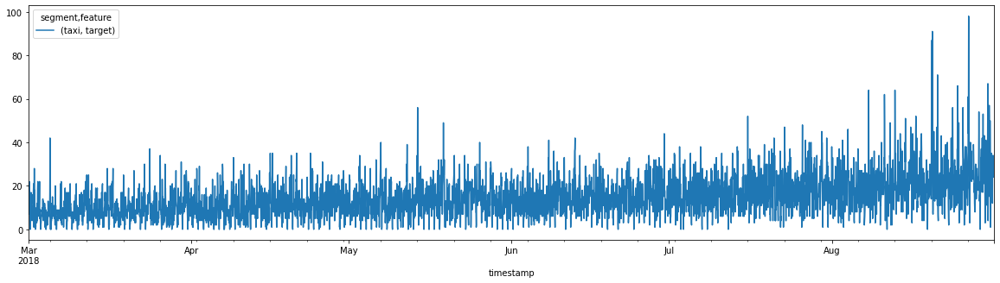

In [39]:
#Изображение времемнного ряда TSDataset на графике.
ts.to_pandas().plot(figsize=(20, 5))

В библиотеке Ethna необходимо задать горизонт прогнозирования. Исходя из условия задачи необходимо рассчитать данные для 10% от выборки. 
Исходя из этого условия ниже рассчитывается горизонт планирования. (Он же будет выступать в роли тестовой выборки).

In [40]:
HORIZON = round(4416*0.1)
HORIZON

442

In [41]:
#Разбиение на тренировочную и тестовую выборки.
train_ts, test_ts = ts.train_test_split(test_size=HORIZON)


In [42]:
#Подготовка трансформеров для пайплайна
transforms = [
    DensityOutliersTransform(in_column="target", distance_coef=3.0),
    TimeSeriesImputerTransform(in_column="target", strategy="forward_fill"),
    LinearTrendTransform(in_column="target"),
    TrendTransform(in_column="target", out_column="trend"),
    LagTransform(in_column="target", lags=list(range(HORIZON, 24)), out_column="target_lag"),
    DateFlagsTransform(week_number_in_month=True, out_column="date_flag"),
    FourierTransform(period=360.25, order=6, out_column="fourier"),
    SegmentEncoderTransform()
    #MeanTransform(in_column=f"target_lag_{HORIZON}", window=12, seasonality=7),
    #MeanTransform(in_column=f"target_lag_{HORIZON}", window=24)
]

# Prepare model
model = CatBoostMultiSegmentModel()

In [43]:
#Создание пайплайна и обучение модели.
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)
pipeline.fit(train_ts)

#Формирование прогноза.
forecast_ts = pipeline.forecast()

/Users/maksimgorskov/opt/anaconda3/lib/python3.9/site-packages/etna/datasets/tsdataset.py:282: FutureWarning: Argument `closed` is deprecated in favor of `inclusive`.
  future_dates = pd.date_range(


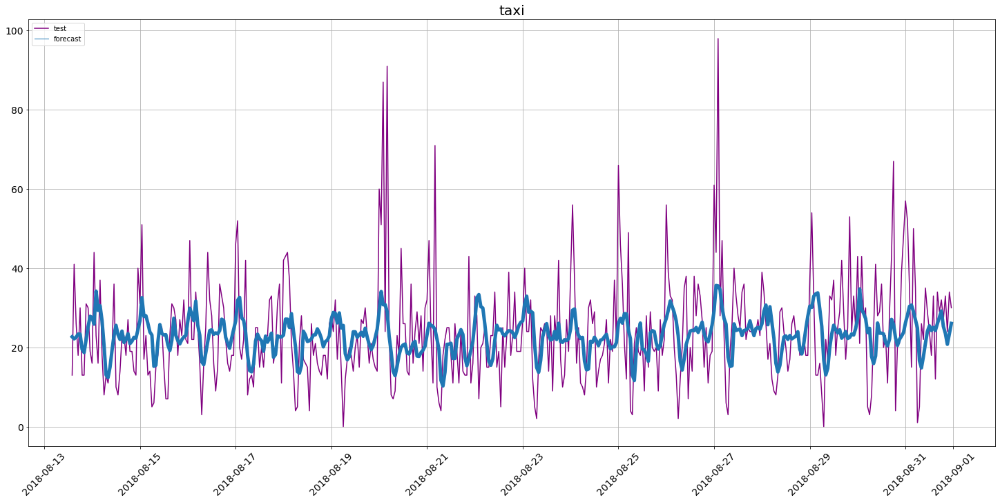

In [49]:
#Вывод на печать прогноза и фактических данных для их визуального коррелирования.
plot_forecast(forecast_ts=forecast_ts, 
              test_ts=test_ts, 
              train_ts=train_ts, 
              n_train_samples=0, 
              figsize=(20, 10))

# Получение текущей фигуры
fig = plt.gcf()

# Получение оси текущей фигуры
axes = fig.get_axes()
# Получение линии графика
lines = axes[0].lines
#Изменение толщины линии тестовых данных

lines[1].set_linewidth(5)

plt.title('taxi', fontsize=20)
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)
plt.savefig("/Users/maksimgorskov/Desktop/Data Science/Спринт 19_Временные ряды/Проектная работа/Предсказание_Факт.png")
plt.show()


**Анализ графика:**
- Из графика видно, что предсказанные значения повторяют общие локальные тренды фактических значений временного ряда. Однако видны значительные отклонения между предсказанными данными и фактическими, в точках максимальной валатильности графика, построенного на тестовой выборке.
- Эти пики и дают бОльший вклад в ухудшение метрики. Средние значения модель определяет достаточно точно.

In [45]:
metric = RMSE()
metric_value = metric(y_true = test_ts, y_pred = forecast_ts)
metric_value = metric_value['taxi'].round()
print(f'Метрика RMSE = {metric_value}')

Метрика RMSE = 12.0


In [46]:
# Создание словаря с новой строкой
df_append = {'ML model': 'Ethna', 'RMSE': metric_value}

# Создание нового DataFrame с одной строкой
new_row = pd.DataFrame([df_append])

# Объединение (конкатенация) существующего DataFrame с новым DataFrame
comparing = pd.concat([comparing, new_row], ignore_index=True)
comparing

,ML model,RMSE
0,CatBoost_test,42.077522
1,LightGBM_valid,40.958199
2,Ethna,12.000000


Применение библиотеки Ethna является наиболее эффективным способом рассчета потребности такси на следующий час работы сервиса. 
Метрика RMSE в данной методологии достигаел 12 шт. что на 75% лучше требуемой метрики.

# Вывод.

**Итоги по основным вехам проекта:**

    1. Анализ данных
- За весь промежуток врмени, приведенный в исходном датасете, наблюдается восходящий тренд по заказу такси. На начало сентября, количество вызовов такси выросло более чем в три раза, по сравнением с началом марта этого же года.
- Анализ на сезонность показал, что она присутствует только на уровне суток. Ежесуточно пиковое количество вызовов приходится на полночь, а минимальное кол-во заказов - на 6 утра.
    2. Обучение моделей
- На тренировочной выборке были обучены модели CatBoost и LightGBM. Тестирование показало, что наиболее оптимально использовать модель LightGBM. У моделей получились схожие метрики RMSE: 42,07 - CatBoost, и 40,9- LightGBM. 
- Для сравнения результатов с стандартными моделями ML была применена библиотека **Ethna**, которая является специализированным инструментом для работы с временными рядами. Значение метрики RMSE на тестовой выборке составило 12 ед.

**Результат:**

Применение библиотеки Ethna является наиболее эффективным способом рассчета потребности такси на следующий час работы сервиса. 
Метрика RMSE в данной методологии достигаел 12 шт., что на 75% лучше требуемой метрики.